In [1]:
import warnings
warnings.filterwarnings('ignore')
#import PyTre
import pandas as pd
import numpy as np

import pickle
import scipy.spatial
#import matplotlib.cm as cm
import scipy.stats
import tensorflow as tf
import keras
import statsmodels.api as sm
import math
from collections import OrderedDict
from collections import Counter

from keras.layers.core import Dense, Activation, Dropout, Flatten
from keras.layers.embeddings import Embedding
from keras.layers.recurrent import LSTM
from keras.layers import BatchNormalization, Input, concatenate
import tempfile
import keras.models
from keras.models import Model, Sequential, load_model
from keras import regularizers
from keras.callbacks import ModelCheckpoint
import keras.backend as K

from sklearn.linear_model  import LogisticRegressionCV, LogisticRegression
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE, MDS
from sklearn.model_selection import train_test_split
import os
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
%matplotlib inline
import PyTre_multioutput
from adjustText import adjust_text
import matplotlib.cm as cm
from numpy import dot
from numpy.linalg import norm

def func_cos_sim(a, b):
    cos_sim = dot(a, b)/(norm(a)*norm(b))
    return cos_sim

import networkx as nx

def get_digraph_from_dict(cosine_sim_dic, value):
    G = nx.DiGraph() # directed graph
    for area_1 in cosine_sim_dic.keys():
        
            for area_2 in range(len(cosine_sim_dic[area_1])):
                if cosine_sim_dic[area_1][area_2][0] > value:
                    G.add_edge(area_1, cosine_sim_dic[area_1][area_2][1])
                
            # uncomment below to add weights
            """
            if 'weight' not in G[sender][r]:
                G[sender][r]['weight'] = 0
            G[sender][r]['weight'] += 1
            #"""
    return G
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (20, 15)
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (20, 15)
def changes(cosine_sim_dic, cosine_sim_dic_past, value):
    count = 0
    cities =[]
    for city_1 in cosine_sim_dic:
        top_similar = []
        top_similar_past = []
        for city_2 in cosine_sim_dic[city_1][:value]:
            top_similar.append(city_2[1])
        for city_2_past in cosine_sim_dic_past[city_1][:value]:
            top_similar_past.append(city_2_past[1])
        different = list(set(top_similar_past)-set(top_similar))
        if len(different) > 0:
            #print(city_1)
            #print(len(different), 'changes in top', value, 'similar cities')
            #print()
            count += len(different)
        else:
            cities.append(city_1)
    print('Total change:', round(count/(len(cosine_sim_dic)*value)*100, 2), '%')
    print('No changes in:',cities)
def discretize_variables(data, columns):
    features_categorical=pd.DataFrame() # new dataframe to save the discretized data
    #columns=df_data.columns # df_data: dataframe to discretize, columns: variables to discretize
    for i,var in enumerate(columns):
        #print(var)
        n=5  
        #print(np.var(data[var]))
        found_n=0
        
        while found_n==0:
            try:
                pd.qcut(data[var], q=n, precision=0)
              
            except Exception as e:
                n-=1
            
                #print(n)
            else:
                found_n=1
                bin_labels=[]
                #for num in range(n):
                    #bin_labels.append(indicator[i]+'_'+str(n))
                features_categorical[var]=pd.qcut(data[var], q=n, )
        #print(features_categorical[var])
        #print()
    return features_categorical
def create_model_input(df_emb, emb_vars_list, external_vars_list, y_variable):
    # Create 1 df with repeated values x n of embed variables
    
    all_dfs=[df_emb[external_vars_list+[y_variable]] for var in emb_vars_list] 
    df_repeat= pd.concat(all_dfs)
    #print(len(df_repeat))
    # create one column/list containing in all the categorical values for each osbervation x each variable
    vars_values= np.array([df_emb[var].values for var in emb_vars_list])
    vars_values= vars_values.reshape(-1) #flatten the list of lists
    print(vars_values.shape)
    # add the column with the categorical values for all the variables in the long dataframe
    df_repeat['ALL_CATS']= vars_values

    return df_repeat
def get_mean_embs(emb_vars, embeddings, emb_dims, input_df): 
    
    mean_embs=[]
    for row in input_df[emb_vars].values:
        #print(row)
        mean_vector=np.zeros(emb_dims)
        for category in row:
            emb_index=embeddings['alfa2index_from'][category]
            # add up all the categorical vectors
            mean_vector+=embeddings['embeddings'][emb_index]
        mean_embs.append(mean_vector/len(row)) # divide by the number of categories to get the mean vector
    
    return np.array(mean_embs)
def calculate_distances(embeddings, points):
    norm_embs=preprocessing.normalize(embeddings,norm='l2', axis=1)
    norm_embs=preprocessing.scale(norm_embs,with_mean=True,with_std=False)
    norm_embs=preprocessing.normalize(norm_embs,norm='l2',axis=1)
                
    euclidean_distance_dict = {i:[] for i in points}
    manhattan_distance_dict = {i:[] for i in points}
    cosine_sim_dic = {i:[] for i in points}
    for i,point in enumerate(points):
        euclidean_distance_list = []
        manhattan_distance_list = []
        cos_sim_list = []
        for j in range(len(embeddings)):
            if i != j:
                dist = np.linalg.norm(embeddings[i]-embeddings[j])
                manhattan = scipy.spatial.distance.cityblock(embeddings[i], embeddings[j])
                current_cos_sim = func_cos_sim(norm_embs[i],norm_embs[j])
                
                euclidean_distance_list.append((dist, points[j]))
                euclidean_distance_list=sorted(euclidean_distance_list, key=lambda x:x[0], reverse=False)
                
                manhattan_distance_list.append((manhattan, points[j]))
                manhattan_distance_list=sorted(manhattan_distance_list, key=lambda x:x[0], reverse=False)
                
                cos_sim_list.append((current_cos_sim, points[j]))
                cos_sim_list=sorted(cos_sim_list, key=lambda x:x[0], reverse=True)
                
        euclidean_distance_dict[point]=euclidean_distance_list
        manhattan_distance_dict[point]=manhattan_distance_list
        cosine_sim_dic[point]=cos_sim_list
    return euclidean_distance_dict, manhattan_distance_dict, cosine_sim_dic
import sklearn
def similar_cities(embeddings_continent1, cities1, embeddings_continent2, cities2):
    
    manhattan_distance_dict = {i:[] for i in cities1}
    cosine_similarity_dict = {i:[] for i in cities1}
    for i,city1 in enumerate(cities1):
        
        list_manhattan_distance = []
        list_cosine_similarity = []
        for j,city2 in enumerate(cities2):
            
            distance = scipy.spatial.distance.cityblock(embeddings_continent1[i], embeddings_continent2[j])
            similarity = sklearn.metrics.pairwise.cosine_similarity(embeddings_continent1[i].reshape(1, -1), Y=embeddings_continent2[j].reshape(1, -1), dense_output=True)
            
            list_manhattan_distance.append((distance, city2))
            list_manhattan_distance=sorted(list_manhattan_distance, key=lambda x:x[0], reverse=False)
            
            list_cosine_similarity.append((similarity, city2))
            list_cosine_similarity=sorted(list_cosine_similarity, key=lambda x:x[0], reverse=False)
            
        manhattan_distance_dict[city1] = list_manhattan_distance
        cosine_similarity_dict[city1] = list_cosine_similarity
        
    return manhattan_distance_dict, cosine_similarity_dict
def bar_plot(ax, data, colors=None, total_width=0.8, single_width=1, legend=True):
    """Draws a bar plot with multiple bars per data point.

    Parameters
    ----------
    ax : matplotlib.pyplot.axis
        The axis we want to draw our plot on.

    data: dictionary
        A dictionary containing the data we want to plot. Keys are the names of the
        data, the items is a list of the values.

        Example:
        data = {
            "x":[1,2,3],
            "y":[1,2,3],
            "z":[1,2,3],
        }

    colors : array-like, optional
        A list of colors which are used for the bars. If None, the colors
        will be the standard matplotlib color cyle. (default: None)

    total_width : float, optional, default: 0.8
        The width of a bar group. 0.8 means that 80% of the x-axis is covered
        by bars and 20% will be spaces between the bars.

    single_width: float, optional, default: 1
        The relative width of a single bar within a group. 1 means the bars
        will touch eachother within a group, values less than 1 will make
        these bars thinner.

    legend: bool, optional, default: True
        If this is set to true, a legend will be added to the axis.
    """

    # Check if colors where provided, otherwhise use the default color cycle
    if colors is None:
        colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
    
    # Number of bars per group
    n_bars = len(data)

    # The width of a single bar
    bar_width = total_width / n_bars

    # List containing handles for the drawn bars, used for the legend
    bars = []

    # Iterate over all data
    for i, (name, values) in enumerate(data.items()):
        # The offset in x direction of that bar
        x_offset = (i - n_bars / 2) * bar_width + bar_width / 2

        # Draw a bar for every value of that type
        for x, y in enumerate(values):
            bar = ax.bar(x + x_offset, y, width=bar_width * single_width, color=colors[i % len(colors)])

        # Add a handle to the last drawn bar, which we'll need for the legend
        bars.append(bar[0])

    # Draw legend if we need
    if legend:
        ax.legend(bars, data.keys())
from numpy import nan
import math

def rotate(origin, point, angle):
    """
    Rotate a point counterclockwise by a given angle around a given origin.

    The angle should be given in radians.
    """
    ox, oy = origin
    px, py = point

    qx = ox + math.cos(angle) * (px - ox) - math.sin(angle) * (py - oy)
    qy = oy + math.sin(angle) * (px - ox) + math.cos(angle) * (py - oy)
    
    
    return qx, qy
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

Using TensorFlow backend.


In [2]:
from sklearn.neural_network import MLPRegressor

In [3]:
from sklearn.ensemble import GradientBoostingRegressor

# Data

In [4]:
data = pd.read_excel('FINAL-COMBINED-DATASET.xlsx')
data =data.replace(' ', nan)
data.head()

,City,cityID,clusterID,Typology,Country,Car Modeshare (%),Public Transit Modeshare (%),Bicycle Modeshare (%),Walking Modeshare (%),Gasoline Pump Price (USD/liter),...,Highway Proportion,Metro Propensity Factor,BRT Propensity Factor,BikeShare Propensity Factor,Development Factor,Sustainability Factor,Population Factor,Congestion Factor,Sprawl Factor,Network Density Factor
0,Kabul,1,1,Congested Emerging,Afghanistan,17.7,49.6,0.0,32.7,0.65,...,0.000000,0.079425,0.012067,0.373602,0.029561,0.221471,0.310268,0.707286,0.211824,0.330575
1,Algiers,2,1,Congested Emerging,Algeria,12.8,28.7,NaN,55.8,0.37,...,NaN,0.127131,0.081778,0.375540,0.118424,0.344736,0.173201,0.656164,0.559870,0.380830
2,Oran,3,2,BusTransit Sprawl,Algeria,NaN,NaN,NaN,NaN,0.37,...,0.017992,0.047502,0.088082,0.388473,0.231902,0.311532,0.114422,0.554905,0.689737,0.499762
3,Luanda,4,3,Congested Boomer,Angola,NaN,NaN,NaN,NaN,0.76,...,0.000000,0.061402,0.087578,0.000000,0.485812,0.175425,0.429534,0.642123,0.331717,0.514084
4,Huambo,5,1,Congested Emerging,Angola,NaN,NaN,NaN,NaN,0.76,...,0.000000,0.074822,0.037257,0.342958,0.043231,0.343601,0.206326,0.687646,0.458215,0.313614


In [5]:
indicator = [
'modeCar',
'modePT',
'modeBike',
'modeWalk',
'gasPrice',
'rdDeath',
'subLen',
'subLenD',
'subStPHK',
'subRidPC',
'subAge',
'BRTLen',
'BRTLenD',
'BRTStPHK',
'BRTFlPHK',
'BRTRidPC',
'BRTAge',
'bsSt',
'bsStPHK',
'bsBikes',
'bsBikPHK',
'bsAge',
'congest',
'AMPeak',
'PMPeak',
'TI',
'TTI',
'inefInd',
'pop',
'land',
'popDen',
'poCh9000',
'poCh0010',
'poCh1020',
'poCh2025',
'ur15',
'urCh1525',
'GDPPCP',
'unemploy',
'costLiv',
'rent',
'grocery',
'restaPri',
'locPurPo',
'gini',
'poverty',
'lifeExp',
'safety',
'internet',
'digital',
'innovat',
'smartphon',
'CO2EmsPC',
'polluI',
'stLenT',
'stLenD',
'stLenAvg',
'intersT',
'intersD',
'k_avg',
'stPerNode',
'circuity',
'loopP',
'highwayP']

## Continents

In [6]:
asia = ['Afghanistan', 'Armenia', 'Azerbaijan', 'Bangladesh', 'Cambodia', 
       'China', 'Georgia', 'Hong Kong', 'India', 'Indonesia', 
       'Iran', 'Iraq', 'Israel', 'Japan', 'Jordan', 'Kazakhstan',
        'Kyrgyzstan', 'Laos', 'Lebanon', 'Malaysia', 'Mongolia', 'Myanmar',
       'Nepal', 'North Korea', 'Pakistan', 'Philippines',
       'Saudi Arabia', 'Singapore', 'South Korea', 'Syria', 'Taiwan', 
       'Thailand', 'United Arab Emirates', 'Uzbekistan', 
       'Vietnam', 'Yemen']
africa = ['Algeria', 'Angola', 'Benin', 'Burkina Faso', 'Ivory Coast', 
         'Cameroon', 'Chad', 'Democratic Republic of the Congo', 'Congo',
         'Egypt', 'Ethiopia', 'Ghana', 'Guinea', 'Kenya', 'Kuwait', 
          'Liberia', 'Libya', 'Madagascar', 'Mali', 'Mauritania', 
         'Morocco', 'Mozambique', 'Niger', 'Nigeria', 'Senegal', 
          'Sierra Leone', 'Somalia', 'South Africa', 'Sudan', 'Tanzania', 
         'Togo', 'Tunisia', 'Uganda', 'Zambia', 'Zimbabwe']
n_america = ['Canada', 'Costa Rica', 'Cuba', 'Dominican Republic',
             'El Salvador', 'Guatemala', 'Haiti', 'Honduras', 'Mexico', 
            'Nicaragua', 'Panama', 'Peru', 'Puerto Rico', 'United States']
s_america_oceania = ['Argentina', 'Australia', 'Bolivia', 'Brazil', 'Chile',
                    'Colombia', 'Ecuador', 'New Zealand', 'Paraguay', 
                    'Uruguay', 'Venezuela']
europe = ['Austria', 'Belarus', 'Belgium', 'Bulgaria',
         'Czech Republic', 'Denmark', 'Finland', 'France',
          'Germany', 'Greece', 'Hungary', 'Ireland', 'Italy',
         'Netherlands', 'Norway', 'Poland', 'Portugal', 'Romania', 'Russia',
         'Serbia', 'Slovakia', 'Spain', 'Sweden', 'Switzerland', 'Turkey', 
         'Ukraine', 'United Kingdom']

In [7]:
for i in range(len(data)):
    if data.Country.isin(asia)[i]:
        data.loc[i, 'Continent'] = 'Asia'
    elif data.Country.isin(africa)[i]:
        data.loc[i, 'Continent'] = 'Africa'
    elif data.Country.isin(n_america)[i]:
        data.loc[i, 'Continent'] = 'North America'
    elif data.Country.isin(s_america_oceania)[i]:
        data.loc[i, 'Continent'] = 'South America & Oceania'
    elif data.Country.isin(europe)[i]:
        data.loc[i, 'Continent'] = 'Europe'

In [8]:
print('Europe',len(data.loc[data.Continent == 'Europe']))
print('Asia',len(data.loc[data.Continent == 'Asia']))
print('NAmerica',len(data.loc[data.Continent == 'North America']))
print('Samerica',len(data.loc[data.Continent == 'South America & Oceania']))
print('Africa',len(data.loc[data.Continent == 'Africa']))

Europe 64
Asia 111
NAmerica 83
Samerica 25
Africa 47


In [9]:
coords = pd.read_csv('coords.csv')
data_coords = data.copy()
data_coords['lat'] = coords['latitude']
data_coords['lon'] = coords['longitude']
data_coords

,City,cityID,clusterID,Typology,Country,Car Modeshare (%),Public Transit Modeshare (%),Bicycle Modeshare (%),Walking Modeshare (%),Gasoline Pump Price (USD/liter),...,BikeShare Propensity Factor,Development Factor,Sustainability Factor,Population Factor,Congestion Factor,Sprawl Factor,Network Density Factor,Continent,lat,lon
0,Kabul,1,1,Congested Emerging,Afghanistan,17.7,49.6,0.0,32.7,0.65,...,0.373602,0.029561,0.221471,0.310268,0.707286,0.211824,0.330575,Asia,34.526013,69.177648
1,Algiers,2,1,Congested Emerging,Algeria,12.8,28.7,NaN,55.8,0.37,...,0.375540,0.118424,0.344736,0.173201,0.656164,0.559870,0.380830,Africa,36.752500,3.041970
2,Oran,3,2,BusTransit Sprawl,Algeria,NaN,NaN,NaN,NaN,0.37,...,0.388473,0.231902,0.311532,0.114422,0.554905,0.689737,0.499762,Africa,35.666670,-0.500000
3,Luanda,4,3,Congested Boomer,Angola,NaN,NaN,NaN,NaN,0.76,...,0.000000,0.485812,0.175425,0.429534,0.642123,0.331717,0.514084,Africa,-8.836820,13.234320
4,Huambo,5,1,Congested Emerging,Angola,NaN,NaN,NaN,NaN,0.76,...,0.342958,0.043231,0.343601,0.206326,0.687646,0.458215,0.313614,Africa,-12.776110,15.739170
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
326,Ho Chi Minh City,327,12,MetroBike Emerging,Vietnam,11.0,6.0,NaN,NaN,0.91,...,0.356832,0.160312,0.604209,0.392611,0.591250,0.643038,0.341987,Asia,10.649745,106.761979
327,Hanoi,328,12,MetroBike Emerging,Vietnam,8.0,10.0,2.0,NaN,0.90,...,0.358868,0.157676,0.509057,0.292564,0.624623,0.666710,0.239113,Asia,21.029450,105.854444
328,Sanaa,329,1,Congested Emerging,Yemen,NaN,NaN,NaN,NaN,0.60,...,0.354702,0.046681,0.307281,0.306395,0.689737,0.375679,0.336923,Asia,15.354720,44.206670
329,Lusaka,330,1,Congested Emerging,Zambia,12.0,21.0,NaN,62.0,1.46,...,0.331838,0.126954,0.284887,0.253098,0.628004,0.170900,0.421654,Africa,-15.416449,28.282153


In [10]:
data_coords['continent_id'] = pd.Categorical(data.Continent)
data_coords['continent_id'] = data_coords['continent_id'].astype('category').cat.codes

In [11]:
import branca
import branca.colormap as bcm
colormap = bcm.LinearColormap(colors=['darkgray','darkred', 'dimgray'], index=[0,4],vmin=0,vmax=4)

In [12]:
import folium
#from folium import DivOps

In [13]:
map_sg = folium.Map(location=[27.677621, 3.434698], zoom_start=2, tiles='cartodbpositron', )

# add markers to map
for lat, lng, area in zip(data_coords.lat, data_coords.lon, data_coords.continent_id):
    #label = '{}'.format(neighborhood)
    #label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=1.5,
        #popup=label,
        color=colormap(area),
        fill=False,
        fill_color=colormap(area),
        fill_opacity=1,
        parse_html=False).add_to(map_sg)
map_sg

In [14]:
columns = ['City', 'cityID', 'Country', 'Continent',
       'Car Modeshare (%)', 'Public Transit Modeshare (%)',
       'Bicycle Modeshare (%)', 'Walking Modeshare (%)',
       'Gasoline Pump Price (USD/liter)', 'Road Deaths Rate (per 1000)',
       'Subway Length (km)', 'Subway Length Density (per km)',
       'Subway Stations per Hundred Thousand', 'Subway Ridership per Capita',
       'Subway Age (years)', 'BRT Length (km)',
       'BRT System Length Density (per km)',
       'BRT Stations per Hundred Thousand Persons',
       'BRT Fleet per Hundred Thousand Persons',
       'BRT Annual Ridership per Capita', 'BRT Age (years)',
       'Bikeshare Stations', 'Bikeshare Stations per Hundred Thousand Persons',
       'Bikeshare Number of Bikes',
       'Bikeshare Bicycles per Hundred Thousand Persons',
       'Bikeshare Age (years)', 'Congestion (%)', 'Congestion AM Peak (%)',
       'Congestion PM Peak (%)', 'Traffic Index', 'Travel Time Index',
       'Inefficiency Index', 'Population', 'Land Area (sq. km)',
       'Population Density (per sq. km)', 'Population Change 1990 – 2000',
       'Population Change 2000 – 2010', 'Population Change 2010 – 2020',
       'Population Change 2020 – 2025', 'Urbanization Rate 2015 (%)',
       'Urbanization Rate Change 2015 – 2025 (pp)', 'GDP per Capita (USD)',
       'Unemployment Rate (%)', 'Cost of Living Index', 'Rent Index',
       'Grocery Index', 'Restaurant Price Index',
       'Local Purchasing Power Index', 'Gini Coefficient', 'Poverty Rate (%)',
       'Life Expectancy (years)', 'Safety Index', 'Internet Penetration',
       'Digital Penetration', 'Innovation Index', 'Smartphone Penetration (%)',
       'CO2 Emissions per Capita (metric tonnes)', 'Pollution Index ',
       'Street length total (m)', 'Street Length Density (m/sq. km)',
       'Street Length Average (m)', 'Intersection Count',
       'Intersection Density (per sq. km)', 'Degree Average',
       'Streets per Node', 'Circuity', 'Self-Loop Proportion',
       'Highway Proportion']

In [15]:
data = data[columns]
data.head()

,City,cityID,Country,Continent,Car Modeshare (%),Public Transit Modeshare (%),Bicycle Modeshare (%),Walking Modeshare (%),Gasoline Pump Price (USD/liter),Road Deaths Rate (per 1000),...,Street length total (m),Street Length Density (m/sq. km),Street Length Average (m),Intersection Count,Intersection Density (per sq. km),Degree Average,Streets per Node,Circuity,Self-Loop Proportion,Highway Proportion
0,Kabul,1,Afghanistan,Asia,17.7,49.6,0.0,32.7,0.65,15.5,...,4.374732e+06,4.185928e+09,122.672083,20705.0,956.842164,5.230966,2.688829,1.043663,0.000778,0.000000
1,Algiers,2,Algeria,Africa,12.8,28.7,NaN,55.8,0.37,23.8,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Oran,3,Algeria,Africa,NaN,NaN,NaN,NaN,0.37,23.8,...,1.358144e+06,6.104866e+09,88.640113,9253.0,4495.007149,5.749214,3.120828,1.044617,0.000635,0.017992
3,Luanda,4,Angola,Africa,NaN,NaN,NaN,NaN,0.76,26.9,...,7.758223e+06,6.203790e+09,100.082864,46581.0,799.640511,5.728079,2.973880,1.026107,0.000528,0.000000
4,Huambo,5,Angola,Africa,NaN,NaN,NaN,NaN,0.76,26.9,...,5.243590e+05,4.249366e+08,198.620820,1574.0,810.392514,5.581714,3.023429,1.055167,0.000205,0.000000


In [16]:
m=0
r=0
for city in range(len(data)):
    for column in data.columns[4:]:
        if np.isnan(data.loc[city, column]):
            data.loc[city, column] = data.loc[data.Country== data.loc[city, 'Country']][column].mean()
            if np.isnan(data.loc[city, column]):
                #print('Value of country is not available')
                m+=1
            else: 
                r+=1
print('replaced', r)
print('still missing', m)
print()

replaced 1609
still missing 1592



In [17]:
data.loc[212, 'Continent'] = 'Africa'

In [18]:
nan_count = data.isna().sum()
for column in data.columns:
    if nan_count[column]/len(data)*100 > 0:
        print(column, round(nan_count[column]/len(data)*100, 1), '%')

Car Modeshare (%) 15.1 %
Public Transit Modeshare (%) 14.8 %
Bicycle Modeshare (%) 27.8 %
Walking Modeshare (%) 20.2 %
Road Deaths Rate (per 1000) 0.3 %
BRT Length (km) 0.3 %
BRT System Length Density (per km) 0.3 %
BRT Stations per Hundred Thousand Persons 1.5 %
BRT Fleet per Hundred Thousand Persons 3.0 %
BRT Annual Ridership per Capita 0.3 %
BRT Age (years) 0.6 %
Bikeshare Stations 0.3 %
Bikeshare Stations per Hundred Thousand Persons 0.3 %
Bikeshare Number of Bikes 0.9 %
Bikeshare Bicycles per Hundred Thousand Persons 0.9 %
Congestion (%) 41.1 %
Congestion AM Peak (%) 41.1 %
Congestion PM Peak (%) 41.1 %
Traffic Index 20.8 %
Travel Time Index 20.8 %
Inefficiency Index 20.8 %
Urbanization Rate 2015 (%) 0.9 %
Urbanization Rate Change 2015 – 2025 (pp) 0.9 %
Unemployment Rate (%) 27.2 %
Cost of Living Index 10.9 %
Rent Index 10.9 %
Grocery Index 10.9 %
Restaurant Price Index 10.9 %
Local Purchasing Power Index 10.9 %
Gini Coefficient 25.7 %
Poverty Rate (%) 21.8 %
Safety Index 11.5 %
I

In [19]:
brt=[]
for i in data['BRT Age (years)']:
    if i >0:
        brt.append('BRT_yes')
    else:
        brt.append('BRT_no')
bikeshare = []
for i in data['Bikeshare Age (years)']:
    if i>0:
        bikeshare.append('bs_yes')
    else:
        bikeshare.append('bs_no')
data_discretized = data.copy()  #Europe dataset with categorical values

for i,column in enumerate(data_discretized.columns[4:]):    
    data_discretized[column] = pd.cut(data_discretized[column], bins=4, labels=[indicator[i]+'_min', indicator[i]+'_low', indicator[i]+'_med', indicator[i]+'_high'])

for i,column in enumerate(data_discretized.columns[4:]):
    if data_discretized[column].isna().sum() > 0:
        data_discretized[column] = data_discretized[column].cat.add_categories((indicator[i]+'_unknown')).fillna((indicator[i]+'_unknown'))

data_discretized['BRT'] = brt
data_discretized['Bikeshare'] = bikeshare
data_discretized.head()

,City,cityID,Country,Continent,Car Modeshare (%),Public Transit Modeshare (%),Bicycle Modeshare (%),Walking Modeshare (%),Gasoline Pump Price (USD/liter),Road Deaths Rate (per 1000),...,Street Length Average (m),Intersection Count,Intersection Density (per sq. km),Degree Average,Streets per Node,Circuity,Self-Loop Proportion,Highway Proportion,BRT,Bikeshare
0,Kabul,1,Afghanistan,Asia,modeCar_min,modePT_med,modeBike_min,modeWalk_low,gasPrice_low,rdDeath_low,...,stLenAvg_min,intersT_min,intersD_min,k_avg_med,stPerNode_low,circuity_min,loopP_min,highwayP_min,BRT_no,bs_no
1,Algiers,2,Algeria,Africa,modeCar_min,modePT_low,modeBike_unknown,modeWalk_med,gasPrice_min,rdDeath_med,...,stLenAvg_min,intersT_min,intersD_min,k_avg_med,stPerNode_med,circuity_min,loopP_min,highwayP_min,BRT_no,bs_no
2,Oran,3,Algeria,Africa,modeCar_min,modePT_low,modeBike_unknown,modeWalk_med,gasPrice_min,rdDeath_med,...,stLenAvg_min,intersT_min,intersD_min,k_avg_med,stPerNode_med,circuity_min,loopP_min,highwayP_min,BRT_no,bs_no
3,Luanda,4,Angola,Africa,modeCar_unknown,modePT_unknown,modeBike_unknown,modeWalk_unknown,gasPrice_low,rdDeath_med,...,stLenAvg_min,intersT_min,intersD_min,k_avg_med,stPerNode_med,circuity_min,loopP_min,highwayP_min,BRT_no,bs_no
4,Huambo,5,Angola,Africa,modeCar_unknown,modePT_unknown,modeBike_unknown,modeWalk_unknown,gasPrice_low,rdDeath_med,...,stLenAvg_min,intersT_min,intersD_min,k_avg_med,stPerNode_med,circuity_min,loopP_min,highwayP_min,BRT_no,bs_no


### Standardize continuous

In [20]:
scaler=StandardScaler()
data_stand=pd.DataFrame(data=scaler.fit_transform(data[data.columns[4:]]), columns=data.columns[4:])
data_stand.head()

,Car Modeshare (%),Public Transit Modeshare (%),Bicycle Modeshare (%),Walking Modeshare (%),Gasoline Pump Price (USD/liter),Road Deaths Rate (per 1000),Subway Length (km),Subway Length Density (per km),Subway Stations per Hundred Thousand,Subway Ridership per Capita,...,Street length total (m),Street Length Density (m/sq. km),Street Length Average (m),Intersection Count,Intersection Density (per sq. km),Degree Average,Streets per Node,Circuity,Self-Loop Proportion,Highway Proportion
0,-0.964651,1.111497,-0.659355,0.830007,-0.952396,0.091024,-0.503691,-0.550847,-0.596834,-0.531937,...,-0.276432,-0.335836,-0.394758,-0.247702,-0.268658,0.241824,-0.920266,-0.721960,-0.571025,-1.046978
1,-1.141345,0.049325,NaN,2.370690,-1.612493,1.044428,-0.328764,-0.101334,-0.285138,-0.441594,...,-0.581696,0.212611,-0.794973,-0.600693,0.926899,1.350273,1.137840,-0.691552,-0.608222,0.065191
2,-1.141345,0.049325,NaN,2.370690,-1.612493,1.044428,-0.503691,-0.550847,-0.596834,-0.531937,...,-0.581696,0.212611,-0.794973,-0.600693,0.926899,1.350273,1.137840,-0.691552,-0.608222,0.065191
3,NaN,NaN,NaN,NaN,-0.693073,1.400519,-0.503691,-0.550847,-0.596834,-0.531937,...,0.065962,0.240884,-0.660407,0.549888,-0.321777,1.305068,0.437760,-1.281765,-0.636086,-1.046978
4,NaN,NaN,NaN,NaN,-0.693073,1.400519,-0.503691,-0.550847,-0.596834,-0.531937,...,-0.666072,-1.410755,0.498397,-0.837387,-0.318144,0.992018,0.673816,-0.355134,-0.720278,-1.046978


In [51]:
train, test = train_test_split(data, test_size=0.3, random_state=42)
train_discretized, test_discretized = train_test_split(data_discretized, test_size=0.3, random_state=42)
train_stand, test_stand = train_test_split(data_stand, test_size=0.3, random_state=42)

In [52]:
validation, test = train_test_split(test, test_size=0.7, random_state=42)
validation_discretized, test_discretized = train_test_split(test_discretized, test_size=0.7, random_state=42)
validation_stand, test_stand = train_test_split(test_stand, test_size=0.7, random_state=42)

In [116]:
print(len(data))
print(len(train))
print(len(validation))
print(len(test))

331
231
30
70


In [121]:
data_coords['color'] = nan

In [138]:
for i in data_coords.loc[data_coords.City.isin(train.City)].index:
    data_coords.loc[i, 'color'] = 'lightgray'
for i in data_coords.loc[data_coords.City.isin(validation.City)].index:
     data_coords.loc[i, 'color'] = 'darkblue'
for i in data_coords.loc[data_coords.City.isin(test.City)].index:
    data_coords.loc[i, 'color'] = 'darkred'

In [139]:
map_sg = folium.Map(location=[27.677621, 3.434698], zoom_start=2, tiles='cartodbpositron', )

# add markers to map
for lat, lng, area in zip(data_coords.lat, data_coords.lon, data_coords.color):
    #label = '{}'.format(neighborhood)
    #label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=1.5,
        #popup=label,
        color=area,
        fill=False,
        fill_color=area,
        fill_opacity=1,
        parse_html=False).add_to(map_sg)
map_sg

## Definition variables

In [53]:
emb=['BRT','Congestion (%)', 'Congestion AM Peak (%)', 'Congestion PM Peak (%)', 'Travel Time Index',
     'Gasoline Pump Price (USD/liter)', 'Street length total (m)', 'Street Length Density (m/sq. km)', 
     'Street Length Average (m)', 'Intersection Count', 'Intersection Density (per sq. km)', 'Degree Average', 
     'Self-Loop Proportion', 'Highway Proportion']

ext=['Land Area (sq. km)', 'Population Change 1990 – 2000', 'Population Change 2000 – 2010', 'Population Change 2010 – 2020', 
     'GDP per Capita (USD)','Population', 'Population Density (per sq. km)', 'Life Expectancy (years)']

y_var='CO2 Emissions per Capita (metric tonnes)'

In [25]:
indicator_cols=['land','poCh9000',
 'poCh0010',
 'poCh1020', 'GDPPCP','pop',
 'popDen','lifeExp',
               'congest', #emb
 'AMPeak',
 'PMPeak','TTI','gasPrice','stLenT',
 'stLenD',
 'stLenAvg',
 'intersT',
 'intersD',
 'k_avg',
 'loopP',
 'highwayP','BRT','CO2EmsPC']

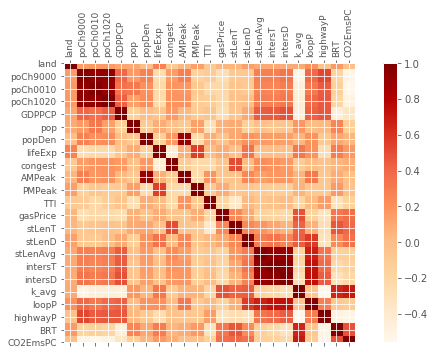

In [30]:
correlations = data[['BRT Age (years)']+emb[1:]+ext+[y_var]].corr()
f = plt.figure(figsize=(10, 5))
plt.matshow(correlations, fignum=f.number, cmap=cm.OrRd)
plt.xticks(range(correlations.shape[1]), indicator_cols, fontsize=9, rotation = 90)
plt.yticks(range(correlations.shape[1]), indicator_cols, fontsize=9)
cb = plt.colorbar()

### Dataset for embeddings

In [54]:
#merge the standarized external variables with the emb variables and y variable
df_input= pd.concat([train_stand[ext],train_discretized[emb]],axis=1)
df_input[y_var]=train[y_var]
emb_dataset=create_model_input(df_input,emb,ext,y_var)
emb_dataset

(3234,)


,Land Area (sq. km),Population Change 1990 – 2000,Population Change 2000 – 2010,Population Change 2010 – 2020,GDP per Capita (USD),Population,Population Density (per sq. km),Life Expectancy (years),CO2 Emissions per Capita (metric tonnes),ALL_CATS
22,0.030554,0.629370,0.102037,-0.017425,-0.235140,0.041902,-0.362842,0.083033,2.465870,BRT_yes
282,0.523819,-0.109550,-0.189014,-0.402056,1.690470,-0.337372,-0.895493,0.777898,14.900000,BRT_no
292,0.219562,-0.523356,-0.523814,-0.532933,0.969975,-0.557003,-0.952563,0.638925,12.420000,BRT_no
56,0.189597,0.850483,0.802271,0.802504,-0.575042,0.273144,-0.324796,0.235904,7.550916,BRT_yes
173,-0.606387,-0.486120,-0.557501,-0.603258,-0.486516,-0.676977,-0.534052,0.319287,4.700000,BRT_yes
...,...,...,...,...,...,...,...,...,...,...
188,-0.670158,-0.361689,-0.688690,-0.594356,-1.103348,-0.287060,1.919948,-0.528448,2.012043,highwayP_min
71,-0.238359,0.511639,0.378601,0.369307,-0.398882,-0.086780,-0.153587,0.235904,9.900000,highwayP_low
106,-0.506505,-0.530255,-0.501527,-0.297157,-0.995959,-0.378008,0.017623,-0.347783,0.866574,highwayP_min
270,3.136891,-0.149579,0.025914,0.019761,1.671309,0.242183,-0.952563,0.569439,17.200000,highwayP_min


# Embeddings

### Categories embeddings

In [55]:
categories_emb=[]
min_mae = 200
min_rmse = 200
max_r_2 = 0
max_mae=0
max_rmse=0
min_r_2=200
mae_plot = []
rmse_plot = []
r_2_plot=[]
for vuelta in range(50):
    MODEL=PyTre_multioutput.EmbeddingsModel() 
                                       
    m, embs= MODEL.fit(emb_dataset[['ALL_CATS']], # ----> X categorical
                   emb_dataset[[y_var]], # ----> Ys continuous 
                   emb_dataset[[]], # -----> Ys categorical (we have none so far)
                   emb_dataset[ext], # ----> exogenous variables used here 
                   xlabels=['ALL_CATS'], CRC=False,
                   EPOCHS=3000, VALIDATION_SPLIT=0.3, EMB_SIZE= [5], # you can change the embedding size 
                   verbose=1,LR=0.0005)

    categories=list(embs['ALL_CATS']['alfa2index_from'].keys())
    categories_emb.append(embs)
    

    train_emb=get_mean_embs(emb_vars=emb, embeddings=embs['ALL_CATS'], emb_dims=5, input_df=df_input)

    train_cities=list(train['City'].values)


    test_emb=[]
    test_cities=validation.City.values
    i=0
    for row in validation_discretized[emb].values:
        #print(test_a_cities[i])
        #print(row)
        mean_vector=np.zeros(5)
        total=0
        for category in row:
            if category in embs['ALL_CATS']['alfa2index_from'].keys():
                emb_index=embs['ALL_CATS']['alfa2index_from'][category]
                # add up all the categorical vectors
                mean_vector+=embs['ALL_CATS']['embeddings'][emb_index]
                total+=1
            else:
                print('Missing category')
        test_emb.append(mean_vector/total) # divide by the number of categories to get the mean vector
        i+=1

    X_train=train_emb
    y_train=np.array(train[y_var])
    
    X_test=test_emb
    y_test=np.array(validation[y_var])
    
    # estimate model on trainset
    lr = LinearRegression(fit_intercept=False)
    lr.fit(X_train, y_train)
    
    # make predictions
    y_train_pred = lr.predict(X_train)
    y_test_pred = lr.predict(X_test)
    
    mae = np.mean(abs(y_test_pred - y_test))
    rmse = np.sqrt(np.mean((y_test_pred - y_test) ** 2))
    r_2 = sklearn.metrics.r2_score(y_test, y_test_pred)
    
    mae_plot.append(mae)
    rmse_plot.append(rmse)
    r_2_plot.append(r_2)
    
    if mae < min_mae:
        min_mae_embs = vuelta
        min_mae = mae
    if rmse < min_rmse:
        min_rmse_ems = vuelta
        min_rmse = rmse
    if r_2 > max_r_2:
        max_r_2_embs = vuelta
        max_r_2 = r_2
        
    if mae > max_mae:
        max_mae_embs = vuelta
        max_mae = mae
    if rmse > max_rmse:
        max_rmse_ems = vuelta
        max_rmse = rmse
    if r_2 < min_r_2:
        min_r_2_embs = vuelta
        min_r_2 = r_2

Model: "model_52"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_103 (InputLayer)          (None, 1)            0                                            
__________________________________________________________________________________________________
embeddings_ALL_CATS (Embedding) (None, 1, 5)         325         input_103[0][0]                  
__________________________________________________________________________________________________
flatten_52 (Flatten)            (None, 5)            0           embeddings_ALL_CATS[0][0]        
__________________________________________________________________________________________________
dropout_52 (Dropout)            (None, 5)            0           flatten_52[0][0]                 
___________________________________________________________________________________________

2263/2263 [==============================] - ETA: 0s - loss: 55.91 - 0s 11us/step - loss: 70.6235 - val_loss: 93.2531
Epoch 48/3000
2263/2263 [==============================] - ETA: 0s - loss: 56.22 - 0s 12us/step - loss: 69.3915 - val_loss: 92.9321
Epoch 49/3000
2263/2263 [==============================] - ETA: 0s - loss: 62.74 - 0s 11us/step - loss: 68.6249 - val_loss: 92.6081
Epoch 50/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.78 - 0s 12us/step - loss: 67.4978 - val_loss: 92.2877
Epoch 51/3000
2263/2263 [==============================] - ETA: 0s - loss: 60.74 - 0s 13us/step - loss: 66.8781 - val_loss: 91.9787
Epoch 52/3000
2263/2263 [==============================] - ETA: 0s - loss: 113.662 - 0s 11us/step - loss: 65.6384 - val_loss: 91.6644
Epoch 53/3000
2263/2263 [==============================] - ETA: 0s - loss: 53.28 - 0s 12us/step - loss: 64.8531 - val_loss: 91.3580
Epoch 54/3000
2263/2263 [==============================] - ETA: 0s - loss: 59.24 - 0s 12

Epoch 109/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.45 - 0s 12us/step - loss: 34.5238 - val_loss: 79.1258
Epoch 110/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.55 - 0s 13us/step - loss: 34.0935 - val_loss: 78.9840
Epoch 111/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.47 - 0s 11us/step - loss: 34.2070 - val_loss: 78.8380
Epoch 112/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.79 - 0s 11us/step - loss: 33.4628 - val_loss: 78.6962
Epoch 113/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.85 - 0s 12us/step - loss: 33.6230 - val_loss: 78.5580
Epoch 114/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.01 - 0s 12us/step - loss: 33.4303 - val_loss: 78.4229
Epoch 115/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.16 - 0s 12us/step - loss: 33.5801 - val_loss: 78.2915
Epoch 116/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.23 - 0s 11us/step - loss: 28.0475 - val_loss: 72.7123
Epoch 171/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.83 - 0s 11us/step - loss: 28.3224 - val_loss: 72.6292
Epoch 172/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.62 - 0s 13us/step - loss: 27.3613 - val_loss: 72.5476
Epoch 173/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.59 - 0s 10us/step - loss: 27.5849 - val_loss: 72.4734
Epoch 174/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.22 - 0s 13us/step - loss: 27.5901 - val_loss: 72.4019
Epoch 175/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.74 - 0s 12us/step - loss: 28.0506 - val_loss: 72.3170
Epoch 176/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.63 - 0s 11us/step - loss: 27.3606 - val_loss: 72.2401
Epoch 177/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 

Epoch 232/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.55 - 0s 12us/step - loss: 25.5901 - val_loss: 68.3997
Epoch 233/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 11us/step - loss: 25.9321 - val_loss: 68.3319
Epoch 234/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 12us/step - loss: 25.7467 - val_loss: 68.2749
Epoch 235/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.64 - 0s 12us/step - loss: 25.2576 - val_loss: 68.2189
Epoch 236/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.09 - 0s 12us/step - loss: 25.9174 - val_loss: 68.1592
Epoch 237/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.43 - 0s 11us/step - loss: 25.6589 - val_loss: 68.0882
Epoch 238/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.88 - 0s 12us/step - loss: 25.4167 - val_loss: 68.0268
Epoch 239/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 12us/step - loss: 24.8444 - val_loss: 64.6995
Epoch 294/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.41 - 0s 12us/step - loss: 24.5879 - val_loss: 64.6358
Epoch 295/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.95 - 0s 12us/step - loss: 24.5853 - val_loss: 64.5753
Epoch 296/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.47 - 0s 11us/step - loss: 24.3504 - val_loss: 64.5123
Epoch 297/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.58 - 0s 12us/step - loss: 24.6065 - val_loss: 64.4404
Epoch 298/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.30 - 0s 12us/step - loss: 24.9531 - val_loss: 64.3886
Epoch 299/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.04 - 0s 12us/step - loss: 24.2632 - val_loss: 64.3318
Epoch 300/3000
2263/2263 [==============================] - ETA: 0s - loss: 50.59 - 

Epoch 355/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 12us/step - loss: 23.9063 - val_loss: 60.8430
Epoch 356/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.93 - 0s 13us/step - loss: 23.5938 - val_loss: 60.7834
Epoch 357/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 12us/step - loss: 23.6686 - val_loss: 60.7263
Epoch 358/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 12us/step - loss: 23.9747 - val_loss: 60.6500
Epoch 359/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.42 - 0s 13us/step - loss: 23.8728 - val_loss: 60.5883
Epoch 360/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 11us/step - loss: 23.8962 - val_loss: 60.5294
Epoch 361/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.19 - 0s 11us/step - loss: 23.5684 - val_loss: 60.4651
Epoch 362/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 11us/step - loss: 22.9103 - val_loss: 57.0469
Epoch 417/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 11us/step - loss: 23.6787 - val_loss: 56.9873
Epoch 418/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 12us/step - loss: 23.5351 - val_loss: 56.9130
Epoch 419/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 11us/step - loss: 23.5926 - val_loss: 56.8439
Epoch 420/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.30 - 0s 12us/step - loss: 22.9044 - val_loss: 56.8027
Epoch 421/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.50 - 0s 12us/step - loss: 23.1544 - val_loss: 56.7510
Epoch 422/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.13 - 0s 11us/step - loss: 23.2973 - val_loss: 56.6911
Epoch 423/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.08 - 

Epoch 478/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 0s 12us/step - loss: 23.1836 - val_loss: 53.3482
Epoch 479/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.45 - 0s 11us/step - loss: 22.8961 - val_loss: 53.3022
Epoch 480/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 11us/step - loss: 22.9251 - val_loss: 53.2442
Epoch 481/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 11us/step - loss: 22.5689 - val_loss: 53.1781
Epoch 482/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.60 - 0s 11us/step - loss: 22.6351 - val_loss: 53.1215
Epoch 483/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.70 - 0s 11us/step - loss: 22.8656 - val_loss: 53.0653
Epoch 484/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 11us/step - loss: 22.5685 - val_loss: 53.0026
Epoch 485/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.84 - 0s 11us/step - loss: 22.2316 - val_loss: 49.9400
Epoch 540/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.71 - 0s 12us/step - loss: 22.3306 - val_loss: 49.8798
Epoch 541/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.57 - 0s 11us/step - loss: 22.4837 - val_loss: 49.8579
Epoch 542/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 0s 13us/step - loss: 22.3586 - val_loss: 49.7937
Epoch 543/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.35 - 0s 12us/step - loss: 22.5907 - val_loss: 49.7444
Epoch 544/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 13us/step - loss: 22.9221 - val_loss: 49.7095
Epoch 545/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.76 - 0s 12us/step - loss: 22.6373 - val_loss: 49.6480
Epoch 546/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 

Epoch 601/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 12us/step - loss: 22.1654 - val_loss: 46.7066
Epoch 602/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 12us/step - loss: 21.9107 - val_loss: 46.6539
Epoch 603/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.54 - 0s 11us/step - loss: 22.1961 - val_loss: 46.6113
Epoch 604/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.46 - 0s 11us/step - loss: 22.0422 - val_loss: 46.5606
Epoch 605/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 11us/step - loss: 22.0460 - val_loss: 46.5165
Epoch 606/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.94 - 0s 12us/step - loss: 22.2523 - val_loss: 46.4661
Epoch 607/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 11us/step - loss: 22.2506 - val_loss: 46.4102
Epoch 608/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 27.61 - 0s 12us/step - loss: 21.8465 - val_loss: 43.8882
Epoch 663/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 11us/step - loss: 21.8359 - val_loss: 43.8341
Epoch 664/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 12us/step - loss: 21.7093 - val_loss: 43.8024
Epoch 665/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.57 - 0s 11us/step - loss: 22.0713 - val_loss: 43.7439
Epoch 666/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 11us/step - loss: 21.4751 - val_loss: 43.6995
Epoch 667/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.15 - 0s 12us/step - loss: 21.9568 - val_loss: 43.6669
Epoch 668/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.76 - 0s 12us/step - loss: 22.0221 - val_loss: 43.6183
Epoch 669/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.56 - 

Epoch 724/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 12us/step - loss: 21.5278 - val_loss: 41.2433
Epoch 725/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.25 - 0s 11us/step - loss: 21.7318 - val_loss: 41.2067
Epoch 726/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.98 - 0s 13us/step - loss: 21.7699 - val_loss: 41.1533
Epoch 727/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.11 - 0s 12us/step - loss: 21.7950 - val_loss: 41.1163
Epoch 728/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 12us/step - loss: 22.0022 - val_loss: 41.0855
Epoch 729/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 12us/step - loss: 21.6986 - val_loss: 41.0400
Epoch 730/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.37 - 0s 11us/step - loss: 21.4294 - val_loss: 40.9896
Epoch 731/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 12us/step - loss: 21.6106 - val_loss: 38.9052
Epoch 786/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.31 - 0s 11us/step - loss: 21.5320 - val_loss: 38.8620
Epoch 787/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 11us/step - loss: 21.3020 - val_loss: 38.8346
Epoch 788/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.28 - 0s 12us/step - loss: 21.5493 - val_loss: 38.7879
Epoch 789/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.04 - 0s 12us/step - loss: 21.5116 - val_loss: 38.7545
Epoch 790/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.10 - 0s 13us/step - loss: 21.3517 - val_loss: 38.7260
Epoch 791/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.23 - 0s 12us/step - loss: 21.4423 - val_loss: 38.6872
Epoch 792/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.62 - 

Epoch 847/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.01 - 0s 11us/step - loss: 21.2289 - val_loss: 36.8070
Epoch 848/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.49 - 0s 12us/step - loss: 20.9113 - val_loss: 36.7768
Epoch 849/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 11us/step - loss: 21.1938 - val_loss: 36.7388
Epoch 850/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 11us/step - loss: 21.4555 - val_loss: 36.7126
Epoch 851/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 0s 12us/step - loss: 21.3666 - val_loss: 36.6847
Epoch 852/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 12us/step - loss: 21.3535 - val_loss: 36.6532
Epoch 853/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 12us/step - loss: 21.5888 - val_loss: 36.6134
Epoch 854/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 12us/step - loss: 21.4451 - val_loss: 34.9513
Epoch 909/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 13us/step - loss: 21.0541 - val_loss: 34.9264
Epoch 910/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 12us/step - loss: 21.1195 - val_loss: 34.9000
Epoch 911/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.49 - 0s 11us/step - loss: 21.1169 - val_loss: 34.8670
Epoch 912/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.66 - 0s 12us/step - loss: 21.1516 - val_loss: 34.8359
Epoch 913/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.49 - 0s 12us/step - loss: 21.1669 - val_loss: 34.8096
Epoch 914/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.06 - 0s 12us/step - loss: 21.0382 - val_loss: 34.7736
Epoch 915/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 

Epoch 970/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 12us/step - loss: 20.9250 - val_loss: 33.2531
Epoch 971/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.50 - 0s 11us/step - loss: 21.1424 - val_loss: 33.2281
Epoch 972/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 13us/step - loss: 20.9730 - val_loss: 33.1974
Epoch 973/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.84 - 0s 12us/step - loss: 20.8491 - val_loss: 33.1682
Epoch 974/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 11us/step - loss: 20.8814 - val_loss: 33.1456
Epoch 975/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 12us/step - loss: 20.9761 - val_loss: 33.1221
Epoch 976/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.60 - 0s 11us/step - loss: 21.1658 - val_loss: 33.1018
Epoch 977/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 11us/step - loss: 21.0263 - val_loss: 31.7838
Epoch 1032/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.79 - 0s 12us/step - loss: 21.1662 - val_loss: 31.7658
Epoch 1033/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.68 - 0s 12us/step - loss: 20.7709 - val_loss: 31.7338
Epoch 1034/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.21 - 0s 12us/step - loss: 21.0169 - val_loss: 31.7063
Epoch 1035/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 11us/step - loss: 21.1199 - val_loss: 31.6898
Epoch 1036/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 11us/step - loss: 20.9124 - val_loss: 31.6671
Epoch 1037/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.04 - 0s 13us/step - loss: 20.7959 - val_loss: 31.6443
Epoch 1038/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.12 - 0s 11us/step - loss: 20.7664 - val_loss: 30.4823
Epoch 1093/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 11us/step - loss: 21.0272 - val_loss: 30.4586
Epoch 1094/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 12us/step - loss: 20.8486 - val_loss: 30.4376
Epoch 1095/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 11us/step - loss: 21.1392 - val_loss: 30.4128
Epoch 1096/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 11us/step - loss: 20.8127 - val_loss: 30.4004
Epoch 1097/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 13us/step - loss: 20.8261 - val_loss: 30.3773
Epoch 1098/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 11us/step - loss: 20.5588 - val_loss: 30.3590
Epoch 1099/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.85 - 0s 12us/step - loss: 20.7890 - val_loss: 29.3345
Epoch 1154/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.86 - 0s 11us/step - loss: 20.8202 - val_loss: 29.3214
Epoch 1155/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 11us/step - loss: 20.8941 - val_loss: 29.3012
Epoch 1156/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 12us/step - loss: 20.8855 - val_loss: 29.2868
Epoch 1157/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 12us/step - loss: 20.9951 - val_loss: 29.2684
Epoch 1158/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.41 - 0s 12us/step - loss: 20.7738 - val_loss: 29.2502
Epoch 1159/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 12us/step - loss: 20.6745 - val_loss: 29.2355
Epoch 1160/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.98 - 0s 11us/step - loss: 20.6583 - val_loss: 28.3110
Epoch 1215/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 11us/step - loss: 20.9042 - val_loss: 28.3009
Epoch 1216/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 12us/step - loss: 20.4053 - val_loss: 28.2816
Epoch 1217/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.25 - 0s 12us/step - loss: 20.3790 - val_loss: 28.2681
Epoch 1218/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.78 - 0s 11us/step - loss: 20.4641 - val_loss: 28.2555
Epoch 1219/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.65 - 0s 13us/step - loss: 20.8685 - val_loss: 28.2363
Epoch 1220/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 11us/step - loss: 20.7132 - val_loss: 28.2208
Epoch 1221/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.95 - 0s 11us/step - loss: 20.8054 - val_loss: 27.4083
Epoch 1276/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.09 - 0s 12us/step - loss: 20.5541 - val_loss: 27.3901
Epoch 1277/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.60 - 0s 13us/step - loss: 20.7519 - val_loss: 27.3754
Epoch 1278/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.26 - 0s 12us/step - loss: 20.4775 - val_loss: 27.3625
Epoch 1279/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.5898 - val_loss: 27.3463
Epoch 1280/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.97 - 0s 12us/step - loss: 20.4447 - val_loss: 27.3373
Epoch 1281/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 13us/step - loss: 20.5569 - val_loss: 27.3287
Epoch 1282/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 12us/step - loss: 20.5404 - val_loss: 26.6128
Epoch 1337/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 11us/step - loss: 20.4465 - val_loss: 26.6016
Epoch 1338/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.05 - 0s 11us/step - loss: 20.5778 - val_loss: 26.5953
Epoch 1339/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 11us/step - loss: 20.7251 - val_loss: 26.5801
Epoch 1340/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.28 - 0s 12us/step - loss: 20.5607 - val_loss: 26.5620
Epoch 1341/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.46 - 0s 13us/step - loss: 20.5726 - val_loss: 26.5485
Epoch 1342/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.85 - 0s 11us/step - loss: 20.4076 - val_loss: 26.5373
Epoch 1343/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 32.14 - 0s 12us/step - loss: 20.4801 - val_loss: 25.9179
Epoch 1398/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 11us/step - loss: 20.4883 - val_loss: 25.9040
Epoch 1399/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 13us/step - loss: 20.5465 - val_loss: 25.8969
Epoch 1400/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.96 - 0s 12us/step - loss: 20.4385 - val_loss: 25.8850
Epoch 1401/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 12us/step - loss: 20.5674 - val_loss: 25.8808
Epoch 1402/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.26 - 0s 12us/step - loss: 20.4900 - val_loss: 25.8680
Epoch 1403/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.84 - 0s 12us/step - loss: 20.5001 - val_loss: 25.8561
Epoch 1404/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 11us/step - loss: 20.5912 - val_loss: 25.3083
Epoch 1459/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 20.5522 - val_loss: 25.2973
Epoch 1460/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.94 - 0s 11us/step - loss: 20.5919 - val_loss: 25.2800
Epoch 1461/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 0s 12us/step - loss: 20.5496 - val_loss: 25.2701
Epoch 1462/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.90 - 0s 12us/step - loss: 20.5603 - val_loss: 25.2582
Epoch 1463/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.42 - 0s 12us/step - loss: 20.3595 - val_loss: 25.2558
Epoch 1464/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.21 - 0s 11us/step - loss: 20.5834 - val_loss: 25.2406
Epoch 1465/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 32.77 - 0s 12us/step - loss: 20.3242 - val_loss: 24.7379
Epoch 1520/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 12us/step - loss: 20.4303 - val_loss: 24.7285
Epoch 1521/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 12us/step - loss: 20.4485 - val_loss: 24.7185
Epoch 1522/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.70 - 0s 12us/step - loss: 20.4595 - val_loss: 24.7090
Epoch 1523/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.92 - 0s 11us/step - loss: 20.3661 - val_loss: 24.7010
Epoch 1524/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.54 - 0s 11us/step - loss: 20.3779 - val_loss: 24.6941
Epoch 1525/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.98 - 0s 11us/step - loss: 20.6256 - val_loss: 24.6852
Epoch 1526/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 11us/step - loss: 20.3770 - val_loss: 24.2757
Epoch 1581/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.70 - 0s 13us/step - loss: 20.3751 - val_loss: 24.2637
Epoch 1582/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 13us/step - loss: 20.4074 - val_loss: 24.2550
Epoch 1583/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 12us/step - loss: 20.2450 - val_loss: 24.2502
Epoch 1584/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 20.2955 - val_loss: 24.2391
Epoch 1585/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.92 - 0s 12us/step - loss: 20.4951 - val_loss: 24.2341
Epoch 1586/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 12us/step - loss: 20.3692 - val_loss: 24.2242
Epoch 1587/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 12us/step - loss: 20.3827 - val_loss: 23.8539
Epoch 1642/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.55 - 0s 12us/step - loss: 20.4438 - val_loss: 23.8471
Epoch 1643/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.04 - 0s 12us/step - loss: 20.1669 - val_loss: 23.8402
Epoch 1644/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.98 - 0s 11us/step - loss: 20.4380 - val_loss: 23.8458
Epoch 1645/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 12us/step - loss: 20.3899 - val_loss: 23.8351
Epoch 1646/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 12us/step - loss: 20.4221 - val_loss: 23.8284
Epoch 1647/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.69 - 0s 12us/step - loss: 20.3394 - val_loss: 23.8207
Epoch 1648/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 12us/step - loss: 20.4217 - val_loss: 23.4925
Epoch 1703/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 12us/step - loss: 20.4280 - val_loss: 23.4900
Epoch 1704/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.32 - 0s 11us/step - loss: 20.3602 - val_loss: 23.4834
Epoch 1705/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.89 - 0s 13us/step - loss: 20.3884 - val_loss: 23.4766
Epoch 1706/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.83 - 0s 12us/step - loss: 20.1977 - val_loss: 23.4719
Epoch 1707/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 12us/step - loss: 20.3385 - val_loss: 23.4623
Epoch 1708/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.09 - 0s 13us/step - loss: 20.3158 - val_loss: 23.4564
Epoch 1709/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.25 - 0s 12us/step - loss: 20.3165 - val_loss: 23.1774
Epoch 1764/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 12us/step - loss: 20.4018 - val_loss: 23.1669
Epoch 1765/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 12us/step - loss: 20.1712 - val_loss: 23.1610
Epoch 1766/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 12us/step - loss: 20.0947 - val_loss: 23.1593
Epoch 1767/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 12us/step - loss: 20.3109 - val_loss: 23.1566
Epoch 1768/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.08 - 0s 12us/step - loss: 20.2099 - val_loss: 23.1513
Epoch 1769/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.10 - 0s 12us/step - loss: 20.1574 - val_loss: 23.1429
Epoch 1770/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 12us/step - loss: 20.3650 - val_loss: 22.9061
Epoch 1825/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.02 - 0s 10us/step - loss: 20.3055 - val_loss: 22.9012
Epoch 1826/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 11us/step - loss: 20.2173 - val_loss: 22.9000
Epoch 1827/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.89 - 0s 11us/step - loss: 20.2531 - val_loss: 22.8937
Epoch 1828/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.70 - 0s 12us/step - loss: 20.1882 - val_loss: 22.8888
Epoch 1829/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.09 - 0s 12us/step - loss: 20.1457 - val_loss: 22.8861
Epoch 1830/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.97 - 0s 12us/step - loss: 20.2723 - val_loss: 22.8816
Epoch 1831/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 12us/step - loss: 20.4283 - val_loss: 22.6556
Epoch 1886/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.85 - 0s 12us/step - loss: 20.3228 - val_loss: 22.6497
Epoch 1887/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 11us/step - loss: 20.2312 - val_loss: 22.6459
Epoch 1888/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 11us/step - loss: 20.1576 - val_loss: 22.6409
Epoch 1889/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.17 - 0s 13us/step - loss: 20.2692 - val_loss: 22.6351
Epoch 1890/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.00 - 0s 13us/step - loss: 20.1480 - val_loss: 22.6340
Epoch 1891/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.98 - 0s 11us/step - loss: 20.1461 - val_loss: 22.6330
Epoch 1892/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 15.28 - 0s 11us/step - loss: 20.3052 - val_loss: 22.4359
Epoch 1947/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 11us/step - loss: 20.2042 - val_loss: 22.4346
Epoch 1948/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.13 - 0s 11us/step - loss: 20.2742 - val_loss: 22.4318
Epoch 1949/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 11us/step - loss: 20.1359 - val_loss: 22.4249
Epoch 1950/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.71 - 0s 12us/step - loss: 20.2344 - val_loss: 22.4248
Epoch 1951/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.22 - 0s 11us/step - loss: 20.2901 - val_loss: 22.4186
Epoch 1952/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.08 - 0s 11us/step - loss: 20.3634 - val_loss: 22.4137
Epoch 1953/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.23 - 0s 12us/step - loss: 20.1625 - val_loss: 22.2531
Epoch 2008/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.02 - 0s 12us/step - loss: 20.2087 - val_loss: 22.2486
Epoch 2009/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 12us/step - loss: 20.2380 - val_loss: 22.2427
Epoch 2010/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 0s 11us/step - loss: 20.1428 - val_loss: 22.2439
Epoch 2011/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.08 - 0s 12us/step - loss: 20.2322 - val_loss: 22.2397
Epoch 2012/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.33 - 0s 10us/step - loss: 20.1967 - val_loss: 22.2348
Epoch 2013/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.41 - 0s 12us/step - loss: 20.2532 - val_loss: 22.2339
Epoch 2014/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 12us/step - loss: 20.1798 - val_loss: 22.0824
Epoch 2069/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.70 - 0s 12us/step - loss: 20.1805 - val_loss: 22.0814
Epoch 2070/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.11 - 0s 11us/step - loss: 20.1186 - val_loss: 22.0786
Epoch 2071/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 13us/step - loss: 20.2274 - val_loss: 22.0744
Epoch 2072/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 11us/step - loss: 20.2355 - val_loss: 22.0733
Epoch 2073/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.54 - 0s 12us/step - loss: 20.1604 - val_loss: 22.0689
Epoch 2074/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.29 - 0s 11us/step - loss: 20.2116 - val_loss: 22.0693
Epoch 2075/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.36 - 0s 11us/step - loss: 20.1334 - val_loss: 21.9506
Epoch 2130/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.41 - 0s 11us/step - loss: 20.1404 - val_loss: 21.9496
Epoch 2131/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 11us/step - loss: 20.2295 - val_loss: 21.9469
Epoch 2132/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.15 - 0s 12us/step - loss: 20.1018 - val_loss: 21.9425
Epoch 2133/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 12us/step - loss: 20.1541 - val_loss: 21.9442
Epoch 2134/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.19 - 0s 11us/step - loss: 20.1558 - val_loss: 21.9405
Epoch 2135/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.35 - 0s 11us/step - loss: 20.1759 - val_loss: 21.9403
Epoch 2136/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.22 - 0s 11us/step - loss: 20.1422 - val_loss: 21.8290
Epoch 2191/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 11us/step - loss: 20.1235 - val_loss: 21.8260
Epoch 2192/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.37 - 0s 11us/step - loss: 20.2226 - val_loss: 21.8228
Epoch 2193/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 0s 11us/step - loss: 20.2039 - val_loss: 21.8212
Epoch 2194/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.28 - 0s 11us/step - loss: 20.2488 - val_loss: 21.8224
Epoch 2195/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.66 - 0s 11us/step - loss: 20.1985 - val_loss: 21.8181
Epoch 2196/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.08 - 0s 13us/step - loss: 20.3300 - val_loss: 21.8172
Epoch 2197/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 12us/step - loss: 20.1923 - val_loss: 21.7208
Epoch 2252/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.70 - 0s 12us/step - loss: 20.2819 - val_loss: 21.7197
Epoch 2253/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.20 - 0s 11us/step - loss: 20.3219 - val_loss: 21.7160
Epoch 2254/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 11us/step - loss: 20.3379 - val_loss: 21.7165
Epoch 2255/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.94 - 0s 12us/step - loss: 20.1990 - val_loss: 21.7120
Epoch 2256/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.91 - 0s 11us/step - loss: 20.0444 - val_loss: 21.7113
Epoch 2257/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.76 - 0s 12us/step - loss: 20.2851 - val_loss: 21.7081
Epoch 2258/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 11us/step - loss: 20.1275 - val_loss: 21.6245
Epoch 2313/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.77 - 0s 14us/step - loss: 20.0802 - val_loss: 21.6210
Epoch 2314/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.63 - 0s 12us/step - loss: 20.2536 - val_loss: 21.6204
Epoch 2315/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 13us/step - loss: 20.2021 - val_loss: 21.6200
Epoch 2316/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.13 - 0s 11us/step - loss: 20.1295 - val_loss: 21.6192
Epoch 2317/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.81 - 0s 12us/step - loss: 20.1368 - val_loss: 21.6146
Epoch 2318/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.50 - 0s 13us/step - loss: 20.1581 - val_loss: 21.6151
Epoch 2319/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.81 - 0s 12us/step - loss: 20.2050 - val_loss: 21.5459
Epoch 2374/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.35 - 0s 11us/step - loss: 20.2271 - val_loss: 21.5439
Epoch 2375/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 12us/step - loss: 20.1961 - val_loss: 21.5430
Epoch 2376/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 13us/step - loss: 20.1584 - val_loss: 21.5420
Epoch 2377/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.39 - 0s 12us/step - loss: 20.2116 - val_loss: 21.5409
Epoch 2378/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.12 - 0s 12us/step - loss: 20.0012 - val_loss: 21.5401
Epoch 2379/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.23 - 0s 13us/step - loss: 20.1656 - val_loss: 21.5382
Epoch 2380/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.73 - 0s 13us/step - loss: 20.1337 - val_loss: 21.4764
Epoch 2435/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.08 - 0s 12us/step - loss: 20.1601 - val_loss: 21.4724
Epoch 2436/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.47 - 0s 12us/step - loss: 20.1414 - val_loss: 21.4728
Epoch 2437/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.08 - 0s 13us/step - loss: 20.0759 - val_loss: 21.4708
Epoch 2438/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.13 - 0s 12us/step - loss: 20.2132 - val_loss: 21.4698
Epoch 2439/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.11 - 0s 13us/step - loss: 20.1819 - val_loss: 21.4702
Epoch 2440/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.59 - 0s 11us/step - loss: 20.2075 - val_loss: 21.4667
Epoch 2441/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.84 - 0s 11us/step - loss: 20.1387 - val_loss: 21.4095
Epoch 2496/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 12us/step - loss: 20.0967 - val_loss: 21.4070
Epoch 2497/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.05 - 0s 12us/step - loss: 20.1224 - val_loss: 21.4077
Epoch 2498/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.34 - 0s 11us/step - loss: 20.1528 - val_loss: 21.4050
Epoch 2499/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.03 - 0s 11us/step - loss: 20.1965 - val_loss: 21.4040
Epoch 2500/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 10us/step - loss: 20.2610 - val_loss: 21.4035
Epoch 2501/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 11us/step - loss: 20.1874 - val_loss: 21.4018
Epoch 2502/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 11us/step - loss: 20.1601 - val_loss: 21.3594
Epoch 2557/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.20 - 0s 13us/step - loss: 20.0566 - val_loss: 21.3603
Epoch 2558/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.07 - 0s 13us/step - loss: 20.1364 - val_loss: 21.3593
Epoch 2559/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.83 - 0s 12us/step - loss: 20.0974 - val_loss: 21.3570
Epoch 2560/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.03 - 0s 11us/step - loss: 20.0667 - val_loss: 21.3560
Epoch 2561/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.61 - 0s 12us/step - loss: 20.1718 - val_loss: 21.3546
Epoch 2562/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.39 - 0s 10us/step - loss: 20.1819 - val_loss: 21.3548
Epoch 2563/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.27 - 0s 13us/step - loss: 20.0940 - val_loss: 21.3163
Epoch 2618/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 11us/step - loss: 20.0955 - val_loss: 21.3167
Epoch 2619/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 11us/step - loss: 20.0785 - val_loss: 21.3151
Epoch 2620/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.16 - 0s 11us/step - loss: 20.1574 - val_loss: 21.3146
Epoch 2621/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 11us/step - loss: 20.1376 - val_loss: 21.3115
Epoch 2622/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.25 - 0s 12us/step - loss: 20.1736 - val_loss: 21.3113
Epoch 2623/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.10 - 0s 11us/step - loss: 20.2286 - val_loss: 21.3104
Epoch 2624/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.36 - 0s 11us/step - loss: 20.0794 - val_loss: 21.2737
Epoch 2679/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 11us/step - loss: 20.1596 - val_loss: 21.2731
Epoch 2680/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.92 - 0s 11us/step - loss: 20.1873 - val_loss: 21.2728
Epoch 2681/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 12us/step - loss: 20.0892 - val_loss: 21.2730
Epoch 2682/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 11us/step - loss: 20.1203 - val_loss: 21.2698
Epoch 2683/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.92 - 0s 12us/step - loss: 20.2390 - val_loss: 21.2705
Epoch 2684/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.43 - 0s 12us/step - loss: 20.2553 - val_loss: 21.2679
Epoch 2685/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.28 - 0s 11us/step - loss: 20.2585 - val_loss: 21.2358
Epoch 2740/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 12us/step - loss: 20.0887 - val_loss: 21.2349
Epoch 2741/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 12us/step - loss: 20.1176 - val_loss: 21.2333
Epoch 2742/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 11us/step - loss: 20.1950 - val_loss: 21.2347
Epoch 2743/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 13us/step - loss: 20.0746 - val_loss: 21.2325
Epoch 2744/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.56 - 0s 12us/step - loss: 20.1294 - val_loss: 21.2311
Epoch 2745/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 11us/step - loss: 20.0881 - val_loss: 21.2312
Epoch 2746/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 12us/step - loss: 20.1357 - val_loss: 21.2068
Epoch 2801/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.98 - 0s 11us/step - loss: 20.1485 - val_loss: 21.2077
Epoch 2802/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.00 - 0s 12us/step - loss: 20.1623 - val_loss: 21.2059
Epoch 2803/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 11us/step - loss: 20.1611 - val_loss: 21.2071
Epoch 2804/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 12us/step - loss: 20.1483 - val_loss: 21.2053
Epoch 2805/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.03 - 0s 11us/step - loss: 20.0685 - val_loss: 21.2051
Epoch 2806/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 11us/step - loss: 20.1379 - val_loss: 21.2043
Epoch 2807/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.54 - 0s 12us/step - loss: 20.0816 - val_loss: 21.1765
Epoch 2862/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.14 - 0s 13us/step - loss: 20.0865 - val_loss: 21.1778
Epoch 2863/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.16 - 0s 13us/step - loss: 20.0782 - val_loss: 21.1794
Epoch 2864/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.70 - 0s 11us/step - loss: 20.0310 - val_loss: 21.1787
Epoch 2865/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 11us/step - loss: 20.1449 - val_loss: 21.1771
Epoch 2866/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 11us/step - loss: 20.1898 - val_loss: 21.1777
Epoch 2867/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 12us/step - loss: 20.1218 - val_loss: 21.1773
Epoch 2868/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.53 - 0s 11us/step - loss: 20.1637 - val_loss: 21.1535
Epoch 2923/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 13us/step - loss: 20.1030 - val_loss: 21.1546
Epoch 2924/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 12us/step - loss: 20.1778 - val_loss: 21.1556
Epoch 2925/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.38 - 0s 12us/step - loss: 20.2328 - val_loss: 21.1518
Epoch 2926/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.24 - 0s 11us/step - loss: 20.1486 - val_loss: 21.1510
Epoch 2927/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.97 - 0s 11us/step - loss: 20.1878 - val_loss: 21.1508
Epoch 2928/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.57 - 0s 13us/step - loss: 20.1063 - val_loss: 21.1499
Epoch 2929/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 12us/step - loss: 20.0895 - val_loss: 21.1284
Epoch 2984/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.10 - 0s 12us/step - loss: 20.0686 - val_loss: 21.1284
Epoch 2985/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.61 - 0s 12us/step - loss: 20.0638 - val_loss: 21.1278
Epoch 2986/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 11us/step - loss: 20.0942 - val_loss: 21.1280
Epoch 2987/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.10 - 0s 12us/step - loss: 20.1188 - val_loss: 21.1274
Epoch 2988/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.83 - 0s 17us/step - loss: 20.1644 - val_loss: 21.1268
Epoch 2989/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 14us/step - loss: 20.1861 - val_loss: 21.1288
Epoch 2990/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 70.74 - 0s 11us/step - loss: 82.3629 - val_loss: 94.6132
Epoch 30/3000
2263/2263 [==============================] - ETA: 0s - loss: 73.28 - 0s 11us/step - loss: 81.4331 - val_loss: 94.2464
Epoch 31/3000
2263/2263 [==============================] - ETA: 0s - loss: 62.76 - 0s 11us/step - loss: 80.4445 - val_loss: 93.8874
Epoch 32/3000
2263/2263 [==============================] - ETA: 0s - loss: 67.91 - 0s 12us/step - loss: 79.4731 - val_loss: 93.5278
Epoch 33/3000
2263/2263 [==============================] - ETA: 0s - loss: 70.11 - 0s 12us/step - loss: 78.4666 - val_loss: 93.1722
Epoch 34/3000
2263/2263 [==============================] - ETA: 0s - loss: 73.25 - 0s 12us/step - loss: 77.3159 - val_loss: 92.8201
Epoch 35/3000
2263/2263 [==============================] - ETA: 0s - loss: 69.30 - 0s 11us/step - loss: 76.5452 - val_loss: 92.4712
Epoch 36/3000
2263/2263 [==============================] - ETA: 0s - loss: 67.69 - 0s 11us

2263/2263 [==============================] - ETA: 0s - loss: 39.50 - 0s 11us/step - loss: 36.4543 - val_loss: 78.7515
Epoch 92/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.67 - 0s 12us/step - loss: 35.8536 - val_loss: 78.5957
Epoch 93/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.39 - 0s 11us/step - loss: 36.0226 - val_loss: 78.4430
Epoch 94/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.41 - 0s 11us/step - loss: 35.8993 - val_loss: 78.2897
Epoch 95/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.35 - 0s 12us/step - loss: 35.8832 - val_loss: 78.1422
Epoch 96/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.84 - 0s 11us/step - loss: 35.1034 - val_loss: 77.9934
Epoch 97/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.76 - 0s 13us/step - loss: 34.7324 - val_loss: 77.8490
Epoch 98/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.67 - 0s 12us

Epoch 153/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.44 - 0s 11us/step - loss: 27.6639 - val_loss: 72.3210
Epoch 154/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.93 - 0s 11us/step - loss: 27.4797 - val_loss: 72.2519
Epoch 155/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.11 - 0s 11us/step - loss: 27.7408 - val_loss: 72.1798
Epoch 156/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.77 - 0s 11us/step - loss: 27.4941 - val_loss: 72.1125
Epoch 157/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.72 - 0s 11us/step - loss: 27.8394 - val_loss: 72.0364
Epoch 158/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 12us/step - loss: 27.0712 - val_loss: 71.9640
Epoch 159/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 11us/step - loss: 27.1331 - val_loss: 71.9038
Epoch 160/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 31.53 - 0s 11us/step - loss: 25.0215 - val_loss: 68.6586
Epoch 215/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.63 - 0s 11us/step - loss: 25.6005 - val_loss: 68.6200
Epoch 216/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 11us/step - loss: 25.1663 - val_loss: 68.5760
Epoch 217/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 12us/step - loss: 25.1000 - val_loss: 68.5211
Epoch 218/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.85 - 0s 12us/step - loss: 26.4019 - val_loss: 68.4663
Epoch 219/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.90 - 0s 11us/step - loss: 25.9376 - val_loss: 68.4169
Epoch 220/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.78 - 0s 11us/step - loss: 25.7358 - val_loss: 68.3607
Epoch 221/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.11 - 

Epoch 276/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.36 - 0s 11us/step - loss: 24.4595 - val_loss: 65.3864
Epoch 277/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 12us/step - loss: 24.6479 - val_loss: 65.3244
Epoch 278/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 11us/step - loss: 24.7070 - val_loss: 65.2744
Epoch 279/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.93 - 0s 12us/step - loss: 24.5740 - val_loss: 65.2139
Epoch 280/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.93 - 0s 11us/step - loss: 24.5434 - val_loss: 65.1557
Epoch 281/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 13us/step - loss: 25.2973 - val_loss: 65.0967
Epoch 282/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 12us/step - loss: 24.2415 - val_loss: 65.0514
Epoch 283/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 12us/step - loss: 24.2682 - val_loss: 61.8607
Epoch 338/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.84 - 0s 11us/step - loss: 23.3165 - val_loss: 61.8081
Epoch 339/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.96 - 0s 11us/step - loss: 24.0148 - val_loss: 61.7403
Epoch 340/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.05 - 0s 12us/step - loss: 24.2011 - val_loss: 61.6895
Epoch 341/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 11us/step - loss: 23.9651 - val_loss: 61.6307
Epoch 342/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 12us/step - loss: 23.8620 - val_loss: 61.5686
Epoch 343/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.74 - 0s 11us/step - loss: 23.6346 - val_loss: 61.5017
Epoch 344/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.16 - 

Epoch 399/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 12us/step - loss: 23.2596 - val_loss: 58.0814
Epoch 400/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.13 - 0s 11us/step - loss: 23.4660 - val_loss: 58.0213
Epoch 401/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.14 - 0s 11us/step - loss: 23.8752 - val_loss: 57.9590
Epoch 402/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.09 - 0s 11us/step - loss: 23.5017 - val_loss: 57.8825
Epoch 403/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.23 - 0s 11us/step - loss: 23.9177 - val_loss: 57.8182
Epoch 404/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.38 - 0s 11us/step - loss: 23.3227 - val_loss: 57.7553
Epoch 405/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.96 - 0s 13us/step - loss: 23.4464 - val_loss: 57.6882
Epoch 406/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 37.04 - 0s 11us/step - loss: 22.3475 - val_loss: 54.3361
Epoch 461/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 12us/step - loss: 22.7609 - val_loss: 54.2731
Epoch 462/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 11us/step - loss: 22.9465 - val_loss: 54.2143
Epoch 463/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.58 - 0s 11us/step - loss: 22.8459 - val_loss: 54.1610
Epoch 464/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.01 - 0s 10us/step - loss: 23.1753 - val_loss: 54.0901
Epoch 465/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 12us/step - loss: 23.0603 - val_loss: 54.0383
Epoch 466/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 11us/step - loss: 23.0472 - val_loss: 53.9812
Epoch 467/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.21 - 

Epoch 522/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 11us/step - loss: 22.7436 - val_loss: 50.7186
Epoch 523/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.04 - 0s 12us/step - loss: 22.4070 - val_loss: 50.6642
Epoch 524/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.31 - 0s 11us/step - loss: 22.4263 - val_loss: 50.6144
Epoch 525/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.43 - 0s 13us/step - loss: 22.3463 - val_loss: 50.5484
Epoch 526/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 0s 11us/step - loss: 22.4001 - val_loss: 50.4999
Epoch 527/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 11us/step - loss: 22.5760 - val_loss: 50.4420
Epoch 528/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.18 - 0s 11us/step - loss: 22.1984 - val_loss: 50.3890
Epoch 529/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 11us/step - loss: 22.1572 - val_loss: 47.4833
Epoch 584/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.20 - 0s 10us/step - loss: 22.0199 - val_loss: 47.4251
Epoch 585/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.94 - 0s 11us/step - loss: 21.7886 - val_loss: 47.3783
Epoch 586/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 11us/step - loss: 21.9829 - val_loss: 47.3228
Epoch 587/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.38 - 0s 11us/step - loss: 22.3993 - val_loss: 47.2787
Epoch 588/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.80 - 0s 12us/step - loss: 22.5484 - val_loss: 47.2337
Epoch 589/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.12 - 0s 11us/step - loss: 22.3887 - val_loss: 47.1749
Epoch 590/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.84 - 

Epoch 645/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.47 - 0s 11us/step - loss: 22.0912 - val_loss: 44.4665
Epoch 646/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 11us/step - loss: 21.8930 - val_loss: 44.4247
Epoch 647/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.12 - 0s 11us/step - loss: 22.0421 - val_loss: 44.3830
Epoch 648/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 11us/step - loss: 21.8306 - val_loss: 44.3387
Epoch 649/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 11us/step - loss: 21.9819 - val_loss: 44.3011
Epoch 650/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 11us/step - loss: 21.9275 - val_loss: 44.2383
Epoch 651/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.99 - 0s 11us/step - loss: 21.7063 - val_loss: 44.2015
Epoch 652/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.42 - 0s 12us/step - loss: 21.9577 - val_loss: 41.7981
Epoch 707/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.69 - 0s 11us/step - loss: 21.1852 - val_loss: 41.7598
Epoch 708/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 11us/step - loss: 21.8746 - val_loss: 41.7199
Epoch 709/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 12us/step - loss: 21.4911 - val_loss: 41.6829
Epoch 710/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 11us/step - loss: 21.6517 - val_loss: 41.6492
Epoch 711/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 12us/step - loss: 21.6606 - val_loss: 41.6078
Epoch 712/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.78 - 0s 11us/step - loss: 21.6639 - val_loss: 41.5570
Epoch 713/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.91 - 

Epoch 768/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.52 - 0s 11us/step - loss: 21.7997 - val_loss: 39.3974
Epoch 769/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 11us/step - loss: 21.5757 - val_loss: 39.3637
Epoch 770/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 11us/step - loss: 21.5840 - val_loss: 39.3280
Epoch 771/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 11us/step - loss: 21.5930 - val_loss: 39.2933
Epoch 772/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.23 - 0s 11us/step - loss: 21.7243 - val_loss: 39.2531
Epoch 773/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 12us/step - loss: 21.6641 - val_loss: 39.2214
Epoch 774/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 11us/step - loss: 21.2072 - val_loss: 39.1802
Epoch 775/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 11us/step - loss: 21.5037 - val_loss: 37.2861
Epoch 830/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 11us/step - loss: 21.2224 - val_loss: 37.2537
Epoch 831/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 11us/step - loss: 21.1571 - val_loss: 37.2231
Epoch 832/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.43 - 0s 12us/step - loss: 21.0045 - val_loss: 37.1889
Epoch 833/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.40 - 0s 12us/step - loss: 21.3208 - val_loss: 37.1554
Epoch 834/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.41 - 0s 11us/step - loss: 21.2113 - val_loss: 37.1343
Epoch 835/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.73 - 0s 11us/step - loss: 21.1048 - val_loss: 37.1024
Epoch 836/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.25 - 

Epoch 891/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 12us/step - loss: 20.9901 - val_loss: 35.3162
Epoch 892/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 12us/step - loss: 20.9526 - val_loss: 35.2863
Epoch 893/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.42 - 0s 11us/step - loss: 21.2544 - val_loss: 35.2550
Epoch 894/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.63 - 0s 11us/step - loss: 21.0989 - val_loss: 35.2268
Epoch 895/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 12us/step - loss: 21.4249 - val_loss: 35.1930
Epoch 896/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 11us/step - loss: 20.9342 - val_loss: 35.1733
Epoch 897/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.36 - 0s 12us/step - loss: 21.0972 - val_loss: 35.1399
Epoch 898/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 14.40 - 0s 11us/step - loss: 21.3793 - val_loss: 33.6271
Epoch 953/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.67 - 0s 11us/step - loss: 20.7997 - val_loss: 33.6057
Epoch 954/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.66 - 0s 13us/step - loss: 21.1416 - val_loss: 33.5692
Epoch 955/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.83 - 0s 11us/step - loss: 21.0211 - val_loss: 33.5472
Epoch 956/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.39 - 0s 11us/step - loss: 21.1611 - val_loss: 33.5216
Epoch 957/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 12us/step - loss: 21.0263 - val_loss: 33.4936
Epoch 958/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.88 - 0s 11us/step - loss: 21.2387 - val_loss: 33.4620
Epoch 959/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 

2263/2263 [==============================] - ETA: 0s - loss: 19.39 - 0s 12us/step - loss: 20.8600 - val_loss: 32.1068
Epoch 1014/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 10us/step - loss: 21.3022 - val_loss: 32.0798
Epoch 1015/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.94 - 0s 12us/step - loss: 20.8799 - val_loss: 32.0476
Epoch 1016/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.54 - 0s 11us/step - loss: 20.9208 - val_loss: 32.0244
Epoch 1017/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.12 - 0s 12us/step - loss: 20.8374 - val_loss: 32.0009
Epoch 1018/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 12us/step - loss: 21.2156 - val_loss: 31.9716
Epoch 1019/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 11us/step - loss: 21.1748 - val_loss: 31.9584
Epoch 1020/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.29 - 0s 11us/step - loss: 21.0220 - val_loss: 30.7288
Epoch 1075/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.50 - 0s 11us/step - loss: 20.8789 - val_loss: 30.7103
Epoch 1076/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 12us/step - loss: 20.8762 - val_loss: 30.6833
Epoch 1077/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 11us/step - loss: 20.8115 - val_loss: 30.6683
Epoch 1078/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.75 - 0s 12us/step - loss: 20.9596 - val_loss: 30.6438
Epoch 1079/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.28 - 0s 12us/step - loss: 21.0067 - val_loss: 30.6275
Epoch 1080/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.43 - 0s 11us/step - loss: 20.9103 - val_loss: 30.6002
Epoch 1081/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.44 - 0s 11us/step - loss: 20.7179 - val_loss: 29.4979
Epoch 1136/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 11us/step - loss: 20.7884 - val_loss: 29.4865
Epoch 1137/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 11us/step - loss: 20.9593 - val_loss: 29.4658
Epoch 1138/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.47 - 0s 12us/step - loss: 20.6417 - val_loss: 29.4447
Epoch 1139/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 11us/step - loss: 20.8940 - val_loss: 29.4257
Epoch 1140/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.61 - 0s 12us/step - loss: 20.8221 - val_loss: 29.4107
Epoch 1141/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.37 - 0s 12us/step - loss: 20.5739 - val_loss: 29.3961
Epoch 1142/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.12 - 0s 11us/step - loss: 20.4924 - val_loss: 28.4440
Epoch 1197/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.93 - 0s 11us/step - loss: 20.7233 - val_loss: 28.4254
Epoch 1198/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 12us/step - loss: 20.8211 - val_loss: 28.4136
Epoch 1199/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.68 - 0s 11us/step - loss: 20.4787 - val_loss: 28.3945
Epoch 1200/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.28 - 0s 12us/step - loss: 20.8976 - val_loss: 28.3807
Epoch 1201/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.77 - 0s 12us/step - loss: 20.7719 - val_loss: 28.3631
Epoch 1202/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 11us/step - loss: 20.4981 - val_loss: 28.3483
Epoch 1203/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.20 - 0s 12us/step - loss: 20.6715 - val_loss: 27.4970
Epoch 1258/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.86 - 0s 12us/step - loss: 20.6225 - val_loss: 27.4846
Epoch 1259/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.69 - 0s 12us/step - loss: 20.3174 - val_loss: 27.4661
Epoch 1260/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 13us/step - loss: 20.3740 - val_loss: 27.4558
Epoch 1261/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.67 - 0s 11us/step - loss: 20.4499 - val_loss: 27.4460
Epoch 1262/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 11us/step - loss: 20.6800 - val_loss: 27.4355
Epoch 1263/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 12us/step - loss: 20.7447 - val_loss: 27.4189
Epoch 1264/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 12us/step - loss: 20.3822 - val_loss: 26.6932
Epoch 1319/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.12 - 0s 11us/step - loss: 20.6426 - val_loss: 26.6833
Epoch 1320/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 12us/step - loss: 20.8588 - val_loss: 26.6673
Epoch 1321/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.04 - 0s 12us/step - loss: 20.7285 - val_loss: 26.6536
Epoch 1322/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 11us/step - loss: 20.6306 - val_loss: 26.6396
Epoch 1323/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 12us/step - loss: 20.6198 - val_loss: 26.6310
Epoch 1324/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.90 - 0s 12us/step - loss: 20.3709 - val_loss: 26.6166
Epoch 1325/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.91 - 0s 12us/step - loss: 20.5097 - val_loss: 25.9637
Epoch 1380/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 12us/step - loss: 20.6200 - val_loss: 25.9513
Epoch 1381/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.73 - 0s 12us/step - loss: 20.4641 - val_loss: 25.9449
Epoch 1382/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 11us/step - loss: 20.5655 - val_loss: 25.9324
Epoch 1383/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.66 - 0s 12us/step - loss: 20.4772 - val_loss: 25.9257
Epoch 1384/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.42 - 0s 11us/step - loss: 20.6359 - val_loss: 25.9117
Epoch 1385/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 12us/step - loss: 20.7016 - val_loss: 25.8988
Epoch 1386/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 11us/step - loss: 20.5583 - val_loss: 25.3270
Epoch 1441/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 12us/step - loss: 20.4422 - val_loss: 25.3126
Epoch 1442/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.85 - 0s 12us/step - loss: 20.4881 - val_loss: 25.2999
Epoch 1443/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.40 - 0s 11us/step - loss: 20.3903 - val_loss: 25.2957
Epoch 1444/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.04 - 0s 13us/step - loss: 20.3845 - val_loss: 25.2807
Epoch 1445/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.15 - 0s 12us/step - loss: 20.7283 - val_loss: 25.2755
Epoch 1446/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 12us/step - loss: 20.2432 - val_loss: 25.2722
Epoch 1447/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.35 - 0s 11us/step - loss: 20.5007 - val_loss: 24.7685
Epoch 1502/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.13 - 0s 12us/step - loss: 20.3313 - val_loss: 24.7558
Epoch 1503/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 11us/step - loss: 20.2991 - val_loss: 24.7421
Epoch 1504/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.87 - 0s 11us/step - loss: 20.3931 - val_loss: 24.7380
Epoch 1505/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.36 - 0s 11us/step - loss: 20.4908 - val_loss: 24.7326
Epoch 1506/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.4710 - val_loss: 24.7212
Epoch 1507/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.97 - 0s 11us/step - loss: 20.4220 - val_loss: 24.7091
Epoch 1508/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.05 - 0s 12us/step - loss: 20.3178 - val_loss: 24.2801
Epoch 1563/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 11us/step - loss: 20.3854 - val_loss: 24.2735
Epoch 1564/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.41 - 0s 12us/step - loss: 20.1352 - val_loss: 24.2659
Epoch 1565/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 11us/step - loss: 20.4015 - val_loss: 24.2611
Epoch 1566/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 11us/step - loss: 20.3726 - val_loss: 24.2521
Epoch 1567/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.51 - 0s 11us/step - loss: 20.4563 - val_loss: 24.2460
Epoch 1568/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.14 - 0s 12us/step - loss: 20.3434 - val_loss: 24.2338
Epoch 1569/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 32.45 - 0s 11us/step - loss: 20.2879 - val_loss: 23.8463
Epoch 1624/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.70 - 0s 12us/step - loss: 20.3805 - val_loss: 23.8418
Epoch 1625/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.99 - 0s 11us/step - loss: 20.3584 - val_loss: 23.8375
Epoch 1626/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.73 - 0s 11us/step - loss: 20.3951 - val_loss: 23.8324
Epoch 1627/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 11us/step - loss: 20.2985 - val_loss: 23.8248
Epoch 1628/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 0s 11us/step - loss: 20.3963 - val_loss: 23.8183
Epoch 1629/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.64 - 0s 11us/step - loss: 20.3179 - val_loss: 23.8111
Epoch 1630/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 13us/step - loss: 20.2304 - val_loss: 23.4884
Epoch 1685/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 11us/step - loss: 20.4940 - val_loss: 23.4833
Epoch 1686/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.61 - 0s 15us/step - loss: 20.1985 - val_loss: 23.4782
Epoch 1687/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 13us/step - loss: 20.1419 - val_loss: 23.4721
Epoch 1688/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 11us/step - loss: 20.1850 - val_loss: 23.4677
Epoch 1689/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 11us/step - loss: 20.3147 - val_loss: 23.4638
Epoch 1690/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.18 - 0s 11us/step - loss: 20.4946 - val_loss: 23.4577
Epoch 1691/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.95 - 0s 11us/step - loss: 20.2601 - val_loss: 23.1691
Epoch 1746/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.70 - 0s 11us/step - loss: 20.3170 - val_loss: 23.1630
Epoch 1747/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.96 - 0s 12us/step - loss: 20.2169 - val_loss: 23.1612
Epoch 1748/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 11us/step - loss: 20.3414 - val_loss: 23.1547
Epoch 1749/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.56 - 0s 11us/step - loss: 20.1399 - val_loss: 23.1523
Epoch 1750/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 12us/step - loss: 20.3953 - val_loss: 23.1475
Epoch 1751/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.76 - 0s 11us/step - loss: 20.3727 - val_loss: 23.1416
Epoch 1752/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 10us/step - loss: 20.2402 - val_loss: 22.8899
Epoch 1807/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.50 - 0s 11us/step - loss: 20.3491 - val_loss: 22.8875
Epoch 1808/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 11us/step - loss: 20.2001 - val_loss: 22.8781
Epoch 1809/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.56 - 0s 11us/step - loss: 20.2994 - val_loss: 22.8735
Epoch 1810/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 11us/step - loss: 20.2695 - val_loss: 22.8708
Epoch 1811/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.40 - 0s 10us/step - loss: 20.1553 - val_loss: 22.8651
Epoch 1812/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 11us/step - loss: 20.2453 - val_loss: 22.8657
Epoch 1813/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 11us/step - loss: 20.2063 - val_loss: 22.6344
Epoch 1868/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 11us/step - loss: 20.1911 - val_loss: 22.6308
Epoch 1869/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 10us/step - loss: 20.2175 - val_loss: 22.6263
Epoch 1870/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.91 - 0s 10us/step - loss: 20.2719 - val_loss: 22.6228
Epoch 1871/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.66 - 0s 11us/step - loss: 20.1389 - val_loss: 22.6164
Epoch 1872/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 11us/step - loss: 20.2149 - val_loss: 22.6182
Epoch 1873/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.72 - 0s 11us/step - loss: 20.1843 - val_loss: 22.6121
Epoch 1874/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.32 - 0s 12us/step - loss: 20.2181 - val_loss: 22.4173
Epoch 1929/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 11us/step - loss: 20.2138 - val_loss: 22.4130
Epoch 1930/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.24 - 0s 12us/step - loss: 20.2443 - val_loss: 22.4074
Epoch 1931/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.14 - 0s 13us/step - loss: 20.3116 - val_loss: 22.4055
Epoch 1932/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 13us/step - loss: 20.2534 - val_loss: 22.4053
Epoch 1933/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.79 - 0s 13us/step - loss: 20.2578 - val_loss: 22.3997
Epoch 1934/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 12us/step - loss: 20.1681 - val_loss: 22.3956
Epoch 1935/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 22.72 - 0s 11us/step - loss: 20.2987 - val_loss: 22.2362
Epoch 1990/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.47 - 0s 11us/step - loss: 20.3042 - val_loss: 22.2327
Epoch 1991/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.08 - 0s 11us/step - loss: 20.1537 - val_loss: 22.2271
Epoch 1992/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.99 - 0s 10us/step - loss: 20.2511 - val_loss: 22.2276
Epoch 1993/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.14 - 0s 11us/step - loss: 20.1756 - val_loss: 22.2242
Epoch 1994/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.82 - 0s 11us/step - loss: 20.3079 - val_loss: 22.2172
Epoch 1995/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.96 - 0s 11us/step - loss: 20.3306 - val_loss: 22.2133
Epoch 1996/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 11us/step - loss: 20.1411 - val_loss: 22.0728
Epoch 2051/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 11us/step - loss: 20.3486 - val_loss: 22.0688
Epoch 2052/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 12us/step - loss: 20.1905 - val_loss: 22.0695
Epoch 2053/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 11us/step - loss: 20.1982 - val_loss: 22.0687
Epoch 2054/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 11us/step - loss: 20.3582 - val_loss: 22.0671
Epoch 2055/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.24 - 0s 11us/step - loss: 20.1426 - val_loss: 22.0615
Epoch 2056/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.46 - 0s 10us/step - loss: 20.1694 - val_loss: 22.0583
Epoch 2057/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 11us/step - loss: 20.2748 - val_loss: 21.9415
Epoch 2112/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.78 - 0s 11us/step - loss: 20.1500 - val_loss: 21.9418
Epoch 2113/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 11us/step - loss: 20.2679 - val_loss: 21.9404
Epoch 2114/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 11us/step - loss: 20.1514 - val_loss: 21.9391
Epoch 2115/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.73 - 0s 11us/step - loss: 20.1306 - val_loss: 21.9377
Epoch 2116/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 20.2675 - val_loss: 21.9344
Epoch 2117/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 11us/step - loss: 20.1868 - val_loss: 21.9339
Epoch 2118/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.54 - 0s 11us/step - loss: 20.1486 - val_loss: 21.8189
Epoch 2173/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.58 - 0s 11us/step - loss: 20.1749 - val_loss: 21.8172
Epoch 2174/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 11us/step - loss: 20.0621 - val_loss: 21.8160
Epoch 2175/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 11us/step - loss: 20.1717 - val_loss: 21.8169
Epoch 2176/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.43 - 0s 11us/step - loss: 20.0661 - val_loss: 21.8130
Epoch 2177/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.67 - 0s 11us/step - loss: 20.2699 - val_loss: 21.8108
Epoch 2178/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 11us/step - loss: 20.1384 - val_loss: 21.8094
Epoch 2179/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.83 - 0s 10us/step - loss: 20.2092 - val_loss: 21.7203
Epoch 2234/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.66 - 0s 11us/step - loss: 20.0843 - val_loss: 21.7158
Epoch 2235/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.33 - 0s 12us/step - loss: 20.1774 - val_loss: 21.7152
Epoch 2236/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.78 - 0s 12us/step - loss: 20.1344 - val_loss: 21.7126
Epoch 2237/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 11us/step - loss: 20.2860 - val_loss: 21.7110
Epoch 2238/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 11us/step - loss: 20.2143 - val_loss: 21.7115
Epoch 2239/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.94 - 0s 11us/step - loss: 20.1772 - val_loss: 21.7070
Epoch 2240/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 11us/step - loss: 20.1921 - val_loss: 21.6269
Epoch 2295/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 11us/step - loss: 20.2124 - val_loss: 21.6247
Epoch 2296/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 11us/step - loss: 20.3116 - val_loss: 21.6238
Epoch 2297/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 10us/step - loss: 20.1581 - val_loss: 21.6220
Epoch 2298/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 11us/step - loss: 20.1806 - val_loss: 21.6197
Epoch 2299/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.50 - 0s 11us/step - loss: 20.0961 - val_loss: 21.6189
Epoch 2300/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.22 - 0s 12us/step - loss: 20.1398 - val_loss: 21.6185
Epoch 2301/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.25 - 0s 11us/step - loss: 20.1051 - val_loss: 21.5436
Epoch 2356/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.55 - 0s 10us/step - loss: 20.1823 - val_loss: 21.5421
Epoch 2357/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.36 - 0s 12us/step - loss: 20.0788 - val_loss: 21.5404
Epoch 2358/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 11us/step - loss: 20.2484 - val_loss: 21.5396
Epoch 2359/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.09 - 0s 11us/step - loss: 20.1735 - val_loss: 21.5354
Epoch 2360/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.80 - 0s 11us/step - loss: 20.2228 - val_loss: 21.5364
Epoch 2361/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 11us/step - loss: 20.1781 - val_loss: 21.5332
Epoch 2362/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.07 - 0s 10us/step - loss: 20.1964 - val_loss: 21.4685
Epoch 2417/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 11us/step - loss: 20.1075 - val_loss: 21.4675
Epoch 2418/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 11us/step - loss: 20.1719 - val_loss: 21.4659
Epoch 2419/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 12us/step - loss: 20.2461 - val_loss: 21.4666
Epoch 2420/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 20.1099 - val_loss: 21.4656
Epoch 2421/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.09 - 0s 11us/step - loss: 20.1421 - val_loss: 21.4642
Epoch 2422/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.38 - 0s 11us/step - loss: 20.1904 - val_loss: 21.4593
Epoch 2423/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.50 - 0s 11us/step - loss: 20.1068 - val_loss: 21.4098
Epoch 2478/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.12 - 0s 11us/step - loss: 20.2270 - val_loss: 21.4073
Epoch 2479/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.50 - 0s 11us/step - loss: 20.1210 - val_loss: 21.4056
Epoch 2480/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 11us/step - loss: 20.1605 - val_loss: 21.4077
Epoch 2481/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.53 - 0s 11us/step - loss: 20.0853 - val_loss: 21.4048
Epoch 2482/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.02 - 0s 11us/step - loss: 20.1423 - val_loss: 21.4043
Epoch 2483/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 11us/step - loss: 20.0950 - val_loss: 21.4044
Epoch 2484/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.65 - 0s 11us/step - loss: 20.1982 - val_loss: 21.3548
Epoch 2539/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.71 - 0s 11us/step - loss: 20.2278 - val_loss: 21.3554
Epoch 2540/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.97 - 0s 11us/step - loss: 20.0786 - val_loss: 21.3534
Epoch 2541/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.13 - 0s 11us/step - loss: 20.0251 - val_loss: 21.3536
Epoch 2542/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 10us/step - loss: 20.0954 - val_loss: 21.3525
Epoch 2543/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.84 - 0s 10us/step - loss: 20.1818 - val_loss: 21.3500
Epoch 2544/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.21 - 0s 11us/step - loss: 20.1649 - val_loss: 21.3521
Epoch 2545/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 10us/step - loss: 20.0548 - val_loss: 21.3135
Epoch 2600/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.38 - 0s 11us/step - loss: 20.1837 - val_loss: 21.3116
Epoch 2601/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.16 - 0s 12us/step - loss: 20.1501 - val_loss: 21.3096
Epoch 2602/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.54 - 0s 11us/step - loss: 20.1825 - val_loss: 21.3091
Epoch 2603/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 11us/step - loss: 20.2005 - val_loss: 21.3110
Epoch 2604/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 11us/step - loss: 20.0537 - val_loss: 21.3083
Epoch 2605/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.44 - 0s 11us/step - loss: 20.1530 - val_loss: 21.3071
Epoch 2606/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.45 - 0s 11us/step - loss: 20.2796 - val_loss: 21.2669
Epoch 2661/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.53 - 0s 10us/step - loss: 20.1506 - val_loss: 21.2647
Epoch 2662/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 11us/step - loss: 20.1603 - val_loss: 21.2642
Epoch 2663/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.39 - 0s 13us/step - loss: 20.0411 - val_loss: 21.2643
Epoch 2664/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 11us/step - loss: 20.1208 - val_loss: 21.2638
Epoch 2665/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.14 - 0s 11us/step - loss: 20.1311 - val_loss: 21.2623
Epoch 2666/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 11us/step - loss: 20.1269 - val_loss: 21.2607
Epoch 2667/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 10us/step - loss: 20.0691 - val_loss: 21.2322
Epoch 2722/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 11us/step - loss: 20.0354 - val_loss: 21.2341
Epoch 2723/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.05 - 0s 11us/step - loss: 20.1042 - val_loss: 21.2311
Epoch 2724/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.81 - 0s 11us/step - loss: 20.1828 - val_loss: 21.2315
Epoch 2725/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.13 - 0s 12us/step - loss: 20.0908 - val_loss: 21.2306
Epoch 2726/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 11us/step - loss: 20.2032 - val_loss: 21.2293
Epoch 2727/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 11us/step - loss: 20.0634 - val_loss: 21.2285
Epoch 2728/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 11us/step - loss: 20.0353 - val_loss: 21.2000
Epoch 2783/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 11us/step - loss: 20.0688 - val_loss: 21.1984
Epoch 2784/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 11us/step - loss: 20.1938 - val_loss: 21.1997
Epoch 2785/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.00 - 0s 12us/step - loss: 20.1039 - val_loss: 21.1972
Epoch 2786/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 11us/step - loss: 20.0852 - val_loss: 21.1973
Epoch 2787/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.37 - 0s 11us/step - loss: 20.1380 - val_loss: 21.1977
Epoch 2788/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.19 - 0s 11us/step - loss: 20.2568 - val_loss: 21.1960
Epoch 2789/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 0s 11us/step - loss: 20.2040 - val_loss: 21.1742
Epoch 2844/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 11us/step - loss: 20.0251 - val_loss: 21.1744
Epoch 2845/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 11us/step - loss: 20.1199 - val_loss: 21.1735
Epoch 2846/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 12us/step - loss: 20.0149 - val_loss: 21.1739
Epoch 2847/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.19 - 0s 11us/step - loss: 20.1929 - val_loss: 21.1732
Epoch 2848/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.82 - 0s 12us/step - loss: 20.1102 - val_loss: 21.1713
Epoch 2849/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.15 - 0s 11us/step - loss: 20.2781 - val_loss: 21.1718
Epoch 2850/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 12us/step - loss: 20.1065 - val_loss: 21.1469
Epoch 2905/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.12 - 0s 11us/step - loss: 20.1496 - val_loss: 21.1464
Epoch 2906/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.81 - 0s 11us/step - loss: 20.1764 - val_loss: 21.1463
Epoch 2907/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.00 - 0s 12us/step - loss: 20.2161 - val_loss: 21.1455
Epoch 2908/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.33 - 0s 11us/step - loss: 20.1160 - val_loss: 21.1462
Epoch 2909/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.71 - 0s 11us/step - loss: 20.1125 - val_loss: 21.1457
Epoch 2910/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 12us/step - loss: 20.0993 - val_loss: 21.1450
Epoch 2911/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 30.58 - 0s 11us/step - loss: 20.1382 - val_loss: 21.1219
Epoch 2966/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.28 - 0s 11us/step - loss: 20.0887 - val_loss: 21.1233
Epoch 2967/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 12us/step - loss: 20.1930 - val_loss: 21.1219
Epoch 2968/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.25 - 0s 11us/step - loss: 20.1273 - val_loss: 21.1223
Epoch 2969/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.80 - 0s 11us/step - loss: 20.1426 - val_loss: 21.1219
Epoch 2970/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 20.1528 - val_loss: 21.1210
Epoch 2971/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 11us/step - loss: 20.0931 - val_loss: 21.1206
Epoch 2972/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 122.811 - 0s 13us/step - loss: 97.6841 - val_loss: 100.5096
Epoch 12/3000
2263/2263 [==============================] - ETA: 0s - loss: 103.581 - 0s 11us/step - loss: 96.8662 - val_loss: 100.1001
Epoch 13/3000
2263/2263 [==============================] - ETA: 0s - loss: 92.09 - 0s 11us/step - loss: 96.0740 - val_loss: 99.6931
Epoch 14/3000
2263/2263 [==============================] - ETA: 0s - loss: 88.86 - 0s 11us/step - loss: 95.2906 - val_loss: 99.2855
Epoch 15/3000
2263/2263 [==============================] - ETA: 0s - loss: 97.71 - 0s 11us/step - loss: 94.4568 - val_loss: 98.8780
Epoch 16/3000
2263/2263 [==============================] - ETA: 0s - loss: 130.515 - 0s 11us/step - loss: 93.5297 - val_loss: 98.4776
Epoch 17/3000
2263/2263 [==============================] - ETA: 0s - loss: 90.77 - 0s 11us/step - loss: 92.6850 - val_loss: 98.0773
Epoch 18/3000
2263/2263 [==============================] - ETA: 0s - loss: 111.538

Epoch 73/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.94 - 0s 11us/step - loss: 44.9171 - val_loss: 81.6108
Epoch 74/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.75 - 0s 11us/step - loss: 43.9587 - val_loss: 81.4147
Epoch 75/3000
2263/2263 [==============================] - ETA: 0s - loss: 51.43 - 0s 11us/step - loss: 43.1328 - val_loss: 81.2159
Epoch 76/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.08 - 0s 11us/step - loss: 42.9978 - val_loss: 81.0237
Epoch 77/3000
2263/2263 [==============================] - ETA: 0s - loss: 46.90 - 0s 11us/step - loss: 42.5033 - val_loss: 80.8314
Epoch 78/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.22 - 0s 11us/step - loss: 41.9402 - val_loss: 80.6442
Epoch 79/3000
2263/2263 [==============================] - ETA: 0s - loss: 46.97 - 0s 11us/step - loss: 41.1818 - val_loss: 80.4549
Epoch 80/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

Epoch 135/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.48 - 0s 12us/step - loss: 28.5703 - val_loss: 73.4746
Epoch 136/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.39 - 0s 11us/step - loss: 28.6000 - val_loss: 73.3893
Epoch 137/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.29 - 0s 11us/step - loss: 28.1807 - val_loss: 73.3074
Epoch 138/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.03 - 0s 11us/step - loss: 29.0881 - val_loss: 73.2301
Epoch 139/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.61 - 0s 11us/step - loss: 28.1526 - val_loss: 73.1526
Epoch 140/3000
2263/2263 [==============================] - ETA: 0s - loss: 52.46 - 0s 11us/step - loss: 28.4672 - val_loss: 73.0714
Epoch 141/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.84 - 0s 12us/step - loss: 28.4134 - val_loss: 72.9932
Epoch 142/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 197/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 11us/step - loss: 25.2729 - val_loss: 69.4089
Epoch 198/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.30 - 0s 11us/step - loss: 26.0360 - val_loss: 69.3494
Epoch 199/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.48 - 0s 11us/step - loss: 25.8477 - val_loss: 69.2966
Epoch 200/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.17 - 0s 11us/step - loss: 25.5146 - val_loss: 69.2357
Epoch 201/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.55 - 0s 12us/step - loss: 26.1506 - val_loss: 69.1834
Epoch 202/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.76 - 0s 14us/step - loss: 25.8376 - val_loss: 69.1269
Epoch 203/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.20 - 0s 13us/step - loss: 25.6851 - val_loss: 69.0715
Epoch 204/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.79 - 0s 11us/step - loss: 24.7915 - val_loss: 66.1159
Epoch 259/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.90 - 0s 11us/step - loss: 25.2529 - val_loss: 66.0642
Epoch 260/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.21 - 0s 11us/step - loss: 25.1618 - val_loss: 66.0048
Epoch 261/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 11us/step - loss: 25.0859 - val_loss: 65.9510
Epoch 262/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.26 - 0s 11us/step - loss: 24.7174 - val_loss: 65.8985
Epoch 263/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.66 - 0s 11us/step - loss: 24.6283 - val_loss: 65.8434
Epoch 264/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.70 - 0s 11us/step - loss: 24.6018 - val_loss: 65.7905
Epoch 265/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 

Epoch 320/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.05 - 0s 11us/step - loss: 24.1547 - val_loss: 62.6513
Epoch 321/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.99 - 0s 11us/step - loss: 24.0402 - val_loss: 62.5885
Epoch 322/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 11us/step - loss: 23.9063 - val_loss: 62.5203
Epoch 323/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 11us/step - loss: 24.5005 - val_loss: 62.4728
Epoch 324/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 11us/step - loss: 23.9024 - val_loss: 62.4131
Epoch 325/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 12us/step - loss: 24.2931 - val_loss: 62.3481
Epoch 326/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 11us/step - loss: 24.0020 - val_loss: 62.2729
Epoch 327/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.11 - 0s 11us/step - loss: 23.7621 - val_loss: 58.9888
Epoch 382/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.58 - 0s 11us/step - loss: 23.3632 - val_loss: 58.9342
Epoch 383/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.89 - 0s 12us/step - loss: 23.1309 - val_loss: 58.8698
Epoch 384/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.44 - 0s 11us/step - loss: 23.2031 - val_loss: 58.8132
Epoch 385/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.89 - 0s 11us/step - loss: 23.6316 - val_loss: 58.7537
Epoch 386/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 11us/step - loss: 23.6300 - val_loss: 58.6976
Epoch 387/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.71 - 0s 11us/step - loss: 23.0054 - val_loss: 58.6238
Epoch 388/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 

Epoch 443/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 11us/step - loss: 23.2185 - val_loss: 55.2406
Epoch 444/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.31 - 0s 11us/step - loss: 22.5217 - val_loss: 55.1927
Epoch 445/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.53 - 0s 11us/step - loss: 23.3763 - val_loss: 55.1316
Epoch 446/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.69 - 0s 11us/step - loss: 22.8094 - val_loss: 55.0784
Epoch 447/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.44 - 0s 12us/step - loss: 23.2091 - val_loss: 55.0226
Epoch 448/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 23.1284 - val_loss: 54.9623
Epoch 449/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 10us/step - loss: 23.0327 - val_loss: 54.8894
Epoch 450/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.08 - 0s 11us/step - loss: 22.7244 - val_loss: 51.7214
Epoch 505/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 12us/step - loss: 22.0568 - val_loss: 51.6769
Epoch 506/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.33 - 0s 11us/step - loss: 22.7876 - val_loss: 51.6253
Epoch 507/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 12us/step - loss: 22.6626 - val_loss: 51.5621
Epoch 508/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 12us/step - loss: 22.7521 - val_loss: 51.5176
Epoch 509/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.33 - 0s 11us/step - loss: 22.6649 - val_loss: 51.4479
Epoch 510/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 11us/step - loss: 22.7537 - val_loss: 51.3913
Epoch 511/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.83 - 

Epoch 566/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.33 - 0s 11us/step - loss: 22.5675 - val_loss: 48.4278
Epoch 567/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 11us/step - loss: 22.6562 - val_loss: 48.3902
Epoch 568/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.37 - 0s 12us/step - loss: 21.7851 - val_loss: 48.3375
Epoch 569/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 11us/step - loss: 22.3810 - val_loss: 48.2992
Epoch 570/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.83 - 0s 11us/step - loss: 22.1604 - val_loss: 48.2452
Epoch 571/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 11us/step - loss: 22.1052 - val_loss: 48.1951
Epoch 572/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.36 - 0s 11us/step - loss: 22.2617 - val_loss: 48.1347
Epoch 573/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 11us/step - loss: 22.4264 - val_loss: 45.4658
Epoch 628/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 11us/step - loss: 22.2919 - val_loss: 45.4116
Epoch 629/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 11us/step - loss: 22.4019 - val_loss: 45.3696
Epoch 630/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 11us/step - loss: 21.8998 - val_loss: 45.3213
Epoch 631/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 11us/step - loss: 22.2598 - val_loss: 45.2697
Epoch 632/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.39 - 0s 11us/step - loss: 22.1399 - val_loss: 45.2313
Epoch 633/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 11us/step - loss: 21.8926 - val_loss: 45.1902
Epoch 634/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.11 - 

Epoch 689/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 11us/step - loss: 21.7733 - val_loss: 42.6657
Epoch 690/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 11us/step - loss: 21.4536 - val_loss: 42.6303
Epoch 691/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.77 - 0s 11us/step - loss: 21.5834 - val_loss: 42.5816
Epoch 692/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.84 - 0s 11us/step - loss: 21.4807 - val_loss: 42.5423
Epoch 693/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.55 - 0s 11us/step - loss: 21.8894 - val_loss: 42.4957
Epoch 694/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 11us/step - loss: 22.0655 - val_loss: 42.4568
Epoch 695/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.59 - 0s 11us/step - loss: 21.6280 - val_loss: 42.4211
Epoch 696/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.23 - 0s 11us/step - loss: 21.7245 - val_loss: 40.2088
Epoch 751/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.08 - 0s 11us/step - loss: 21.8547 - val_loss: 40.1634
Epoch 752/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.90 - 0s 11us/step - loss: 21.2591 - val_loss: 40.1306
Epoch 753/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 13us/step - loss: 21.7011 - val_loss: 40.0853
Epoch 754/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 12us/step - loss: 21.5835 - val_loss: 40.0501
Epoch 755/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 11us/step - loss: 21.5032 - val_loss: 40.0045
Epoch 756/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.89 - 0s 11us/step - loss: 21.7190 - val_loss: 39.9692
Epoch 757/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.03 - 

Epoch 812/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 11us/step - loss: 21.2432 - val_loss: 37.9804
Epoch 813/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.93 - 0s 11us/step - loss: 21.6410 - val_loss: 37.9457
Epoch 814/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 11us/step - loss: 21.4806 - val_loss: 37.9060
Epoch 815/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.56 - 0s 11us/step - loss: 21.7747 - val_loss: 37.8716
Epoch 816/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.77 - 0s 11us/step - loss: 21.1900 - val_loss: 37.8389
Epoch 817/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.22 - 0s 11us/step - loss: 21.5010 - val_loss: 37.8016
Epoch 818/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.73 - 0s 11us/step - loss: 21.7087 - val_loss: 37.7637
Epoch 819/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 31.42 - 0s 10us/step - loss: 21.2088 - val_loss: 35.9473
Epoch 874/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 10us/step - loss: 21.3153 - val_loss: 35.9247
Epoch 875/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.07 - 0s 12us/step - loss: 20.9630 - val_loss: 35.8866
Epoch 876/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 12us/step - loss: 21.2568 - val_loss: 35.8607
Epoch 877/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 12us/step - loss: 21.1848 - val_loss: 35.8217
Epoch 878/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.87 - 0s 11us/step - loss: 21.5140 - val_loss: 35.8016
Epoch 879/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.60 - 0s 11us/step - loss: 21.4410 - val_loss: 35.7712
Epoch 880/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.04 - 

Epoch 935/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.08 - 0s 11us/step - loss: 21.1468 - val_loss: 34.1540
Epoch 936/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 0s 11us/step - loss: 21.2894 - val_loss: 34.1226
Epoch 937/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.09 - 0s 12us/step - loss: 20.8354 - val_loss: 34.0902
Epoch 938/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.90 - 0s 11us/step - loss: 21.2815 - val_loss: 34.0635
Epoch 939/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.15 - 0s 11us/step - loss: 21.0977 - val_loss: 34.0406
Epoch 940/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.23 - 0s 11us/step - loss: 21.0852 - val_loss: 34.0155
Epoch 941/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.75 - 0s 11us/step - loss: 21.2489 - val_loss: 33.9844
Epoch 942/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.62 - 0s 11us/step - loss: 21.2207 - val_loss: 32.5726
Epoch 997/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 11us/step - loss: 21.4234 - val_loss: 32.5435
Epoch 998/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.33 - 0s 11us/step - loss: 20.9777 - val_loss: 32.5143
Epoch 999/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 11us/step - loss: 21.0643 - val_loss: 32.4917
Epoch 1000/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 11us/step - loss: 21.1065 - val_loss: 32.4675
Epoch 1001/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.99 - 0s 12us/step - loss: 20.9979 - val_loss: 32.4417
Epoch 1002/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 11us/step - loss: 20.8984 - val_loss: 32.4157
Epoch 1003/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.1

2263/2263 [==============================] - ETA: 0s - loss: 28.93 - 0s 12us/step - loss: 21.1748 - val_loss: 31.1379
Epoch 1058/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 13us/step - loss: 21.0810 - val_loss: 31.1208
Epoch 1059/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.24 - 0s 12us/step - loss: 20.5222 - val_loss: 31.0999
Epoch 1060/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.95 - 0s 11us/step - loss: 20.5851 - val_loss: 31.0741
Epoch 1061/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.70 - 0s 11us/step - loss: 21.0420 - val_loss: 31.0521
Epoch 1062/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.68 - 0s 11us/step - loss: 20.9462 - val_loss: 31.0342
Epoch 1063/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 11us/step - loss: 20.9050 - val_loss: 31.0111
Epoch 1064/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 24.54 - 0s 11us/step - loss: 20.5834 - val_loss: 29.8735
Epoch 1119/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.51 - 0s 11us/step - loss: 20.9516 - val_loss: 29.8527
Epoch 1120/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 11us/step - loss: 20.8260 - val_loss: 29.8318
Epoch 1121/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 11us/step - loss: 20.7259 - val_loss: 29.8170
Epoch 1122/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 12us/step - loss: 20.8057 - val_loss: 29.7944
Epoch 1123/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.32 - 0s 11us/step - loss: 20.6622 - val_loss: 29.7797
Epoch 1124/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.66 - 0s 11us/step - loss: 20.8277 - val_loss: 29.7568
Epoch 1125/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 10us/step - loss: 20.5316 - val_loss: 28.7716
Epoch 1180/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 11us/step - loss: 20.6781 - val_loss: 28.7538
Epoch 1181/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.14 - 0s 11us/step - loss: 20.7665 - val_loss: 28.7328
Epoch 1182/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 11us/step - loss: 20.8224 - val_loss: 28.7176
Epoch 1183/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 11us/step - loss: 20.7699 - val_loss: 28.7056
Epoch 1184/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.17 - 0s 12us/step - loss: 20.8899 - val_loss: 28.6878
Epoch 1185/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.80 - 0s 11us/step - loss: 20.8228 - val_loss: 28.6722
Epoch 1186/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.54 - 0s 11us/step - loss: 20.6676 - val_loss: 27.7878
Epoch 1241/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 11us/step - loss: 20.6870 - val_loss: 27.7717
Epoch 1242/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 11us/step - loss: 20.7789 - val_loss: 27.7587
Epoch 1243/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.72 - 0s 11us/step - loss: 20.6533 - val_loss: 27.7505
Epoch 1244/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 11us/step - loss: 20.5493 - val_loss: 27.7378
Epoch 1245/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.62 - 0s 11us/step - loss: 20.7672 - val_loss: 27.7196
Epoch 1246/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.25 - 0s 11us/step - loss: 20.8506 - val_loss: 27.7086
Epoch 1247/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.25 - 0s 11us/step - loss: 20.8133 - val_loss: 26.9433
Epoch 1302/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.48 - 0s 12us/step - loss: 20.4044 - val_loss: 26.9331
Epoch 1303/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 0s 11us/step - loss: 20.5242 - val_loss: 26.9207
Epoch 1304/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 0s 12us/step - loss: 20.5170 - val_loss: 26.9069
Epoch 1305/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 11us/step - loss: 20.5660 - val_loss: 26.8929
Epoch 1306/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.78 - 0s 11us/step - loss: 20.6368 - val_loss: 26.8761
Epoch 1307/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 11us/step - loss: 20.6984 - val_loss: 26.8664
Epoch 1308/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 31.54 - 0s 11us/step - loss: 20.5417 - val_loss: 26.2032
Epoch 1363/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.72 - 0s 11us/step - loss: 20.5649 - val_loss: 26.1928
Epoch 1364/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 11us/step - loss: 20.3921 - val_loss: 26.1743
Epoch 1365/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 11us/step - loss: 20.5026 - val_loss: 26.1652
Epoch 1366/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 11us/step - loss: 20.5952 - val_loss: 26.1525
Epoch 1367/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.49 - 0s 11us/step - loss: 20.3386 - val_loss: 26.1400
Epoch 1368/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 11us/step - loss: 20.5809 - val_loss: 26.1247
Epoch 1369/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 11us/step - loss: 20.5103 - val_loss: 25.5799
Epoch 1424/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 11us/step - loss: 20.3716 - val_loss: 25.5673
Epoch 1425/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.62 - 0s 12us/step - loss: 20.5763 - val_loss: 25.5589
Epoch 1426/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.42 - 0s 11us/step - loss: 20.5718 - val_loss: 25.5428
Epoch 1427/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 11us/step - loss: 20.6671 - val_loss: 25.5298
Epoch 1428/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.10 - 0s 11us/step - loss: 20.4944 - val_loss: 25.5176
Epoch 1429/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 11us/step - loss: 20.4701 - val_loss: 25.5121
Epoch 1430/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.52 - 0s 11us/step - loss: 20.5239 - val_loss: 24.9764
Epoch 1485/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.49 - 0s 11us/step - loss: 20.3377 - val_loss: 24.9687
Epoch 1486/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.06 - 0s 11us/step - loss: 20.2504 - val_loss: 24.9625
Epoch 1487/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 11us/step - loss: 20.4084 - val_loss: 24.9512
Epoch 1488/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 11us/step - loss: 20.4016 - val_loss: 24.9456
Epoch 1489/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.14 - 0s 11us/step - loss: 20.3881 - val_loss: 24.9373
Epoch 1490/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.10 - 0s 12us/step - loss: 20.6602 - val_loss: 24.9318
Epoch 1491/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.57 - 0s 10us/step - loss: 20.3268 - val_loss: 24.4593
Epoch 1546/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 11us/step - loss: 20.4568 - val_loss: 24.4538
Epoch 1547/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.23 - 0s 11us/step - loss: 20.3544 - val_loss: 24.4488
Epoch 1548/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 11us/step - loss: 20.4225 - val_loss: 24.4379
Epoch 1549/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.17 - 0s 11us/step - loss: 20.3734 - val_loss: 24.4307
Epoch 1550/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 11us/step - loss: 20.3290 - val_loss: 24.4238
Epoch 1551/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 20.4672 - val_loss: 24.4103
Epoch 1552/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.77 - 0s 11us/step - loss: 20.3166 - val_loss: 24.0180
Epoch 1607/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 11us/step - loss: 20.2968 - val_loss: 24.0147
Epoch 1608/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 11us/step - loss: 20.3148 - val_loss: 24.0055
Epoch 1609/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.38 - 0s 11us/step - loss: 20.4129 - val_loss: 24.0008
Epoch 1610/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.37 - 0s 12us/step - loss: 20.4817 - val_loss: 23.9973
Epoch 1611/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.02 - 0s 11us/step - loss: 20.3781 - val_loss: 23.9848
Epoch 1612/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.59 - 0s 11us/step - loss: 20.3877 - val_loss: 23.9790
Epoch 1613/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 11us/step - loss: 20.4529 - val_loss: 23.6236
Epoch 1668/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.92 - 0s 11us/step - loss: 20.3023 - val_loss: 23.6228
Epoch 1669/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.27 - 0s 11us/step - loss: 20.4443 - val_loss: 23.6096
Epoch 1670/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 11us/step - loss: 20.2676 - val_loss: 23.6052
Epoch 1671/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.43 - 0s 12us/step - loss: 20.2964 - val_loss: 23.5965
Epoch 1672/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.72 - 0s 11us/step - loss: 20.3157 - val_loss: 23.5919
Epoch 1673/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.82 - 0s 11us/step - loss: 20.2151 - val_loss: 23.5841
Epoch 1674/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 10us/step - loss: 20.3464 - val_loss: 23.2708
Epoch 1729/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 12us/step - loss: 20.2669 - val_loss: 23.2669
Epoch 1730/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 11us/step - loss: 20.3840 - val_loss: 23.2616
Epoch 1731/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 11us/step - loss: 20.2254 - val_loss: 23.2583
Epoch 1732/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.62 - 0s 10us/step - loss: 20.2431 - val_loss: 23.2517
Epoch 1733/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 11us/step - loss: 20.2120 - val_loss: 23.2490
Epoch 1734/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 11us/step - loss: 20.1885 - val_loss: 23.2443
Epoch 1735/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 11us/step - loss: 20.1634 - val_loss: 22.9907
Epoch 1790/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 11us/step - loss: 20.1522 - val_loss: 22.9867
Epoch 1791/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 11us/step - loss: 20.3241 - val_loss: 22.9810
Epoch 1792/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 10us/step - loss: 20.3009 - val_loss: 22.9770
Epoch 1793/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.68 - 0s 11us/step - loss: 20.4571 - val_loss: 22.9703
Epoch 1794/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.21 - 0s 11us/step - loss: 20.2417 - val_loss: 22.9731
Epoch 1795/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.25 - 0s 12us/step - loss: 20.4051 - val_loss: 22.9636
Epoch 1796/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.67 - 0s 11us/step - loss: 20.2399 - val_loss: 22.7269
Epoch 1851/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.34 - 0s 11us/step - loss: 20.2969 - val_loss: 22.7264
Epoch 1852/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.46 - 0s 11us/step - loss: 20.1268 - val_loss: 22.7217
Epoch 1853/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 11us/step - loss: 20.2988 - val_loss: 22.7211
Epoch 1854/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.11 - 0s 11us/step - loss: 20.1148 - val_loss: 22.7167
Epoch 1855/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.39 - 0s 11us/step - loss: 20.2438 - val_loss: 22.7129
Epoch 1856/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 11us/step - loss: 20.3004 - val_loss: 22.7087
Epoch 1857/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 12us/step - loss: 20.2220 - val_loss: 22.5057
Epoch 1912/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.87 - 0s 11us/step - loss: 20.2173 - val_loss: 22.5015
Epoch 1913/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.1929 - val_loss: 22.5002
Epoch 1914/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 11us/step - loss: 20.2502 - val_loss: 22.4988
Epoch 1915/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.58 - 0s 11us/step - loss: 20.2236 - val_loss: 22.4923
Epoch 1916/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 12us/step - loss: 20.3129 - val_loss: 22.4888
Epoch 1917/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 11us/step - loss: 20.2910 - val_loss: 22.4839
Epoch 1918/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 11us/step - loss: 20.0934 - val_loss: 22.3105
Epoch 1973/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 11us/step - loss: 20.3366 - val_loss: 22.3049
Epoch 1974/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.83 - 0s 11us/step - loss: 20.1334 - val_loss: 22.3039
Epoch 1975/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.98 - 0s 12us/step - loss: 20.1552 - val_loss: 22.2997
Epoch 1976/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.21 - 0s 11us/step - loss: 20.1700 - val_loss: 22.2958
Epoch 1977/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 11us/step - loss: 20.2138 - val_loss: 22.2951
Epoch 1978/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 11us/step - loss: 20.2524 - val_loss: 22.2892
Epoch 1979/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 11us/step - loss: 20.1537 - val_loss: 22.1313
Epoch 2034/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 11us/step - loss: 20.1278 - val_loss: 22.1306
Epoch 2035/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 11us/step - loss: 20.2696 - val_loss: 22.1297
Epoch 2036/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 11us/step - loss: 20.2500 - val_loss: 22.1243
Epoch 2037/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 11us/step - loss: 20.2117 - val_loss: 22.1230
Epoch 2038/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.45 - 0s 11us/step - loss: 20.2095 - val_loss: 22.1210
Epoch 2039/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 11us/step - loss: 20.3290 - val_loss: 22.1185
Epoch 2040/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.56 - 0s 11us/step - loss: 20.2715 - val_loss: 21.9896
Epoch 2095/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.39 - 0s 11us/step - loss: 20.0136 - val_loss: 21.9879
Epoch 2096/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 13us/step - loss: 20.1687 - val_loss: 21.9856
Epoch 2097/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 14us/step - loss: 20.2063 - val_loss: 21.9805
Epoch 2098/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 11us/step - loss: 20.1448 - val_loss: 21.9776
Epoch 2099/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 11us/step - loss: 20.1825 - val_loss: 21.9741
Epoch 2100/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.26 - 0s 11us/step - loss: 20.2215 - val_loss: 21.9706
Epoch 2101/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 27.42 - 0s 11us/step - loss: 20.1983 - val_loss: 21.8605
Epoch 2156/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 11us/step - loss: 20.1152 - val_loss: 21.8576
Epoch 2157/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.94 - 0s 11us/step - loss: 20.0623 - val_loss: 21.8562
Epoch 2158/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 11us/step - loss: 20.1290 - val_loss: 21.8541
Epoch 2159/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.98 - 0s 11us/step - loss: 20.0660 - val_loss: 21.8500
Epoch 2160/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.52 - 0s 11us/step - loss: 20.1014 - val_loss: 21.8487
Epoch 2161/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 11us/step - loss: 20.2389 - val_loss: 21.8516
Epoch 2162/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 11us/step - loss: 20.0699 - val_loss: 21.7528
Epoch 2217/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 12us/step - loss: 20.2519 - val_loss: 21.7501
Epoch 2218/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.24 - 0s 10us/step - loss: 20.2357 - val_loss: 21.7494
Epoch 2219/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 11us/step - loss: 20.1440 - val_loss: 21.7447
Epoch 2220/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.41 - 0s 11us/step - loss: 20.3204 - val_loss: 21.7455
Epoch 2221/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.16 - 0s 11us/step - loss: 20.1484 - val_loss: 21.7437
Epoch 2222/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 11us/step - loss: 20.2620 - val_loss: 21.7432
Epoch 2223/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.60 - 0s 13us/step - loss: 20.2475 - val_loss: 21.6546
Epoch 2278/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 11us/step - loss: 20.1922 - val_loss: 21.6517
Epoch 2279/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.97 - 0s 11us/step - loss: 20.1431 - val_loss: 21.6535
Epoch 2280/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 12us/step - loss: 20.1574 - val_loss: 21.6492
Epoch 2281/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.09 - 0s 12us/step - loss: 20.1039 - val_loss: 21.6479
Epoch 2282/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.12 - 0s 12us/step - loss: 20.2025 - val_loss: 21.6491
Epoch 2283/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 12us/step - loss: 20.1147 - val_loss: 21.6476
Epoch 2284/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 11us/step - loss: 20.1137 - val_loss: 21.5754
Epoch 2339/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.72 - 0s 11us/step - loss: 20.2334 - val_loss: 21.5692
Epoch 2340/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 11us/step - loss: 20.1261 - val_loss: 21.5682
Epoch 2341/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.07 - 0s 11us/step - loss: 20.1155 - val_loss: 21.5697
Epoch 2342/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.64 - 0s 11us/step - loss: 20.1921 - val_loss: 21.5681
Epoch 2343/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 11us/step - loss: 20.1915 - val_loss: 21.5660
Epoch 2344/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.85 - 0s 10us/step - loss: 20.2104 - val_loss: 21.5679
Epoch 2345/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.81 - 0s 13us/step - loss: 20.0586 - val_loss: 21.5040
Epoch 2400/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 11us/step - loss: 20.1018 - val_loss: 21.5009
Epoch 2401/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.26 - 0s 11us/step - loss: 20.1340 - val_loss: 21.5014
Epoch 2402/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 20.1123 - val_loss: 21.5009
Epoch 2403/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 11us/step - loss: 20.2058 - val_loss: 21.4988
Epoch 2404/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.56 - 0s 11us/step - loss: 20.1484 - val_loss: 21.4965
Epoch 2405/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 11us/step - loss: 20.1823 - val_loss: 21.4960
Epoch 2406/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.41 - 0s 12us/step - loss: 20.1544 - val_loss: 21.4421
Epoch 2461/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 12us/step - loss: 20.2183 - val_loss: 21.4390
Epoch 2462/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.40 - 0s 11us/step - loss: 20.1421 - val_loss: 21.4389
Epoch 2463/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 11us/step - loss: 20.0512 - val_loss: 21.4357
Epoch 2464/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 11us/step - loss: 20.0792 - val_loss: 21.4323
Epoch 2465/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 15us/step - loss: 20.0379 - val_loss: 21.4342
Epoch 2466/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 13us/step - loss: 20.1466 - val_loss: 21.4330
Epoch 2467/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 11us/step - loss: 20.2111 - val_loss: 21.3894
Epoch 2522/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 20.1496 - val_loss: 21.3890
Epoch 2523/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.63 - 0s 11us/step - loss: 20.1185 - val_loss: 21.3855
Epoch 2524/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.77 - 0s 11us/step - loss: 20.1812 - val_loss: 21.3848
Epoch 2525/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 11us/step - loss: 20.0875 - val_loss: 21.3864
Epoch 2526/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.59 - 0s 11us/step - loss: 20.1264 - val_loss: 21.3855
Epoch 2527/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 11us/step - loss: 20.1295 - val_loss: 21.3878
Epoch 2528/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 11us/step - loss: 20.2146 - val_loss: 21.3405
Epoch 2583/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.18 - 0s 11us/step - loss: 20.1913 - val_loss: 21.3398
Epoch 2584/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.90 - 0s 11us/step - loss: 20.1183 - val_loss: 21.3402
Epoch 2585/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 11us/step - loss: 20.2004 - val_loss: 21.3400
Epoch 2586/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.25 - 0s 11us/step - loss: 20.0769 - val_loss: 21.3384
Epoch 2587/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.99 - 0s 11us/step - loss: 20.1868 - val_loss: 21.3368
Epoch 2588/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.75 - 0s 11us/step - loss: 20.0688 - val_loss: 21.3392
Epoch 2589/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.98 - 0s 11us/step - loss: 20.1426 - val_loss: 21.2929
Epoch 2644/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.05 - 0s 11us/step - loss: 20.2365 - val_loss: 21.2926
Epoch 2645/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.36 - 0s 11us/step - loss: 19.9778 - val_loss: 21.2906
Epoch 2646/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 11us/step - loss: 20.0509 - val_loss: 21.2913
Epoch 2647/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 11us/step - loss: 20.1451 - val_loss: 21.2889
Epoch 2648/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.86 - 0s 11us/step - loss: 20.1588 - val_loss: 21.2873
Epoch 2649/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 11us/step - loss: 20.1164 - val_loss: 21.2875
Epoch 2650/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 11us/step - loss: 20.2055 - val_loss: 21.2518
Epoch 2705/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 11us/step - loss: 20.1738 - val_loss: 21.2525
Epoch 2706/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 11us/step - loss: 20.1942 - val_loss: 21.2503
Epoch 2707/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.90 - 0s 11us/step - loss: 20.1618 - val_loss: 21.2485
Epoch 2708/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 11us/step - loss: 20.0943 - val_loss: 21.2470
Epoch 2709/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 11us/step - loss: 20.1711 - val_loss: 21.2470
Epoch 2710/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.26 - 0s 10us/step - loss: 20.1711 - val_loss: 21.2472
Epoch 2711/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.72 - 0s 11us/step - loss: 20.1856 - val_loss: 21.2181
Epoch 2766/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.94 - 0s 11us/step - loss: 20.1074 - val_loss: 21.2165
Epoch 2767/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.63 - 0s 11us/step - loss: 20.1049 - val_loss: 21.2156
Epoch 2768/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 11us/step - loss: 20.2742 - val_loss: 21.2172
Epoch 2769/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 11us/step - loss: 20.1894 - val_loss: 21.2170
Epoch 2770/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.95 - 0s 12us/step - loss: 20.2057 - val_loss: 21.2157
Epoch 2771/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.68 - 0s 14us/step - loss: 20.0498 - val_loss: 21.2160
Epoch 2772/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.07 - 0s 11us/step - loss: 20.1749 - val_loss: 21.1860
Epoch 2827/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.36 - 0s 11us/step - loss: 20.1420 - val_loss: 21.1834
Epoch 2828/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 11us/step - loss: 20.0613 - val_loss: 21.1828
Epoch 2829/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 11us/step - loss: 20.1495 - val_loss: 21.1843
Epoch 2830/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.25 - 0s 11us/step - loss: 20.0853 - val_loss: 21.1848
Epoch 2831/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.96 - 0s 11us/step - loss: 20.1161 - val_loss: 21.1853
Epoch 2832/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 11us/step - loss: 20.0915 - val_loss: 21.1851
Epoch 2833/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.83 - 0s 11us/step - loss: 20.1739 - val_loss: 21.1624
Epoch 2888/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.89 - 0s 10us/step - loss: 20.1433 - val_loss: 21.1613
Epoch 2889/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 11us/step - loss: 20.1117 - val_loss: 21.1610
Epoch 2890/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 0s 11us/step - loss: 20.1264 - val_loss: 21.1590
Epoch 2891/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.64 - 0s 11us/step - loss: 20.1949 - val_loss: 21.1599
Epoch 2892/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.79 - 0s 11us/step - loss: 20.1604 - val_loss: 21.1590
Epoch 2893/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 11us/step - loss: 20.1604 - val_loss: 21.1577
Epoch 2894/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 11us/step - loss: 20.1691 - val_loss: 21.1387
Epoch 2949/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 11us/step - loss: 20.1315 - val_loss: 21.1380
Epoch 2950/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 11us/step - loss: 20.1687 - val_loss: 21.1382
Epoch 2951/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.37 - 0s 12us/step - loss: 20.1189 - val_loss: 21.1380
Epoch 2952/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 11us/step - loss: 19.9687 - val_loss: 21.1379
Epoch 2953/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 11us/step - loss: 20.1648 - val_loss: 21.1363
Epoch 2954/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.30 - 0s 11us/step - loss: 20.1635 - val_loss: 21.1352
Epoch 2955/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

input_110 (InputLayer)          (None, 8)            0                                            
__________________________________________________________________________________________________
concatenate_55 (Concatenate)    (None, 13)           0           dropout_55[0][0]                 
                                                                 input_110[0][0]                  
__________________________________________________________________________________________________
output_layer_cont0 (Dense)      (None, 1)            14          concatenate_55[0][0]             
Total params: 339
Trainable params: 339
Non-trainable params: 0
__________________________________________________________________________________________________
None
Train on 2263 samples, validate on 971 samples
Epoch 1/3000
2263/2263 [==============================] - ETA: 1s - loss: 87.16 - 0s 64us/step - loss: 110.1411 - val_loss: 109.4149
Epoch 2/3000
2263/2263 [==============================] - 

Epoch 56/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.56 - 0s 12us/step - loss: 57.6826 - val_loss: 85.4961
Epoch 57/3000
2263/2263 [==============================] - ETA: 0s - loss: 50.92 - 0s 11us/step - loss: 56.8631 - val_loss: 85.1932
Epoch 58/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.16 - 0s 11us/step - loss: 56.1992 - val_loss: 84.8953
Epoch 59/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.35 - 0s 11us/step - loss: 55.2726 - val_loss: 84.6098
Epoch 60/3000
2263/2263 [==============================] - ETA: 0s - loss: 66.01 - 0s 13us/step - loss: 54.0369 - val_loss: 84.3164
Epoch 61/3000
2263/2263 [==============================] - ETA: 0s - loss: 51.38 - 0s 14us/step - loss: 53.3055 - val_loss: 84.0328
Epoch 62/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.16 - 0s 11us/step - loss: 52.6249 - val_loss: 83.7528
Epoch 63/3000
2263/2263 [==============================] - ETA: 0s - loss: 5

Epoch 118/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.08 - 0s 12us/step - loss: 29.2028 - val_loss: 73.9973
Epoch 119/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.62 - 0s 12us/step - loss: 29.6307 - val_loss: 73.8956
Epoch 120/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.94 - 0s 11us/step - loss: 29.7540 - val_loss: 73.7982
Epoch 121/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.86 - 0s 12us/step - loss: 29.1761 - val_loss: 73.7021
Epoch 122/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.30 - 0s 11us/step - loss: 28.6990 - val_loss: 73.6057
Epoch 123/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.59 - 0s 11us/step - loss: 29.0696 - val_loss: 73.5099
Epoch 124/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.64 - 0s 13us/step - loss: 28.2599 - val_loss: 73.4186
Epoch 125/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 32.33 - 0s 13us/step - loss: 25.7795 - val_loss: 69.6565
Epoch 180/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.83 - 0s 13us/step - loss: 25.3689 - val_loss: 69.6016
Epoch 181/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.32 - 0s 11us/step - loss: 25.7254 - val_loss: 69.5534
Epoch 182/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.10 - 0s 11us/step - loss: 25.9001 - val_loss: 69.4944
Epoch 183/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.33 - 0s 11us/step - loss: 25.9248 - val_loss: 69.4396
Epoch 184/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.90 - 0s 12us/step - loss: 25.6961 - val_loss: 69.3849
Epoch 185/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.88 - 0s 13us/step - loss: 25.7598 - val_loss: 69.3278
Epoch 186/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.12 - 

Epoch 241/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 11us/step - loss: 24.6943 - val_loss: 66.5393
Epoch 242/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 11us/step - loss: 24.8297 - val_loss: 66.4840
Epoch 243/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 11us/step - loss: 24.2384 - val_loss: 66.4365
Epoch 244/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.42 - 0s 11us/step - loss: 24.1643 - val_loss: 66.3934
Epoch 245/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.16 - 0s 11us/step - loss: 24.4661 - val_loss: 66.3367
Epoch 246/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.24 - 0s 11us/step - loss: 24.5111 - val_loss: 66.2852
Epoch 247/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.39 - 0s 11us/step - loss: 24.6549 - val_loss: 66.2437
Epoch 248/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.36 - 0s 11us/step - loss: 24.2295 - val_loss: 63.4344
Epoch 303/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 0s 12us/step - loss: 24.1800 - val_loss: 63.3749
Epoch 304/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 11us/step - loss: 23.9709 - val_loss: 63.3235
Epoch 305/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.14 - 0s 12us/step - loss: 23.9010 - val_loss: 63.2615
Epoch 306/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.76 - 0s 11us/step - loss: 23.6301 - val_loss: 63.2087
Epoch 307/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 11us/step - loss: 23.9079 - val_loss: 63.1565
Epoch 308/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.86 - 0s 12us/step - loss: 23.2931 - val_loss: 63.1017
Epoch 309/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 

Epoch 364/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 12us/step - loss: 23.4796 - val_loss: 59.9082
Epoch 365/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.06 - 0s 11us/step - loss: 23.3058 - val_loss: 59.8411
Epoch 366/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.73 - 0s 11us/step - loss: 23.5641 - val_loss: 59.7922
Epoch 367/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.62 - 0s 13us/step - loss: 23.6002 - val_loss: 59.7265
Epoch 368/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 13us/step - loss: 23.5412 - val_loss: 59.6758
Epoch 369/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 13us/step - loss: 23.4275 - val_loss: 59.6147
Epoch 370/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.35 - 0s 12us/step - loss: 23.6566 - val_loss: 59.5389
Epoch 371/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 11us/step - loss: 22.8941 - val_loss: 56.2873
Epoch 426/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.09 - 0s 10us/step - loss: 22.8673 - val_loss: 56.2284
Epoch 427/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.69 - 0s 11us/step - loss: 23.3019 - val_loss: 56.1717
Epoch 428/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 11us/step - loss: 22.8316 - val_loss: 56.1083
Epoch 429/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 11us/step - loss: 22.9867 - val_loss: 56.0408
Epoch 430/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.47 - 0s 11us/step - loss: 22.6091 - val_loss: 55.9707
Epoch 431/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.74 - 0s 12us/step - loss: 22.7879 - val_loss: 55.9132
Epoch 432/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.90 - 

Epoch 487/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 12us/step - loss: 22.7788 - val_loss: 52.6308
Epoch 488/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.87 - 0s 13us/step - loss: 22.9661 - val_loss: 52.5832
Epoch 489/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.95 - 0s 11us/step - loss: 22.9591 - val_loss: 52.5339
Epoch 490/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.09 - 0s 11us/step - loss: 22.6029 - val_loss: 52.4833
Epoch 491/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.12 - 0s 12us/step - loss: 23.0521 - val_loss: 52.4251
Epoch 492/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 11us/step - loss: 22.1218 - val_loss: 52.3720
Epoch 493/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.59 - 0s 11us/step - loss: 22.7384 - val_loss: 52.3130
Epoch 494/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.42 - 0s 12us/step - loss: 22.4690 - val_loss: 49.3264
Epoch 549/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 11us/step - loss: 22.1302 - val_loss: 49.2732
Epoch 550/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.67 - 0s 11us/step - loss: 22.4260 - val_loss: 49.2244
Epoch 551/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 12us/step - loss: 22.4137 - val_loss: 49.1689
Epoch 552/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 12us/step - loss: 22.7316 - val_loss: 49.1094
Epoch 553/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 12us/step - loss: 22.5830 - val_loss: 49.0591
Epoch 554/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.06 - 0s 11us/step - loss: 22.4006 - val_loss: 48.9998
Epoch 555/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.33 - 

Epoch 610/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 12us/step - loss: 21.9074 - val_loss: 46.2476
Epoch 611/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.28 - 0s 12us/step - loss: 21.6578 - val_loss: 46.1987
Epoch 612/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.44 - 0s 12us/step - loss: 22.0476 - val_loss: 46.1550
Epoch 613/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 13us/step - loss: 22.5160 - val_loss: 46.1081
Epoch 614/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.68 - 0s 12us/step - loss: 22.0957 - val_loss: 46.0522
Epoch 615/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.29 - 0s 11us/step - loss: 22.0534 - val_loss: 45.9957
Epoch 616/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.24 - 0s 12us/step - loss: 22.0149 - val_loss: 45.9660
Epoch 617/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 11us/step - loss: 21.8068 - val_loss: 43.4810
Epoch 672/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 12us/step - loss: 21.9551 - val_loss: 43.4479
Epoch 673/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 11us/step - loss: 21.7265 - val_loss: 43.3982
Epoch 674/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.45 - 0s 11us/step - loss: 21.9955 - val_loss: 43.3697
Epoch 675/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.75 - 0s 11us/step - loss: 21.8149 - val_loss: 43.3220
Epoch 676/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 11us/step - loss: 21.9595 - val_loss: 43.2789
Epoch 677/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.51 - 0s 11us/step - loss: 21.9292 - val_loss: 43.2290
Epoch 678/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.71 - 

Epoch 733/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.24 - 0s 11us/step - loss: 21.5233 - val_loss: 40.9013
Epoch 734/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.64 - 0s 11us/step - loss: 21.7569 - val_loss: 40.8746
Epoch 735/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 11us/step - loss: 21.8180 - val_loss: 40.8358
Epoch 736/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.24 - 0s 11us/step - loss: 21.5714 - val_loss: 40.7868
Epoch 737/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.30 - 0s 11us/step - loss: 21.4699 - val_loss: 40.7603
Epoch 738/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.39 - 0s 11us/step - loss: 21.5007 - val_loss: 40.7228
Epoch 739/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 11us/step - loss: 22.0284 - val_loss: 40.6733
Epoch 740/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 12us/step - loss: 21.5310 - val_loss: 38.6387
Epoch 795/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 12us/step - loss: 21.2941 - val_loss: 38.6066
Epoch 796/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.74 - 0s 12us/step - loss: 21.3428 - val_loss: 38.5683
Epoch 797/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.08 - 0s 11us/step - loss: 21.5796 - val_loss: 38.5335
Epoch 798/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 11us/step - loss: 21.6469 - val_loss: 38.4959
Epoch 799/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 11us/step - loss: 21.3141 - val_loss: 38.4587
Epoch 800/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 11us/step - loss: 21.5605 - val_loss: 38.4293
Epoch 801/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.37 - 

Epoch 856/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 12us/step - loss: 21.1695 - val_loss: 36.5533
Epoch 857/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.11 - 0s 11us/step - loss: 21.4401 - val_loss: 36.5164
Epoch 858/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 11us/step - loss: 21.1825 - val_loss: 36.4864
Epoch 859/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.07 - 0s 11us/step - loss: 20.9496 - val_loss: 36.4546
Epoch 860/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.47 - 0s 11us/step - loss: 21.6709 - val_loss: 36.4163
Epoch 861/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 11us/step - loss: 21.4301 - val_loss: 36.3852
Epoch 862/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.52 - 0s 11us/step - loss: 21.6927 - val_loss: 36.3600
Epoch 863/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.03 - 0s 11us/step - loss: 21.3008 - val_loss: 34.6846
Epoch 918/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 11us/step - loss: 21.2508 - val_loss: 34.6569
Epoch 919/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.80 - 0s 11us/step - loss: 21.3411 - val_loss: 34.6309
Epoch 920/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 13us/step - loss: 21.0406 - val_loss: 34.5996
Epoch 921/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 13us/step - loss: 21.0502 - val_loss: 34.5754
Epoch 922/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 12us/step - loss: 21.4331 - val_loss: 34.5449
Epoch 923/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.65 - 0s 11us/step - loss: 21.4374 - val_loss: 34.5250
Epoch 924/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.73 - 

Epoch 979/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.67 - 0s 11us/step - loss: 21.1234 - val_loss: 33.0496
Epoch 980/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 12us/step - loss: 21.0466 - val_loss: 33.0253
Epoch 981/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.01 - 0s 11us/step - loss: 21.3404 - val_loss: 32.9840
Epoch 982/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.10 - 0s 11us/step - loss: 20.9109 - val_loss: 32.9696
Epoch 983/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 11us/step - loss: 20.8047 - val_loss: 32.9364
Epoch 984/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.12 - 0s 11us/step - loss: 21.1435 - val_loss: 32.9085
Epoch 985/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.77 - 0s 11us/step - loss: 21.0237 - val_loss: 32.8756
Epoch 986/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 11us/step - loss: 20.9374 - val_loss: 31.5954
Epoch 1041/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.78 - 0s 11us/step - loss: 20.7543 - val_loss: 31.5802
Epoch 1042/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 12us/step - loss: 21.1237 - val_loss: 31.5633
Epoch 1043/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 12us/step - loss: 20.9338 - val_loss: 31.5385
Epoch 1044/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.72 - 0s 12us/step - loss: 20.8883 - val_loss: 31.5148
Epoch 1045/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.88 - 0s 12us/step - loss: 21.0076 - val_loss: 31.4885
Epoch 1046/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.50 - 0s 11us/step - loss: 20.7733 - val_loss: 31.4679
Epoch 1047/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 12us/step - loss: 21.0616 - val_loss: 30.2847
Epoch 1102/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.70 - 0s 12us/step - loss: 20.9723 - val_loss: 30.2653
Epoch 1103/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.04 - 0s 11us/step - loss: 20.6984 - val_loss: 30.2436
Epoch 1104/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.29 - 0s 11us/step - loss: 20.8706 - val_loss: 30.2229
Epoch 1105/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 11us/step - loss: 20.8755 - val_loss: 30.2000
Epoch 1106/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.55 - 0s 11us/step - loss: 20.7278 - val_loss: 30.1900
Epoch 1107/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 13us/step - loss: 20.9704 - val_loss: 30.1734
Epoch 1108/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 14us/step - loss: 20.5751 - val_loss: 29.0993
Epoch 1163/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 17us/step - loss: 20.8783 - val_loss: 29.0824
Epoch 1164/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.59 - 0s 14us/step - loss: 20.5440 - val_loss: 29.0617
Epoch 1165/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 15us/step - loss: 20.7371 - val_loss: 29.0477
Epoch 1166/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.65 - 0s 11us/step - loss: 20.7338 - val_loss: 29.0278
Epoch 1167/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 12us/step - loss: 20.8559 - val_loss: 29.0168
Epoch 1168/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.84 - 0s 11us/step - loss: 20.7530 - val_loss: 29.0031
Epoch 1169/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.15 - 0s 14us/step - loss: 20.8883 - val_loss: 28.1164
Epoch 1224/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 12us/step - loss: 20.5416 - val_loss: 28.0949
Epoch 1225/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.37 - 0s 12us/step - loss: 20.8064 - val_loss: 28.0777
Epoch 1226/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 12us/step - loss: 20.7712 - val_loss: 28.0612
Epoch 1227/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.07 - 0s 11us/step - loss: 20.8314 - val_loss: 28.0436
Epoch 1228/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.24 - 0s 11us/step - loss: 20.6764 - val_loss: 28.0359
Epoch 1229/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.03 - 0s 10us/step - loss: 20.8175 - val_loss: 28.0173
Epoch 1230/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.43 - 0s 11us/step - loss: 20.5378 - val_loss: 27.2091
Epoch 1285/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 20.6805 - val_loss: 27.2049
Epoch 1286/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.44 - 0s 12us/step - loss: 20.7215 - val_loss: 27.1866
Epoch 1287/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.21 - 0s 11us/step - loss: 20.5149 - val_loss: 27.1807
Epoch 1288/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 12us/step - loss: 20.4602 - val_loss: 27.1637
Epoch 1289/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 12us/step - loss: 20.4916 - val_loss: 27.1540
Epoch 1290/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.30 - 0s 12us/step - loss: 20.4449 - val_loss: 27.1410
Epoch 1291/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 30.47 - 0s 12us/step - loss: 20.4891 - val_loss: 26.4413
Epoch 1346/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.72 - 0s 12us/step - loss: 20.4784 - val_loss: 26.4356
Epoch 1347/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 11us/step - loss: 20.3925 - val_loss: 26.4277
Epoch 1348/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.03 - 0s 11us/step - loss: 20.6856 - val_loss: 26.4087
Epoch 1349/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.24 - 0s 12us/step - loss: 20.4931 - val_loss: 26.3984
Epoch 1350/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 11us/step - loss: 20.4362 - val_loss: 26.3904
Epoch 1351/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.17 - 0s 11us/step - loss: 20.5913 - val_loss: 26.3766
Epoch 1352/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.89 - 0s 11us/step - loss: 20.4717 - val_loss: 25.7479
Epoch 1407/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 11us/step - loss: 20.3727 - val_loss: 25.7348
Epoch 1408/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.80 - 0s 12us/step - loss: 20.5498 - val_loss: 25.7253
Epoch 1409/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.56 - 0s 11us/step - loss: 20.3661 - val_loss: 25.7123
Epoch 1410/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.88 - 0s 11us/step - loss: 20.4013 - val_loss: 25.7022
Epoch 1411/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 11us/step - loss: 20.6787 - val_loss: 25.6940
Epoch 1412/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 11us/step - loss: 20.3841 - val_loss: 25.6840
Epoch 1413/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 11us/step - loss: 20.4944 - val_loss: 25.1467
Epoch 1468/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 11us/step - loss: 20.4395 - val_loss: 25.1397
Epoch 1469/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.64 - 0s 11us/step - loss: 20.7122 - val_loss: 25.1223
Epoch 1470/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.63 - 0s 11us/step - loss: 20.3202 - val_loss: 25.1186
Epoch 1471/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 12us/step - loss: 20.5554 - val_loss: 25.1053
Epoch 1472/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.72 - 0s 12us/step - loss: 20.4403 - val_loss: 25.0987
Epoch 1473/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.66 - 0s 11us/step - loss: 20.6177 - val_loss: 25.0927
Epoch 1474/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.91 - 0s 12us/step - loss: 20.5366 - val_loss: 24.6082
Epoch 1529/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 12us/step - loss: 20.3520 - val_loss: 24.6012
Epoch 1530/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 11us/step - loss: 20.3438 - val_loss: 24.5971
Epoch 1531/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.06 - 0s 11us/step - loss: 20.2182 - val_loss: 24.5893
Epoch 1532/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.04 - 0s 11us/step - loss: 20.3027 - val_loss: 24.5816
Epoch 1533/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 11us/step - loss: 20.3396 - val_loss: 24.5686
Epoch 1534/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 12us/step - loss: 20.4773 - val_loss: 24.5614
Epoch 1535/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.61 - 0s 11us/step - loss: 20.5145 - val_loss: 24.1594
Epoch 1590/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.92 - 0s 11us/step - loss: 20.3825 - val_loss: 24.1432
Epoch 1591/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.72 - 0s 12us/step - loss: 20.3262 - val_loss: 24.1370
Epoch 1592/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 10us/step - loss: 20.5191 - val_loss: 24.1315
Epoch 1593/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 11us/step - loss: 20.5083 - val_loss: 24.1208
Epoch 1594/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 12us/step - loss: 20.4644 - val_loss: 24.1150
Epoch 1595/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 11us/step - loss: 20.2575 - val_loss: 24.1096
Epoch 1596/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 11us/step - loss: 20.3607 - val_loss: 23.7434
Epoch 1651/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.05 - 0s 11us/step - loss: 20.5740 - val_loss: 23.7342
Epoch 1652/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.57 - 0s 12us/step - loss: 20.3146 - val_loss: 23.7305
Epoch 1653/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.52 - 0s 12us/step - loss: 20.3623 - val_loss: 23.7241
Epoch 1654/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.74 - 0s 12us/step - loss: 20.3535 - val_loss: 23.7205
Epoch 1655/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.36 - 0s 12us/step - loss: 20.1919 - val_loss: 23.7134
Epoch 1656/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.35 - 0s 12us/step - loss: 20.3817 - val_loss: 23.7077
Epoch 1657/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.89 - 0s 12us/step - loss: 20.3680 - val_loss: 23.3892
Epoch 1712/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 11us/step - loss: 20.2643 - val_loss: 23.3794
Epoch 1713/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.92 - 0s 11us/step - loss: 20.3029 - val_loss: 23.3792
Epoch 1714/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 11us/step - loss: 20.1687 - val_loss: 23.3737
Epoch 1715/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.78 - 0s 11us/step - loss: 20.2870 - val_loss: 23.3686
Epoch 1716/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.88 - 0s 11us/step - loss: 20.4098 - val_loss: 23.3610
Epoch 1717/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.04 - 0s 11us/step - loss: 20.0347 - val_loss: 23.3591
Epoch 1718/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 32.83 - 0s 15us/step - loss: 20.2120 - val_loss: 23.0867
Epoch 1773/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.42 - 0s 17us/step - loss: 20.3013 - val_loss: 23.0816
Epoch 1774/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 18us/step - loss: 20.2386 - val_loss: 23.0796
Epoch 1775/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.42 - 0s 14us/step - loss: 20.3205 - val_loss: 23.0752
Epoch 1776/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 13us/step - loss: 20.4773 - val_loss: 23.0706
Epoch 1777/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.02 - 0s 14us/step - loss: 20.2374 - val_loss: 23.0642
Epoch 1778/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.26 - 0s 12us/step - loss: 20.2325 - val_loss: 23.0586
Epoch 1779/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 12us/step - loss: 20.3219 - val_loss: 22.8154
Epoch 1834/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.26 - 0s 13us/step - loss: 20.2898 - val_loss: 22.8117
Epoch 1835/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 11us/step - loss: 20.2945 - val_loss: 22.8101
Epoch 1836/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.21 - 0s 11us/step - loss: 20.1223 - val_loss: 22.8074
Epoch 1837/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 12us/step - loss: 20.1224 - val_loss: 22.8055
Epoch 1838/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 12us/step - loss: 20.3244 - val_loss: 22.7995
Epoch 1839/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 11us/step - loss: 20.2698 - val_loss: 22.7962
Epoch 1840/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.54 - 0s 12us/step - loss: 20.2763 - val_loss: 22.5945
Epoch 1895/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.73 - 0s 12us/step - loss: 20.3322 - val_loss: 22.5926
Epoch 1896/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 11us/step - loss: 20.3180 - val_loss: 22.5901
Epoch 1897/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.84 - 0s 12us/step - loss: 20.4122 - val_loss: 22.5854
Epoch 1898/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.73 - 0s 12us/step - loss: 20.2115 - val_loss: 22.5783
Epoch 1899/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.66 - 0s 11us/step - loss: 20.1722 - val_loss: 22.5776
Epoch 1900/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 11us/step - loss: 20.2172 - val_loss: 22.5765
Epoch 1901/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.58 - 0s 12us/step - loss: 20.2307 - val_loss: 22.3907
Epoch 1956/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.41 - 0s 13us/step - loss: 20.1767 - val_loss: 22.3860
Epoch 1957/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.02 - 0s 13us/step - loss: 20.2722 - val_loss: 22.3836
Epoch 1958/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 12us/step - loss: 20.2180 - val_loss: 22.3822
Epoch 1959/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.94 - 0s 12us/step - loss: 20.2508 - val_loss: 22.3768
Epoch 1960/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 13us/step - loss: 20.2889 - val_loss: 22.3745
Epoch 1961/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 11us/step - loss: 20.2157 - val_loss: 22.3688
Epoch 1962/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.64 - 0s 11us/step - loss: 20.2323 - val_loss: 22.2018
Epoch 2017/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 11us/step - loss: 20.3319 - val_loss: 22.1974
Epoch 2018/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.63 - 0s 12us/step - loss: 20.1082 - val_loss: 22.1942
Epoch 2019/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.54 - 0s 10us/step - loss: 20.2249 - val_loss: 22.1892
Epoch 2020/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 11us/step - loss: 20.2791 - val_loss: 22.1889
Epoch 2021/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 12us/step - loss: 20.1636 - val_loss: 22.1850
Epoch 2022/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 11us/step - loss: 20.1707 - val_loss: 22.1846
Epoch 2023/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.61 - 0s 11us/step - loss: 20.2540 - val_loss: 22.0510
Epoch 2078/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.66 - 0s 12us/step - loss: 20.3003 - val_loss: 22.0495
Epoch 2079/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 12us/step - loss: 20.1674 - val_loss: 22.0469
Epoch 2080/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 11us/step - loss: 20.1410 - val_loss: 22.0442
Epoch 2081/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.78 - 0s 11us/step - loss: 20.2687 - val_loss: 22.0434
Epoch 2082/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.29 - 0s 11us/step - loss: 20.1491 - val_loss: 22.0407
Epoch 2083/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.99 - 0s 11us/step - loss: 20.1465 - val_loss: 22.0383
Epoch 2084/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.90 - 0s 10us/step - loss: 20.1688 - val_loss: 21.9100
Epoch 2139/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 11us/step - loss: 20.1846 - val_loss: 21.9102
Epoch 2140/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 11us/step - loss: 20.2085 - val_loss: 21.9052
Epoch 2141/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.40 - 0s 12us/step - loss: 20.3028 - val_loss: 21.9038
Epoch 2142/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.72 - 0s 11us/step - loss: 20.1321 - val_loss: 21.9010
Epoch 2143/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 11us/step - loss: 20.1212 - val_loss: 21.8995
Epoch 2144/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.23 - 0s 11us/step - loss: 20.2183 - val_loss: 21.8977
Epoch 2145/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.42 - 0s 13us/step - loss: 20.1556 - val_loss: 21.7881
Epoch 2200/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 13us/step - loss: 20.0927 - val_loss: 21.7853
Epoch 2201/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 12us/step - loss: 20.1306 - val_loss: 21.7856
Epoch 2202/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 0s 11us/step - loss: 20.1650 - val_loss: 21.7830
Epoch 2203/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 12us/step - loss: 20.1957 - val_loss: 21.7811
Epoch 2204/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 14us/step - loss: 20.1797 - val_loss: 21.7790
Epoch 2205/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.20 - 0s 13us/step - loss: 20.1592 - val_loss: 21.7773
Epoch 2206/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 11us/step - loss: 20.0720 - val_loss: 21.6939
Epoch 2261/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.98 - 0s 14us/step - loss: 20.1842 - val_loss: 21.6897
Epoch 2262/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.82 - 0s 11us/step - loss: 20.1183 - val_loss: 21.6878
Epoch 2263/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.29 - 0s 11us/step - loss: 20.2535 - val_loss: 21.6854
Epoch 2264/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 0s 13us/step - loss: 20.2054 - val_loss: 21.6834
Epoch 2265/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 12us/step - loss: 20.1733 - val_loss: 21.6839
Epoch 2266/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 11us/step - loss: 20.2683 - val_loss: 21.6825
Epoch 2267/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.64 - 0s 25us/step - loss: 20.1651 - val_loss: 21.6002
Epoch 2322/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.45 - 0s 21us/step - loss: 20.1609 - val_loss: 21.5994
Epoch 2323/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 24us/step - loss: 20.1208 - val_loss: 21.5969
Epoch 2324/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.18 - 0s 28us/step - loss: 20.1632 - val_loss: 21.5977
Epoch 2325/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.67 - 0s 19us/step - loss: 20.1628 - val_loss: 21.5979
Epoch 2326/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.14 - 0s 17us/step - loss: 20.1206 - val_loss: 21.5951
Epoch 2327/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 15us/step - loss: 20.2028 - val_loss: 21.5936
Epoch 2328/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 11us/step - loss: 20.1535 - val_loss: 21.5242
Epoch 2383/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.24 - 0s 12us/step - loss: 20.1115 - val_loss: 21.5247
Epoch 2384/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 11us/step - loss: 20.2231 - val_loss: 21.5252
Epoch 2385/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 12us/step - loss: 20.2396 - val_loss: 21.5217
Epoch 2386/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 12us/step - loss: 20.2149 - val_loss: 21.5216
Epoch 2387/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 12us/step - loss: 20.1211 - val_loss: 21.5200
Epoch 2388/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.59 - 0s 12us/step - loss: 20.1905 - val_loss: 21.5200
Epoch 2389/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.67 - 0s 11us/step - loss: 20.2097 - val_loss: 21.4531
Epoch 2444/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.35 - 0s 12us/step - loss: 20.2256 - val_loss: 21.4517
Epoch 2445/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.92 - 0s 12us/step - loss: 20.0967 - val_loss: 21.4502
Epoch 2446/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 12us/step - loss: 20.1922 - val_loss: 21.4480
Epoch 2447/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 13us/step - loss: 20.1883 - val_loss: 21.4482
Epoch 2448/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 11us/step - loss: 20.1834 - val_loss: 21.4468
Epoch 2449/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.54 - 0s 12us/step - loss: 20.1017 - val_loss: 21.4472
Epoch 2450/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.24 - 0s 12us/step - loss: 20.1308 - val_loss: 21.3870
Epoch 2505/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 12us/step - loss: 20.1432 - val_loss: 21.3899
Epoch 2506/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 12us/step - loss: 20.1484 - val_loss: 21.3900
Epoch 2507/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.03 - 0s 12us/step - loss: 20.1289 - val_loss: 21.3881
Epoch 2508/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 11us/step - loss: 20.2472 - val_loss: 21.3859
Epoch 2509/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.85 - 0s 12us/step - loss: 20.1528 - val_loss: 21.3853
Epoch 2510/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 11us/step - loss: 20.0325 - val_loss: 21.3838
Epoch 2511/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.02 - 0s 11us/step - loss: 20.0515 - val_loss: 21.3389
Epoch 2566/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 12us/step - loss: 20.1260 - val_loss: 21.3366
Epoch 2567/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.21 - 0s 12us/step - loss: 20.0341 - val_loss: 21.3362
Epoch 2568/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 12us/step - loss: 20.0659 - val_loss: 21.3362
Epoch 2569/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.34 - 0s 12us/step - loss: 20.1006 - val_loss: 21.3356
Epoch 2570/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.73 - 0s 12us/step - loss: 20.1546 - val_loss: 21.3353
Epoch 2571/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 12us/step - loss: 20.0766 - val_loss: 21.3343
Epoch 2572/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 11us/step - loss: 20.1825 - val_loss: 21.2936
Epoch 2627/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.46 - 0s 12us/step - loss: 20.0794 - val_loss: 21.2917
Epoch 2628/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 12us/step - loss: 20.2115 - val_loss: 21.2928
Epoch 2629/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.40 - 0s 11us/step - loss: 20.2929 - val_loss: 21.2929
Epoch 2630/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 12us/step - loss: 20.2004 - val_loss: 21.2888
Epoch 2631/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 12us/step - loss: 20.1502 - val_loss: 21.2894
Epoch 2632/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.81 - 0s 11us/step - loss: 20.1947 - val_loss: 21.2866
Epoch 2633/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.46 - 0s 12us/step - loss: 20.1808 - val_loss: 21.2528
Epoch 2688/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.80 - 0s 13us/step - loss: 20.2301 - val_loss: 21.2522
Epoch 2689/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 12us/step - loss: 20.1818 - val_loss: 21.2509
Epoch 2690/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.64 - 0s 12us/step - loss: 20.1629 - val_loss: 21.2516
Epoch 2691/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 13us/step - loss: 20.1449 - val_loss: 21.2496
Epoch 2692/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 14us/step - loss: 20.0813 - val_loss: 21.2521
Epoch 2693/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.33 - 0s 13us/step - loss: 20.1699 - val_loss: 21.2493
Epoch 2694/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 12us/step - loss: 20.1220 - val_loss: 21.2197
Epoch 2749/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.36 - 0s 12us/step - loss: 20.1308 - val_loss: 21.2193
Epoch 2750/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 12us/step - loss: 20.0979 - val_loss: 21.2188
Epoch 2751/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.07 - 0s 11us/step - loss: 20.0439 - val_loss: 21.2181
Epoch 2752/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.31 - 0s 13us/step - loss: 20.1284 - val_loss: 21.2176
Epoch 2753/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 12us/step - loss: 20.0325 - val_loss: 21.2175
Epoch 2754/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.99 - 0s 13us/step - loss: 20.1194 - val_loss: 21.2176
Epoch 2755/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.34 - 0s 11us/step - loss: 20.1757 - val_loss: 21.1878
Epoch 2810/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 12us/step - loss: 20.1163 - val_loss: 21.1901
Epoch 2811/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 0s 12us/step - loss: 20.1718 - val_loss: 21.1885
Epoch 2812/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.75 - 0s 13us/step - loss: 20.1493 - val_loss: 21.1868
Epoch 2813/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.34 - 0s 12us/step - loss: 20.1657 - val_loss: 21.1876
Epoch 2814/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 11us/step - loss: 20.0258 - val_loss: 21.1869
Epoch 2815/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.18 - 0s 11us/step - loss: 20.1230 - val_loss: 21.1874
Epoch 2816/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 12us/step - loss: 20.0673 - val_loss: 21.1668
Epoch 2871/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.67 - 0s 11us/step - loss: 20.0593 - val_loss: 21.1665
Epoch 2872/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.44 - 0s 11us/step - loss: 20.1549 - val_loss: 21.1662
Epoch 2873/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.39 - 0s 11us/step - loss: 20.1629 - val_loss: 21.1665
Epoch 2874/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.40 - 0s 12us/step - loss: 20.1084 - val_loss: 21.1656
Epoch 2875/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.78 - 0s 11us/step - loss: 20.1853 - val_loss: 21.1622
Epoch 2876/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.21 - 0s 12us/step - loss: 20.0976 - val_loss: 21.1650
Epoch 2877/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.47 - 0s 14us/step - loss: 20.0205 - val_loss: 21.1421
Epoch 2932/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 11us/step - loss: 20.1758 - val_loss: 21.1418
Epoch 2933/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.41 - 0s 12us/step - loss: 20.1580 - val_loss: 21.1411
Epoch 2934/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 12us/step - loss: 20.0849 - val_loss: 21.1426
Epoch 2935/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.97 - 0s 12us/step - loss: 20.1629 - val_loss: 21.1387
Epoch 2936/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 13us/step - loss: 20.1509 - val_loss: 21.1394
Epoch 2937/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 13us/step - loss: 20.1115 - val_loss: 21.1375
Epoch 2938/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.35 - 0s 12us/step - loss: 20.0843 - val_loss: 21.1193
Epoch 2993/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.41 - 0s 13us/step - loss: 20.1603 - val_loss: 21.1193
Epoch 2994/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.23 - 0s 11us/step - loss: 20.1737 - val_loss: 21.1194
Epoch 2995/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.51 - 0s 12us/step - loss: 20.0730 - val_loss: 21.1203
Epoch 2996/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 12us/step - loss: 20.1825 - val_loss: 21.1182
Epoch 2997/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 13us/step - loss: 20.1567 - val_loss: 21.1186
Epoch 2998/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.99 - 0s 12us/step - loss: 20.1591 - val_loss: 21.1173
Epoch 2999/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 78.01 - 0s 12us/step - loss: 72.0455 - val_loss: 89.6895
Epoch 39/3000
2263/2263 [==============================] - ETA: 0s - loss: 76.07 - 0s 12us/step - loss: 71.3133 - val_loss: 89.3739
Epoch 40/3000
2263/2263 [==============================] - ETA: 0s - loss: 56.55 - 0s 12us/step - loss: 69.9318 - val_loss: 89.0608
Epoch 41/3000
2263/2263 [==============================] - ETA: 0s - loss: 90.88 - 0s 11us/step - loss: 69.0515 - val_loss: 88.7471
Epoch 42/3000
2263/2263 [==============================] - ETA: 0s - loss: 84.52 - 0s 11us/step - loss: 68.0520 - val_loss: 88.4462
Epoch 43/3000
2263/2263 [==============================] - ETA: 0s - loss: 74.83 - 0s 13us/step - loss: 67.4628 - val_loss: 88.1410
Epoch 44/3000
2263/2263 [==============================] - ETA: 0s - loss: 64.48 - 0s 11us/step - loss: 66.2542 - val_loss: 87.8472
Epoch 45/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.93 - 0s 11us

2263/2263 [==============================] - ETA: 0s - loss: 53.41 - 0s 13us/step - loss: 32.7238 - val_loss: 76.6404
Epoch 101/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.28 - 0s 11us/step - loss: 32.6337 - val_loss: 76.5263
Epoch 102/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.39 - 0s 12us/step - loss: 32.3575 - val_loss: 76.4105
Epoch 103/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.29 - 0s 12us/step - loss: 32.1462 - val_loss: 76.2941
Epoch 104/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.39 - 0s 12us/step - loss: 32.3891 - val_loss: 76.1720
Epoch 105/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.32 - 0s 12us/step - loss: 31.8812 - val_loss: 76.0599
Epoch 106/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.28 - 0s 13us/step - loss: 31.9728 - val_loss: 75.9506
Epoch 107/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.87 - 

Epoch 162/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 11us/step - loss: 27.1176 - val_loss: 71.5532
Epoch 163/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.00 - 0s 11us/step - loss: 27.5999 - val_loss: 71.4932
Epoch 164/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 12us/step - loss: 27.1616 - val_loss: 71.4370
Epoch 165/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.84 - 0s 12us/step - loss: 26.2789 - val_loss: 71.3771
Epoch 166/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.92 - 0s 11us/step - loss: 26.7326 - val_loss: 71.3167
Epoch 167/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.42 - 0s 12us/step - loss: 26.8524 - val_loss: 71.2615
Epoch 168/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 13us/step - loss: 27.3658 - val_loss: 71.2012
Epoch 169/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.59 - 0s 12us/step - loss: 25.8436 - val_loss: 68.2359
Epoch 224/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.18 - 0s 11us/step - loss: 25.4967 - val_loss: 68.1867
Epoch 225/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.79 - 0s 13us/step - loss: 25.5943 - val_loss: 68.1279
Epoch 226/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 11us/step - loss: 25.6212 - val_loss: 68.0797
Epoch 227/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 12us/step - loss: 25.5444 - val_loss: 68.0249
Epoch 228/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.78 - 0s 12us/step - loss: 25.5766 - val_loss: 67.9662
Epoch 229/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.33 - 0s 11us/step - loss: 25.5937 - val_loss: 67.9151
Epoch 230/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.48 - 

Epoch 285/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 12us/step - loss: 24.3839 - val_loss: 64.9162
Epoch 286/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 11us/step - loss: 24.7347 - val_loss: 64.8611
Epoch 287/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 11us/step - loss: 24.7619 - val_loss: 64.7933
Epoch 288/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.64 - 0s 14us/step - loss: 24.0007 - val_loss: 64.7397
Epoch 289/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.93 - 0s 9us/step - loss: 24.8274 - val_loss: 64.6809
Epoch 290/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.05 - 0s 12us/step - loss: 24.9997 - val_loss: 64.6255
Epoch 291/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 11us/step - loss: 24.3277 - val_loss: 64.5706
Epoch 292/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 14us/step - loss: 24.1635 - val_loss: 61.3635
Epoch 347/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.03 - 0s 15us/step - loss: 24.0492 - val_loss: 61.2992
Epoch 348/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.59 - 0s 15us/step - loss: 23.7329 - val_loss: 61.2320
Epoch 349/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.35 - 0s 11us/step - loss: 23.7542 - val_loss: 61.1710
Epoch 350/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.55 - 0s 12us/step - loss: 24.1270 - val_loss: 61.0991
Epoch 351/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.50 - 0s 12us/step - loss: 23.6251 - val_loss: 61.0392
Epoch 352/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.50 - 0s 11us/step - loss: 23.5942 - val_loss: 60.9735
Epoch 353/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.36 - 

Epoch 408/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.57 - 0s 13us/step - loss: 23.0740 - val_loss: 57.4961
Epoch 409/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 13us/step - loss: 23.1210 - val_loss: 57.4325
Epoch 410/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 13us/step - loss: 23.1911 - val_loss: 57.3722
Epoch 411/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 11us/step - loss: 23.4702 - val_loss: 57.3225
Epoch 412/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 14us/step - loss: 23.1500 - val_loss: 57.2608
Epoch 413/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 14us/step - loss: 23.1138 - val_loss: 57.2087
Epoch 414/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.23 - 0s 13us/step - loss: 23.7253 - val_loss: 57.1506
Epoch 415/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 15us/step - loss: 22.8054 - val_loss: 53.8841
Epoch 470/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 13us/step - loss: 22.7816 - val_loss: 53.8308
Epoch 471/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.92 - 0s 13us/step - loss: 22.8276 - val_loss: 53.7763
Epoch 472/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 14us/step - loss: 22.7516 - val_loss: 53.7016
Epoch 473/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 12us/step - loss: 23.0706 - val_loss: 53.6415
Epoch 474/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.32 - 0s 12us/step - loss: 22.7011 - val_loss: 53.5885
Epoch 475/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.17 - 0s 15us/step - loss: 23.1993 - val_loss: 53.5221
Epoch 476/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.75 - 

Epoch 531/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.75 - 0s 13us/step - loss: 22.7231 - val_loss: 50.3906
Epoch 532/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.00 - 0s 12us/step - loss: 22.4501 - val_loss: 50.3399
Epoch 533/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.16 - 0s 13us/step - loss: 22.4847 - val_loss: 50.2818
Epoch 534/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 12us/step - loss: 23.2992 - val_loss: 50.2210
Epoch 535/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.07 - 0s 14us/step - loss: 22.7721 - val_loss: 50.1487
Epoch 536/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.07 - 0s 12us/step - loss: 22.3889 - val_loss: 50.0957
Epoch 537/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 13us/step - loss: 22.6480 - val_loss: 50.0474
Epoch 538/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 10us/step - loss: 21.9328 - val_loss: 47.2332
Epoch 593/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 12us/step - loss: 22.0684 - val_loss: 47.1807
Epoch 594/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.86 - 0s 13us/step - loss: 21.6206 - val_loss: 47.1422
Epoch 595/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.92 - 0s 15us/step - loss: 21.9565 - val_loss: 47.0907
Epoch 596/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.11 - 0s 13us/step - loss: 22.2791 - val_loss: 47.0420
Epoch 597/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 11us/step - loss: 22.1137 - val_loss: 46.9970
Epoch 598/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.83 - 0s 11us/step - loss: 22.2209 - val_loss: 46.9490
Epoch 599/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.50 - 

Epoch 654/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 11us/step - loss: 21.9172 - val_loss: 44.3247
Epoch 655/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.56 - 0s 11us/step - loss: 22.0876 - val_loss: 44.2736
Epoch 656/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 15us/step - loss: 21.9066 - val_loss: 44.2188
Epoch 657/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 16us/step - loss: 21.8592 - val_loss: 44.1868
Epoch 658/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.51 - 0s 13us/step - loss: 22.3214 - val_loss: 44.1494
Epoch 659/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.39 - 0s 14us/step - loss: 21.6473 - val_loss: 44.1003
Epoch 660/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 11us/step - loss: 21.8260 - val_loss: 44.0554
Epoch 661/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.29 - 0s 13us/step - loss: 21.5051 - val_loss: 41.7457
Epoch 716/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.75 - 0s 13us/step - loss: 21.9242 - val_loss: 41.7076
Epoch 717/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.49 - 0s 13us/step - loss: 21.6657 - val_loss: 41.6752
Epoch 718/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.12 - 0s 12us/step - loss: 22.2211 - val_loss: 41.6359
Epoch 719/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 11us/step - loss: 21.8256 - val_loss: 41.5923
Epoch 720/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.00 - 0s 12us/step - loss: 21.9607 - val_loss: 41.5376
Epoch 721/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.35 - 0s 11us/step - loss: 21.7690 - val_loss: 41.5011
Epoch 722/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.00 - 

Epoch 777/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 13us/step - loss: 21.7216 - val_loss: 39.3327
Epoch 778/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 11us/step - loss: 21.8922 - val_loss: 39.2982
Epoch 779/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.71 - 0s 11us/step - loss: 21.6239 - val_loss: 39.2642
Epoch 780/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 13us/step - loss: 21.6869 - val_loss: 39.2222
Epoch 781/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.58 - 0s 11us/step - loss: 21.6751 - val_loss: 39.1769
Epoch 782/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 11us/step - loss: 21.3718 - val_loss: 39.1419
Epoch 783/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.15 - 0s 11us/step - loss: 21.5498 - val_loss: 39.1092
Epoch 784/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.49 - 0s 11us/step - loss: 21.4713 - val_loss: 37.1717
Epoch 839/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.39 - 0s 13us/step - loss: 21.1187 - val_loss: 37.1358
Epoch 840/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 11us/step - loss: 21.5780 - val_loss: 37.1106
Epoch 841/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 12us/step - loss: 21.2514 - val_loss: 37.0706
Epoch 842/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.25 - 0s 12us/step - loss: 21.5413 - val_loss: 37.0462
Epoch 843/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.36 - 0s 12us/step - loss: 21.6254 - val_loss: 37.0215
Epoch 844/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.31 - 0s 13us/step - loss: 21.5208 - val_loss: 36.9858
Epoch 845/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.70 - 

Epoch 900/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 13us/step - loss: 21.1551 - val_loss: 35.2834
Epoch 901/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 12us/step - loss: 21.2162 - val_loss: 35.2697
Epoch 902/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.14 - 0s 12us/step - loss: 21.2560 - val_loss: 35.2415
Epoch 903/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 14us/step - loss: 20.9406 - val_loss: 35.2038
Epoch 904/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.90 - 0s 14us/step - loss: 21.0724 - val_loss: 35.1768
Epoch 905/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.35 - 0s 11us/step - loss: 21.3515 - val_loss: 35.1414
Epoch 906/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.64 - 0s 12us/step - loss: 21.3606 - val_loss: 35.1138
Epoch 907/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 20.9547 - val_loss: 33.6133
Epoch 962/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.69 - 0s 12us/step - loss: 20.9880 - val_loss: 33.5840
Epoch 963/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 12us/step - loss: 21.0085 - val_loss: 33.5596
Epoch 964/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.59 - 0s 12us/step - loss: 20.9514 - val_loss: 33.5391
Epoch 965/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 11us/step - loss: 20.9033 - val_loss: 33.5001
Epoch 966/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 13us/step - loss: 21.0913 - val_loss: 33.4740
Epoch 967/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 11us/step - loss: 21.4013 - val_loss: 33.4465
Epoch 968/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.76 - 

2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 12us/step - loss: 21.1141 - val_loss: 32.0761
Epoch 1023/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.58 - 0s 11us/step - loss: 20.8798 - val_loss: 32.0534
Epoch 1024/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.14 - 0s 11us/step - loss: 20.8899 - val_loss: 32.0306
Epoch 1025/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 12us/step - loss: 21.2211 - val_loss: 32.0144
Epoch 1026/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.70 - 0s 11us/step - loss: 21.2431 - val_loss: 31.9843
Epoch 1027/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.96 - 0s 14us/step - loss: 21.1213 - val_loss: 31.9591
Epoch 1028/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 15us/step - loss: 21.0885 - val_loss: 31.9421
Epoch 1029/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.31 - 0s 11us/step - loss: 20.8514 - val_loss: 30.7557
Epoch 1084/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.45 - 0s 12us/step - loss: 21.0234 - val_loss: 30.7407
Epoch 1085/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 11us/step - loss: 20.8701 - val_loss: 30.7233
Epoch 1086/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 13us/step - loss: 20.7307 - val_loss: 30.6952
Epoch 1087/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.85 - 0s 13us/step - loss: 21.0305 - val_loss: 30.6704
Epoch 1088/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 0s 12us/step - loss: 20.7743 - val_loss: 30.6467
Epoch 1089/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.02 - 0s 13us/step - loss: 21.0251 - val_loss: 30.6228
Epoch 1090/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 11us/step - loss: 20.9378 - val_loss: 29.5450
Epoch 1145/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 12us/step - loss: 20.7296 - val_loss: 29.5376
Epoch 1146/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 11us/step - loss: 20.8982 - val_loss: 29.5124
Epoch 1147/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 11us/step - loss: 21.0849 - val_loss: 29.4871
Epoch 1148/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 13us/step - loss: 20.7883 - val_loss: 29.4668
Epoch 1149/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.03 - 0s 13us/step - loss: 20.7934 - val_loss: 29.4563
Epoch 1150/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.70 - 0s 14us/step - loss: 20.7377 - val_loss: 29.4388
Epoch 1151/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 12us/step - loss: 20.7486 - val_loss: 28.4870
Epoch 1206/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.41 - 0s 11us/step - loss: 20.8618 - val_loss: 28.4610
Epoch 1207/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.29 - 0s 11us/step - loss: 20.8773 - val_loss: 28.4473
Epoch 1208/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.03 - 0s 11us/step - loss: 20.7297 - val_loss: 28.4267
Epoch 1209/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.17 - 0s 12us/step - loss: 20.7165 - val_loss: 28.4105
Epoch 1210/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 12us/step - loss: 20.7850 - val_loss: 28.3893
Epoch 1211/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 12us/step - loss: 20.7268 - val_loss: 28.3727
Epoch 1212/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.50 - 0s 11us/step - loss: 20.4661 - val_loss: 27.5245
Epoch 1267/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.49 - 0s 11us/step - loss: 20.6094 - val_loss: 27.5150
Epoch 1268/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.20 - 0s 12us/step - loss: 20.6890 - val_loss: 27.4979
Epoch 1269/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.88 - 0s 12us/step - loss: 20.7773 - val_loss: 27.4900
Epoch 1270/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 11us/step - loss: 20.7314 - val_loss: 27.4721
Epoch 1271/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.68 - 0s 11us/step - loss: 20.5717 - val_loss: 27.4544
Epoch 1272/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 11us/step - loss: 20.5010 - val_loss: 27.4440
Epoch 1273/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.79 - 0s 11us/step - loss: 20.4704 - val_loss: 26.7040
Epoch 1328/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.29 - 0s 11us/step - loss: 20.6501 - val_loss: 26.6907
Epoch 1329/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.08 - 0s 11us/step - loss: 20.4564 - val_loss: 26.6834
Epoch 1330/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.74 - 0s 12us/step - loss: 20.5436 - val_loss: 26.6709
Epoch 1331/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.13 - 0s 11us/step - loss: 20.6011 - val_loss: 26.6564
Epoch 1332/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 11us/step - loss: 20.4617 - val_loss: 26.6477
Epoch 1333/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.73 - 0s 11us/step - loss: 20.5419 - val_loss: 26.6341
Epoch 1334/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 11us/step - loss: 20.4288 - val_loss: 25.9929
Epoch 1389/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.05 - 0s 13us/step - loss: 20.5051 - val_loss: 25.9858
Epoch 1390/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.62 - 0s 12us/step - loss: 20.6113 - val_loss: 25.9717
Epoch 1391/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 11us/step - loss: 20.7113 - val_loss: 25.9584
Epoch 1392/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 12us/step - loss: 20.5770 - val_loss: 25.9534
Epoch 1393/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.43 - 0s 12us/step - loss: 20.6450 - val_loss: 25.9430
Epoch 1394/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 13us/step - loss: 20.6558 - val_loss: 25.9341
Epoch 1395/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.11 - 0s 12us/step - loss: 20.4955 - val_loss: 25.3645
Epoch 1450/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 11us/step - loss: 20.4602 - val_loss: 25.3542
Epoch 1451/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.70 - 0s 11us/step - loss: 20.2902 - val_loss: 25.3412
Epoch 1452/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.87 - 0s 11us/step - loss: 20.5798 - val_loss: 25.3275
Epoch 1453/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.89 - 0s 13us/step - loss: 20.4107 - val_loss: 25.3183
Epoch 1454/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 12us/step - loss: 20.5639 - val_loss: 25.3104
Epoch 1455/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 11us/step - loss: 20.4910 - val_loss: 25.3008
Epoch 1456/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.96 - 0s 12us/step - loss: 20.4459 - val_loss: 24.8059
Epoch 1511/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.81 - 0s 12us/step - loss: 20.5089 - val_loss: 24.7929
Epoch 1512/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.69 - 0s 12us/step - loss: 20.6208 - val_loss: 24.7915
Epoch 1513/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.12 - 0s 12us/step - loss: 20.2476 - val_loss: 24.7761
Epoch 1514/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.66 - 0s 11us/step - loss: 20.4908 - val_loss: 24.7673
Epoch 1515/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 11us/step - loss: 20.5464 - val_loss: 24.7585
Epoch 1516/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.76 - 0s 11us/step - loss: 20.4839 - val_loss: 24.7494
Epoch 1517/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 18.50 - 0s 12us/step - loss: 20.3650 - val_loss: 24.3083
Epoch 1572/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.80 - 0s 12us/step - loss: 20.3797 - val_loss: 24.3000
Epoch 1573/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.16 - 0s 11us/step - loss: 20.2364 - val_loss: 24.2926
Epoch 1574/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.98 - 0s 11us/step - loss: 20.3453 - val_loss: 24.2867
Epoch 1575/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.05 - 0s 13us/step - loss: 20.3527 - val_loss: 24.2795
Epoch 1576/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.79 - 0s 12us/step - loss: 20.4379 - val_loss: 24.2731
Epoch 1577/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.42 - 0s 12us/step - loss: 20.2713 - val_loss: 24.2641
Epoch 1578/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.27 - 0s 11us/step - loss: 20.3520 - val_loss: 23.8776
Epoch 1633/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.72 - 0s 11us/step - loss: 20.3634 - val_loss: 23.8732
Epoch 1634/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.25 - 0s 11us/step - loss: 20.4591 - val_loss: 23.8600
Epoch 1635/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 11us/step - loss: 20.3928 - val_loss: 23.8588
Epoch 1636/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 11us/step - loss: 20.3094 - val_loss: 23.8513
Epoch 1637/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 12us/step - loss: 20.3009 - val_loss: 23.8435
Epoch 1638/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 11us/step - loss: 20.2839 - val_loss: 23.8382
Epoch 1639/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.62 - 0s 12us/step - loss: 20.2967 - val_loss: 23.4930
Epoch 1694/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.19 - 0s 12us/step - loss: 20.3762 - val_loss: 23.4924
Epoch 1695/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 0s 12us/step - loss: 20.3392 - val_loss: 23.4846
Epoch 1696/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.29 - 0s 13us/step - loss: 20.2499 - val_loss: 23.4796
Epoch 1697/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.98 - 0s 13us/step - loss: 20.2842 - val_loss: 23.4781
Epoch 1698/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 12us/step - loss: 20.2909 - val_loss: 23.4685
Epoch 1699/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.38 - 0s 11us/step - loss: 20.2588 - val_loss: 23.4667
Epoch 1700/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 29.23 - 0s 11us/step - loss: 20.3337 - val_loss: 23.1590
Epoch 1755/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 11us/step - loss: 20.2256 - val_loss: 23.1560
Epoch 1756/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.44 - 0s 11us/step - loss: 20.1689 - val_loss: 23.1530
Epoch 1757/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 11us/step - loss: 20.2989 - val_loss: 23.1474
Epoch 1758/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 11us/step - loss: 20.3478 - val_loss: 23.1435
Epoch 1759/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.56 - 0s 11us/step - loss: 20.3812 - val_loss: 23.1388
Epoch 1760/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 12us/step - loss: 20.3491 - val_loss: 23.1353
Epoch 1761/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.48 - 0s 12us/step - loss: 20.1789 - val_loss: 22.8790
Epoch 1816/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.10 - 0s 12us/step - loss: 20.2041 - val_loss: 22.8767
Epoch 1817/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.76 - 0s 12us/step - loss: 20.4689 - val_loss: 22.8718
Epoch 1818/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.19 - 0s 13us/step - loss: 20.2917 - val_loss: 22.8687
Epoch 1819/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.19 - 0s 11us/step - loss: 20.3652 - val_loss: 22.8618
Epoch 1820/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.91 - 0s 11us/step - loss: 20.1052 - val_loss: 22.8603
Epoch 1821/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 10us/step - loss: 20.3741 - val_loss: 22.8528
Epoch 1822/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.88 - 0s 13us/step - loss: 20.2185 - val_loss: 22.6326
Epoch 1877/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.53 - 0s 12us/step - loss: 20.2088 - val_loss: 22.6277
Epoch 1878/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 12us/step - loss: 20.2265 - val_loss: 22.6244
Epoch 1879/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 11us/step - loss: 20.3011 - val_loss: 22.6173
Epoch 1880/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.68 - 0s 12us/step - loss: 20.3806 - val_loss: 22.6175
Epoch 1881/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.24 - 0s 12us/step - loss: 20.2401 - val_loss: 22.6148
Epoch 1882/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.35 - 0s 12us/step - loss: 20.0826 - val_loss: 22.6077
Epoch 1883/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 11us/step - loss: 20.1776 - val_loss: 22.4171
Epoch 1938/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 11us/step - loss: 20.1848 - val_loss: 22.4077
Epoch 1939/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 11us/step - loss: 20.3453 - val_loss: 22.4074
Epoch 1940/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.61 - 0s 11us/step - loss: 20.2574 - val_loss: 22.4063
Epoch 1941/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 11us/step - loss: 20.2558 - val_loss: 22.4006
Epoch 1942/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.53 - 0s 11us/step - loss: 20.2744 - val_loss: 22.3964
Epoch 1943/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 11us/step - loss: 20.2170 - val_loss: 22.3966
Epoch 1944/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.32 - 0s 12us/step - loss: 20.3061 - val_loss: 22.2421
Epoch 1999/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 11us/step - loss: 20.2162 - val_loss: 22.2335
Epoch 2000/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 11us/step - loss: 20.1719 - val_loss: 22.2298
Epoch 2001/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.72 - 0s 13us/step - loss: 20.0451 - val_loss: 22.2321
Epoch 2002/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.82 - 0s 13us/step - loss: 20.2376 - val_loss: 22.2260
Epoch 2003/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.58 - 0s 12us/step - loss: 20.3735 - val_loss: 22.2257
Epoch 2004/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.56 - 0s 11us/step - loss: 20.2776 - val_loss: 22.2259
Epoch 2005/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.40 - 0s 11us/step - loss: 20.2030 - val_loss: 22.0845
Epoch 2060/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 11us/step - loss: 20.2267 - val_loss: 22.0809
Epoch 2061/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 11us/step - loss: 20.2227 - val_loss: 22.0801
Epoch 2062/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 12us/step - loss: 20.2548 - val_loss: 22.0764
Epoch 2063/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 12us/step - loss: 20.1516 - val_loss: 22.0729
Epoch 2064/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 11us/step - loss: 20.1552 - val_loss: 22.0700
Epoch 2065/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 11us/step - loss: 20.3455 - val_loss: 22.0694
Epoch 2066/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 11us/step - loss: 20.1376 - val_loss: 21.9418
Epoch 2121/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 13us/step - loss: 20.1675 - val_loss: 21.9377
Epoch 2122/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.38 - 0s 12us/step - loss: 20.2466 - val_loss: 21.9376
Epoch 2123/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 11us/step - loss: 20.0204 - val_loss: 21.9311
Epoch 2124/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 12us/step - loss: 20.1854 - val_loss: 21.9304
Epoch 2125/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 13us/step - loss: 20.3137 - val_loss: 21.9290
Epoch 2126/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.70 - 0s 14us/step - loss: 20.2837 - val_loss: 21.9284
Epoch 2127/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.70 - 0s 11us/step - loss: 20.1614 - val_loss: 21.8197
Epoch 2182/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.11 - 0s 12us/step - loss: 20.2223 - val_loss: 21.8200
Epoch 2183/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 14us/step - loss: 20.1843 - val_loss: 21.8163
Epoch 2184/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.11 - 0s 14us/step - loss: 20.1642 - val_loss: 21.8134
Epoch 2185/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.94 - 0s 12us/step - loss: 20.1007 - val_loss: 21.8127
Epoch 2186/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 13us/step - loss: 20.1480 - val_loss: 21.8100
Epoch 2187/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.59 - 0s 12us/step - loss: 20.1298 - val_loss: 21.8094
Epoch 2188/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.91 - 0s 12us/step - loss: 20.2205 - val_loss: 21.7128
Epoch 2243/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 12us/step - loss: 20.0934 - val_loss: 21.7101
Epoch 2244/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 11us/step - loss: 20.1552 - val_loss: 21.7115
Epoch 2245/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 12us/step - loss: 20.1733 - val_loss: 21.7086
Epoch 2246/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.40 - 0s 13us/step - loss: 20.1298 - val_loss: 21.7063
Epoch 2247/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.80 - 0s 11us/step - loss: 20.1902 - val_loss: 21.7055
Epoch 2248/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 12us/step - loss: 20.1662 - val_loss: 21.7028
Epoch 2249/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 13us/step - loss: 20.2069 - val_loss: 21.6207
Epoch 2304/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.71 - 0s 12us/step - loss: 20.1462 - val_loss: 21.6203
Epoch 2305/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.98 - 0s 13us/step - loss: 20.1361 - val_loss: 21.6189
Epoch 2306/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 12us/step - loss: 20.3042 - val_loss: 21.6172
Epoch 2307/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.21 - 0s 12us/step - loss: 20.0562 - val_loss: 21.6162
Epoch 2308/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.61 - 0s 11us/step - loss: 20.0764 - val_loss: 21.6168
Epoch 2309/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.79 - 0s 11us/step - loss: 20.2650 - val_loss: 21.6141
Epoch 2310/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.91 - 0s 12us/step - loss: 20.1498 - val_loss: 21.5403
Epoch 2365/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.09 - 0s 13us/step - loss: 20.1418 - val_loss: 21.5385
Epoch 2366/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.54 - 0s 17us/step - loss: 20.0763 - val_loss: 21.5398
Epoch 2367/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 14us/step - loss: 20.2661 - val_loss: 21.5379
Epoch 2368/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 14us/step - loss: 20.2236 - val_loss: 21.5346
Epoch 2369/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.99 - 0s 12us/step - loss: 20.0989 - val_loss: 21.5329
Epoch 2370/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.02 - 0s 12us/step - loss: 20.1065 - val_loss: 21.5327
Epoch 2371/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 12us/step - loss: 20.1997 - val_loss: 21.4693
Epoch 2426/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.06 - 0s 14us/step - loss: 20.1791 - val_loss: 21.4671
Epoch 2427/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 12us/step - loss: 20.0952 - val_loss: 21.4636
Epoch 2428/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.44 - 0s 11us/step - loss: 20.1651 - val_loss: 21.4630
Epoch 2429/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.59 - 0s 11us/step - loss: 20.2187 - val_loss: 21.4611
Epoch 2430/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 14us/step - loss: 20.1849 - val_loss: 21.4628
Epoch 2431/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 0s 11us/step - loss: 20.2760 - val_loss: 21.4601
Epoch 2432/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.67 - 0s 11us/step - loss: 20.0751 - val_loss: 21.4049
Epoch 2487/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.94 - 0s 12us/step - loss: 20.0488 - val_loss: 21.4050
Epoch 2488/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.67 - 0s 12us/step - loss: 20.1524 - val_loss: 21.4054
Epoch 2489/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.62 - 0s 11us/step - loss: 20.1776 - val_loss: 21.4042
Epoch 2490/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 12us/step - loss: 20.2290 - val_loss: 21.4016
Epoch 2491/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 12us/step - loss: 20.1928 - val_loss: 21.3998
Epoch 2492/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.22 - 0s 12us/step - loss: 20.0552 - val_loss: 21.4006
Epoch 2493/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 12us/step - loss: 20.0885 - val_loss: 21.3555
Epoch 2548/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 13us/step - loss: 20.0731 - val_loss: 21.3532
Epoch 2549/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.37 - 0s 15us/step - loss: 20.1635 - val_loss: 21.3530
Epoch 2550/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.92 - 0s 14us/step - loss: 20.0629 - val_loss: 21.3517
Epoch 2551/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.20 - 0s 14us/step - loss: 20.2082 - val_loss: 21.3538
Epoch 2552/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 13us/step - loss: 20.0652 - val_loss: 21.3500
Epoch 2553/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.53 - 0s 13us/step - loss: 20.0785 - val_loss: 21.3500
Epoch 2554/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.68 - 0s 13us/step - loss: 20.1597 - val_loss: 21.3052
Epoch 2609/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.96 - 0s 12us/step - loss: 20.0963 - val_loss: 21.3067
Epoch 2610/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.31 - 0s 13us/step - loss: 20.1586 - val_loss: 21.3046
Epoch 2611/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.16 - 0s 11us/step - loss: 20.0732 - val_loss: 21.3056
Epoch 2612/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.15 - 0s 12us/step - loss: 20.2293 - val_loss: 21.3044
Epoch 2613/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 12us/step - loss: 20.1166 - val_loss: 21.3045
Epoch 2614/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.09 - 0s 13us/step - loss: 20.1995 - val_loss: 21.3036
Epoch 2615/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.42 - 0s 11us/step - loss: 20.0723 - val_loss: 21.2648
Epoch 2670/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.72 - 0s 11us/step - loss: 20.0674 - val_loss: 21.2624
Epoch 2671/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.73 - 0s 11us/step - loss: 20.1303 - val_loss: 21.2623
Epoch 2672/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 11us/step - loss: 20.1316 - val_loss: 21.2626
Epoch 2673/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 11us/step - loss: 20.1913 - val_loss: 21.2621
Epoch 2674/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 11us/step - loss: 20.1639 - val_loss: 21.2610
Epoch 2675/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 11us/step - loss: 20.1675 - val_loss: 21.2602
Epoch 2676/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 13us/step - loss: 20.1569 - val_loss: 21.2250
Epoch 2731/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 13us/step - loss: 20.1898 - val_loss: 21.2246
Epoch 2732/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 11us/step - loss: 20.1402 - val_loss: 21.2256
Epoch 2733/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.57 - 0s 12us/step - loss: 20.1677 - val_loss: 21.2233
Epoch 2734/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.53 - 0s 12us/step - loss: 20.1300 - val_loss: 21.2214
Epoch 2735/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.95 - 0s 11us/step - loss: 20.1110 - val_loss: 21.2223
Epoch 2736/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.91 - 0s 12us/step - loss: 20.1233 - val_loss: 21.2240
Epoch 2737/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.51 - 0s 11us/step - loss: 20.1689 - val_loss: 21.1916
Epoch 2792/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 11us/step - loss: 20.1023 - val_loss: 21.1938
Epoch 2793/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 11us/step - loss: 20.1552 - val_loss: 21.1926
Epoch 2794/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.25 - 0s 11us/step - loss: 20.1928 - val_loss: 21.1935
Epoch 2795/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 12us/step - loss: 20.1482 - val_loss: 21.1906
Epoch 2796/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.93 - 0s 12us/step - loss: 20.0776 - val_loss: 21.1909
Epoch 2797/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 12us/step - loss: 20.1905 - val_loss: 21.1916
Epoch 2798/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.89 - 0s 12us/step - loss: 20.1339 - val_loss: 21.1642
Epoch 2853/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.43 - 0s 13us/step - loss: 20.1312 - val_loss: 21.1626
Epoch 2854/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.14 - 0s 12us/step - loss: 20.1529 - val_loss: 21.1634
Epoch 2855/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.83 - 0s 12us/step - loss: 20.1669 - val_loss: 21.1625
Epoch 2856/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 11us/step - loss: 20.1527 - val_loss: 21.1616
Epoch 2857/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 11us/step - loss: 20.1071 - val_loss: 21.1619
Epoch 2858/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 11us/step - loss: 20.1110 - val_loss: 21.1624
Epoch 2859/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.65 - 0s 13us/step - loss: 20.0624 - val_loss: 21.1423
Epoch 2914/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.29 - 0s 13us/step - loss: 20.1980 - val_loss: 21.1406
Epoch 2915/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.61 - 0s 13us/step - loss: 20.1219 - val_loss: 21.1419
Epoch 2916/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.64 - 0s 12us/step - loss: 20.1484 - val_loss: 21.1415
Epoch 2917/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 12us/step - loss: 20.1141 - val_loss: 21.1409
Epoch 2918/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.98 - 0s 13us/step - loss: 20.0640 - val_loss: 21.1408
Epoch 2919/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.09 - 0s 11us/step - loss: 20.0794 - val_loss: 21.1419
Epoch 2920/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 13us/step - loss: 20.0891 - val_loss: 21.1234
Epoch 2975/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 13us/step - loss: 20.1002 - val_loss: 21.1242
Epoch 2976/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.80 - 0s 14us/step - loss: 20.2224 - val_loss: 21.1248
Epoch 2977/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.25 - 0s 12us/step - loss: 20.1489 - val_loss: 21.1246
Epoch 2978/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.78 - 0s 13us/step - loss: 20.0834 - val_loss: 21.1225
Epoch 2979/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 13us/step - loss: 20.1253 - val_loss: 21.1227
Epoch 2980/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 13us/step - loss: 20.0889 - val_loss: 21.1208
Epoch 2981/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 75.02 - 0s 11us/step - loss: 88.5594 - val_loss: 95.2004
Epoch 21/3000
2263/2263 [==============================] - ETA: 0s - loss: 108.688 - 0s 13us/step - loss: 87.6432 - val_loss: 94.8354
Epoch 22/3000
2263/2263 [==============================] - ETA: 0s - loss: 102.294 - 0s 13us/step - loss: 86.7178 - val_loss: 94.4773
Epoch 23/3000
2263/2263 [==============================] - ETA: 0s - loss: 81.30 - 0s 11us/step - loss: 85.8611 - val_loss: 94.1329
Epoch 24/3000
2263/2263 [==============================] - ETA: 0s - loss: 72.69 - 0s 11us/step - loss: 84.8369 - val_loss: 93.7817
Epoch 25/3000
2263/2263 [==============================] - ETA: 0s - loss: 76.56 - 0s 12us/step - loss: 83.9660 - val_loss: 93.4393
Epoch 26/3000
2263/2263 [==============================] - ETA: 0s - loss: 92.41 - 0s 12us/step - loss: 82.9329 - val_loss: 93.0887
Epoch 27/3000
2263/2263 [==============================] - ETA: 0s - loss: 66.11 - 0s 

2263/2263 [==============================] - ETA: 0s - loss: 29.20 - 0s 15us/step - loss: 38.7560 - val_loss: 78.9178
Epoch 83/3000
2263/2263 [==============================] - ETA: 0s - loss: 46.59 - 0s 15us/step - loss: 38.5238 - val_loss: 78.7478
Epoch 84/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.60 - 0s 14us/step - loss: 37.8031 - val_loss: 78.5847
Epoch 85/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.01 - 0s 11us/step - loss: 37.8348 - val_loss: 78.4213
Epoch 86/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.35 - 0s 13us/step - loss: 36.9476 - val_loss: 78.2652
Epoch 87/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.72 - 0s 13us/step - loss: 36.5611 - val_loss: 78.1122
Epoch 88/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.38 - 0s 15us/step - loss: 36.4375 - val_loss: 77.9578
Epoch 89/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.44 - 0s 12us

Epoch 144/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.80 - 0s 13us/step - loss: 27.6205 - val_loss: 72.3018
Epoch 145/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.11 - 0s 11us/step - loss: 27.1228 - val_loss: 72.2291
Epoch 146/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.34 - 0s 13us/step - loss: 26.7774 - val_loss: 72.1674
Epoch 147/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.71 - 0s 14us/step - loss: 27.7373 - val_loss: 72.1009
Epoch 148/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.78 - 0s 15us/step - loss: 27.1774 - val_loss: 72.0393
Epoch 149/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.42 - 0s 13us/step - loss: 26.7541 - val_loss: 71.9732
Epoch 150/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.95 - 0s 14us/step - loss: 28.1026 - val_loss: 71.9041
Epoch 151/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 33.12 - 0s 12us/step - loss: 25.3283 - val_loss: 68.8399
Epoch 206/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.18 - 0s 11us/step - loss: 25.8926 - val_loss: 68.7905
Epoch 207/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 12us/step - loss: 25.0650 - val_loss: 68.7363
Epoch 208/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 0s 13us/step - loss: 25.6647 - val_loss: 68.6929
Epoch 209/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 12us/step - loss: 25.4848 - val_loss: 68.6562
Epoch 210/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 12us/step - loss: 25.5408 - val_loss: 68.6004
Epoch 211/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.39 - 0s 12us/step - loss: 25.4555 - val_loss: 68.5508
Epoch 212/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 

Epoch 267/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 12us/step - loss: 24.3929 - val_loss: 65.6798
Epoch 268/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.82 - 0s 12us/step - loss: 24.6436 - val_loss: 65.6297
Epoch 269/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.14 - 0s 12us/step - loss: 25.1819 - val_loss: 65.5781
Epoch 270/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.95 - 0s 11us/step - loss: 24.9611 - val_loss: 65.5174
Epoch 271/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 11us/step - loss: 24.3865 - val_loss: 65.4624
Epoch 272/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.21 - 0s 11us/step - loss: 24.4804 - val_loss: 65.3999
Epoch 273/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.78 - 0s 11us/step - loss: 24.1564 - val_loss: 65.3567
Epoch 274/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.24 - 0s 12us/step - loss: 23.6113 - val_loss: 62.3109
Epoch 329/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.12 - 0s 14us/step - loss: 23.8329 - val_loss: 62.2518
Epoch 330/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.76 - 0s 14us/step - loss: 23.5901 - val_loss: 62.2112
Epoch 331/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.58 - 0s 12us/step - loss: 23.9883 - val_loss: 62.1589
Epoch 332/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.18 - 0s 13us/step - loss: 24.3276 - val_loss: 62.0917
Epoch 333/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 12us/step - loss: 23.4366 - val_loss: 62.0371
Epoch 334/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 12us/step - loss: 23.8870 - val_loss: 61.9726
Epoch 335/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.62 - 

Epoch 390/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.91 - 0s 12us/step - loss: 23.5453 - val_loss: 58.6063
Epoch 391/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.66 - 0s 12us/step - loss: 23.3838 - val_loss: 58.5460
Epoch 392/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.86 - 0s 14us/step - loss: 23.5740 - val_loss: 58.4877
Epoch 393/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 11us/step - loss: 23.2517 - val_loss: 58.4285
Epoch 394/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.16 - 0s 13us/step - loss: 23.3821 - val_loss: 58.3626
Epoch 395/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.91 - 0s 12us/step - loss: 22.7527 - val_loss: 58.2982
Epoch 396/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.53 - 0s 12us/step - loss: 22.6131 - val_loss: 58.2448
Epoch 397/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.09 - 0s 11us/step - loss: 22.9106 - val_loss: 54.9169
Epoch 452/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.03 - 0s 12us/step - loss: 22.8481 - val_loss: 54.8568
Epoch 453/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.86 - 0s 13us/step - loss: 22.5834 - val_loss: 54.8022
Epoch 454/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.96 - 0s 12us/step - loss: 23.0353 - val_loss: 54.7369
Epoch 455/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.66 - 0s 12us/step - loss: 22.9409 - val_loss: 54.6856
Epoch 456/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.77 - 0s 12us/step - loss: 22.5130 - val_loss: 54.6225
Epoch 457/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 12us/step - loss: 22.5661 - val_loss: 54.5558
Epoch 458/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.39 - 

Epoch 513/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.38 - 0s 11us/step - loss: 22.3359 - val_loss: 51.3124
Epoch 514/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 12us/step - loss: 23.2613 - val_loss: 51.2688
Epoch 515/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 11us/step - loss: 22.3956 - val_loss: 51.2067
Epoch 516/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.45 - 0s 12us/step - loss: 22.6399 - val_loss: 51.1414
Epoch 517/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.65 - 0s 13us/step - loss: 22.6266 - val_loss: 51.0857
Epoch 518/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 14us/step - loss: 22.3536 - val_loss: 51.0245
Epoch 519/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.75 - 0s 16us/step - loss: 22.5605 - val_loss: 50.9759
Epoch 520/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.88 - 0s 14us/step - loss: 21.8362 - val_loss: 48.0826
Epoch 575/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 11us/step - loss: 22.4485 - val_loss: 48.0265
Epoch 576/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 11us/step - loss: 22.4500 - val_loss: 47.9906
Epoch 577/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.38 - 0s 12us/step - loss: 22.2595 - val_loss: 47.9351
Epoch 578/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 12us/step - loss: 21.9610 - val_loss: 47.8946
Epoch 579/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.70 - 0s 13us/step - loss: 22.1603 - val_loss: 47.8430
Epoch 580/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 13us/step - loss: 22.4300 - val_loss: 47.7968
Epoch 581/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 

Epoch 636/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.68 - 0s 13us/step - loss: 22.2978 - val_loss: 45.1557
Epoch 637/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 12us/step - loss: 22.2827 - val_loss: 45.1129
Epoch 638/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.47 - 0s 11us/step - loss: 21.9695 - val_loss: 45.0742
Epoch 639/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.52 - 0s 12us/step - loss: 22.0706 - val_loss: 45.0210
Epoch 640/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 12us/step - loss: 21.9657 - val_loss: 44.9571
Epoch 641/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.51 - 0s 12us/step - loss: 22.1553 - val_loss: 44.9000
Epoch 642/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 12us/step - loss: 21.5746 - val_loss: 44.8613
Epoch 643/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.00 - 0s 14us/step - loss: 21.5422 - val_loss: 42.4712
Epoch 698/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.76 - 0s 14us/step - loss: 22.0300 - val_loss: 42.4339
Epoch 699/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 16us/step - loss: 22.0002 - val_loss: 42.4020
Epoch 700/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.59 - 0s 17us/step - loss: 21.4560 - val_loss: 42.3545
Epoch 701/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.70 - 0s 13us/step - loss: 21.5642 - val_loss: 42.3124
Epoch 702/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.91 - 0s 14us/step - loss: 22.0405 - val_loss: 42.2696
Epoch 703/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.06 - 0s 16us/step - loss: 21.3937 - val_loss: 42.2288
Epoch 704/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.44 - 

Epoch 759/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 11us/step - loss: 21.7826 - val_loss: 40.0197
Epoch 760/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 12us/step - loss: 21.7684 - val_loss: 39.9795
Epoch 761/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.32 - 0s 12us/step - loss: 21.7127 - val_loss: 39.9388
Epoch 762/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.64 - 0s 11us/step - loss: 21.6627 - val_loss: 39.9021
Epoch 763/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.84 - 0s 12us/step - loss: 21.7551 - val_loss: 39.8700
Epoch 764/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 12us/step - loss: 21.5659 - val_loss: 39.8374
Epoch 765/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.98 - 0s 12us/step - loss: 21.6516 - val_loss: 39.8010
Epoch 766/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 14us/step - loss: 21.6694 - val_loss: 37.8275
Epoch 821/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.37 - 0s 13us/step - loss: 21.4934 - val_loss: 37.7923
Epoch 822/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.26 - 0s 10us/step - loss: 21.0030 - val_loss: 37.7511
Epoch 823/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 11us/step - loss: 21.1182 - val_loss: 37.7226
Epoch 824/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.71 - 0s 12us/step - loss: 21.0696 - val_loss: 37.6926
Epoch 825/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.93 - 0s 11us/step - loss: 21.3285 - val_loss: 37.6669
Epoch 826/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 13us/step - loss: 21.5000 - val_loss: 37.6351
Epoch 827/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.24 - 

Epoch 882/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.20 - 0s 12us/step - loss: 21.3671 - val_loss: 35.8682
Epoch 883/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 12us/step - loss: 21.0860 - val_loss: 35.8339
Epoch 884/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.61 - 0s 13us/step - loss: 21.6076 - val_loss: 35.8002
Epoch 885/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.59 - 0s 13us/step - loss: 21.5405 - val_loss: 35.7660
Epoch 886/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.36 - 0s 11us/step - loss: 21.0249 - val_loss: 35.7434
Epoch 887/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.53 - 0s 11us/step - loss: 21.3004 - val_loss: 35.7096
Epoch 888/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.88 - 0s 13us/step - loss: 21.2944 - val_loss: 35.6801
Epoch 889/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 13.10 - 0s 12us/step - loss: 20.9227 - val_loss: 34.0886
Epoch 944/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.47 - 0s 15us/step - loss: 21.3763 - val_loss: 34.0537
Epoch 945/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.81 - 0s 15us/step - loss: 21.4047 - val_loss: 34.0273
Epoch 946/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 11us/step - loss: 21.0110 - val_loss: 33.9922
Epoch 947/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.72 - 0s 12us/step - loss: 21.1837 - val_loss: 33.9596
Epoch 948/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.09 - 0s 11us/step - loss: 21.0562 - val_loss: 33.9331
Epoch 949/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 13us/step - loss: 21.1627 - val_loss: 33.9141
Epoch 950/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 

Epoch 1005/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 12us/step - loss: 20.9933 - val_loss: 32.5053
Epoch 1006/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.39 - 0s 13us/step - loss: 20.8817 - val_loss: 32.4710
Epoch 1007/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.54 - 0s 13us/step - loss: 20.8182 - val_loss: 32.4527
Epoch 1008/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.82 - 0s 12us/step - loss: 20.9940 - val_loss: 32.4249
Epoch 1009/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.86 - 0s 12us/step - loss: 21.0166 - val_loss: 32.4082
Epoch 1010/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.49 - 0s 14us/step - loss: 20.6522 - val_loss: 32.3773
Epoch 1011/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.62 - 0s 15us/step - loss: 21.2354 - val_loss: 32.3597
Epoch 1012/3000
2263/2263 [==============================] - E

2263/2263 [==============================] - ETA: 0s - loss: 27.98 - 0s 13us/step - loss: 20.9804 - val_loss: 31.0977
Epoch 1067/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 13us/step - loss: 21.1718 - val_loss: 31.0790
Epoch 1068/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 14us/step - loss: 21.1754 - val_loss: 31.0545
Epoch 1069/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.75 - 0s 15us/step - loss: 20.7161 - val_loss: 31.0294
Epoch 1070/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.04 - 0s 15us/step - loss: 21.0422 - val_loss: 31.0058
Epoch 1071/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.16 - 0s 13us/step - loss: 21.0030 - val_loss: 30.9905
Epoch 1072/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 15us/step - loss: 20.9272 - val_loss: 30.9621
Epoch 1073/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.27 - 0s 11us/step - loss: 20.7862 - val_loss: 29.8290
Epoch 1128/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 13us/step - loss: 20.9829 - val_loss: 29.8135
Epoch 1129/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 12us/step - loss: 20.6148 - val_loss: 29.7954
Epoch 1130/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.11 - 0s 12us/step - loss: 20.6967 - val_loss: 29.7788
Epoch 1131/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 11us/step - loss: 20.6914 - val_loss: 29.7553
Epoch 1132/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.92 - 0s 12us/step - loss: 20.9190 - val_loss: 29.7413
Epoch 1133/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.58 - 0s 11us/step - loss: 20.6587 - val_loss: 29.7221
Epoch 1134/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 13us/step - loss: 20.6927 - val_loss: 28.7362
Epoch 1189/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 12us/step - loss: 20.7792 - val_loss: 28.7243
Epoch 1190/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 12us/step - loss: 20.7060 - val_loss: 28.7097
Epoch 1191/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.50 - 0s 12us/step - loss: 20.9181 - val_loss: 28.6930
Epoch 1192/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.02 - 0s 12us/step - loss: 20.9968 - val_loss: 28.6666
Epoch 1193/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.59 - 0s 12us/step - loss: 20.6746 - val_loss: 28.6519
Epoch 1194/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.72 - 0s 12us/step - loss: 20.8231 - val_loss: 28.6464
Epoch 1195/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 27.15 - 0s 13us/step - loss: 20.7422 - val_loss: 27.7642
Epoch 1250/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 14us/step - loss: 20.8799 - val_loss: 27.7521
Epoch 1251/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.23 - 0s 14us/step - loss: 20.6656 - val_loss: 27.7314
Epoch 1252/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 14us/step - loss: 20.7072 - val_loss: 27.7152
Epoch 1253/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.04 - 0s 22us/step - loss: 20.6644 - val_loss: 27.6985
Epoch 1254/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.73 - 0s 15us/step - loss: 20.5483 - val_loss: 27.6830
Epoch 1255/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.87 - 0s 14us/step - loss: 20.6774 - val_loss: 27.6627
Epoch 1256/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 14us/step - loss: 20.5135 - val_loss: 26.9005
Epoch 1311/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.33 - 0s 16us/step - loss: 20.8169 - val_loss: 26.8871
Epoch 1312/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 14us/step - loss: 20.6082 - val_loss: 26.8735
Epoch 1313/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 15us/step - loss: 20.5721 - val_loss: 26.8619
Epoch 1314/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 13us/step - loss: 20.4048 - val_loss: 26.8463
Epoch 1315/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.36 - 0s 14us/step - loss: 20.5136 - val_loss: 26.8360
Epoch 1316/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 14us/step - loss: 20.5034 - val_loss: 26.8210
Epoch 1317/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.64 - 0s 11us/step - loss: 20.6953 - val_loss: 26.1486
Epoch 1372/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.63 - 0s 10us/step - loss: 20.5489 - val_loss: 26.1312
Epoch 1373/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.21 - 0s 10us/step - loss: 20.5665 - val_loss: 26.1195
Epoch 1374/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 10us/step - loss: 20.4448 - val_loss: 26.1085
Epoch 1375/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 11us/step - loss: 20.5767 - val_loss: 26.0930
Epoch 1376/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.60 - 0s 10us/step - loss: 20.5056 - val_loss: 26.0766
Epoch 1377/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 13us/step - loss: 20.5363 - val_loss: 26.0685
Epoch 1378/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 13us/step - loss: 20.3668 - val_loss: 25.4709
Epoch 1433/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.22 - 0s 12us/step - loss: 20.6525 - val_loss: 25.4617
Epoch 1434/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 11us/step - loss: 20.6349 - val_loss: 25.4475
Epoch 1435/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 11us/step - loss: 20.5154 - val_loss: 25.4419
Epoch 1436/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 11us/step - loss: 20.4450 - val_loss: 25.4293
Epoch 1437/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.65 - 0s 11us/step - loss: 20.3971 - val_loss: 25.4182
Epoch 1438/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.48 - 0s 12us/step - loss: 20.4522 - val_loss: 25.4132
Epoch 1439/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 12us/step - loss: 20.5852 - val_loss: 24.9225
Epoch 1494/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.09 - 0s 10us/step - loss: 20.3317 - val_loss: 24.9159
Epoch 1495/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.35 - 0s 11us/step - loss: 20.4181 - val_loss: 24.9069
Epoch 1496/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.75 - 0s 11us/step - loss: 20.5292 - val_loss: 24.8972
Epoch 1497/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.10 - 0s 10us/step - loss: 20.3667 - val_loss: 24.8923
Epoch 1498/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.55 - 0s 10us/step - loss: 20.2785 - val_loss: 24.8865
Epoch 1499/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 11us/step - loss: 20.3728 - val_loss: 24.8752
Epoch 1500/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 11us/step - loss: 20.2151 - val_loss: 24.4242
Epoch 1555/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 10us/step - loss: 20.3381 - val_loss: 24.4153
Epoch 1556/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 11us/step - loss: 20.5411 - val_loss: 24.4066
Epoch 1557/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.77 - 0s 10us/step - loss: 20.4310 - val_loss: 24.4028
Epoch 1558/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.11 - 0s 10us/step - loss: 20.3979 - val_loss: 24.3923
Epoch 1559/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 10us/step - loss: 20.4184 - val_loss: 24.3848
Epoch 1560/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.53 - 0s 12us/step - loss: 20.3370 - val_loss: 24.3778
Epoch 1561/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 11us/step - loss: 20.4421 - val_loss: 23.9898
Epoch 1616/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.83 - 0s 10us/step - loss: 20.2842 - val_loss: 23.9810
Epoch 1617/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.85 - 0s 11us/step - loss: 20.3688 - val_loss: 23.9759
Epoch 1618/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 0s 11us/step - loss: 20.4118 - val_loss: 23.9719
Epoch 1619/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 11us/step - loss: 20.3093 - val_loss: 23.9635
Epoch 1620/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.81 - 0s 10us/step - loss: 20.4451 - val_loss: 23.9575
Epoch 1621/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.41 - 0s 11us/step - loss: 20.3720 - val_loss: 23.9527
Epoch 1622/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.99 - 0s 9us/step - loss: 20.4397 - val_loss: 23.6024
Epoch 1677/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 10us/step - loss: 20.2671 - val_loss: 23.5959
Epoch 1678/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.25 - 0s 10us/step - loss: 20.1404 - val_loss: 23.5928
Epoch 1679/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 11us/step - loss: 20.4076 - val_loss: 23.5915
Epoch 1680/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 10us/step - loss: 20.1551 - val_loss: 23.5846
Epoch 1681/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.90 - 0s 10us/step - loss: 20.4055 - val_loss: 23.5794
Epoch 1682/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.76 - 0s 9us/step - loss: 20.3067 - val_loss: 23.5714
Epoch 1683/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.

2263/2263 [==============================] - ETA: 0s - loss: 15.92 - 0s 12us/step - loss: 20.2262 - val_loss: 23.2677
Epoch 1738/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 12us/step - loss: 20.2824 - val_loss: 23.2580
Epoch 1739/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 13us/step - loss: 20.3727 - val_loss: 23.2554
Epoch 1740/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.78 - 0s 13us/step - loss: 20.3849 - val_loss: 23.2499
Epoch 1741/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.95 - 0s 11us/step - loss: 20.2522 - val_loss: 23.2427
Epoch 1742/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.34 - 0s 14us/step - loss: 20.1386 - val_loss: 23.2411
Epoch 1743/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 13us/step - loss: 20.2845 - val_loss: 23.2381
Epoch 1744/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.90 - 0s 12us/step - loss: 20.2963 - val_loss: 22.9756
Epoch 1799/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 0s 11us/step - loss: 20.2620 - val_loss: 22.9709
Epoch 1800/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 11us/step - loss: 20.2384 - val_loss: 22.9677
Epoch 1801/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 11us/step - loss: 20.4434 - val_loss: 22.9631
Epoch 1802/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 11us/step - loss: 20.3042 - val_loss: 22.9590
Epoch 1803/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 11us/step - loss: 20.1693 - val_loss: 22.9536
Epoch 1804/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.54 - 0s 11us/step - loss: 20.3415 - val_loss: 22.9530
Epoch 1805/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 0s 19us/step - loss: 20.1081 - val_loss: 22.7161
Epoch 1860/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 15us/step - loss: 20.1886 - val_loss: 22.7090
Epoch 1861/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.37 - 0s 17us/step - loss: 20.2490 - val_loss: 22.7098
Epoch 1862/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.43 - 0s 17us/step - loss: 20.4725 - val_loss: 22.7038
Epoch 1863/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.18 - 0s 16us/step - loss: 20.0656 - val_loss: 22.7019
Epoch 1864/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.58 - 0s 14us/step - loss: 20.3176 - val_loss: 22.6966
Epoch 1865/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.31 - 0s 12us/step - loss: 20.2680 - val_loss: 22.6898
Epoch 1866/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.56 - 0s 14us/step - loss: 20.3720 - val_loss: 22.4992
Epoch 1921/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.61 - 0s 12us/step - loss: 20.2086 - val_loss: 22.4971
Epoch 1922/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.18 - 0s 14us/step - loss: 20.1868 - val_loss: 22.4919
Epoch 1923/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.04 - 0s 13us/step - loss: 20.3527 - val_loss: 22.4883
Epoch 1924/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 12us/step - loss: 20.2897 - val_loss: 22.4839
Epoch 1925/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 10us/step - loss: 20.1931 - val_loss: 22.4826
Epoch 1926/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.77 - 0s 11us/step - loss: 20.2166 - val_loss: 22.4798
Epoch 1927/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.04 - 0s 9us/step - loss: 20.1584 - val_loss: 22.2998
Epoch 1982/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.94 - 0s 9us/step - loss: 20.2681 - val_loss: 22.2976
Epoch 1983/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.00 - 0s 9us/step - loss: 20.1665 - val_loss: 22.2957
Epoch 1984/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.69 - 0s 9us/step - loss: 20.3062 - val_loss: 22.2939
Epoch 1985/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.51 - 0s 9us/step - loss: 20.2155 - val_loss: 22.2865
Epoch 1986/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.20 - 0s 9us/step - loss: 20.1523 - val_loss: 22.2858
Epoch 1987/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.21 - 0s 9us/step - loss: 20.2836 - val_loss: 22.2830
Epoch 1988/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 

2263/2263 [==============================] - ETA: 0s - loss: 28.52 - 0s 9us/step - loss: 20.0892 - val_loss: 22.1389
Epoch 2043/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 9us/step - loss: 20.1069 - val_loss: 22.1333
Epoch 2044/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.93 - 0s 9us/step - loss: 20.1353 - val_loss: 22.1350
Epoch 2045/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 9us/step - loss: 20.2811 - val_loss: 22.1326
Epoch 2046/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.44 - 0s 10us/step - loss: 20.1417 - val_loss: 22.1294
Epoch 2047/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 9us/step - loss: 20.1296 - val_loss: 22.1253
Epoch 2048/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 9us/step - loss: 20.3357 - val_loss: 22.1229
Epoch 2049/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 -

2263/2263 [==============================] - ETA: 0s - loss: 14.86 - 0s 8us/step - loss: 20.0322 - val_loss: 21.9989
Epoch 2104/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.90 - 0s 9us/step - loss: 20.3252 - val_loss: 21.9976
Epoch 2105/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.44 - 0s 11us/step - loss: 20.1774 - val_loss: 21.9931
Epoch 2106/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 10us/step - loss: 20.2036 - val_loss: 21.9921
Epoch 2107/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.10 - 0s 8us/step - loss: 20.1629 - val_loss: 21.9873
Epoch 2108/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 9us/step - loss: 20.1818 - val_loss: 21.9873
Epoch 2109/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 9us/step - loss: 20.1568 - val_loss: 21.9842
Epoch 2110/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 

2263/2263 [==============================] - ETA: 0s - loss: 24.25 - 0s 9us/step - loss: 20.2007 - val_loss: 21.8733
Epoch 2165/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 9us/step - loss: 20.1060 - val_loss: 21.8717
Epoch 2166/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 - 0s 8us/step - loss: 20.1964 - val_loss: 21.8712
Epoch 2167/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.14 - 0s 9us/step - loss: 20.3064 - val_loss: 21.8663
Epoch 2168/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.09 - 0s 9us/step - loss: 20.0505 - val_loss: 21.8642
Epoch 2169/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 9us/step - loss: 20.2761 - val_loss: 21.8656
Epoch 2170/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.61 - 0s 9us/step - loss: 20.2075 - val_loss: 21.8633
Epoch 2171/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.00 - 

2263/2263 [==============================] - ETA: 0s - loss: 15.10 - 0s 10us/step - loss: 20.2508 - val_loss: 21.7673
Epoch 2226/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 11us/step - loss: 20.0837 - val_loss: 21.7659
Epoch 2227/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 10us/step - loss: 20.1615 - val_loss: 21.7627
Epoch 2228/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.53 - 0s 10us/step - loss: 20.1837 - val_loss: 21.7637
Epoch 2229/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 0s 10us/step - loss: 20.2031 - val_loss: 21.7612
Epoch 2230/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 10us/step - loss: 20.1656 - val_loss: 21.7593
Epoch 2231/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.67 - 0s 10us/step - loss: 20.2842 - val_loss: 21.7558
Epoch 2232/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.77 - 0s 11us/step - loss: 20.1820 - val_loss: 21.6650
Epoch 2287/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 11us/step - loss: 20.1016 - val_loss: 21.6657
Epoch 2288/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 13us/step - loss: 20.1053 - val_loss: 21.6621
Epoch 2289/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 11us/step - loss: 20.1538 - val_loss: 21.6608
Epoch 2290/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 0s 11us/step - loss: 20.1279 - val_loss: 21.6629
Epoch 2291/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 11us/step - loss: 20.2480 - val_loss: 21.6600
Epoch 2292/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 11us/step - loss: 20.0314 - val_loss: 21.6590
Epoch 2293/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 14us/step - loss: 20.1630 - val_loss: 21.5807
Epoch 2348/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 - 0s 18us/step - loss: 20.2157 - val_loss: 21.5817
Epoch 2349/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 17us/step - loss: 20.1675 - val_loss: 21.5776
Epoch 2350/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 14us/step - loss: 20.1547 - val_loss: 21.5747
Epoch 2351/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 12us/step - loss: 20.1776 - val_loss: 21.5718
Epoch 2352/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.22 - 0s 11us/step - loss: 20.0743 - val_loss: 21.5729
Epoch 2353/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.09 - 0s 11us/step - loss: 20.1477 - val_loss: 21.5728
Epoch 2354/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 0s 9us/step - loss: 20.1399 - val_loss: 21.5027
Epoch 2409/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 10us/step - loss: 20.2781 - val_loss: 21.5022
Epoch 2410/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 9us/step - loss: 20.2028 - val_loss: 21.5026
Epoch 2411/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 9us/step - loss: 20.0676 - val_loss: 21.5016
Epoch 2412/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.56 - 0s 9us/step - loss: 20.2874 - val_loss: 21.4987
Epoch 2413/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.20 - 0s 10us/step - loss: 20.1490 - val_loss: 21.4960
Epoch 2414/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.59 - 0s 10us/step - loss: 20.2340 - val_loss: 21.4965
Epoch 2415/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.04

2263/2263 [==============================] - ETA: 0s - loss: 20.24 - 0s 10us/step - loss: 20.1851 - val_loss: 21.4385
Epoch 2470/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.15 - 0s 11us/step - loss: 20.2283 - val_loss: 21.4382
Epoch 2471/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.92 - 0s 11us/step - loss: 20.1058 - val_loss: 21.4342
Epoch 2472/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.49 - 0s 9us/step - loss: 20.1351 - val_loss: 21.4321
Epoch 2473/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.32 - 0s 10us/step - loss: 20.2117 - val_loss: 21.4351
Epoch 2474/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.92 - 0s 10us/step - loss: 20.1284 - val_loss: 21.4337
Epoch 2475/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.81 - 0s 10us/step - loss: 20.1334 - val_loss: 21.4312
Epoch 2476/3000
2263/2263 [==============================] - ETA: 0s - loss: 15

2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 12us/step - loss: 20.2283 - val_loss: 21.3826
Epoch 2531/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.35 - 0s 12us/step - loss: 20.2203 - val_loss: 21.3813
Epoch 2532/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 13us/step - loss: 20.0864 - val_loss: 21.3800
Epoch 2533/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.91 - 0s 14us/step - loss: 20.1443 - val_loss: 21.3795
Epoch 2534/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.35 - 0s 13us/step - loss: 20.0433 - val_loss: 21.3805
Epoch 2535/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.84 - 0s 13us/step - loss: 20.1677 - val_loss: 21.3786
Epoch 2536/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.47 - 0s 12us/step - loss: 20.1132 - val_loss: 21.3776
Epoch 2537/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 0s 10us/step - loss: 20.1484 - val_loss: 21.3328
Epoch 2592/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.22 - 0s 10us/step - loss: 20.1833 - val_loss: 21.3338
Epoch 2593/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.54 - 0s 10us/step - loss: 20.0199 - val_loss: 21.3330
Epoch 2594/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 11us/step - loss: 20.1509 - val_loss: 21.3323
Epoch 2595/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.81 - 0s 11us/step - loss: 20.0530 - val_loss: 21.3283
Epoch 2596/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.08 - 0s 11us/step - loss: 20.0916 - val_loss: 21.3280
Epoch 2597/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 11us/step - loss: 20.1381 - val_loss: 21.3298
Epoch 2598/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 13us/step - loss: 20.0955 - val_loss: 21.2900
Epoch 2653/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 12us/step - loss: 20.1590 - val_loss: 21.2899
Epoch 2654/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 13us/step - loss: 20.0591 - val_loss: 21.2903
Epoch 2655/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 11us/step - loss: 20.2321 - val_loss: 21.2903
Epoch 2656/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 16us/step - loss: 20.1550 - val_loss: 21.2903
Epoch 2657/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.02 - 0s 11us/step - loss: 20.0958 - val_loss: 21.2882
Epoch 2658/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 11us/step - loss: 19.9455 - val_loss: 21.2883
Epoch 2659/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 9us/step - loss: 20.1874 - val_loss: 21.2511
Epoch 2714/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 9us/step - loss: 20.1728 - val_loss: 21.2488
Epoch 2715/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.10 - 0s 10us/step - loss: 20.1502 - val_loss: 21.2478
Epoch 2716/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.29 - 0s 9us/step - loss: 20.1449 - val_loss: 21.2492
Epoch 2717/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 9us/step - loss: 20.0548 - val_loss: 21.2487
Epoch 2718/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 8us/step - loss: 20.1970 - val_loss: 21.2493
Epoch 2719/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.83 - 0s 9us/step - loss: 20.0274 - val_loss: 21.2498
Epoch 2720/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.41 -

2263/2263 [==============================] - ETA: 0s - loss: 22.74 - 0s 7us/step - loss: 20.1500 - val_loss: 21.2153
Epoch 2775/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.18 - 0s 9us/step - loss: 20.1007 - val_loss: 21.2140
Epoch 2776/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.05 - 0s 7us/step - loss: 20.0431 - val_loss: 21.2149
Epoch 2777/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 14us/step - loss: 20.1728 - val_loss: 21.2144
Epoch 2778/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 11us/step - loss: 20.1085 - val_loss: 21.2123
Epoch 2779/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.36 - 0s 11us/step - loss: 20.0959 - val_loss: 21.2128
Epoch 2780/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.26 - 0s 11us/step - loss: 20.2904 - val_loss: 21.2142
Epoch 2781/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.5

2263/2263 [==============================] - ETA: 0s - loss: 12.81 - 0s 9us/step - loss: 20.1819 - val_loss: 21.1899
Epoch 2836/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 9us/step - loss: 20.0894 - val_loss: 21.1908
Epoch 2837/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.49 - 0s 10us/step - loss: 20.1366 - val_loss: 21.1907
Epoch 2838/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 9us/step - loss: 20.0560 - val_loss: 21.1901
Epoch 2839/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 10us/step - loss: 20.1162 - val_loss: 21.1890
Epoch 2840/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.38 - 0s 9us/step - loss: 20.1409 - val_loss: 21.1873
Epoch 2841/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 9us/step - loss: 20.1913 - val_loss: 21.1859
Epoch 2842/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 

Epoch 2897/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.07 - 0s 8us/step - loss: 20.1636 - val_loss: 21.1613
Epoch 2898/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.10 - 0s 9us/step - loss: 20.1512 - val_loss: 21.1603
Epoch 2899/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 9us/step - loss: 20.0636 - val_loss: 21.1595
Epoch 2900/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 9us/step - loss: 20.1587 - val_loss: 21.1603
Epoch 2901/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.10 - 0s 10us/step - loss: 20.0779 - val_loss: 21.1589
Epoch 2902/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.87 - 0s 9us/step - loss: 20.0607 - val_loss: 21.1594
Epoch 2903/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 9us/step - loss: 20.0970 - val_loss: 21.1598
Epoch 2904/3000
2263/2263 [==============================] - ETA: 0s

2263/2263 [==============================] - ETA: 0s - loss: 27.68 - 0s 10us/step - loss: 20.1756 - val_loss: 21.1372
Epoch 2959/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 9us/step - loss: 20.1566 - val_loss: 21.1399
Epoch 2960/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.61 - 0s 9us/step - loss: 20.2241 - val_loss: 21.1373
Epoch 2961/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 9us/step - loss: 20.0477 - val_loss: 21.1389
Epoch 2962/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 10us/step - loss: 20.1317 - val_loss: 21.1377
Epoch 2963/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.69 - 0s 9us/step - loss: 20.1336 - val_loss: 21.1379
Epoch 2964/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 9us/step - loss: 20.1906 - val_loss: 21.1364
Epoch 2965/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.59 

2263/2263 [==============================] - ETA: 0s - loss: 99.15 - 0s 13us/step - loss: 100.0840 - val_loss: 100.0290
Epoch 5/3000
2263/2263 [==============================] - ETA: 0s - loss: 102.240 - 0s 12us/step - loss: 99.4945 - val_loss: 99.5847
Epoch 6/3000
2263/2263 [==============================] - ETA: 0s - loss: 95.99 - 0s 12us/step - loss: 98.8902 - val_loss: 99.1442
Epoch 7/3000
2263/2263 [==============================] - ETA: 0s - loss: 80.48 - 0s 12us/step - loss: 98.2764 - val_loss: 98.7103
Epoch 8/3000
2263/2263 [==============================] - ETA: 0s - loss: 68.16 - 0s 13us/step - loss: 97.6334 - val_loss: 98.2841
Epoch 9/3000
2263/2263 [==============================] - ETA: 0s - loss: 117.052 - 0s 12us/step - loss: 97.0005 - val_loss: 97.8582
Epoch 10/3000
2263/2263 [==============================] - ETA: 0s - loss: 101.812 - 0s 11us/step - loss: 96.3058 - val_loss: 97.4426
Epoch 11/3000
2263/2263 [==============================] - ETA: 0s - loss: 90.76 - 0s 1

Epoch 66/3000
2263/2263 [==============================] - ETA: 0s - loss: 64.81 - 0s 11us/step - loss: 48.1990 - val_loss: 80.4875
Epoch 67/3000
2263/2263 [==============================] - ETA: 0s - loss: 55.91 - 0s 11us/step - loss: 47.8883 - val_loss: 80.2842
Epoch 68/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.49 - 0s 11us/step - loss: 47.4406 - val_loss: 80.0846
Epoch 69/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.39 - 0s 12us/step - loss: 46.3346 - val_loss: 79.8898
Epoch 70/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.49 - 0s 12us/step - loss: 46.1712 - val_loss: 79.6925
Epoch 71/3000
2263/2263 [==============================] - ETA: 0s - loss: 59.81 - 0s 11us/step - loss: 45.4030 - val_loss: 79.5011
Epoch 72/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.26 - 0s 11us/step - loss: 44.7485 - val_loss: 79.3101
Epoch 73/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

Epoch 128/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.41 - 0s 11us/step - loss: 28.4979 - val_loss: 72.5723
Epoch 129/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.06 - 0s 10us/step - loss: 28.4875 - val_loss: 72.4955
Epoch 130/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.17 - 0s 11us/step - loss: 28.3159 - val_loss: 72.4185
Epoch 131/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.23 - 0s 11us/step - loss: 28.3493 - val_loss: 72.3488
Epoch 132/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 11us/step - loss: 28.2995 - val_loss: 72.2806
Epoch 133/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.03 - 0s 11us/step - loss: 28.0367 - val_loss: 72.2112
Epoch 134/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.42 - 0s 12us/step - loss: 27.6156 - val_loss: 72.1396
Epoch 135/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 38.29 - 0s 12us/step - loss: 26.1635 - val_loss: 69.0961
Epoch 190/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.63 - 0s 12us/step - loss: 25.7467 - val_loss: 69.0467
Epoch 191/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.77 - 0s 11us/step - loss: 25.8434 - val_loss: 68.9958
Epoch 192/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.44 - 0s 11us/step - loss: 26.1529 - val_loss: 68.9469
Epoch 193/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.96 - 0s 11us/step - loss: 25.4255 - val_loss: 68.8996
Epoch 194/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 11us/step - loss: 25.5988 - val_loss: 68.8554
Epoch 195/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 11us/step - loss: 25.9227 - val_loss: 68.8043
Epoch 196/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.95 - 

Epoch 251/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 12us/step - loss: 25.1629 - val_loss: 66.1770
Epoch 252/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.82 - 0s 12us/step - loss: 24.9491 - val_loss: 66.1297
Epoch 253/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 11us/step - loss: 24.9589 - val_loss: 66.0786
Epoch 254/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 11us/step - loss: 24.9703 - val_loss: 66.0293
Epoch 255/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.66 - 0s 11us/step - loss: 24.8224 - val_loss: 65.9745
Epoch 256/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0s 12us/step - loss: 24.3590 - val_loss: 65.9371
Epoch 257/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.62 - 0s 11us/step - loss: 25.0993 - val_loss: 65.8852
Epoch 258/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 32.21 - 0s 11us/step - loss: 24.1566 - val_loss: 63.0411
Epoch 313/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 11us/step - loss: 24.1943 - val_loss: 62.9897
Epoch 314/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 11us/step - loss: 24.0407 - val_loss: 62.9360
Epoch 315/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.66 - 0s 11us/step - loss: 23.8181 - val_loss: 62.8768
Epoch 316/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.13 - 0s 11us/step - loss: 23.9990 - val_loss: 62.8276
Epoch 317/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.68 - 0s 12us/step - loss: 23.7266 - val_loss: 62.7600
Epoch 318/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.41 - 0s 12us/step - loss: 23.8033 - val_loss: 62.6891
Epoch 319/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.78 - 

Epoch 374/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 12us/step - loss: 23.6845 - val_loss: 59.4626
Epoch 375/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 11us/step - loss: 23.6426 - val_loss: 59.3982
Epoch 376/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 11us/step - loss: 23.8352 - val_loss: 59.3416
Epoch 377/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.61 - 0s 12us/step - loss: 23.4330 - val_loss: 59.2875
Epoch 378/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 11us/step - loss: 23.8314 - val_loss: 59.2198
Epoch 379/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.29 - 0s 11us/step - loss: 23.3175 - val_loss: 59.1665
Epoch 380/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 11us/step - loss: 23.4203 - val_loss: 59.1124
Epoch 381/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 11us/step - loss: 23.1379 - val_loss: 55.8099
Epoch 436/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.31 - 0s 11us/step - loss: 22.6084 - val_loss: 55.7520
Epoch 437/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.61 - 0s 11us/step - loss: 23.2056 - val_loss: 55.6886
Epoch 438/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 11us/step - loss: 22.9506 - val_loss: 55.6250
Epoch 439/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 11us/step - loss: 22.9879 - val_loss: 55.5655
Epoch 440/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 13us/step - loss: 22.4987 - val_loss: 55.5260
Epoch 441/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.83 - 0s 11us/step - loss: 23.6583 - val_loss: 55.4518
Epoch 442/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 

Epoch 497/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.46 - 0s 12us/step - loss: 23.2394 - val_loss: 52.1814
Epoch 498/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.30 - 0s 12us/step - loss: 22.7068 - val_loss: 52.1275
Epoch 499/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.47 - 0s 12us/step - loss: 22.4467 - val_loss: 52.0686
Epoch 500/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.18 - 0s 11us/step - loss: 22.8624 - val_loss: 52.0011
Epoch 501/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.09 - 0s 11us/step - loss: 22.9293 - val_loss: 51.9469
Epoch 502/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 12us/step - loss: 22.4462 - val_loss: 51.8856
Epoch 503/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.99 - 0s 11us/step - loss: 22.8710 - val_loss: 51.8406
Epoch 504/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 11us/step - loss: 22.0835 - val_loss: 48.8740
Epoch 559/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.87 - 0s 11us/step - loss: 22.2990 - val_loss: 48.8181
Epoch 560/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.13 - 0s 11us/step - loss: 22.4206 - val_loss: 48.7752
Epoch 561/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 11us/step - loss: 22.3608 - val_loss: 48.7304
Epoch 562/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 11us/step - loss: 21.9152 - val_loss: 48.6718
Epoch 563/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.26 - 0s 11us/step - loss: 22.1063 - val_loss: 48.6240
Epoch 564/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.93 - 0s 11us/step - loss: 22.5124 - val_loss: 48.5696
Epoch 565/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 

Epoch 620/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.94 - 0s 12us/step - loss: 21.9196 - val_loss: 45.7446
Epoch 621/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 11us/step - loss: 22.6598 - val_loss: 45.7079
Epoch 622/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 11us/step - loss: 22.2969 - val_loss: 45.6642
Epoch 623/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 11us/step - loss: 21.8809 - val_loss: 45.6167
Epoch 624/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 11us/step - loss: 21.7861 - val_loss: 45.5655
Epoch 625/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.08 - 0s 11us/step - loss: 21.8092 - val_loss: 45.5172
Epoch 626/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 22.1823 - val_loss: 45.4711
Epoch 627/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 12us/step - loss: 21.8545 - val_loss: 43.0250
Epoch 682/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.83 - 0s 11us/step - loss: 21.9398 - val_loss: 42.9932
Epoch 683/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.87 - 0s 11us/step - loss: 21.9326 - val_loss: 42.9481
Epoch 684/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.90 - 0s 11us/step - loss: 21.8149 - val_loss: 42.9069
Epoch 685/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.86 - 0s 11us/step - loss: 21.6672 - val_loss: 42.8594
Epoch 686/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 12us/step - loss: 21.7156 - val_loss: 42.8110
Epoch 687/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 21.8823 - val_loss: 42.7679
Epoch 688/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.48 - 

Epoch 743/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 11us/step - loss: 21.9438 - val_loss: 40.4692
Epoch 744/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 11us/step - loss: 21.7053 - val_loss: 40.4363
Epoch 745/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 11us/step - loss: 21.6050 - val_loss: 40.4068
Epoch 746/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.52 - 0s 11us/step - loss: 21.8578 - val_loss: 40.3644
Epoch 747/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 11us/step - loss: 21.7485 - val_loss: 40.3253
Epoch 748/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.88 - 0s 11us/step - loss: 22.0602 - val_loss: 40.2773
Epoch 749/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.21 - 0s 11us/step - loss: 22.0101 - val_loss: 40.2333
Epoch 750/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 27.86 - 0s 14us/step - loss: 21.5237 - val_loss: 38.2166
Epoch 805/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.73 - 0s 12us/step - loss: 21.8821 - val_loss: 38.1870
Epoch 806/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.56 - 0s 12us/step - loss: 21.8133 - val_loss: 38.1441
Epoch 807/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.87 - 0s 13us/step - loss: 21.4906 - val_loss: 38.1012
Epoch 808/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 13us/step - loss: 21.6334 - val_loss: 38.0618
Epoch 809/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 11us/step - loss: 21.3519 - val_loss: 38.0282
Epoch 810/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 12us/step - loss: 21.7248 - val_loss: 37.9883
Epoch 811/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.39 - 

Epoch 866/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 11us/step - loss: 21.3600 - val_loss: 36.1297
Epoch 867/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 11us/step - loss: 21.2704 - val_loss: 36.0997
Epoch 868/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 13us/step - loss: 21.5206 - val_loss: 36.0814
Epoch 869/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 11us/step - loss: 21.6276 - val_loss: 36.0457
Epoch 870/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 11us/step - loss: 21.4180 - val_loss: 36.0173
Epoch 871/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.39 - 0s 11us/step - loss: 21.6763 - val_loss: 35.9829
Epoch 872/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.15 - 0s 11us/step - loss: 21.3526 - val_loss: 35.9605
Epoch 873/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.52 - 0s 11us/step - loss: 21.1687 - val_loss: 34.3283
Epoch 928/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.43 - 0s 12us/step - loss: 21.0937 - val_loss: 34.2982
Epoch 929/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.31 - 0s 11us/step - loss: 21.3338 - val_loss: 34.2705
Epoch 930/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.32 - 0s 11us/step - loss: 21.0635 - val_loss: 34.2415
Epoch 931/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.30 - 0s 11us/step - loss: 21.0311 - val_loss: 34.2158
Epoch 932/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 11us/step - loss: 20.8314 - val_loss: 34.1944
Epoch 933/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.83 - 0s 11us/step - loss: 21.3933 - val_loss: 34.1620
Epoch 934/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.14 - 

Epoch 989/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 11us/step - loss: 21.0038 - val_loss: 32.6943
Epoch 990/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.70 - 0s 11us/step - loss: 20.9766 - val_loss: 32.6735
Epoch 991/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.43 - 0s 12us/step - loss: 21.0838 - val_loss: 32.6438
Epoch 992/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 11us/step - loss: 21.3452 - val_loss: 32.6247
Epoch 993/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.77 - 0s 11us/step - loss: 21.0573 - val_loss: 32.5919
Epoch 994/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 0s 12us/step - loss: 21.3442 - val_loss: 32.5651
Epoch 995/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.56 - 0s 11us/step - loss: 21.0665 - val_loss: 32.5368
Epoch 996/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 11us/step - loss: 21.0013 - val_loss: 31.2497
Epoch 1051/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 11us/step - loss: 20.9696 - val_loss: 31.2255
Epoch 1052/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 12us/step - loss: 21.2339 - val_loss: 31.1997
Epoch 1053/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 12us/step - loss: 21.0684 - val_loss: 31.1824
Epoch 1054/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 11us/step - loss: 20.7957 - val_loss: 31.1622
Epoch 1055/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.05 - 0s 12us/step - loss: 21.1934 - val_loss: 31.1428
Epoch 1056/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 11us/step - loss: 20.8322 - val_loss: 31.1253
Epoch 1057/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.90 - 0s 12us/step - loss: 21.0912 - val_loss: 30.0101
Epoch 1112/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 11us/step - loss: 20.6677 - val_loss: 29.9871
Epoch 1113/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.12 - 0s 11us/step - loss: 20.7071 - val_loss: 29.9670
Epoch 1114/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.25 - 0s 11us/step - loss: 20.7686 - val_loss: 29.9520
Epoch 1115/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.74 - 0s 13us/step - loss: 20.8224 - val_loss: 29.9287
Epoch 1116/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.66 - 0s 12us/step - loss: 20.7972 - val_loss: 29.9090
Epoch 1117/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.55 - 0s 12us/step - loss: 20.8869 - val_loss: 29.8934
Epoch 1118/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.47 - 0s 12us/step - loss: 20.7448 - val_loss: 28.8892
Epoch 1173/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 11us/step - loss: 20.8278 - val_loss: 28.8825
Epoch 1174/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.14 - 0s 11us/step - loss: 21.1889 - val_loss: 28.8637
Epoch 1175/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.64 - 0s 11us/step - loss: 20.7578 - val_loss: 28.8455
Epoch 1176/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 11us/step - loss: 20.7064 - val_loss: 28.8282
Epoch 1177/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 11us/step - loss: 20.9664 - val_loss: 28.8149
Epoch 1178/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 11us/step - loss: 20.5434 - val_loss: 28.7950
Epoch 1179/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 12us/step - loss: 20.8705 - val_loss: 27.9134
Epoch 1234/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 12us/step - loss: 20.5729 - val_loss: 27.8962
Epoch 1235/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.26 - 0s 12us/step - loss: 20.9391 - val_loss: 27.8796
Epoch 1236/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.92 - 0s 11us/step - loss: 20.7608 - val_loss: 27.8689
Epoch 1237/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 11us/step - loss: 20.7110 - val_loss: 27.8599
Epoch 1238/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.56 - 0s 11us/step - loss: 20.8163 - val_loss: 27.8451
Epoch 1239/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 12us/step - loss: 20.5147 - val_loss: 27.8334
Epoch 1240/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 10us/step - loss: 20.7323 - val_loss: 27.0345
Epoch 1295/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 11us/step - loss: 20.7179 - val_loss: 27.0187
Epoch 1296/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.41 - 0s 11us/step - loss: 20.7913 - val_loss: 27.0095
Epoch 1297/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.20 - 0s 11us/step - loss: 20.7444 - val_loss: 26.9932
Epoch 1298/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.57 - 0s 11us/step - loss: 20.7847 - val_loss: 26.9745
Epoch 1299/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.50 - 0s 12us/step - loss: 20.6160 - val_loss: 26.9612
Epoch 1300/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.08 - 0s 11us/step - loss: 20.8656 - val_loss: 26.9441
Epoch 1301/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 12us/step - loss: 20.5975 - val_loss: 26.2602
Epoch 1356/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.54 - 0s 11us/step - loss: 20.5315 - val_loss: 26.2552
Epoch 1357/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.44 - 0s 11us/step - loss: 20.6741 - val_loss: 26.2372
Epoch 1358/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.15 - 0s 11us/step - loss: 20.3999 - val_loss: 26.2220
Epoch 1359/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.84 - 0s 11us/step - loss: 20.3779 - val_loss: 26.2146
Epoch 1360/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.78 - 0s 11us/step - loss: 20.5279 - val_loss: 26.2072
Epoch 1361/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.15 - 0s 11us/step - loss: 20.4652 - val_loss: 26.1886
Epoch 1362/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.53 - 0s 12us/step - loss: 20.5537 - val_loss: 25.5897
Epoch 1417/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 12us/step - loss: 20.4403 - val_loss: 25.5798
Epoch 1418/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 11us/step - loss: 20.5289 - val_loss: 25.5684
Epoch 1419/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 11us/step - loss: 20.6902 - val_loss: 25.5589
Epoch 1420/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.28 - 0s 11us/step - loss: 20.4597 - val_loss: 25.5466
Epoch 1421/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 11us/step - loss: 20.4205 - val_loss: 25.5383
Epoch 1422/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.19 - 0s 11us/step - loss: 20.6004 - val_loss: 25.5293
Epoch 1423/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 12us/step - loss: 20.4743 - val_loss: 24.9878
Epoch 1478/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 11us/step - loss: 20.5611 - val_loss: 24.9806
Epoch 1479/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.96 - 0s 11us/step - loss: 20.4513 - val_loss: 24.9683
Epoch 1480/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.02 - 0s 12us/step - loss: 20.4069 - val_loss: 24.9560
Epoch 1481/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 11us/step - loss: 20.3622 - val_loss: 24.9486
Epoch 1482/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.52 - 0s 12us/step - loss: 20.4718 - val_loss: 24.9360
Epoch 1483/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.06 - 0s 11us/step - loss: 20.4947 - val_loss: 24.9294
Epoch 1484/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 11us/step - loss: 20.6062 - val_loss: 24.4820
Epoch 1539/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 11us/step - loss: 20.4109 - val_loss: 24.4759
Epoch 1540/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 11us/step - loss: 20.3145 - val_loss: 24.4694
Epoch 1541/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 13us/step - loss: 20.3068 - val_loss: 24.4599
Epoch 1542/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.27 - 0s 12us/step - loss: 20.2361 - val_loss: 24.4500
Epoch 1543/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.80 - 0s 13us/step - loss: 20.3592 - val_loss: 24.4445
Epoch 1544/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 11us/step - loss: 20.5144 - val_loss: 24.4388
Epoch 1545/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.41 - 0s 12us/step - loss: 20.4554 - val_loss: 24.0455
Epoch 1600/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.55 - 0s 11us/step - loss: 20.2326 - val_loss: 24.0431
Epoch 1601/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 11us/step - loss: 20.3911 - val_loss: 24.0313
Epoch 1602/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.67 - 0s 11us/step - loss: 20.5762 - val_loss: 24.0291
Epoch 1603/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.31 - 0s 11us/step - loss: 20.3129 - val_loss: 24.0204
Epoch 1604/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 11us/step - loss: 20.3111 - val_loss: 24.0144
Epoch 1605/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 11us/step - loss: 20.4638 - val_loss: 24.0067
Epoch 1606/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 11us/step - loss: 20.4055 - val_loss: 23.6587
Epoch 1661/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.30 - 0s 12us/step - loss: 20.2610 - val_loss: 23.6522
Epoch 1662/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.37 - 0s 11us/step - loss: 20.3743 - val_loss: 23.6511
Epoch 1663/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.56 - 0s 11us/step - loss: 20.3647 - val_loss: 23.6422
Epoch 1664/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.34 - 0s 12us/step - loss: 20.3477 - val_loss: 23.6340
Epoch 1665/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.27 - 0s 11us/step - loss: 20.3307 - val_loss: 23.6318
Epoch 1666/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 12us/step - loss: 20.4534 - val_loss: 23.6242
Epoch 1667/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 11us/step - loss: 20.3046 - val_loss: 23.3264
Epoch 1722/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 20.3788 - val_loss: 23.3215
Epoch 1723/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.78 - 0s 12us/step - loss: 20.3061 - val_loss: 23.3170
Epoch 1724/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 12us/step - loss: 20.1811 - val_loss: 23.3117
Epoch 1725/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.48 - 0s 11us/step - loss: 20.2984 - val_loss: 23.3045
Epoch 1726/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.10 - 0s 11us/step - loss: 20.3943 - val_loss: 23.2975
Epoch 1727/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.24 - 0s 11us/step - loss: 20.3033 - val_loss: 23.2955
Epoch 1728/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.31 - 0s 11us/step - loss: 20.3330 - val_loss: 23.0311
Epoch 1783/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.87 - 0s 11us/step - loss: 20.4973 - val_loss: 23.0241
Epoch 1784/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.08 - 0s 11us/step - loss: 20.3874 - val_loss: 23.0188
Epoch 1785/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 11us/step - loss: 20.2013 - val_loss: 23.0156
Epoch 1786/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.45 - 0s 11us/step - loss: 20.2931 - val_loss: 23.0095
Epoch 1787/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.11 - 0s 13us/step - loss: 20.2821 - val_loss: 23.0033
Epoch 1788/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.09 - 0s 13us/step - loss: 20.2517 - val_loss: 23.0013
Epoch 1789/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 11us/step - loss: 20.2993 - val_loss: 22.7611
Epoch 1844/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.02 - 0s 11us/step - loss: 20.1935 - val_loss: 22.7599
Epoch 1845/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 11us/step - loss: 20.2900 - val_loss: 22.7572
Epoch 1846/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 11us/step - loss: 20.2884 - val_loss: 22.7534
Epoch 1847/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 12us/step - loss: 20.2344 - val_loss: 22.7499
Epoch 1848/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.70 - 0s 11us/step - loss: 20.2229 - val_loss: 22.7462
Epoch 1849/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 11us/step - loss: 20.1636 - val_loss: 22.7386
Epoch 1850/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.58 - 0s 11us/step - loss: 20.2204 - val_loss: 22.5302
Epoch 1905/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 11us/step - loss: 20.2483 - val_loss: 22.5287
Epoch 1906/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 12us/step - loss: 20.3168 - val_loss: 22.5252
Epoch 1907/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 11us/step - loss: 20.2900 - val_loss: 22.5227
Epoch 1908/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.69 - 0s 11us/step - loss: 20.2680 - val_loss: 22.5184
Epoch 1909/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.60 - 0s 11us/step - loss: 20.3358 - val_loss: 22.5167
Epoch 1910/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 11us/step - loss: 20.3117 - val_loss: 22.5110
Epoch 1911/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 11us/step - loss: 20.2490 - val_loss: 22.3418
Epoch 1966/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.26 - 0s 10us/step - loss: 20.2446 - val_loss: 22.3426
Epoch 1967/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 12us/step - loss: 20.4071 - val_loss: 22.3371
Epoch 1968/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.16 - 0s 12us/step - loss: 20.2360 - val_loss: 22.3348
Epoch 1969/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.90 - 0s 11us/step - loss: 20.2893 - val_loss: 22.3319
Epoch 1970/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 11us/step - loss: 20.2685 - val_loss: 22.3294
Epoch 1971/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.11 - 0s 11us/step - loss: 20.1788 - val_loss: 22.3275
Epoch 1972/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.10 - 0s 11us/step - loss: 20.3671 - val_loss: 22.1613
Epoch 2027/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.42 - 0s 11us/step - loss: 20.2369 - val_loss: 22.1617
Epoch 2028/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 12us/step - loss: 20.2578 - val_loss: 22.1566
Epoch 2029/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.45 - 0s 11us/step - loss: 20.2362 - val_loss: 22.1548
Epoch 2030/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 12us/step - loss: 20.2469 - val_loss: 22.1538
Epoch 2031/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 11us/step - loss: 20.3115 - val_loss: 22.1473
Epoch 2032/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.97 - 0s 11us/step - loss: 20.1987 - val_loss: 22.1478
Epoch 2033/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 11us/step - loss: 20.1502 - val_loss: 22.0029
Epoch 2088/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.45 - 0s 12us/step - loss: 20.2249 - val_loss: 22.0003
Epoch 2089/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 11us/step - loss: 20.2810 - val_loss: 21.9983
Epoch 2090/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.36 - 0s 11us/step - loss: 20.1631 - val_loss: 21.9988
Epoch 2091/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 11us/step - loss: 20.2882 - val_loss: 21.9943
Epoch 2092/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 12us/step - loss: 20.0269 - val_loss: 21.9915
Epoch 2093/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.61 - 0s 13us/step - loss: 20.1606 - val_loss: 21.9900
Epoch 2094/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.73 - 0s 11us/step - loss: 20.2566 - val_loss: 21.8843
Epoch 2149/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 11us/step - loss: 20.2249 - val_loss: 21.8823
Epoch 2150/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 11us/step - loss: 20.1967 - val_loss: 21.8787
Epoch 2151/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 11us/step - loss: 20.1213 - val_loss: 21.8802
Epoch 2152/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 - 0s 12us/step - loss: 20.2025 - val_loss: 21.8785
Epoch 2153/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.83 - 0s 11us/step - loss: 20.0488 - val_loss: 21.8772
Epoch 2154/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.32 - 0s 11us/step - loss: 20.1713 - val_loss: 21.8751
Epoch 2155/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 11us/step - loss: 20.0682 - val_loss: 21.7735
Epoch 2210/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.09 - 0s 11us/step - loss: 20.0826 - val_loss: 21.7697
Epoch 2211/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 11us/step - loss: 20.2006 - val_loss: 21.7676
Epoch 2212/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 11us/step - loss: 20.3019 - val_loss: 21.7684
Epoch 2213/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 11us/step - loss: 20.1519 - val_loss: 21.7638
Epoch 2214/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 11us/step - loss: 20.3343 - val_loss: 21.7623
Epoch 2215/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.85 - 0s 12us/step - loss: 20.2073 - val_loss: 21.7625
Epoch 2216/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 12us/step - loss: 20.1730 - val_loss: 21.6796
Epoch 2271/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.22 - 0s 11us/step - loss: 20.2512 - val_loss: 21.6782
Epoch 2272/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.50 - 0s 11us/step - loss: 20.0751 - val_loss: 21.6737
Epoch 2273/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.49 - 0s 11us/step - loss: 20.1856 - val_loss: 21.6732
Epoch 2274/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.26 - 0s 11us/step - loss: 20.2163 - val_loss: 21.6732
Epoch 2275/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 11us/step - loss: 20.3125 - val_loss: 21.6708
Epoch 2276/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.97 - 0s 11us/step - loss: 20.2345 - val_loss: 21.6679
Epoch 2277/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.00 - 0s 10us/step - loss: 20.1372 - val_loss: 21.5940
Epoch 2332/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.95 - 0s 10us/step - loss: 20.1513 - val_loss: 21.5926
Epoch 2333/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 9us/step - loss: 20.1085 - val_loss: 21.5922
Epoch 2334/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.00 - 0s 10us/step - loss: 20.1887 - val_loss: 21.5915
Epoch 2335/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.06 - 0s 9us/step - loss: 20.2136 - val_loss: 21.5889
Epoch 2336/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 10us/step - loss: 20.1315 - val_loss: 21.5885
Epoch 2337/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.49 - 0s 9us/step - loss: 20.2847 - val_loss: 21.5874
Epoch 2338/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.6

2263/2263 [==============================] - ETA: 0s - loss: 26.50 - 0s 12us/step - loss: 20.1646 - val_loss: 21.5152
Epoch 2393/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 11us/step - loss: 20.1769 - val_loss: 21.5130
Epoch 2394/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.94 - 0s 13us/step - loss: 20.2105 - val_loss: 21.5133
Epoch 2395/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.24 - 0s 13us/step - loss: 20.2211 - val_loss: 21.5090
Epoch 2396/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.92 - 0s 12us/step - loss: 20.2356 - val_loss: 21.5072
Epoch 2397/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 13us/step - loss: 20.1113 - val_loss: 21.5028
Epoch 2398/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.78 - 0s 11us/step - loss: 20.3021 - val_loss: 21.5025
Epoch 2399/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.70 - 0s 11us/step - loss: 20.1495 - val_loss: 21.4422
Epoch 2454/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 0s 12us/step - loss: 20.2199 - val_loss: 21.4391
Epoch 2455/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.78 - 0s 11us/step - loss: 20.1640 - val_loss: 21.4376
Epoch 2456/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.70 - 0s 11us/step - loss: 20.1596 - val_loss: 21.4357
Epoch 2457/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.33 - 0s 11us/step - loss: 20.0742 - val_loss: 21.4359
Epoch 2458/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 0s 11us/step - loss: 20.0537 - val_loss: 21.4335
Epoch 2459/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.00 - 0s 11us/step - loss: 20.1296 - val_loss: 21.4336
Epoch 2460/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 11us/step - loss: 20.1813 - val_loss: 21.3874
Epoch 2515/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.82 - 0s 11us/step - loss: 20.2247 - val_loss: 21.3875
Epoch 2516/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.92 - 0s 11us/step - loss: 20.2514 - val_loss: 21.3861
Epoch 2517/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.03 - 0s 11us/step - loss: 20.1878 - val_loss: 21.3849
Epoch 2518/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 12us/step - loss: 20.2227 - val_loss: 21.3848
Epoch 2519/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.31 - 0s 12us/step - loss: 20.0812 - val_loss: 21.3834
Epoch 2520/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.73 - 0s 12us/step - loss: 20.2375 - val_loss: 21.3825
Epoch 2521/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 11us/step - loss: 20.1102 - val_loss: 21.3328
Epoch 2576/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 12us/step - loss: 20.0801 - val_loss: 21.3320
Epoch 2577/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.31 - 0s 11us/step - loss: 20.0955 - val_loss: 21.3332
Epoch 2578/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.12 - 0s 11us/step - loss: 20.0868 - val_loss: 21.3325
Epoch 2579/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 11us/step - loss: 20.1227 - val_loss: 21.3313
Epoch 2580/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.25 - 0s 12us/step - loss: 20.2140 - val_loss: 21.3302
Epoch 2581/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 12us/step - loss: 20.2004 - val_loss: 21.3292
Epoch 2582/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 0s 12us/step - loss: 20.2220 - val_loss: 21.2917
Epoch 2637/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.77 - 0s 11us/step - loss: 20.1501 - val_loss: 21.2877
Epoch 2638/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 11us/step - loss: 20.0899 - val_loss: 21.2883
Epoch 2639/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 11us/step - loss: 20.1746 - val_loss: 21.2887
Epoch 2640/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.62 - 0s 11us/step - loss: 20.1832 - val_loss: 21.2867
Epoch 2641/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 11us/step - loss: 20.1394 - val_loss: 21.2865
Epoch 2642/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.93 - 0s 11us/step - loss: 20.1776 - val_loss: 21.2845
Epoch 2643/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 11us/step - loss: 20.1774 - val_loss: 21.2493
Epoch 2698/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.84 - 0s 12us/step - loss: 20.1726 - val_loss: 21.2474
Epoch 2699/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.73 - 0s 12us/step - loss: 20.1596 - val_loss: 21.2488
Epoch 2700/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.68 - 0s 12us/step - loss: 20.1788 - val_loss: 21.2458
Epoch 2701/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 12us/step - loss: 20.0645 - val_loss: 21.2449
Epoch 2702/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 11us/step - loss: 20.1286 - val_loss: 21.2443
Epoch 2703/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.52 - 0s 11us/step - loss: 20.0850 - val_loss: 21.2451
Epoch 2704/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 11us/step - loss: 20.2072 - val_loss: 21.2157
Epoch 2759/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.35 - 0s 11us/step - loss: 20.1231 - val_loss: 21.2145
Epoch 2760/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.63 - 0s 12us/step - loss: 20.2337 - val_loss: 21.2143
Epoch 2761/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.60 - 0s 12us/step - loss: 20.0517 - val_loss: 21.2146
Epoch 2762/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.62 - 0s 12us/step - loss: 20.0651 - val_loss: 21.2118
Epoch 2763/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 12us/step - loss: 20.1628 - val_loss: 21.2111
Epoch 2764/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.68 - 0s 11us/step - loss: 20.0758 - val_loss: 21.2098
Epoch 2765/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 11us/step - loss: 20.1967 - val_loss: 21.1848
Epoch 2820/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.71 - 0s 11us/step - loss: 20.1579 - val_loss: 21.1823
Epoch 2821/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 11us/step - loss: 20.1101 - val_loss: 21.1818
Epoch 2822/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 11us/step - loss: 20.0296 - val_loss: 21.1807
Epoch 2823/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.68 - 0s 13us/step - loss: 20.1524 - val_loss: 21.1793
Epoch 2824/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 12us/step - loss: 20.1102 - val_loss: 21.1814
Epoch 2825/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 12us/step - loss: 20.0721 - val_loss: 21.1814
Epoch 2826/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.73 - 0s 12us/step - loss: 20.2341 - val_loss: 21.1605
Epoch 2881/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 12us/step - loss: 20.1687 - val_loss: 21.1586
Epoch 2882/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 0s 12us/step - loss: 20.1578 - val_loss: 21.1602
Epoch 2883/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.29 - 0s 12us/step - loss: 20.0700 - val_loss: 21.1609
Epoch 2884/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 11us/step - loss: 20.1388 - val_loss: 21.1603
Epoch 2885/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.49 - 0s 12us/step - loss: 20.1778 - val_loss: 21.1587
Epoch 2886/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.94 - 0s 12us/step - loss: 20.0839 - val_loss: 21.1583
Epoch 2887/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 20.2147 - val_loss: 21.1421
Epoch 2942/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.15 - 0s 12us/step - loss: 20.1533 - val_loss: 21.1410
Epoch 2943/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.03 - 0s 11us/step - loss: 20.1170 - val_loss: 21.1403
Epoch 2944/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.78 - 0s 12us/step - loss: 20.1212 - val_loss: 21.1403
Epoch 2945/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.33 - 0s 12us/step - loss: 20.1851 - val_loss: 21.1396
Epoch 2946/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.41 - 0s 11us/step - loss: 20.2227 - val_loss: 21.1403
Epoch 2947/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.58 - 0s 11us/step - loss: 20.0736 - val_loss: 21.1394
Epoch 2948/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

Layer (type)                    Output Shape         Param #     Connected to                     
input_117 (InputLayer)          (None, 1)            0                                            
__________________________________________________________________________________________________
embeddings_ALL_CATS (Embedding) (None, 1, 5)         325         input_117[0][0]                  
__________________________________________________________________________________________________
flatten_59 (Flatten)            (None, 5)            0           embeddings_ALL_CATS[0][0]        
__________________________________________________________________________________________________
dropout_59 (Dropout)            (None, 5)            0           flatten_59[0][0]                 
__________________________________________________________________________________________________
input_118 (InputLayer)          (None, 8)            0                                            
__________

2263/2263 [==============================] - ETA: 0s - loss: 66.46 - 0s 12us/step - loss: 63.6030 - val_loss: 87.6764
Epoch 49/3000
2263/2263 [==============================] - ETA: 0s - loss: 63.44 - 0s 11us/step - loss: 62.8930 - val_loss: 87.3742
Epoch 50/3000
2263/2263 [==============================] - ETA: 0s - loss: 49.37 - 0s 11us/step - loss: 61.5070 - val_loss: 87.0777
Epoch 51/3000
2263/2263 [==============================] - ETA: 0s - loss: 54.09 - 0s 11us/step - loss: 60.8025 - val_loss: 86.7853
Epoch 52/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.50 - 0s 12us/step - loss: 59.7180 - val_loss: 86.4994
Epoch 53/3000
2263/2263 [==============================] - ETA: 0s - loss: 81.78 - 0s 11us/step - loss: 58.8620 - val_loss: 86.2117
Epoch 54/3000
2263/2263 [==============================] - ETA: 0s - loss: 63.29 - 0s 11us/step - loss: 58.2805 - val_loss: 85.9300
Epoch 55/3000
2263/2263 [==============================] - ETA: 0s - loss: 68.98 - 0s 11us

Epoch 110/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.27 - 0s 12us/step - loss: 30.8079 - val_loss: 75.5859
Epoch 111/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 12us/step - loss: 31.0931 - val_loss: 75.4730
Epoch 112/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.68 - 0s 11us/step - loss: 31.0372 - val_loss: 75.3643
Epoch 113/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.42 - 0s 11us/step - loss: 31.0283 - val_loss: 75.2579
Epoch 114/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.60 - 0s 11us/step - loss: 30.4944 - val_loss: 75.1495
Epoch 115/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.71 - 0s 11us/step - loss: 30.7567 - val_loss: 75.0424
Epoch 116/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.00 - 0s 13us/step - loss: 30.5019 - val_loss: 74.9341
Epoch 117/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 36.67 - 0s 11us/step - loss: 26.6486 - val_loss: 70.7465
Epoch 172/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 26.0196 - val_loss: 70.6908
Epoch 173/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.43 - 0s 11us/step - loss: 26.4532 - val_loss: 70.6346
Epoch 174/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.95 - 0s 11us/step - loss: 26.7878 - val_loss: 70.5835
Epoch 175/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.66 - 0s 12us/step - loss: 26.2269 - val_loss: 70.5272
Epoch 176/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.26 - 0s 12us/step - loss: 26.7650 - val_loss: 70.4664
Epoch 177/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.63 - 0s 11us/step - loss: 25.9892 - val_loss: 70.4080
Epoch 178/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.27 - 

Epoch 233/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.33 - 0s 11us/step - loss: 24.6765 - val_loss: 67.4054
Epoch 234/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.74 - 0s 11us/step - loss: 25.4651 - val_loss: 67.3503
Epoch 235/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.10 - 0s 11us/step - loss: 25.4765 - val_loss: 67.3035
Epoch 236/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 11us/step - loss: 24.5284 - val_loss: 67.2518
Epoch 237/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.13 - 0s 11us/step - loss: 25.1504 - val_loss: 67.2040
Epoch 238/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.61 - 0s 11us/step - loss: 25.2768 - val_loss: 67.1420
Epoch 239/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.61 - 0s 11us/step - loss: 24.6280 - val_loss: 67.0911
Epoch 240/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.02 - 0s 11us/step - loss: 23.9769 - val_loss: 64.1291
Epoch 295/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 12us/step - loss: 24.6230 - val_loss: 64.0718
Epoch 296/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 11us/step - loss: 24.1280 - val_loss: 64.0242
Epoch 297/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.94 - 0s 11us/step - loss: 24.2287 - val_loss: 63.9749
Epoch 298/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.15 - 0s 12us/step - loss: 24.8152 - val_loss: 63.9193
Epoch 299/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.91 - 0s 11us/step - loss: 24.6795 - val_loss: 63.8573
Epoch 300/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 11us/step - loss: 24.4366 - val_loss: 63.7925
Epoch 301/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 

Epoch 356/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.12 - 0s 13us/step - loss: 24.2809 - val_loss: 60.4682
Epoch 357/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.44 - 0s 11us/step - loss: 23.2939 - val_loss: 60.4123
Epoch 358/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 11us/step - loss: 23.2551 - val_loss: 60.3640
Epoch 359/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 12us/step - loss: 23.6623 - val_loss: 60.3205
Epoch 360/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.19 - 0s 11us/step - loss: 23.4041 - val_loss: 60.2543
Epoch 361/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.03 - 0s 11us/step - loss: 23.9560 - val_loss: 60.1930
Epoch 362/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.26 - 0s 12us/step - loss: 23.5340 - val_loss: 60.1270
Epoch 363/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 12us/step - loss: 22.8875 - val_loss: 56.7545
Epoch 418/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.47 - 0s 12us/step - loss: 23.1290 - val_loss: 56.6986
Epoch 419/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.29 - 0s 12us/step - loss: 23.3608 - val_loss: 56.6260
Epoch 420/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.56 - 0s 12us/step - loss: 22.7042 - val_loss: 56.5669
Epoch 421/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 12us/step - loss: 23.1936 - val_loss: 56.4943
Epoch 422/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.19 - 0s 11us/step - loss: 23.5044 - val_loss: 56.4542
Epoch 423/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.35 - 0s 11us/step - loss: 22.8464 - val_loss: 56.3752
Epoch 424/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.34 - 

Epoch 479/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 11us/step - loss: 22.1942 - val_loss: 53.0311
Epoch 480/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 11us/step - loss: 22.8743 - val_loss: 52.9712
Epoch 481/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.56 - 0s 12us/step - loss: 23.0085 - val_loss: 52.9153
Epoch 482/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.29 - 0s 11us/step - loss: 22.7684 - val_loss: 52.8527
Epoch 483/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 0s 11us/step - loss: 22.6699 - val_loss: 52.7897
Epoch 484/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.17 - 0s 11us/step - loss: 22.7421 - val_loss: 52.7446
Epoch 485/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 12us/step - loss: 22.3165 - val_loss: 52.6721
Epoch 486/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 541/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.90 - 0s 11us/step - loss: 22.5353 - val_loss: 49.5419
Epoch 542/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.29 - 0s 11us/step - loss: 22.8106 - val_loss: 49.4902
Epoch 543/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 11us/step - loss: 22.6685 - val_loss: 49.4458
Epoch 544/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 11us/step - loss: 22.2097 - val_loss: 49.3876
Epoch 545/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.60 - 0s 11us/step - loss: 22.3253 - val_loss: 49.3284
Epoch 546/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.08 - 0s 13us/step - loss: 22.1601 - val_loss: 49.2617
Epoch 547/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.07 - 0s 12us/step - loss: 22.5471 - val_loss: 49.2155
Epoch 548/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 11us/step - loss: 22.1685 - val_loss: 46.4834
Epoch 603/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.76 - 0s 11us/step - loss: 22.6356 - val_loss: 46.4260
Epoch 604/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.72 - 0s 11us/step - loss: 22.1271 - val_loss: 46.3692
Epoch 605/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.54 - 0s 12us/step - loss: 22.2753 - val_loss: 46.3181
Epoch 606/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.77 - 0s 11us/step - loss: 21.7605 - val_loss: 46.2720
Epoch 607/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.87 - 0s 11us/step - loss: 21.8375 - val_loss: 46.2276
Epoch 608/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.27 - 0s 11us/step - loss: 22.3165 - val_loss: 46.1808
Epoch 609/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 

Epoch 664/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.41 - 0s 14us/step - loss: 22.2596 - val_loss: 43.6540
Epoch 665/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 14us/step - loss: 21.7597 - val_loss: 43.5909
Epoch 666/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 14us/step - loss: 21.9458 - val_loss: 43.5448
Epoch 667/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 16us/step - loss: 21.7942 - val_loss: 43.5067
Epoch 668/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.30 - 0s 9us/step - loss: 21.9874 - val_loss: 43.4563
Epoch 669/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.61 - 0s 14us/step - loss: 21.5923 - val_loss: 43.4123
Epoch 670/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 14us/step - loss: 21.8354 - val_loss: 43.3604
Epoch 671/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 726/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.81 - 0s 11us/step - loss: 21.6982 - val_loss: 41.0543
Epoch 727/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.78 - 0s 11us/step - loss: 21.9649 - val_loss: 41.0126
Epoch 728/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 11us/step - loss: 21.8035 - val_loss: 40.9895
Epoch 729/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.28 - 0s 11us/step - loss: 21.6528 - val_loss: 40.9488
Epoch 730/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 11us/step - loss: 21.3952 - val_loss: 40.9117
Epoch 731/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 11us/step - loss: 21.7918 - val_loss: 40.8854
Epoch 732/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.18 - 0s 11us/step - loss: 21.4983 - val_loss: 40.8307
Epoch 733/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 12.76 - 0s 12us/step - loss: 21.3946 - val_loss: 38.8069
Epoch 788/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.20 - 0s 11us/step - loss: 21.5025 - val_loss: 38.7766
Epoch 789/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.88 - 0s 11us/step - loss: 21.8135 - val_loss: 38.7446
Epoch 790/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.54 - 0s 11us/step - loss: 21.4848 - val_loss: 38.7071
Epoch 791/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 11us/step - loss: 21.8812 - val_loss: 38.6737
Epoch 792/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 14us/step - loss: 21.6303 - val_loss: 38.6376
Epoch 793/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.90 - 0s 13us/step - loss: 21.3066 - val_loss: 38.5989
Epoch 794/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 

Epoch 849/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.10 - 0s 11us/step - loss: 21.0721 - val_loss: 36.7171
Epoch 850/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.92 - 0s 11us/step - loss: 21.4079 - val_loss: 36.6807
Epoch 851/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 11us/step - loss: 21.6863 - val_loss: 36.6494
Epoch 852/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 11us/step - loss: 21.5619 - val_loss: 36.6076
Epoch 853/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 11us/step - loss: 21.3594 - val_loss: 36.5859
Epoch 854/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 11us/step - loss: 21.6669 - val_loss: 36.5559
Epoch 855/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 11us/step - loss: 21.3426 - val_loss: 36.5149
Epoch 856/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 14.38 - 0s 12us/step - loss: 21.2880 - val_loss: 34.8200
Epoch 911/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.48 - 0s 12us/step - loss: 21.0300 - val_loss: 34.7900
Epoch 912/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.30 - 0s 11us/step - loss: 20.9839 - val_loss: 34.7579
Epoch 913/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.74 - 0s 12us/step - loss: 21.3325 - val_loss: 34.7298
Epoch 914/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.09 - 0s 12us/step - loss: 20.9616 - val_loss: 34.7025
Epoch 915/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 12us/step - loss: 21.4386 - val_loss: 34.6792
Epoch 916/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 12us/step - loss: 21.3612 - val_loss: 34.6488
Epoch 917/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 

Epoch 972/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 12us/step - loss: 21.2648 - val_loss: 33.1057
Epoch 973/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.59 - 0s 11us/step - loss: 21.2297 - val_loss: 33.0779
Epoch 974/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 11us/step - loss: 21.1512 - val_loss: 33.0579
Epoch 975/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.94 - 0s 11us/step - loss: 21.1202 - val_loss: 33.0357
Epoch 976/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.45 - 0s 11us/step - loss: 21.0042 - val_loss: 33.0119
Epoch 977/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 0s 12us/step - loss: 20.8049 - val_loss: 32.9844
Epoch 978/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 11us/step - loss: 21.0687 - val_loss: 32.9550
Epoch 979/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.20 - 0s 14us/step - loss: 21.0168 - val_loss: 31.5958
Epoch 1034/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.75 - 0s 9us/step - loss: 20.7504 - val_loss: 31.5772
Epoch 1035/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.39 - 0s 7us/step - loss: 20.8346 - val_loss: 31.5543
Epoch 1036/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.21 - 0s 7us/step - loss: 21.1545 - val_loss: 31.5297
Epoch 1037/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.70 - 0s 14us/step - loss: 20.9364 - val_loss: 31.5107
Epoch 1038/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 18us/step - loss: 20.8631 - val_loss: 31.4918
Epoch 1039/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 13us/step - loss: 21.0249 - val_loss: 31.4676
Epoch 1040/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.5

2263/2263 [==============================] - ETA: 0s - loss: 29.29 - 0s 11us/step - loss: 20.9139 - val_loss: 30.3215
Epoch 1095/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.63 - 0s 11us/step - loss: 20.8041 - val_loss: 30.3037
Epoch 1096/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.77 - 0s 12us/step - loss: 20.8513 - val_loss: 30.2837
Epoch 1097/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 12us/step - loss: 20.8651 - val_loss: 30.2630
Epoch 1098/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 12us/step - loss: 20.9846 - val_loss: 30.2486
Epoch 1099/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.68 - 0s 11us/step - loss: 20.8655 - val_loss: 30.2221
Epoch 1100/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.69 - 0s 12us/step - loss: 21.0696 - val_loss: 30.1951
Epoch 1101/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.07 - 0s 11us/step - loss: 20.9470 - val_loss: 29.2053
Epoch 1156/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.64 - 0s 11us/step - loss: 20.7109 - val_loss: 29.1825
Epoch 1157/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.85 - 0s 11us/step - loss: 20.8931 - val_loss: 29.1601
Epoch 1158/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 11us/step - loss: 20.8668 - val_loss: 29.1418
Epoch 1159/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.60 - 0s 11us/step - loss: 20.8427 - val_loss: 29.1147
Epoch 1160/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 12us/step - loss: 20.5836 - val_loss: 29.1004
Epoch 1161/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 10us/step - loss: 20.7327 - val_loss: 29.0805
Epoch 1162/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.56 - 0s 12us/step - loss: 20.7465 - val_loss: 28.1759
Epoch 1217/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.24 - 0s 12us/step - loss: 20.8218 - val_loss: 28.1613
Epoch 1218/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.07 - 0s 11us/step - loss: 20.5573 - val_loss: 28.1403
Epoch 1219/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.18 - 0s 14us/step - loss: 20.8013 - val_loss: 28.1249
Epoch 1220/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 11us/step - loss: 20.6781 - val_loss: 28.1112
Epoch 1221/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.35 - 0s 14us/step - loss: 20.2825 - val_loss: 28.0904
Epoch 1222/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 12us/step - loss: 20.7846 - val_loss: 28.0773
Epoch 1223/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.50 - 0s 11us/step - loss: 20.8201 - val_loss: 27.2776
Epoch 1278/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 11us/step - loss: 20.4232 - val_loss: 27.2675
Epoch 1279/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 13us/step - loss: 20.4769 - val_loss: 27.2605
Epoch 1280/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.70 - 0s 11us/step - loss: 20.8188 - val_loss: 27.2426
Epoch 1281/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 21.0081 - val_loss: 27.2356
Epoch 1282/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 11us/step - loss: 20.6232 - val_loss: 27.2124
Epoch 1283/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.60 - 0s 10us/step - loss: 20.4562 - val_loss: 27.2002
Epoch 1284/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 35.31 - 0s 12us/step - loss: 20.6774 - val_loss: 26.4892
Epoch 1339/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 13us/step - loss: 20.5257 - val_loss: 26.4808
Epoch 1340/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.30 - 0s 11us/step - loss: 20.5177 - val_loss: 26.4698
Epoch 1341/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.85 - 0s 11us/step - loss: 20.4747 - val_loss: 26.4561
Epoch 1342/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.26 - 0s 9us/step - loss: 20.6531 - val_loss: 26.4383
Epoch 1343/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 11us/step - loss: 20.4519 - val_loss: 26.4240
Epoch 1344/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.45 - 0s 12us/step - loss: 20.5063 - val_loss: 26.4198
Epoch 1345/3000
2263/2263 [==============================] - ETA: 0s - loss: 15

2263/2263 [==============================] - ETA: 0s - loss: 33.55 - 0s 11us/step - loss: 20.3545 - val_loss: 25.7890
Epoch 1400/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 11us/step - loss: 20.4459 - val_loss: 25.7804
Epoch 1401/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 12us/step - loss: 20.4632 - val_loss: 25.7667
Epoch 1402/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.66 - 0s 12us/step - loss: 20.6168 - val_loss: 25.7576
Epoch 1403/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 11us/step - loss: 20.5125 - val_loss: 25.7499
Epoch 1404/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.21 - 0s 11us/step - loss: 20.3361 - val_loss: 25.7368
Epoch 1405/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.69 - 0s 11us/step - loss: 20.7974 - val_loss: 25.7262
Epoch 1406/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.09 - 0s 11us/step - loss: 20.5239 - val_loss: 25.1764
Epoch 1461/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.06 - 0s 14us/step - loss: 20.4721 - val_loss: 25.1673
Epoch 1462/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.57 - 0s 13us/step - loss: 20.4752 - val_loss: 25.1580
Epoch 1463/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 12us/step - loss: 20.3566 - val_loss: 25.1441
Epoch 1464/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.77 - 0s 12us/step - loss: 20.3711 - val_loss: 25.1402
Epoch 1465/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.94 - 0s 11us/step - loss: 20.6243 - val_loss: 25.1289
Epoch 1466/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.86 - 0s 11us/step - loss: 20.6619 - val_loss: 25.1177
Epoch 1467/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.87 - 0s 11us/step - loss: 20.5733 - val_loss: 24.6324
Epoch 1522/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.90 - 0s 11us/step - loss: 20.4240 - val_loss: 24.6235
Epoch 1523/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 11us/step - loss: 20.5387 - val_loss: 24.6179
Epoch 1524/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.76 - 0s 11us/step - loss: 20.3620 - val_loss: 24.6060
Epoch 1525/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.62 - 0s 12us/step - loss: 20.4395 - val_loss: 24.5990
Epoch 1526/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.71 - 0s 11us/step - loss: 20.3005 - val_loss: 24.5925
Epoch 1527/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 0s 12us/step - loss: 20.3418 - val_loss: 24.5825
Epoch 1528/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.63 - 0s 11us/step - loss: 20.3957 - val_loss: 24.1682
Epoch 1583/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 11us/step - loss: 20.4790 - val_loss: 24.1588
Epoch 1584/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 12us/step - loss: 20.4330 - val_loss: 24.1558
Epoch 1585/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.32 - 0s 13us/step - loss: 20.3712 - val_loss: 24.1477
Epoch 1586/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.00 - 0s 11us/step - loss: 20.4747 - val_loss: 24.1358
Epoch 1587/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 11us/step - loss: 20.1056 - val_loss: 24.1283
Epoch 1588/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 12us/step - loss: 20.2939 - val_loss: 24.1226
Epoch 1589/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 11us/step - loss: 20.2123 - val_loss: 23.7697
Epoch 1644/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 11us/step - loss: 20.4519 - val_loss: 23.7581
Epoch 1645/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.44 - 0s 11us/step - loss: 20.3120 - val_loss: 23.7508
Epoch 1646/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.03 - 0s 11us/step - loss: 20.5640 - val_loss: 23.7492
Epoch 1647/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 11us/step - loss: 20.3357 - val_loss: 23.7386
Epoch 1648/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.84 - 0s 12us/step - loss: 20.3998 - val_loss: 23.7323
Epoch 1649/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 13us/step - loss: 20.3606 - val_loss: 23.7271
Epoch 1650/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.41 - 0s 11us/step - loss: 20.2185 - val_loss: 23.4061
Epoch 1705/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.87 - 0s 12us/step - loss: 20.4803 - val_loss: 23.4025
Epoch 1706/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 12us/step - loss: 20.2681 - val_loss: 23.3982
Epoch 1707/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 11us/step - loss: 20.2400 - val_loss: 23.3928
Epoch 1708/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 11us/step - loss: 20.3358 - val_loss: 23.3872
Epoch 1709/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.60 - 0s 11us/step - loss: 20.3696 - val_loss: 23.3822
Epoch 1710/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 11us/step - loss: 20.4494 - val_loss: 23.3746
Epoch 1711/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 11us/step - loss: 20.3485 - val_loss: 23.0806
Epoch 1766/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 11us/step - loss: 20.3656 - val_loss: 23.0751
Epoch 1767/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 10us/step - loss: 20.2904 - val_loss: 23.0733
Epoch 1768/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.22 - 0s 9us/step - loss: 20.3254 - val_loss: 23.0691
Epoch 1769/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 8us/step - loss: 20.3044 - val_loss: 23.0668
Epoch 1770/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 10us/step - loss: 20.1937 - val_loss: 23.0564
Epoch 1771/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.79 - 0s 13us/step - loss: 20.2644 - val_loss: 23.0535
Epoch 1772/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.

2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 12us/step - loss: 20.2249 - val_loss: 22.8124
Epoch 1827/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.99 - 0s 12us/step - loss: 20.2543 - val_loss: 22.8091
Epoch 1828/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.72 - 0s 12us/step - loss: 20.3622 - val_loss: 22.8050
Epoch 1829/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0s 12us/step - loss: 20.1321 - val_loss: 22.7989
Epoch 1830/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.53 - 0s 12us/step - loss: 20.2943 - val_loss: 22.7931
Epoch 1831/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 11us/step - loss: 20.2820 - val_loss: 22.7922
Epoch 1832/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.98 - 0s 11us/step - loss: 20.3423 - val_loss: 22.7884
Epoch 1833/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 11.82 - 0s 11us/step - loss: 20.2059 - val_loss: 22.5754
Epoch 1888/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 12us/step - loss: 20.2785 - val_loss: 22.5751
Epoch 1889/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.89 - 0s 11us/step - loss: 20.1277 - val_loss: 22.5695
Epoch 1890/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 11us/step - loss: 20.1717 - val_loss: 22.5674
Epoch 1891/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.95 - 0s 11us/step - loss: 20.2587 - val_loss: 22.5647
Epoch 1892/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 12us/step - loss: 20.2478 - val_loss: 22.5600
Epoch 1893/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.89 - 0s 12us/step - loss: 20.3272 - val_loss: 22.5554
Epoch 1894/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 11us/step - loss: 20.2528 - val_loss: 22.3795
Epoch 1949/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.49 - 0s 10us/step - loss: 20.2670 - val_loss: 22.3748
Epoch 1950/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.11 - 0s 11us/step - loss: 20.1832 - val_loss: 22.3723
Epoch 1951/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 11us/step - loss: 20.2592 - val_loss: 22.3706
Epoch 1952/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 11us/step - loss: 20.1910 - val_loss: 22.3668
Epoch 1953/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 11us/step - loss: 20.3056 - val_loss: 22.3607
Epoch 1954/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.32 - 0s 12us/step - loss: 20.2668 - val_loss: 22.3591
Epoch 1955/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.32 - 0s 11us/step - loss: 20.2521 - val_loss: 22.1972
Epoch 2010/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.94 - 0s 12us/step - loss: 20.2021 - val_loss: 22.1931
Epoch 2011/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 12us/step - loss: 20.1696 - val_loss: 22.1902
Epoch 2012/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 11us/step - loss: 20.2025 - val_loss: 22.1891
Epoch 2013/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.07 - 0s 14us/step - loss: 20.2131 - val_loss: 22.1865
Epoch 2014/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.62 - 0s 12us/step - loss: 20.2496 - val_loss: 22.1818
Epoch 2015/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.70 - 0s 12us/step - loss: 20.1911 - val_loss: 22.1781
Epoch 2016/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 9us/step - loss: 20.2261 - val_loss: 22.0318
Epoch 2071/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.14 - 0s 11us/step - loss: 20.2267 - val_loss: 22.0276
Epoch 2072/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.77 - 0s 11us/step - loss: 20.1994 - val_loss: 22.0280
Epoch 2073/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.96 - 0s 10us/step - loss: 20.0246 - val_loss: 22.0256
Epoch 2074/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 9us/step - loss: 20.1640 - val_loss: 22.0228
Epoch 2075/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 10us/step - loss: 20.1386 - val_loss: 22.0206
Epoch 2076/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.48 - 0s 10us/step - loss: 20.1699 - val_loss: 22.0185
Epoch 2077/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.

2263/2263 [==============================] - ETA: 0s - loss: 27.96 - 0s 12us/step - loss: 20.2352 - val_loss: 21.8946
Epoch 2132/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.95 - 0s 11us/step - loss: 20.2225 - val_loss: 21.8949
Epoch 2133/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.68 - 0s 11us/step - loss: 20.1725 - val_loss: 21.8928
Epoch 2134/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 11us/step - loss: 20.1980 - val_loss: 21.8917
Epoch 2135/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0s 12us/step - loss: 20.1968 - val_loss: 21.8881
Epoch 2136/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.24 - 0s 11us/step - loss: 20.2895 - val_loss: 21.8852
Epoch 2137/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 11us/step - loss: 20.1534 - val_loss: 21.8849
Epoch 2138/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 31.82 - 0s 11us/step - loss: 20.1833 - val_loss: 21.7794
Epoch 2193/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 11us/step - loss: 20.1739 - val_loss: 21.7764
Epoch 2194/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 12us/step - loss: 20.1886 - val_loss: 21.7752
Epoch 2195/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.21 - 0s 11us/step - loss: 20.1020 - val_loss: 21.7750
Epoch 2196/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 11us/step - loss: 20.2526 - val_loss: 21.7740
Epoch 2197/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 12us/step - loss: 20.1642 - val_loss: 21.7718
Epoch 2198/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 12us/step - loss: 20.1772 - val_loss: 21.7684
Epoch 2199/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.05 - 0s 12us/step - loss: 20.1449 - val_loss: 21.6766
Epoch 2254/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.54 - 0s 11us/step - loss: 20.0839 - val_loss: 21.6725
Epoch 2255/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.92 - 0s 12us/step - loss: 20.1102 - val_loss: 21.6731
Epoch 2256/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 12us/step - loss: 20.2404 - val_loss: 21.6700
Epoch 2257/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 12us/step - loss: 20.0671 - val_loss: 21.6687
Epoch 2258/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.26 - 0s 11us/step - loss: 20.1619 - val_loss: 21.6664
Epoch 2259/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.34 - 0s 12us/step - loss: 20.3011 - val_loss: 21.6683
Epoch 2260/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.68 - 0s 13us/step - loss: 20.1341 - val_loss: 21.5894
Epoch 2315/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.75 - 0s 13us/step - loss: 20.0884 - val_loss: 21.5898
Epoch 2316/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.02 - 0s 12us/step - loss: 20.1023 - val_loss: 21.5896
Epoch 2317/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 11us/step - loss: 20.0715 - val_loss: 21.5868
Epoch 2318/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.05 - 0s 12us/step - loss: 20.2731 - val_loss: 21.5852
Epoch 2319/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.54 - 0s 12us/step - loss: 20.2550 - val_loss: 21.5825
Epoch 2320/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.34 - 0s 12us/step - loss: 20.2059 - val_loss: 21.5777
Epoch 2321/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 11us/step - loss: 20.1669 - val_loss: 21.5113
Epoch 2376/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.07 - 0s 11us/step - loss: 20.1540 - val_loss: 21.5096
Epoch 2377/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.04 - 0s 11us/step - loss: 20.1252 - val_loss: 21.5088
Epoch 2378/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.10 - 0s 12us/step - loss: 20.1180 - val_loss: 21.5078
Epoch 2379/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.52 - 0s 11us/step - loss: 20.1409 - val_loss: 21.5053
Epoch 2380/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.28 - 0s 11us/step - loss: 20.1004 - val_loss: 21.5056
Epoch 2381/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 13us/step - loss: 20.0020 - val_loss: 21.5034
Epoch 2382/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.58 - 0s 12us/step - loss: 20.2498 - val_loss: 21.4483
Epoch 2437/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 12us/step - loss: 20.2338 - val_loss: 21.4474
Epoch 2438/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.48 - 0s 12us/step - loss: 20.0887 - val_loss: 21.4490
Epoch 2439/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 13us/step - loss: 20.1201 - val_loss: 21.4478
Epoch 2440/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.63 - 0s 12us/step - loss: 20.0439 - val_loss: 21.4451
Epoch 2441/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.83 - 0s 11us/step - loss: 20.1702 - val_loss: 21.4435
Epoch 2442/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.67 - 0s 12us/step - loss: 20.0549 - val_loss: 21.4449
Epoch 2443/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.34 - 0s 12us/step - loss: 20.1632 - val_loss: 21.3882
Epoch 2498/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 12us/step - loss: 20.0816 - val_loss: 21.3909
Epoch 2499/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.51 - 0s 11us/step - loss: 20.1545 - val_loss: 21.3888
Epoch 2500/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 12us/step - loss: 20.3005 - val_loss: 21.3892
Epoch 2501/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 11us/step - loss: 20.2041 - val_loss: 21.3856
Epoch 2502/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 12us/step - loss: 20.1547 - val_loss: 21.3865
Epoch 2503/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 11us/step - loss: 20.1925 - val_loss: 21.3860
Epoch 2504/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.58 - 0s 11us/step - loss: 20.1445 - val_loss: 21.3370
Epoch 2559/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.84 - 0s 12us/step - loss: 20.2134 - val_loss: 21.3351
Epoch 2560/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.34 - 0s 11us/step - loss: 20.2067 - val_loss: 21.3332
Epoch 2561/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 12us/step - loss: 20.1981 - val_loss: 21.3310
Epoch 2562/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 12us/step - loss: 20.0566 - val_loss: 21.3317
Epoch 2563/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 11us/step - loss: 20.2129 - val_loss: 21.3316
Epoch 2564/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.15 - 0s 11us/step - loss: 20.0628 - val_loss: 21.3315
Epoch 2565/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.79 - 0s 12us/step - loss: 20.1513 - val_loss: 21.2963
Epoch 2620/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 11us/step - loss: 20.2375 - val_loss: 21.2951
Epoch 2621/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 10us/step - loss: 20.1945 - val_loss: 21.2960
Epoch 2622/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 0s 12us/step - loss: 20.1847 - val_loss: 21.2948
Epoch 2623/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 12us/step - loss: 20.2103 - val_loss: 21.2933
Epoch 2624/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.49 - 0s 13us/step - loss: 20.1406 - val_loss: 21.2928
Epoch 2625/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.33 - 0s 13us/step - loss: 20.1001 - val_loss: 21.2915
Epoch 2626/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.99 - 0s 11us/step - loss: 20.0896 - val_loss: 21.2604
Epoch 2681/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.98 - 0s 10us/step - loss: 20.0962 - val_loss: 21.2613
Epoch 2682/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 12us/step - loss: 20.0972 - val_loss: 21.2612
Epoch 2683/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 11us/step - loss: 20.1445 - val_loss: 21.2598
Epoch 2684/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 11us/step - loss: 20.1348 - val_loss: 21.2608
Epoch 2685/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 11us/step - loss: 20.2336 - val_loss: 21.2589
Epoch 2686/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.97 - 0s 11us/step - loss: 20.0975 - val_loss: 21.2573
Epoch 2687/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.55 - 0s 12us/step - loss: 20.1618 - val_loss: 21.2263
Epoch 2742/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.12 - 0s 12us/step - loss: 20.2150 - val_loss: 21.2287
Epoch 2743/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.86 - 0s 12us/step - loss: 20.2049 - val_loss: 21.2259
Epoch 2744/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 12us/step - loss: 20.0839 - val_loss: 21.2258
Epoch 2745/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 12us/step - loss: 20.1411 - val_loss: 21.2250
Epoch 2746/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 11us/step - loss: 20.1648 - val_loss: 21.2242
Epoch 2747/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.83 - 0s 12us/step - loss: 20.1776 - val_loss: 21.2241
Epoch 2748/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 11us/step - loss: 20.1850 - val_loss: 21.1962
Epoch 2803/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 11us/step - loss: 20.1506 - val_loss: 21.1947
Epoch 2804/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.36 - 0s 11us/step - loss: 20.1482 - val_loss: 21.1939
Epoch 2805/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.09 - 0s 12us/step - loss: 20.1614 - val_loss: 21.1930
Epoch 2806/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 11us/step - loss: 20.3506 - val_loss: 21.1902
Epoch 2807/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.43 - 0s 12us/step - loss: 20.0797 - val_loss: 21.1927
Epoch 2808/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 11us/step - loss: 20.1540 - val_loss: 21.1929
Epoch 2809/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 12us/step - loss: 20.1557 - val_loss: 21.1692
Epoch 2864/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.31 - 0s 11us/step - loss: 20.1085 - val_loss: 21.1678
Epoch 2865/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 12us/step - loss: 20.0761 - val_loss: 21.1704
Epoch 2866/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.38 - 0s 12us/step - loss: 20.1144 - val_loss: 21.1693
Epoch 2867/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.97 - 0s 11us/step - loss: 20.1040 - val_loss: 21.1684
Epoch 2868/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.10 - 0s 11us/step - loss: 20.1499 - val_loss: 21.1668
Epoch 2869/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 11us/step - loss: 20.0599 - val_loss: 21.1675
Epoch 2870/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.31 - 0s 11us/step - loss: 20.1547 - val_loss: 21.1439
Epoch 2925/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.94 - 0s 11us/step - loss: 20.1369 - val_loss: 21.1431
Epoch 2926/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 11us/step - loss: 20.1132 - val_loss: 21.1424
Epoch 2927/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.40 - 0s 13us/step - loss: 20.1087 - val_loss: 21.1437
Epoch 2928/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.1048 - val_loss: 21.1421
Epoch 2929/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 11us/step - loss: 20.1347 - val_loss: 21.1444
Epoch 2930/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.32 - 0s 11us/step - loss: 20.2360 - val_loss: 21.1423
Epoch 2931/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 11us/step - loss: 20.0439 - val_loss: 21.1244
Epoch 2986/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.97 - 0s 12us/step - loss: 20.1494 - val_loss: 21.1233
Epoch 2987/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.68 - 0s 12us/step - loss: 20.1727 - val_loss: 21.1237
Epoch 2988/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.94 - 0s 12us/step - loss: 20.1001 - val_loss: 21.1251
Epoch 2989/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 11us/step - loss: 20.1300 - val_loss: 21.1226
Epoch 2990/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.78 - 0s 11us/step - loss: 20.1340 - val_loss: 21.1228
Epoch 2991/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.50 - 0s 12us/step - loss: 20.1733 - val_loss: 21.1225
Epoch 2992/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 65.00 - 0s 10us/step - loss: 76.9826 - val_loss: 90.9077
Epoch 32/3000
2263/2263 [==============================] - ETA: 0s - loss: 87.62 - 0s 11us/step - loss: 76.1262 - val_loss: 90.6022
Epoch 33/3000
2263/2263 [==============================] - ETA: 0s - loss: 107.553 - 0s 11us/step - loss: 74.9891 - val_loss: 90.2929
Epoch 34/3000
2263/2263 [==============================] - ETA: 0s - loss: 67.67 - 0s 12us/step - loss: 74.1606 - val_loss: 89.9922
Epoch 35/3000
2263/2263 [==============================] - ETA: 0s - loss: 61.67 - 0s 11us/step - loss: 73.2451 - val_loss: 89.6925
Epoch 36/3000
2263/2263 [==============================] - ETA: 0s - loss: 79.00 - 0s 11us/step - loss: 72.4109 - val_loss: 89.3916
Epoch 37/3000
2263/2263 [==============================] - ETA: 0s - loss: 82.17 - 0s 12us/step - loss: 71.2459 - val_loss: 89.0980
Epoch 38/3000
2263/2263 [==============================] - ETA: 0s - loss: 66.47 - 0s 12

2263/2263 [==============================] - ETA: 0s - loss: 36.73 - 0s 11us/step - loss: 34.5524 - val_loss: 77.0750
Epoch 94/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.92 - 0s 11us/step - loss: 34.4335 - val_loss: 76.9411
Epoch 95/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.01 - 0s 11us/step - loss: 33.8118 - val_loss: 76.8053
Epoch 96/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.96 - 0s 12us/step - loss: 34.2047 - val_loss: 76.6701
Epoch 97/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.65 - 0s 11us/step - loss: 33.9152 - val_loss: 76.5420
Epoch 98/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.29 - 0s 12us/step - loss: 32.6967 - val_loss: 76.4107
Epoch 99/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.55 - 0s 12us/step - loss: 32.7297 - val_loss: 76.2852
Epoch 100/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.51 - 0s 12u

Epoch 155/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.57 - 0s 11us/step - loss: 27.1332 - val_loss: 71.5063
Epoch 156/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.47 - 0s 12us/step - loss: 26.7530 - val_loss: 71.4394
Epoch 157/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.24 - 0s 10us/step - loss: 26.7995 - val_loss: 71.3726
Epoch 158/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.93 - 0s 11us/step - loss: 26.5427 - val_loss: 71.3146
Epoch 159/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.86 - 0s 11us/step - loss: 26.6902 - val_loss: 71.2577
Epoch 160/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.36 - 0s 12us/step - loss: 26.8939 - val_loss: 71.1934
Epoch 161/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 12us/step - loss: 26.3990 - val_loss: 71.1326
Epoch 162/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 11us/step - loss: 25.5604 - val_loss: 68.2518
Epoch 217/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.34 - 0s 11us/step - loss: 25.1786 - val_loss: 68.1990
Epoch 218/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.84 - 0s 11us/step - loss: 24.8613 - val_loss: 68.1561
Epoch 219/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 12us/step - loss: 25.5793 - val_loss: 68.1068
Epoch 220/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.95 - 0s 14us/step - loss: 25.9360 - val_loss: 68.0582
Epoch 221/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.85 - 0s 13us/step - loss: 25.8502 - val_loss: 68.0010
Epoch 222/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.93 - 0s 13us/step - loss: 25.1995 - val_loss: 67.9453
Epoch 223/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.03 - 

Epoch 278/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.76 - 0s 11us/step - loss: 24.5431 - val_loss: 65.0970
Epoch 279/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.31 - 0s 11us/step - loss: 23.9576 - val_loss: 65.0435
Epoch 280/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 12us/step - loss: 24.3006 - val_loss: 64.9889
Epoch 281/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.02 - 0s 13us/step - loss: 24.0996 - val_loss: 64.9396
Epoch 282/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 0s 11us/step - loss: 24.6922 - val_loss: 64.8854
Epoch 283/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 11us/step - loss: 24.3281 - val_loss: 64.8384
Epoch 284/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 11us/step - loss: 23.9748 - val_loss: 64.7777
Epoch 285/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.22 - 0s 12us/step - loss: 23.6970 - val_loss: 61.6388
Epoch 340/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.20 - 0s 12us/step - loss: 23.8426 - val_loss: 61.5822
Epoch 341/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 12us/step - loss: 23.9333 - val_loss: 61.5357
Epoch 342/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.92 - 0s 12us/step - loss: 23.7291 - val_loss: 61.4836
Epoch 343/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 12us/step - loss: 23.6869 - val_loss: 61.4176
Epoch 344/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.56 - 0s 12us/step - loss: 23.8844 - val_loss: 61.3591
Epoch 345/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.35 - 0s 11us/step - loss: 23.9131 - val_loss: 61.3020
Epoch 346/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.35 - 

Epoch 401/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.62 - 0s 12us/step - loss: 23.0493 - val_loss: 57.8538
Epoch 402/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.78 - 0s 11us/step - loss: 23.3392 - val_loss: 57.8011
Epoch 403/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 11us/step - loss: 23.0738 - val_loss: 57.7268
Epoch 404/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 11us/step - loss: 22.5810 - val_loss: 57.6765
Epoch 405/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.54 - 0s 11us/step - loss: 23.3115 - val_loss: 57.6139
Epoch 406/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.88 - 0s 12us/step - loss: 22.9539 - val_loss: 57.5566
Epoch 407/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 12us/step - loss: 23.1073 - val_loss: 57.4895
Epoch 408/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.83 - 0s 11us/step - loss: 22.8977 - val_loss: 54.1593
Epoch 463/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 11us/step - loss: 22.3932 - val_loss: 54.1021
Epoch 464/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 11us/step - loss: 22.8139 - val_loss: 54.0434
Epoch 465/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.48 - 0s 12us/step - loss: 22.8095 - val_loss: 53.9838
Epoch 466/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 12us/step - loss: 22.8272 - val_loss: 53.9366
Epoch 467/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.64 - 0s 11us/step - loss: 22.8214 - val_loss: 53.8679
Epoch 468/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.67 - 0s 11us/step - loss: 23.0455 - val_loss: 53.8116
Epoch 469/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 

Epoch 524/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.98 - 0s 11us/step - loss: 22.3996 - val_loss: 50.6276
Epoch 525/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.97 - 0s 11us/step - loss: 22.1062 - val_loss: 50.5745
Epoch 526/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.12 - 0s 11us/step - loss: 22.4161 - val_loss: 50.5235
Epoch 527/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.18 - 0s 11us/step - loss: 22.4803 - val_loss: 50.4749
Epoch 528/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.96 - 0s 11us/step - loss: 22.3693 - val_loss: 50.4237
Epoch 529/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.24 - 0s 12us/step - loss: 22.5586 - val_loss: 50.3599
Epoch 530/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 12us/step - loss: 22.1724 - val_loss: 50.3152
Epoch 531/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.83 - 0s 12us/step - loss: 22.3738 - val_loss: 47.5177
Epoch 586/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.66 - 0s 11us/step - loss: 22.2372 - val_loss: 47.4759
Epoch 587/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.80 - 0s 11us/step - loss: 22.1865 - val_loss: 47.4171
Epoch 588/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.90 - 0s 12us/step - loss: 22.0918 - val_loss: 47.3691
Epoch 589/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 11us/step - loss: 21.7581 - val_loss: 47.3150
Epoch 590/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 11us/step - loss: 21.9119 - val_loss: 47.2722
Epoch 591/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.21 - 0s 12us/step - loss: 22.3998 - val_loss: 47.2295
Epoch 592/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.47 - 

Epoch 647/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 12us/step - loss: 21.6927 - val_loss: 44.5759
Epoch 648/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.76 - 0s 10us/step - loss: 21.9176 - val_loss: 44.5272
Epoch 649/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 12us/step - loss: 22.1563 - val_loss: 44.4866
Epoch 650/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.01 - 0s 11us/step - loss: 21.8630 - val_loss: 44.4338
Epoch 651/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 11us/step - loss: 21.3529 - val_loss: 44.4075
Epoch 652/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.68 - 0s 11us/step - loss: 22.0862 - val_loss: 44.3469
Epoch 653/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 11us/step - loss: 21.7567 - val_loss: 44.3113
Epoch 654/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.07 - 0s 11us/step - loss: 21.4982 - val_loss: 41.9892
Epoch 709/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 11us/step - loss: 21.3690 - val_loss: 41.9497
Epoch 710/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.78 - 0s 12us/step - loss: 21.7424 - val_loss: 41.9037
Epoch 711/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.83 - 0s 11us/step - loss: 21.6202 - val_loss: 41.8643
Epoch 712/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.61 - 0s 11us/step - loss: 21.5863 - val_loss: 41.8271
Epoch 713/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.29 - 0s 11us/step - loss: 21.2889 - val_loss: 41.7805
Epoch 714/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.84 - 0s 11us/step - loss: 21.7720 - val_loss: 41.7520
Epoch 715/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.55 - 

Epoch 770/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.86 - 0s 13us/step - loss: 21.4686 - val_loss: 39.5862
Epoch 771/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 11us/step - loss: 21.2492 - val_loss: 39.5535
Epoch 772/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.02 - 0s 12us/step - loss: 21.4350 - val_loss: 39.5184
Epoch 773/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.77 - 0s 11us/step - loss: 21.7885 - val_loss: 39.4892
Epoch 774/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 11us/step - loss: 21.1886 - val_loss: 39.4509
Epoch 775/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 11us/step - loss: 21.4334 - val_loss: 39.4198
Epoch 776/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.21 - 0s 11us/step - loss: 21.4302 - val_loss: 39.3774
Epoch 777/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.41 - 0s 12us/step - loss: 21.3226 - val_loss: 37.5074
Epoch 832/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.83 - 0s 11us/step - loss: 21.1005 - val_loss: 37.4795
Epoch 833/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.03 - 0s 11us/step - loss: 21.6213 - val_loss: 37.4524
Epoch 834/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.14 - 0s 11us/step - loss: 21.2881 - val_loss: 37.4130
Epoch 835/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 11us/step - loss: 21.7302 - val_loss: 37.3755
Epoch 836/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.09 - 0s 12us/step - loss: 21.5793 - val_loss: 37.3404
Epoch 837/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 13us/step - loss: 21.2883 - val_loss: 37.2963
Epoch 838/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 

Epoch 893/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.52 - 0s 12us/step - loss: 21.3312 - val_loss: 35.5544
Epoch 894/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.28 - 0s 12us/step - loss: 21.2120 - val_loss: 35.5151
Epoch 895/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.55 - 0s 11us/step - loss: 21.2236 - val_loss: 35.4856
Epoch 896/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 11us/step - loss: 21.4480 - val_loss: 35.4553
Epoch 897/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 21.1905 - val_loss: 35.4337
Epoch 898/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.74 - 0s 12us/step - loss: 21.4447 - val_loss: 35.4028
Epoch 899/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.31 - 0s 11us/step - loss: 21.2038 - val_loss: 35.3728
Epoch 900/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 38.47 - 0s 11us/step - loss: 20.6969 - val_loss: 33.8451
Epoch 955/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.66 - 0s 12us/step - loss: 21.2000 - val_loss: 33.8253
Epoch 956/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 11us/step - loss: 20.9554 - val_loss: 33.7984
Epoch 957/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.05 - 0s 10us/step - loss: 21.2073 - val_loss: 33.7742
Epoch 958/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.36 - 0s 11us/step - loss: 21.1191 - val_loss: 33.7455
Epoch 959/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.55 - 0s 11us/step - loss: 21.2790 - val_loss: 33.7115
Epoch 960/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.81 - 0s 11us/step - loss: 20.8168 - val_loss: 33.6857
Epoch 961/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.55 - 

2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 12us/step - loss: 21.0159 - val_loss: 32.3049
Epoch 1016/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.50 - 0s 11us/step - loss: 20.6854 - val_loss: 32.2794
Epoch 1017/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.60 - 0s 11us/step - loss: 21.1003 - val_loss: 32.2486
Epoch 1018/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.94 - 0s 11us/step - loss: 20.8570 - val_loss: 32.2300
Epoch 1019/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 12us/step - loss: 20.7910 - val_loss: 32.2015
Epoch 1020/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.42 - 0s 11us/step - loss: 21.2877 - val_loss: 32.1829
Epoch 1021/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.52 - 0s 12us/step - loss: 21.0708 - val_loss: 32.1627
Epoch 1022/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 11us/step - loss: 20.7437 - val_loss: 30.9158
Epoch 1077/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.84 - 0s 11us/step - loss: 20.9974 - val_loss: 30.8927
Epoch 1078/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.47 - 0s 13us/step - loss: 20.8668 - val_loss: 30.8689
Epoch 1079/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 11us/step - loss: 20.9537 - val_loss: 30.8469
Epoch 1080/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 0s 11us/step - loss: 21.0638 - val_loss: 30.8272
Epoch 1081/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.36 - 0s 12us/step - loss: 20.8018 - val_loss: 30.8010
Epoch 1082/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 11us/step - loss: 21.0778 - val_loss: 30.7762
Epoch 1083/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.38 - 0s 10us/step - loss: 20.7974 - val_loss: 29.6940
Epoch 1138/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 11us/step - loss: 20.8505 - val_loss: 29.6680
Epoch 1139/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 11us/step - loss: 20.9658 - val_loss: 29.6519
Epoch 1140/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 0s 13us/step - loss: 21.1203 - val_loss: 29.6363
Epoch 1141/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 13us/step - loss: 20.7631 - val_loss: 29.6143
Epoch 1142/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.99 - 0s 12us/step - loss: 21.0138 - val_loss: 29.6000
Epoch 1143/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 11us/step - loss: 20.8709 - val_loss: 29.5814
Epoch 1144/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 11us/step - loss: 20.5473 - val_loss: 28.6252
Epoch 1199/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.77 - 0s 11us/step - loss: 20.7145 - val_loss: 28.6065
Epoch 1200/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0s 11us/step - loss: 20.5705 - val_loss: 28.5923
Epoch 1201/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.84 - 0s 11us/step - loss: 20.7712 - val_loss: 28.5743
Epoch 1202/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 12us/step - loss: 20.5535 - val_loss: 28.5612
Epoch 1203/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.68 - 0s 11us/step - loss: 20.5468 - val_loss: 28.5449
Epoch 1204/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.34 - 0s 11us/step - loss: 20.7701 - val_loss: 28.5314
Epoch 1205/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.98 - 0s 12us/step - loss: 20.6526 - val_loss: 27.6917
Epoch 1260/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 12us/step - loss: 20.5727 - val_loss: 27.6785
Epoch 1261/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.73 - 0s 11us/step - loss: 20.5674 - val_loss: 27.6620
Epoch 1262/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.77 - 0s 11us/step - loss: 20.7066 - val_loss: 27.6545
Epoch 1263/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 11us/step - loss: 20.7005 - val_loss: 27.6377
Epoch 1264/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 0s 11us/step - loss: 20.7752 - val_loss: 27.6269
Epoch 1265/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 11us/step - loss: 20.4358 - val_loss: 27.6044
Epoch 1266/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.68 - 0s 11us/step - loss: 20.6670 - val_loss: 26.8513
Epoch 1321/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.28 - 0s 11us/step - loss: 20.8296 - val_loss: 26.8379
Epoch 1322/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 11us/step - loss: 20.4197 - val_loss: 26.8265
Epoch 1323/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.05 - 0s 11us/step - loss: 20.5168 - val_loss: 26.8109
Epoch 1324/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 12us/step - loss: 20.5740 - val_loss: 26.7999
Epoch 1325/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.62 - 0s 11us/step - loss: 20.6485 - val_loss: 26.7908
Epoch 1326/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 11us/step - loss: 20.5703 - val_loss: 26.7766
Epoch 1327/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.40 - 0s 12us/step - loss: 20.7159 - val_loss: 26.1223
Epoch 1382/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 12us/step - loss: 20.6900 - val_loss: 26.1131
Epoch 1383/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 11us/step - loss: 20.4203 - val_loss: 26.0994
Epoch 1384/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 11us/step - loss: 20.5711 - val_loss: 26.0844
Epoch 1385/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.16 - 0s 11us/step - loss: 20.5805 - val_loss: 26.0732
Epoch 1386/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.71 - 0s 11us/step - loss: 20.4764 - val_loss: 26.0634
Epoch 1387/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 12us/step - loss: 20.6983 - val_loss: 26.0460
Epoch 1388/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 11us/step - loss: 20.3375 - val_loss: 25.4541
Epoch 1443/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.93 - 0s 12us/step - loss: 20.4498 - val_loss: 25.4472
Epoch 1444/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.34 - 0s 11us/step - loss: 20.3756 - val_loss: 25.4335
Epoch 1445/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 11us/step - loss: 20.5361 - val_loss: 25.4242
Epoch 1446/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.10 - 0s 11us/step - loss: 20.4207 - val_loss: 25.4113
Epoch 1447/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 10us/step - loss: 20.4161 - val_loss: 25.4076
Epoch 1448/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.78 - 0s 12us/step - loss: 20.2960 - val_loss: 25.4004
Epoch 1449/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.43 - 0s 11us/step - loss: 20.2928 - val_loss: 24.8801
Epoch 1504/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.80 - 0s 12us/step - loss: 20.3507 - val_loss: 24.8720
Epoch 1505/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.07 - 0s 11us/step - loss: 20.1985 - val_loss: 24.8659
Epoch 1506/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.67 - 0s 12us/step - loss: 20.5206 - val_loss: 24.8569
Epoch 1507/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 11us/step - loss: 20.4052 - val_loss: 24.8514
Epoch 1508/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 11us/step - loss: 20.4292 - val_loss: 24.8396
Epoch 1509/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.49 - 0s 11us/step - loss: 20.4606 - val_loss: 24.8286
Epoch 1510/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.71 - 0s 10us/step - loss: 20.5467 - val_loss: 24.3703
Epoch 1565/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.33 - 0s 12us/step - loss: 20.4209 - val_loss: 24.3688
Epoch 1566/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.73 - 0s 11us/step - loss: 20.3162 - val_loss: 24.3617
Epoch 1567/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 20.4511 - val_loss: 24.3523
Epoch 1568/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.21 - 0s 12us/step - loss: 20.5147 - val_loss: 24.3425
Epoch 1569/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.92 - 0s 12us/step - loss: 20.5562 - val_loss: 24.3276
Epoch 1570/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.80 - 0s 12us/step - loss: 20.2832 - val_loss: 24.3307
Epoch 1571/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 11us/step - loss: 20.1921 - val_loss: 23.9245
Epoch 1626/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.14 - 0s 11us/step - loss: 20.3459 - val_loss: 23.9184
Epoch 1627/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.12 - 0s 11us/step - loss: 20.3321 - val_loss: 23.9122
Epoch 1628/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 11us/step - loss: 20.4270 - val_loss: 23.9071
Epoch 1629/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.34 - 0s 13us/step - loss: 20.2246 - val_loss: 23.9018
Epoch 1630/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 11us/step - loss: 20.3167 - val_loss: 23.8920
Epoch 1631/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 10us/step - loss: 20.2752 - val_loss: 23.8836
Epoch 1632/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 11us/step - loss: 20.3159 - val_loss: 23.5574
Epoch 1687/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.32 - 0s 12us/step - loss: 20.2213 - val_loss: 23.5485
Epoch 1688/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 11us/step - loss: 20.3045 - val_loss: 23.5434
Epoch 1689/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.02 - 0s 11us/step - loss: 20.2606 - val_loss: 23.5359
Epoch 1690/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.20 - 0s 11us/step - loss: 20.4762 - val_loss: 23.5304
Epoch 1691/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.11 - 0s 13us/step - loss: 20.4191 - val_loss: 23.5265
Epoch 1692/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 11us/step - loss: 20.5630 - val_loss: 23.5212
Epoch 1693/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.20 - 0s 11us/step - loss: 20.3813 - val_loss: 23.2088
Epoch 1748/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.07 - 0s 11us/step - loss: 20.2195 - val_loss: 23.2032
Epoch 1749/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 11us/step - loss: 20.3669 - val_loss: 23.1964
Epoch 1750/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 11us/step - loss: 20.2738 - val_loss: 23.1942
Epoch 1751/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 11us/step - loss: 20.3388 - val_loss: 23.1921
Epoch 1752/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.26 - 0s 12us/step - loss: 20.3382 - val_loss: 23.1826
Epoch 1753/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.08 - 0s 10us/step - loss: 20.2624 - val_loss: 23.1776
Epoch 1754/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.56 - 0s 12us/step - loss: 20.2864 - val_loss: 22.9176
Epoch 1809/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.56 - 0s 12us/step - loss: 20.1853 - val_loss: 22.9098
Epoch 1810/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 11us/step - loss: 20.2512 - val_loss: 22.9063
Epoch 1811/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 11us/step - loss: 20.4245 - val_loss: 22.9029
Epoch 1812/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 13us/step - loss: 20.4449 - val_loss: 22.8952
Epoch 1813/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.95 - 0s 13us/step - loss: 20.2844 - val_loss: 22.8920
Epoch 1814/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.99 - 0s 12us/step - loss: 20.1488 - val_loss: 22.8832
Epoch 1815/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 11us/step - loss: 20.1101 - val_loss: 22.6667
Epoch 1870/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 12us/step - loss: 20.1217 - val_loss: 22.6590
Epoch 1871/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 11us/step - loss: 20.2080 - val_loss: 22.6580
Epoch 1872/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 12us/step - loss: 20.2050 - val_loss: 22.6550
Epoch 1873/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 11us/step - loss: 20.2753 - val_loss: 22.6522
Epoch 1874/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.50 - 0s 11us/step - loss: 20.1350 - val_loss: 22.6520
Epoch 1875/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 11us/step - loss: 20.2676 - val_loss: 22.6481
Epoch 1876/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.35 - 0s 13us/step - loss: 20.3532 - val_loss: 22.4598
Epoch 1931/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 12us/step - loss: 20.4002 - val_loss: 22.4569
Epoch 1932/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 11us/step - loss: 20.1398 - val_loss: 22.4576
Epoch 1933/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 11us/step - loss: 20.2487 - val_loss: 22.4501
Epoch 1934/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.89 - 0s 11us/step - loss: 20.2065 - val_loss: 22.4488
Epoch 1935/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 11us/step - loss: 20.2945 - val_loss: 22.4439
Epoch 1936/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 10us/step - loss: 20.1803 - val_loss: 22.4416
Epoch 1937/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.57 - 0s 11us/step - loss: 20.1756 - val_loss: 22.2817
Epoch 1992/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 12us/step - loss: 20.2532 - val_loss: 22.2809
Epoch 1993/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 10us/step - loss: 20.2169 - val_loss: 22.2780
Epoch 1994/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.31 - 0s 11us/step - loss: 20.1714 - val_loss: 22.2743
Epoch 1995/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 12us/step - loss: 20.2389 - val_loss: 22.2708
Epoch 1996/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.31 - 0s 11us/step - loss: 20.2028 - val_loss: 22.2648
Epoch 1997/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 11us/step - loss: 20.2104 - val_loss: 22.2646
Epoch 1998/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 11us/step - loss: 20.2740 - val_loss: 22.1124
Epoch 2053/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 11us/step - loss: 20.2009 - val_loss: 22.1083
Epoch 2054/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.05 - 0s 11us/step - loss: 20.2419 - val_loss: 22.1051
Epoch 2055/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.63 - 0s 12us/step - loss: 20.2489 - val_loss: 22.1050
Epoch 2056/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 12us/step - loss: 20.1657 - val_loss: 22.0993
Epoch 2057/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 12us/step - loss: 20.2520 - val_loss: 22.0973
Epoch 2058/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 11us/step - loss: 20.0835 - val_loss: 22.0963
Epoch 2059/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.14 - 0s 11us/step - loss: 20.1197 - val_loss: 21.9780
Epoch 2114/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 10us/step - loss: 20.2519 - val_loss: 21.9706
Epoch 2115/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.76 - 0s 12us/step - loss: 20.1535 - val_loss: 21.9705
Epoch 2116/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 12us/step - loss: 20.0833 - val_loss: 21.9679
Epoch 2117/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.2229 - val_loss: 21.9686
Epoch 2118/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 11us/step - loss: 20.2061 - val_loss: 21.9670
Epoch 2119/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 12us/step - loss: 20.3016 - val_loss: 21.9632
Epoch 2120/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 11us/step - loss: 20.1445 - val_loss: 21.8497
Epoch 2175/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.14 - 0s 11us/step - loss: 20.2447 - val_loss: 21.8478
Epoch 2176/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.24 - 0s 11us/step - loss: 20.0697 - val_loss: 21.8459
Epoch 2177/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.28 - 0s 11us/step - loss: 20.2137 - val_loss: 21.8446
Epoch 2178/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.73 - 0s 12us/step - loss: 20.1167 - val_loss: 21.8391
Epoch 2179/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.09 - 0s 11us/step - loss: 20.1355 - val_loss: 21.8388
Epoch 2180/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 12us/step - loss: 20.2383 - val_loss: 21.8372
Epoch 2181/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.79 - 0s 11us/step - loss: 20.1996 - val_loss: 21.7379
Epoch 2236/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.41 - 0s 11us/step - loss: 20.1010 - val_loss: 21.7349
Epoch 2237/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.74 - 0s 11us/step - loss: 20.1863 - val_loss: 21.7349
Epoch 2238/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.97 - 0s 11us/step - loss: 20.2027 - val_loss: 21.7325
Epoch 2239/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 11us/step - loss: 20.0652 - val_loss: 21.7304
Epoch 2240/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 11us/step - loss: 20.1239 - val_loss: 21.7277
Epoch 2241/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.31 - 0s 11us/step - loss: 19.9920 - val_loss: 21.7269
Epoch 2242/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 12us/step - loss: 20.1916 - val_loss: 21.6464
Epoch 2297/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 11us/step - loss: 20.1219 - val_loss: 21.6457
Epoch 2298/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.64 - 0s 11us/step - loss: 20.2219 - val_loss: 21.6453
Epoch 2299/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.78 - 0s 12us/step - loss: 20.1255 - val_loss: 21.6431
Epoch 2300/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.61 - 0s 12us/step - loss: 20.2133 - val_loss: 21.6390
Epoch 2301/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.54 - 0s 11us/step - loss: 20.2447 - val_loss: 21.6388
Epoch 2302/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.37 - 0s 10us/step - loss: 20.2164 - val_loss: 21.6359
Epoch 2303/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 12.57 - 0s 11us/step - loss: 20.2523 - val_loss: 21.5674
Epoch 2358/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 10us/step - loss: 20.1064 - val_loss: 21.5655
Epoch 2359/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 11us/step - loss: 20.0828 - val_loss: 21.5648
Epoch 2360/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.98 - 0s 13us/step - loss: 20.1597 - val_loss: 21.5627
Epoch 2361/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 13us/step - loss: 20.1170 - val_loss: 21.5587
Epoch 2362/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 12us/step - loss: 20.1568 - val_loss: 21.5589
Epoch 2363/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.07 - 0s 11us/step - loss: 20.0962 - val_loss: 21.5586
Epoch 2364/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 20.1771 - val_loss: 21.4869
Epoch 2419/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 20.1785 - val_loss: 21.4877
Epoch 2420/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.74 - 0s 11us/step - loss: 20.1175 - val_loss: 21.4872
Epoch 2421/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 11us/step - loss: 20.0914 - val_loss: 21.4852
Epoch 2422/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.00 - 0s 11us/step - loss: 20.1207 - val_loss: 21.4839
Epoch 2423/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.69 - 0s 13us/step - loss: 20.0958 - val_loss: 21.4854
Epoch 2424/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 11us/step - loss: 20.1478 - val_loss: 21.4845
Epoch 2425/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 11us/step - loss: 20.2031 - val_loss: 21.4302
Epoch 2480/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.70 - 0s 11us/step - loss: 20.2215 - val_loss: 21.4285
Epoch 2481/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.75 - 0s 12us/step - loss: 20.1071 - val_loss: 21.4278
Epoch 2482/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.85 - 0s 11us/step - loss: 20.2336 - val_loss: 21.4266
Epoch 2483/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.58 - 0s 13us/step - loss: 20.1248 - val_loss: 21.4258
Epoch 2484/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.62 - 0s 13us/step - loss: 20.1085 - val_loss: 21.4257
Epoch 2485/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 12us/step - loss: 20.1317 - val_loss: 21.4243
Epoch 2486/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.96 - 0s 11us/step - loss: 20.1681 - val_loss: 21.3708
Epoch 2541/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.10 - 0s 11us/step - loss: 20.2490 - val_loss: 21.3699
Epoch 2542/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 12us/step - loss: 20.0892 - val_loss: 21.3676
Epoch 2543/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 11us/step - loss: 20.1438 - val_loss: 21.3692
Epoch 2544/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 11us/step - loss: 20.1081 - val_loss: 21.3688
Epoch 2545/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 11us/step - loss: 20.2424 - val_loss: 21.3672
Epoch 2546/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 11us/step - loss: 20.2108 - val_loss: 21.3667
Epoch 2547/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 49.05 - 0s 11us/step - loss: 20.1357 - val_loss: 21.3209
Epoch 2602/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.34 - 0s 11us/step - loss: 20.1239 - val_loss: 21.3221
Epoch 2603/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 12us/step - loss: 20.0975 - val_loss: 21.3207
Epoch 2604/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.06 - 0s 10us/step - loss: 20.1528 - val_loss: 21.3224
Epoch 2605/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 11us/step - loss: 20.2009 - val_loss: 21.3197
Epoch 2606/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 11us/step - loss: 20.2485 - val_loss: 21.3189
Epoch 2607/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 15us/step - loss: 20.1635 - val_loss: 21.3192
Epoch 2608/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.20 - 0s 11us/step - loss: 20.1749 - val_loss: 21.2748
Epoch 2663/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 11us/step - loss: 20.1491 - val_loss: 21.2726
Epoch 2664/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.01 - 0s 11us/step - loss: 20.1097 - val_loss: 21.2716
Epoch 2665/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 11us/step - loss: 20.0941 - val_loss: 21.2738
Epoch 2666/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.32 - 0s 11us/step - loss: 20.0771 - val_loss: 21.2737
Epoch 2667/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 11us/step - loss: 20.0638 - val_loss: 21.2715
Epoch 2668/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 11us/step - loss: 20.1252 - val_loss: 21.2733
Epoch 2669/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.51 - 0s 12us/step - loss: 20.0495 - val_loss: 21.2423
Epoch 2724/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 12us/step - loss: 20.2139 - val_loss: 21.2394
Epoch 2725/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.23 - 0s 13us/step - loss: 20.1828 - val_loss: 21.2392
Epoch 2726/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.74 - 0s 13us/step - loss: 20.1065 - val_loss: 21.2400
Epoch 2727/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.47 - 0s 11us/step - loss: 20.1412 - val_loss: 21.2401
Epoch 2728/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 12us/step - loss: 20.0880 - val_loss: 21.2390
Epoch 2729/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 12us/step - loss: 20.1002 - val_loss: 21.2379
Epoch 2730/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

Epoch 2784/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 12us/step - loss: 20.2340 - val_loss: 21.2052
Epoch 2785/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.86 - 0s 12us/step - loss: 20.1713 - val_loss: 21.2069
Epoch 2786/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.03 - 0s 12us/step - loss: 20.0734 - val_loss: 21.2054
Epoch 2787/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.13 - 0s 11us/step - loss: 20.1290 - val_loss: 21.2042
Epoch 2788/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.87 - 0s 11us/step - loss: 20.1601 - val_loss: 21.2047
Epoch 2789/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.76 - 0s 11us/step - loss: 20.1594 - val_loss: 21.2042
Epoch 2790/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.52 - 0s 12us/step - loss: 20.1153 - val_loss: 21.2047
Epoch 2791/3000
2263/2263 [==============================] - E

2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 13us/step - loss: 20.2314 - val_loss: 21.1786
Epoch 2846/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.08 - 0s 12us/step - loss: 20.1752 - val_loss: 21.1750
Epoch 2847/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 11us/step - loss: 20.2430 - val_loss: 21.1746
Epoch 2848/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.08 - 0s 12us/step - loss: 20.0290 - val_loss: 21.1744
Epoch 2849/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.51 - 0s 12us/step - loss: 20.1201 - val_loss: 21.1742
Epoch 2850/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.05 - 0s 12us/step - loss: 20.1720 - val_loss: 21.1744
Epoch 2851/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 11us/step - loss: 20.1350 - val_loss: 21.1743
Epoch 2852/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 12us/step - loss: 20.1161 - val_loss: 21.1488
Epoch 2907/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.58 - 0s 11us/step - loss: 20.1102 - val_loss: 21.1494
Epoch 2908/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 11us/step - loss: 20.1023 - val_loss: 21.1493
Epoch 2909/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 12us/step - loss: 20.0788 - val_loss: 21.1482
Epoch 2910/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 11us/step - loss: 20.0987 - val_loss: 21.1476
Epoch 2911/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.12 - 0s 11us/step - loss: 20.1208 - val_loss: 21.1464
Epoch 2912/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 11us/step - loss: 20.1463 - val_loss: 21.1482
Epoch 2913/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.50 - 0s 12us/step - loss: 20.1325 - val_loss: 21.1252
Epoch 2968/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.73 - 0s 11us/step - loss: 20.0629 - val_loss: 21.1273
Epoch 2969/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.89 - 0s 13us/step - loss: 20.2520 - val_loss: 21.1241
Epoch 2970/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 11us/step - loss: 20.1545 - val_loss: 21.1256
Epoch 2971/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.43 - 0s 12us/step - loss: 20.2041 - val_loss: 21.1258
Epoch 2972/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 11us/step - loss: 20.1556 - val_loss: 21.1252
Epoch 2973/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.31 - 0s 11us/step - loss: 20.1846 - val_loss: 21.1238
Epoch 2974/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 98.15 - 0s 11us/step - loss: 94.6699 - val_loss: 97.9595
Epoch 14/3000
2263/2263 [==============================] - ETA: 0s - loss: 90.00 - 0s 11us/step - loss: 93.8970 - val_loss: 97.5762
Epoch 15/3000
2263/2263 [==============================] - ETA: 0s - loss: 88.28 - 0s 11us/step - loss: 93.0822 - val_loss: 97.1969
Epoch 16/3000
2263/2263 [==============================] - ETA: 0s - loss: 110.733 - 0s 11us/step - loss: 92.2537 - val_loss: 96.8150
Epoch 17/3000
2263/2263 [==============================] - ETA: 0s - loss: 81.99 - 0s 12us/step - loss: 91.4283 - val_loss: 96.4387
Epoch 18/3000
2263/2263 [==============================] - ETA: 0s - loss: 97.00 - 0s 11us/step - loss: 90.4948 - val_loss: 96.0659
Epoch 19/3000
2263/2263 [==============================] - ETA: 0s - loss: 95.29 - 0s 11us/step - loss: 89.6751 - val_loss: 95.6971
Epoch 20/3000
2263/2263 [==============================] - ETA: 0s - loss: 81.70 - 0s 11

2263/2263 [==============================] - ETA: 0s - loss: 29.59 - 0s 12us/step - loss: 43.0231 - val_loss: 80.4825
Epoch 76/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.54 - 0s 11us/step - loss: 42.6711 - val_loss: 80.2995
Epoch 77/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.94 - 0s 12us/step - loss: 41.9714 - val_loss: 80.1186
Epoch 78/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.48 - 0s 12us/step - loss: 41.5870 - val_loss: 79.9392
Epoch 79/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.75 - 0s 12us/step - loss: 40.8843 - val_loss: 79.7671
Epoch 80/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.42 - 0s 12us/step - loss: 40.2182 - val_loss: 79.5952
Epoch 81/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.80 - 0s 13us/step - loss: 40.0628 - val_loss: 79.4257
Epoch 82/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.76 - 0s 13us

Epoch 137/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 12us/step - loss: 28.4569 - val_loss: 73.2569
Epoch 138/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.41 - 0s 11us/step - loss: 28.4703 - val_loss: 73.1829
Epoch 139/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 12us/step - loss: 28.3165 - val_loss: 73.1140
Epoch 140/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.21 - 0s 11us/step - loss: 28.1125 - val_loss: 73.0478
Epoch 141/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 11us/step - loss: 28.5695 - val_loss: 72.9785
Epoch 142/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.88 - 0s 12us/step - loss: 28.6779 - val_loss: 72.9091
Epoch 143/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.39 - 0s 11us/step - loss: 27.6817 - val_loss: 72.8356
Epoch 144/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.53 - 0s 12us/step - loss: 25.8854 - val_loss: 69.7348
Epoch 199/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.88 - 0s 12us/step - loss: 26.6224 - val_loss: 69.6827
Epoch 200/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.11 - 0s 14us/step - loss: 25.8839 - val_loss: 69.6267
Epoch 201/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.86 - 0s 13us/step - loss: 26.2747 - val_loss: 69.5793
Epoch 202/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.19 - 0s 12us/step - loss: 26.6200 - val_loss: 69.5209
Epoch 203/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.38 - 0s 12us/step - loss: 26.2093 - val_loss: 69.4694
Epoch 204/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.40 - 0s 12us/step - loss: 26.6245 - val_loss: 69.4138
Epoch 205/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.80 - 

Epoch 260/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.63 - 0s 11us/step - loss: 24.9024 - val_loss: 66.5083
Epoch 261/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.64 - 0s 12us/step - loss: 25.6733 - val_loss: 66.4550
Epoch 262/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.87 - 0s 11us/step - loss: 25.0310 - val_loss: 66.3979
Epoch 263/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.86 - 0s 11us/step - loss: 24.6797 - val_loss: 66.3573
Epoch 264/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 11us/step - loss: 25.0747 - val_loss: 66.3068
Epoch 265/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.34 - 0s 11us/step - loss: 25.2883 - val_loss: 66.2527
Epoch 266/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.06 - 0s 11us/step - loss: 24.7679 - val_loss: 66.2072
Epoch 267/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 11us/step - loss: 24.7984 - val_loss: 63.0827
Epoch 322/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.19 - 0s 11us/step - loss: 24.5667 - val_loss: 63.0136
Epoch 323/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 11us/step - loss: 24.5272 - val_loss: 62.9555
Epoch 324/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.29 - 0s 11us/step - loss: 24.8089 - val_loss: 62.8967
Epoch 325/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.50 - 0s 11us/step - loss: 24.7097 - val_loss: 62.8279
Epoch 326/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.42 - 0s 11us/step - loss: 23.8115 - val_loss: 62.7685
Epoch 327/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 12us/step - loss: 24.1364 - val_loss: 62.7083
Epoch 328/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.39 - 

Epoch 383/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 11us/step - loss: 23.9851 - val_loss: 59.2619
Epoch 384/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.42 - 0s 12us/step - loss: 23.7016 - val_loss: 59.2039
Epoch 385/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 11us/step - loss: 23.6735 - val_loss: 59.1391
Epoch 386/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.44 - 0s 12us/step - loss: 24.1384 - val_loss: 59.0816
Epoch 387/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.16 - 0s 11us/step - loss: 23.7073 - val_loss: 59.0169
Epoch 388/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 11us/step - loss: 23.7642 - val_loss: 58.9506
Epoch 389/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.85 - 0s 12us/step - loss: 23.9749 - val_loss: 58.8966
Epoch 390/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.10 - 0s 12us/step - loss: 23.0519 - val_loss: 55.4632
Epoch 445/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.45 - 0s 11us/step - loss: 23.6967 - val_loss: 55.4027
Epoch 446/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.56 - 0s 11us/step - loss: 23.0588 - val_loss: 55.3465
Epoch 447/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 11us/step - loss: 23.5740 - val_loss: 55.2842
Epoch 448/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.63 - 0s 11us/step - loss: 23.5207 - val_loss: 55.2242
Epoch 449/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 11us/step - loss: 23.2617 - val_loss: 55.1695
Epoch 450/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 12us/step - loss: 23.5414 - val_loss: 55.1044
Epoch 451/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.43 - 

Epoch 506/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 12us/step - loss: 22.5612 - val_loss: 51.8196
Epoch 507/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.98 - 0s 12us/step - loss: 22.5968 - val_loss: 51.7553
Epoch 508/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.15 - 0s 11us/step - loss: 22.9761 - val_loss: 51.7117
Epoch 509/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 11us/step - loss: 23.1599 - val_loss: 51.6549
Epoch 510/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 12us/step - loss: 22.8226 - val_loss: 51.5898
Epoch 511/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.65 - 0s 11us/step - loss: 22.7060 - val_loss: 51.5319
Epoch 512/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.36 - 0s 11us/step - loss: 22.7197 - val_loss: 51.4729
Epoch 513/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.11 - 0s 12us/step - loss: 22.3568 - val_loss: 48.4986
Epoch 568/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 12us/step - loss: 22.4544 - val_loss: 48.4598
Epoch 569/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.83 - 0s 12us/step - loss: 21.9669 - val_loss: 48.3980
Epoch 570/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 13us/step - loss: 22.6658 - val_loss: 48.3505
Epoch 571/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.43 - 0s 12us/step - loss: 22.9132 - val_loss: 48.2945
Epoch 572/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 12us/step - loss: 21.9826 - val_loss: 48.2470
Epoch 573/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 12us/step - loss: 22.0496 - val_loss: 48.1961
Epoch 574/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 

Epoch 629/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 12us/step - loss: 21.7518 - val_loss: 45.4504
Epoch 630/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 11us/step - loss: 22.1572 - val_loss: 45.3986
Epoch 631/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.84 - 0s 11us/step - loss: 22.0675 - val_loss: 45.3476
Epoch 632/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.29 - 0s 11us/step - loss: 21.5607 - val_loss: 45.3094
Epoch 633/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 11us/step - loss: 21.8364 - val_loss: 45.2751
Epoch 634/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 12us/step - loss: 21.9474 - val_loss: 45.2287
Epoch 635/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.32 - 0s 12us/step - loss: 22.5324 - val_loss: 45.1749
Epoch 636/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 11us/step - loss: 22.1772 - val_loss: 42.7599
Epoch 691/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.82 - 0s 12us/step - loss: 21.9106 - val_loss: 42.7116
Epoch 692/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 11us/step - loss: 22.2661 - val_loss: 42.6663
Epoch 693/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.82 - 0s 13us/step - loss: 21.8470 - val_loss: 42.6207
Epoch 694/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.92 - 0s 11us/step - loss: 21.6879 - val_loss: 42.5781
Epoch 695/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.02 - 0s 11us/step - loss: 21.8668 - val_loss: 42.5330
Epoch 696/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.41 - 0s 12us/step - loss: 22.4208 - val_loss: 42.4879
Epoch 697/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.09 - 

Epoch 752/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.69 - 0s 12us/step - loss: 21.6320 - val_loss: 40.2651
Epoch 753/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.67 - 0s 12us/step - loss: 21.8957 - val_loss: 40.2263
Epoch 754/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 11us/step - loss: 21.6223 - val_loss: 40.1807
Epoch 755/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.66 - 0s 11us/step - loss: 21.9988 - val_loss: 40.1418
Epoch 756/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.91 - 0s 11us/step - loss: 21.5570 - val_loss: 40.1110
Epoch 757/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.07 - 0s 11us/step - loss: 21.5217 - val_loss: 40.0600
Epoch 758/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.83 - 0s 11us/step - loss: 21.6963 - val_loss: 40.0168
Epoch 759/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.06 - 0s 11us/step - loss: 21.7021 - val_loss: 38.0489
Epoch 814/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 11us/step - loss: 21.8121 - val_loss: 38.0171
Epoch 815/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.39 - 0s 12us/step - loss: 21.7434 - val_loss: 37.9706
Epoch 816/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.40 - 0s 10us/step - loss: 21.5214 - val_loss: 37.9290
Epoch 817/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.87 - 0s 11us/step - loss: 21.6713 - val_loss: 37.8954
Epoch 818/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.64 - 0s 11us/step - loss: 21.4078 - val_loss: 37.8603
Epoch 819/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.20 - 0s 11us/step - loss: 21.5079 - val_loss: 37.8163
Epoch 820/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 

Epoch 875/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.63 - 0s 12us/step - loss: 21.1771 - val_loss: 36.0039
Epoch 876/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 21.2297 - val_loss: 35.9684
Epoch 877/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 11us/step - loss: 21.6276 - val_loss: 35.9409
Epoch 878/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 12us/step - loss: 21.2916 - val_loss: 35.9135
Epoch 879/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0s 11us/step - loss: 21.5392 - val_loss: 35.8818
Epoch 880/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.86 - 0s 11us/step - loss: 21.4761 - val_loss: 35.8528
Epoch 881/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 11us/step - loss: 21.2821 - val_loss: 35.8232
Epoch 882/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.39 - 0s 11us/step - loss: 21.1303 - val_loss: 34.1818
Epoch 937/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.79 - 0s 11us/step - loss: 21.3069 - val_loss: 34.1535
Epoch 938/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.78 - 0s 11us/step - loss: 21.1368 - val_loss: 34.1236
Epoch 939/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.08 - 0s 11us/step - loss: 21.2418 - val_loss: 34.0999
Epoch 940/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.72 - 0s 12us/step - loss: 21.1797 - val_loss: 34.0783
Epoch 941/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.57 - 0s 11us/step - loss: 21.1148 - val_loss: 34.0481
Epoch 942/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 11us/step - loss: 21.2670 - val_loss: 34.0367
Epoch 943/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 

Epoch 998/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 11us/step - loss: 21.0354 - val_loss: 32.5925
Epoch 999/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.92 - 0s 12us/step - loss: 20.9487 - val_loss: 32.5707
Epoch 1000/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.31 - 0s 11us/step - loss: 21.2868 - val_loss: 32.5243
Epoch 1001/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 11us/step - loss: 20.9120 - val_loss: 32.5053
Epoch 1002/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.66 - 0s 11us/step - loss: 21.1655 - val_loss: 32.4757
Epoch 1003/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 11us/step - loss: 21.2592 - val_loss: 32.4588
Epoch 1004/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.15 - 0s 11us/step - loss: 21.4096 - val_loss: 32.4329
Epoch 1005/3000
2263/2263 [==============================] - ETA

2263/2263 [==============================] - ETA: 0s - loss: 15.63 - 0s 12us/step - loss: 21.0619 - val_loss: 31.2155
Epoch 1060/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 13us/step - loss: 20.9032 - val_loss: 31.1976
Epoch 1061/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.61 - 0s 12us/step - loss: 20.8651 - val_loss: 31.1737
Epoch 1062/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 12us/step - loss: 20.9091 - val_loss: 31.1520
Epoch 1063/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 11us/step - loss: 20.8316 - val_loss: 31.1268
Epoch 1064/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.94 - 0s 11us/step - loss: 21.0533 - val_loss: 31.1109
Epoch 1065/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.29 - 0s 11us/step - loss: 20.9688 - val_loss: 31.0914
Epoch 1066/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.35 - 0s 13us/step - loss: 20.9352 - val_loss: 29.9657
Epoch 1121/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.11 - 0s 12us/step - loss: 20.8877 - val_loss: 29.9466
Epoch 1122/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.51 - 0s 11us/step - loss: 20.8549 - val_loss: 29.9325
Epoch 1123/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 11us/step - loss: 20.5569 - val_loss: 29.9134
Epoch 1124/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.30 - 0s 13us/step - loss: 21.1471 - val_loss: 29.8961
Epoch 1125/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.31 - 0s 11us/step - loss: 20.9930 - val_loss: 29.8822
Epoch 1126/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.84 - 0s 12us/step - loss: 20.9573 - val_loss: 29.8559
Epoch 1127/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.15 - 0s 12us/step - loss: 20.9313 - val_loss: 28.8518
Epoch 1182/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.28 - 0s 11us/step - loss: 20.6269 - val_loss: 28.8372
Epoch 1183/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.21 - 0s 11us/step - loss: 20.7614 - val_loss: 28.8247
Epoch 1184/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 12us/step - loss: 20.5643 - val_loss: 28.8066
Epoch 1185/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 12us/step - loss: 20.6490 - val_loss: 28.7829
Epoch 1186/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 11us/step - loss: 20.7831 - val_loss: 28.7703
Epoch 1187/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.82 - 0s 12us/step - loss: 20.5357 - val_loss: 28.7612
Epoch 1188/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.29 - 0s 10us/step - loss: 20.8892 - val_loss: 27.9026
Epoch 1243/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.42 - 0s 11us/step - loss: 20.6100 - val_loss: 27.8856
Epoch 1244/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.83 - 0s 11us/step - loss: 20.6941 - val_loss: 27.8606
Epoch 1245/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.08 - 0s 11us/step - loss: 20.4837 - val_loss: 27.8520
Epoch 1246/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 11us/step - loss: 20.5977 - val_loss: 27.8390
Epoch 1247/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 11us/step - loss: 20.7306 - val_loss: 27.8244
Epoch 1248/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.29 - 0s 12us/step - loss: 20.4913 - val_loss: 27.8083
Epoch 1249/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.08 - 0s 11us/step - loss: 20.6070 - val_loss: 27.0425
Epoch 1304/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 20.4180 - val_loss: 27.0260
Epoch 1305/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.13 - 0s 12us/step - loss: 20.5513 - val_loss: 27.0147
Epoch 1306/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 12us/step - loss: 20.4462 - val_loss: 26.9992
Epoch 1307/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 11us/step - loss: 20.6783 - val_loss: 26.9870
Epoch 1308/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.45 - 0s 11us/step - loss: 20.6828 - val_loss: 26.9722
Epoch 1309/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 11us/step - loss: 20.6953 - val_loss: 26.9631
Epoch 1310/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 33.76 - 0s 12us/step - loss: 20.6700 - val_loss: 26.2651
Epoch 1365/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 12us/step - loss: 20.5780 - val_loss: 26.2505
Epoch 1366/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.38 - 0s 13us/step - loss: 20.7050 - val_loss: 26.2354
Epoch 1367/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 13us/step - loss: 20.5657 - val_loss: 26.2260
Epoch 1368/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 12us/step - loss: 20.6301 - val_loss: 26.2217
Epoch 1369/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.21 - 0s 12us/step - loss: 20.5347 - val_loss: 26.2046
Epoch 1370/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.36 - 0s 11us/step - loss: 20.4383 - val_loss: 26.1841
Epoch 1371/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.51 - 0s 11us/step - loss: 20.3420 - val_loss: 25.6063
Epoch 1426/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.24 - 0s 12us/step - loss: 20.4321 - val_loss: 25.5999
Epoch 1427/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.47 - 0s 11us/step - loss: 20.4014 - val_loss: 25.5877
Epoch 1428/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.3738 - val_loss: 25.5765
Epoch 1429/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.36 - 0s 11us/step - loss: 20.6671 - val_loss: 25.5690
Epoch 1430/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 11us/step - loss: 20.5112 - val_loss: 25.5553
Epoch 1431/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 12us/step - loss: 20.2382 - val_loss: 25.5448
Epoch 1432/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 29.23 - 0s 11us/step - loss: 20.5249 - val_loss: 25.0358
Epoch 1487/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.83 - 0s 10us/step - loss: 20.3264 - val_loss: 25.0267
Epoch 1488/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.79 - 0s 10us/step - loss: 20.4638 - val_loss: 25.0212
Epoch 1489/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.78 - 0s 11us/step - loss: 20.3701 - val_loss: 25.0140
Epoch 1490/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.08 - 0s 10us/step - loss: 20.6347 - val_loss: 25.0012
Epoch 1491/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 12us/step - loss: 20.3042 - val_loss: 24.9949
Epoch 1492/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 10us/step - loss: 20.3243 - val_loss: 24.9869
Epoch 1493/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 11us/step - loss: 20.4825 - val_loss: 24.5113
Epoch 1548/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.93 - 0s 11us/step - loss: 20.4340 - val_loss: 24.5049
Epoch 1549/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 11us/step - loss: 20.2630 - val_loss: 24.4976
Epoch 1550/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 11us/step - loss: 20.5016 - val_loss: 24.4873
Epoch 1551/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 11us/step - loss: 20.3836 - val_loss: 24.4805
Epoch 1552/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.24 - 0s 11us/step - loss: 20.3016 - val_loss: 24.4693
Epoch 1553/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.26 - 0s 12us/step - loss: 20.4968 - val_loss: 24.4657
Epoch 1554/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 12us/step - loss: 20.4319 - val_loss: 24.0552
Epoch 1609/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 12us/step - loss: 20.3091 - val_loss: 24.0462
Epoch 1610/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.16 - 0s 12us/step - loss: 20.4982 - val_loss: 24.0428
Epoch 1611/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 12us/step - loss: 20.4763 - val_loss: 24.0351
Epoch 1612/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.85 - 0s 11us/step - loss: 20.3337 - val_loss: 24.0305
Epoch 1613/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 11us/step - loss: 20.3358 - val_loss: 24.0225
Epoch 1614/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.10 - 0s 12us/step - loss: 20.3961 - val_loss: 24.0152
Epoch 1615/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.18 - 0s 11us/step - loss: 20.2356 - val_loss: 23.6605
Epoch 1670/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.25 - 0s 12us/step - loss: 20.3467 - val_loss: 23.6511
Epoch 1671/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.94 - 0s 11us/step - loss: 20.3689 - val_loss: 23.6444
Epoch 1672/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.61 - 0s 11us/step - loss: 20.2308 - val_loss: 23.6442
Epoch 1673/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 11us/step - loss: 20.5050 - val_loss: 23.6359
Epoch 1674/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 12us/step - loss: 20.3250 - val_loss: 23.6327
Epoch 1675/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.67 - 0s 11us/step - loss: 20.4440 - val_loss: 23.6209
Epoch 1676/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 12us/step - loss: 20.3703 - val_loss: 23.3085
Epoch 1731/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.07 - 0s 12us/step - loss: 20.4365 - val_loss: 23.3016
Epoch 1732/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 11us/step - loss: 20.2250 - val_loss: 23.2996
Epoch 1733/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.98 - 0s 10us/step - loss: 20.2003 - val_loss: 23.2946
Epoch 1734/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.57 - 0s 12us/step - loss: 20.3021 - val_loss: 23.2887
Epoch 1735/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 11us/step - loss: 20.3205 - val_loss: 23.2812
Epoch 1736/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.64 - 0s 13us/step - loss: 20.2970 - val_loss: 23.2794
Epoch 1737/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 20.1961 - val_loss: 23.0067
Epoch 1792/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 12us/step - loss: 20.2879 - val_loss: 23.0051
Epoch 1793/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 12us/step - loss: 20.2274 - val_loss: 22.9982
Epoch 1794/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 13us/step - loss: 20.2991 - val_loss: 22.9963
Epoch 1795/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.98 - 0s 11us/step - loss: 20.3043 - val_loss: 22.9930
Epoch 1796/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.27 - 0s 11us/step - loss: 20.3533 - val_loss: 22.9859
Epoch 1797/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 20.3975 - val_loss: 22.9816
Epoch 1798/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.89 - 0s 14us/step - loss: 20.2892 - val_loss: 22.7648
Epoch 1853/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.13 - 0s 12us/step - loss: 20.3532 - val_loss: 22.7627
Epoch 1854/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.87 - 0s 12us/step - loss: 20.2923 - val_loss: 22.7577
Epoch 1855/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 12us/step - loss: 20.1869 - val_loss: 22.7555
Epoch 1856/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 12us/step - loss: 20.3165 - val_loss: 22.7502
Epoch 1857/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 12us/step - loss: 20.2078 - val_loss: 22.7473
Epoch 1858/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 12us/step - loss: 20.2767 - val_loss: 22.7430
Epoch 1859/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.58 - 0s 11us/step - loss: 20.2213 - val_loss: 22.5318
Epoch 1914/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.67 - 0s 12us/step - loss: 20.2600 - val_loss: 22.5303
Epoch 1915/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.15 - 0s 12us/step - loss: 20.1997 - val_loss: 22.5300
Epoch 1916/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.65 - 0s 11us/step - loss: 20.2617 - val_loss: 22.5213
Epoch 1917/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.00 - 0s 11us/step - loss: 20.2394 - val_loss: 22.5169
Epoch 1918/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.55 - 0s 11us/step - loss: 20.2409 - val_loss: 22.5160
Epoch 1919/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.11 - 0s 12us/step - loss: 20.2687 - val_loss: 22.5127
Epoch 1920/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 12us/step - loss: 20.2963 - val_loss: 22.3323
Epoch 1975/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.57 - 0s 12us/step - loss: 20.3366 - val_loss: 22.3324
Epoch 1976/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.71 - 0s 12us/step - loss: 20.2010 - val_loss: 22.3286
Epoch 1977/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 13us/step - loss: 20.3216 - val_loss: 22.3273
Epoch 1978/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 12us/step - loss: 20.1891 - val_loss: 22.3239
Epoch 1979/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 13us/step - loss: 20.3051 - val_loss: 22.3181
Epoch 1980/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 13us/step - loss: 20.2000 - val_loss: 22.3173
Epoch 1981/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.82 - 0s 13us/step - loss: 20.2464 - val_loss: 22.1664
Epoch 2036/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 10us/step - loss: 20.2427 - val_loss: 22.1656
Epoch 2037/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.02 - 0s 11us/step - loss: 20.1263 - val_loss: 22.1604
Epoch 2038/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.37 - 0s 11us/step - loss: 20.1964 - val_loss: 22.1588
Epoch 2039/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 11us/step - loss: 20.1943 - val_loss: 22.1596
Epoch 2040/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.53 - 0s 11us/step - loss: 20.3326 - val_loss: 22.1545
Epoch 2041/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 11us/step - loss: 20.3214 - val_loss: 22.1504
Epoch 2042/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 13us/step - loss: 20.1916 - val_loss: 22.0203
Epoch 2097/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.90 - 0s 13us/step - loss: 20.1351 - val_loss: 22.0176
Epoch 2098/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.88 - 0s 14us/step - loss: 20.3025 - val_loss: 22.0141
Epoch 2099/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.33 - 0s 12us/step - loss: 20.2355 - val_loss: 22.0116
Epoch 2100/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.99 - 0s 12us/step - loss: 20.3281 - val_loss: 22.0108
Epoch 2101/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.12 - 0s 12us/step - loss: 20.1958 - val_loss: 22.0075
Epoch 2102/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 11us/step - loss: 20.1357 - val_loss: 22.0058
Epoch 2103/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.10 - 0s 12us/step - loss: 20.1318 - val_loss: 21.8869
Epoch 2158/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.76 - 0s 11us/step - loss: 20.1791 - val_loss: 21.8833
Epoch 2159/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 12us/step - loss: 20.1868 - val_loss: 21.8816
Epoch 2160/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.13 - 0s 12us/step - loss: 20.2765 - val_loss: 21.8811
Epoch 2161/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 12us/step - loss: 20.2644 - val_loss: 21.8773
Epoch 2162/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.58 - 0s 11us/step - loss: 20.1982 - val_loss: 21.8779
Epoch 2163/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 11us/step - loss: 20.2617 - val_loss: 21.8731
Epoch 2164/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.04 - 0s 11us/step - loss: 20.2534 - val_loss: 21.7705
Epoch 2219/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.25 - 0s 12us/step - loss: 20.2147 - val_loss: 21.7673
Epoch 2220/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.61 - 0s 11us/step - loss: 20.1231 - val_loss: 21.7651
Epoch 2221/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 12us/step - loss: 20.1912 - val_loss: 21.7651
Epoch 2222/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.81 - 0s 11us/step - loss: 20.0685 - val_loss: 21.7651
Epoch 2223/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.18 - 0s 11us/step - loss: 20.2351 - val_loss: 21.7629
Epoch 2224/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.95 - 0s 11us/step - loss: 20.2117 - val_loss: 21.7634
Epoch 2225/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.69 - 0s 12us/step - loss: 20.1114 - val_loss: 21.6745
Epoch 2280/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 12us/step - loss: 20.1832 - val_loss: 21.6745
Epoch 2281/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.18 - 0s 11us/step - loss: 20.1784 - val_loss: 21.6717
Epoch 2282/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.52 - 0s 11us/step - loss: 20.1550 - val_loss: 21.6716
Epoch 2283/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 12us/step - loss: 20.0883 - val_loss: 21.6693
Epoch 2284/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.15 - 0s 12us/step - loss: 20.1130 - val_loss: 21.6666
Epoch 2285/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.12 - 0s 11us/step - loss: 20.1452 - val_loss: 21.6653
Epoch 2286/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.89 - 0s 11us/step - loss: 20.2240 - val_loss: 21.5931
Epoch 2341/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.89 - 0s 12us/step - loss: 20.2709 - val_loss: 21.5895
Epoch 2342/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.30 - 0s 12us/step - loss: 20.1498 - val_loss: 21.5908
Epoch 2343/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 12us/step - loss: 20.1957 - val_loss: 21.5901
Epoch 2344/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.04 - 0s 11us/step - loss: 20.1075 - val_loss: 21.5877
Epoch 2345/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.70 - 0s 12us/step - loss: 20.1408 - val_loss: 21.5866
Epoch 2346/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 12us/step - loss: 20.2709 - val_loss: 21.5828
Epoch 2347/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 11us/step - loss: 20.2136 - val_loss: 21.5182
Epoch 2402/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 12us/step - loss: 20.1156 - val_loss: 21.5175
Epoch 2403/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 11us/step - loss: 20.1756 - val_loss: 21.5161
Epoch 2404/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 11us/step - loss: 20.1540 - val_loss: 21.5135
Epoch 2405/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 12us/step - loss: 20.1902 - val_loss: 21.5141
Epoch 2406/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 11us/step - loss: 20.2404 - val_loss: 21.5128
Epoch 2407/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 11us/step - loss: 20.0875 - val_loss: 21.5132
Epoch 2408/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 12us/step - loss: 20.2236 - val_loss: 21.4526
Epoch 2463/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.68 - 0s 11us/step - loss: 20.2346 - val_loss: 21.4522
Epoch 2464/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.01 - 0s 10us/step - loss: 20.1125 - val_loss: 21.4503
Epoch 2465/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 11us/step - loss: 20.1127 - val_loss: 21.4479
Epoch 2466/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.66 - 0s 11us/step - loss: 20.2655 - val_loss: 21.4480
Epoch 2467/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.82 - 0s 11us/step - loss: 20.1553 - val_loss: 21.4464
Epoch 2468/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 11us/step - loss: 20.1882 - val_loss: 21.4468
Epoch 2469/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 12us/step - loss: 20.1054 - val_loss: 21.3958
Epoch 2524/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.48 - 0s 12us/step - loss: 20.1012 - val_loss: 21.3943
Epoch 2525/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.97 - 0s 11us/step - loss: 20.1897 - val_loss: 21.3953
Epoch 2526/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 12us/step - loss: 20.1502 - val_loss: 21.3930
Epoch 2527/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.29 - 0s 11us/step - loss: 20.1394 - val_loss: 21.3936
Epoch 2528/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.28 - 0s 10us/step - loss: 20.1289 - val_loss: 21.3927
Epoch 2529/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.12 - 0s 12us/step - loss: 20.0754 - val_loss: 21.3907
Epoch 2530/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.40 - 0s 11us/step - loss: 20.1489 - val_loss: 21.3429
Epoch 2585/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.42 - 0s 11us/step - loss: 20.2184 - val_loss: 21.3433
Epoch 2586/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.45 - 0s 12us/step - loss: 20.1965 - val_loss: 21.3431
Epoch 2587/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.15 - 0s 12us/step - loss: 20.0969 - val_loss: 21.3414
Epoch 2588/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 11us/step - loss: 20.1507 - val_loss: 21.3388
Epoch 2589/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 12us/step - loss: 20.0260 - val_loss: 21.3401
Epoch 2590/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 12us/step - loss: 20.1398 - val_loss: 21.3387
Epoch 2591/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 12us/step - loss: 20.2235 - val_loss: 21.2933
Epoch 2646/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.43 - 0s 12us/step - loss: 20.1261 - val_loss: 21.2930
Epoch 2647/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.92 - 0s 11us/step - loss: 20.1311 - val_loss: 21.2928
Epoch 2648/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.81 - 0s 12us/step - loss: 20.0762 - val_loss: 21.2928
Epoch 2649/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 11us/step - loss: 20.1297 - val_loss: 21.2916
Epoch 2650/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 12us/step - loss: 20.1869 - val_loss: 21.2913
Epoch 2651/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.59 - 0s 12us/step - loss: 20.2398 - val_loss: 21.2900
Epoch 2652/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 15us/step - loss: 20.1311 - val_loss: 21.2545
Epoch 2707/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 13us/step - loss: 20.2295 - val_loss: 21.2558
Epoch 2708/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 14us/step - loss: 20.1645 - val_loss: 21.2559
Epoch 2709/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 14us/step - loss: 20.1564 - val_loss: 21.2536
Epoch 2710/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.00 - 0s 14us/step - loss: 20.1029 - val_loss: 21.2525
Epoch 2711/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 13us/step - loss: 20.2216 - val_loss: 21.2522
Epoch 2712/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.00 - 0s 12us/step - loss: 20.2577 - val_loss: 21.2532
Epoch 2713/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 11us/step - loss: 20.2844 - val_loss: 21.2205
Epoch 2768/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.02 - 0s 12us/step - loss: 20.1967 - val_loss: 21.2186
Epoch 2769/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 11us/step - loss: 20.1864 - val_loss: 21.2190
Epoch 2770/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 13us/step - loss: 20.1066 - val_loss: 21.2182
Epoch 2771/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 12us/step - loss: 20.1673 - val_loss: 21.2179
Epoch 2772/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.49 - 0s 11us/step - loss: 20.1596 - val_loss: 21.2169
Epoch 2773/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 12us/step - loss: 20.1548 - val_loss: 21.2165
Epoch 2774/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.57 - 0s 12us/step - loss: 20.2530 - val_loss: 21.1894
Epoch 2829/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.50 - 0s 12us/step - loss: 20.2154 - val_loss: 21.1896
Epoch 2830/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.84 - 0s 12us/step - loss: 20.0685 - val_loss: 21.1891
Epoch 2831/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.09 - 0s 13us/step - loss: 20.0260 - val_loss: 21.1880
Epoch 2832/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.04 - 0s 13us/step - loss: 20.1875 - val_loss: 21.1877
Epoch 2833/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.00 - 0s 12us/step - loss: 20.1747 - val_loss: 21.1882
Epoch 2834/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.43 - 0s 12us/step - loss: 20.0390 - val_loss: 21.1884
Epoch 2835/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.28 - 0s 11us/step - loss: 20.1257 - val_loss: 21.1683
Epoch 2890/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 11us/step - loss: 20.1691 - val_loss: 21.1674
Epoch 2891/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 12us/step - loss: 20.1323 - val_loss: 21.1658
Epoch 2892/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.72 - 0s 11us/step - loss: 20.2054 - val_loss: 21.1652
Epoch 2893/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 12us/step - loss: 20.0209 - val_loss: 21.1656
Epoch 2894/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.92 - 0s 11us/step - loss: 20.0523 - val_loss: 21.1654
Epoch 2895/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 11us/step - loss: 20.0541 - val_loss: 21.1639
Epoch 2896/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 12us/step - loss: 20.1410 - val_loss: 21.1431
Epoch 2951/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.37 - 0s 11us/step - loss: 20.0849 - val_loss: 21.1435
Epoch 2952/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 11us/step - loss: 20.0668 - val_loss: 21.1430
Epoch 2953/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.27 - 0s 12us/step - loss: 20.1376 - val_loss: 21.1432
Epoch 2954/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.10 - 0s 11us/step - loss: 20.1055 - val_loss: 21.1423
Epoch 2955/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.06 - 0s 11us/step - loss: 20.0198 - val_loss: 21.1408
Epoch 2956/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 12us/step - loss: 20.0785 - val_loss: 21.1424
Epoch 2957/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

concatenate_62 (Concatenate)    (None, 13)           0           dropout_62[0][0]                 
                                                                 input_124[0][0]                  
__________________________________________________________________________________________________
output_layer_cont0 (Dense)      (None, 1)            14          concatenate_62[0][0]             
Total params: 339
Trainable params: 339
Non-trainable params: 0
__________________________________________________________________________________________________
None
Train on 2263 samples, validate on 971 samples
Epoch 1/3000
2263/2263 [==============================] - ETA: 1s - loss: 98.79 - 0s 60us/step - loss: 94.9565 - val_loss: 94.7830
Epoch 2/3000
2263/2263 [==============================] - ETA: 0s - loss: 112.545 - 0s 12us/step - loss: 94.4227 - val_loss: 94.4502
Epoch 3/3000
2263/2263 [==============================] - ETA: 0s - loss: 84.01 - 0s 13us/step - loss: 93.8995 - val_loss: 94

Epoch 58/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.84 - 0s 12us/step - loss: 49.9629 - val_loss: 79.2975
Epoch 59/3000
2263/2263 [==============================] - ETA: 0s - loss: 58.64 - 0s 12us/step - loss: 49.3601 - val_loss: 79.0971
Epoch 60/3000
2263/2263 [==============================] - ETA: 0s - loss: 52.77 - 0s 12us/step - loss: 48.4439 - val_loss: 78.8972
Epoch 61/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.36 - 0s 13us/step - loss: 47.7150 - val_loss: 78.7061
Epoch 62/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.21 - 0s 11us/step - loss: 47.0386 - val_loss: 78.5156
Epoch 63/3000
2263/2263 [==============================] - ETA: 0s - loss: 76.08 - 0s 12us/step - loss: 45.9642 - val_loss: 78.3239
Epoch 64/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.80 - 0s 12us/step - loss: 45.3388 - val_loss: 78.1350
Epoch 65/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

Epoch 120/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.19 - 0s 12us/step - loss: 27.8135 - val_loss: 71.5734
Epoch 121/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.36 - 0s 11us/step - loss: 27.4573 - val_loss: 71.5023
Epoch 122/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.59 - 0s 11us/step - loss: 28.1720 - val_loss: 71.4391
Epoch 123/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.30 - 0s 12us/step - loss: 27.1795 - val_loss: 71.3748
Epoch 124/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.32 - 0s 12us/step - loss: 26.8339 - val_loss: 71.3095
Epoch 125/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.04 - 0s 13us/step - loss: 26.9977 - val_loss: 71.2488
Epoch 126/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.79 - 0s 12us/step - loss: 27.3769 - val_loss: 71.1827
Epoch 127/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.25 - 0s 13us/step - loss: 25.1308 - val_loss: 68.5408
Epoch 182/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.47 - 0s 11us/step - loss: 24.6835 - val_loss: 68.4975
Epoch 183/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.38 - 0s 13us/step - loss: 24.8006 - val_loss: 68.4558
Epoch 184/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.50 - 0s 11us/step - loss: 24.8764 - val_loss: 68.4189
Epoch 185/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 12us/step - loss: 24.9844 - val_loss: 68.3750
Epoch 186/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.68 - 0s 12us/step - loss: 25.4540 - val_loss: 68.3313
Epoch 187/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 11us/step - loss: 24.7528 - val_loss: 68.2859
Epoch 188/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.78 - 

Epoch 243/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 24.1541 - val_loss: 65.9553
Epoch 244/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.57 - 0s 11us/step - loss: 24.1113 - val_loss: 65.9118
Epoch 245/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.64 - 0s 12us/step - loss: 23.7777 - val_loss: 65.8651
Epoch 246/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.14 - 0s 10us/step - loss: 24.4222 - val_loss: 65.8217
Epoch 247/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.97 - 0s 12us/step - loss: 24.3455 - val_loss: 65.7719
Epoch 248/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 11us/step - loss: 24.1496 - val_loss: 65.7319
Epoch 249/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.65 - 0s 11us/step - loss: 24.5567 - val_loss: 65.6800
Epoch 250/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.48 - 0s 11us/step - loss: 24.2116 - val_loss: 63.0261
Epoch 305/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.22 - 0s 12us/step - loss: 24.0918 - val_loss: 62.9698
Epoch 306/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.11 - 0s 12us/step - loss: 23.9245 - val_loss: 62.9208
Epoch 307/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.80 - 0s 11us/step - loss: 23.4120 - val_loss: 62.8637
Epoch 308/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.25 - 0s 11us/step - loss: 23.8393 - val_loss: 62.8108
Epoch 309/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.38 - 0s 12us/step - loss: 23.9906 - val_loss: 62.7524
Epoch 310/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 11us/step - loss: 24.0613 - val_loss: 62.6837
Epoch 311/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.09 - 

Epoch 366/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 12us/step - loss: 22.8077 - val_loss: 59.5669
Epoch 367/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 12us/step - loss: 23.4622 - val_loss: 59.5013
Epoch 368/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.58 - 0s 12us/step - loss: 23.5238 - val_loss: 59.4333
Epoch 369/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.88 - 0s 12us/step - loss: 23.5850 - val_loss: 59.3804
Epoch 370/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.89 - 0s 11us/step - loss: 23.3365 - val_loss: 59.3354
Epoch 371/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.91 - 0s 11us/step - loss: 23.2948 - val_loss: 59.2683
Epoch 372/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.04 - 0s 11us/step - loss: 23.6801 - val_loss: 59.2131
Epoch 373/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.15 - 0s 11us/step - loss: 23.0030 - val_loss: 55.9355
Epoch 428/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 11us/step - loss: 23.2297 - val_loss: 55.8697
Epoch 429/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 11us/step - loss: 23.2407 - val_loss: 55.8152
Epoch 430/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.65 - 0s 12us/step - loss: 23.3473 - val_loss: 55.7537
Epoch 431/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.15 - 0s 12us/step - loss: 22.3145 - val_loss: 55.6869
Epoch 432/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.43 - 0s 11us/step - loss: 22.7661 - val_loss: 55.6240
Epoch 433/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.53 - 0s 11us/step - loss: 23.3394 - val_loss: 55.5606
Epoch 434/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 

Epoch 489/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 11us/step - loss: 22.3119 - val_loss: 52.3362
Epoch 490/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.47 - 0s 12us/step - loss: 22.7209 - val_loss: 52.2824
Epoch 491/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.62 - 0s 12us/step - loss: 22.6689 - val_loss: 52.2356
Epoch 492/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.21 - 0s 11us/step - loss: 22.3792 - val_loss: 52.1695
Epoch 493/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.30 - 0s 12us/step - loss: 22.4241 - val_loss: 52.1187
Epoch 494/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 11us/step - loss: 22.5948 - val_loss: 52.0593
Epoch 495/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 0s 13us/step - loss: 22.7207 - val_loss: 51.9869
Epoch 496/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 11us/step - loss: 21.9621 - val_loss: 49.0705
Epoch 551/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.05 - 0s 10us/step - loss: 22.4375 - val_loss: 49.0105
Epoch 552/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.12 - 0s 10us/step - loss: 22.2162 - val_loss: 48.9544
Epoch 553/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.28 - 0s 11us/step - loss: 22.4751 - val_loss: 48.9122
Epoch 554/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.26 - 0s 10us/step - loss: 22.1510 - val_loss: 48.8512
Epoch 555/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.45 - 0s 11us/step - loss: 22.0165 - val_loss: 48.8100
Epoch 556/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.96 - 0s 11us/step - loss: 22.1676 - val_loss: 48.7417
Epoch 557/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.51 - 

Epoch 612/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 12us/step - loss: 21.2815 - val_loss: 45.9899
Epoch 613/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 12us/step - loss: 21.6083 - val_loss: 45.9458
Epoch 614/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 13us/step - loss: 22.2197 - val_loss: 45.8975
Epoch 615/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.17 - 0s 12us/step - loss: 22.0756 - val_loss: 45.8373
Epoch 616/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.12 - 0s 12us/step - loss: 22.0784 - val_loss: 45.7909
Epoch 617/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.40 - 0s 12us/step - loss: 21.9663 - val_loss: 45.7365
Epoch 618/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.59 - 0s 12us/step - loss: 22.0339 - val_loss: 45.6987
Epoch 619/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 14.04 - 0s 11us/step - loss: 21.9400 - val_loss: 43.2342
Epoch 674/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 11us/step - loss: 22.2127 - val_loss: 43.2004
Epoch 675/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 11us/step - loss: 21.6091 - val_loss: 43.1429
Epoch 676/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.90 - 0s 11us/step - loss: 22.2040 - val_loss: 43.1071
Epoch 677/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.67 - 0s 11us/step - loss: 21.9023 - val_loss: 43.0564
Epoch 678/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 12us/step - loss: 21.6254 - val_loss: 43.0110
Epoch 679/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.01 - 0s 12us/step - loss: 21.7366 - val_loss: 42.9752
Epoch 680/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.98 - 

Epoch 735/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.98 - 0s 11us/step - loss: 21.6515 - val_loss: 40.6904
Epoch 736/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.98 - 0s 11us/step - loss: 21.7003 - val_loss: 40.6590
Epoch 737/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 12us/step - loss: 21.5591 - val_loss: 40.6259
Epoch 738/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 11us/step - loss: 21.9295 - val_loss: 40.5719
Epoch 739/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 12us/step - loss: 21.7683 - val_loss: 40.5349
Epoch 740/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.63 - 0s 11us/step - loss: 21.2493 - val_loss: 40.5017
Epoch 741/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 12us/step - loss: 21.6628 - val_loss: 40.4585
Epoch 742/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 14.16 - 0s 11us/step - loss: 21.4631 - val_loss: 38.3835
Epoch 797/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.76 - 0s 12us/step - loss: 21.5500 - val_loss: 38.3488
Epoch 798/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.92 - 0s 12us/step - loss: 21.6168 - val_loss: 38.3086
Epoch 799/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.35 - 0s 12us/step - loss: 21.1496 - val_loss: 38.2690
Epoch 800/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 11us/step - loss: 21.4836 - val_loss: 38.2410
Epoch 801/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.17 - 0s 11us/step - loss: 21.8835 - val_loss: 38.2041
Epoch 802/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.00 - 0s 12us/step - loss: 21.7153 - val_loss: 38.1709
Epoch 803/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 

Epoch 858/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.98 - 0s 12us/step - loss: 21.1464 - val_loss: 36.3113
Epoch 859/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.35 - 0s 13us/step - loss: 21.3034 - val_loss: 36.2793
Epoch 860/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 13us/step - loss: 21.2768 - val_loss: 36.2511
Epoch 861/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.30 - 0s 12us/step - loss: 21.2157 - val_loss: 36.2180
Epoch 862/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.31 - 0s 12us/step - loss: 21.2318 - val_loss: 36.1874
Epoch 863/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 11us/step - loss: 21.1809 - val_loss: 36.1625
Epoch 864/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.42 - 0s 11us/step - loss: 21.3246 - val_loss: 36.1340
Epoch 865/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 11us/step - loss: 21.5424 - val_loss: 34.5417
Epoch 920/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.59 - 0s 11us/step - loss: 21.1912 - val_loss: 34.5065
Epoch 921/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 11us/step - loss: 20.9243 - val_loss: 34.4903
Epoch 922/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.42 - 0s 11us/step - loss: 21.2408 - val_loss: 34.4529
Epoch 923/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 12us/step - loss: 21.0362 - val_loss: 34.4284
Epoch 924/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 12us/step - loss: 21.1330 - val_loss: 34.4001
Epoch 925/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.31 - 0s 11us/step - loss: 21.1729 - val_loss: 34.3679
Epoch 926/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 

Epoch 981/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 13us/step - loss: 20.9116 - val_loss: 32.9134
Epoch 982/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.44 - 0s 11us/step - loss: 20.9984 - val_loss: 32.8938
Epoch 983/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 12us/step - loss: 20.8061 - val_loss: 32.8652
Epoch 984/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 11us/step - loss: 20.9514 - val_loss: 32.8377
Epoch 985/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 11us/step - loss: 20.8015 - val_loss: 32.8222
Epoch 986/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.80 - 0s 11us/step - loss: 21.1156 - val_loss: 32.7961
Epoch 987/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.30 - 0s 11us/step - loss: 21.0304 - val_loss: 32.7635
Epoch 988/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 12us/step - loss: 21.1472 - val_loss: 31.4751
Epoch 1043/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 0s 12us/step - loss: 20.8964 - val_loss: 31.4498
Epoch 1044/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.77 - 0s 12us/step - loss: 21.0617 - val_loss: 31.4225
Epoch 1045/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 11us/step - loss: 20.8455 - val_loss: 31.4036
Epoch 1046/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.70 - 0s 11us/step - loss: 20.6979 - val_loss: 31.3760
Epoch 1047/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.90 - 0s 12us/step - loss: 20.9509 - val_loss: 31.3527
Epoch 1048/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.32 - 0s 11us/step - loss: 21.0192 - val_loss: 31.3301
Epoch 1049/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.62 - 0s 12us/step - loss: 20.5362 - val_loss: 30.1863
Epoch 1104/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.49 - 0s 11us/step - loss: 20.8781 - val_loss: 30.1670
Epoch 1105/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.56 - 0s 12us/step - loss: 20.9826 - val_loss: 30.1460
Epoch 1106/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.36 - 0s 12us/step - loss: 20.9192 - val_loss: 30.1331
Epoch 1107/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.85 - 0s 11us/step - loss: 20.6605 - val_loss: 30.1115
Epoch 1108/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.89 - 0s 12us/step - loss: 20.8378 - val_loss: 30.0902
Epoch 1109/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.77 - 0s 12us/step - loss: 20.6279 - val_loss: 30.0721
Epoch 1110/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 20.5826 - val_loss: 29.0880
Epoch 1165/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.54 - 0s 11us/step - loss: 20.7467 - val_loss: 29.0701
Epoch 1166/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.05 - 0s 11us/step - loss: 20.8201 - val_loss: 29.0493
Epoch 1167/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 13us/step - loss: 20.5510 - val_loss: 29.0297
Epoch 1168/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.03 - 0s 11us/step - loss: 20.7496 - val_loss: 29.0197
Epoch 1169/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 11us/step - loss: 20.7759 - val_loss: 28.9939
Epoch 1170/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 11us/step - loss: 20.8060 - val_loss: 28.9861
Epoch 1171/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.27 - 0s 11us/step - loss: 20.8727 - val_loss: 28.1030
Epoch 1226/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 11us/step - loss: 20.7514 - val_loss: 28.0851
Epoch 1227/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.57 - 0s 11us/step - loss: 20.9376 - val_loss: 28.0682
Epoch 1228/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 12us/step - loss: 20.6086 - val_loss: 28.0528
Epoch 1229/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 11us/step - loss: 20.7094 - val_loss: 28.0415
Epoch 1230/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 - 0s 11us/step - loss: 20.3721 - val_loss: 28.0244
Epoch 1231/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.72 - 0s 12us/step - loss: 20.8418 - val_loss: 28.0129
Epoch 1232/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 13us/step - loss: 20.8209 - val_loss: 27.2146
Epoch 1287/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 14us/step - loss: 20.6446 - val_loss: 27.2002
Epoch 1288/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 12us/step - loss: 20.7947 - val_loss: 27.1862
Epoch 1289/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.23 - 0s 11us/step - loss: 20.5157 - val_loss: 27.1676
Epoch 1290/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 12us/step - loss: 20.8254 - val_loss: 27.1608
Epoch 1291/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 11us/step - loss: 20.6985 - val_loss: 27.1437
Epoch 1292/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 12us/step - loss: 20.6676 - val_loss: 27.1354
Epoch 1293/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.36 - 0s 12us/step - loss: 20.4755 - val_loss: 26.4125
Epoch 1348/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.51 - 0s 12us/step - loss: 20.4990 - val_loss: 26.3975
Epoch 1349/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 12us/step - loss: 20.6564 - val_loss: 26.3869
Epoch 1350/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.43 - 0s 12us/step - loss: 20.6349 - val_loss: 26.3742
Epoch 1351/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 12us/step - loss: 20.5141 - val_loss: 26.3649
Epoch 1352/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.62 - 0s 12us/step - loss: 20.6556 - val_loss: 26.3529
Epoch 1353/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.61 - 0s 11us/step - loss: 20.3673 - val_loss: 26.3530
Epoch 1354/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 11us/step - loss: 20.4997 - val_loss: 25.7312
Epoch 1409/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.00 - 0s 11us/step - loss: 20.4443 - val_loss: 25.7188
Epoch 1410/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.70 - 0s 11us/step - loss: 20.5191 - val_loss: 25.7110
Epoch 1411/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.93 - 0s 12us/step - loss: 20.3809 - val_loss: 25.7038
Epoch 1412/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.76 - 0s 11us/step - loss: 20.4238 - val_loss: 25.6982
Epoch 1413/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.87 - 0s 11us/step - loss: 20.6325 - val_loss: 25.6868
Epoch 1414/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 11us/step - loss: 20.5546 - val_loss: 25.6750
Epoch 1415/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 11us/step - loss: 20.5234 - val_loss: 25.1198
Epoch 1470/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.07 - 0s 11us/step - loss: 20.4032 - val_loss: 25.1117
Epoch 1471/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.96 - 0s 14us/step - loss: 20.2942 - val_loss: 25.1076
Epoch 1472/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.65 - 0s 12us/step - loss: 20.3306 - val_loss: 25.0963
Epoch 1473/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 12us/step - loss: 20.1592 - val_loss: 25.0927
Epoch 1474/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.12 - 0s 11us/step - loss: 20.5953 - val_loss: 25.0846
Epoch 1475/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.95 - 0s 11us/step - loss: 20.3739 - val_loss: 25.0699
Epoch 1476/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.10 - 0s 12us/step - loss: 20.5736 - val_loss: 24.5901
Epoch 1531/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 12us/step - loss: 20.4811 - val_loss: 24.5795
Epoch 1532/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 12us/step - loss: 20.4307 - val_loss: 24.5700
Epoch 1533/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 11us/step - loss: 20.4120 - val_loss: 24.5628
Epoch 1534/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.51 - 0s 11us/step - loss: 20.4269 - val_loss: 24.5540
Epoch 1535/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.23 - 0s 12us/step - loss: 20.3297 - val_loss: 24.5461
Epoch 1536/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 12us/step - loss: 20.5079 - val_loss: 24.5444
Epoch 1537/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.70 - 0s 12us/step - loss: 20.4058 - val_loss: 24.1372
Epoch 1592/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.19 - 0s 11us/step - loss: 20.3828 - val_loss: 24.1279
Epoch 1593/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 12us/step - loss: 20.3476 - val_loss: 24.1168
Epoch 1594/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 13us/step - loss: 20.4038 - val_loss: 24.1118
Epoch 1595/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.45 - 0s 15us/step - loss: 20.3066 - val_loss: 24.1065
Epoch 1596/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.69 - 0s 12us/step - loss: 20.1872 - val_loss: 24.1011
Epoch 1597/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.44 - 0s 12us/step - loss: 20.4246 - val_loss: 24.0962
Epoch 1598/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 11us/step - loss: 20.3003 - val_loss: 23.7390
Epoch 1653/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 12us/step - loss: 20.2334 - val_loss: 23.7311
Epoch 1654/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 11us/step - loss: 20.4110 - val_loss: 23.7221
Epoch 1655/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.03 - 0s 11us/step - loss: 20.1932 - val_loss: 23.7140
Epoch 1656/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.78 - 0s 12us/step - loss: 20.4062 - val_loss: 23.7144
Epoch 1657/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 11us/step - loss: 20.2416 - val_loss: 23.7008
Epoch 1658/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 12us/step - loss: 20.3072 - val_loss: 23.6939
Epoch 1659/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.22 - 0s 11us/step - loss: 20.3773 - val_loss: 23.3708
Epoch 1714/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.60 - 0s 11us/step - loss: 20.3819 - val_loss: 23.3679
Epoch 1715/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.40 - 0s 12us/step - loss: 20.3439 - val_loss: 23.3621
Epoch 1716/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.98 - 0s 12us/step - loss: 20.2515 - val_loss: 23.3573
Epoch 1717/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 11us/step - loss: 20.2041 - val_loss: 23.3500
Epoch 1718/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 12us/step - loss: 20.4468 - val_loss: 23.3410
Epoch 1719/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 12us/step - loss: 20.2919 - val_loss: 23.3385
Epoch 1720/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 29.04 - 0s 12us/step - loss: 20.4629 - val_loss: 23.0535
Epoch 1775/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.00 - 0s 12us/step - loss: 20.3138 - val_loss: 23.0496
Epoch 1776/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.78 - 0s 12us/step - loss: 20.2202 - val_loss: 23.0464
Epoch 1777/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.69 - 0s 12us/step - loss: 20.3258 - val_loss: 23.0370
Epoch 1778/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.74 - 0s 12us/step - loss: 20.2886 - val_loss: 23.0297
Epoch 1779/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.43 - 0s 12us/step - loss: 20.3645 - val_loss: 23.0290
Epoch 1780/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 12us/step - loss: 20.3326 - val_loss: 23.0230
Epoch 1781/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 0s 14us/step - loss: 20.2163 - val_loss: 22.7956
Epoch 1836/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.09 - 0s 14us/step - loss: 20.2001 - val_loss: 22.7873
Epoch 1837/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.77 - 0s 14us/step - loss: 20.1676 - val_loss: 22.7855
Epoch 1838/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.81 - 0s 14us/step - loss: 20.1963 - val_loss: 22.7784
Epoch 1839/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 14us/step - loss: 20.1506 - val_loss: 22.7783
Epoch 1840/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.54 - 0s 14us/step - loss: 20.2355 - val_loss: 22.7744
Epoch 1841/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.92 - 0s 14us/step - loss: 20.3061 - val_loss: 22.7728
Epoch 1842/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 12us/step - loss: 20.3613 - val_loss: 22.5585
Epoch 1897/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.10 - 0s 11us/step - loss: 20.2197 - val_loss: 22.5540
Epoch 1898/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 12us/step - loss: 20.2328 - val_loss: 22.5526
Epoch 1899/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 11us/step - loss: 20.2913 - val_loss: 22.5486
Epoch 1900/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 10us/step - loss: 20.1992 - val_loss: 22.5442
Epoch 1901/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.16 - 0s 11us/step - loss: 20.2261 - val_loss: 22.5407
Epoch 1902/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.35 - 0s 11us/step - loss: 20.3031 - val_loss: 22.5398
Epoch 1903/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 29.09 - 0s 11us/step - loss: 20.2424 - val_loss: 22.3681
Epoch 1958/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.99 - 0s 12us/step - loss: 20.1341 - val_loss: 22.3631
Epoch 1959/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 12us/step - loss: 20.2352 - val_loss: 22.3605
Epoch 1960/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 12us/step - loss: 20.1731 - val_loss: 22.3594
Epoch 1961/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.57 - 0s 12us/step - loss: 20.1138 - val_loss: 22.3550
Epoch 1962/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 12us/step - loss: 20.2049 - val_loss: 22.3520
Epoch 1963/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 12us/step - loss: 20.1150 - val_loss: 22.3491
Epoch 1964/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 13us/step - loss: 20.2474 - val_loss: 22.1910
Epoch 2019/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.55 - 0s 12us/step - loss: 20.1899 - val_loss: 22.1886
Epoch 2020/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 12us/step - loss: 20.2710 - val_loss: 22.1860
Epoch 2021/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 0s 11us/step - loss: 20.3290 - val_loss: 22.1816
Epoch 2022/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 12us/step - loss: 20.3332 - val_loss: 22.1813
Epoch 2023/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.15 - 0s 12us/step - loss: 20.3230 - val_loss: 22.1787
Epoch 2024/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 12us/step - loss: 20.2314 - val_loss: 22.1765
Epoch 2025/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.28 - 0s 12us/step - loss: 20.0762 - val_loss: 22.0363
Epoch 2080/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.11 - 0s 12us/step - loss: 20.1197 - val_loss: 22.0318
Epoch 2081/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.83 - 0s 11us/step - loss: 20.1661 - val_loss: 22.0316
Epoch 2082/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.62 - 0s 12us/step - loss: 20.0862 - val_loss: 22.0296
Epoch 2083/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.54 - 0s 11us/step - loss: 20.2860 - val_loss: 22.0276
Epoch 2084/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 12us/step - loss: 20.0665 - val_loss: 22.0273
Epoch 2085/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.26 - 0s 12us/step - loss: 20.1497 - val_loss: 22.0216
Epoch 2086/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 12us/step - loss: 20.1872 - val_loss: 21.9058
Epoch 2141/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.98 - 0s 11us/step - loss: 20.2715 - val_loss: 21.9037
Epoch 2142/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.37 - 0s 12us/step - loss: 20.1809 - val_loss: 21.9023
Epoch 2143/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 11us/step - loss: 20.1233 - val_loss: 21.9009
Epoch 2144/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.30 - 0s 11us/step - loss: 20.1532 - val_loss: 21.8976
Epoch 2145/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.79 - 0s 11us/step - loss: 20.1556 - val_loss: 21.8958
Epoch 2146/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.26 - 0s 12us/step - loss: 20.1703 - val_loss: 21.8930
Epoch 2147/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 12us/step - loss: 20.2474 - val_loss: 21.7965
Epoch 2202/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 11us/step - loss: 20.0894 - val_loss: 21.7967
Epoch 2203/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.79 - 0s 12us/step - loss: 20.1970 - val_loss: 21.7946
Epoch 2204/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.05 - 0s 13us/step - loss: 20.1743 - val_loss: 21.7938
Epoch 2205/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 11us/step - loss: 20.1184 - val_loss: 21.7904
Epoch 2206/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.47 - 0s 11us/step - loss: 20.2124 - val_loss: 21.7896
Epoch 2207/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.34 - 0s 11us/step - loss: 20.1410 - val_loss: 21.7864
Epoch 2208/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 12us/step - loss: 20.1036 - val_loss: 21.6938
Epoch 2263/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 12us/step - loss: 20.2124 - val_loss: 21.6932
Epoch 2264/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.35 - 0s 11us/step - loss: 20.1325 - val_loss: 21.6937
Epoch 2265/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.90 - 0s 12us/step - loss: 20.1286 - val_loss: 21.6877
Epoch 2266/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.40 - 0s 14us/step - loss: 20.2164 - val_loss: 21.6885
Epoch 2267/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 13us/step - loss: 20.2774 - val_loss: 21.6884
Epoch 2268/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.69 - 0s 12us/step - loss: 20.1777 - val_loss: 21.6834
Epoch 2269/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.84 - 0s 11us/step - loss: 20.0845 - val_loss: 21.5991
Epoch 2324/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.02 - 0s 11us/step - loss: 20.2130 - val_loss: 21.5994
Epoch 2325/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.14 - 0s 11us/step - loss: 20.1340 - val_loss: 21.5983
Epoch 2326/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.58 - 0s 12us/step - loss: 20.1866 - val_loss: 21.5972
Epoch 2327/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.84 - 0s 11us/step - loss: 20.1092 - val_loss: 21.5945
Epoch 2328/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 12us/step - loss: 20.1115 - val_loss: 21.5945
Epoch 2329/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 11us/step - loss: 20.1596 - val_loss: 21.5949
Epoch 2330/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.82 - 0s 11us/step - loss: 20.2321 - val_loss: 21.5229
Epoch 2385/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.19 - 0s 11us/step - loss: 20.1998 - val_loss: 21.5215
Epoch 2386/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.51 - 0s 11us/step - loss: 20.1876 - val_loss: 21.5183
Epoch 2387/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.17 - 0s 12us/step - loss: 20.1171 - val_loss: 21.5179
Epoch 2388/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 10us/step - loss: 20.2096 - val_loss: 21.5176
Epoch 2389/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.94 - 0s 11us/step - loss: 20.1487 - val_loss: 21.5149
Epoch 2390/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.81 - 0s 12us/step - loss: 20.2657 - val_loss: 21.5136
Epoch 2391/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.33 - 0s 12us/step - loss: 20.1241 - val_loss: 21.4496
Epoch 2446/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.52 - 0s 11us/step - loss: 20.1344 - val_loss: 21.4493
Epoch 2447/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.48 - 0s 12us/step - loss: 20.1629 - val_loss: 21.4485
Epoch 2448/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 12us/step - loss: 20.0863 - val_loss: 21.4479
Epoch 2449/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 11us/step - loss: 20.0924 - val_loss: 21.4465
Epoch 2450/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.72 - 0s 12us/step - loss: 20.1747 - val_loss: 21.4480
Epoch 2451/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 11us/step - loss: 20.2200 - val_loss: 21.4425
Epoch 2452/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 38.81 - 0s 13us/step - loss: 20.1331 - val_loss: 21.3924
Epoch 2507/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.07 - 0s 14us/step - loss: 20.2272 - val_loss: 21.3916
Epoch 2508/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 14us/step - loss: 20.1555 - val_loss: 21.3890
Epoch 2509/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.83 - 0s 12us/step - loss: 20.1367 - val_loss: 21.3871
Epoch 2510/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 12us/step - loss: 20.0865 - val_loss: 21.3877
Epoch 2511/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 12us/step - loss: 20.1202 - val_loss: 21.3838
Epoch 2512/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 12us/step - loss: 20.1342 - val_loss: 21.3844
Epoch 2513/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.37 - 0s 12us/step - loss: 20.1475 - val_loss: 21.3375
Epoch 2568/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.14 - 0s 11us/step - loss: 20.1416 - val_loss: 21.3380
Epoch 2569/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 12us/step - loss: 20.1050 - val_loss: 21.3357
Epoch 2570/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 13us/step - loss: 20.1115 - val_loss: 21.3345
Epoch 2571/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 11us/step - loss: 20.1470 - val_loss: 21.3336
Epoch 2572/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 12us/step - loss: 20.0907 - val_loss: 21.3329
Epoch 2573/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.29 - 0s 11us/step - loss: 20.1252 - val_loss: 21.3309
Epoch 2574/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.15 - 0s 12us/step - loss: 20.2198 - val_loss: 21.2905
Epoch 2629/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 11us/step - loss: 20.1510 - val_loss: 21.2907
Epoch 2630/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.09 - 0s 11us/step - loss: 20.1768 - val_loss: 21.2890
Epoch 2631/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.49 - 0s 12us/step - loss: 20.1101 - val_loss: 21.2869
Epoch 2632/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.28 - 0s 11us/step - loss: 20.1749 - val_loss: 21.2886
Epoch 2633/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 11us/step - loss: 20.0996 - val_loss: 21.2881
Epoch 2634/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.71 - 0s 11us/step - loss: 20.1367 - val_loss: 21.2867
Epoch 2635/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 12us/step - loss: 20.2755 - val_loss: 21.2496
Epoch 2690/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.73 - 0s 11us/step - loss: 20.2514 - val_loss: 21.2479
Epoch 2691/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.64 - 0s 11us/step - loss: 20.1844 - val_loss: 21.2471
Epoch 2692/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.76 - 0s 12us/step - loss: 20.1051 - val_loss: 21.2466
Epoch 2693/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.21 - 0s 12us/step - loss: 20.1448 - val_loss: 21.2461
Epoch 2694/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.95 - 0s 11us/step - loss: 20.1437 - val_loss: 21.2465
Epoch 2695/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 11us/step - loss: 20.1239 - val_loss: 21.2443
Epoch 2696/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 12us/step - loss: 20.1794 - val_loss: 21.2146
Epoch 2751/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.90 - 0s 12us/step - loss: 20.1028 - val_loss: 21.2133
Epoch 2752/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.49 - 0s 12us/step - loss: 20.0891 - val_loss: 21.2115
Epoch 2753/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.86 - 0s 12us/step - loss: 20.1665 - val_loss: 21.2115
Epoch 2754/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.10 - 0s 12us/step - loss: 20.1438 - val_loss: 21.2102
Epoch 2755/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.62 - 0s 11us/step - loss: 20.1310 - val_loss: 21.2123
Epoch 2756/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.11 - 0s 11us/step - loss: 20.0855 - val_loss: 21.2102
Epoch 2757/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.42 - 0s 12us/step - loss: 20.1384 - val_loss: 21.1816
Epoch 2812/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.53 - 0s 11us/step - loss: 20.0226 - val_loss: 21.1822
Epoch 2813/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.28 - 0s 12us/step - loss: 20.1459 - val_loss: 21.1820
Epoch 2814/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 12us/step - loss: 20.1898 - val_loss: 21.1827
Epoch 2815/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.51 - 0s 11us/step - loss: 20.0446 - val_loss: 21.1813
Epoch 2816/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 12us/step - loss: 20.1575 - val_loss: 21.1800
Epoch 2817/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 11us/step - loss: 20.0850 - val_loss: 21.1797
Epoch 2818/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 13us/step - loss: 20.1428 - val_loss: 21.1572
Epoch 2873/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.66 - 0s 12us/step - loss: 20.1192 - val_loss: 21.1566
Epoch 2874/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.88 - 0s 12us/step - loss: 20.1642 - val_loss: 21.1552
Epoch 2875/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.40 - 0s 12us/step - loss: 20.2083 - val_loss: 21.1548
Epoch 2876/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 13us/step - loss: 20.1167 - val_loss: 21.1545
Epoch 2877/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 12us/step - loss: 20.1396 - val_loss: 21.1549
Epoch 2878/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 13us/step - loss: 20.1239 - val_loss: 21.1541
Epoch 2879/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 18.87 - 0s 12us/step - loss: 20.0390 - val_loss: 21.1339
Epoch 2934/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 13us/step - loss: 20.2516 - val_loss: 21.1338
Epoch 2935/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 11us/step - loss: 20.0841 - val_loss: 21.1345
Epoch 2936/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.96 - 0s 11us/step - loss: 20.1360 - val_loss: 21.1333
Epoch 2937/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.87 - 0s 11us/step - loss: 20.0663 - val_loss: 21.1319
Epoch 2938/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 10us/step - loss: 20.0489 - val_loss: 21.1349
Epoch 2939/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.31 - 0s 11us/step - loss: 20.1125 - val_loss: 21.1340
Epoch 2940/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 12us/step - loss: 20.1811 - val_loss: 21.1162
Epoch 2995/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 12us/step - loss: 20.0624 - val_loss: 21.1147
Epoch 2996/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.22 - 0s 13us/step - loss: 20.1485 - val_loss: 21.1155
Epoch 2997/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.74 - 0s 11us/step - loss: 20.1666 - val_loss: 21.1156
Epoch 2998/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 11us/step - loss: 20.0187 - val_loss: 21.1144
Epoch 2999/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.62 - 0s 12us/step - loss: 19.9989 - val_loss: 21.1139
Epoch 3000/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 11us/step - loss: 20.1184 - val_loss: 21.1146
Model: "model_63"
____________________________________________________________

2263/2263 [==============================] - ETA: 0s - loss: 92.03 - 0s 12us/step - loss: 71.1884 - val_loss: 90.6204
Epoch 41/3000
2263/2263 [==============================] - ETA: 0s - loss: 90.49 - 0s 13us/step - loss: 70.3220 - val_loss: 90.3273
Epoch 42/3000
2263/2263 [==============================] - ETA: 0s - loss: 94.70 - 0s 11us/step - loss: 69.2028 - val_loss: 90.0319
Epoch 43/3000
2263/2263 [==============================] - ETA: 0s - loss: 73.36 - 0s 11us/step - loss: 68.2204 - val_loss: 89.7439
Epoch 44/3000
2263/2263 [==============================] - ETA: 0s - loss: 49.08 - 0s 11us/step - loss: 67.6304 - val_loss: 89.4549
Epoch 45/3000
2263/2263 [==============================] - ETA: 0s - loss: 60.10 - 0s 12us/step - loss: 66.3314 - val_loss: 89.1714
Epoch 46/3000
2263/2263 [==============================] - ETA: 0s - loss: 51.13 - 0s 11us/step - loss: 65.5461 - val_loss: 88.8932
Epoch 47/3000
2263/2263 [==============================] - ETA: 0s - loss: 82.39 - 0s 11us

2263/2263 [==============================] - ETA: 0s - loss: 46.44 - 0s 12us/step - loss: 34.0682 - val_loss: 77.8976
Epoch 103/3000
2263/2263 [==============================] - ETA: 0s - loss: 66.62 - 0s 13us/step - loss: 34.0679 - val_loss: 77.7739
Epoch 104/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.73 - 0s 11us/step - loss: 34.0792 - val_loss: 77.6459
Epoch 105/3000
2263/2263 [==============================] - ETA: 0s - loss: 50.79 - 0s 12us/step - loss: 33.6783 - val_loss: 77.5256
Epoch 106/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.19 - 0s 12us/step - loss: 32.7306 - val_loss: 77.4136
Epoch 107/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.69 - 0s 11us/step - loss: 33.3332 - val_loss: 77.3008
Epoch 108/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.81 - 0s 12us/step - loss: 32.9950 - val_loss: 77.1873
Epoch 109/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 

Epoch 164/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.79 - 0s 13us/step - loss: 28.4582 - val_loss: 72.5157
Epoch 165/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.35 - 0s 11us/step - loss: 28.1395 - val_loss: 72.4536
Epoch 166/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.98 - 0s 11us/step - loss: 28.2493 - val_loss: 72.3799
Epoch 167/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.39 - 0s 10us/step - loss: 28.0423 - val_loss: 72.3222
Epoch 168/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.07 - 0s 12us/step - loss: 27.5446 - val_loss: 72.2557
Epoch 169/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.52 - 0s 12us/step - loss: 28.6869 - val_loss: 72.1938
Epoch 170/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.72 - 0s 11us/step - loss: 27.4529 - val_loss: 72.1382
Epoch 171/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 27.00 - 0s 12us/step - loss: 26.1187 - val_loss: 68.9584
Epoch 226/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.76 - 0s 12us/step - loss: 26.8608 - val_loss: 68.9086
Epoch 227/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 12us/step - loss: 25.7665 - val_loss: 68.8558
Epoch 228/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.55 - 0s 11us/step - loss: 26.5783 - val_loss: 68.7895
Epoch 229/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.07 - 0s 13us/step - loss: 25.7544 - val_loss: 68.7265
Epoch 230/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.85 - 0s 11us/step - loss: 26.5386 - val_loss: 68.6771
Epoch 231/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.61 - 0s 12us/step - loss: 25.1675 - val_loss: 68.6146
Epoch 232/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.22 - 

Epoch 287/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 12us/step - loss: 24.3728 - val_loss: 65.3912
Epoch 288/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.14 - 0s 12us/step - loss: 25.5655 - val_loss: 65.3301
Epoch 289/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.04 - 0s 11us/step - loss: 25.0038 - val_loss: 65.2575
Epoch 290/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 11us/step - loss: 25.1352 - val_loss: 65.2008
Epoch 291/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 12us/step - loss: 24.8142 - val_loss: 65.1336
Epoch 292/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.46 - 0s 11us/step - loss: 24.9633 - val_loss: 65.0795
Epoch 293/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.17 - 0s 12us/step - loss: 25.1170 - val_loss: 65.0160
Epoch 294/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 349/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 14us/step - loss: 24.4028 - val_loss: 61.5604
Epoch 350/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.23 - 0s 11us/step - loss: 24.1394 - val_loss: 61.5047
Epoch 351/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.53 - 0s 12us/step - loss: 23.8545 - val_loss: 61.4296
Epoch 352/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 11us/step - loss: 24.0234 - val_loss: 61.3559
Epoch 353/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.20 - 0s 11us/step - loss: 23.9273 - val_loss: 61.2928
Epoch 354/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 11us/step - loss: 24.3950 - val_loss: 61.2323
Epoch 355/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 13us/step - loss: 24.1690 - val_loss: 61.1658
Epoch 356/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.60 - 0s 12us/step - loss: 23.4724 - val_loss: 57.6254
Epoch 411/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.96 - 0s 11us/step - loss: 23.7169 - val_loss: 57.5496
Epoch 412/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.83 - 0s 11us/step - loss: 23.2153 - val_loss: 57.4853
Epoch 413/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 11us/step - loss: 23.2755 - val_loss: 57.4297
Epoch 414/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.53 - 0s 11us/step - loss: 23.5091 - val_loss: 57.3708
Epoch 415/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 11us/step - loss: 23.3895 - val_loss: 57.3183
Epoch 416/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 11us/step - loss: 23.1354 - val_loss: 57.2638
Epoch 417/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.58 - 

Epoch 472/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.91 - 0s 12us/step - loss: 23.0285 - val_loss: 53.7672
Epoch 473/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.80 - 0s 12us/step - loss: 22.7276 - val_loss: 53.7124
Epoch 474/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 13us/step - loss: 22.8546 - val_loss: 53.6512
Epoch 475/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.10 - 0s 11us/step - loss: 22.9563 - val_loss: 53.5769
Epoch 476/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.26 - 0s 12us/step - loss: 22.4098 - val_loss: 53.5147
Epoch 477/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.36 - 0s 11us/step - loss: 23.1800 - val_loss: 53.4452
Epoch 478/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.29 - 0s 12us/step - loss: 23.3678 - val_loss: 53.3920
Epoch 479/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.64 - 0s 12us/step - loss: 22.7464 - val_loss: 50.2415
Epoch 534/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.53 - 0s 11us/step - loss: 22.8656 - val_loss: 50.1869
Epoch 535/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.77 - 0s 11us/step - loss: 22.3389 - val_loss: 50.1316
Epoch 536/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.56 - 0s 12us/step - loss: 22.7357 - val_loss: 50.0772
Epoch 537/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.54 - 0s 11us/step - loss: 22.5424 - val_loss: 50.0272
Epoch 538/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.85 - 0s 12us/step - loss: 22.5003 - val_loss: 49.9727
Epoch 539/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.18 - 0s 11us/step - loss: 22.2699 - val_loss: 49.9311
Epoch 540/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.92 - 

Epoch 595/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 11us/step - loss: 22.2663 - val_loss: 47.0223
Epoch 596/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 22.1947 - val_loss: 46.9802
Epoch 597/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.45 - 0s 12us/step - loss: 22.1003 - val_loss: 46.9148
Epoch 598/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 12us/step - loss: 22.1004 - val_loss: 46.8692
Epoch 599/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 12us/step - loss: 22.4031 - val_loss: 46.8244
Epoch 600/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 13us/step - loss: 22.0823 - val_loss: 46.7744
Epoch 601/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 12us/step - loss: 22.0352 - val_loss: 46.7212
Epoch 602/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 12us/step - loss: 22.1504 - val_loss: 44.1665
Epoch 657/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.08 - 0s 11us/step - loss: 22.1354 - val_loss: 44.1086
Epoch 658/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.15 - 0s 12us/step - loss: 21.8922 - val_loss: 44.0701
Epoch 659/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.34 - 0s 11us/step - loss: 22.0634 - val_loss: 44.0282
Epoch 660/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.81 - 0s 11us/step - loss: 21.8252 - val_loss: 43.9827
Epoch 661/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 12us/step - loss: 21.7932 - val_loss: 43.9387
Epoch 662/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.95 - 0s 11us/step - loss: 22.1581 - val_loss: 43.8852
Epoch 663/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 

Epoch 718/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.66 - 0s 11us/step - loss: 21.5261 - val_loss: 41.4999
Epoch 719/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.25 - 0s 12us/step - loss: 21.8554 - val_loss: 41.4593
Epoch 720/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.85 - 0s 12us/step - loss: 21.5961 - val_loss: 41.4076
Epoch 721/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.93 - 0s 13us/step - loss: 21.8200 - val_loss: 41.3688
Epoch 722/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.41 - 0s 12us/step - loss: 22.1559 - val_loss: 41.3295
Epoch 723/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.07 - 0s 12us/step - loss: 22.2360 - val_loss: 41.2790
Epoch 724/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.78 - 0s 11us/step - loss: 21.9041 - val_loss: 41.2356
Epoch 725/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 13us/step - loss: 21.4001 - val_loss: 39.1286
Epoch 780/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.11 - 0s 12us/step - loss: 21.5608 - val_loss: 39.0978
Epoch 781/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 11us/step - loss: 21.5695 - val_loss: 39.0664
Epoch 782/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.50 - 0s 11us/step - loss: 21.4061 - val_loss: 39.0315
Epoch 783/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 11us/step - loss: 21.3081 - val_loss: 38.9927
Epoch 784/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.01 - 0s 12us/step - loss: 21.2488 - val_loss: 38.9408
Epoch 785/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.70 - 0s 11us/step - loss: 21.5917 - val_loss: 38.9109
Epoch 786/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 

Epoch 841/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.70 - 0s 11us/step - loss: 21.1986 - val_loss: 36.9918
Epoch 842/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.74 - 0s 12us/step - loss: 21.4254 - val_loss: 36.9638
Epoch 843/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 11us/step - loss: 21.3953 - val_loss: 36.9255
Epoch 844/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.13 - 0s 12us/step - loss: 21.1396 - val_loss: 36.8935
Epoch 845/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.82 - 0s 12us/step - loss: 21.5363 - val_loss: 36.8676
Epoch 846/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 12us/step - loss: 21.1290 - val_loss: 36.8402
Epoch 847/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 12us/step - loss: 21.7543 - val_loss: 36.8192
Epoch 848/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 903/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.06 - 0s 11us/step - loss: 20.9811 - val_loss: 35.0622
Epoch 904/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.55 - 0s 12us/step - loss: 20.7485 - val_loss: 35.0428
Epoch 905/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 12us/step - loss: 21.2294 - val_loss: 35.0129
Epoch 906/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.14 - 0s 12us/step - loss: 21.2995 - val_loss: 34.9877
Epoch 907/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 12us/step - loss: 21.5587 - val_loss: 34.9560
Epoch 908/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 11us/step - loss: 21.1651 - val_loss: 34.9180
Epoch 909/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 12us/step - loss: 21.2608 - val_loss: 34.8891
Epoch 910/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.08 - 0s 13us/step - loss: 21.1548 - val_loss: 33.3965
Epoch 965/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.90 - 0s 12us/step - loss: 21.2127 - val_loss: 33.3744
Epoch 966/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 11us/step - loss: 21.0918 - val_loss: 33.3468
Epoch 967/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 12us/step - loss: 21.2717 - val_loss: 33.3165
Epoch 968/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.89 - 0s 11us/step - loss: 21.1612 - val_loss: 33.2826
Epoch 969/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.41 - 0s 12us/step - loss: 20.7557 - val_loss: 33.2649
Epoch 970/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.33 - 0s 12us/step - loss: 21.3021 - val_loss: 33.2416
Epoch 971/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.18 - 

2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 12us/step - loss: 20.7211 - val_loss: 31.9093
Epoch 1026/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.97 - 0s 12us/step - loss: 21.1830 - val_loss: 31.9070
Epoch 1027/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 20.8337 - val_loss: 31.8676
Epoch 1028/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.10 - 0s 11us/step - loss: 21.1180 - val_loss: 31.8439
Epoch 1029/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.51 - 0s 13us/step - loss: 20.9053 - val_loss: 31.8182
Epoch 1030/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.54 - 0s 12us/step - loss: 21.1230 - val_loss: 31.7900
Epoch 1031/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.35 - 0s 12us/step - loss: 21.1847 - val_loss: 31.7801
Epoch 1032/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.33 - 0s 11us/step - loss: 20.8061 - val_loss: 30.5849
Epoch 1087/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 12us/step - loss: 20.6217 - val_loss: 30.5670
Epoch 1088/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 12us/step - loss: 20.8294 - val_loss: 30.5418
Epoch 1089/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.46 - 0s 11us/step - loss: 20.9264 - val_loss: 30.5218
Epoch 1090/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 0s 11us/step - loss: 21.0975 - val_loss: 30.5035
Epoch 1091/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 11us/step - loss: 21.2509 - val_loss: 30.4814
Epoch 1092/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.82 - 0s 11us/step - loss: 20.7078 - val_loss: 30.4629
Epoch 1093/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 11us/step - loss: 20.6665 - val_loss: 29.4167
Epoch 1148/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 12us/step - loss: 20.7070 - val_loss: 29.3930
Epoch 1149/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.71 - 0s 12us/step - loss: 20.5878 - val_loss: 29.3834
Epoch 1150/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 11us/step - loss: 20.7564 - val_loss: 29.3620
Epoch 1151/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.81 - 0s 11us/step - loss: 20.8280 - val_loss: 29.3464
Epoch 1152/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.54 - 0s 12us/step - loss: 20.8762 - val_loss: 29.3295
Epoch 1153/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 11us/step - loss: 21.0210 - val_loss: 29.3145
Epoch 1154/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.48 - 0s 11us/step - loss: 20.7754 - val_loss: 28.3706
Epoch 1209/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.54 - 0s 11us/step - loss: 20.7339 - val_loss: 28.3530
Epoch 1210/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.49 - 0s 11us/step - loss: 20.8323 - val_loss: 28.3409
Epoch 1211/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 12us/step - loss: 20.6433 - val_loss: 28.3221
Epoch 1212/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.62 - 0s 11us/step - loss: 20.7473 - val_loss: 28.3060
Epoch 1213/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.80 - 0s 12us/step - loss: 20.6996 - val_loss: 28.2797
Epoch 1214/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.83 - 0s 12us/step - loss: 20.8747 - val_loss: 28.2655
Epoch 1215/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.02 - 0s 11us/step - loss: 20.8870 - val_loss: 27.4428
Epoch 1270/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 11us/step - loss: 20.5073 - val_loss: 27.4327
Epoch 1271/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 11us/step - loss: 20.5337 - val_loss: 27.4219
Epoch 1272/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.76 - 0s 11us/step - loss: 20.6232 - val_loss: 27.4044
Epoch 1273/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.07 - 0s 12us/step - loss: 20.5240 - val_loss: 27.3951
Epoch 1274/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 12us/step - loss: 20.6982 - val_loss: 27.3804
Epoch 1275/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 11us/step - loss: 20.5115 - val_loss: 27.3689
Epoch 1276/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 20.5296 - val_loss: 26.6344
Epoch 1331/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 12us/step - loss: 20.5137 - val_loss: 26.6212
Epoch 1332/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 12us/step - loss: 20.5477 - val_loss: 26.6150
Epoch 1333/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 11us/step - loss: 20.7180 - val_loss: 26.6020
Epoch 1334/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.39 - 0s 11us/step - loss: 20.6981 - val_loss: 26.5863
Epoch 1335/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.06 - 0s 12us/step - loss: 20.5999 - val_loss: 26.5758
Epoch 1336/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.68 - 0s 12us/step - loss: 20.5800 - val_loss: 26.5627
Epoch 1337/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 12us/step - loss: 20.4004 - val_loss: 25.9180
Epoch 1392/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.64 - 0s 12us/step - loss: 20.4863 - val_loss: 25.9016
Epoch 1393/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.11 - 0s 11us/step - loss: 20.4367 - val_loss: 25.8919
Epoch 1394/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.40 - 0s 12us/step - loss: 20.6898 - val_loss: 25.8796
Epoch 1395/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 12us/step - loss: 20.4340 - val_loss: 25.8723
Epoch 1396/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 11us/step - loss: 20.6594 - val_loss: 25.8606
Epoch 1397/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 11us/step - loss: 20.4792 - val_loss: 25.8507
Epoch 1398/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.80 - 0s 12us/step - loss: 20.4164 - val_loss: 25.2822
Epoch 1453/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 12us/step - loss: 20.6300 - val_loss: 25.2784
Epoch 1454/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.03 - 0s 12us/step - loss: 20.4538 - val_loss: 25.2687
Epoch 1455/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.04 - 0s 10us/step - loss: 20.4966 - val_loss: 25.2521
Epoch 1456/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.94 - 0s 12us/step - loss: 20.4918 - val_loss: 25.2432
Epoch 1457/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.60 - 0s 12us/step - loss: 20.4355 - val_loss: 25.2328
Epoch 1458/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.39 - 0s 13us/step - loss: 20.5749 - val_loss: 25.2230
Epoch 1459/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.21 - 0s 11us/step - loss: 20.3019 - val_loss: 24.7261
Epoch 1514/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 12us/step - loss: 20.2185 - val_loss: 24.7201
Epoch 1515/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 11us/step - loss: 20.5094 - val_loss: 24.7122
Epoch 1516/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.55 - 0s 11us/step - loss: 20.2973 - val_loss: 24.7055
Epoch 1517/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 12us/step - loss: 20.5087 - val_loss: 24.6921
Epoch 1518/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.46 - 0s 12us/step - loss: 20.5902 - val_loss: 24.6881
Epoch 1519/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.64 - 0s 11us/step - loss: 20.5535 - val_loss: 24.6760
Epoch 1520/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 11us/step - loss: 20.2280 - val_loss: 24.2421
Epoch 1575/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.74 - 0s 12us/step - loss: 20.3179 - val_loss: 24.2371
Epoch 1576/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.50 - 0s 12us/step - loss: 20.3980 - val_loss: 24.2289
Epoch 1577/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 11us/step - loss: 20.2239 - val_loss: 24.2194
Epoch 1578/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 12us/step - loss: 20.4965 - val_loss: 24.2102
Epoch 1579/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.94 - 0s 12us/step - loss: 20.3600 - val_loss: 24.2048
Epoch 1580/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.16 - 0s 11us/step - loss: 20.4210 - val_loss: 24.2007
Epoch 1581/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 11us/step - loss: 20.2832 - val_loss: 23.8362
Epoch 1636/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 11us/step - loss: 20.2974 - val_loss: 23.8306
Epoch 1637/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.36 - 0s 11us/step - loss: 20.2476 - val_loss: 23.8252
Epoch 1638/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.29 - 0s 11us/step - loss: 20.6701 - val_loss: 23.8164
Epoch 1639/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.24 - 0s 13us/step - loss: 20.2023 - val_loss: 23.8135
Epoch 1640/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.82 - 0s 12us/step - loss: 20.2244 - val_loss: 23.8053
Epoch 1641/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 11us/step - loss: 20.5119 - val_loss: 23.8028
Epoch 1642/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 12us/step - loss: 20.2601 - val_loss: 23.4695
Epoch 1697/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 12us/step - loss: 20.4383 - val_loss: 23.4691
Epoch 1698/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 12us/step - loss: 20.3912 - val_loss: 23.4614
Epoch 1699/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.40 - 0s 12us/step - loss: 20.1900 - val_loss: 23.4564
Epoch 1700/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.80 - 0s 12us/step - loss: 20.3483 - val_loss: 23.4501
Epoch 1701/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 11us/step - loss: 20.2832 - val_loss: 23.4409
Epoch 1702/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.45 - 0s 12us/step - loss: 20.2580 - val_loss: 23.4350
Epoch 1703/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.19 - 0s 12us/step - loss: 20.2947 - val_loss: 23.1580
Epoch 1758/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 11us/step - loss: 20.2358 - val_loss: 23.1518
Epoch 1759/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 11us/step - loss: 20.3278 - val_loss: 23.1481
Epoch 1760/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.20 - 0s 11us/step - loss: 20.3226 - val_loss: 23.1423
Epoch 1761/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.50 - 0s 12us/step - loss: 20.3001 - val_loss: 23.1408
Epoch 1762/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 12us/step - loss: 20.3326 - val_loss: 23.1381
Epoch 1763/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 12us/step - loss: 20.2927 - val_loss: 23.1293
Epoch 1764/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.36 - 0s 13us/step - loss: 20.2926 - val_loss: 22.8738
Epoch 1819/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.63 - 0s 12us/step - loss: 20.2965 - val_loss: 22.8714
Epoch 1820/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 12us/step - loss: 20.1689 - val_loss: 22.8679
Epoch 1821/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.18 - 0s 11us/step - loss: 20.2349 - val_loss: 22.8627
Epoch 1822/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 11us/step - loss: 20.3943 - val_loss: 22.8566
Epoch 1823/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 12us/step - loss: 20.2620 - val_loss: 22.8527
Epoch 1824/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.13 - 0s 12us/step - loss: 20.2970 - val_loss: 22.8503
Epoch 1825/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 11.22 - 0s 12us/step - loss: 20.2245 - val_loss: 22.6286
Epoch 1880/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 12us/step - loss: 20.2955 - val_loss: 22.6269
Epoch 1881/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.42 - 0s 12us/step - loss: 20.2444 - val_loss: 22.6204
Epoch 1882/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.28 - 0s 12us/step - loss: 20.2141 - val_loss: 22.6164
Epoch 1883/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 11us/step - loss: 20.2575 - val_loss: 22.6114
Epoch 1884/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.44 - 0s 12us/step - loss: 20.2466 - val_loss: 22.6094
Epoch 1885/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 11us/step - loss: 20.3894 - val_loss: 22.6052
Epoch 1886/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 11us/step - loss: 20.1932 - val_loss: 22.4197
Epoch 1941/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 11us/step - loss: 20.2225 - val_loss: 22.4193
Epoch 1942/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 12us/step - loss: 20.2013 - val_loss: 22.4156
Epoch 1943/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 12us/step - loss: 20.2447 - val_loss: 22.4122
Epoch 1944/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.46 - 0s 11us/step - loss: 20.3412 - val_loss: 22.4078
Epoch 1945/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.10 - 0s 11us/step - loss: 20.3259 - val_loss: 22.4065
Epoch 1946/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.27 - 0s 11us/step - loss: 20.2808 - val_loss: 22.4023
Epoch 1947/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 13us/step - loss: 20.2683 - val_loss: 22.2339
Epoch 2002/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.46 - 0s 11us/step - loss: 20.1959 - val_loss: 22.2329
Epoch 2003/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.95 - 0s 12us/step - loss: 20.3840 - val_loss: 22.2287
Epoch 2004/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.50 - 0s 12us/step - loss: 20.0717 - val_loss: 22.2252
Epoch 2005/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.60 - 0s 11us/step - loss: 20.2767 - val_loss: 22.2213
Epoch 2006/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 11us/step - loss: 20.3654 - val_loss: 22.2206
Epoch 2007/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 12us/step - loss: 20.2458 - val_loss: 22.2166
Epoch 2008/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.19 - 0s 11us/step - loss: 20.1009 - val_loss: 22.0744
Epoch 2063/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 11us/step - loss: 20.2258 - val_loss: 22.0693
Epoch 2064/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.34 - 0s 12us/step - loss: 20.2079 - val_loss: 22.0685
Epoch 2065/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 12us/step - loss: 20.1709 - val_loss: 22.0675
Epoch 2066/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 13us/step - loss: 20.2116 - val_loss: 22.0632
Epoch 2067/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.07 - 0s 11us/step - loss: 20.1645 - val_loss: 22.0624
Epoch 2068/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 11us/step - loss: 20.2298 - val_loss: 22.0606
Epoch 2069/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.40 - 0s 11us/step - loss: 20.1270 - val_loss: 21.9350
Epoch 2124/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.25 - 0s 13us/step - loss: 20.1503 - val_loss: 21.9335
Epoch 2125/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.10 - 0s 12us/step - loss: 20.2687 - val_loss: 21.9329
Epoch 2126/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 12us/step - loss: 20.1693 - val_loss: 21.9298
Epoch 2127/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 11us/step - loss: 20.1840 - val_loss: 21.9258
Epoch 2128/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.63 - 0s 13us/step - loss: 20.1649 - val_loss: 21.9232
Epoch 2129/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.44 - 0s 12us/step - loss: 20.1746 - val_loss: 21.9229
Epoch 2130/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 11us/step - loss: 20.3155 - val_loss: 21.8158
Epoch 2185/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 11us/step - loss: 20.1563 - val_loss: 21.8159
Epoch 2186/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.04 - 0s 12us/step - loss: 20.1615 - val_loss: 21.8119
Epoch 2187/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 12us/step - loss: 20.1859 - val_loss: 21.8097
Epoch 2188/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 12us/step - loss: 20.2530 - val_loss: 21.8084
Epoch 2189/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.48 - 0s 10us/step - loss: 20.2591 - val_loss: 21.8048
Epoch 2190/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.20 - 0s 11us/step - loss: 20.2688 - val_loss: 21.8053
Epoch 2191/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 12us/step - loss: 20.2126 - val_loss: 21.7118
Epoch 2246/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0s 12us/step - loss: 20.2373 - val_loss: 21.7094
Epoch 2247/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 11us/step - loss: 20.0967 - val_loss: 21.7073
Epoch 2248/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 12us/step - loss: 20.1998 - val_loss: 21.7045
Epoch 2249/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.80 - 0s 12us/step - loss: 20.2724 - val_loss: 21.7043
Epoch 2250/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.08 - 0s 11us/step - loss: 20.1481 - val_loss: 21.7030
Epoch 2251/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 12us/step - loss: 20.1476 - val_loss: 21.6980
Epoch 2252/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.89 - 0s 11us/step - loss: 20.1416 - val_loss: 21.6171
Epoch 2307/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 11us/step - loss: 20.1133 - val_loss: 21.6163
Epoch 2308/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.41 - 0s 11us/step - loss: 20.2246 - val_loss: 21.6143
Epoch 2309/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.14 - 0s 12us/step - loss: 20.2241 - val_loss: 21.6122
Epoch 2310/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 11us/step - loss: 20.2298 - val_loss: 21.6108
Epoch 2311/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 11us/step - loss: 20.1427 - val_loss: 21.6117
Epoch 2312/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 12us/step - loss: 20.0668 - val_loss: 21.6081
Epoch 2313/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.86 - 0s 12us/step - loss: 19.9918 - val_loss: 21.5389
Epoch 2368/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.76 - 0s 11us/step - loss: 20.1759 - val_loss: 21.5387
Epoch 2369/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.23 - 0s 12us/step - loss: 20.2649 - val_loss: 21.5391
Epoch 2370/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.82 - 0s 11us/step - loss: 20.1469 - val_loss: 21.5383
Epoch 2371/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 12us/step - loss: 20.1551 - val_loss: 21.5370
Epoch 2372/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.33 - 0s 12us/step - loss: 20.1292 - val_loss: 21.5332
Epoch 2373/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 11us/step - loss: 20.2254 - val_loss: 21.5359
Epoch 2374/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 11us/step - loss: 20.1406 - val_loss: 21.4692
Epoch 2429/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.35 - 0s 11us/step - loss: 20.2061 - val_loss: 21.4680
Epoch 2430/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.91 - 0s 12us/step - loss: 20.2645 - val_loss: 21.4638
Epoch 2431/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 12us/step - loss: 20.2384 - val_loss: 21.4636
Epoch 2432/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 13us/step - loss: 20.1876 - val_loss: 21.4619
Epoch 2433/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 11us/step - loss: 20.1845 - val_loss: 21.4609
Epoch 2434/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.60 - 0s 11us/step - loss: 20.2406 - val_loss: 21.4615
Epoch 2435/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.98 - 0s 12us/step - loss: 20.1397 - val_loss: 21.4126
Epoch 2490/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.09 - 0s 11us/step - loss: 20.2509 - val_loss: 21.4085
Epoch 2491/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 12us/step - loss: 20.0986 - val_loss: 21.4072
Epoch 2492/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 12us/step - loss: 20.1949 - val_loss: 21.4072
Epoch 2493/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.82 - 0s 13us/step - loss: 20.1046 - val_loss: 21.4041
Epoch 2494/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.35 - 0s 11us/step - loss: 20.0743 - val_loss: 21.4033
Epoch 2495/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.04 - 0s 12us/step - loss: 20.1759 - val_loss: 21.4022
Epoch 2496/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.24 - 0s 12us/step - loss: 20.2215 - val_loss: 21.3545
Epoch 2551/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 11us/step - loss: 20.1715 - val_loss: 21.3518
Epoch 2552/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 13us/step - loss: 20.1630 - val_loss: 21.3539
Epoch 2553/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.05 - 0s 12us/step - loss: 20.1010 - val_loss: 21.3522
Epoch 2554/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 12us/step - loss: 20.1012 - val_loss: 21.3507
Epoch 2555/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.26 - 0s 12us/step - loss: 20.1223 - val_loss: 21.3509
Epoch 2556/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 12us/step - loss: 20.1465 - val_loss: 21.3506
Epoch 2557/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.64 - 0s 12us/step - loss: 20.0988 - val_loss: 21.3139
Epoch 2612/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 12us/step - loss: 20.0842 - val_loss: 21.3107
Epoch 2613/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 11us/step - loss: 20.1760 - val_loss: 21.3095
Epoch 2614/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 12us/step - loss: 20.0996 - val_loss: 21.3074
Epoch 2615/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 11us/step - loss: 20.2049 - val_loss: 21.3087
Epoch 2616/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.92 - 0s 14us/step - loss: 20.0980 - val_loss: 21.3074
Epoch 2617/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.42 - 0s 11us/step - loss: 20.1519 - val_loss: 21.3083
Epoch 2618/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 11us/step - loss: 20.1165 - val_loss: 21.2741
Epoch 2673/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.70 - 0s 12us/step - loss: 20.1657 - val_loss: 21.2722
Epoch 2674/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 13us/step - loss: 20.1442 - val_loss: 21.2705
Epoch 2675/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.12 - 0s 11us/step - loss: 20.0911 - val_loss: 21.2716
Epoch 2676/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.27 - 0s 12us/step - loss: 20.1874 - val_loss: 21.2692
Epoch 2677/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.34 - 0s 11us/step - loss: 20.1977 - val_loss: 21.2695
Epoch 2678/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 11us/step - loss: 20.1403 - val_loss: 21.2686
Epoch 2679/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 11us/step - loss: 20.1469 - val_loss: 21.2361
Epoch 2734/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.41 - 0s 13us/step - loss: 19.9619 - val_loss: 21.2341
Epoch 2735/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.30 - 0s 12us/step - loss: 20.1391 - val_loss: 21.2360
Epoch 2736/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 11us/step - loss: 20.1084 - val_loss: 21.2350
Epoch 2737/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.98 - 0s 12us/step - loss: 20.0475 - val_loss: 21.2329
Epoch 2738/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.53 - 0s 11us/step - loss: 20.0897 - val_loss: 21.2335
Epoch 2739/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.28 - 0s 11us/step - loss: 20.1769 - val_loss: 21.2318
Epoch 2740/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.22 - 0s 11us/step - loss: 20.2327 - val_loss: 21.2017
Epoch 2795/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.13 - 0s 12us/step - loss: 20.0525 - val_loss: 21.2016
Epoch 2796/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 13us/step - loss: 20.0568 - val_loss: 21.2003
Epoch 2797/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.82 - 0s 11us/step - loss: 20.1055 - val_loss: 21.2005
Epoch 2798/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.19 - 0s 13us/step - loss: 20.0506 - val_loss: 21.1985
Epoch 2799/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.92 - 0s 12us/step - loss: 20.1371 - val_loss: 21.1980
Epoch 2800/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.68 - 0s 12us/step - loss: 20.0997 - val_loss: 21.1967
Epoch 2801/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 12us/step - loss: 20.1949 - val_loss: 21.1739
Epoch 2856/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.68 - 0s 13us/step - loss: 20.2135 - val_loss: 21.1726
Epoch 2857/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.30 - 0s 13us/step - loss: 20.1430 - val_loss: 21.1714
Epoch 2858/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 12us/step - loss: 20.1767 - val_loss: 21.1718
Epoch 2859/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.98 - 0s 11us/step - loss: 20.1353 - val_loss: 21.1721
Epoch 2860/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.82 - 0s 12us/step - loss: 20.1722 - val_loss: 21.1715
Epoch 2861/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.24 - 0s 12us/step - loss: 20.2047 - val_loss: 21.1721
Epoch 2862/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 12us/step - loss: 20.1565 - val_loss: 21.1517
Epoch 2917/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.13 - 0s 11us/step - loss: 20.0158 - val_loss: 21.1510
Epoch 2918/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.36 - 0s 12us/step - loss: 20.0740 - val_loss: 21.1496
Epoch 2919/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 12us/step - loss: 20.0990 - val_loss: 21.1502
Epoch 2920/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.66 - 0s 12us/step - loss: 20.2724 - val_loss: 21.1486
Epoch 2921/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 11us/step - loss: 20.1852 - val_loss: 21.1485
Epoch 2922/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.16 - 0s 11us/step - loss: 20.0774 - val_loss: 21.1481
Epoch 2923/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.19 - 0s 12us/step - loss: 20.1213 - val_loss: 21.1321
Epoch 2978/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.14 - 0s 12us/step - loss: 20.1562 - val_loss: 21.1320
Epoch 2979/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.94 - 0s 12us/step - loss: 20.1362 - val_loss: 21.1318
Epoch 2980/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.89 - 0s 12us/step - loss: 20.1551 - val_loss: 21.1308
Epoch 2981/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.91 - 0s 13us/step - loss: 20.1399 - val_loss: 21.1296
Epoch 2982/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.45 - 0s 12us/step - loss: 20.0397 - val_loss: 21.1291
Epoch 2983/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 12us/step - loss: 20.0551 - val_loss: 21.1290
Epoch 2984/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 101.157 - 0s 11us/step - loss: 80.8490 - val_loss: 90.7730
Epoch 24/3000
2263/2263 [==============================] - ETA: 0s - loss: 54.57 - 0s 12us/step - loss: 79.7594 - val_loss: 90.4507
Epoch 25/3000
2263/2263 [==============================] - ETA: 0s - loss: 75.18 - 0s 12us/step - loss: 79.0464 - val_loss: 90.1310
Epoch 26/3000
2263/2263 [==============================] - ETA: 0s - loss: 68.98 - 0s 12us/step - loss: 78.0790 - val_loss: 89.8139
Epoch 27/3000
2263/2263 [==============================] - ETA: 0s - loss: 91.47 - 0s 12us/step - loss: 76.9787 - val_loss: 89.4987
Epoch 28/3000
2263/2263 [==============================] - ETA: 0s - loss: 77.40 - 0s 12us/step - loss: 76.2166 - val_loss: 89.1834
Epoch 29/3000
2263/2263 [==============================] - ETA: 0s - loss: 64.51 - 0s 11us/step - loss: 75.2680 - val_loss: 88.8788
Epoch 30/3000
2263/2263 [==============================] - ETA: 0s - loss: 64.24 - 0s 11

2263/2263 [==============================] - ETA: 0s - loss: 28.77 - 0s 12us/step - loss: 34.7863 - val_loss: 76.2421
Epoch 86/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.74 - 0s 11us/step - loss: 34.7480 - val_loss: 76.1002
Epoch 87/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.84 - 0s 12us/step - loss: 34.7358 - val_loss: 75.9605
Epoch 88/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.34 - 0s 12us/step - loss: 34.1235 - val_loss: 75.8238
Epoch 89/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.10 - 0s 11us/step - loss: 33.4672 - val_loss: 75.6862
Epoch 90/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.69 - 0s 12us/step - loss: 33.4745 - val_loss: 75.5510
Epoch 91/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.03 - 0s 12us/step - loss: 32.9333 - val_loss: 75.4176
Epoch 92/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.66 - 0s 11us

Epoch 147/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.11 - 0s 11us/step - loss: 26.6427 - val_loss: 70.6297
Epoch 148/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.99 - 0s 12us/step - loss: 26.1864 - val_loss: 70.5651
Epoch 149/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.37 - 0s 12us/step - loss: 26.0243 - val_loss: 70.5080
Epoch 150/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 11us/step - loss: 26.3904 - val_loss: 70.4512
Epoch 151/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.77 - 0s 11us/step - loss: 25.7594 - val_loss: 70.3948
Epoch 152/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 11us/step - loss: 25.0643 - val_loss: 70.3426
Epoch 153/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.11 - 0s 13us/step - loss: 26.2110 - val_loss: 70.2868
Epoch 154/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.46 - 0s 11us/step - loss: 24.6860 - val_loss: 67.6312
Epoch 209/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 11us/step - loss: 24.8925 - val_loss: 67.5869
Epoch 210/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.97 - 0s 12us/step - loss: 24.7326 - val_loss: 67.5411
Epoch 211/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 13us/step - loss: 24.3133 - val_loss: 67.4927
Epoch 212/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.74 - 0s 11us/step - loss: 24.9203 - val_loss: 67.4476
Epoch 213/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 11us/step - loss: 24.6827 - val_loss: 67.4113
Epoch 214/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.29 - 0s 12us/step - loss: 24.7095 - val_loss: 67.3677
Epoch 215/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.98 - 

Epoch 270/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.07 - 0s 11us/step - loss: 23.8127 - val_loss: 64.7049
Epoch 271/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.94 - 0s 12us/step - loss: 23.9658 - val_loss: 64.6584
Epoch 272/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.18 - 0s 14us/step - loss: 24.1417 - val_loss: 64.6076
Epoch 273/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 13us/step - loss: 23.8377 - val_loss: 64.5611
Epoch 274/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.29 - 0s 12us/step - loss: 23.8056 - val_loss: 64.5040
Epoch 275/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.25 - 0s 11us/step - loss: 23.6855 - val_loss: 64.4632
Epoch 276/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.00 - 0s 12us/step - loss: 23.9516 - val_loss: 64.4144
Epoch 277/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 11us/step - loss: 23.7085 - val_loss: 61.4313
Epoch 332/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.70 - 0s 12us/step - loss: 23.4623 - val_loss: 61.3823
Epoch 333/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.72 - 0s 12us/step - loss: 23.4664 - val_loss: 61.3263
Epoch 334/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.93 - 0s 12us/step - loss: 23.6943 - val_loss: 61.2682
Epoch 335/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.77 - 0s 12us/step - loss: 23.6075 - val_loss: 61.2131
Epoch 336/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.15 - 0s 11us/step - loss: 23.5144 - val_loss: 61.1674
Epoch 337/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.33 - 0s 11us/step - loss: 23.7966 - val_loss: 61.1024
Epoch 338/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.70 - 

Epoch 393/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 12us/step - loss: 22.9421 - val_loss: 57.8250
Epoch 394/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.58 - 0s 12us/step - loss: 23.3415 - val_loss: 57.7655
Epoch 395/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.57 - 0s 11us/step - loss: 22.5225 - val_loss: 57.7059
Epoch 396/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 11us/step - loss: 23.0750 - val_loss: 57.6370
Epoch 397/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.20 - 0s 11us/step - loss: 22.9084 - val_loss: 57.5735
Epoch 398/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 13us/step - loss: 23.4734 - val_loss: 57.5012
Epoch 399/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 13us/step - loss: 22.6350 - val_loss: 57.4436
Epoch 400/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.67 - 0s 11us/step - loss: 22.9606 - val_loss: 54.2343
Epoch 455/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 11us/step - loss: 23.0213 - val_loss: 54.1578
Epoch 456/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.68 - 0s 12us/step - loss: 22.7138 - val_loss: 54.1002
Epoch 457/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.42 - 0s 12us/step - loss: 22.5647 - val_loss: 54.0505
Epoch 458/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.56 - 0s 12us/step - loss: 23.0441 - val_loss: 53.9945
Epoch 459/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.47 - 0s 11us/step - loss: 23.1525 - val_loss: 53.9481
Epoch 460/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.40 - 0s 11us/step - loss: 22.7794 - val_loss: 53.8799
Epoch 461/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.51 - 

Epoch 516/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 12us/step - loss: 22.1371 - val_loss: 50.7105
Epoch 517/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.71 - 0s 12us/step - loss: 21.8944 - val_loss: 50.6681
Epoch 518/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.26 - 0s 11us/step - loss: 22.5870 - val_loss: 50.6148
Epoch 519/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.21 - 0s 12us/step - loss: 22.2745 - val_loss: 50.5572
Epoch 520/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.46 - 0s 9us/step - loss: 22.5032 - val_loss: 50.5106
Epoch 521/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.51 - 0s 11us/step - loss: 22.6295 - val_loss: 50.4455
Epoch 522/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.97 - 0s 11us/step - loss: 22.5104 - val_loss: 50.3877
Epoch 523/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 33.46 - 0s 12us/step - loss: 21.5924 - val_loss: 47.5745
Epoch 578/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.59 - 0s 11us/step - loss: 22.0643 - val_loss: 47.5204
Epoch 579/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 12us/step - loss: 21.8684 - val_loss: 47.4686
Epoch 580/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.42 - 0s 12us/step - loss: 21.9887 - val_loss: 47.4307
Epoch 581/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.47 - 0s 12us/step - loss: 21.8727 - val_loss: 47.3859
Epoch 582/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.94 - 0s 12us/step - loss: 21.8364 - val_loss: 47.3348
Epoch 583/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 12us/step - loss: 22.4209 - val_loss: 47.2824
Epoch 584/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 

Epoch 639/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.13 - 0s 14us/step - loss: 22.1319 - val_loss: 44.7065
Epoch 640/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.08 - 0s 12us/step - loss: 21.9689 - val_loss: 44.6541
Epoch 641/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 11us/step - loss: 21.6858 - val_loss: 44.6109
Epoch 642/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.64 - 0s 12us/step - loss: 21.9335 - val_loss: 44.5669
Epoch 643/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.10 - 0s 11us/step - loss: 21.7998 - val_loss: 44.5200
Epoch 644/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 13us/step - loss: 22.2055 - val_loss: 44.4763
Epoch 645/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.01 - 0s 11us/step - loss: 21.7216 - val_loss: 44.4290
Epoch 646/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 12us/step - loss: 21.9139 - val_loss: 42.1260
Epoch 701/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.97 - 0s 13us/step - loss: 21.6502 - val_loss: 42.0833
Epoch 702/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 12us/step - loss: 21.6453 - val_loss: 42.0526
Epoch 703/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.91 - 0s 11us/step - loss: 21.7192 - val_loss: 42.0027
Epoch 704/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.58 - 0s 11us/step - loss: 21.7997 - val_loss: 41.9537
Epoch 705/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.83 - 0s 12us/step - loss: 21.0704 - val_loss: 41.9271
Epoch 706/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.20 - 0s 12us/step - loss: 21.5580 - val_loss: 41.8751
Epoch 707/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 

Epoch 762/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.62 - 0s 11us/step - loss: 21.4375 - val_loss: 39.7024
Epoch 763/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.06 - 0s 12us/step - loss: 21.5628 - val_loss: 39.6675
Epoch 764/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.93 - 0s 13us/step - loss: 21.4231 - val_loss: 39.6292
Epoch 765/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.36 - 0s 12us/step - loss: 21.2454 - val_loss: 39.5997
Epoch 766/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.52 - 0s 11us/step - loss: 21.6638 - val_loss: 39.5722
Epoch 767/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 12us/step - loss: 21.3320 - val_loss: 39.5424
Epoch 768/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.50 - 0s 11us/step - loss: 21.5050 - val_loss: 39.5030
Epoch 769/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.83 - 0s 12us/step - loss: 20.9401 - val_loss: 37.5521
Epoch 824/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.23 - 0s 12us/step - loss: 21.5220 - val_loss: 37.5076
Epoch 825/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 12us/step - loss: 21.1817 - val_loss: 37.4799
Epoch 826/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 12us/step - loss: 21.3567 - val_loss: 37.4468
Epoch 827/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 11us/step - loss: 20.9375 - val_loss: 37.4162
Epoch 828/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.11 - 0s 12us/step - loss: 21.2137 - val_loss: 37.3913
Epoch 829/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 12us/step - loss: 21.5150 - val_loss: 37.3646
Epoch 830/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.33 - 

Epoch 885/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.09 - 0s 14us/step - loss: 21.5169 - val_loss: 35.6157
Epoch 886/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.50 - 0s 12us/step - loss: 21.2069 - val_loss: 35.5812
Epoch 887/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 12us/step - loss: 21.1875 - val_loss: 35.5539
Epoch 888/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.32 - 0s 13us/step - loss: 20.8372 - val_loss: 35.5217
Epoch 889/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.77 - 0s 12us/step - loss: 21.2570 - val_loss: 35.4827
Epoch 890/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.69 - 0s 11us/step - loss: 21.2655 - val_loss: 35.4558
Epoch 891/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.93 - 0s 11us/step - loss: 20.9108 - val_loss: 35.4308
Epoch 892/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.81 - 0s 12us/step - loss: 20.9792 - val_loss: 33.9022
Epoch 947/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.37 - 0s 12us/step - loss: 20.7495 - val_loss: 33.8739
Epoch 948/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.39 - 0s 11us/step - loss: 21.0177 - val_loss: 33.8421
Epoch 949/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.52 - 0s 13us/step - loss: 21.2023 - val_loss: 33.8188
Epoch 950/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 11us/step - loss: 21.1894 - val_loss: 33.7951
Epoch 951/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.55 - 0s 12us/step - loss: 20.7623 - val_loss: 33.7687
Epoch 952/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 11us/step - loss: 20.6918 - val_loss: 33.7385
Epoch 953/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 

Epoch 1008/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.54 - 0s 11us/step - loss: 21.2745 - val_loss: 32.3525
Epoch 1009/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 11us/step - loss: 20.7959 - val_loss: 32.3307
Epoch 1010/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.33 - 0s 12us/step - loss: 21.0007 - val_loss: 32.3099
Epoch 1011/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.51 - 0s 12us/step - loss: 21.0827 - val_loss: 32.2843
Epoch 1012/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 12us/step - loss: 21.0716 - val_loss: 32.2634
Epoch 1013/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.10 - 0s 13us/step - loss: 20.8632 - val_loss: 32.2389
Epoch 1014/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.35 - 0s 12us/step - loss: 20.8837 - val_loss: 32.2080
Epoch 1015/3000
2263/2263 [==============================] - E

2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 12us/step - loss: 21.0349 - val_loss: 30.9827
Epoch 1070/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.96 - 0s 12us/step - loss: 20.8627 - val_loss: 30.9628
Epoch 1071/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.85 - 0s 11us/step - loss: 20.8460 - val_loss: 30.9420
Epoch 1072/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 20.7843 - val_loss: 30.9160
Epoch 1073/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.98 - 0s 11us/step - loss: 20.8426 - val_loss: 30.8975
Epoch 1074/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 11us/step - loss: 21.1785 - val_loss: 30.8804
Epoch 1075/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 12us/step - loss: 20.9367 - val_loss: 30.8581
Epoch 1076/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.75 - 0s 12us/step - loss: 20.6441 - val_loss: 29.7323
Epoch 1131/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 11us/step - loss: 20.5746 - val_loss: 29.7106
Epoch 1132/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.95 - 0s 11us/step - loss: 20.9487 - val_loss: 29.6868
Epoch 1133/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 12us/step - loss: 20.9274 - val_loss: 29.6667
Epoch 1134/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 11us/step - loss: 20.6734 - val_loss: 29.6580
Epoch 1135/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 13us/step - loss: 20.7592 - val_loss: 29.6334
Epoch 1136/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.41 - 0s 12us/step - loss: 20.8469 - val_loss: 29.6167
Epoch 1137/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.79 - 0s 17us/step - loss: 20.7517 - val_loss: 28.6337
Epoch 1192/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.04 - 0s 14us/step - loss: 20.5694 - val_loss: 28.6222
Epoch 1193/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.87 - 0s 5us/step - loss: 20.7568 - val_loss: 28.6051
Epoch 1194/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 7us/step - loss: 20.5525 - val_loss: 28.5874
Epoch 1195/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 7us/step - loss: 20.8836 - val_loss: 28.5747
Epoch 1196/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.52 - 0s 14us/step - loss: 20.6992 - val_loss: 28.5568
Epoch 1197/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 14us/step - loss: 20.7571 - val_loss: 28.5366
Epoch 1198/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.8

2263/2263 [==============================] - ETA: 0s - loss: 24.36 - 0s 11us/step - loss: 20.5329 - val_loss: 27.6948
Epoch 1253/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.45 - 0s 12us/step - loss: 20.6460 - val_loss: 27.6824
Epoch 1254/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.77 - 0s 12us/step - loss: 20.5882 - val_loss: 27.6600
Epoch 1255/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 11us/step - loss: 20.5514 - val_loss: 27.6479
Epoch 1256/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 11us/step - loss: 20.6552 - val_loss: 27.6332
Epoch 1257/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 11us/step - loss: 20.5811 - val_loss: 27.6209
Epoch 1258/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 13us/step - loss: 20.8336 - val_loss: 27.6039
Epoch 1259/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.41 - 0s 11us/step - loss: 20.5930 - val_loss: 26.8779
Epoch 1314/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.20 - 0s 11us/step - loss: 20.5517 - val_loss: 26.8667
Epoch 1315/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.30 - 0s 12us/step - loss: 20.7330 - val_loss: 26.8519
Epoch 1316/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 12us/step - loss: 20.7198 - val_loss: 26.8400
Epoch 1317/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 12us/step - loss: 20.5892 - val_loss: 26.8211
Epoch 1318/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.74 - 0s 12us/step - loss: 20.5271 - val_loss: 26.8087
Epoch 1319/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.12 - 0s 11us/step - loss: 20.4299 - val_loss: 26.7970
Epoch 1320/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 12us/step - loss: 20.6569 - val_loss: 26.1156
Epoch 1375/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 20.3566 - val_loss: 26.1016
Epoch 1376/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.96 - 0s 12us/step - loss: 20.4952 - val_loss: 26.0941
Epoch 1377/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 11us/step - loss: 20.4900 - val_loss: 26.0845
Epoch 1378/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 11us/step - loss: 20.3862 - val_loss: 26.0675
Epoch 1379/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.65 - 0s 12us/step - loss: 20.4043 - val_loss: 26.0625
Epoch 1380/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.09 - 0s 12us/step - loss: 20.4673 - val_loss: 26.0499
Epoch 1381/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.46 - 0s 11us/step - loss: 20.4995 - val_loss: 25.4653
Epoch 1436/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.45 - 0s 11us/step - loss: 20.4397 - val_loss: 25.4524
Epoch 1437/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 12us/step - loss: 20.3529 - val_loss: 25.4464
Epoch 1438/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.30 - 0s 11us/step - loss: 20.5887 - val_loss: 25.4396
Epoch 1439/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 11us/step - loss: 20.6723 - val_loss: 25.4243
Epoch 1440/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 11us/step - loss: 20.5900 - val_loss: 25.4128
Epoch 1441/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.70 - 0s 11us/step - loss: 20.6279 - val_loss: 25.4056
Epoch 1442/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 11us/step - loss: 20.4184 - val_loss: 24.8950
Epoch 1497/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.21 - 0s 12us/step - loss: 20.3961 - val_loss: 24.8820
Epoch 1498/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.85 - 0s 11us/step - loss: 20.3675 - val_loss: 24.8732
Epoch 1499/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.20 - 0s 11us/step - loss: 20.4469 - val_loss: 24.8650
Epoch 1500/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.48 - 0s 12us/step - loss: 20.2979 - val_loss: 24.8574
Epoch 1501/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.00 - 0s 13us/step - loss: 20.2960 - val_loss: 24.8488
Epoch 1502/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 12us/step - loss: 20.4830 - val_loss: 24.8372
Epoch 1503/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.90 - 0s 11us/step - loss: 20.3553 - val_loss: 24.3918
Epoch 1558/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.54 - 0s 11us/step - loss: 20.4423 - val_loss: 24.3854
Epoch 1559/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 11us/step - loss: 20.3923 - val_loss: 24.3761
Epoch 1560/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 11us/step - loss: 20.3231 - val_loss: 24.3738
Epoch 1561/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.69 - 0s 11us/step - loss: 20.3139 - val_loss: 24.3654
Epoch 1562/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 12us/step - loss: 20.3435 - val_loss: 24.3604
Epoch 1563/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 12us/step - loss: 20.4388 - val_loss: 24.3504
Epoch 1564/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.57 - 0s 11us/step - loss: 20.3156 - val_loss: 23.9560
Epoch 1619/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.99 - 0s 12us/step - loss: 20.3572 - val_loss: 23.9500
Epoch 1620/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 12us/step - loss: 20.2315 - val_loss: 23.9435
Epoch 1621/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 11us/step - loss: 20.2611 - val_loss: 23.9394
Epoch 1622/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.69 - 0s 12us/step - loss: 20.2398 - val_loss: 23.9328
Epoch 1623/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 11us/step - loss: 20.4383 - val_loss: 23.9246
Epoch 1624/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.04 - 0s 12us/step - loss: 20.2422 - val_loss: 23.9169
Epoch 1625/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 11us/step - loss: 20.2378 - val_loss: 23.5874
Epoch 1680/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.28 - 0s 12us/step - loss: 20.4876 - val_loss: 23.5853
Epoch 1681/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.77 - 0s 12us/step - loss: 20.3535 - val_loss: 23.5794
Epoch 1682/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 12us/step - loss: 20.3823 - val_loss: 23.5749
Epoch 1683/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 13us/step - loss: 20.3820 - val_loss: 23.5642
Epoch 1684/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.33 - 0s 11us/step - loss: 20.4535 - val_loss: 23.5626
Epoch 1685/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 11us/step - loss: 20.5209 - val_loss: 23.5564
Epoch 1686/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 11us/step - loss: 20.3131 - val_loss: 23.2447
Epoch 1741/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 11us/step - loss: 20.3487 - val_loss: 23.2424
Epoch 1742/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.63 - 0s 11us/step - loss: 20.0595 - val_loss: 23.2355
Epoch 1743/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.92 - 0s 12us/step - loss: 20.5020 - val_loss: 23.2307
Epoch 1744/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 11us/step - loss: 20.3165 - val_loss: 23.2218
Epoch 1745/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.65 - 0s 11us/step - loss: 20.2236 - val_loss: 23.2177
Epoch 1746/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.54 - 0s 11us/step - loss: 20.3755 - val_loss: 23.2135
Epoch 1747/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 12us/step - loss: 20.3746 - val_loss: 22.9543
Epoch 1802/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.66 - 0s 11us/step - loss: 20.1485 - val_loss: 22.9465
Epoch 1803/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.61 - 0s 12us/step - loss: 20.3510 - val_loss: 22.9435
Epoch 1804/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 13us/step - loss: 20.2630 - val_loss: 22.9418
Epoch 1805/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 12us/step - loss: 20.1051 - val_loss: 22.9375
Epoch 1806/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 11us/step - loss: 20.2122 - val_loss: 22.9352
Epoch 1807/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.41 - 0s 11us/step - loss: 20.3291 - val_loss: 22.9302
Epoch 1808/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.22 - 0s 11us/step - loss: 20.2927 - val_loss: 22.6900
Epoch 1863/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 20.2915 - val_loss: 22.6860
Epoch 1864/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 12us/step - loss: 20.3268 - val_loss: 22.6813
Epoch 1865/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 0s 12us/step - loss: 20.3257 - val_loss: 22.6759
Epoch 1866/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.06 - 0s 11us/step - loss: 20.1899 - val_loss: 22.6727
Epoch 1867/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.25 - 0s 11us/step - loss: 20.2906 - val_loss: 22.6712
Epoch 1868/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 11us/step - loss: 20.2724 - val_loss: 22.6645
Epoch 1869/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 12us/step - loss: 20.1969 - val_loss: 22.4701
Epoch 1924/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.81 - 0s 11us/step - loss: 20.2990 - val_loss: 22.4704
Epoch 1925/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.80 - 0s 11us/step - loss: 20.3169 - val_loss: 22.4676
Epoch 1926/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.96 - 0s 11us/step - loss: 20.1829 - val_loss: 22.4599
Epoch 1927/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 11us/step - loss: 20.3054 - val_loss: 22.4601
Epoch 1928/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.04 - 0s 11us/step - loss: 20.3253 - val_loss: 22.4583
Epoch 1929/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.89 - 0s 11us/step - loss: 20.2809 - val_loss: 22.4521
Epoch 1930/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 12us/step - loss: 20.1532 - val_loss: 22.2825
Epoch 1985/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.53 - 0s 13us/step - loss: 20.1656 - val_loss: 22.2803
Epoch 1986/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.97 - 0s 12us/step - loss: 20.2016 - val_loss: 22.2777
Epoch 1987/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.12 - 0s 11us/step - loss: 20.2020 - val_loss: 22.2761
Epoch 1988/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.41 - 0s 12us/step - loss: 20.2524 - val_loss: 22.2730
Epoch 1989/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.42 - 0s 11us/step - loss: 20.3048 - val_loss: 22.2703
Epoch 1990/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.62 - 0s 12us/step - loss: 20.1798 - val_loss: 22.2654
Epoch 1991/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 12us/step - loss: 20.1793 - val_loss: 22.1261
Epoch 2046/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.88 - 0s 12us/step - loss: 20.1965 - val_loss: 22.1265
Epoch 2047/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 12us/step - loss: 20.3405 - val_loss: 22.1238
Epoch 2048/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.86 - 0s 13us/step - loss: 20.1626 - val_loss: 22.1209
Epoch 2049/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.24 - 0s 12us/step - loss: 20.1663 - val_loss: 22.1197
Epoch 2050/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.12 - 0s 11us/step - loss: 20.2703 - val_loss: 22.1191
Epoch 2051/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 11us/step - loss: 20.2101 - val_loss: 22.1153
Epoch 2052/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.69 - 0s 12us/step - loss: 20.2276 - val_loss: 21.9816
Epoch 2107/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 11us/step - loss: 20.1008 - val_loss: 21.9798
Epoch 2108/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 11us/step - loss: 20.3109 - val_loss: 21.9773
Epoch 2109/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 12us/step - loss: 20.1895 - val_loss: 21.9757
Epoch 2110/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.45 - 0s 11us/step - loss: 20.2040 - val_loss: 21.9716
Epoch 2111/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.88 - 0s 11us/step - loss: 20.1124 - val_loss: 21.9730
Epoch 2112/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.85 - 0s 11us/step - loss: 20.1913 - val_loss: 21.9695
Epoch 2113/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.41 - 0s 12us/step - loss: 20.1745 - val_loss: 21.8596
Epoch 2168/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 11us/step - loss: 20.2728 - val_loss: 21.8572
Epoch 2169/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.90 - 0s 12us/step - loss: 20.1007 - val_loss: 21.8534
Epoch 2170/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 12us/step - loss: 20.1876 - val_loss: 21.8520
Epoch 2171/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.00 - 0s 12us/step - loss: 20.2748 - val_loss: 21.8487
Epoch 2172/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 12us/step - loss: 20.0356 - val_loss: 21.8483
Epoch 2173/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.57 - 0s 11us/step - loss: 20.3124 - val_loss: 21.8449
Epoch 2174/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 11us/step - loss: 20.2686 - val_loss: 21.7439
Epoch 2229/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 12us/step - loss: 20.1993 - val_loss: 21.7423
Epoch 2230/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.58 - 0s 11us/step - loss: 20.0754 - val_loss: 21.7435
Epoch 2231/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 11us/step - loss: 20.1997 - val_loss: 21.7442
Epoch 2232/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.77 - 0s 11us/step - loss: 20.2837 - val_loss: 21.7395
Epoch 2233/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 11us/step - loss: 20.0790 - val_loss: 21.7388
Epoch 2234/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.56 - 0s 10us/step - loss: 20.0943 - val_loss: 21.7382
Epoch 2235/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.79 - 0s 12us/step - loss: 20.0050 - val_loss: 21.6512
Epoch 2290/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 12us/step - loss: 20.1091 - val_loss: 21.6497
Epoch 2291/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.29 - 0s 12us/step - loss: 20.2103 - val_loss: 21.6491
Epoch 2292/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.48 - 0s 13us/step - loss: 20.1598 - val_loss: 21.6482
Epoch 2293/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.20 - 0s 11us/step - loss: 20.1817 - val_loss: 21.6443
Epoch 2294/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.36 - 0s 12us/step - loss: 20.1239 - val_loss: 21.6430
Epoch 2295/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.73 - 0s 13us/step - loss: 20.2254 - val_loss: 21.6428
Epoch 2296/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 11us/step - loss: 20.1495 - val_loss: 21.5604
Epoch 2351/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.42 - 0s 12us/step - loss: 20.1190 - val_loss: 21.5606
Epoch 2352/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 11us/step - loss: 20.0371 - val_loss: 21.5596
Epoch 2353/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.63 - 0s 12us/step - loss: 20.0611 - val_loss: 21.5581
Epoch 2354/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 11us/step - loss: 20.1145 - val_loss: 21.5554
Epoch 2355/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 12us/step - loss: 20.0714 - val_loss: 21.5533
Epoch 2356/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 10us/step - loss: 20.0903 - val_loss: 21.5510
Epoch 2357/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 11us/step - loss: 20.2009 - val_loss: 21.4821
Epoch 2412/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.23 - 0s 13us/step - loss: 20.1508 - val_loss: 21.4813
Epoch 2413/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.86 - 0s 11us/step - loss: 20.0877 - val_loss: 21.4797
Epoch 2414/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 12us/step - loss: 20.1220 - val_loss: 21.4806
Epoch 2415/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.84 - 0s 11us/step - loss: 20.0805 - val_loss: 21.4797
Epoch 2416/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 11us/step - loss: 20.0796 - val_loss: 21.4814
Epoch 2417/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 11us/step - loss: 20.1001 - val_loss: 21.4764
Epoch 2418/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 11us/step - loss: 20.1769 - val_loss: 21.4230
Epoch 2473/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.35 - 0s 11us/step - loss: 20.2917 - val_loss: 21.4204
Epoch 2474/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 12us/step - loss: 20.1305 - val_loss: 21.4220
Epoch 2475/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 11us/step - loss: 20.2051 - val_loss: 21.4213
Epoch 2476/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 12us/step - loss: 20.0586 - val_loss: 21.4197
Epoch 2477/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 12us/step - loss: 20.2020 - val_loss: 21.4177
Epoch 2478/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.61 - 0s 12us/step - loss: 20.1030 - val_loss: 21.4197
Epoch 2479/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.39 - 0s 11us/step - loss: 20.2839 - val_loss: 21.3582
Epoch 2534/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 11us/step - loss: 20.2185 - val_loss: 21.3584
Epoch 2535/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 12us/step - loss: 20.1013 - val_loss: 21.3595
Epoch 2536/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.80 - 0s 13us/step - loss: 20.2019 - val_loss: 21.3580
Epoch 2537/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 12us/step - loss: 20.2147 - val_loss: 21.3559
Epoch 2538/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 12us/step - loss: 20.1363 - val_loss: 21.3560
Epoch 2539/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 12us/step - loss: 20.1203 - val_loss: 21.3537
Epoch 2540/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 11us/step - loss: 20.0974 - val_loss: 21.3096
Epoch 2595/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 20.1726 - val_loss: 21.3116
Epoch 2596/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 11us/step - loss: 20.1600 - val_loss: 21.3088
Epoch 2597/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.69 - 0s 11us/step - loss: 20.0759 - val_loss: 21.3091
Epoch 2598/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 11us/step - loss: 20.1739 - val_loss: 21.3066
Epoch 2599/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.77 - 0s 11us/step - loss: 20.1844 - val_loss: 21.3046
Epoch 2600/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 11us/step - loss: 20.1976 - val_loss: 21.3058
Epoch 2601/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 12us/step - loss: 20.1776 - val_loss: 21.2684
Epoch 2656/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.92 - 0s 11us/step - loss: 20.1879 - val_loss: 21.2677
Epoch 2657/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.05 - 0s 12us/step - loss: 20.0899 - val_loss: 21.2667
Epoch 2658/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 12us/step - loss: 20.1709 - val_loss: 21.2683
Epoch 2659/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.35 - 0s 12us/step - loss: 20.1304 - val_loss: 21.2681
Epoch 2660/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.53 - 0s 13us/step - loss: 20.1411 - val_loss: 21.2644
Epoch 2661/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.12 - 0s 12us/step - loss: 20.2850 - val_loss: 21.2643
Epoch 2662/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.78 - 0s 13us/step - loss: 20.1007 - val_loss: 21.2374
Epoch 2717/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 12us/step - loss: 20.0933 - val_loss: 21.2388
Epoch 2718/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.64 - 0s 13us/step - loss: 20.1071 - val_loss: 21.2370
Epoch 2719/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 12us/step - loss: 20.1665 - val_loss: 21.2351
Epoch 2720/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.80 - 0s 12us/step - loss: 20.0898 - val_loss: 21.2353
Epoch 2721/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 12us/step - loss: 20.1231 - val_loss: 21.2342
Epoch 2722/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 12us/step - loss: 20.1362 - val_loss: 21.2326
Epoch 2723/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.51 - 0s 12us/step - loss: 20.1194 - val_loss: 21.2046
Epoch 2778/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 11us/step - loss: 20.1905 - val_loss: 21.2054
Epoch 2779/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 12us/step - loss: 20.1298 - val_loss: 21.2051
Epoch 2780/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.88 - 0s 11us/step - loss: 20.1979 - val_loss: 21.2026
Epoch 2781/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 12us/step - loss: 20.2181 - val_loss: 21.2014
Epoch 2782/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.93 - 0s 11us/step - loss: 20.2013 - val_loss: 21.1994
Epoch 2783/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 12us/step - loss: 20.1619 - val_loss: 21.2002
Epoch 2784/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.19 - 0s 11us/step - loss: 20.2236 - val_loss: 21.1756
Epoch 2839/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.74 - 0s 12us/step - loss: 20.1002 - val_loss: 21.1755
Epoch 2840/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.68 - 0s 12us/step - loss: 20.2750 - val_loss: 21.1755
Epoch 2841/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.19 - 0s 11us/step - loss: 20.0872 - val_loss: 21.1744
Epoch 2842/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 12us/step - loss: 20.1720 - val_loss: 21.1750
Epoch 2843/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 10us/step - loss: 20.1484 - val_loss: 21.1742
Epoch 2844/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 12us/step - loss: 20.1143 - val_loss: 21.1747
Epoch 2845/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.93 - 0s 11us/step - loss: 20.1314 - val_loss: 21.1541
Epoch 2900/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 12us/step - loss: 20.1252 - val_loss: 21.1535
Epoch 2901/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.05 - 0s 12us/step - loss: 20.1184 - val_loss: 21.1530
Epoch 2902/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.23 - 0s 12us/step - loss: 20.0524 - val_loss: 21.1519
Epoch 2903/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 12us/step - loss: 20.0475 - val_loss: 21.1511
Epoch 2904/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 12us/step - loss: 20.1665 - val_loss: 21.1515
Epoch 2905/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 11us/step - loss: 20.1168 - val_loss: 21.1502
Epoch 2906/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 13us/step - loss: 20.1304 - val_loss: 21.1289
Epoch 2961/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.46 - 0s 14us/step - loss: 20.1727 - val_loss: 21.1277
Epoch 2962/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.90 - 0s 12us/step - loss: 20.2092 - val_loss: 21.1268
Epoch 2963/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 12us/step - loss: 20.1795 - val_loss: 21.1260
Epoch 2964/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.56 - 0s 13us/step - loss: 20.1078 - val_loss: 21.1256
Epoch 2965/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 12us/step - loss: 20.1684 - val_loss: 21.1250
Epoch 2966/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.38 - 0s 13us/step - loss: 20.1115 - val_loss: 21.1245
Epoch 2967/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 89.86 - 0s 13us/step - loss: 100.8065 - val_loss: 101.6887
Epoch 7/3000
2263/2263 [==============================] - ETA: 0s - loss: 87.85 - 0s 12us/step - loss: 100.0580 - val_loss: 101.2195
Epoch 8/3000
2263/2263 [==============================] - ETA: 0s - loss: 116.500 - 0s 13us/step - loss: 99.3054 - val_loss: 100.7613
Epoch 9/3000
2263/2263 [==============================] - ETA: 0s - loss: 104.022 - 0s 12us/step - loss: 98.5102 - val_loss: 100.2986
Epoch 10/3000
2263/2263 [==============================] - ETA: 0s - loss: 86.91 - 0s 12us/step - loss: 97.7519 - val_loss: 99.8516
Epoch 11/3000
2263/2263 [==============================] - ETA: 0s - loss: 86.93 - 0s 12us/step - loss: 96.9185 - val_loss: 99.4203
Epoch 12/3000
2263/2263 [==============================] - ETA: 0s - loss: 106.312 - 0s 12us/step - loss: 96.1127 - val_loss: 98.9774
Epoch 13/3000
2263/2263 [==============================] - ETA: 0s - loss: 107.93

Epoch 68/3000
2263/2263 [==============================] - ETA: 0s - loss: 62.88 - 0s 11us/step - loss: 46.6516 - val_loss: 81.3227
Epoch 69/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.29 - 0s 12us/step - loss: 46.2680 - val_loss: 81.1145
Epoch 70/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.95 - 0s 11us/step - loss: 45.4505 - val_loss: 80.9094
Epoch 71/3000
2263/2263 [==============================] - ETA: 0s - loss: 54.32 - 0s 12us/step - loss: 44.4888 - val_loss: 80.7106
Epoch 72/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.54 - 0s 11us/step - loss: 44.5389 - val_loss: 80.5093
Epoch 73/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.17 - 0s 12us/step - loss: 43.5171 - val_loss: 80.3148
Epoch 74/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.70 - 0s 12us/step - loss: 42.4810 - val_loss: 80.1231
Epoch 75/3000
2263/2263 [==============================] - ETA: 0s - loss: 5

Epoch 130/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.13 - 0s 12us/step - loss: 28.9972 - val_loss: 73.2044
Epoch 131/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.84 - 0s 12us/step - loss: 28.5928 - val_loss: 73.1246
Epoch 132/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.03 - 0s 12us/step - loss: 27.5138 - val_loss: 73.0503
Epoch 133/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.68 - 0s 12us/step - loss: 27.9235 - val_loss: 72.9759
Epoch 134/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.45 - 0s 11us/step - loss: 28.1969 - val_loss: 72.9005
Epoch 135/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.44 - 0s 11us/step - loss: 28.0350 - val_loss: 72.8291
Epoch 136/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.67 - 0s 12us/step - loss: 28.1515 - val_loss: 72.7544
Epoch 137/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 34.34 - 0s 11us/step - loss: 25.8156 - val_loss: 69.5719
Epoch 192/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.16 - 0s 12us/step - loss: 25.5793 - val_loss: 69.5182
Epoch 193/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.07 - 0s 12us/step - loss: 25.9804 - val_loss: 69.4678
Epoch 194/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.46 - 0s 11us/step - loss: 26.3127 - val_loss: 69.4194
Epoch 195/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.10 - 0s 12us/step - loss: 26.1359 - val_loss: 69.3701
Epoch 196/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.26 - 0s 11us/step - loss: 25.6618 - val_loss: 69.3136
Epoch 197/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 12us/step - loss: 25.3399 - val_loss: 69.2567
Epoch 198/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.92 - 

Epoch 253/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.01 - 0s 12us/step - loss: 24.9983 - val_loss: 66.5452
Epoch 254/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.88 - 0s 11us/step - loss: 24.9477 - val_loss: 66.4923
Epoch 255/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 11us/step - loss: 24.6318 - val_loss: 66.4293
Epoch 256/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.54 - 0s 12us/step - loss: 24.7581 - val_loss: 66.3797
Epoch 257/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.02 - 0s 12us/step - loss: 24.7436 - val_loss: 66.3260
Epoch 258/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.00 - 0s 11us/step - loss: 24.7204 - val_loss: 66.2747
Epoch 259/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 12us/step - loss: 25.0636 - val_loss: 66.2175
Epoch 260/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 12us/step - loss: 24.6343 - val_loss: 63.2907
Epoch 315/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.21 - 0s 11us/step - loss: 24.0635 - val_loss: 63.2293
Epoch 316/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.63 - 0s 12us/step - loss: 24.4768 - val_loss: 63.1635
Epoch 317/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.60 - 0s 12us/step - loss: 24.3704 - val_loss: 63.1206
Epoch 318/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 12us/step - loss: 24.3050 - val_loss: 63.0664
Epoch 319/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 12us/step - loss: 23.6812 - val_loss: 63.0037
Epoch 320/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.08 - 0s 12us/step - loss: 23.9925 - val_loss: 62.9420
Epoch 321/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.81 - 

Epoch 376/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.16 - 0s 12us/step - loss: 23.9513 - val_loss: 59.5940
Epoch 377/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.28 - 0s 12us/step - loss: 24.0277 - val_loss: 59.5279
Epoch 378/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.48 - 0s 12us/step - loss: 23.5937 - val_loss: 59.4662
Epoch 379/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 13us/step - loss: 23.6980 - val_loss: 59.4028
Epoch 380/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.30 - 0s 11us/step - loss: 23.5255 - val_loss: 59.3409
Epoch 381/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 11us/step - loss: 23.7579 - val_loss: 59.2752
Epoch 382/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.01 - 0s 11us/step - loss: 23.8954 - val_loss: 59.2097
Epoch 383/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 38.92 - 0s 11us/step - loss: 23.1971 - val_loss: 55.8107
Epoch 438/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.80 - 0s 12us/step - loss: 23.1596 - val_loss: 55.7492
Epoch 439/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.01 - 0s 11us/step - loss: 23.0658 - val_loss: 55.6857
Epoch 440/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 12us/step - loss: 23.1673 - val_loss: 55.5936
Epoch 441/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.57 - 0s 11us/step - loss: 22.9981 - val_loss: 55.5313
Epoch 442/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 12us/step - loss: 22.5828 - val_loss: 55.4773
Epoch 443/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.27 - 0s 11us/step - loss: 23.3799 - val_loss: 55.4220
Epoch 444/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 

Epoch 499/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.45 - 0s 12us/step - loss: 22.6521 - val_loss: 52.1702
Epoch 500/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.42 - 0s 12us/step - loss: 22.3279 - val_loss: 52.1075
Epoch 501/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.42 - 0s 12us/step - loss: 22.4048 - val_loss: 52.0529
Epoch 502/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.16 - 0s 11us/step - loss: 22.7785 - val_loss: 51.9972
Epoch 503/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.53 - 0s 11us/step - loss: 22.4322 - val_loss: 51.9437
Epoch 504/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 11us/step - loss: 22.5290 - val_loss: 51.8809
Epoch 505/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.41 - 0s 12us/step - loss: 22.5768 - val_loss: 51.8410
Epoch 506/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.56 - 0s 11us/step - loss: 22.7426 - val_loss: 48.8311
Epoch 561/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 11us/step - loss: 22.4456 - val_loss: 48.7809
Epoch 562/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.31 - 0s 12us/step - loss: 22.1714 - val_loss: 48.7231
Epoch 563/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 12us/step - loss: 21.8727 - val_loss: 48.6639
Epoch 564/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 11us/step - loss: 22.1712 - val_loss: 48.6099
Epoch 565/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 12us/step - loss: 22.1697 - val_loss: 48.5648
Epoch 566/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.84 - 0s 11us/step - loss: 22.1278 - val_loss: 48.5233
Epoch 567/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 

Epoch 622/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 11us/step - loss: 21.8779 - val_loss: 45.7715
Epoch 623/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 12us/step - loss: 21.6317 - val_loss: 45.7264
Epoch 624/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.21 - 0s 12us/step - loss: 21.9708 - val_loss: 45.6905
Epoch 625/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.86 - 0s 11us/step - loss: 22.0269 - val_loss: 45.6381
Epoch 626/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.36 - 0s 12us/step - loss: 22.0182 - val_loss: 45.5841
Epoch 627/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 11us/step - loss: 21.9428 - val_loss: 45.5560
Epoch 628/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 14us/step - loss: 22.3201 - val_loss: 45.4947
Epoch 629/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.68 - 0s 12us/step - loss: 21.7503 - val_loss: 42.9886
Epoch 684/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.01 - 0s 11us/step - loss: 21.7757 - val_loss: 42.9388
Epoch 685/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 11us/step - loss: 21.6973 - val_loss: 42.9051
Epoch 686/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 11us/step - loss: 21.9809 - val_loss: 42.8464
Epoch 687/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.73 - 0s 11us/step - loss: 22.0537 - val_loss: 42.8144
Epoch 688/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.29 - 0s 12us/step - loss: 22.1932 - val_loss: 42.7597
Epoch 689/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.34 - 0s 11us/step - loss: 21.6135 - val_loss: 42.7234
Epoch 690/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.91 - 

Epoch 745/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.98 - 0s 12us/step - loss: 21.5471 - val_loss: 40.5122
Epoch 746/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.79 - 0s 11us/step - loss: 21.2658 - val_loss: 40.4871
Epoch 747/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.34 - 0s 11us/step - loss: 21.5077 - val_loss: 40.4486
Epoch 748/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.36 - 0s 12us/step - loss: 21.6847 - val_loss: 40.4058
Epoch 749/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.33 - 0s 11us/step - loss: 21.3049 - val_loss: 40.3752
Epoch 750/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.29 - 0s 11us/step - loss: 21.7514 - val_loss: 40.3380
Epoch 751/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.93 - 0s 11us/step - loss: 21.4395 - val_loss: 40.3046
Epoch 752/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 12us/step - loss: 21.5886 - val_loss: 38.3053
Epoch 807/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 11us/step - loss: 21.5749 - val_loss: 38.2691
Epoch 808/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.08 - 0s 11us/step - loss: 21.5829 - val_loss: 38.2353
Epoch 809/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.68 - 0s 12us/step - loss: 21.5457 - val_loss: 38.2067
Epoch 810/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 12us/step - loss: 21.5031 - val_loss: 38.1681
Epoch 811/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 21.5721 - val_loss: 38.1272
Epoch 812/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.11 - 0s 13us/step - loss: 21.4563 - val_loss: 38.1029
Epoch 813/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.68 - 

Epoch 868/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 11us/step - loss: 21.8614 - val_loss: 36.2924
Epoch 869/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 11us/step - loss: 21.1829 - val_loss: 36.2654
Epoch 870/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 12us/step - loss: 21.1800 - val_loss: 36.2385
Epoch 871/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.45 - 0s 12us/step - loss: 21.1369 - val_loss: 36.2092
Epoch 872/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 13us/step - loss: 21.3076 - val_loss: 36.1747
Epoch 873/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.55 - 0s 11us/step - loss: 21.3817 - val_loss: 36.1446
Epoch 874/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.75 - 0s 11us/step - loss: 21.3016 - val_loss: 36.1200
Epoch 875/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 13us/step - loss: 21.1516 - val_loss: 34.5212
Epoch 930/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.52 - 0s 14us/step - loss: 21.5007 - val_loss: 34.4933
Epoch 931/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 13us/step - loss: 21.2631 - val_loss: 34.4527
Epoch 932/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.68 - 0s 12us/step - loss: 21.3372 - val_loss: 34.4208
Epoch 933/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.24 - 0s 12us/step - loss: 21.1118 - val_loss: 34.4020
Epoch 934/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 12us/step - loss: 21.4494 - val_loss: 34.3765
Epoch 935/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.52 - 0s 12us/step - loss: 21.6250 - val_loss: 34.3430
Epoch 936/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.53 - 

Epoch 991/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.82 - 0s 11us/step - loss: 20.9128 - val_loss: 32.8773
Epoch 992/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 12us/step - loss: 20.5804 - val_loss: 32.8525
Epoch 993/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 12us/step - loss: 21.2468 - val_loss: 32.8220
Epoch 994/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.14 - 0s 11us/step - loss: 20.8695 - val_loss: 32.8039
Epoch 995/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.83 - 0s 12us/step - loss: 21.2704 - val_loss: 32.7844
Epoch 996/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.49 - 0s 12us/step - loss: 21.1397 - val_loss: 32.7524
Epoch 997/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 11us/step - loss: 21.0304 - val_loss: 32.7298
Epoch 998/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.95 - 0s 11us/step - loss: 20.8695 - val_loss: 31.4238
Epoch 1053/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 11us/step - loss: 21.0362 - val_loss: 31.4018
Epoch 1054/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.95 - 0s 11us/step - loss: 21.0627 - val_loss: 31.3760
Epoch 1055/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.72 - 0s 12us/step - loss: 20.8802 - val_loss: 31.3565
Epoch 1056/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.38 - 0s 11us/step - loss: 20.7953 - val_loss: 31.3437
Epoch 1057/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.95 - 0s 12us/step - loss: 21.0390 - val_loss: 31.3207
Epoch 1058/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.55 - 0s 12us/step - loss: 20.5775 - val_loss: 31.3007
Epoch 1059/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 12us/step - loss: 20.7240 - val_loss: 30.1483
Epoch 1114/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.24 - 0s 11us/step - loss: 20.7405 - val_loss: 30.1330
Epoch 1115/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.91 - 0s 12us/step - loss: 20.8377 - val_loss: 30.1116
Epoch 1116/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.78 - 0s 12us/step - loss: 20.8638 - val_loss: 30.1002
Epoch 1117/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.78 - 0s 12us/step - loss: 20.8557 - val_loss: 30.0780
Epoch 1118/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 12us/step - loss: 21.0798 - val_loss: 30.0570
Epoch 1119/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.42 - 0s 11us/step - loss: 21.1912 - val_loss: 30.0316
Epoch 1120/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 12us/step - loss: 20.5990 - val_loss: 29.0087
Epoch 1175/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 12us/step - loss: 20.3593 - val_loss: 28.9927
Epoch 1176/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.17 - 0s 12us/step - loss: 20.6748 - val_loss: 28.9737
Epoch 1177/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 11us/step - loss: 20.6526 - val_loss: 28.9561
Epoch 1178/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 11us/step - loss: 20.7116 - val_loss: 28.9331
Epoch 1179/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.30 - 0s 13us/step - loss: 20.6996 - val_loss: 28.9162
Epoch 1180/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 12us/step - loss: 20.6896 - val_loss: 28.9016
Epoch 1181/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 12us/step - loss: 20.4493 - val_loss: 28.0054
Epoch 1236/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.45 - 0s 11us/step - loss: 20.6861 - val_loss: 27.9931
Epoch 1237/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 11us/step - loss: 20.5529 - val_loss: 27.9770
Epoch 1238/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 12us/step - loss: 20.8053 - val_loss: 27.9652
Epoch 1239/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.00 - 0s 12us/step - loss: 20.5613 - val_loss: 27.9423
Epoch 1240/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 11us/step - loss: 20.8361 - val_loss: 27.9281
Epoch 1241/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 12us/step - loss: 20.5866 - val_loss: 27.9137
Epoch 1242/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 12us/step - loss: 20.6237 - val_loss: 27.1276
Epoch 1297/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 12us/step - loss: 20.3050 - val_loss: 27.1192
Epoch 1298/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.20 - 0s 11us/step - loss: 20.5970 - val_loss: 27.1020
Epoch 1299/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.16 - 0s 12us/step - loss: 20.8117 - val_loss: 27.0812
Epoch 1300/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.29 - 0s 11us/step - loss: 20.5639 - val_loss: 27.0762
Epoch 1301/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 12us/step - loss: 20.5740 - val_loss: 27.0681
Epoch 1302/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.57 - 0s 11us/step - loss: 20.4807 - val_loss: 27.0537
Epoch 1303/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 12us/step - loss: 20.6633 - val_loss: 26.3505
Epoch 1358/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 12us/step - loss: 20.5350 - val_loss: 26.3416
Epoch 1359/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 13us/step - loss: 20.5258 - val_loss: 26.3293
Epoch 1360/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 12us/step - loss: 20.5254 - val_loss: 26.3163
Epoch 1361/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 12us/step - loss: 20.4916 - val_loss: 26.3050
Epoch 1362/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 12us/step - loss: 20.5554 - val_loss: 26.2948
Epoch 1363/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 12us/step - loss: 20.6901 - val_loss: 26.2814
Epoch 1364/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 11us/step - loss: 20.6221 - val_loss: 25.6786
Epoch 1419/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.88 - 0s 11us/step - loss: 20.4767 - val_loss: 25.6665
Epoch 1420/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 13us/step - loss: 20.3967 - val_loss: 25.6575
Epoch 1421/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 14us/step - loss: 20.4632 - val_loss: 25.6438
Epoch 1422/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.01 - 0s 12us/step - loss: 20.5057 - val_loss: 25.6328
Epoch 1423/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.71 - 0s 12us/step - loss: 20.3831 - val_loss: 25.6247
Epoch 1424/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 12us/step - loss: 20.6180 - val_loss: 25.6150
Epoch 1425/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 11us/step - loss: 20.6496 - val_loss: 25.0828
Epoch 1480/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.91 - 0s 11us/step - loss: 20.5924 - val_loss: 25.0732
Epoch 1481/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.86 - 0s 12us/step - loss: 20.4701 - val_loss: 25.0656
Epoch 1482/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 0s 11us/step - loss: 20.3526 - val_loss: 25.0533
Epoch 1483/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 12us/step - loss: 20.5094 - val_loss: 25.0497
Epoch 1484/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 11us/step - loss: 20.5402 - val_loss: 25.0392
Epoch 1485/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.33 - 0s 12us/step - loss: 20.4431 - val_loss: 25.0280
Epoch 1486/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.86 - 0s 12us/step - loss: 20.4467 - val_loss: 24.5508
Epoch 1541/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 12us/step - loss: 20.4646 - val_loss: 24.5468
Epoch 1542/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 11us/step - loss: 20.3634 - val_loss: 24.5342
Epoch 1543/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 13us/step - loss: 20.3451 - val_loss: 24.5257
Epoch 1544/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 13us/step - loss: 20.3963 - val_loss: 24.5160
Epoch 1545/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.28 - 0s 12us/step - loss: 20.1484 - val_loss: 24.5066
Epoch 1546/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 12us/step - loss: 20.4691 - val_loss: 24.4997
Epoch 1547/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 29.05 - 0s 12us/step - loss: 20.4511 - val_loss: 24.0981
Epoch 1602/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.42 - 0s 12us/step - loss: 20.2362 - val_loss: 24.0906
Epoch 1603/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 11us/step - loss: 20.4375 - val_loss: 24.0829
Epoch 1604/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.44 - 0s 11us/step - loss: 20.4822 - val_loss: 24.0796
Epoch 1605/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 12us/step - loss: 20.2028 - val_loss: 24.0696
Epoch 1606/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 11us/step - loss: 20.2791 - val_loss: 24.0620
Epoch 1607/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 11us/step - loss: 20.4435 - val_loss: 24.0546
Epoch 1608/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.60 - 0s 10us/step - loss: 20.2174 - val_loss: 23.6956
Epoch 1663/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 11us/step - loss: 20.2787 - val_loss: 23.6896
Epoch 1664/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 12us/step - loss: 20.2750 - val_loss: 23.6830
Epoch 1665/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 13us/step - loss: 20.4125 - val_loss: 23.6786
Epoch 1666/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 11us/step - loss: 20.2458 - val_loss: 23.6697
Epoch 1667/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 11us/step - loss: 20.3856 - val_loss: 23.6621
Epoch 1668/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 11us/step - loss: 20.3151 - val_loss: 23.6577
Epoch 1669/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 11us/step - loss: 20.1744 - val_loss: 23.3593
Epoch 1724/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.62 - 0s 12us/step - loss: 20.2356 - val_loss: 23.3588
Epoch 1725/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.47 - 0s 12us/step - loss: 20.3534 - val_loss: 23.3538
Epoch 1726/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.18 - 0s 11us/step - loss: 20.3846 - val_loss: 23.3490
Epoch 1727/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.63 - 0s 11us/step - loss: 20.2957 - val_loss: 23.3460
Epoch 1728/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 11us/step - loss: 20.3400 - val_loss: 23.3384
Epoch 1729/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.56 - 0s 12us/step - loss: 20.2184 - val_loss: 23.3309
Epoch 1730/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 11us/step - loss: 20.4336 - val_loss: 23.0586
Epoch 1785/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.73 - 0s 11us/step - loss: 20.2637 - val_loss: 23.0574
Epoch 1786/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 11us/step - loss: 20.3330 - val_loss: 23.0554
Epoch 1787/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 12us/step - loss: 20.2896 - val_loss: 23.0477
Epoch 1788/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 13us/step - loss: 20.4168 - val_loss: 23.0483
Epoch 1789/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.83 - 0s 12us/step - loss: 20.1780 - val_loss: 23.0357
Epoch 1790/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.88 - 0s 11us/step - loss: 20.2818 - val_loss: 23.0365
Epoch 1791/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.72 - 0s 12us/step - loss: 20.3156 - val_loss: 22.7938
Epoch 1846/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.67 - 0s 12us/step - loss: 20.1733 - val_loss: 22.7890
Epoch 1847/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 12us/step - loss: 20.2987 - val_loss: 22.7882
Epoch 1848/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.57 - 0s 12us/step - loss: 20.4143 - val_loss: 22.7845
Epoch 1849/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.11 - 0s 11us/step - loss: 20.2922 - val_loss: 22.7793
Epoch 1850/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.14 - 0s 12us/step - loss: 20.3644 - val_loss: 22.7774
Epoch 1851/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.42 - 0s 11us/step - loss: 20.2123 - val_loss: 22.7670
Epoch 1852/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 31.98 - 0s 19us/step - loss: 20.1289 - val_loss: 22.5653
Epoch 1907/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 12us/step - loss: 20.3232 - val_loss: 22.5612
Epoch 1908/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.03 - 0s 12us/step - loss: 20.2545 - val_loss: 22.5550
Epoch 1909/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.49 - 0s 12us/step - loss: 20.3259 - val_loss: 22.5550
Epoch 1910/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.82 - 0s 12us/step - loss: 20.0478 - val_loss: 22.5514
Epoch 1911/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 12us/step - loss: 20.2332 - val_loss: 22.5478
Epoch 1912/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.42 - 0s 11us/step - loss: 20.2550 - val_loss: 22.5455
Epoch 1913/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 11us/step - loss: 20.1915 - val_loss: 22.3693
Epoch 1968/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.55 - 0s 12us/step - loss: 20.1370 - val_loss: 22.3668
Epoch 1969/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.90 - 0s 12us/step - loss: 20.4470 - val_loss: 22.3620
Epoch 1970/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.43 - 0s 11us/step - loss: 20.2769 - val_loss: 22.3565
Epoch 1971/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.52 - 0s 12us/step - loss: 20.3744 - val_loss: 22.3505
Epoch 1972/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.64 - 0s 11us/step - loss: 20.3581 - val_loss: 22.3487
Epoch 1973/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 11us/step - loss: 20.1964 - val_loss: 22.3477
Epoch 1974/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 11us/step - loss: 20.1267 - val_loss: 22.1802
Epoch 2029/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 12us/step - loss: 20.2153 - val_loss: 22.1780
Epoch 2030/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 10us/step - loss: 20.2690 - val_loss: 22.1743
Epoch 2031/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.08 - 0s 11us/step - loss: 20.0591 - val_loss: 22.1733
Epoch 2032/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.98 - 0s 11us/step - loss: 20.2388 - val_loss: 22.1699
Epoch 2033/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.91 - 0s 11us/step - loss: 20.3222 - val_loss: 22.1661
Epoch 2034/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.75 - 0s 12us/step - loss: 20.2569 - val_loss: 22.1646
Epoch 2035/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.94 - 0s 11us/step - loss: 20.3188 - val_loss: 22.0262
Epoch 2090/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.96 - 0s 11us/step - loss: 20.0771 - val_loss: 22.0236
Epoch 2091/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.92 - 0s 12us/step - loss: 20.1240 - val_loss: 22.0206
Epoch 2092/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 12us/step - loss: 20.0825 - val_loss: 22.0187
Epoch 2093/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.02 - 0s 11us/step - loss: 20.1989 - val_loss: 22.0155
Epoch 2094/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 11us/step - loss: 20.2089 - val_loss: 22.0174
Epoch 2095/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.81 - 0s 11us/step - loss: 20.2741 - val_loss: 22.0160
Epoch 2096/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.43 - 0s 11us/step - loss: 20.2476 - val_loss: 21.8974
Epoch 2151/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 12us/step - loss: 20.1699 - val_loss: 21.8942
Epoch 2152/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.48 - 0s 13us/step - loss: 20.1275 - val_loss: 21.8922
Epoch 2153/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.62 - 0s 12us/step - loss: 20.2407 - val_loss: 21.8900
Epoch 2154/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.90 - 0s 12us/step - loss: 20.1744 - val_loss: 21.8883
Epoch 2155/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 13us/step - loss: 20.2638 - val_loss: 21.8859
Epoch 2156/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 12us/step - loss: 20.2420 - val_loss: 21.8847
Epoch 2157/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 11us/step - loss: 20.2239 - val_loss: 21.7782
Epoch 2212/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 12us/step - loss: 20.1627 - val_loss: 21.7754
Epoch 2213/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.97 - 0s 12us/step - loss: 20.1891 - val_loss: 21.7744
Epoch 2214/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 12us/step - loss: 20.1999 - val_loss: 21.7740
Epoch 2215/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.56 - 0s 11us/step - loss: 20.1653 - val_loss: 21.7720
Epoch 2216/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.27 - 0s 10us/step - loss: 20.0863 - val_loss: 21.7694
Epoch 2217/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 12us/step - loss: 20.1650 - val_loss: 21.7695
Epoch 2218/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 11us/step - loss: 20.2463 - val_loss: 21.6772
Epoch 2273/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.69 - 0s 11us/step - loss: 20.2364 - val_loss: 21.6781
Epoch 2274/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.57 - 0s 11us/step - loss: 20.1299 - val_loss: 21.6762
Epoch 2275/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.53 - 0s 12us/step - loss: 20.0896 - val_loss: 21.6735
Epoch 2276/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.72 - 0s 12us/step - loss: 20.1974 - val_loss: 21.6728
Epoch 2277/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.44 - 0s 11us/step - loss: 20.1645 - val_loss: 21.6693
Epoch 2278/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.68 - 0s 12us/step - loss: 20.1487 - val_loss: 21.6663
Epoch 2279/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 11us/step - loss: 20.1189 - val_loss: 21.5849
Epoch 2334/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.63 - 0s 12us/step - loss: 20.1258 - val_loss: 21.5859
Epoch 2335/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 11us/step - loss: 20.2235 - val_loss: 21.5850
Epoch 2336/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.95 - 0s 12us/step - loss: 20.1862 - val_loss: 21.5819
Epoch 2337/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 11us/step - loss: 20.2057 - val_loss: 21.5801
Epoch 2338/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.72 - 0s 12us/step - loss: 20.1828 - val_loss: 21.5788
Epoch 2339/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 11us/step - loss: 20.1313 - val_loss: 21.5765
Epoch 2340/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 30.45 - 0s 15us/step - loss: 20.2160 - val_loss: 21.5048
Epoch 2395/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.77 - 0s 12us/step - loss: 20.1782 - val_loss: 21.5044
Epoch 2396/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.38 - 0s 12us/step - loss: 20.1898 - val_loss: 21.5025
Epoch 2397/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.32 - 0s 11us/step - loss: 20.0437 - val_loss: 21.5022
Epoch 2398/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.51 - 0s 14us/step - loss: 20.1629 - val_loss: 21.5026
Epoch 2399/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 15us/step - loss: 20.1885 - val_loss: 21.5017
Epoch 2400/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.82 - 0s 12us/step - loss: 20.1387 - val_loss: 21.5003
Epoch 2401/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 14us/step - loss: 20.0943 - val_loss: 21.4495
Epoch 2456/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 13us/step - loss: 20.1335 - val_loss: 21.4481
Epoch 2457/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.05 - 0s 13us/step - loss: 20.3124 - val_loss: 21.4450
Epoch 2458/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 10us/step - loss: 20.1134 - val_loss: 21.4452
Epoch 2459/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 12us/step - loss: 20.3017 - val_loss: 21.4483
Epoch 2460/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 13us/step - loss: 20.2489 - val_loss: 21.4462
Epoch 2461/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.52 - 0s 11us/step - loss: 20.1097 - val_loss: 21.4417
Epoch 2462/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 11.88 - 0s 11us/step - loss: 20.1457 - val_loss: 21.3933
Epoch 2517/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.18 - 0s 12us/step - loss: 20.1306 - val_loss: 21.3915
Epoch 2518/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.42 - 0s 13us/step - loss: 20.1514 - val_loss: 21.3901
Epoch 2519/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 12us/step - loss: 20.0769 - val_loss: 21.3893
Epoch 2520/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.89 - 0s 12us/step - loss: 20.0626 - val_loss: 21.3887
Epoch 2521/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.72 - 0s 11us/step - loss: 20.1851 - val_loss: 21.3889
Epoch 2522/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 12us/step - loss: 20.1617 - val_loss: 21.3877
Epoch 2523/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 12us/step - loss: 20.0126 - val_loss: 21.3433
Epoch 2578/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.14 - 0s 12us/step - loss: 20.1816 - val_loss: 21.3452
Epoch 2579/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 12us/step - loss: 20.2187 - val_loss: 21.3413
Epoch 2580/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 11us/step - loss: 20.1769 - val_loss: 21.3402
Epoch 2581/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.49 - 0s 11us/step - loss: 20.0992 - val_loss: 21.3397
Epoch 2582/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.50 - 0s 12us/step - loss: 20.2001 - val_loss: 21.3399
Epoch 2583/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.43 - 0s 12us/step - loss: 20.2143 - val_loss: 21.3386
Epoch 2584/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.46 - 0s 11us/step - loss: 20.1046 - val_loss: 21.2974
Epoch 2639/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 10us/step - loss: 20.1308 - val_loss: 21.2973
Epoch 2640/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.49 - 0s 13us/step - loss: 20.1355 - val_loss: 21.2993
Epoch 2641/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.64 - 0s 14us/step - loss: 20.1477 - val_loss: 21.2970
Epoch 2642/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 14us/step - loss: 20.1209 - val_loss: 21.2960
Epoch 2643/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 11us/step - loss: 20.0716 - val_loss: 21.2962
Epoch 2644/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 12us/step - loss: 20.1698 - val_loss: 21.2945
Epoch 2645/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.66 - 0s 12us/step - loss: 20.1515 - val_loss: 21.2631
Epoch 2700/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 13us/step - loss: 20.1142 - val_loss: 21.2609
Epoch 2701/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 11us/step - loss: 20.1635 - val_loss: 21.2593
Epoch 2702/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.91 - 0s 12us/step - loss: 20.1195 - val_loss: 21.2602
Epoch 2703/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 11us/step - loss: 20.1908 - val_loss: 21.2561
Epoch 2704/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.03 - 0s 12us/step - loss: 20.1691 - val_loss: 21.2572
Epoch 2705/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.41 - 0s 12us/step - loss: 20.0812 - val_loss: 21.2577
Epoch 2706/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.00 - 0s 12us/step - loss: 20.1467 - val_loss: 21.2229
Epoch 2761/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 11us/step - loss: 20.1273 - val_loss: 21.2232
Epoch 2762/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.76 - 0s 12us/step - loss: 20.1535 - val_loss: 21.2211
Epoch 2763/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 12us/step - loss: 20.1558 - val_loss: 21.2208
Epoch 2764/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.01 - 0s 13us/step - loss: 20.0819 - val_loss: 21.2216
Epoch 2765/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 11us/step - loss: 20.0572 - val_loss: 21.2227
Epoch 2766/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 13us/step - loss: 20.0602 - val_loss: 21.2215
Epoch 2767/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 13us/step - loss: 20.1107 - val_loss: 21.1987
Epoch 2822/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 12us/step - loss: 20.1094 - val_loss: 21.1955
Epoch 2823/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 12us/step - loss: 20.1493 - val_loss: 21.1974
Epoch 2824/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 12us/step - loss: 20.0673 - val_loss: 21.1950
Epoch 2825/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 12us/step - loss: 20.1035 - val_loss: 21.1941
Epoch 2826/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 0s 12us/step - loss: 20.1160 - val_loss: 21.1968
Epoch 2827/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 12us/step - loss: 20.2417 - val_loss: 21.1939
Epoch 2828/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 29.45 - 0s 11us/step - loss: 20.2161 - val_loss: 21.1715
Epoch 2883/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 10us/step - loss: 20.2044 - val_loss: 21.1697
Epoch 2884/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 12us/step - loss: 20.1150 - val_loss: 21.1684
Epoch 2885/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.75 - 0s 14us/step - loss: 20.1585 - val_loss: 21.1675
Epoch 2886/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.56 - 0s 14us/step - loss: 20.0375 - val_loss: 21.1662
Epoch 2887/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 12us/step - loss: 20.2229 - val_loss: 21.1669
Epoch 2888/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.95 - 0s 13us/step - loss: 20.1445 - val_loss: 21.1641
Epoch 2889/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 12us/step - loss: 20.0917 - val_loss: 21.1431
Epoch 2944/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.83 - 0s 10us/step - loss: 20.1828 - val_loss: 21.1433
Epoch 2945/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 11us/step - loss: 20.1927 - val_loss: 21.1437
Epoch 2946/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 10us/step - loss: 20.0709 - val_loss: 21.1431
Epoch 2947/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 11us/step - loss: 20.1553 - val_loss: 21.1427
Epoch 2948/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.65 - 0s 10us/step - loss: 20.1946 - val_loss: 21.1429
Epoch 2949/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.27 - 0s 10us/step - loss: 20.0865 - val_loss: 21.1422
Epoch 2950/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

__________________________________________________________________________________________________
embeddings_ALL_CATS (Embedding) (None, 1, 5)         325         input_131[0][0]                  
__________________________________________________________________________________________________
flatten_66 (Flatten)            (None, 5)            0           embeddings_ALL_CATS[0][0]        
__________________________________________________________________________________________________
dropout_66 (Dropout)            (None, 5)            0           flatten_66[0][0]                 
__________________________________________________________________________________________________
input_132 (InputLayer)          (None, 8)            0                                            
__________________________________________________________________________________________________
concatenate_66 (Concatenate)    (None, 13)           0           dropout_66[0][0]                 
          

Epoch 51/3000
2263/2263 [==============================] - ETA: 0s - loss: 49.29 - 0s 11us/step - loss: 61.1295 - val_loss: 86.7022
Epoch 52/3000
2263/2263 [==============================] - ETA: 0s - loss: 82.97 - 0s 11us/step - loss: 59.9308 - val_loss: 86.3980
Epoch 53/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.96 - 0s 11us/step - loss: 59.3624 - val_loss: 86.1113
Epoch 54/3000
2263/2263 [==============================] - ETA: 0s - loss: 50.74 - 0s 11us/step - loss: 58.0231 - val_loss: 85.8263
Epoch 55/3000
2263/2263 [==============================] - ETA: 0s - loss: 68.58 - 0s 11us/step - loss: 57.3800 - val_loss: 85.5421
Epoch 56/3000
2263/2263 [==============================] - ETA: 0s - loss: 51.91 - 0s 11us/step - loss: 56.1983 - val_loss: 85.2670
Epoch 57/3000
2263/2263 [==============================] - ETA: 0s - loss: 52.29 - 0s 11us/step - loss: 55.5529 - val_loss: 84.9953
Epoch 58/3000
2263/2263 [==============================] - ETA: 0s - loss: 5

Epoch 113/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.49 - 0s 11us/step - loss: 30.6053 - val_loss: 75.0698
Epoch 114/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.58 - 0s 10us/step - loss: 30.9402 - val_loss: 74.9642
Epoch 115/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.09 - 0s 11us/step - loss: 30.1464 - val_loss: 74.8609
Epoch 116/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.68 - 0s 11us/step - loss: 30.5267 - val_loss: 74.7529
Epoch 117/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 11us/step - loss: 29.5543 - val_loss: 74.6555
Epoch 118/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.88 - 0s 11us/step - loss: 29.9178 - val_loss: 74.5540
Epoch 119/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.61 - 0s 11us/step - loss: 29.3407 - val_loss: 74.4573
Epoch 120/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.72 - 0s 13us/step - loss: 26.1692 - val_loss: 70.4120
Epoch 175/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.40 - 0s 12us/step - loss: 26.1580 - val_loss: 70.3611
Epoch 176/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.85 - 0s 12us/step - loss: 26.2463 - val_loss: 70.3000
Epoch 177/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.56 - 0s 12us/step - loss: 25.8904 - val_loss: 70.2450
Epoch 178/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.34 - 0s 11us/step - loss: 25.7819 - val_loss: 70.1788
Epoch 179/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.92 - 0s 12us/step - loss: 25.8163 - val_loss: 70.1216
Epoch 180/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.99 - 0s 12us/step - loss: 26.1682 - val_loss: 70.0672
Epoch 181/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.95 - 

Epoch 236/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.28 - 0s 12us/step - loss: 25.2521 - val_loss: 67.1071
Epoch 237/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 12us/step - loss: 24.6865 - val_loss: 67.0553
Epoch 238/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.86 - 0s 12us/step - loss: 24.9350 - val_loss: 67.0047
Epoch 239/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.99 - 0s 12us/step - loss: 24.6786 - val_loss: 66.9550
Epoch 240/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.50 - 0s 11us/step - loss: 24.6221 - val_loss: 66.9059
Epoch 241/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.62 - 0s 12us/step - loss: 24.5586 - val_loss: 66.8529
Epoch 242/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.03 - 0s 12us/step - loss: 25.0806 - val_loss: 66.7958
Epoch 243/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.47 - 0s 13us/step - loss: 23.0948 - val_loss: 63.8408
Epoch 298/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.29 - 0s 13us/step - loss: 24.7082 - val_loss: 63.7885
Epoch 299/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 11us/step - loss: 23.3837 - val_loss: 63.7371
Epoch 300/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.50 - 0s 13us/step - loss: 24.1003 - val_loss: 63.6762
Epoch 301/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.45 - 0s 12us/step - loss: 24.4197 - val_loss: 63.6256
Epoch 302/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.34 - 0s 12us/step - loss: 24.0198 - val_loss: 63.5712
Epoch 303/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 12us/step - loss: 23.7767 - val_loss: 63.5133
Epoch 304/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.49 - 

Epoch 359/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 0s 11us/step - loss: 23.5208 - val_loss: 60.2276
Epoch 360/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.43 - 0s 11us/step - loss: 23.5224 - val_loss: 60.1719
Epoch 361/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 12us/step - loss: 23.0240 - val_loss: 60.1088
Epoch 362/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.62 - 0s 13us/step - loss: 23.4508 - val_loss: 60.0417
Epoch 363/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.75 - 0s 11us/step - loss: 23.4515 - val_loss: 59.9811
Epoch 364/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.86 - 0s 12us/step - loss: 23.6440 - val_loss: 59.9119
Epoch 365/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.77 - 0s 11us/step - loss: 23.1367 - val_loss: 59.8596
Epoch 366/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.88 - 0s 12us/step - loss: 23.3433 - val_loss: 56.5525
Epoch 421/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 12us/step - loss: 22.9517 - val_loss: 56.5026
Epoch 422/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.37 - 0s 12us/step - loss: 23.2971 - val_loss: 56.4295
Epoch 423/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.04 - 0s 12us/step - loss: 22.8202 - val_loss: 56.3737
Epoch 424/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 12us/step - loss: 23.3767 - val_loss: 56.3124
Epoch 425/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.04 - 0s 12us/step - loss: 23.1057 - val_loss: 56.2382
Epoch 426/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.45 - 0s 12us/step - loss: 23.3909 - val_loss: 56.1688
Epoch 427/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.94 - 

Epoch 482/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.97 - 0s 11us/step - loss: 22.3288 - val_loss: 52.9244
Epoch 483/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.55 - 0s 12us/step - loss: 22.9085 - val_loss: 52.8544
Epoch 484/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 11us/step - loss: 22.3114 - val_loss: 52.7949
Epoch 485/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.36 - 0s 12us/step - loss: 22.7725 - val_loss: 52.7432
Epoch 486/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 12us/step - loss: 22.3701 - val_loss: 52.6739
Epoch 487/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.05 - 0s 10us/step - loss: 22.8869 - val_loss: 52.6116
Epoch 488/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.57 - 0s 11us/step - loss: 22.3257 - val_loss: 52.5444
Epoch 489/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 12us/step - loss: 22.2382 - val_loss: 49.5107
Epoch 544/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 14us/step - loss: 22.2043 - val_loss: 49.4626
Epoch 545/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 12us/step - loss: 22.3290 - val_loss: 49.4122
Epoch 546/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.58 - 0s 12us/step - loss: 22.1385 - val_loss: 49.3566
Epoch 547/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.87 - 0s 13us/step - loss: 22.1682 - val_loss: 49.2992
Epoch 548/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 12us/step - loss: 22.4473 - val_loss: 49.2647
Epoch 549/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.23 - 0s 11us/step - loss: 22.3932 - val_loss: 49.1878
Epoch 550/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.76 - 

Epoch 605/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.03 - 0s 11us/step - loss: 22.0969 - val_loss: 46.4048
Epoch 606/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.67 - 0s 11us/step - loss: 22.3651 - val_loss: 46.3571
Epoch 607/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 12us/step - loss: 22.1661 - val_loss: 46.2950
Epoch 608/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 12us/step - loss: 22.0617 - val_loss: 46.2506
Epoch 609/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 11us/step - loss: 22.2584 - val_loss: 46.2142
Epoch 610/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 12us/step - loss: 22.0717 - val_loss: 46.1597
Epoch 611/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 11us/step - loss: 22.1294 - val_loss: 46.1029
Epoch 612/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 37.90 - 0s 12us/step - loss: 21.9224 - val_loss: 43.5861
Epoch 667/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 11us/step - loss: 21.6609 - val_loss: 43.5434
Epoch 668/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 12us/step - loss: 21.9435 - val_loss: 43.5027
Epoch 669/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.66 - 0s 11us/step - loss: 21.6179 - val_loss: 43.4646
Epoch 670/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.08 - 0s 11us/step - loss: 22.2495 - val_loss: 43.4165
Epoch 671/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.17 - 0s 12us/step - loss: 21.9489 - val_loss: 43.3738
Epoch 672/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 11us/step - loss: 21.6751 - val_loss: 43.3338
Epoch 673/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 

Epoch 728/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 12us/step - loss: 21.3691 - val_loss: 41.0706
Epoch 729/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.36 - 0s 13us/step - loss: 21.5516 - val_loss: 41.0282
Epoch 730/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.51 - 0s 12us/step - loss: 21.5757 - val_loss: 40.9889
Epoch 731/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.00 - 0s 11us/step - loss: 21.4494 - val_loss: 40.9480
Epoch 732/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.71 - 0s 12us/step - loss: 21.5579 - val_loss: 40.9050
Epoch 733/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 12us/step - loss: 21.5258 - val_loss: 40.8742
Epoch 734/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.13 - 0s 12us/step - loss: 21.7439 - val_loss: 40.8366
Epoch 735/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 14.54 - 0s 11us/step - loss: 21.4614 - val_loss: 38.7840
Epoch 790/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 12us/step - loss: 21.5572 - val_loss: 38.7546
Epoch 791/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 12us/step - loss: 21.4111 - val_loss: 38.7248
Epoch 792/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 11us/step - loss: 21.6279 - val_loss: 38.6865
Epoch 793/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.73 - 0s 12us/step - loss: 21.4413 - val_loss: 38.6424
Epoch 794/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.77 - 0s 12us/step - loss: 21.8680 - val_loss: 38.6062
Epoch 795/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.88 - 0s 13us/step - loss: 21.7467 - val_loss: 38.5696
Epoch 796/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 

Epoch 851/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.56 - 0s 12us/step - loss: 21.2882 - val_loss: 36.6714
Epoch 852/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.56 - 0s 11us/step - loss: 21.5740 - val_loss: 36.6399
Epoch 853/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 12us/step - loss: 21.1814 - val_loss: 36.6095
Epoch 854/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 12us/step - loss: 21.1392 - val_loss: 36.5722
Epoch 855/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 12us/step - loss: 21.1086 - val_loss: 36.5486
Epoch 856/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.26 - 0s 13us/step - loss: 21.3688 - val_loss: 36.5015
Epoch 857/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 0s 12us/step - loss: 21.5994 - val_loss: 36.4749
Epoch 858/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.39 - 0s 12us/step - loss: 21.3073 - val_loss: 34.8005
Epoch 913/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 12us/step - loss: 21.1389 - val_loss: 34.7687
Epoch 914/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.09 - 0s 13us/step - loss: 21.0475 - val_loss: 34.7418
Epoch 915/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.61 - 0s 11us/step - loss: 21.2033 - val_loss: 34.7081
Epoch 916/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.95 - 0s 12us/step - loss: 21.2862 - val_loss: 34.6811
Epoch 917/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 13us/step - loss: 20.9299 - val_loss: 34.6559
Epoch 918/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 12us/step - loss: 20.8466 - val_loss: 34.6293
Epoch 919/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.12 - 

Epoch 974/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 12us/step - loss: 21.0398 - val_loss: 33.1819
Epoch 975/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.68 - 0s 12us/step - loss: 21.2596 - val_loss: 33.1456
Epoch 976/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 12us/step - loss: 21.0306 - val_loss: 33.1202
Epoch 977/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 12us/step - loss: 20.8603 - val_loss: 33.0889
Epoch 978/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.42 - 0s 13us/step - loss: 20.7515 - val_loss: 33.0609
Epoch 979/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.34 - 0s 15us/step - loss: 21.0945 - val_loss: 33.0408
Epoch 980/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 13us/step - loss: 20.8520 - val_loss: 33.0109
Epoch 981/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 11us/step - loss: 21.2370 - val_loss: 31.7054
Epoch 1036/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.40 - 0s 11us/step - loss: 20.8803 - val_loss: 31.6789
Epoch 1037/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.85 - 0s 11us/step - loss: 21.1638 - val_loss: 31.6591
Epoch 1038/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 11us/step - loss: 20.9851 - val_loss: 31.6343
Epoch 1039/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.66 - 0s 12us/step - loss: 20.9118 - val_loss: 31.6194
Epoch 1040/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.15 - 0s 12us/step - loss: 21.0904 - val_loss: 31.5924
Epoch 1041/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.64 - 0s 12us/step - loss: 21.2919 - val_loss: 31.5703
Epoch 1042/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.54 - 0s 11us/step - loss: 20.7798 - val_loss: 30.3952
Epoch 1097/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.46 - 0s 12us/step - loss: 20.7316 - val_loss: 30.3812
Epoch 1098/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.59 - 0s 12us/step - loss: 20.8867 - val_loss: 30.3588
Epoch 1099/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 11us/step - loss: 21.1250 - val_loss: 30.3407
Epoch 1100/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.36 - 0s 11us/step - loss: 20.5918 - val_loss: 30.3179
Epoch 1101/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.44 - 0s 14us/step - loss: 20.7460 - val_loss: 30.3034
Epoch 1102/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 13us/step - loss: 20.9195 - val_loss: 30.2937
Epoch 1103/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.84 - 0s 12us/step - loss: 20.7005 - val_loss: 29.2724
Epoch 1158/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.63 - 0s 11us/step - loss: 20.7249 - val_loss: 29.2527
Epoch 1159/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 0s 11us/step - loss: 20.8492 - val_loss: 29.2315
Epoch 1160/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 12us/step - loss: 20.8913 - val_loss: 29.2163
Epoch 1161/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.82 - 0s 12us/step - loss: 20.9046 - val_loss: 29.1989
Epoch 1162/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.64 - 0s 12us/step - loss: 20.9186 - val_loss: 29.1778
Epoch 1163/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.86 - 0s 12us/step - loss: 20.6391 - val_loss: 29.1599
Epoch 1164/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 12us/step - loss: 20.9244 - val_loss: 28.2574
Epoch 1219/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 13us/step - loss: 20.4762 - val_loss: 28.2489
Epoch 1220/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.86 - 0s 13us/step - loss: 20.7809 - val_loss: 28.2321
Epoch 1221/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 13us/step - loss: 20.6701 - val_loss: 28.2095
Epoch 1222/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.11 - 0s 13us/step - loss: 20.6905 - val_loss: 28.2036
Epoch 1223/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.98 - 0s 12us/step - loss: 20.7984 - val_loss: 28.1822
Epoch 1224/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 12us/step - loss: 20.6375 - val_loss: 28.1650
Epoch 1225/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.79 - 0s 11us/step - loss: 20.5644 - val_loss: 27.3596
Epoch 1280/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.60 - 0s 12us/step - loss: 20.6498 - val_loss: 27.3446
Epoch 1281/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 11us/step - loss: 20.7394 - val_loss: 27.3232
Epoch 1282/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 11us/step - loss: 20.7870 - val_loss: 27.3074
Epoch 1283/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.59 - 0s 11us/step - loss: 20.7616 - val_loss: 27.2912
Epoch 1284/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 11us/step - loss: 20.6656 - val_loss: 27.2837
Epoch 1285/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.11 - 0s 12us/step - loss: 20.5046 - val_loss: 27.2636
Epoch 1286/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.35 - 0s 12us/step - loss: 20.5569 - val_loss: 26.5498
Epoch 1341/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.29 - 0s 12us/step - loss: 20.8278 - val_loss: 26.5399
Epoch 1342/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.09 - 0s 12us/step - loss: 20.3671 - val_loss: 26.5313
Epoch 1343/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 11us/step - loss: 20.7323 - val_loss: 26.5141
Epoch 1344/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 12us/step - loss: 20.6014 - val_loss: 26.5001
Epoch 1345/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 11us/step - loss: 20.4763 - val_loss: 26.4897
Epoch 1346/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 12us/step - loss: 20.5564 - val_loss: 26.4823
Epoch 1347/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 10us/step - loss: 20.5663 - val_loss: 25.8609
Epoch 1402/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.95 - 0s 12us/step - loss: 20.5294 - val_loss: 25.8537
Epoch 1403/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.14 - 0s 11us/step - loss: 20.5936 - val_loss: 25.8370
Epoch 1404/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.64 - 0s 11us/step - loss: 20.4664 - val_loss: 25.8280
Epoch 1405/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.12 - 0s 12us/step - loss: 20.3673 - val_loss: 25.8142
Epoch 1406/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 12us/step - loss: 20.4227 - val_loss: 25.8071
Epoch 1407/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.32 - 0s 12us/step - loss: 20.2703 - val_loss: 25.8006
Epoch 1408/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 0s 12us/step - loss: 20.5083 - val_loss: 25.2539
Epoch 1463/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.70 - 0s 12us/step - loss: 20.3315 - val_loss: 25.2428
Epoch 1464/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.88 - 0s 12us/step - loss: 20.3357 - val_loss: 25.2351
Epoch 1465/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 13us/step - loss: 20.4894 - val_loss: 25.2302
Epoch 1466/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.50 - 0s 12us/step - loss: 20.5945 - val_loss: 25.2161
Epoch 1467/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.58 - 0s 12us/step - loss: 20.5223 - val_loss: 25.2082
Epoch 1468/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.63 - 0s 13us/step - loss: 20.2573 - val_loss: 25.1953
Epoch 1469/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.82 - 0s 12us/step - loss: 20.5259 - val_loss: 24.7219
Epoch 1524/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 13us/step - loss: 20.4326 - val_loss: 24.7171
Epoch 1525/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.57 - 0s 12us/step - loss: 20.4472 - val_loss: 24.7110
Epoch 1526/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 12us/step - loss: 20.3395 - val_loss: 24.7013
Epoch 1527/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.04 - 0s 12us/step - loss: 20.4206 - val_loss: 24.6905
Epoch 1528/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 20.4256 - val_loss: 24.6817
Epoch 1529/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.43 - 0s 13us/step - loss: 20.4158 - val_loss: 24.6749
Epoch 1530/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.95 - 0s 12us/step - loss: 20.3773 - val_loss: 24.2548
Epoch 1585/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 11us/step - loss: 20.4521 - val_loss: 24.2417
Epoch 1586/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.60 - 0s 11us/step - loss: 20.5088 - val_loss: 24.2329
Epoch 1587/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.59 - 0s 11us/step - loss: 20.2735 - val_loss: 24.2239
Epoch 1588/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 0s 11us/step - loss: 20.6225 - val_loss: 24.2200
Epoch 1589/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 12us/step - loss: 20.4161 - val_loss: 24.2115
Epoch 1590/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.16 - 0s 11us/step - loss: 20.2088 - val_loss: 24.2034
Epoch 1591/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.59 - 0s 11us/step - loss: 20.3348 - val_loss: 23.8180
Epoch 1646/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.08 - 0s 13us/step - loss: 20.3157 - val_loss: 23.8096
Epoch 1647/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.02 - 0s 12us/step - loss: 20.3582 - val_loss: 23.8064
Epoch 1648/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 11us/step - loss: 20.4328 - val_loss: 23.8006
Epoch 1649/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.82 - 0s 12us/step - loss: 20.4242 - val_loss: 23.7942
Epoch 1650/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 11us/step - loss: 20.3180 - val_loss: 23.7851
Epoch 1651/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.05 - 0s 12us/step - loss: 20.4512 - val_loss: 23.7761
Epoch 1652/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 12us/step - loss: 20.4199 - val_loss: 23.4265
Epoch 1707/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.78 - 0s 12us/step - loss: 20.3198 - val_loss: 23.4193
Epoch 1708/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 12us/step - loss: 20.2623 - val_loss: 23.4111
Epoch 1709/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 12us/step - loss: 20.2655 - val_loss: 23.4072
Epoch 1710/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.93 - 0s 12us/step - loss: 20.3990 - val_loss: 23.4021
Epoch 1711/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 12us/step - loss: 20.2633 - val_loss: 23.3967
Epoch 1712/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.28 - 0s 12us/step - loss: 20.2444 - val_loss: 23.3938
Epoch 1713/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 11us/step - loss: 20.4122 - val_loss: 23.0976
Epoch 1768/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 12us/step - loss: 20.2050 - val_loss: 23.0925
Epoch 1769/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.10 - 0s 11us/step - loss: 20.2514 - val_loss: 23.0924
Epoch 1770/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 11us/step - loss: 20.3207 - val_loss: 23.0873
Epoch 1771/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.98 - 0s 12us/step - loss: 20.3115 - val_loss: 23.0825
Epoch 1772/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.52 - 0s 12us/step - loss: 20.4032 - val_loss: 23.0806
Epoch 1773/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.72 - 0s 11us/step - loss: 20.2847 - val_loss: 23.0756
Epoch 1774/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.38 - 0s 11us/step - loss: 20.3343 - val_loss: 22.8311
Epoch 1829/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.53 - 0s 11us/step - loss: 20.2426 - val_loss: 22.8272
Epoch 1830/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.19 - 0s 11us/step - loss: 20.3970 - val_loss: 22.8258
Epoch 1831/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 12us/step - loss: 20.3268 - val_loss: 22.8195
Epoch 1832/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 12us/step - loss: 20.2578 - val_loss: 22.8161
Epoch 1833/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.80 - 0s 12us/step - loss: 20.3642 - val_loss: 22.8090
Epoch 1834/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 12us/step - loss: 20.3122 - val_loss: 22.8045
Epoch 1835/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.90 - 0s 12us/step - loss: 20.1604 - val_loss: 22.5914
Epoch 1890/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.88 - 0s 12us/step - loss: 20.2199 - val_loss: 22.5868
Epoch 1891/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 11us/step - loss: 20.2051 - val_loss: 22.5860
Epoch 1892/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 11us/step - loss: 20.1439 - val_loss: 22.5834
Epoch 1893/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.42 - 0s 11us/step - loss: 20.2159 - val_loss: 22.5816
Epoch 1894/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.32 - 0s 12us/step - loss: 20.1191 - val_loss: 22.5758
Epoch 1895/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 12us/step - loss: 20.3204 - val_loss: 22.5723
Epoch 1896/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 11us/step - loss: 20.1345 - val_loss: 22.3962
Epoch 1951/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.96 - 0s 11us/step - loss: 20.2391 - val_loss: 22.3973
Epoch 1952/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 12us/step - loss: 20.1585 - val_loss: 22.3942
Epoch 1953/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.51 - 0s 12us/step - loss: 20.2931 - val_loss: 22.3893
Epoch 1954/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.09 - 0s 12us/step - loss: 20.2812 - val_loss: 22.3889
Epoch 1955/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 12us/step - loss: 20.3234 - val_loss: 22.3844
Epoch 1956/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.13 - 0s 13us/step - loss: 20.1885 - val_loss: 22.3780
Epoch 1957/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.59 - 0s 11us/step - loss: 20.2403 - val_loss: 22.2173
Epoch 2012/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 12us/step - loss: 20.2416 - val_loss: 22.2133
Epoch 2013/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 12us/step - loss: 20.2468 - val_loss: 22.2124
Epoch 2014/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 12us/step - loss: 20.1333 - val_loss: 22.2117
Epoch 2015/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.16 - 0s 11us/step - loss: 20.3172 - val_loss: 22.2041
Epoch 2016/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 12us/step - loss: 20.3575 - val_loss: 22.2023
Epoch 2017/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 11us/step - loss: 20.2845 - val_loss: 22.2000
Epoch 2018/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.44 - 0s 12us/step - loss: 20.1954 - val_loss: 22.0494
Epoch 2073/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.32 - 0s 13us/step - loss: 20.0656 - val_loss: 22.0466
Epoch 2074/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.36 - 0s 12us/step - loss: 20.1548 - val_loss: 22.0426
Epoch 2075/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 12us/step - loss: 20.0978 - val_loss: 22.0396
Epoch 2076/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 12us/step - loss: 20.1676 - val_loss: 22.0392
Epoch 2077/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.80 - 0s 13us/step - loss: 20.2882 - val_loss: 22.0372
Epoch 2078/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 12us/step - loss: 20.3268 - val_loss: 22.0372
Epoch 2079/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.44 - 0s 12us/step - loss: 20.1382 - val_loss: 21.9124
Epoch 2134/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 12us/step - loss: 20.1961 - val_loss: 21.9106
Epoch 2135/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.08 - 0s 11us/step - loss: 20.2960 - val_loss: 21.9093
Epoch 2136/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.46 - 0s 12us/step - loss: 20.1876 - val_loss: 21.9079
Epoch 2137/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 13us/step - loss: 20.2742 - val_loss: 21.9055
Epoch 2138/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 12us/step - loss: 20.1670 - val_loss: 21.9024
Epoch 2139/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.05 - 0s 12us/step - loss: 20.1575 - val_loss: 21.9013
Epoch 2140/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.76 - 0s 14us/step - loss: 20.2394 - val_loss: 21.7888
Epoch 2195/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 13us/step - loss: 20.0899 - val_loss: 21.7863
Epoch 2196/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 13us/step - loss: 20.0809 - val_loss: 21.7840
Epoch 2197/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.58 - 0s 11us/step - loss: 20.2986 - val_loss: 21.7821
Epoch 2198/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.36 - 0s 13us/step - loss: 20.2248 - val_loss: 21.7839
Epoch 2199/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 12us/step - loss: 20.0411 - val_loss: 21.7821
Epoch 2200/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 12us/step - loss: 20.1185 - val_loss: 21.7813
Epoch 2201/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.36 - 0s 11us/step - loss: 20.1572 - val_loss: 21.6876
Epoch 2256/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 12us/step - loss: 20.2499 - val_loss: 21.6854
Epoch 2257/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.80 - 0s 12us/step - loss: 20.1687 - val_loss: 21.6846
Epoch 2258/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.16 - 0s 12us/step - loss: 20.1882 - val_loss: 21.6816
Epoch 2259/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.26 - 0s 12us/step - loss: 20.2170 - val_loss: 21.6798
Epoch 2260/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.64 - 0s 12us/step - loss: 20.0906 - val_loss: 21.6805
Epoch 2261/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 12us/step - loss: 20.1632 - val_loss: 21.6812
Epoch 2262/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 11us/step - loss: 20.1207 - val_loss: 21.5987
Epoch 2317/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.94 - 0s 11us/step - loss: 20.1022 - val_loss: 21.5984
Epoch 2318/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.36 - 0s 11us/step - loss: 20.0714 - val_loss: 21.5957
Epoch 2319/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 12us/step - loss: 20.1656 - val_loss: 21.5949
Epoch 2320/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 11us/step - loss: 20.1733 - val_loss: 21.5927
Epoch 2321/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 12us/step - loss: 20.3169 - val_loss: 21.5910
Epoch 2322/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.46 - 0s 12us/step - loss: 20.0450 - val_loss: 21.5873
Epoch 2323/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.12 - 0s 11us/step - loss: 20.1809 - val_loss: 21.5221
Epoch 2378/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 12us/step - loss: 20.0845 - val_loss: 21.5184
Epoch 2379/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 12us/step - loss: 20.1682 - val_loss: 21.5166
Epoch 2380/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 12us/step - loss: 20.0828 - val_loss: 21.5189
Epoch 2381/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.66 - 0s 12us/step - loss: 20.1572 - val_loss: 21.5133
Epoch 2382/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.81 - 0s 10us/step - loss: 20.0690 - val_loss: 21.5132
Epoch 2383/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 13us/step - loss: 20.0894 - val_loss: 21.5125
Epoch 2384/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.74 - 0s 13us/step - loss: 20.0727 - val_loss: 21.4505
Epoch 2439/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.99 - 0s 12us/step - loss: 20.1376 - val_loss: 21.4484
Epoch 2440/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 13us/step - loss: 20.1407 - val_loss: 21.4458
Epoch 2441/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.80 - 0s 13us/step - loss: 20.1874 - val_loss: 21.4461
Epoch 2442/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.81 - 0s 11us/step - loss: 20.0664 - val_loss: 21.4471
Epoch 2443/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.76 - 0s 12us/step - loss: 20.2498 - val_loss: 21.4459
Epoch 2444/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.88 - 0s 12us/step - loss: 20.1531 - val_loss: 21.4436
Epoch 2445/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.26 - 0s 11us/step - loss: 20.1286 - val_loss: 21.3949
Epoch 2500/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.12 - 0s 12us/step - loss: 20.1521 - val_loss: 21.3939
Epoch 2501/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.04 - 0s 11us/step - loss: 20.1520 - val_loss: 21.3931
Epoch 2502/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 11us/step - loss: 20.1475 - val_loss: 21.3917
Epoch 2503/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 12us/step - loss: 20.1557 - val_loss: 21.3911
Epoch 2504/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 11us/step - loss: 20.1671 - val_loss: 21.3905
Epoch 2505/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.47 - 0s 11us/step - loss: 20.0895 - val_loss: 21.3909
Epoch 2506/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 0s 13us/step - loss: 20.0892 - val_loss: 21.3417
Epoch 2561/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 12us/step - loss: 20.1311 - val_loss: 21.3414
Epoch 2562/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 12us/step - loss: 20.1318 - val_loss: 21.3410
Epoch 2563/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 12us/step - loss: 20.1905 - val_loss: 21.3403
Epoch 2564/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.58 - 0s 12us/step - loss: 20.1247 - val_loss: 21.3364
Epoch 2565/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.72 - 0s 11us/step - loss: 20.1223 - val_loss: 21.3374
Epoch 2566/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 12us/step - loss: 20.2301 - val_loss: 21.3370
Epoch 2567/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 12us/step - loss: 20.1626 - val_loss: 21.3001
Epoch 2622/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.62 - 0s 11us/step - loss: 20.1950 - val_loss: 21.2979
Epoch 2623/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.91 - 0s 12us/step - loss: 20.0481 - val_loss: 21.2967
Epoch 2624/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 12us/step - loss: 20.1920 - val_loss: 21.2965
Epoch 2625/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 13us/step - loss: 20.1107 - val_loss: 21.2972
Epoch 2626/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 14us/step - loss: 20.1558 - val_loss: 21.2972
Epoch 2627/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.01 - 0s 11us/step - loss: 20.1435 - val_loss: 21.2946
Epoch 2628/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 28.81 - 0s 12us/step - loss: 20.1158 - val_loss: 21.2596
Epoch 2683/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.31 - 0s 12us/step - loss: 20.2441 - val_loss: 21.2601
Epoch 2684/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.76 - 0s 12us/step - loss: 20.0861 - val_loss: 21.2588
Epoch 2685/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.24 - 0s 12us/step - loss: 20.2295 - val_loss: 21.2580
Epoch 2686/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.87 - 0s 13us/step - loss: 20.0759 - val_loss: 21.2570
Epoch 2687/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.25 - 0s 12us/step - loss: 20.1877 - val_loss: 21.2572
Epoch 2688/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.25 - 0s 11us/step - loss: 20.1265 - val_loss: 21.2560
Epoch 2689/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 0s 11us/step - loss: 20.1728 - val_loss: 21.2241
Epoch 2744/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.88 - 0s 11us/step - loss: 20.0796 - val_loss: 21.2240
Epoch 2745/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 12us/step - loss: 20.1493 - val_loss: 21.2235
Epoch 2746/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.22 - 0s 11us/step - loss: 20.1571 - val_loss: 21.2231
Epoch 2747/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.22 - 0s 12us/step - loss: 20.1052 - val_loss: 21.2245
Epoch 2748/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 13us/step - loss: 20.1523 - val_loss: 21.2218
Epoch 2749/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.65 - 0s 11us/step - loss: 20.2106 - val_loss: 21.2208
Epoch 2750/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.60 - 0s 12us/step - loss: 20.2217 - val_loss: 21.1919
Epoch 2805/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 11us/step - loss: 20.1620 - val_loss: 21.1923
Epoch 2806/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 13us/step - loss: 20.0869 - val_loss: 21.1911
Epoch 2807/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.94 - 0s 11us/step - loss: 20.1204 - val_loss: 21.1886
Epoch 2808/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.86 - 0s 11us/step - loss: 20.1813 - val_loss: 21.1884
Epoch 2809/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 11us/step - loss: 20.1217 - val_loss: 21.1888
Epoch 2810/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 12us/step - loss: 20.1487 - val_loss: 21.1883
Epoch 2811/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.72 - 0s 11us/step - loss: 20.1292 - val_loss: 21.1629
Epoch 2866/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.87 - 0s 11us/step - loss: 20.2412 - val_loss: 21.1621
Epoch 2867/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 12us/step - loss: 20.1320 - val_loss: 21.1615
Epoch 2868/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 12us/step - loss: 20.0564 - val_loss: 21.1629
Epoch 2869/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.55 - 0s 12us/step - loss: 20.0890 - val_loss: 21.1605
Epoch 2870/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.23 - 0s 11us/step - loss: 20.0883 - val_loss: 21.1598
Epoch 2871/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.55 - 0s 11us/step - loss: 20.1178 - val_loss: 21.1618
Epoch 2872/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.50 - 0s 11us/step - loss: 20.0753 - val_loss: 21.1415
Epoch 2927/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 11us/step - loss: 20.2048 - val_loss: 21.1402
Epoch 2928/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 11us/step - loss: 20.0873 - val_loss: 21.1396
Epoch 2929/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.08 - 0s 12us/step - loss: 20.2058 - val_loss: 21.1402
Epoch 2930/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 12us/step - loss: 20.2367 - val_loss: 21.1403
Epoch 2931/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 12us/step - loss: 20.0836 - val_loss: 21.1386
Epoch 2932/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 12us/step - loss: 20.1736 - val_loss: 21.1389
Epoch 2933/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 0s 11us/step - loss: 20.1458 - val_loss: 21.1214
Epoch 2988/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 12us/step - loss: 20.0716 - val_loss: 21.1211
Epoch 2989/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 12us/step - loss: 20.0759 - val_loss: 21.1208
Epoch 2990/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 12us/step - loss: 20.1483 - val_loss: 21.1197
Epoch 2991/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.52 - 0s 11us/step - loss: 20.0515 - val_loss: 21.1222
Epoch 2992/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 11us/step - loss: 20.1553 - val_loss: 21.1220
Epoch 2993/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 11us/step - loss: 20.0861 - val_loss: 21.1200
Epoch 2994/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 69.38 - 0s 11us/step - loss: 76.0444 - val_loss: 90.7705
Epoch 34/3000
2263/2263 [==============================] - ETA: 0s - loss: 79.71 - 0s 12us/step - loss: 74.9799 - val_loss: 90.4286
Epoch 35/3000
2263/2263 [==============================] - ETA: 0s - loss: 56.64 - 0s 10us/step - loss: 74.0717 - val_loss: 90.0957
Epoch 36/3000
2263/2263 [==============================] - ETA: 0s - loss: 102.263 - 0s 12us/step - loss: 72.8840 - val_loss: 89.7677
Epoch 37/3000
2263/2263 [==============================] - ETA: 0s - loss: 82.07 - 0s 11us/step - loss: 71.9291 - val_loss: 89.4399
Epoch 38/3000
2263/2263 [==============================] - ETA: 0s - loss: 99.55 - 0s 11us/step - loss: 71.0225 - val_loss: 89.1196
Epoch 39/3000
2263/2263 [==============================] - ETA: 0s - loss: 85.92 - 0s 11us/step - loss: 70.1901 - val_loss: 88.7995
Epoch 40/3000
2263/2263 [==============================] - ETA: 0s - loss: 70.78 - 0s 11

2263/2263 [==============================] - ETA: 0s - loss: 34.29 - 0s 12us/step - loss: 33.6525 - val_loss: 76.6954
Epoch 96/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.57 - 0s 11us/step - loss: 33.6279 - val_loss: 76.5655
Epoch 97/3000
2263/2263 [==============================] - ETA: 0s - loss: 52.58 - 0s 11us/step - loss: 34.0346 - val_loss: 76.4317
Epoch 98/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.75 - 0s 11us/step - loss: 32.9652 - val_loss: 76.3064
Epoch 99/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 0s 12us/step - loss: 32.4949 - val_loss: 76.1835
Epoch 100/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.28 - 0s 12us/step - loss: 32.8896 - val_loss: 76.0583
Epoch 101/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.44 - 0s 11us/step - loss: 32.2897 - val_loss: 75.9356
Epoch 102/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.63 - 0s 1

Epoch 157/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.67 - 0s 11us/step - loss: 26.6367 - val_loss: 71.2217
Epoch 158/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.34 - 0s 11us/step - loss: 26.4408 - val_loss: 71.1628
Epoch 159/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.27 - 0s 12us/step - loss: 26.7150 - val_loss: 71.1033
Epoch 160/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 11us/step - loss: 25.9446 - val_loss: 71.0458
Epoch 161/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.28 - 0s 11us/step - loss: 26.7127 - val_loss: 70.9878
Epoch 162/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.15 - 0s 11us/step - loss: 27.1728 - val_loss: 70.9240
Epoch 163/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.39 - 0s 12us/step - loss: 26.6681 - val_loss: 70.8612
Epoch 164/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 11us/step - loss: 24.9771 - val_loss: 67.9013
Epoch 219/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.81 - 0s 11us/step - loss: 24.8783 - val_loss: 67.8527
Epoch 220/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 11us/step - loss: 24.8383 - val_loss: 67.8028
Epoch 221/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 11us/step - loss: 24.7363 - val_loss: 67.7587
Epoch 222/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.62 - 0s 11us/step - loss: 24.4824 - val_loss: 67.7112
Epoch 223/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 12us/step - loss: 24.8530 - val_loss: 67.6545
Epoch 224/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.82 - 0s 12us/step - loss: 25.0263 - val_loss: 67.6090
Epoch 225/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 

Epoch 280/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.19 - 0s 12us/step - loss: 24.4568 - val_loss: 64.7150
Epoch 281/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.66 - 0s 12us/step - loss: 23.7966 - val_loss: 64.6534
Epoch 282/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 11us/step - loss: 23.7314 - val_loss: 64.5887
Epoch 283/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.56 - 0s 12us/step - loss: 24.1980 - val_loss: 64.5477
Epoch 284/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.10 - 0s 11us/step - loss: 23.7137 - val_loss: 64.4860
Epoch 285/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.54 - 0s 11us/step - loss: 23.9035 - val_loss: 64.4360
Epoch 286/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.21 - 0s 12us/step - loss: 23.4817 - val_loss: 64.3791
Epoch 287/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.34 - 0s 11us/step - loss: 23.4433 - val_loss: 61.2599
Epoch 342/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.69 - 0s 12us/step - loss: 23.7564 - val_loss: 61.1982
Epoch 343/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.27 - 0s 11us/step - loss: 23.0380 - val_loss: 61.1286
Epoch 344/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 12us/step - loss: 23.9318 - val_loss: 61.0797
Epoch 345/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 12us/step - loss: 23.2577 - val_loss: 61.0165
Epoch 346/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.12 - 0s 11us/step - loss: 23.5454 - val_loss: 60.9647
Epoch 347/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.16 - 0s 11us/step - loss: 23.4933 - val_loss: 60.8989
Epoch 348/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 

Epoch 403/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 22.8859 - val_loss: 57.5295
Epoch 404/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.97 - 0s 11us/step - loss: 22.8347 - val_loss: 57.4788
Epoch 405/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.05 - 0s 12us/step - loss: 23.0735 - val_loss: 57.4108
Epoch 406/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.51 - 0s 12us/step - loss: 23.3039 - val_loss: 57.3535
Epoch 407/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.95 - 0s 12us/step - loss: 23.0558 - val_loss: 57.2911
Epoch 408/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.73 - 0s 11us/step - loss: 23.2340 - val_loss: 57.2313
Epoch 409/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.07 - 0s 12us/step - loss: 22.8888 - val_loss: 57.1779
Epoch 410/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.24 - 0s 12us/step - loss: 22.8426 - val_loss: 53.8714
Epoch 465/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 11us/step - loss: 22.0762 - val_loss: 53.8096
Epoch 466/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 11us/step - loss: 22.7167 - val_loss: 53.7498
Epoch 467/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.69 - 0s 11us/step - loss: 22.7929 - val_loss: 53.6948
Epoch 468/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 11us/step - loss: 22.8014 - val_loss: 53.6363
Epoch 469/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 11us/step - loss: 22.7470 - val_loss: 53.5805
Epoch 470/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 11us/step - loss: 22.8150 - val_loss: 53.5280
Epoch 471/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.53 - 

Epoch 526/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.43 - 0s 11us/step - loss: 22.3176 - val_loss: 50.3582
Epoch 527/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.35 - 0s 12us/step - loss: 22.3000 - val_loss: 50.2802
Epoch 528/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 13us/step - loss: 22.3192 - val_loss: 50.2342
Epoch 529/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 11us/step - loss: 22.4673 - val_loss: 50.1879
Epoch 530/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.79 - 0s 11us/step - loss: 22.5946 - val_loss: 50.1209
Epoch 531/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.36 - 0s 12us/step - loss: 22.3103 - val_loss: 50.0564
Epoch 532/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.34 - 0s 13us/step - loss: 22.4708 - val_loss: 50.0059
Epoch 533/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.58 - 0s 11us/step - loss: 21.9003 - val_loss: 47.1529
Epoch 588/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 11us/step - loss: 21.4235 - val_loss: 47.1114
Epoch 589/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 12us/step - loss: 22.1379 - val_loss: 47.0655
Epoch 590/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.18 - 0s 11us/step - loss: 21.8266 - val_loss: 47.0121
Epoch 591/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 11us/step - loss: 22.3122 - val_loss: 46.9667
Epoch 592/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.63 - 0s 12us/step - loss: 22.1746 - val_loss: 46.9115
Epoch 593/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.95 - 0s 12us/step - loss: 22.1657 - val_loss: 46.8551
Epoch 594/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 

Epoch 649/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 11us/step - loss: 21.6983 - val_loss: 44.2575
Epoch 650/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.19 - 0s 12us/step - loss: 22.0256 - val_loss: 44.2148
Epoch 651/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.66 - 0s 12us/step - loss: 21.6997 - val_loss: 44.1656
Epoch 652/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.02 - 0s 11us/step - loss: 21.4795 - val_loss: 44.1165
Epoch 653/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 12us/step - loss: 22.3950 - val_loss: 44.0673
Epoch 654/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 12us/step - loss: 22.0045 - val_loss: 44.0310
Epoch 655/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 11us/step - loss: 21.5965 - val_loss: 43.9873
Epoch 656/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 12us/step - loss: 21.8657 - val_loss: 41.6801
Epoch 711/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.67 - 0s 11us/step - loss: 21.6541 - val_loss: 41.6366
Epoch 712/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.68 - 0s 11us/step - loss: 21.7554 - val_loss: 41.5888
Epoch 713/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.04 - 0s 12us/step - loss: 21.6464 - val_loss: 41.5465
Epoch 714/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 11us/step - loss: 21.5416 - val_loss: 41.5084
Epoch 715/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.55 - 0s 11us/step - loss: 21.8167 - val_loss: 41.4586
Epoch 716/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.91 - 0s 12us/step - loss: 21.1414 - val_loss: 41.4185
Epoch 717/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.26 - 

Epoch 772/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 12us/step - loss: 21.6090 - val_loss: 39.2712
Epoch 773/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.90 - 0s 12us/step - loss: 21.4785 - val_loss: 39.2377
Epoch 774/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 13us/step - loss: 21.6502 - val_loss: 39.1955
Epoch 775/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.76 - 0s 12us/step - loss: 21.7516 - val_loss: 39.1446
Epoch 776/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 11us/step - loss: 21.7118 - val_loss: 39.1270
Epoch 777/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.03 - 0s 12us/step - loss: 21.2148 - val_loss: 39.0864
Epoch 778/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.57 - 0s 12us/step - loss: 21.4387 - val_loss: 39.0493
Epoch 779/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.34 - 0s 11us/step - loss: 21.3039 - val_loss: 37.1228
Epoch 834/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.21 - 0s 11us/step - loss: 21.6328 - val_loss: 37.0923
Epoch 835/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 11us/step - loss: 21.3482 - val_loss: 37.0529
Epoch 836/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 12us/step - loss: 21.4578 - val_loss: 37.0119
Epoch 837/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.22 - 0s 12us/step - loss: 21.4455 - val_loss: 36.9755
Epoch 838/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.60 - 0s 11us/step - loss: 21.1823 - val_loss: 36.9475
Epoch 839/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 11us/step - loss: 21.3314 - val_loss: 36.9272
Epoch 840/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.05 - 

Epoch 895/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.20 - 0s 12us/step - loss: 21.2379 - val_loss: 35.2008
Epoch 896/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.96 - 0s 12us/step - loss: 20.8670 - val_loss: 35.1768
Epoch 897/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.64 - 0s 11us/step - loss: 20.8248 - val_loss: 35.1513
Epoch 898/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.91 - 0s 12us/step - loss: 21.3850 - val_loss: 35.1203
Epoch 899/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 12us/step - loss: 21.2630 - val_loss: 35.0898
Epoch 900/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.02 - 0s 11us/step - loss: 21.3574 - val_loss: 35.0648
Epoch 901/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.79 - 0s 11us/step - loss: 21.4077 - val_loss: 35.0377
Epoch 902/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 11us/step - loss: 21.1573 - val_loss: 33.5193
Epoch 957/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 12us/step - loss: 21.1716 - val_loss: 33.4880
Epoch 958/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.20 - 0s 10us/step - loss: 21.1945 - val_loss: 33.4662
Epoch 959/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.33 - 0s 11us/step - loss: 20.7339 - val_loss: 33.4370
Epoch 960/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.27 - 0s 12us/step - loss: 20.8979 - val_loss: 33.4143
Epoch 961/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.24 - 0s 12us/step - loss: 20.9322 - val_loss: 33.3827
Epoch 962/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.61 - 0s 12us/step - loss: 20.9501 - val_loss: 33.3648
Epoch 963/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.78 - 

2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 11us/step - loss: 21.1042 - val_loss: 32.0292
Epoch 1018/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.07 - 0s 11us/step - loss: 20.8859 - val_loss: 32.0094
Epoch 1019/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 12us/step - loss: 20.9187 - val_loss: 31.9824
Epoch 1020/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 11us/step - loss: 21.0768 - val_loss: 31.9609
Epoch 1021/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.49 - 0s 12us/step - loss: 20.9446 - val_loss: 31.9445
Epoch 1022/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 10us/step - loss: 21.1407 - val_loss: 31.9157
Epoch 1023/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.65 - 0s 11us/step - loss: 21.0493 - val_loss: 31.8861
Epoch 1024/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.04 - 0s 12us/step - loss: 20.9731 - val_loss: 30.6672
Epoch 1079/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.79 - 0s 11us/step - loss: 21.0954 - val_loss: 30.6513
Epoch 1080/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.51 - 0s 13us/step - loss: 20.7424 - val_loss: 30.6297
Epoch 1081/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.36 - 0s 13us/step - loss: 20.9718 - val_loss: 30.6055
Epoch 1082/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 12us/step - loss: 21.0812 - val_loss: 30.5901
Epoch 1083/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.36 - 0s 11us/step - loss: 20.8333 - val_loss: 30.5702
Epoch 1084/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.86 - 0s 12us/step - loss: 20.8208 - val_loss: 30.5562
Epoch 1085/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 13us/step - loss: 20.5238 - val_loss: 29.4852
Epoch 1140/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.44 - 0s 13us/step - loss: 20.8826 - val_loss: 29.4598
Epoch 1141/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.83 - 0s 12us/step - loss: 20.6096 - val_loss: 29.4522
Epoch 1142/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.30 - 0s 12us/step - loss: 20.7320 - val_loss: 29.4258
Epoch 1143/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 11us/step - loss: 20.6124 - val_loss: 29.4115
Epoch 1144/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 12us/step - loss: 20.7553 - val_loss: 29.3925
Epoch 1145/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 11us/step - loss: 20.8727 - val_loss: 29.3714
Epoch 1146/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.05 - 0s 11us/step - loss: 20.5951 - val_loss: 28.4350
Epoch 1201/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.47 - 0s 12us/step - loss: 20.6827 - val_loss: 28.4162
Epoch 1202/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.84 - 0s 12us/step - loss: 20.6762 - val_loss: 28.3971
Epoch 1203/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.50 - 0s 13us/step - loss: 20.7088 - val_loss: 28.3852
Epoch 1204/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.36 - 0s 13us/step - loss: 20.4216 - val_loss: 28.3743
Epoch 1205/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 11us/step - loss: 20.6686 - val_loss: 28.3581
Epoch 1206/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 13us/step - loss: 20.6529 - val_loss: 28.3439
Epoch 1207/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.89 - 0s 12us/step - loss: 20.8680 - val_loss: 27.4933
Epoch 1262/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 12us/step - loss: 20.6941 - val_loss: 27.4732
Epoch 1263/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 11us/step - loss: 20.6753 - val_loss: 27.4656
Epoch 1264/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.13 - 0s 10us/step - loss: 20.5466 - val_loss: 27.4484
Epoch 1265/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.01 - 0s 12us/step - loss: 20.6254 - val_loss: 27.4375
Epoch 1266/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 12us/step - loss: 20.4385 - val_loss: 27.4196
Epoch 1267/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.8671 - val_loss: 27.4051
Epoch 1268/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 12us/step - loss: 20.6104 - val_loss: 26.6569
Epoch 1323/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 11us/step - loss: 20.5631 - val_loss: 26.6400
Epoch 1324/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.30 - 0s 12us/step - loss: 20.4831 - val_loss: 26.6268
Epoch 1325/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.01 - 0s 11us/step - loss: 20.6474 - val_loss: 26.6110
Epoch 1326/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.77 - 0s 12us/step - loss: 20.3685 - val_loss: 26.5994
Epoch 1327/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 12us/step - loss: 20.5532 - val_loss: 26.5891
Epoch 1328/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 12us/step - loss: 20.6058 - val_loss: 26.5787
Epoch 1329/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 11us/step - loss: 20.4279 - val_loss: 25.9444
Epoch 1384/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 12us/step - loss: 20.3669 - val_loss: 25.9359
Epoch 1385/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 11us/step - loss: 20.7113 - val_loss: 25.9253
Epoch 1386/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 12us/step - loss: 20.6926 - val_loss: 25.9098
Epoch 1387/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.32 - 0s 12us/step - loss: 20.4377 - val_loss: 25.8977
Epoch 1388/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.83 - 0s 12us/step - loss: 20.6106 - val_loss: 25.8843
Epoch 1389/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.20 - 0s 11us/step - loss: 20.6191 - val_loss: 25.8784
Epoch 1390/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.55 - 0s 11us/step - loss: 20.5720 - val_loss: 25.2903
Epoch 1445/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.64 - 0s 13us/step - loss: 20.3493 - val_loss: 25.2809
Epoch 1446/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.24 - 0s 12us/step - loss: 20.4134 - val_loss: 25.2742
Epoch 1447/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.13 - 0s 13us/step - loss: 20.5136 - val_loss: 25.2579
Epoch 1448/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 11us/step - loss: 20.6563 - val_loss: 25.2544
Epoch 1449/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.14 - 0s 13us/step - loss: 20.5010 - val_loss: 25.2408
Epoch 1450/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 11us/step - loss: 20.3319 - val_loss: 25.2375
Epoch 1451/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 12us/step - loss: 20.7036 - val_loss: 24.7416
Epoch 1506/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 12us/step - loss: 20.5475 - val_loss: 24.7303
Epoch 1507/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.55 - 0s 11us/step - loss: 20.3739 - val_loss: 24.7221
Epoch 1508/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 11us/step - loss: 20.2912 - val_loss: 24.7127
Epoch 1509/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.37 - 0s 11us/step - loss: 20.3034 - val_loss: 24.7078
Epoch 1510/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 12us/step - loss: 20.4743 - val_loss: 24.6973
Epoch 1511/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.33 - 0s 12us/step - loss: 20.3348 - val_loss: 24.6895
Epoch 1512/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 11us/step - loss: 20.2615 - val_loss: 24.2657
Epoch 1567/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.32 - 0s 11us/step - loss: 20.3217 - val_loss: 24.2544
Epoch 1568/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 11us/step - loss: 20.3275 - val_loss: 24.2478
Epoch 1569/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.34 - 0s 12us/step - loss: 20.2179 - val_loss: 24.2411
Epoch 1570/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.39 - 0s 12us/step - loss: 20.4470 - val_loss: 24.2382
Epoch 1571/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.72 - 0s 11us/step - loss: 20.5939 - val_loss: 24.2321
Epoch 1572/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 11us/step - loss: 20.4853 - val_loss: 24.2234
Epoch 1573/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 11us/step - loss: 20.3529 - val_loss: 23.8492
Epoch 1628/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 12us/step - loss: 20.1956 - val_loss: 23.8463
Epoch 1629/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.36 - 0s 11us/step - loss: 20.4792 - val_loss: 23.8380
Epoch 1630/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.82 - 0s 11us/step - loss: 20.4885 - val_loss: 23.8307
Epoch 1631/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 14us/step - loss: 20.4076 - val_loss: 23.8218
Epoch 1632/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 13us/step - loss: 20.4166 - val_loss: 23.8166
Epoch 1633/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.79 - 0s 13us/step - loss: 20.4062 - val_loss: 23.8077
Epoch 1634/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 11us/step - loss: 20.3728 - val_loss: 23.4720
Epoch 1689/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 12us/step - loss: 20.2749 - val_loss: 23.4693
Epoch 1690/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.51 - 0s 11us/step - loss: 20.2934 - val_loss: 23.4601
Epoch 1691/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.52 - 0s 11us/step - loss: 20.4325 - val_loss: 23.4524
Epoch 1692/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 12us/step - loss: 20.3780 - val_loss: 23.4492
Epoch 1693/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 12us/step - loss: 20.3320 - val_loss: 23.4411
Epoch 1694/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 12us/step - loss: 20.4884 - val_loss: 23.4361
Epoch 1695/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 12us/step - loss: 20.3851 - val_loss: 23.1585
Epoch 1750/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.07 - 0s 12us/step - loss: 20.2226 - val_loss: 23.1503
Epoch 1751/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 11us/step - loss: 20.2949 - val_loss: 23.1459
Epoch 1752/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 11us/step - loss: 20.3596 - val_loss: 23.1403
Epoch 1753/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.54 - 0s 11us/step - loss: 20.2832 - val_loss: 23.1395
Epoch 1754/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.51 - 0s 12us/step - loss: 20.3381 - val_loss: 23.1317
Epoch 1755/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.12 - 0s 11us/step - loss: 20.3799 - val_loss: 23.1281
Epoch 1756/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.46 - 0s 11us/step - loss: 20.3029 - val_loss: 22.8722
Epoch 1811/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 11us/step - loss: 20.1551 - val_loss: 22.8722
Epoch 1812/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 11us/step - loss: 20.1999 - val_loss: 22.8686
Epoch 1813/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.91 - 0s 11us/step - loss: 20.1682 - val_loss: 22.8661
Epoch 1814/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 11us/step - loss: 20.2424 - val_loss: 22.8615
Epoch 1815/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 12us/step - loss: 20.1831 - val_loss: 22.8576
Epoch 1816/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 11us/step - loss: 20.3412 - val_loss: 22.8535
Epoch 1817/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 11us/step - loss: 20.3056 - val_loss: 22.6416
Epoch 1872/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.77 - 0s 12us/step - loss: 20.2185 - val_loss: 22.6365
Epoch 1873/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.45 - 0s 12us/step - loss: 20.4073 - val_loss: 22.6292
Epoch 1874/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.09 - 0s 11us/step - loss: 20.3687 - val_loss: 22.6246
Epoch 1875/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.05 - 0s 11us/step - loss: 20.1699 - val_loss: 22.6198
Epoch 1876/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.10 - 0s 12us/step - loss: 20.2983 - val_loss: 22.6198
Epoch 1877/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.61 - 0s 13us/step - loss: 20.2311 - val_loss: 22.6155
Epoch 1878/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.81 - 0s 12us/step - loss: 20.1449 - val_loss: 22.4195
Epoch 1933/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.87 - 0s 12us/step - loss: 20.1829 - val_loss: 22.4182
Epoch 1934/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.86 - 0s 12us/step - loss: 20.2869 - val_loss: 22.4180
Epoch 1935/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 13us/step - loss: 20.1346 - val_loss: 22.4152
Epoch 1936/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.76 - 0s 11us/step - loss: 20.2501 - val_loss: 22.4101
Epoch 1937/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 12us/step - loss: 20.3240 - val_loss: 22.4080
Epoch 1938/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.39 - 0s 11us/step - loss: 20.1510 - val_loss: 22.4055
Epoch 1939/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 11us/step - loss: 20.1878 - val_loss: 22.2473
Epoch 1994/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.62 - 0s 11us/step - loss: 20.2561 - val_loss: 22.2418
Epoch 1995/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 12us/step - loss: 20.2580 - val_loss: 22.2397
Epoch 1996/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.59 - 0s 11us/step - loss: 20.2349 - val_loss: 22.2367
Epoch 1997/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 11us/step - loss: 20.2524 - val_loss: 22.2356
Epoch 1998/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.72 - 0s 11us/step - loss: 20.1986 - val_loss: 22.2326
Epoch 1999/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.83 - 0s 11us/step - loss: 20.0913 - val_loss: 22.2325
Epoch 2000/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 12us/step - loss: 20.2271 - val_loss: 22.0849
Epoch 2055/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.98 - 0s 11us/step - loss: 20.2159 - val_loss: 22.0820
Epoch 2056/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.90 - 0s 11us/step - loss: 20.2832 - val_loss: 22.0770
Epoch 2057/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 12us/step - loss: 20.2899 - val_loss: 22.0758
Epoch 2058/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.47 - 0s 11us/step - loss: 20.1831 - val_loss: 22.0752
Epoch 2059/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 20.1175 - val_loss: 22.0730
Epoch 2060/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 12us/step - loss: 20.1358 - val_loss: 22.0680
Epoch 2061/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 12us/step - loss: 20.2135 - val_loss: 21.9473
Epoch 2116/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.05 - 0s 11us/step - loss: 20.1848 - val_loss: 21.9469
Epoch 2117/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.06 - 0s 12us/step - loss: 20.3400 - val_loss: 21.9419
Epoch 2118/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.18 - 0s 11us/step - loss: 20.2728 - val_loss: 21.9408
Epoch 2119/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 11us/step - loss: 20.1164 - val_loss: 21.9372
Epoch 2120/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 11us/step - loss: 20.2161 - val_loss: 21.9384
Epoch 2121/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 12us/step - loss: 20.2044 - val_loss: 21.9368
Epoch 2122/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 11us/step - loss: 20.0761 - val_loss: 21.8291
Epoch 2177/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 11us/step - loss: 20.1457 - val_loss: 21.8278
Epoch 2178/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 12us/step - loss: 20.0122 - val_loss: 21.8272
Epoch 2179/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 11us/step - loss: 20.1727 - val_loss: 21.8247
Epoch 2180/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.03 - 0s 12us/step - loss: 20.1902 - val_loss: 21.8221
Epoch 2181/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 12us/step - loss: 20.2432 - val_loss: 21.8213
Epoch 2182/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 12us/step - loss: 20.1847 - val_loss: 21.8191
Epoch 2183/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 11us/step - loss: 20.2106 - val_loss: 21.7162
Epoch 2238/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.73 - 0s 11us/step - loss: 20.1548 - val_loss: 21.7177
Epoch 2239/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.54 - 0s 13us/step - loss: 20.2646 - val_loss: 21.7172
Epoch 2240/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.45 - 0s 13us/step - loss: 20.1396 - val_loss: 21.7154
Epoch 2241/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 12us/step - loss: 20.1855 - val_loss: 21.7115
Epoch 2242/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.07 - 0s 12us/step - loss: 20.2204 - val_loss: 21.7117
Epoch 2243/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.58 - 0s 12us/step - loss: 20.2107 - val_loss: 21.7071
Epoch 2244/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.22 - 0s 11us/step - loss: 20.1272 - val_loss: 21.6234
Epoch 2299/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 13us/step - loss: 20.0926 - val_loss: 21.6229
Epoch 2300/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 11us/step - loss: 20.1559 - val_loss: 21.6195
Epoch 2301/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 12us/step - loss: 20.1321 - val_loss: 21.6187
Epoch 2302/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 12us/step - loss: 20.1840 - val_loss: 21.6161
Epoch 2303/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.20 - 0s 11us/step - loss: 20.2490 - val_loss: 21.6161
Epoch 2304/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.19 - 0s 11us/step - loss: 20.1974 - val_loss: 21.6172
Epoch 2305/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 0s 11us/step - loss: 20.1914 - val_loss: 21.5467
Epoch 2360/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 11us/step - loss: 20.1098 - val_loss: 21.5450
Epoch 2361/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.97 - 0s 12us/step - loss: 20.3407 - val_loss: 21.5440
Epoch 2362/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.75 - 0s 12us/step - loss: 20.0977 - val_loss: 21.5437
Epoch 2363/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.65 - 0s 12us/step - loss: 20.1523 - val_loss: 21.5384
Epoch 2364/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 12us/step - loss: 20.1422 - val_loss: 21.5404
Epoch 2365/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.36 - 0s 12us/step - loss: 20.1340 - val_loss: 21.5394
Epoch 2366/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.20 - 0s 12us/step - loss: 20.2175 - val_loss: 21.4757
Epoch 2421/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 12us/step - loss: 20.2444 - val_loss: 21.4732
Epoch 2422/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.58 - 0s 12us/step - loss: 20.1978 - val_loss: 21.4734
Epoch 2423/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.85 - 0s 11us/step - loss: 20.2146 - val_loss: 21.4707
Epoch 2424/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.66 - 0s 12us/step - loss: 20.2200 - val_loss: 21.4717
Epoch 2425/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.54 - 0s 11us/step - loss: 20.0923 - val_loss: 21.4714
Epoch 2426/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 11us/step - loss: 20.1557 - val_loss: 21.4689
Epoch 2427/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.05 - 0s 12us/step - loss: 20.2631 - val_loss: 21.4112
Epoch 2482/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 12us/step - loss: 20.1825 - val_loss: 21.4111
Epoch 2483/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.09 - 0s 12us/step - loss: 20.1263 - val_loss: 21.4073
Epoch 2484/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 11us/step - loss: 20.1286 - val_loss: 21.4076
Epoch 2485/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.32 - 0s 11us/step - loss: 20.0918 - val_loss: 21.4062
Epoch 2486/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 12us/step - loss: 20.1396 - val_loss: 21.4066
Epoch 2487/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 12us/step - loss: 20.1561 - val_loss: 21.4047
Epoch 2488/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 12us/step - loss: 20.1880 - val_loss: 21.3583
Epoch 2543/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 12us/step - loss: 20.2086 - val_loss: 21.3577
Epoch 2544/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.55 - 0s 12us/step - loss: 20.0762 - val_loss: 21.3592
Epoch 2545/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 11us/step - loss: 20.1943 - val_loss: 21.3551
Epoch 2546/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 13us/step - loss: 20.1393 - val_loss: 21.3570
Epoch 2547/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.62 - 0s 11us/step - loss: 20.1259 - val_loss: 21.3558
Epoch 2548/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.27 - 0s 13us/step - loss: 20.2287 - val_loss: 21.3535
Epoch 2549/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.54 - 0s 11us/step - loss: 20.1476 - val_loss: 21.3137
Epoch 2604/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 11us/step - loss: 20.0087 - val_loss: 21.3144
Epoch 2605/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 12us/step - loss: 20.1496 - val_loss: 21.3155
Epoch 2606/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.74 - 0s 11us/step - loss: 20.1606 - val_loss: 21.3129
Epoch 2607/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.58 - 0s 12us/step - loss: 20.1993 - val_loss: 21.3122
Epoch 2608/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.76 - 0s 12us/step - loss: 20.2113 - val_loss: 21.3110
Epoch 2609/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 11us/step - loss: 20.1517 - val_loss: 21.3117
Epoch 2610/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.95 - 0s 11us/step - loss: 20.1677 - val_loss: 21.2746
Epoch 2665/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 13us/step - loss: 20.1620 - val_loss: 21.2730
Epoch 2666/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 12us/step - loss: 20.2318 - val_loss: 21.2725
Epoch 2667/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 11us/step - loss: 20.0888 - val_loss: 21.2728
Epoch 2668/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.77 - 0s 12us/step - loss: 19.9972 - val_loss: 21.2723
Epoch 2669/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.64 - 0s 11us/step - loss: 20.0760 - val_loss: 21.2725
Epoch 2670/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 12us/step - loss: 20.1517 - val_loss: 21.2699
Epoch 2671/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.63 - 0s 12us/step - loss: 20.0985 - val_loss: 21.2379
Epoch 2726/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 10us/step - loss: 20.0919 - val_loss: 21.2370
Epoch 2727/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 10us/step - loss: 20.0744 - val_loss: 21.2358
Epoch 2728/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 11us/step - loss: 20.2082 - val_loss: 21.2344
Epoch 2729/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 12us/step - loss: 20.0015 - val_loss: 21.2346
Epoch 2730/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 13us/step - loss: 20.0885 - val_loss: 21.2363
Epoch 2731/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.36 - 0s 12us/step - loss: 20.1577 - val_loss: 21.2336
Epoch 2732/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 12us/step - loss: 20.1868 - val_loss: 21.2044
Epoch 2787/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.71 - 0s 11us/step - loss: 20.0268 - val_loss: 21.2042
Epoch 2788/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.35 - 0s 12us/step - loss: 20.1463 - val_loss: 21.2047
Epoch 2789/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.44 - 0s 12us/step - loss: 20.0750 - val_loss: 21.2056
Epoch 2790/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.02 - 0s 12us/step - loss: 20.1076 - val_loss: 21.2055
Epoch 2791/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.83 - 0s 11us/step - loss: 20.1629 - val_loss: 21.2059
Epoch 2792/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.63 - 0s 12us/step - loss: 20.2240 - val_loss: 21.2037
Epoch 2793/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 12us/step - loss: 20.1073 - val_loss: 21.1776
Epoch 2848/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 12us/step - loss: 20.1076 - val_loss: 21.1772
Epoch 2849/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 11us/step - loss: 20.1271 - val_loss: 21.1787
Epoch 2850/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.51 - 0s 12us/step - loss: 20.1565 - val_loss: 21.1757
Epoch 2851/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 13us/step - loss: 20.2471 - val_loss: 21.1774
Epoch 2852/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 12us/step - loss: 20.2423 - val_loss: 21.1769
Epoch 2853/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.65 - 0s 12us/step - loss: 20.1238 - val_loss: 21.1764
Epoch 2854/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 13us/step - loss: 20.0226 - val_loss: 21.1545
Epoch 2909/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.04 - 0s 12us/step - loss: 20.2290 - val_loss: 21.1544
Epoch 2910/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.34 - 0s 12us/step - loss: 20.1446 - val_loss: 21.1523
Epoch 2911/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.72 - 0s 10us/step - loss: 20.0713 - val_loss: 21.1533
Epoch 2912/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.33 - 0s 12us/step - loss: 19.9970 - val_loss: 21.1537
Epoch 2913/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.23 - 0s 12us/step - loss: 20.0548 - val_loss: 21.1533
Epoch 2914/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 11us/step - loss: 20.1025 - val_loss: 21.1517
Epoch 2915/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 12us/step - loss: 20.1975 - val_loss: 21.1312
Epoch 2970/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 12us/step - loss: 20.0916 - val_loss: 21.1309
Epoch 2971/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.00 - 0s 12us/step - loss: 20.1814 - val_loss: 21.1294
Epoch 2972/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 12us/step - loss: 20.0745 - val_loss: 21.1310
Epoch 2973/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 11us/step - loss: 20.1803 - val_loss: 21.1287
Epoch 2974/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 13us/step - loss: 20.1868 - val_loss: 21.1288
Epoch 2975/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 11us/step - loss: 20.0999 - val_loss: 21.1295
Epoch 2976/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 95.56 - 0s 11us/step - loss: 95.6430 - val_loss: 99.3957
Epoch 16/3000
2263/2263 [==============================] - ETA: 0s - loss: 107.207 - 0s 11us/step - loss: 94.8384 - val_loss: 98.9494
Epoch 17/3000
2263/2263 [==============================] - ETA: 0s - loss: 85.80 - 0s 11us/step - loss: 93.8480 - val_loss: 98.5083
Epoch 18/3000
2263/2263 [==============================] - ETA: 0s - loss: 74.09 - 0s 12us/step - loss: 92.9115 - val_loss: 98.0778
Epoch 19/3000
2263/2263 [==============================] - ETA: 0s - loss: 93.83 - 0s 11us/step - loss: 91.9497 - val_loss: 97.6421
Epoch 20/3000
2263/2263 [==============================] - ETA: 0s - loss: 102.447 - 0s 12us/step - loss: 91.1541 - val_loss: 97.2109
Epoch 21/3000
2263/2263 [==============================] - ETA: 0s - loss: 107.990 - 0s 11us/step - loss: 90.2382 - val_loss: 96.7928
Epoch 22/3000
2263/2263 [==============================] - ETA: 0s - loss: 99.91 - 0

Epoch 77/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.25 - 0s 11us/step - loss: 42.4534 - val_loss: 80.1414
Epoch 78/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.90 - 0s 11us/step - loss: 42.1305 - val_loss: 79.9535
Epoch 79/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.35 - 0s 11us/step - loss: 41.0083 - val_loss: 79.7743
Epoch 80/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.62 - 0s 11us/step - loss: 40.4775 - val_loss: 79.5912
Epoch 81/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.83 - 0s 11us/step - loss: 40.1401 - val_loss: 79.4220
Epoch 82/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.37 - 0s 11us/step - loss: 39.7079 - val_loss: 79.2460
Epoch 83/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.09 - 0s 11us/step - loss: 38.7056 - val_loss: 79.0772
Epoch 84/3000
2263/2263 [==============================] - ETA: 0s - loss: 4

Epoch 139/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.76 - 0s 11us/step - loss: 28.3464 - val_loss: 72.9556
Epoch 140/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.68 - 0s 11us/step - loss: 28.3282 - val_loss: 72.8819
Epoch 141/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.36 - 0s 12us/step - loss: 28.8110 - val_loss: 72.8120
Epoch 142/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.85 - 0s 11us/step - loss: 28.4986 - val_loss: 72.7415
Epoch 143/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.38 - 0s 12us/step - loss: 28.6134 - val_loss: 72.6719
Epoch 144/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.87 - 0s 10us/step - loss: 28.6486 - val_loss: 72.5962
Epoch 145/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 11us/step - loss: 28.3448 - val_loss: 72.5303
Epoch 146/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 30.87 - 0s 12us/step - loss: 26.7434 - val_loss: 69.4173
Epoch 201/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.14 - 0s 13us/step - loss: 25.8950 - val_loss: 69.3652
Epoch 202/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.10 - 0s 12us/step - loss: 26.5923 - val_loss: 69.3187
Epoch 203/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 13us/step - loss: 26.5628 - val_loss: 69.2719
Epoch 204/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.00 - 0s 11us/step - loss: 26.2663 - val_loss: 69.2191
Epoch 205/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.69 - 0s 12us/step - loss: 26.2536 - val_loss: 69.1643
Epoch 206/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.23 - 0s 12us/step - loss: 26.4016 - val_loss: 69.1092
Epoch 207/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.11 - 

Epoch 262/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.63 - 0s 12us/step - loss: 25.3104 - val_loss: 66.2063
Epoch 263/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 11us/step - loss: 25.0112 - val_loss: 66.1534
Epoch 264/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.44 - 0s 12us/step - loss: 25.6165 - val_loss: 66.1024
Epoch 265/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 12us/step - loss: 24.9755 - val_loss: 66.0542
Epoch 266/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.77 - 0s 12us/step - loss: 25.0725 - val_loss: 66.0052
Epoch 267/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 12us/step - loss: 24.7767 - val_loss: 65.9566
Epoch 268/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.13 - 0s 11us/step - loss: 24.8089 - val_loss: 65.8992
Epoch 269/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 12us/step - loss: 24.4729 - val_loss: 62.7804
Epoch 324/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.70 - 0s 11us/step - loss: 24.4882 - val_loss: 62.7278
Epoch 325/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.84 - 0s 13us/step - loss: 24.3809 - val_loss: 62.6608
Epoch 326/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.64 - 0s 12us/step - loss: 24.6485 - val_loss: 62.5898
Epoch 327/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.00 - 0s 13us/step - loss: 24.1984 - val_loss: 62.5350
Epoch 328/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.54 - 0s 13us/step - loss: 24.7108 - val_loss: 62.4732
Epoch 329/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 12us/step - loss: 24.1892 - val_loss: 62.4220
Epoch 330/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.63 - 

Epoch 385/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.85 - 0s 11us/step - loss: 23.5979 - val_loss: 58.9620
Epoch 386/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.50 - 0s 12us/step - loss: 23.5931 - val_loss: 58.9032
Epoch 387/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 12us/step - loss: 23.3448 - val_loss: 58.8423
Epoch 388/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.52 - 0s 12us/step - loss: 23.2414 - val_loss: 58.7782
Epoch 389/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 12us/step - loss: 23.4632 - val_loss: 58.7113
Epoch 390/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 11us/step - loss: 23.8579 - val_loss: 58.6517
Epoch 391/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.36 - 0s 12us/step - loss: 23.7866 - val_loss: 58.5775
Epoch 392/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 27.90 - 0s 11us/step - loss: 23.3107 - val_loss: 55.1704
Epoch 447/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 13us/step - loss: 23.1494 - val_loss: 55.1149
Epoch 448/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.27 - 0s 11us/step - loss: 22.7898 - val_loss: 55.0581
Epoch 449/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.71 - 0s 12us/step - loss: 23.2988 - val_loss: 54.9965
Epoch 450/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 11us/step - loss: 23.2161 - val_loss: 54.9286
Epoch 451/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.40 - 0s 11us/step - loss: 23.4973 - val_loss: 54.8704
Epoch 452/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.38 - 0s 11us/step - loss: 22.9156 - val_loss: 54.8209
Epoch 453/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 

Epoch 508/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 12us/step - loss: 22.5352 - val_loss: 51.5789
Epoch 509/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.98 - 0s 12us/step - loss: 22.2388 - val_loss: 51.5212
Epoch 510/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 12us/step - loss: 22.6817 - val_loss: 51.4622
Epoch 511/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.76 - 0s 11us/step - loss: 22.6680 - val_loss: 51.3969
Epoch 512/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.77 - 0s 11us/step - loss: 22.7599 - val_loss: 51.3394
Epoch 513/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 12us/step - loss: 22.7494 - val_loss: 51.2815
Epoch 514/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.37 - 0s 11us/step - loss: 22.3039 - val_loss: 51.2205
Epoch 515/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.26 - 0s 11us/step - loss: 22.0551 - val_loss: 48.2779
Epoch 570/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 11us/step - loss: 22.3395 - val_loss: 48.2220
Epoch 571/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.37 - 0s 11us/step - loss: 22.8904 - val_loss: 48.1679
Epoch 572/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.27 - 0s 11us/step - loss: 22.0242 - val_loss: 48.1172
Epoch 573/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 12us/step - loss: 22.3986 - val_loss: 48.0780
Epoch 574/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.99 - 0s 12us/step - loss: 22.8738 - val_loss: 48.0177
Epoch 575/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.01 - 0s 12us/step - loss: 22.3299 - val_loss: 47.9751
Epoch 576/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 

Epoch 631/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 12us/step - loss: 21.6976 - val_loss: 45.2320
Epoch 632/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 11us/step - loss: 22.0663 - val_loss: 45.1873
Epoch 633/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 22.0876 - val_loss: 45.1458
Epoch 634/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.46 - 0s 11us/step - loss: 22.4830 - val_loss: 45.0972
Epoch 635/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 12us/step - loss: 21.8777 - val_loss: 45.0587
Epoch 636/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.48 - 0s 11us/step - loss: 22.0070 - val_loss: 45.0179
Epoch 637/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 12us/step - loss: 21.6232 - val_loss: 44.9800
Epoch 638/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.65 - 0s 11us/step - loss: 21.7838 - val_loss: 42.5139
Epoch 693/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.31 - 0s 11us/step - loss: 21.7415 - val_loss: 42.4691
Epoch 694/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.94 - 0s 12us/step - loss: 21.6505 - val_loss: 42.4273
Epoch 695/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.90 - 0s 10us/step - loss: 21.8370 - val_loss: 42.3822
Epoch 696/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 12us/step - loss: 21.8245 - val_loss: 42.3380
Epoch 697/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 13us/step - loss: 21.7626 - val_loss: 42.2974
Epoch 698/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.33 - 0s 11us/step - loss: 22.1958 - val_loss: 42.2550
Epoch 699/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.52 - 

Epoch 754/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 12us/step - loss: 21.6592 - val_loss: 40.0808
Epoch 755/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.28 - 0s 7us/step - loss: 21.6236 - val_loss: 40.0519
Epoch 756/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 8us/step - loss: 21.7630 - val_loss: 40.0048
Epoch 757/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.85 - 0s 16us/step - loss: 21.6074 - val_loss: 39.9546
Epoch 758/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.61 - 0s 10us/step - loss: 21.5680 - val_loss: 39.9170
Epoch 759/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 14us/step - loss: 21.8046 - val_loss: 39.8735
Epoch 760/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 14us/step - loss: 21.5712 - val_loss: 39.8368
Epoch 761/3000
2263/2263 [==============================] - ETA: 0s - l

2263/2263 [==============================] - ETA: 0s - loss: 21.75 - 0s 12us/step - loss: 21.1724 - val_loss: 37.8826
Epoch 816/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.73 - 0s 11us/step - loss: 21.2868 - val_loss: 37.8470
Epoch 817/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.36 - 0s 13us/step - loss: 21.6060 - val_loss: 37.8160
Epoch 818/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.23 - 0s 10us/step - loss: 21.5492 - val_loss: 37.7814
Epoch 819/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.09 - 0s 11us/step - loss: 21.3323 - val_loss: 37.7512
Epoch 820/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.15 - 0s 12us/step - loss: 21.7810 - val_loss: 37.7172
Epoch 821/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.18 - 0s 12us/step - loss: 21.5768 - val_loss: 37.6714
Epoch 822/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.69 - 

Epoch 877/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 11us/step - loss: 21.4011 - val_loss: 35.8954
Epoch 878/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 12us/step - loss: 21.0654 - val_loss: 35.8635
Epoch 879/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 12us/step - loss: 21.3222 - val_loss: 35.8337
Epoch 880/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.83 - 0s 12us/step - loss: 21.2975 - val_loss: 35.7985
Epoch 881/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.13 - 0s 14us/step - loss: 20.9103 - val_loss: 35.7635
Epoch 882/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 13us/step - loss: 21.0725 - val_loss: 35.7299
Epoch 883/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 13us/step - loss: 21.5062 - val_loss: 35.7091
Epoch 884/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.07 - 0s 14us/step - loss: 21.1401 - val_loss: 34.1053
Epoch 939/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.33 - 0s 12us/step - loss: 21.2483 - val_loss: 34.0765
Epoch 940/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.62 - 0s 11us/step - loss: 21.0240 - val_loss: 34.0489
Epoch 941/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.77 - 0s 12us/step - loss: 21.2375 - val_loss: 34.0250
Epoch 942/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 12us/step - loss: 21.3894 - val_loss: 34.0091
Epoch 943/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.71 - 0s 12us/step - loss: 21.1261 - val_loss: 33.9745
Epoch 944/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 12us/step - loss: 21.1044 - val_loss: 33.9505
Epoch 945/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 

Epoch 1000/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.49 - 0s 12us/step - loss: 21.2871 - val_loss: 32.4901
Epoch 1001/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.04 - 0s 11us/step - loss: 20.9082 - val_loss: 32.4652
Epoch 1002/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.68 - 0s 11us/step - loss: 20.9012 - val_loss: 32.4463
Epoch 1003/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.74 - 0s 12us/step - loss: 20.9945 - val_loss: 32.4147
Epoch 1004/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.12 - 0s 13us/step - loss: 21.2011 - val_loss: 32.3936
Epoch 1005/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 13us/step - loss: 21.0066 - val_loss: 32.3698
Epoch 1006/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.84 - 0s 12us/step - loss: 21.0220 - val_loss: 32.3459
Epoch 1007/3000
2263/2263 [==============================] - E

2263/2263 [==============================] - ETA: 0s - loss: 25.91 - 0s 11us/step - loss: 20.8725 - val_loss: 31.1085
Epoch 1062/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.65 - 0s 12us/step - loss: 20.9632 - val_loss: 31.1033
Epoch 1063/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 11us/step - loss: 21.1306 - val_loss: 31.0781
Epoch 1064/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.27 - 0s 12us/step - loss: 20.5304 - val_loss: 31.0623
Epoch 1065/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.19 - 0s 11us/step - loss: 20.7494 - val_loss: 31.0359
Epoch 1066/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.61 - 0s 11us/step - loss: 20.8185 - val_loss: 31.0098
Epoch 1067/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.37 - 0s 11us/step - loss: 20.8197 - val_loss: 30.9931
Epoch 1068/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.13 - 0s 10us/step - loss: 20.9429 - val_loss: 29.8346
Epoch 1123/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.46 - 0s 11us/step - loss: 20.7348 - val_loss: 29.8186
Epoch 1124/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 12us/step - loss: 21.0121 - val_loss: 29.7949
Epoch 1125/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 12us/step - loss: 20.8626 - val_loss: 29.7735
Epoch 1126/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 12us/step - loss: 21.1047 - val_loss: 29.7579
Epoch 1127/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 11us/step - loss: 20.7711 - val_loss: 29.7374
Epoch 1128/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 12us/step - loss: 20.8260 - val_loss: 29.7141
Epoch 1129/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.84 - 0s 13us/step - loss: 20.5933 - val_loss: 28.7571
Epoch 1184/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 11us/step - loss: 20.8412 - val_loss: 28.7481
Epoch 1185/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.05 - 0s 13us/step - loss: 20.7725 - val_loss: 28.7236
Epoch 1186/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.25 - 0s 12us/step - loss: 20.6473 - val_loss: 28.7060
Epoch 1187/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.57 - 0s 12us/step - loss: 20.8084 - val_loss: 28.6884
Epoch 1188/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.33 - 0s 13us/step - loss: 20.8607 - val_loss: 28.6730
Epoch 1189/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.61 - 0s 12us/step - loss: 20.9712 - val_loss: 28.6473
Epoch 1190/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 12us/step - loss: 20.5451 - val_loss: 27.7704
Epoch 1245/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.86 - 0s 12us/step - loss: 20.7812 - val_loss: 27.7609
Epoch 1246/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.93 - 0s 12us/step - loss: 20.7149 - val_loss: 27.7461
Epoch 1247/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.93 - 0s 11us/step - loss: 20.6790 - val_loss: 27.7273
Epoch 1248/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.73 - 0s 12us/step - loss: 20.5622 - val_loss: 27.7143
Epoch 1249/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 12us/step - loss: 20.7097 - val_loss: 27.7021
Epoch 1250/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.49 - 0s 11us/step - loss: 20.7810 - val_loss: 27.6857
Epoch 1251/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 12us/step - loss: 20.5943 - val_loss: 26.9033
Epoch 1306/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.39 - 0s 12us/step - loss: 20.5080 - val_loss: 26.8883
Epoch 1307/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.17 - 0s 13us/step - loss: 20.6172 - val_loss: 26.8731
Epoch 1308/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 11us/step - loss: 20.5669 - val_loss: 26.8636
Epoch 1309/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.66 - 0s 13us/step - loss: 20.6263 - val_loss: 26.8529
Epoch 1310/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.23 - 0s 11us/step - loss: 20.5647 - val_loss: 26.8411
Epoch 1311/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 0s 12us/step - loss: 20.6854 - val_loss: 26.8233
Epoch 1312/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 11us/step - loss: 20.7693 - val_loss: 26.1470
Epoch 1367/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 12us/step - loss: 20.6244 - val_loss: 26.1305
Epoch 1368/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 11us/step - loss: 20.4886 - val_loss: 26.1227
Epoch 1369/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.52 - 0s 12us/step - loss: 20.3894 - val_loss: 26.1082
Epoch 1370/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.83 - 0s 11us/step - loss: 20.3425 - val_loss: 26.0975
Epoch 1371/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.24 - 0s 11us/step - loss: 20.7872 - val_loss: 26.0844
Epoch 1372/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 11us/step - loss: 20.3042 - val_loss: 26.0705
Epoch 1373/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 11us/step - loss: 20.6635 - val_loss: 25.4789
Epoch 1428/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.19 - 0s 12us/step - loss: 20.5585 - val_loss: 25.4686
Epoch 1429/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.21 - 0s 11us/step - loss: 20.5302 - val_loss: 25.4592
Epoch 1430/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.98 - 0s 12us/step - loss: 20.3692 - val_loss: 25.4470
Epoch 1431/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.40 - 0s 11us/step - loss: 20.5120 - val_loss: 25.4339
Epoch 1432/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.76 - 0s 11us/step - loss: 20.3754 - val_loss: 25.4237
Epoch 1433/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 11us/step - loss: 20.4254 - val_loss: 25.4179
Epoch 1434/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 12us/step - loss: 20.2216 - val_loss: 24.8950
Epoch 1489/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 12us/step - loss: 20.3323 - val_loss: 24.8888
Epoch 1490/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 11us/step - loss: 20.4256 - val_loss: 24.8787
Epoch 1491/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.69 - 0s 11us/step - loss: 20.4509 - val_loss: 24.8683
Epoch 1492/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 11us/step - loss: 20.4771 - val_loss: 24.8567
Epoch 1493/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.49 - 0s 12us/step - loss: 20.4408 - val_loss: 24.8504
Epoch 1494/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.58 - 0s 12us/step - loss: 20.2415 - val_loss: 24.8426
Epoch 1495/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.93 - 0s 12us/step - loss: 20.5040 - val_loss: 24.4057
Epoch 1550/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.40 - 0s 11us/step - loss: 20.3500 - val_loss: 24.3987
Epoch 1551/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.82 - 0s 11us/step - loss: 20.4152 - val_loss: 24.3896
Epoch 1552/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 12us/step - loss: 20.2683 - val_loss: 24.3832
Epoch 1553/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.44 - 0s 12us/step - loss: 20.4163 - val_loss: 24.3768
Epoch 1554/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 12us/step - loss: 20.3429 - val_loss: 24.3675
Epoch 1555/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.53 - 0s 12us/step - loss: 20.5237 - val_loss: 24.3575
Epoch 1556/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 12us/step - loss: 20.2936 - val_loss: 23.9474
Epoch 1611/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.55 - 0s 12us/step - loss: 20.4655 - val_loss: 23.9442
Epoch 1612/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 13us/step - loss: 20.3488 - val_loss: 23.9314
Epoch 1613/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.55 - 0s 11us/step - loss: 20.2382 - val_loss: 23.9276
Epoch 1614/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.66 - 0s 12us/step - loss: 20.2928 - val_loss: 23.9206
Epoch 1615/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.63 - 0s 11us/step - loss: 20.1804 - val_loss: 23.9157
Epoch 1616/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.90 - 0s 12us/step - loss: 20.2327 - val_loss: 23.9084
Epoch 1617/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 11us/step - loss: 20.3397 - val_loss: 23.5747
Epoch 1672/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 11us/step - loss: 20.4722 - val_loss: 23.5687
Epoch 1673/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.35 - 0s 12us/step - loss: 20.1477 - val_loss: 23.5609
Epoch 1674/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 11us/step - loss: 20.2839 - val_loss: 23.5588
Epoch 1675/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.24 - 0s 12us/step - loss: 20.3083 - val_loss: 23.5486
Epoch 1676/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 12us/step - loss: 20.4235 - val_loss: 23.5421
Epoch 1677/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.25 - 0s 12us/step - loss: 20.3822 - val_loss: 23.5376
Epoch 1678/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 11us/step - loss: 20.2993 - val_loss: 23.2387
Epoch 1733/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 12us/step - loss: 20.2455 - val_loss: 23.2387
Epoch 1734/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 11us/step - loss: 20.2688 - val_loss: 23.2342
Epoch 1735/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 12us/step - loss: 20.3161 - val_loss: 23.2282
Epoch 1736/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 11us/step - loss: 20.3359 - val_loss: 23.2192
Epoch 1737/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 12us/step - loss: 20.1988 - val_loss: 23.2176
Epoch 1738/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 11us/step - loss: 20.3872 - val_loss: 23.2131
Epoch 1739/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 33.71 - 0s 12us/step - loss: 20.2554 - val_loss: 22.9471
Epoch 1794/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.13 - 0s 13us/step - loss: 20.2706 - val_loss: 22.9415
Epoch 1795/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.75 - 0s 12us/step - loss: 20.2458 - val_loss: 22.9378
Epoch 1796/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.57 - 0s 12us/step - loss: 20.2166 - val_loss: 22.9347
Epoch 1797/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.41 - 0s 12us/step - loss: 20.2722 - val_loss: 22.9299
Epoch 1798/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.27 - 0s 11us/step - loss: 20.1143 - val_loss: 22.9290
Epoch 1799/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 12us/step - loss: 20.2179 - val_loss: 22.9208
Epoch 1800/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.53 - 0s 12us/step - loss: 20.1841 - val_loss: 22.6987
Epoch 1855/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 12us/step - loss: 20.2958 - val_loss: 22.6956
Epoch 1856/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 12us/step - loss: 20.1607 - val_loss: 22.6930
Epoch 1857/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.40 - 0s 13us/step - loss: 20.3308 - val_loss: 22.6899
Epoch 1858/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 12us/step - loss: 20.2712 - val_loss: 22.6854
Epoch 1859/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 12us/step - loss: 20.2112 - val_loss: 22.6779
Epoch 1860/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 12us/step - loss: 20.1784 - val_loss: 22.6752
Epoch 1861/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.10 - 0s 12us/step - loss: 20.1586 - val_loss: 22.4812
Epoch 1916/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.64 - 0s 14us/step - loss: 20.1226 - val_loss: 22.4820
Epoch 1917/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.51 - 0s 14us/step - loss: 20.1546 - val_loss: 22.4769
Epoch 1918/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.89 - 0s 11us/step - loss: 20.2512 - val_loss: 22.4751
Epoch 1919/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 12us/step - loss: 20.1986 - val_loss: 22.4704
Epoch 1920/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.98 - 0s 11us/step - loss: 20.2631 - val_loss: 22.4679
Epoch 1921/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 12us/step - loss: 20.3284 - val_loss: 22.4650
Epoch 1922/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 12us/step - loss: 20.2636 - val_loss: 22.2863
Epoch 1977/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 12us/step - loss: 20.1188 - val_loss: 22.2835
Epoch 1978/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 12us/step - loss: 20.2507 - val_loss: 22.2818
Epoch 1979/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.42 - 0s 12us/step - loss: 20.2234 - val_loss: 22.2789
Epoch 1980/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.35 - 0s 12us/step - loss: 20.1219 - val_loss: 22.2786
Epoch 1981/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 12us/step - loss: 20.3801 - val_loss: 22.2746
Epoch 1982/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.12 - 0s 11us/step - loss: 20.2135 - val_loss: 22.2726
Epoch 1983/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.23 - 0s 12us/step - loss: 20.1657 - val_loss: 22.1238
Epoch 2038/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.58 - 0s 10us/step - loss: 20.1840 - val_loss: 22.1224
Epoch 2039/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.27 - 0s 11us/step - loss: 20.2502 - val_loss: 22.1211
Epoch 2040/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.70 - 0s 12us/step - loss: 20.1547 - val_loss: 22.1159
Epoch 2041/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.63 - 0s 12us/step - loss: 20.1866 - val_loss: 22.1134
Epoch 2042/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.01 - 0s 11us/step - loss: 20.2680 - val_loss: 22.1136
Epoch 2043/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.15 - 0s 12us/step - loss: 20.1169 - val_loss: 22.1067
Epoch 2044/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.91 - 0s 12us/step - loss: 20.0716 - val_loss: 21.9780
Epoch 2099/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.08 - 0s 12us/step - loss: 20.2074 - val_loss: 21.9777
Epoch 2100/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 11us/step - loss: 20.2580 - val_loss: 21.9769
Epoch 2101/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 12us/step - loss: 20.1946 - val_loss: 21.9756
Epoch 2102/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.37 - 0s 12us/step - loss: 20.2717 - val_loss: 21.9714
Epoch 2103/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 11us/step - loss: 20.2444 - val_loss: 21.9690
Epoch 2104/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.99 - 0s 12us/step - loss: 20.3366 - val_loss: 21.9664
Epoch 2105/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 21.15 - 0s 12us/step - loss: 20.2296 - val_loss: 21.8512
Epoch 2160/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.64 - 0s 12us/step - loss: 20.2237 - val_loss: 21.8512
Epoch 2161/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.22 - 0s 12us/step - loss: 20.2366 - val_loss: 21.8476
Epoch 2162/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.12 - 0s 11us/step - loss: 20.2322 - val_loss: 21.8506
Epoch 2163/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.68 - 0s 11us/step - loss: 20.2199 - val_loss: 21.8469
Epoch 2164/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 12us/step - loss: 20.2006 - val_loss: 21.8423
Epoch 2165/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.80 - 0s 12us/step - loss: 20.1175 - val_loss: 21.8401
Epoch 2166/3000
2263/2263 [==============================] - ETA: 0s - loss: 4

2263/2263 [==============================] - ETA: 0s - loss: 20.89 - 0s 11us/step - loss: 20.1050 - val_loss: 21.7419
Epoch 2221/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.61 - 0s 12us/step - loss: 20.0944 - val_loss: 21.7401
Epoch 2222/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.90 - 0s 11us/step - loss: 20.1268 - val_loss: 21.7381
Epoch 2223/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 11us/step - loss: 20.3266 - val_loss: 21.7374
Epoch 2224/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.42 - 0s 12us/step - loss: 20.3637 - val_loss: 21.7332
Epoch 2225/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.99 - 0s 12us/step - loss: 20.1836 - val_loss: 21.7321
Epoch 2226/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 12us/step - loss: 20.1172 - val_loss: 21.7299
Epoch 2227/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.30 - 0s 12us/step - loss: 20.0920 - val_loss: 21.6471
Epoch 2282/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 11us/step - loss: 20.1891 - val_loss: 21.6442
Epoch 2283/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 11us/step - loss: 20.2078 - val_loss: 21.6425
Epoch 2284/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.33 - 0s 12us/step - loss: 20.1899 - val_loss: 21.6400
Epoch 2285/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 14us/step - loss: 20.2283 - val_loss: 21.6385
Epoch 2286/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 13us/step - loss: 20.1540 - val_loss: 21.6364
Epoch 2287/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 12us/step - loss: 20.1120 - val_loss: 21.6347
Epoch 2288/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 13us/step - loss: 20.1604 - val_loss: 21.5677
Epoch 2343/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 12us/step - loss: 20.1671 - val_loss: 21.5648
Epoch 2344/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.33 - 0s 12us/step - loss: 20.1855 - val_loss: 21.5647
Epoch 2345/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.22 - 0s 12us/step - loss: 20.1438 - val_loss: 21.5625
Epoch 2346/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 12us/step - loss: 20.1602 - val_loss: 21.5638
Epoch 2347/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.40 - 0s 11us/step - loss: 20.0347 - val_loss: 21.5605
Epoch 2348/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.13 - 0s 11us/step - loss: 20.2223 - val_loss: 21.5615
Epoch 2349/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 12us/step - loss: 20.1276 - val_loss: 21.4982
Epoch 2404/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 13us/step - loss: 20.1114 - val_loss: 21.4968
Epoch 2405/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.12 - 0s 11us/step - loss: 20.1143 - val_loss: 21.4931
Epoch 2406/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.46 - 0s 13us/step - loss: 20.1973 - val_loss: 21.4934
Epoch 2407/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.08 - 0s 12us/step - loss: 20.1821 - val_loss: 21.4943
Epoch 2408/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 11us/step - loss: 20.1166 - val_loss: 21.4917
Epoch 2409/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 11us/step - loss: 20.1600 - val_loss: 21.4895
Epoch 2410/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 13us/step - loss: 20.1531 - val_loss: 21.4251
Epoch 2465/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 11us/step - loss: 20.1628 - val_loss: 21.4248
Epoch 2466/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 12us/step - loss: 20.1677 - val_loss: 21.4249
Epoch 2467/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.20 - 0s 12us/step - loss: 20.1323 - val_loss: 21.4228
Epoch 2468/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.47 - 0s 11us/step - loss: 20.1008 - val_loss: 21.4208
Epoch 2469/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 11us/step - loss: 20.2182 - val_loss: 21.4209
Epoch 2470/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.77 - 0s 11us/step - loss: 20.1187 - val_loss: 21.4193
Epoch 2471/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.04 - 0s 14us/step - loss: 20.1967 - val_loss: 21.3701
Epoch 2526/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 14us/step - loss: 20.1775 - val_loss: 21.3689
Epoch 2527/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 14us/step - loss: 20.1437 - val_loss: 21.3671
Epoch 2528/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.92 - 0s 14us/step - loss: 20.1044 - val_loss: 21.3687
Epoch 2529/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 9us/step - loss: 20.1869 - val_loss: 21.3679
Epoch 2530/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.27 - 0s 12us/step - loss: 20.1709 - val_loss: 21.3665
Epoch 2531/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.99 - 0s 12us/step - loss: 20.1573 - val_loss: 21.3651
Epoch 2532/3000
2263/2263 [==============================] - ETA: 0s - loss: 16

2263/2263 [==============================] - ETA: 0s - loss: 27.46 - 0s 12us/step - loss: 20.1944 - val_loss: 21.3228
Epoch 2587/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 11us/step - loss: 20.2160 - val_loss: 21.3221
Epoch 2588/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.63 - 0s 12us/step - loss: 20.1062 - val_loss: 21.3227
Epoch 2589/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 11us/step - loss: 20.1258 - val_loss: 21.3203
Epoch 2590/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 12us/step - loss: 20.1915 - val_loss: 21.3201
Epoch 2591/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 12us/step - loss: 20.1969 - val_loss: 21.3185
Epoch 2592/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 11us/step - loss: 20.1209 - val_loss: 21.3191
Epoch 2593/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.29 - 0s 11us/step - loss: 20.1825 - val_loss: 21.2774
Epoch 2648/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 11us/step - loss: 20.1324 - val_loss: 21.2770
Epoch 2649/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.73 - 0s 12us/step - loss: 20.1029 - val_loss: 21.2751
Epoch 2650/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.55 - 0s 11us/step - loss: 20.1586 - val_loss: 21.2755
Epoch 2651/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.39 - 0s 13us/step - loss: 20.2204 - val_loss: 21.2756
Epoch 2652/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.62 - 0s 12us/step - loss: 20.0869 - val_loss: 21.2731
Epoch 2653/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.44 - 0s 13us/step - loss: 20.2095 - val_loss: 21.2739
Epoch 2654/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.48 - 0s 12us/step - loss: 20.1585 - val_loss: 21.2477
Epoch 2709/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.63 - 0s 12us/step - loss: 20.1275 - val_loss: 21.2451
Epoch 2710/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.11 - 0s 11us/step - loss: 20.1754 - val_loss: 21.2440
Epoch 2711/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 11us/step - loss: 20.2935 - val_loss: 21.2438
Epoch 2712/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 13us/step - loss: 20.2458 - val_loss: 21.2436
Epoch 2713/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 12us/step - loss: 20.2132 - val_loss: 21.2428
Epoch 2714/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 12us/step - loss: 20.1050 - val_loss: 21.2423
Epoch 2715/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.47 - 0s 12us/step - loss: 20.0594 - val_loss: 21.2140
Epoch 2770/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 11us/step - loss: 20.1458 - val_loss: 21.2142
Epoch 2771/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.67 - 0s 12us/step - loss: 20.1723 - val_loss: 21.2118
Epoch 2772/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 12us/step - loss: 20.1450 - val_loss: 21.2117
Epoch 2773/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 0s 11us/step - loss: 20.1455 - val_loss: 21.2128
Epoch 2774/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.11 - 0s 11us/step - loss: 20.1377 - val_loss: 21.2121
Epoch 2775/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.14 - 0s 12us/step - loss: 20.1611 - val_loss: 21.2121
Epoch 2776/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 14us/step - loss: 20.0227 - val_loss: 21.1849
Epoch 2831/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.69 - 0s 12us/step - loss: 20.0804 - val_loss: 21.1843
Epoch 2832/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 12us/step - loss: 20.1462 - val_loss: 21.1832
Epoch 2833/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.72 - 0s 12us/step - loss: 20.0506 - val_loss: 21.1837
Epoch 2834/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.00 - 0s 11us/step - loss: 20.1327 - val_loss: 21.1850
Epoch 2835/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 12us/step - loss: 20.2007 - val_loss: 21.1837
Epoch 2836/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.20 - 0s 12us/step - loss: 20.1537 - val_loss: 21.1820
Epoch 2837/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 11us/step - loss: 20.1323 - val_loss: 21.1589
Epoch 2892/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.94 - 0s 11us/step - loss: 20.1825 - val_loss: 21.1588
Epoch 2893/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.12 - 0s 11us/step - loss: 20.1616 - val_loss: 21.1588
Epoch 2894/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 11us/step - loss: 20.1041 - val_loss: 21.1582
Epoch 2895/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 0s 12us/step - loss: 20.0956 - val_loss: 21.1580
Epoch 2896/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.23 - 0s 11us/step - loss: 20.0594 - val_loss: 21.1590
Epoch 2897/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 12us/step - loss: 20.1170 - val_loss: 21.1598
Epoch 2898/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 11us/step - loss: 20.1205 - val_loss: 21.1361
Epoch 2953/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 12us/step - loss: 20.1419 - val_loss: 21.1357
Epoch 2954/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 11us/step - loss: 20.0443 - val_loss: 21.1355
Epoch 2955/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 12us/step - loss: 20.0588 - val_loss: 21.1349
Epoch 2956/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 11us/step - loss: 20.1539 - val_loss: 21.1338
Epoch 2957/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.91 - 0s 12us/step - loss: 20.1386 - val_loss: 21.1340
Epoch 2958/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.44 - 0s 11us/step - loss: 20.1298 - val_loss: 21.1333
Epoch 2959/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

output_layer_cont0 (Dense)      (None, 1)            14          concatenate_69[0][0]             
Total params: 339
Trainable params: 339
Non-trainable params: 0
__________________________________________________________________________________________________
None
Train on 2263 samples, validate on 971 samples
Epoch 1/3000
2263/2263 [==============================] - ETA: 1s - loss: 112.184 - 0s 69us/step - loss: 105.2416 - val_loss: 104.5437
Epoch 2/3000
2263/2263 [==============================] - ETA: 0s - loss: 100.593 - 0s 12us/step - loss: 104.4493 - val_loss: 104.0310
Epoch 3/3000
2263/2263 [==============================] - ETA: 0s - loss: 86.89 - 0s 12us/step - loss: 103.6649 - val_loss: 103.5377
Epoch 4/3000
2263/2263 [==============================] - ETA: 0s - loss: 137.342 - 0s 13us/step - loss: 102.8513 - val_loss: 103.0496
Epoch 5/3000
2263/2263 [==============================] - ETA: 0s - loss: 87.21 - 0s 8us/step - loss: 102.0720 - val_loss: 102.5574
Epoch 6/3000
226

Epoch 60/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.54 - 0s 11us/step - loss: 50.2787 - val_loss: 82.4831
Epoch 61/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.15 - 0s 12us/step - loss: 49.6253 - val_loss: 82.2453
Epoch 62/3000
2263/2263 [==============================] - ETA: 0s - loss: 75.37 - 0s 12us/step - loss: 49.1325 - val_loss: 82.0046
Epoch 63/3000
2263/2263 [==============================] - ETA: 0s - loss: 50.00 - 0s 11us/step - loss: 48.0745 - val_loss: 81.7756
Epoch 64/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.89 - 0s 11us/step - loss: 47.4312 - val_loss: 81.5453
Epoch 65/3000
2263/2263 [==============================] - ETA: 0s - loss: 57.97 - 0s 12us/step - loss: 46.8190 - val_loss: 81.3219
Epoch 66/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.51 - 0s 12us/step - loss: 46.2443 - val_loss: 81.1008
Epoch 67/3000
2263/2263 [==============================] - ETA: 0s - loss: 4

Epoch 122/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.00 - 0s 11us/step - loss: 28.5857 - val_loss: 73.2894
Epoch 123/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.36 - 0s 11us/step - loss: 28.2494 - val_loss: 73.2098
Epoch 124/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.39 - 0s 11us/step - loss: 28.1884 - val_loss: 73.1248
Epoch 125/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.70 - 0s 11us/step - loss: 27.9866 - val_loss: 73.0485
Epoch 126/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.80 - 0s 11us/step - loss: 27.6739 - val_loss: 72.9677
Epoch 127/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.10 - 0s 14us/step - loss: 28.2993 - val_loss: 72.8898
Epoch 128/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.35 - 0s 12us/step - loss: 28.5828 - val_loss: 72.8133
Epoch 129/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.17 - 0s 11us/step - loss: 25.3378 - val_loss: 69.4880
Epoch 184/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.39 - 0s 12us/step - loss: 25.7961 - val_loss: 69.4356
Epoch 185/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 11us/step - loss: 25.5567 - val_loss: 69.3877
Epoch 186/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 13us/step - loss: 25.2249 - val_loss: 69.3362
Epoch 187/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.33 - 0s 12us/step - loss: 24.9766 - val_loss: 69.2900
Epoch 188/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 11us/step - loss: 25.5534 - val_loss: 69.2394
Epoch 189/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 12us/step - loss: 25.4531 - val_loss: 69.1931
Epoch 190/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.75 - 

Epoch 245/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.52 - 0s 11us/step - loss: 24.1661 - val_loss: 66.4814
Epoch 246/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.64 - 0s 12us/step - loss: 24.3604 - val_loss: 66.4378
Epoch 247/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 12us/step - loss: 24.0995 - val_loss: 66.3882
Epoch 248/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 12us/step - loss: 24.1064 - val_loss: 66.3428
Epoch 249/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.30 - 0s 11us/step - loss: 24.6124 - val_loss: 66.2878
Epoch 250/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 12us/step - loss: 24.4025 - val_loss: 66.2403
Epoch 251/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.64 - 0s 12us/step - loss: 24.7427 - val_loss: 66.1875
Epoch 252/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 11us/step - loss: 24.0668 - val_loss: 63.3892
Epoch 307/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.33 - 0s 11us/step - loss: 23.7770 - val_loss: 63.3393
Epoch 308/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 11us/step - loss: 23.4521 - val_loss: 63.2858
Epoch 309/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 0s 11us/step - loss: 23.4950 - val_loss: 63.2252
Epoch 310/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 12us/step - loss: 24.0708 - val_loss: 63.1730
Epoch 311/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 12us/step - loss: 23.9853 - val_loss: 63.1106
Epoch 312/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 12us/step - loss: 24.1386 - val_loss: 63.0528
Epoch 313/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 

Epoch 368/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.23 - 0s 12us/step - loss: 23.2004 - val_loss: 59.8564
Epoch 369/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 13us/step - loss: 23.7299 - val_loss: 59.8052
Epoch 370/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.91 - 0s 12us/step - loss: 23.4099 - val_loss: 59.7400
Epoch 371/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 11us/step - loss: 23.6898 - val_loss: 59.6767
Epoch 372/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 11us/step - loss: 22.9744 - val_loss: 59.6122
Epoch 373/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.02 - 0s 12us/step - loss: 23.1682 - val_loss: 59.5458
Epoch 374/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 11us/step - loss: 23.2847 - val_loss: 59.4842
Epoch 375/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.25 - 0s 12us/step - loss: 22.9703 - val_loss: 56.1785
Epoch 430/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.83 - 0s 12us/step - loss: 22.5697 - val_loss: 56.1112
Epoch 431/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.45 - 0s 10us/step - loss: 22.7170 - val_loss: 56.0572
Epoch 432/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.76 - 0s 11us/step - loss: 22.4956 - val_loss: 55.9993
Epoch 433/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.20 - 0s 12us/step - loss: 22.4894 - val_loss: 55.9265
Epoch 434/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.43 - 0s 12us/step - loss: 22.8908 - val_loss: 55.8632
Epoch 435/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.61 - 0s 12us/step - loss: 22.5437 - val_loss: 55.8246
Epoch 436/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 

Epoch 491/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.78 - 0s 11us/step - loss: 22.6447 - val_loss: 52.6038
Epoch 492/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.35 - 0s 11us/step - loss: 22.9690 - val_loss: 52.5553
Epoch 493/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.09 - 0s 12us/step - loss: 22.5282 - val_loss: 52.5018
Epoch 494/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 12us/step - loss: 22.9532 - val_loss: 52.4390
Epoch 495/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.80 - 0s 11us/step - loss: 22.4175 - val_loss: 52.3872
Epoch 496/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.25 - 0s 12us/step - loss: 22.6887 - val_loss: 52.3348
Epoch 497/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.10 - 0s 12us/step - loss: 22.5332 - val_loss: 52.2850
Epoch 498/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 14.49 - 0s 10us/step - loss: 22.2129 - val_loss: 49.2685
Epoch 553/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 12us/step - loss: 22.2991 - val_loss: 49.2230
Epoch 554/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.93 - 0s 12us/step - loss: 22.2435 - val_loss: 49.1827
Epoch 555/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.18 - 0s 12us/step - loss: 22.5113 - val_loss: 49.1302
Epoch 556/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.20 - 0s 12us/step - loss: 22.3955 - val_loss: 49.0656
Epoch 557/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.87 - 0s 12us/step - loss: 22.2562 - val_loss: 49.0084
Epoch 558/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.60 - 0s 11us/step - loss: 21.9442 - val_loss: 48.9640
Epoch 559/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.36 - 

Epoch 614/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 13us/step - loss: 21.9433 - val_loss: 46.1996
Epoch 615/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 12us/step - loss: 22.3554 - val_loss: 46.1579
Epoch 616/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.32 - 0s 12us/step - loss: 21.9453 - val_loss: 46.1150
Epoch 617/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 11us/step - loss: 22.2309 - val_loss: 46.0589
Epoch 618/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.91 - 0s 12us/step - loss: 22.3375 - val_loss: 46.0016
Epoch 619/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 12us/step - loss: 21.8273 - val_loss: 45.9614
Epoch 620/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 11us/step - loss: 21.9937 - val_loss: 45.9128
Epoch 621/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 11us/step - loss: 21.6508 - val_loss: 43.4344
Epoch 676/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 11us/step - loss: 21.7110 - val_loss: 43.3856
Epoch 677/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.07 - 0s 12us/step - loss: 21.7570 - val_loss: 43.3471
Epoch 678/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.66 - 0s 11us/step - loss: 21.8811 - val_loss: 43.2969
Epoch 679/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 12us/step - loss: 21.8211 - val_loss: 43.2570
Epoch 680/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.57 - 0s 12us/step - loss: 21.9033 - val_loss: 43.2061
Epoch 681/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 12us/step - loss: 21.8870 - val_loss: 43.1642
Epoch 682/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 

Epoch 737/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.12 - 0s 12us/step - loss: 21.8920 - val_loss: 40.8854
Epoch 738/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.76 - 0s 12us/step - loss: 21.6838 - val_loss: 40.8487
Epoch 739/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.80 - 0s 13us/step - loss: 21.7769 - val_loss: 40.8185
Epoch 740/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 12us/step - loss: 21.7044 - val_loss: 40.7670
Epoch 741/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 13us/step - loss: 21.6522 - val_loss: 40.7367
Epoch 742/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 11us/step - loss: 21.2512 - val_loss: 40.6932
Epoch 743/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 12us/step - loss: 21.7257 - val_loss: 40.6535
Epoch 744/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.11 - 0s 13us/step - loss: 21.7552 - val_loss: 38.5935
Epoch 799/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 13us/step - loss: 21.2161 - val_loss: 38.5635
Epoch 800/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.75 - 0s 12us/step - loss: 21.3359 - val_loss: 38.5271
Epoch 801/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.77 - 0s 11us/step - loss: 21.4019 - val_loss: 38.4869
Epoch 802/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.71 - 0s 12us/step - loss: 21.5514 - val_loss: 38.4499
Epoch 803/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 11us/step - loss: 21.1587 - val_loss: 38.4213
Epoch 804/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.37 - 0s 12us/step - loss: 21.5550 - val_loss: 38.3885
Epoch 805/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 

Epoch 860/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 12us/step - loss: 21.1740 - val_loss: 36.5751
Epoch 861/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 13us/step - loss: 21.3028 - val_loss: 36.5405
Epoch 862/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.01 - 0s 12us/step - loss: 21.2620 - val_loss: 36.5055
Epoch 863/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.95 - 0s 12us/step - loss: 21.3872 - val_loss: 36.4655
Epoch 864/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.20 - 0s 12us/step - loss: 21.1528 - val_loss: 36.4379
Epoch 865/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.08 - 0s 12us/step - loss: 21.3915 - val_loss: 36.4033
Epoch 866/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.31 - 0s 11us/step - loss: 21.3436 - val_loss: 36.3776
Epoch 867/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 12.61 - 0s 11us/step - loss: 21.0266 - val_loss: 34.7138
Epoch 922/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 21.1083 - val_loss: 34.6866
Epoch 923/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 12us/step - loss: 21.2472 - val_loss: 34.6577
Epoch 924/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.50 - 0s 13us/step - loss: 21.0909 - val_loss: 34.6228
Epoch 925/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.69 - 0s 13us/step - loss: 21.0274 - val_loss: 34.5953
Epoch 926/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 12us/step - loss: 21.3359 - val_loss: 34.5705
Epoch 927/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.92 - 0s 11us/step - loss: 21.1634 - val_loss: 34.5444
Epoch 928/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.45 - 

Epoch 983/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.15 - 0s 12us/step - loss: 20.9567 - val_loss: 33.0484
Epoch 984/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.44 - 0s 11us/step - loss: 21.1078 - val_loss: 33.0211
Epoch 985/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.39 - 0s 12us/step - loss: 20.9442 - val_loss: 32.9893
Epoch 986/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 11us/step - loss: 21.1744 - val_loss: 32.9673
Epoch 987/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.57 - 0s 11us/step - loss: 20.9897 - val_loss: 32.9422
Epoch 988/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.14 - 0s 11us/step - loss: 20.8925 - val_loss: 32.9212
Epoch 989/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.47 - 0s 11us/step - loss: 20.9479 - val_loss: 32.9006
Epoch 990/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.33 - 0s 11us/step - loss: 20.9354 - val_loss: 31.6201
Epoch 1045/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.10 - 0s 12us/step - loss: 21.1758 - val_loss: 31.5899
Epoch 1046/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 11us/step - loss: 20.9257 - val_loss: 31.5698
Epoch 1047/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.59 - 0s 11us/step - loss: 21.0105 - val_loss: 31.5422
Epoch 1048/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 12us/step - loss: 20.9739 - val_loss: 31.5239
Epoch 1049/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 11us/step - loss: 21.0060 - val_loss: 31.4973
Epoch 1050/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.54 - 0s 11us/step - loss: 20.9984 - val_loss: 31.4800
Epoch 1051/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 14us/step - loss: 20.7317 - val_loss: 30.3025
Epoch 1106/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.83 - 0s 13us/step - loss: 20.7162 - val_loss: 30.2756
Epoch 1107/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.22 - 0s 11us/step - loss: 20.8199 - val_loss: 30.2503
Epoch 1108/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 12us/step - loss: 20.7685 - val_loss: 30.2310
Epoch 1109/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 12us/step - loss: 20.8668 - val_loss: 30.2167
Epoch 1110/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 12us/step - loss: 20.9196 - val_loss: 30.2056
Epoch 1111/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.85 - 0s 11us/step - loss: 20.8265 - val_loss: 30.1805
Epoch 1112/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 11us/step - loss: 20.7472 - val_loss: 29.1512
Epoch 1167/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.25 - 0s 12us/step - loss: 20.6818 - val_loss: 29.1328
Epoch 1168/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.02 - 0s 12us/step - loss: 20.8521 - val_loss: 29.1129
Epoch 1169/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.71 - 0s 11us/step - loss: 20.7790 - val_loss: 29.0959
Epoch 1170/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 11us/step - loss: 20.7562 - val_loss: 29.0739
Epoch 1171/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 12us/step - loss: 21.0070 - val_loss: 29.0536
Epoch 1172/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.12 - 0s 12us/step - loss: 20.5722 - val_loss: 29.0299
Epoch 1173/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.29 - 0s 13us/step - loss: 20.5417 - val_loss: 28.0925
Epoch 1228/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.14 - 0s 12us/step - loss: 20.6217 - val_loss: 28.0779
Epoch 1229/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 12us/step - loss: 20.5271 - val_loss: 28.0648
Epoch 1230/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 12us/step - loss: 20.6958 - val_loss: 28.0566
Epoch 1231/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 11us/step - loss: 20.7793 - val_loss: 28.0379
Epoch 1232/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 11us/step - loss: 20.8812 - val_loss: 28.0235
Epoch 1233/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.69 - 0s 11us/step - loss: 20.8539 - val_loss: 28.0137
Epoch 1234/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 11us/step - loss: 20.6632 - val_loss: 27.2040
Epoch 1289/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 12us/step - loss: 20.6685 - val_loss: 27.1910
Epoch 1290/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.15 - 0s 11us/step - loss: 20.6080 - val_loss: 27.1833
Epoch 1291/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.15 - 0s 11us/step - loss: 20.6715 - val_loss: 27.1658
Epoch 1292/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 12us/step - loss: 20.4976 - val_loss: 27.1479
Epoch 1293/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 20.5860 - val_loss: 27.1318
Epoch 1294/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.69 - 0s 12us/step - loss: 20.6696 - val_loss: 27.1202
Epoch 1295/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 30.00 - 0s 12us/step - loss: 20.3372 - val_loss: 26.4113
Epoch 1350/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 12us/step - loss: 20.6044 - val_loss: 26.3985
Epoch 1351/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 11us/step - loss: 20.7089 - val_loss: 26.3878
Epoch 1352/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.84 - 0s 11us/step - loss: 20.5670 - val_loss: 26.3735
Epoch 1353/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 10us/step - loss: 20.4403 - val_loss: 26.3592
Epoch 1354/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 11us/step - loss: 20.4258 - val_loss: 26.3509
Epoch 1355/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.11 - 0s 12us/step - loss: 20.6561 - val_loss: 26.3377
Epoch 1356/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 12us/step - loss: 20.5610 - val_loss: 25.7217
Epoch 1411/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.16 - 0s 11us/step - loss: 20.4301 - val_loss: 25.7143
Epoch 1412/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 11us/step - loss: 20.3946 - val_loss: 25.6976
Epoch 1413/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.01 - 0s 13us/step - loss: 20.5212 - val_loss: 25.6895
Epoch 1414/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 12us/step - loss: 20.3426 - val_loss: 25.6829
Epoch 1415/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.09 - 0s 12us/step - loss: 20.5480 - val_loss: 25.6688
Epoch 1416/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.83 - 0s 11us/step - loss: 20.5495 - val_loss: 25.6595
Epoch 1417/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 13.82 - 0s 11us/step - loss: 20.3561 - val_loss: 25.1150
Epoch 1472/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 11us/step - loss: 20.2545 - val_loss: 25.1032
Epoch 1473/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.72 - 0s 12us/step - loss: 20.4763 - val_loss: 25.0934
Epoch 1474/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 11us/step - loss: 20.1408 - val_loss: 25.0840
Epoch 1475/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.68 - 0s 12us/step - loss: 20.6101 - val_loss: 25.0792
Epoch 1476/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 12us/step - loss: 20.3349 - val_loss: 25.0701
Epoch 1477/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.04 - 0s 12us/step - loss: 20.4130 - val_loss: 25.0578
Epoch 1478/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 12us/step - loss: 20.3588 - val_loss: 24.5851
Epoch 1533/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 12us/step - loss: 20.4230 - val_loss: 24.5765
Epoch 1534/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.82 - 0s 12us/step - loss: 20.5485 - val_loss: 24.5661
Epoch 1535/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.02 - 0s 11us/step - loss: 20.4160 - val_loss: 24.5604
Epoch 1536/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 12us/step - loss: 20.5148 - val_loss: 24.5489
Epoch 1537/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 11us/step - loss: 20.3140 - val_loss: 24.5442
Epoch 1538/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 11us/step - loss: 20.4773 - val_loss: 24.5361
Epoch 1539/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 12us/step - loss: 20.4254 - val_loss: 24.1249
Epoch 1594/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.50 - 0s 11us/step - loss: 20.2823 - val_loss: 24.1146
Epoch 1595/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.44 - 0s 12us/step - loss: 20.3741 - val_loss: 24.1102
Epoch 1596/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 12us/step - loss: 20.2770 - val_loss: 24.1045
Epoch 1597/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.67 - 0s 10us/step - loss: 20.3715 - val_loss: 24.0956
Epoch 1598/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.56 - 0s 11us/step - loss: 20.3818 - val_loss: 24.0907
Epoch 1599/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 13us/step - loss: 20.3522 - val_loss: 24.0826
Epoch 1600/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 12us/step - loss: 20.2935 - val_loss: 23.7114
Epoch 1655/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 12us/step - loss: 20.4560 - val_loss: 23.7027
Epoch 1656/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 12us/step - loss: 20.2593 - val_loss: 23.6962
Epoch 1657/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.20 - 0s 11us/step - loss: 20.3725 - val_loss: 23.6982
Epoch 1658/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.36 - 0s 11us/step - loss: 20.5065 - val_loss: 23.6877
Epoch 1659/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.43 - 0s 11us/step - loss: 20.3258 - val_loss: 23.6827
Epoch 1660/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 12us/step - loss: 20.3992 - val_loss: 23.6765
Epoch 1661/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.26 - 0s 11us/step - loss: 20.4722 - val_loss: 23.3479
Epoch 1716/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.10 - 0s 12us/step - loss: 20.2381 - val_loss: 23.3461
Epoch 1717/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 11us/step - loss: 20.2889 - val_loss: 23.3401
Epoch 1718/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 11us/step - loss: 20.4224 - val_loss: 23.3330
Epoch 1719/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 11us/step - loss: 20.2481 - val_loss: 23.3313
Epoch 1720/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 11us/step - loss: 20.1852 - val_loss: 23.3239
Epoch 1721/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.13 - 0s 11us/step - loss: 20.3561 - val_loss: 23.3183
Epoch 1722/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.05 - 0s 11us/step - loss: 20.3785 - val_loss: 23.0459
Epoch 1777/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.43 - 0s 12us/step - loss: 20.3102 - val_loss: 23.0383
Epoch 1778/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.44 - 0s 13us/step - loss: 20.2336 - val_loss: 23.0359
Epoch 1779/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.52 - 0s 11us/step - loss: 20.3714 - val_loss: 23.0325
Epoch 1780/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 12us/step - loss: 20.2141 - val_loss: 23.0311
Epoch 1781/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.73 - 0s 11us/step - loss: 20.3055 - val_loss: 23.0249
Epoch 1782/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.16 - 0s 11us/step - loss: 20.2523 - val_loss: 23.0180
Epoch 1783/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.37 - 0s 12us/step - loss: 20.2158 - val_loss: 22.7897
Epoch 1838/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 13us/step - loss: 20.4394 - val_loss: 22.7851
Epoch 1839/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 14us/step - loss: 20.2461 - val_loss: 22.7785
Epoch 1840/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.49 - 0s 13us/step - loss: 20.4370 - val_loss: 22.7756
Epoch 1841/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.60 - 0s 12us/step - loss: 20.2438 - val_loss: 22.7724
Epoch 1842/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 11us/step - loss: 20.1136 - val_loss: 22.7676
Epoch 1843/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 12us/step - loss: 20.2442 - val_loss: 22.7639
Epoch 1844/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.38 - 0s 12us/step - loss: 20.2380 - val_loss: 22.5518
Epoch 1899/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.30 - 0s 11us/step - loss: 20.2431 - val_loss: 22.5508
Epoch 1900/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.91 - 0s 11us/step - loss: 20.3898 - val_loss: 22.5476
Epoch 1901/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.11 - 0s 12us/step - loss: 20.1572 - val_loss: 22.5427
Epoch 1902/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.26 - 0s 11us/step - loss: 20.0573 - val_loss: 22.5411
Epoch 1903/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 12us/step - loss: 20.3096 - val_loss: 22.5337
Epoch 1904/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.70 - 0s 11us/step - loss: 20.2609 - val_loss: 22.5318
Epoch 1905/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 29.18 - 0s 12us/step - loss: 20.2979 - val_loss: 22.3516
Epoch 1960/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.89 - 0s 11us/step - loss: 20.2521 - val_loss: 22.3497
Epoch 1961/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.78 - 0s 11us/step - loss: 20.3124 - val_loss: 22.3463
Epoch 1962/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.56 - 0s 12us/step - loss: 20.1886 - val_loss: 22.3440
Epoch 1963/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.99 - 0s 12us/step - loss: 20.2363 - val_loss: 22.3419
Epoch 1964/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.67 - 0s 13us/step - loss: 20.2527 - val_loss: 22.3386
Epoch 1965/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.83 - 0s 11us/step - loss: 20.2407 - val_loss: 22.3337
Epoch 1966/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 13us/step - loss: 20.1985 - val_loss: 22.1772
Epoch 2021/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.55 - 0s 12us/step - loss: 20.3507 - val_loss: 22.1724
Epoch 2022/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 13us/step - loss: 20.2192 - val_loss: 22.1728
Epoch 2023/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 12us/step - loss: 20.1460 - val_loss: 22.1705
Epoch 2024/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.90 - 0s 11us/step - loss: 20.3332 - val_loss: 22.1663
Epoch 2025/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.60 - 0s 12us/step - loss: 20.2135 - val_loss: 22.1608
Epoch 2026/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.51 - 0s 12us/step - loss: 20.2000 - val_loss: 22.1575
Epoch 2027/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.62 - 0s 11us/step - loss: 20.2258 - val_loss: 22.0148
Epoch 2082/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.13 - 0s 13us/step - loss: 20.1267 - val_loss: 22.0135
Epoch 2083/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 11us/step - loss: 20.0170 - val_loss: 22.0112
Epoch 2084/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.52 - 0s 11us/step - loss: 20.2180 - val_loss: 22.0101
Epoch 2085/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.58 - 0s 11us/step - loss: 20.1975 - val_loss: 22.0083
Epoch 2086/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 11us/step - loss: 20.3026 - val_loss: 22.0043
Epoch 2087/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 12us/step - loss: 20.2201 - val_loss: 22.0032
Epoch 2088/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.85 - 0s 12us/step - loss: 20.1496 - val_loss: 21.8855
Epoch 2143/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 12us/step - loss: 20.3051 - val_loss: 21.8854
Epoch 2144/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 11us/step - loss: 20.2339 - val_loss: 21.8817
Epoch 2145/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 12us/step - loss: 20.0929 - val_loss: 21.8807
Epoch 2146/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.96 - 0s 12us/step - loss: 20.1935 - val_loss: 21.8782
Epoch 2147/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.71 - 0s 11us/step - loss: 20.1386 - val_loss: 21.8753
Epoch 2148/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.96 - 0s 12us/step - loss: 20.2643 - val_loss: 21.8755
Epoch 2149/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 12us/step - loss: 20.2033 - val_loss: 21.7699
Epoch 2204/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 12us/step - loss: 20.0705 - val_loss: 21.7690
Epoch 2205/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.31 - 0s 11us/step - loss: 20.1789 - val_loss: 21.7648
Epoch 2206/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.12 - 0s 12us/step - loss: 20.1918 - val_loss: 21.7643
Epoch 2207/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.71 - 0s 11us/step - loss: 20.0943 - val_loss: 21.7618
Epoch 2208/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.69 - 0s 11us/step - loss: 20.2140 - val_loss: 21.7624
Epoch 2209/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 20.1432 - val_loss: 21.7580
Epoch 2210/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.24 - 0s 12us/step - loss: 20.1882 - val_loss: 21.6659
Epoch 2265/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.63 - 0s 11us/step - loss: 20.2744 - val_loss: 21.6678
Epoch 2266/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 12us/step - loss: 20.2409 - val_loss: 21.6662
Epoch 2267/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 12us/step - loss: 20.1146 - val_loss: 21.6638
Epoch 2268/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.36 - 0s 12us/step - loss: 20.1685 - val_loss: 21.6616
Epoch 2269/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.68 - 0s 12us/step - loss: 20.2257 - val_loss: 21.6601
Epoch 2270/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 11us/step - loss: 20.1244 - val_loss: 21.6600
Epoch 2271/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 31.50 - 0s 11us/step - loss: 20.1955 - val_loss: 21.5775
Epoch 2326/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.71 - 0s 12us/step - loss: 20.2790 - val_loss: 21.5781
Epoch 2327/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.22 - 0s 11us/step - loss: 20.1754 - val_loss: 21.5738
Epoch 2328/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.31 - 0s 11us/step - loss: 20.2087 - val_loss: 21.5742
Epoch 2329/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.73 - 0s 12us/step - loss: 20.1136 - val_loss: 21.5738
Epoch 2330/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.56 - 0s 12us/step - loss: 20.2199 - val_loss: 21.5716
Epoch 2331/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.27 - 0s 12us/step - loss: 20.1726 - val_loss: 21.5720
Epoch 2332/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.07 - 0s 13us/step - loss: 20.1443 - val_loss: 21.5070
Epoch 2387/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 11us/step - loss: 20.0802 - val_loss: 21.5071
Epoch 2388/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.75 - 0s 12us/step - loss: 20.2396 - val_loss: 21.5072
Epoch 2389/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.05 - 0s 11us/step - loss: 20.0754 - val_loss: 21.5054
Epoch 2390/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 12us/step - loss: 20.1837 - val_loss: 21.5055
Epoch 2391/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.67 - 0s 11us/step - loss: 20.2098 - val_loss: 21.5038
Epoch 2392/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 12us/step - loss: 20.0830 - val_loss: 21.5034
Epoch 2393/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 39.01 - 0s 10us/step - loss: 20.1011 - val_loss: 21.4351
Epoch 2448/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.85 - 0s 12us/step - loss: 20.2474 - val_loss: 21.4387
Epoch 2449/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 11us/step - loss: 20.1747 - val_loss: 21.4381
Epoch 2450/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 12us/step - loss: 20.1146 - val_loss: 21.4370
Epoch 2451/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.87 - 0s 12us/step - loss: 20.2365 - val_loss: 21.4328
Epoch 2452/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 12us/step - loss: 20.1872 - val_loss: 21.4309
Epoch 2453/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 11us/step - loss: 20.1901 - val_loss: 21.4311
Epoch 2454/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 11us/step - loss: 20.2125 - val_loss: 21.3794
Epoch 2509/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 12us/step - loss: 20.1191 - val_loss: 21.3775
Epoch 2510/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.12 - 0s 11us/step - loss: 20.1926 - val_loss: 21.3767
Epoch 2511/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.78 - 0s 11us/step - loss: 20.1410 - val_loss: 21.3743
Epoch 2512/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 11us/step - loss: 20.1754 - val_loss: 21.3715
Epoch 2513/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 20.1800 - val_loss: 21.3728
Epoch 2514/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.11 - 0s 12us/step - loss: 20.1395 - val_loss: 21.3724
Epoch 2515/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 22.28 - 0s 12us/step - loss: 20.1960 - val_loss: 21.3359
Epoch 2570/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.33 - 0s 13us/step - loss: 20.2995 - val_loss: 21.3342
Epoch 2571/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.64 - 0s 12us/step - loss: 20.2612 - val_loss: 21.3331
Epoch 2572/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 11us/step - loss: 20.0966 - val_loss: 21.3315
Epoch 2573/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 12us/step - loss: 20.2543 - val_loss: 21.3277
Epoch 2574/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.28 - 0s 12us/step - loss: 20.2140 - val_loss: 21.3270
Epoch 2575/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.99 - 0s 11us/step - loss: 20.1429 - val_loss: 21.3279
Epoch 2576/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 32.76 - 0s 12us/step - loss: 20.0704 - val_loss: 21.2885
Epoch 2631/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.57 - 0s 12us/step - loss: 20.1261 - val_loss: 21.2880
Epoch 2632/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.12 - 0s 11us/step - loss: 20.1779 - val_loss: 21.2884
Epoch 2633/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.20 - 0s 12us/step - loss: 20.0994 - val_loss: 21.2873
Epoch 2634/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.50 - 0s 11us/step - loss: 20.1110 - val_loss: 21.2861
Epoch 2635/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.61 - 0s 12us/step - loss: 20.1308 - val_loss: 21.2867
Epoch 2636/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.80 - 0s 11us/step - loss: 20.1279 - val_loss: 21.2855
Epoch 2637/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.00 - 0s 12us/step - loss: 20.1213 - val_loss: 21.2614
Epoch 2692/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.58 - 0s 11us/step - loss: 20.1662 - val_loss: 21.2598
Epoch 2693/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 12us/step - loss: 20.1705 - val_loss: 21.2581
Epoch 2694/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 14us/step - loss: 20.0683 - val_loss: 21.2588
Epoch 2695/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.79 - 0s 13us/step - loss: 20.1033 - val_loss: 21.2578
Epoch 2696/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 11us/step - loss: 20.2601 - val_loss: 21.2565
Epoch 2697/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 12us/step - loss: 20.0930 - val_loss: 21.2562
Epoch 2698/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 12us/step - loss: 20.1393 - val_loss: 21.2185
Epoch 2753/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.70 - 0s 12us/step - loss: 20.2408 - val_loss: 21.2148
Epoch 2754/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 11us/step - loss: 20.1837 - val_loss: 21.2165
Epoch 2755/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.92 - 0s 12us/step - loss: 20.2288 - val_loss: 21.2123
Epoch 2756/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.29 - 0s 12us/step - loss: 20.1506 - val_loss: 21.2137
Epoch 2757/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.64 - 0s 12us/step - loss: 20.1448 - val_loss: 21.2125
Epoch 2758/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.61 - 0s 11us/step - loss: 20.1982 - val_loss: 21.2121
Epoch 2759/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.90 - 0s 13us/step - loss: 20.0725 - val_loss: 21.1902
Epoch 2814/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 11us/step - loss: 20.0580 - val_loss: 21.1867
Epoch 2815/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 11us/step - loss: 20.1221 - val_loss: 21.1879
Epoch 2816/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.89 - 0s 12us/step - loss: 20.0876 - val_loss: 21.1883
Epoch 2817/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 11us/step - loss: 20.1744 - val_loss: 21.1865
Epoch 2818/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 12us/step - loss: 20.0818 - val_loss: 21.1867
Epoch 2819/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 11us/step - loss: 20.0328 - val_loss: 21.1873
Epoch 2820/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 12us/step - loss: 20.1916 - val_loss: 21.1622
Epoch 2875/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 12us/step - loss: 20.0803 - val_loss: 21.1621
Epoch 2876/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.53 - 0s 11us/step - loss: 20.1880 - val_loss: 21.1607
Epoch 2877/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.85 - 0s 12us/step - loss: 20.0865 - val_loss: 21.1592
Epoch 2878/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.24 - 0s 14us/step - loss: 20.2075 - val_loss: 21.1591
Epoch 2879/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.22 - 0s 12us/step - loss: 20.1344 - val_loss: 21.1602
Epoch 2880/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.75 - 0s 12us/step - loss: 20.1029 - val_loss: 21.1601
Epoch 2881/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 13us/step - loss: 20.1125 - val_loss: 21.1348
Epoch 2936/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.94 - 0s 13us/step - loss: 20.1330 - val_loss: 21.1350
Epoch 2937/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.88 - 0s 13us/step - loss: 20.0768 - val_loss: 21.1331
Epoch 2938/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 13us/step - loss: 20.1118 - val_loss: 21.1341
Epoch 2939/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.94 - 0s 12us/step - loss: 20.1122 - val_loss: 21.1335
Epoch 2940/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 12us/step - loss: 20.1484 - val_loss: 21.1315
Epoch 2941/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.24 - 0s 11us/step - loss: 20.0883 - val_loss: 21.1318
Epoch 2942/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.94 - 0s 14us/step - loss: 20.1644 - val_loss: 21.1198
Epoch 2997/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 13us/step - loss: 20.1134 - val_loss: 21.1185
Epoch 2998/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 12us/step - loss: 20.1458 - val_loss: 21.1186
Epoch 2999/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.57 - 0s 11us/step - loss: 20.0152 - val_loss: 21.1173
Epoch 3000/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.38 - 0s 11us/step - loss: 20.0359 - val_loss: 21.1169
Model: "model_70"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_139 (InputLayer)          (None, 1)            0                                            
_______________________________

Epoch 43/3000
2263/2263 [==============================] - ETA: 0s - loss: 55.38 - 0s 12us/step - loss: 63.5995 - val_loss: 83.4322
Epoch 44/3000
2263/2263 [==============================] - ETA: 0s - loss: 71.43 - 0s 13us/step - loss: 62.8780 - val_loss: 83.1708
Epoch 45/3000
2263/2263 [==============================] - ETA: 0s - loss: 74.84 - 0s 12us/step - loss: 62.2087 - val_loss: 82.9177
Epoch 46/3000
2263/2263 [==============================] - ETA: 0s - loss: 67.10 - 0s 11us/step - loss: 60.8395 - val_loss: 82.6652
Epoch 47/3000
2263/2263 [==============================] - ETA: 0s - loss: 90.15 - 0s 13us/step - loss: 60.3179 - val_loss: 82.4169
Epoch 48/3000
2263/2263 [==============================] - ETA: 0s - loss: 86.71 - 0s 13us/step - loss: 59.1969 - val_loss: 82.1726
Epoch 49/3000
2263/2263 [==============================] - ETA: 0s - loss: 72.43 - 0s 13us/step - loss: 58.1748 - val_loss: 81.9269
Epoch 50/3000
2263/2263 [==============================] - ETA: 0s - loss: 7

Epoch 105/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.58 - 0s 12us/step - loss: 29.2018 - val_loss: 72.8619
Epoch 106/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.22 - 0s 11us/step - loss: 30.1369 - val_loss: 72.7634
Epoch 107/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.26 - 0s 12us/step - loss: 30.2040 - val_loss: 72.6704
Epoch 108/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.31 - 0s 12us/step - loss: 29.7932 - val_loss: 72.5766
Epoch 109/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.30 - 0s 13us/step - loss: 29.9064 - val_loss: 72.4864
Epoch 110/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.37 - 0s 12us/step - loss: 28.7413 - val_loss: 72.4012
Epoch 111/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.60 - 0s 12us/step - loss: 29.1569 - val_loss: 72.3134
Epoch 112/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.93 - 0s 13us/step - loss: 25.0173 - val_loss: 68.9712
Epoch 167/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 13us/step - loss: 25.5894 - val_loss: 68.9242
Epoch 168/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 14us/step - loss: 25.3845 - val_loss: 68.8797
Epoch 169/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.22 - 0s 14us/step - loss: 25.6132 - val_loss: 68.8265
Epoch 170/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.05 - 0s 13us/step - loss: 25.3894 - val_loss: 68.7781
Epoch 171/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.14 - 0s 11us/step - loss: 25.0621 - val_loss: 68.7387
Epoch 172/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.35 - 0s 13us/step - loss: 24.9812 - val_loss: 68.6983
Epoch 173/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.65 - 

Epoch 228/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 12us/step - loss: 24.8349 - val_loss: 66.3212
Epoch 229/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 12us/step - loss: 24.5430 - val_loss: 66.2802
Epoch 230/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 11us/step - loss: 24.2598 - val_loss: 66.2360
Epoch 231/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.74 - 0s 11us/step - loss: 24.1610 - val_loss: 66.1878
Epoch 232/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 11us/step - loss: 24.4804 - val_loss: 66.1527
Epoch 233/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 12us/step - loss: 24.8832 - val_loss: 66.1168
Epoch 234/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 12us/step - loss: 24.6525 - val_loss: 66.0690
Epoch 235/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 13us/step - loss: 23.5829 - val_loss: 63.5130
Epoch 290/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.90 - 0s 12us/step - loss: 24.0970 - val_loss: 63.4777
Epoch 291/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.79 - 0s 12us/step - loss: 23.8466 - val_loss: 63.4271
Epoch 292/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.48 - 0s 11us/step - loss: 23.7304 - val_loss: 63.3729
Epoch 293/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 11us/step - loss: 24.1336 - val_loss: 63.3205
Epoch 294/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.76 - 0s 12us/step - loss: 23.8933 - val_loss: 63.2804
Epoch 295/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.34 - 0s 12us/step - loss: 23.7931 - val_loss: 63.2256
Epoch 296/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 

Epoch 351/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.05 - 0s 11us/step - loss: 23.2007 - val_loss: 60.1930
Epoch 352/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.22 - 0s 13us/step - loss: 23.4780 - val_loss: 60.1395
Epoch 353/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 11us/step - loss: 23.0962 - val_loss: 60.0858
Epoch 354/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.40 - 0s 12us/step - loss: 23.6494 - val_loss: 60.0262
Epoch 355/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.93 - 0s 12us/step - loss: 23.8164 - val_loss: 59.9662
Epoch 356/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.70 - 0s 11us/step - loss: 23.3309 - val_loss: 59.9146
Epoch 357/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.64 - 0s 11us/step - loss: 22.9690 - val_loss: 59.8677
Epoch 358/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 0s 13us/step - loss: 22.6187 - val_loss: 56.6069
Epoch 413/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.41 - 0s 12us/step - loss: 23.1081 - val_loss: 56.5509
Epoch 414/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.77 - 0s 12us/step - loss: 22.9940 - val_loss: 56.4882
Epoch 415/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 13us/step - loss: 22.9293 - val_loss: 56.4318
Epoch 416/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.58 - 0s 11us/step - loss: 22.6299 - val_loss: 56.3803
Epoch 417/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 11us/step - loss: 23.0948 - val_loss: 56.3179
Epoch 418/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.58 - 0s 11us/step - loss: 23.0597 - val_loss: 56.2500
Epoch 419/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.73 - 

Epoch 474/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.50 - 0s 12us/step - loss: 22.4769 - val_loss: 52.9862
Epoch 475/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 22.7102 - val_loss: 52.9351
Epoch 476/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 12us/step - loss: 22.9670 - val_loss: 52.8714
Epoch 477/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.29 - 0s 11us/step - loss: 22.6791 - val_loss: 52.8017
Epoch 478/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.18 - 0s 11us/step - loss: 22.4974 - val_loss: 52.7530
Epoch 479/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 12us/step - loss: 22.3648 - val_loss: 52.6873
Epoch 480/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.71 - 0s 11us/step - loss: 22.8615 - val_loss: 52.6260
Epoch 481/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 12us/step - loss: 22.8075 - val_loss: 49.5712
Epoch 536/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.67 - 0s 12us/step - loss: 22.1176 - val_loss: 49.5139
Epoch 537/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.57 - 0s 12us/step - loss: 22.3245 - val_loss: 49.4634
Epoch 538/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.35 - 0s 12us/step - loss: 22.5356 - val_loss: 49.4041
Epoch 539/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 13us/step - loss: 22.2432 - val_loss: 49.3465
Epoch 540/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 11us/step - loss: 22.6480 - val_loss: 49.2780
Epoch 541/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.34 - 0s 11us/step - loss: 22.1555 - val_loss: 49.2231
Epoch 542/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.11 - 

Epoch 597/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.53 - 0s 12us/step - loss: 22.1830 - val_loss: 46.3724
Epoch 598/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.63 - 0s 12us/step - loss: 21.8512 - val_loss: 46.3371
Epoch 599/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.35 - 0s 12us/step - loss: 22.2830 - val_loss: 46.2800
Epoch 600/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 14us/step - loss: 22.1216 - val_loss: 46.2444
Epoch 601/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 11us/step - loss: 22.5129 - val_loss: 46.1924
Epoch 602/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.91 - 0s 13us/step - loss: 21.8240 - val_loss: 46.1406
Epoch 603/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.85 - 0s 10us/step - loss: 22.0590 - val_loss: 46.0796
Epoch 604/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 11us/step - loss: 22.2326 - val_loss: 43.5833
Epoch 659/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 12us/step - loss: 22.0936 - val_loss: 43.5406
Epoch 660/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.08 - 0s 12us/step - loss: 21.8035 - val_loss: 43.4938
Epoch 661/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 11us/step - loss: 22.2695 - val_loss: 43.4472
Epoch 662/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 14us/step - loss: 21.9007 - val_loss: 43.4079
Epoch 663/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.82 - 0s 13us/step - loss: 21.8593 - val_loss: 43.3591
Epoch 664/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 13us/step - loss: 21.9142 - val_loss: 43.3094
Epoch 665/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.39 - 

Epoch 720/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.71 - 0s 12us/step - loss: 21.7404 - val_loss: 40.9870
Epoch 721/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 12us/step - loss: 21.6049 - val_loss: 40.9504
Epoch 722/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 11us/step - loss: 21.4534 - val_loss: 40.9140
Epoch 723/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.17 - 0s 11us/step - loss: 21.7131 - val_loss: 40.8851
Epoch 724/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.33 - 0s 12us/step - loss: 21.6962 - val_loss: 40.8310
Epoch 725/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 12us/step - loss: 21.6482 - val_loss: 40.7942
Epoch 726/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.64 - 0s 12us/step - loss: 21.9723 - val_loss: 40.7506
Epoch 727/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.46 - 0s 12us/step - loss: 21.5714 - val_loss: 38.6799
Epoch 782/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 11us/step - loss: 21.3190 - val_loss: 38.6410
Epoch 783/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.00 - 0s 12us/step - loss: 21.3059 - val_loss: 38.6067
Epoch 784/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 12us/step - loss: 21.3911 - val_loss: 38.5755
Epoch 785/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.25 - 0s 12us/step - loss: 21.4814 - val_loss: 38.5259
Epoch 786/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 11us/step - loss: 21.9082 - val_loss: 38.4952
Epoch 787/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.71 - 0s 12us/step - loss: 21.7001 - val_loss: 38.4759
Epoch 788/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 

Epoch 843/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.44 - 0s 13us/step - loss: 21.4030 - val_loss: 36.6169
Epoch 844/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.54 - 0s 11us/step - loss: 21.3003 - val_loss: 36.5888
Epoch 845/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 12us/step - loss: 21.2302 - val_loss: 36.5545
Epoch 846/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.91 - 0s 11us/step - loss: 21.4206 - val_loss: 36.5203
Epoch 847/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 11us/step - loss: 21.4753 - val_loss: 36.4884
Epoch 848/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 11us/step - loss: 21.2259 - val_loss: 36.4571
Epoch 849/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.97 - 0s 12us/step - loss: 21.0669 - val_loss: 36.4206
Epoch 850/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 11us/step - loss: 21.1525 - val_loss: 34.7492
Epoch 905/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.67 - 0s 11us/step - loss: 20.8153 - val_loss: 34.7235
Epoch 906/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.64 - 0s 11us/step - loss: 21.3712 - val_loss: 34.6993
Epoch 907/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 12us/step - loss: 21.4330 - val_loss: 34.6691
Epoch 908/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.98 - 0s 11us/step - loss: 21.0749 - val_loss: 34.6427
Epoch 909/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.40 - 0s 13us/step - loss: 21.2448 - val_loss: 34.6085
Epoch 910/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 12us/step - loss: 21.2305 - val_loss: 34.5874
Epoch 911/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.52 - 

Epoch 966/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 12us/step - loss: 21.1800 - val_loss: 33.0579
Epoch 967/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 11us/step - loss: 20.7815 - val_loss: 33.0310
Epoch 968/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.35 - 0s 13us/step - loss: 21.0781 - val_loss: 33.0090
Epoch 969/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 11us/step - loss: 20.8857 - val_loss: 32.9826
Epoch 970/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 11us/step - loss: 21.2922 - val_loss: 32.9574
Epoch 971/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.33 - 0s 11us/step - loss: 21.1393 - val_loss: 32.9265
Epoch 972/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.31 - 0s 12us/step - loss: 21.1729 - val_loss: 32.8955
Epoch 973/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.62 - 0s 12us/step - loss: 20.8313 - val_loss: 31.6104
Epoch 1028/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 12us/step - loss: 20.8271 - val_loss: 31.5845
Epoch 1029/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 12us/step - loss: 20.8244 - val_loss: 31.5692
Epoch 1030/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.98 - 0s 12us/step - loss: 20.9008 - val_loss: 31.5395
Epoch 1031/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.04 - 0s 12us/step - loss: 20.6725 - val_loss: 31.5147
Epoch 1032/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.50 - 0s 11us/step - loss: 20.8613 - val_loss: 31.4919
Epoch 1033/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.37 - 0s 10us/step - loss: 20.8067 - val_loss: 31.4636
Epoch 1034/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.12 - 0s 12us/step - loss: 20.9052 - val_loss: 30.3098
Epoch 1089/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.55 - 0s 13us/step - loss: 20.6473 - val_loss: 30.2925
Epoch 1090/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 12us/step - loss: 20.9234 - val_loss: 30.2651
Epoch 1091/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.46 - 0s 12us/step - loss: 20.8854 - val_loss: 30.2533
Epoch 1092/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.66 - 0s 12us/step - loss: 20.8093 - val_loss: 30.2342
Epoch 1093/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.42 - 0s 11us/step - loss: 21.0171 - val_loss: 30.2154
Epoch 1094/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.12 - 0s 12us/step - loss: 21.0166 - val_loss: 30.1979
Epoch 1095/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 10us/step - loss: 20.9780 - val_loss: 29.1641
Epoch 1150/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 11us/step - loss: 20.6132 - val_loss: 29.1450
Epoch 1151/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.57 - 0s 14us/step - loss: 20.5998 - val_loss: 29.1296
Epoch 1152/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.97 - 0s 13us/step - loss: 20.8801 - val_loss: 29.1099
Epoch 1153/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 13us/step - loss: 20.8024 - val_loss: 29.0912
Epoch 1154/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.14 - 0s 13us/step - loss: 20.6322 - val_loss: 29.0711
Epoch 1155/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 11us/step - loss: 20.7600 - val_loss: 29.0551
Epoch 1156/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.46 - 0s 10us/step - loss: 20.5161 - val_loss: 28.1221
Epoch 1211/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 12us/step - loss: 20.8092 - val_loss: 28.1177
Epoch 1212/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 11us/step - loss: 20.5457 - val_loss: 28.1006
Epoch 1213/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.81 - 0s 13us/step - loss: 20.6699 - val_loss: 28.0770
Epoch 1214/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.31 - 0s 11us/step - loss: 20.7133 - val_loss: 28.0648
Epoch 1215/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.20 - 0s 12us/step - loss: 20.9578 - val_loss: 28.0517
Epoch 1216/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 12us/step - loss: 20.6392 - val_loss: 28.0396
Epoch 1217/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 11us/step - loss: 20.7940 - val_loss: 27.2398
Epoch 1272/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 10us/step - loss: 20.5300 - val_loss: 27.2237
Epoch 1273/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 12us/step - loss: 20.6807 - val_loss: 27.2125
Epoch 1274/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.66 - 0s 11us/step - loss: 20.4837 - val_loss: 27.1975
Epoch 1275/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 11us/step - loss: 20.4016 - val_loss: 27.1873
Epoch 1276/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 12us/step - loss: 20.4882 - val_loss: 27.1774
Epoch 1277/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 11us/step - loss: 20.7270 - val_loss: 27.1653
Epoch 1278/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.50 - 0s 12us/step - loss: 20.5461 - val_loss: 26.4653
Epoch 1333/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 12us/step - loss: 20.6124 - val_loss: 26.4569
Epoch 1334/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 10us/step - loss: 20.5844 - val_loss: 26.4387
Epoch 1335/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 11us/step - loss: 20.4394 - val_loss: 26.4273
Epoch 1336/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 12us/step - loss: 20.4300 - val_loss: 26.4169
Epoch 1337/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.71 - 0s 11us/step - loss: 20.6657 - val_loss: 26.4042
Epoch 1338/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 11us/step - loss: 20.5374 - val_loss: 26.3923
Epoch 1339/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 30.03 - 0s 11us/step - loss: 20.5886 - val_loss: 25.7453
Epoch 1394/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.86 - 0s 12us/step - loss: 20.5148 - val_loss: 25.7382
Epoch 1395/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 11us/step - loss: 20.4935 - val_loss: 25.7250
Epoch 1396/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 11us/step - loss: 20.6388 - val_loss: 25.7170
Epoch 1397/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 11us/step - loss: 20.5735 - val_loss: 25.7026
Epoch 1398/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 11us/step - loss: 20.5229 - val_loss: 25.6927
Epoch 1399/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 11us/step - loss: 20.5507 - val_loss: 25.6839
Epoch 1400/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.66 - 0s 11us/step - loss: 20.3783 - val_loss: 25.1578
Epoch 1455/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.14 - 0s 11us/step - loss: 20.4837 - val_loss: 25.1494
Epoch 1456/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.76 - 0s 11us/step - loss: 20.4538 - val_loss: 25.1376
Epoch 1457/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.30 - 0s 12us/step - loss: 20.5612 - val_loss: 25.1292
Epoch 1458/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.25 - 0s 12us/step - loss: 20.4954 - val_loss: 25.1188
Epoch 1459/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.25 - 0s 12us/step - loss: 20.5986 - val_loss: 25.1104
Epoch 1460/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.26 - 0s 12us/step - loss: 20.5407 - val_loss: 25.0987
Epoch 1461/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.65 - 0s 12us/step - loss: 20.3387 - val_loss: 24.6332
Epoch 1516/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 11us/step - loss: 20.3579 - val_loss: 24.6222
Epoch 1517/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 11us/step - loss: 20.4041 - val_loss: 24.6113
Epoch 1518/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 12us/step - loss: 20.3216 - val_loss: 24.6062
Epoch 1519/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.76 - 0s 11us/step - loss: 20.4331 - val_loss: 24.6000
Epoch 1520/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.32 - 0s 11us/step - loss: 20.3023 - val_loss: 24.5883
Epoch 1521/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 12us/step - loss: 20.4392 - val_loss: 24.5811
Epoch 1522/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.12 - 0s 12us/step - loss: 20.3478 - val_loss: 24.1743
Epoch 1577/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 12us/step - loss: 20.3038 - val_loss: 24.1670
Epoch 1578/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.01 - 0s 13us/step - loss: 20.1055 - val_loss: 24.1611
Epoch 1579/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 11us/step - loss: 20.4200 - val_loss: 24.1548
Epoch 1580/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.72 - 0s 11us/step - loss: 20.4033 - val_loss: 24.1479
Epoch 1581/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 0s 11us/step - loss: 20.4357 - val_loss: 24.1400
Epoch 1582/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 12us/step - loss: 20.3506 - val_loss: 24.1343
Epoch 1583/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 12us/step - loss: 20.4128 - val_loss: 23.7747
Epoch 1638/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 13us/step - loss: 20.2630 - val_loss: 23.7664
Epoch 1639/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 0s 12us/step - loss: 20.3507 - val_loss: 23.7619
Epoch 1640/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 11us/step - loss: 20.1767 - val_loss: 23.7583
Epoch 1641/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.67 - 0s 12us/step - loss: 20.2869 - val_loss: 23.7484
Epoch 1642/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 12us/step - loss: 20.3334 - val_loss: 23.7420
Epoch 1643/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 11us/step - loss: 20.3041 - val_loss: 23.7358
Epoch 1644/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 11.13 - 0s 12us/step - loss: 20.3523 - val_loss: 23.4184
Epoch 1699/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 10us/step - loss: 20.4988 - val_loss: 23.4124
Epoch 1700/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.58 - 0s 12us/step - loss: 20.4678 - val_loss: 23.4052
Epoch 1701/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 13us/step - loss: 20.3094 - val_loss: 23.3977
Epoch 1702/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.35 - 0s 12us/step - loss: 20.2712 - val_loss: 23.3893
Epoch 1703/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.52 - 0s 12us/step - loss: 20.3621 - val_loss: 23.3839
Epoch 1704/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.35 - 0s 11us/step - loss: 20.2170 - val_loss: 23.3774
Epoch 1705/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 11us/step - loss: 20.2316 - val_loss: 23.0995
Epoch 1760/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.95 - 0s 11us/step - loss: 20.4418 - val_loss: 23.0953
Epoch 1761/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 11us/step - loss: 20.3177 - val_loss: 23.0883
Epoch 1762/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.11 - 0s 12us/step - loss: 20.2995 - val_loss: 23.0837
Epoch 1763/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 11us/step - loss: 20.1922 - val_loss: 23.0782
Epoch 1764/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 11us/step - loss: 20.4092 - val_loss: 23.0720
Epoch 1765/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.31 - 0s 12us/step - loss: 20.2456 - val_loss: 23.0666
Epoch 1766/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.41 - 0s 11us/step - loss: 20.1777 - val_loss: 22.8170
Epoch 1821/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.21 - 0s 12us/step - loss: 20.3301 - val_loss: 22.8170
Epoch 1822/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.74 - 0s 11us/step - loss: 20.3494 - val_loss: 22.8045
Epoch 1823/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 11us/step - loss: 20.2302 - val_loss: 22.8043
Epoch 1824/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.98 - 0s 12us/step - loss: 20.2103 - val_loss: 22.8029
Epoch 1825/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 11us/step - loss: 20.2345 - val_loss: 22.8006
Epoch 1826/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.29 - 0s 11us/step - loss: 20.0754 - val_loss: 22.7948
Epoch 1827/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.86 - 0s 12us/step - loss: 20.3654 - val_loss: 22.5863
Epoch 1882/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 12us/step - loss: 20.2041 - val_loss: 22.5827
Epoch 1883/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.11 - 0s 12us/step - loss: 20.4048 - val_loss: 22.5742
Epoch 1884/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.24 - 0s 11us/step - loss: 20.1656 - val_loss: 22.5739
Epoch 1885/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 13us/step - loss: 20.3037 - val_loss: 22.5738
Epoch 1886/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.01 - 0s 12us/step - loss: 20.4642 - val_loss: 22.5687
Epoch 1887/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.20 - 0s 12us/step - loss: 20.3106 - val_loss: 22.5639
Epoch 1888/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.83 - 0s 11us/step - loss: 20.2463 - val_loss: 22.3713
Epoch 1943/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.51 - 0s 12us/step - loss: 20.2734 - val_loss: 22.3690
Epoch 1944/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 11us/step - loss: 20.2531 - val_loss: 22.3652
Epoch 1945/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.40 - 0s 10us/step - loss: 20.1574 - val_loss: 22.3578
Epoch 1946/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 12us/step - loss: 20.3119 - val_loss: 22.3556
Epoch 1947/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 11us/step - loss: 20.2897 - val_loss: 22.3526
Epoch 1948/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.99 - 0s 11us/step - loss: 20.2815 - val_loss: 22.3514
Epoch 1949/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.04 - 0s 12us/step - loss: 20.2251 - val_loss: 22.1970
Epoch 2004/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 12us/step - loss: 20.2372 - val_loss: 22.1952
Epoch 2005/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.58 - 0s 12us/step - loss: 20.2107 - val_loss: 22.1917
Epoch 2006/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 12us/step - loss: 20.1308 - val_loss: 22.1887
Epoch 2007/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.44 - 0s 12us/step - loss: 20.1838 - val_loss: 22.1858
Epoch 2008/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.35 - 0s 11us/step - loss: 20.2233 - val_loss: 22.1811
Epoch 2009/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.74 - 0s 13us/step - loss: 20.1607 - val_loss: 22.1814
Epoch 2010/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 13us/step - loss: 20.1529 - val_loss: 22.0416
Epoch 2065/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 12us/step - loss: 20.1004 - val_loss: 22.0404
Epoch 2066/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 12us/step - loss: 20.2337 - val_loss: 22.0364
Epoch 2067/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.68 - 0s 11us/step - loss: 20.2174 - val_loss: 22.0345
Epoch 2068/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.57 - 0s 11us/step - loss: 20.1605 - val_loss: 22.0307
Epoch 2069/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.87 - 0s 12us/step - loss: 20.1922 - val_loss: 22.0251
Epoch 2070/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.77 - 0s 11us/step - loss: 20.1956 - val_loss: 22.0260
Epoch 2071/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.49 - 0s 11us/step - loss: 20.0951 - val_loss: 21.9156
Epoch 2126/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.73 - 0s 13us/step - loss: 20.1549 - val_loss: 21.9150
Epoch 2127/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 11us/step - loss: 20.1812 - val_loss: 21.9132
Epoch 2128/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 12us/step - loss: 20.2250 - val_loss: 21.9085
Epoch 2129/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.83 - 0s 12us/step - loss: 20.2515 - val_loss: 21.9100
Epoch 2130/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 11us/step - loss: 20.2414 - val_loss: 21.9046
Epoch 2131/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 13us/step - loss: 20.1881 - val_loss: 21.9037
Epoch 2132/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.29 - 0s 11us/step - loss: 20.2500 - val_loss: 21.8027
Epoch 2187/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.78 - 0s 11us/step - loss: 20.2034 - val_loss: 21.8005
Epoch 2188/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.09 - 0s 11us/step - loss: 20.1021 - val_loss: 21.8010
Epoch 2189/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.13 - 0s 11us/step - loss: 20.1010 - val_loss: 21.7984
Epoch 2190/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 12us/step - loss: 20.2092 - val_loss: 21.7960
Epoch 2191/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 11us/step - loss: 20.1150 - val_loss: 21.7942
Epoch 2192/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 12us/step - loss: 20.2022 - val_loss: 21.7912
Epoch 2193/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 11us/step - loss: 20.2194 - val_loss: 21.7035
Epoch 2248/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 11us/step - loss: 20.3178 - val_loss: 21.7027
Epoch 2249/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.26 - 0s 11us/step - loss: 20.1947 - val_loss: 21.7014
Epoch 2250/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 12us/step - loss: 20.1407 - val_loss: 21.7023
Epoch 2251/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.74 - 0s 12us/step - loss: 20.1177 - val_loss: 21.7007
Epoch 2252/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 12us/step - loss: 20.0803 - val_loss: 21.6970
Epoch 2253/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 11us/step - loss: 20.3839 - val_loss: 21.6954
Epoch 2254/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.97 - 0s 10us/step - loss: 20.1068 - val_loss: 21.6054
Epoch 2309/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.46 - 0s 12us/step - loss: 20.1711 - val_loss: 21.6023
Epoch 2310/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.35 - 0s 12us/step - loss: 20.0839 - val_loss: 21.6010
Epoch 2311/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 11us/step - loss: 20.1021 - val_loss: 21.6009
Epoch 2312/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.48 - 0s 11us/step - loss: 20.2459 - val_loss: 21.5969
Epoch 2313/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 12us/step - loss: 20.2704 - val_loss: 21.5975
Epoch 2314/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.80 - 0s 14us/step - loss: 20.1483 - val_loss: 21.5976
Epoch 2315/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 12us/step - loss: 20.1240 - val_loss: 21.5260
Epoch 2370/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 12us/step - loss: 20.0586 - val_loss: 21.5239
Epoch 2371/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 12us/step - loss: 20.1402 - val_loss: 21.5239
Epoch 2372/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.98 - 0s 11us/step - loss: 20.2223 - val_loss: 21.5233
Epoch 2373/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.91 - 0s 11us/step - loss: 20.2049 - val_loss: 21.5218
Epoch 2374/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.21 - 0s 11us/step - loss: 20.1437 - val_loss: 21.5205
Epoch 2375/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 11us/step - loss: 20.0994 - val_loss: 21.5208
Epoch 2376/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.80 - 0s 10us/step - loss: 20.2259 - val_loss: 21.4584
Epoch 2431/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.06 - 0s 12us/step - loss: 20.1173 - val_loss: 21.4589
Epoch 2432/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.99 - 0s 11us/step - loss: 20.0309 - val_loss: 21.4584
Epoch 2433/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.75 - 0s 11us/step - loss: 20.0733 - val_loss: 21.4563
Epoch 2434/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 10us/step - loss: 20.1092 - val_loss: 21.4558
Epoch 2435/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 12us/step - loss: 20.1297 - val_loss: 21.4543
Epoch 2436/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 13us/step - loss: 20.1690 - val_loss: 21.4532
Epoch 2437/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.88 - 0s 12us/step - loss: 20.0937 - val_loss: 21.4037
Epoch 2492/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.30 - 0s 11us/step - loss: 20.1152 - val_loss: 21.4020
Epoch 2493/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.05 - 0s 11us/step - loss: 20.1898 - val_loss: 21.3999
Epoch 2494/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 11us/step - loss: 20.2506 - val_loss: 21.4007
Epoch 2495/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 12us/step - loss: 20.0843 - val_loss: 21.3991
Epoch 2496/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 11us/step - loss: 20.1737 - val_loss: 21.3993
Epoch 2497/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.81 - 0s 12us/step - loss: 20.0607 - val_loss: 21.3997
Epoch 2498/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 11us/step - loss: 20.0798 - val_loss: 21.3471
Epoch 2553/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 12us/step - loss: 20.1315 - val_loss: 21.3438
Epoch 2554/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 11us/step - loss: 20.1512 - val_loss: 21.3446
Epoch 2555/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.17 - 0s 11us/step - loss: 20.0844 - val_loss: 21.3435
Epoch 2556/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.67 - 0s 12us/step - loss: 20.0951 - val_loss: 21.3442
Epoch 2557/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 12us/step - loss: 20.1097 - val_loss: 21.3418
Epoch 2558/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.56 - 0s 11us/step - loss: 20.1606 - val_loss: 21.3401
Epoch 2559/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.13 - 0s 11us/step - loss: 20.1883 - val_loss: 21.2987
Epoch 2614/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 13us/step - loss: 20.1087 - val_loss: 21.2975
Epoch 2615/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 13us/step - loss: 20.1543 - val_loss: 21.2963
Epoch 2616/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.09 - 0s 12us/step - loss: 20.2262 - val_loss: 21.2983
Epoch 2617/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 12us/step - loss: 20.1331 - val_loss: 21.2963
Epoch 2618/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.48 - 0s 12us/step - loss: 20.1656 - val_loss: 21.2967
Epoch 2619/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 12us/step - loss: 20.1246 - val_loss: 21.2957
Epoch 2620/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 11us/step - loss: 20.1184 - val_loss: 21.2552
Epoch 2675/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 12us/step - loss: 20.1162 - val_loss: 21.2561
Epoch 2676/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.70 - 0s 13us/step - loss: 20.0968 - val_loss: 21.2532
Epoch 2677/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.47 - 0s 11us/step - loss: 20.1265 - val_loss: 21.2537
Epoch 2678/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 11us/step - loss: 20.2265 - val_loss: 21.2545
Epoch 2679/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 12us/step - loss: 20.1619 - val_loss: 21.2536
Epoch 2680/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.07 - 0s 12us/step - loss: 20.1424 - val_loss: 21.2516
Epoch 2681/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.45 - 0s 12us/step - loss: 20.1432 - val_loss: 21.2249
Epoch 2736/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 12us/step - loss: 20.1661 - val_loss: 21.2251
Epoch 2737/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.49 - 0s 12us/step - loss: 20.1282 - val_loss: 21.2241
Epoch 2738/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 12us/step - loss: 20.2352 - val_loss: 21.2246
Epoch 2739/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 11us/step - loss: 20.1560 - val_loss: 21.2230
Epoch 2740/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.80 - 0s 11us/step - loss: 20.1186 - val_loss: 21.2217
Epoch 2741/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 11us/step - loss: 20.0406 - val_loss: 21.2234
Epoch 2742/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 32.11 - 0s 12us/step - loss: 20.0564 - val_loss: 21.1939
Epoch 2797/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 12us/step - loss: 20.1304 - val_loss: 21.1956
Epoch 2798/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 11us/step - loss: 19.9659 - val_loss: 21.1950
Epoch 2799/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 11us/step - loss: 20.1024 - val_loss: 21.1953
Epoch 2800/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 11us/step - loss: 20.1220 - val_loss: 21.1937
Epoch 2801/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 12us/step - loss: 20.1374 - val_loss: 21.1938
Epoch 2802/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 11us/step - loss: 20.1105 - val_loss: 21.1946
Epoch 2803/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.52 - 0s 12us/step - loss: 20.1096 - val_loss: 21.1747
Epoch 2858/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 11us/step - loss: 20.1772 - val_loss: 21.1737
Epoch 2859/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.05 - 0s 11us/step - loss: 20.0446 - val_loss: 21.1758
Epoch 2860/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 11us/step - loss: 20.0580 - val_loss: 21.1718
Epoch 2861/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 12us/step - loss: 20.0930 - val_loss: 21.1724
Epoch 2862/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 12us/step - loss: 20.0890 - val_loss: 21.1713
Epoch 2863/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.71 - 0s 12us/step - loss: 20.0281 - val_loss: 21.1698
Epoch 2864/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 12us/step - loss: 19.9726 - val_loss: 21.1518
Epoch 2919/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 12us/step - loss: 20.0938 - val_loss: 21.1515
Epoch 2920/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 12us/step - loss: 20.0928 - val_loss: 21.1516
Epoch 2921/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.74 - 0s 12us/step - loss: 20.1837 - val_loss: 21.1508
Epoch 2922/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.52 - 0s 11us/step - loss: 20.0718 - val_loss: 21.1497
Epoch 2923/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 12us/step - loss: 20.1543 - val_loss: 21.1495
Epoch 2924/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.87 - 0s 12us/step - loss: 20.1406 - val_loss: 21.1505
Epoch 2925/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.90 - 0s 13us/step - loss: 20.0900 - val_loss: 21.1314
Epoch 2980/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 12us/step - loss: 20.1109 - val_loss: 21.1308
Epoch 2981/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.03 - 0s 12us/step - loss: 20.1033 - val_loss: 21.1291
Epoch 2982/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 11us/step - loss: 20.1411 - val_loss: 21.1286
Epoch 2983/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.36 - 0s 12us/step - loss: 20.1972 - val_loss: 21.1290
Epoch 2984/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.60 - 0s 11us/step - loss: 20.1170 - val_loss: 21.1294
Epoch 2985/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.99 - 0s 11us/step - loss: 20.1796 - val_loss: 21.1273
Epoch 2986/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 86.15 - 0s 11us/step - loss: 84.7509 - val_loss: 93.7487
Epoch 26/3000
2263/2263 [==============================] - ETA: 0s - loss: 97.04 - 0s 12us/step - loss: 83.9473 - val_loss: 93.4024
Epoch 27/3000
2263/2263 [==============================] - ETA: 0s - loss: 93.33 - 0s 11us/step - loss: 82.7704 - val_loss: 93.0578
Epoch 28/3000
2263/2263 [==============================] - ETA: 0s - loss: 88.13 - 0s 12us/step - loss: 81.8720 - val_loss: 92.7173
Epoch 29/3000
2263/2263 [==============================] - ETA: 0s - loss: 67.05 - 0s 12us/step - loss: 80.9810 - val_loss: 92.3754
Epoch 30/3000
2263/2263 [==============================] - ETA: 0s - loss: 94.19 - 0s 12us/step - loss: 80.0606 - val_loss: 92.0416
Epoch 31/3000
2263/2263 [==============================] - ETA: 0s - loss: 67.22 - 0s 13us/step - loss: 79.2753 - val_loss: 91.7144
Epoch 32/3000
2263/2263 [==============================] - ETA: 0s - loss: 99.41 - 0s 12us

2263/2263 [==============================] - ETA: 0s - loss: 48.67 - 0s 12us/step - loss: 37.7488 - val_loss: 78.2851
Epoch 88/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.16 - 0s 11us/step - loss: 37.1533 - val_loss: 78.1274
Epoch 89/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.73 - 0s 13us/step - loss: 36.8877 - val_loss: 77.9718
Epoch 90/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.52 - 0s 11us/step - loss: 36.6530 - val_loss: 77.8191
Epoch 91/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.18 - 0s 11us/step - loss: 35.9494 - val_loss: 77.6714
Epoch 92/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.92 - 0s 11us/step - loss: 36.1419 - val_loss: 77.5263
Epoch 93/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.25 - 0s 11us/step - loss: 35.5494 - val_loss: 77.3775
Epoch 94/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.24 - 0s 11us

Epoch 149/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.63 - 0s 11us/step - loss: 27.6276 - val_loss: 71.9346
Epoch 150/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.65 - 0s 12us/step - loss: 28.5276 - val_loss: 71.8645
Epoch 151/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.62 - 0s 11us/step - loss: 27.2682 - val_loss: 71.7994
Epoch 152/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 11us/step - loss: 27.0287 - val_loss: 71.7338
Epoch 153/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.86 - 0s 11us/step - loss: 28.1354 - val_loss: 71.6643
Epoch 154/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.47 - 0s 11us/step - loss: 27.3482 - val_loss: 71.6022
Epoch 155/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.80 - 0s 11us/step - loss: 27.8277 - val_loss: 71.5373
Epoch 156/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 11us/step - loss: 25.1145 - val_loss: 68.4249
Epoch 211/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.26 - 0s 12us/step - loss: 25.7237 - val_loss: 68.3770
Epoch 212/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 12us/step - loss: 26.1704 - val_loss: 68.3138
Epoch 213/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.52 - 0s 12us/step - loss: 25.3851 - val_loss: 68.2619
Epoch 214/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.06 - 0s 12us/step - loss: 25.4215 - val_loss: 68.2112
Epoch 215/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 12us/step - loss: 25.6202 - val_loss: 68.1661
Epoch 216/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 12us/step - loss: 25.1937 - val_loss: 68.1104
Epoch 217/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.45 - 

Epoch 272/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 13us/step - loss: 24.6964 - val_loss: 65.1930
Epoch 273/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.33 - 0s 13us/step - loss: 24.8112 - val_loss: 65.1448
Epoch 274/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.54 - 0s 11us/step - loss: 24.6239 - val_loss: 65.0861
Epoch 275/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.40 - 0s 10us/step - loss: 24.4694 - val_loss: 65.0267
Epoch 276/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.25 - 0s 11us/step - loss: 24.1669 - val_loss: 64.9756
Epoch 277/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.14 - 0s 12us/step - loss: 24.4473 - val_loss: 64.9157
Epoch 278/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.64 - 0s 11us/step - loss: 24.3210 - val_loss: 64.8487
Epoch 279/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.39 - 0s 12us/step - loss: 24.3542 - val_loss: 61.7620
Epoch 334/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 13us/step - loss: 23.7228 - val_loss: 61.7003
Epoch 335/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.21 - 0s 11us/step - loss: 24.3146 - val_loss: 61.6444
Epoch 336/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.27 - 0s 12us/step - loss: 23.8479 - val_loss: 61.5850
Epoch 337/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.45 - 0s 10us/step - loss: 23.5911 - val_loss: 61.5194
Epoch 338/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 12us/step - loss: 23.6994 - val_loss: 61.4758
Epoch 339/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.74 - 0s 11us/step - loss: 24.0573 - val_loss: 61.4133
Epoch 340/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.76 - 

Epoch 395/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 11us/step - loss: 23.3089 - val_loss: 57.9950
Epoch 396/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.82 - 0s 12us/step - loss: 23.0806 - val_loss: 57.9296
Epoch 397/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.64 - 0s 12us/step - loss: 23.1945 - val_loss: 57.8600
Epoch 398/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 12us/step - loss: 23.5205 - val_loss: 57.8004
Epoch 399/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.09 - 0s 11us/step - loss: 22.8796 - val_loss: 57.7273
Epoch 400/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.55 - 0s 12us/step - loss: 22.9425 - val_loss: 57.6781
Epoch 401/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.22 - 0s 12us/step - loss: 23.1986 - val_loss: 57.6221
Epoch 402/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 12us/step - loss: 22.8208 - val_loss: 54.2255
Epoch 457/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 11us/step - loss: 22.5007 - val_loss: 54.1676
Epoch 458/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.56 - 0s 12us/step - loss: 23.1678 - val_loss: 54.1194
Epoch 459/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 12us/step - loss: 22.8119 - val_loss: 54.0595
Epoch 460/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 13us/step - loss: 22.9749 - val_loss: 54.0028
Epoch 461/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.22 - 0s 14us/step - loss: 22.9735 - val_loss: 53.9441
Epoch 462/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 11us/step - loss: 23.4355 - val_loss: 53.8806
Epoch 463/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 

Epoch 518/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.21 - 0s 11us/step - loss: 22.4481 - val_loss: 50.6883
Epoch 519/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 12us/step - loss: 21.7624 - val_loss: 50.6277
Epoch 520/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 12us/step - loss: 22.7749 - val_loss: 50.5609
Epoch 521/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.97 - 0s 11us/step - loss: 22.7224 - val_loss: 50.5129
Epoch 522/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.99 - 0s 12us/step - loss: 22.9433 - val_loss: 50.4596
Epoch 523/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 11us/step - loss: 22.6811 - val_loss: 50.3944
Epoch 524/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 11us/step - loss: 22.6785 - val_loss: 50.3311
Epoch 525/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.22 - 0s 14us/step - loss: 22.2354 - val_loss: 47.5095
Epoch 580/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 12us/step - loss: 22.1428 - val_loss: 47.4487
Epoch 581/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.57 - 0s 12us/step - loss: 22.2651 - val_loss: 47.4021
Epoch 582/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.57 - 0s 11us/step - loss: 22.0661 - val_loss: 47.3380
Epoch 583/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 13us/step - loss: 22.2303 - val_loss: 47.2957
Epoch 584/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.10 - 0s 12us/step - loss: 21.7314 - val_loss: 47.2451
Epoch 585/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 13us/step - loss: 22.2652 - val_loss: 47.1964
Epoch 586/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.57 - 

Epoch 641/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.34 - 0s 12us/step - loss: 21.7878 - val_loss: 44.5246
Epoch 642/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.93 - 0s 11us/step - loss: 22.2489 - val_loss: 44.4739
Epoch 643/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 11us/step - loss: 22.0618 - val_loss: 44.4339
Epoch 644/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 12us/step - loss: 22.0917 - val_loss: 44.3872
Epoch 645/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 11us/step - loss: 21.9174 - val_loss: 44.3424
Epoch 646/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.93 - 0s 12us/step - loss: 21.8491 - val_loss: 44.3002
Epoch 647/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 11us/step - loss: 21.7144 - val_loss: 44.2574
Epoch 648/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.71 - 0s 12us/step - loss: 21.7105 - val_loss: 41.8528
Epoch 703/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 12us/step - loss: 21.6140 - val_loss: 41.8118
Epoch 704/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.12 - 0s 11us/step - loss: 21.3904 - val_loss: 41.7598
Epoch 705/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 11us/step - loss: 21.8380 - val_loss: 41.7173
Epoch 706/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 12us/step - loss: 21.5735 - val_loss: 41.6668
Epoch 707/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.53 - 0s 11us/step - loss: 21.7511 - val_loss: 41.6329
Epoch 708/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.73 - 0s 12us/step - loss: 21.4683 - val_loss: 41.5970
Epoch 709/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 

Epoch 764/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.13 - 0s 11us/step - loss: 21.5884 - val_loss: 39.4039
Epoch 765/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 14us/step - loss: 21.8732 - val_loss: 39.3736
Epoch 766/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.49 - 0s 14us/step - loss: 21.6620 - val_loss: 39.3284
Epoch 767/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.05 - 0s 12us/step - loss: 21.3908 - val_loss: 39.3006
Epoch 768/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.08 - 0s 12us/step - loss: 21.7624 - val_loss: 39.2539
Epoch 769/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.61 - 0s 11us/step - loss: 21.5683 - val_loss: 39.2207
Epoch 770/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 13us/step - loss: 21.7355 - val_loss: 39.1981
Epoch 771/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.31 - 0s 12us/step - loss: 21.3261 - val_loss: 37.2807
Epoch 826/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 12us/step - loss: 21.1470 - val_loss: 37.2513
Epoch 827/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.12 - 0s 12us/step - loss: 21.4185 - val_loss: 37.2130
Epoch 828/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 11us/step - loss: 21.2813 - val_loss: 37.1836
Epoch 829/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.76 - 0s 12us/step - loss: 21.3669 - val_loss: 37.1535
Epoch 830/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 12us/step - loss: 21.7333 - val_loss: 37.1226
Epoch 831/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.84 - 0s 12us/step - loss: 21.2387 - val_loss: 37.0954
Epoch 832/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.61 - 

Epoch 887/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 10us/step - loss: 21.4223 - val_loss: 35.3018
Epoch 888/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 12us/step - loss: 21.3595 - val_loss: 35.2798
Epoch 889/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.35 - 0s 11us/step - loss: 21.4147 - val_loss: 35.2574
Epoch 890/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 12us/step - loss: 21.2462 - val_loss: 35.2211
Epoch 891/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 13us/step - loss: 21.2747 - val_loss: 35.1917
Epoch 892/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.47 - 0s 13us/step - loss: 21.3156 - val_loss: 35.1587
Epoch 893/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.28 - 0s 13us/step - loss: 21.0825 - val_loss: 35.1332
Epoch 894/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 11us/step - loss: 21.0886 - val_loss: 33.5978
Epoch 949/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.55 - 0s 12us/step - loss: 21.1024 - val_loss: 33.5688
Epoch 950/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 12us/step - loss: 21.4634 - val_loss: 33.5453
Epoch 951/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.52 - 0s 12us/step - loss: 20.9263 - val_loss: 33.5224
Epoch 952/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.25 - 0s 12us/step - loss: 21.3520 - val_loss: 33.4949
Epoch 953/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.48 - 0s 12us/step - loss: 21.1133 - val_loss: 33.4733
Epoch 954/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.76 - 0s 11us/step - loss: 21.1052 - val_loss: 33.4414
Epoch 955/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 

Epoch 1010/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 12us/step - loss: 20.8966 - val_loss: 32.0521
Epoch 1011/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 12us/step - loss: 21.1406 - val_loss: 32.0193
Epoch 1012/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.36 - 0s 12us/step - loss: 20.7889 - val_loss: 32.0028
Epoch 1013/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 13us/step - loss: 21.3039 - val_loss: 31.9862
Epoch 1014/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.94 - 0s 10us/step - loss: 20.6611 - val_loss: 31.9597
Epoch 1015/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 12us/step - loss: 20.8228 - val_loss: 31.9392
Epoch 1016/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.34 - 0s 13us/step - loss: 21.0666 - val_loss: 31.9178
Epoch 1017/3000
2263/2263 [==============================] - E

2263/2263 [==============================] - ETA: 0s - loss: 14.95 - 0s 11us/step - loss: 20.6949 - val_loss: 30.7081
Epoch 1072/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 12us/step - loss: 21.1082 - val_loss: 30.6882
Epoch 1073/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.70 - 0s 11us/step - loss: 20.7500 - val_loss: 30.6747
Epoch 1074/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.32 - 0s 11us/step - loss: 20.8269 - val_loss: 30.6503
Epoch 1075/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 12us/step - loss: 20.7998 - val_loss: 30.6302
Epoch 1076/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 11us/step - loss: 20.5689 - val_loss: 30.6123
Epoch 1077/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.67 - 0s 11us/step - loss: 21.1671 - val_loss: 30.5896
Epoch 1078/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 11us/step - loss: 20.6172 - val_loss: 29.5076
Epoch 1133/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 11us/step - loss: 20.6409 - val_loss: 29.4869
Epoch 1134/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.80 - 0s 11us/step - loss: 20.8077 - val_loss: 29.4693
Epoch 1135/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 11us/step - loss: 20.5396 - val_loss: 29.4470
Epoch 1136/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.96 - 0s 11us/step - loss: 20.7108 - val_loss: 29.4342
Epoch 1137/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 11us/step - loss: 20.7951 - val_loss: 29.4181
Epoch 1138/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 11us/step - loss: 20.7635 - val_loss: 29.4039
Epoch 1139/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.60 - 0s 11us/step - loss: 20.7128 - val_loss: 28.4543
Epoch 1194/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.14 - 0s 11us/step - loss: 20.5730 - val_loss: 28.4403
Epoch 1195/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 0s 11us/step - loss: 20.6867 - val_loss: 28.4190
Epoch 1196/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.42 - 0s 12us/step - loss: 20.6868 - val_loss: 28.4022
Epoch 1197/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 11us/step - loss: 20.6028 - val_loss: 28.3829
Epoch 1198/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.64 - 0s 12us/step - loss: 20.8874 - val_loss: 28.3655
Epoch 1199/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 11us/step - loss: 21.0858 - val_loss: 28.3477
Epoch 1200/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 11us/step - loss: 20.5027 - val_loss: 27.5216
Epoch 1255/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.28 - 0s 11us/step - loss: 20.6083 - val_loss: 27.5052
Epoch 1256/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.73 - 0s 10us/step - loss: 20.6677 - val_loss: 27.4850
Epoch 1257/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.45 - 0s 10us/step - loss: 20.4389 - val_loss: 27.4740
Epoch 1258/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 11us/step - loss: 20.9808 - val_loss: 27.4577
Epoch 1259/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 11us/step - loss: 20.4784 - val_loss: 27.4432
Epoch 1260/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.74 - 0s 11us/step - loss: 20.6929 - val_loss: 27.4297
Epoch 1261/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.05 - 0s 12us/step - loss: 20.5308 - val_loss: 26.7006
Epoch 1316/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.59 - 0s 11us/step - loss: 20.6403 - val_loss: 26.6909
Epoch 1317/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 11us/step - loss: 20.7854 - val_loss: 26.6791
Epoch 1318/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 12us/step - loss: 20.3507 - val_loss: 26.6635
Epoch 1319/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.32 - 0s 11us/step - loss: 20.3891 - val_loss: 26.6429
Epoch 1320/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.27 - 0s 11us/step - loss: 20.5198 - val_loss: 26.6361
Epoch 1321/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.37 - 0s 11us/step - loss: 20.6098 - val_loss: 26.6242
Epoch 1322/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.29 - 0s 11us/step - loss: 20.3352 - val_loss: 25.9659
Epoch 1377/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.36 - 0s 11us/step - loss: 20.5876 - val_loss: 25.9543
Epoch 1378/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 12us/step - loss: 20.4755 - val_loss: 25.9361
Epoch 1379/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.47 - 0s 11us/step - loss: 20.6732 - val_loss: 25.9247
Epoch 1380/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.55 - 0s 11us/step - loss: 20.4381 - val_loss: 25.9154
Epoch 1381/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.19 - 0s 11us/step - loss: 20.5579 - val_loss: 25.9024
Epoch 1382/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.48 - 0s 12us/step - loss: 20.4432 - val_loss: 25.8881
Epoch 1383/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.45 - 0s 11us/step - loss: 20.5113 - val_loss: 25.3253
Epoch 1438/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 11us/step - loss: 20.4989 - val_loss: 25.3254
Epoch 1439/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 11us/step - loss: 20.3336 - val_loss: 25.3110
Epoch 1440/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 12us/step - loss: 20.4317 - val_loss: 25.2995
Epoch 1441/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.86 - 0s 11us/step - loss: 20.2688 - val_loss: 25.2878
Epoch 1442/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 11us/step - loss: 20.4837 - val_loss: 25.2783
Epoch 1443/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.18 - 0s 11us/step - loss: 20.4671 - val_loss: 25.2628
Epoch 1444/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 11us/step - loss: 20.4737 - val_loss: 24.7531
Epoch 1499/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.43 - 0s 12us/step - loss: 20.3392 - val_loss: 24.7462
Epoch 1500/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.49 - 0s 12us/step - loss: 20.5377 - val_loss: 24.7342
Epoch 1501/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.97 - 0s 12us/step - loss: 20.2024 - val_loss: 24.7313
Epoch 1502/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.04 - 0s 11us/step - loss: 20.3792 - val_loss: 24.7152
Epoch 1503/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 11us/step - loss: 20.5236 - val_loss: 24.7029
Epoch 1504/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.48 - 0s 12us/step - loss: 20.4152 - val_loss: 24.7005
Epoch 1505/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.52 - 0s 12us/step - loss: 20.2987 - val_loss: 24.2723
Epoch 1560/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.22 - 0s 12us/step - loss: 20.4571 - val_loss: 24.2658
Epoch 1561/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 11us/step - loss: 20.3650 - val_loss: 24.2606
Epoch 1562/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 13us/step - loss: 20.4206 - val_loss: 24.2576
Epoch 1563/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 13us/step - loss: 20.4017 - val_loss: 24.2483
Epoch 1564/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.51 - 0s 14us/step - loss: 20.5640 - val_loss: 24.2382
Epoch 1565/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.57 - 0s 12us/step - loss: 20.2763 - val_loss: 24.2296
Epoch 1566/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.32 - 0s 11us/step - loss: 20.4039 - val_loss: 23.8624
Epoch 1621/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 12us/step - loss: 20.4330 - val_loss: 23.8529
Epoch 1622/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.38 - 0s 11us/step - loss: 20.4393 - val_loss: 23.8453
Epoch 1623/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.23 - 0s 11us/step - loss: 20.3903 - val_loss: 23.8378
Epoch 1624/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 11us/step - loss: 20.2689 - val_loss: 23.8280
Epoch 1625/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 11us/step - loss: 20.1213 - val_loss: 23.8242
Epoch 1626/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.37 - 0s 12us/step - loss: 20.6444 - val_loss: 23.8167
Epoch 1627/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 11us/step - loss: 20.3778 - val_loss: 23.4893
Epoch 1682/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 12us/step - loss: 20.2890 - val_loss: 23.4844
Epoch 1683/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.66 - 0s 11us/step - loss: 20.3817 - val_loss: 23.4776
Epoch 1684/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.74 - 0s 11us/step - loss: 20.1168 - val_loss: 23.4718
Epoch 1685/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 11us/step - loss: 20.3181 - val_loss: 23.4671
Epoch 1686/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.48 - 0s 11us/step - loss: 20.3181 - val_loss: 23.4601
Epoch 1687/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.97 - 0s 11us/step - loss: 20.3581 - val_loss: 23.4559
Epoch 1688/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 12us/step - loss: 20.3305 - val_loss: 23.1754
Epoch 1743/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 11us/step - loss: 20.1063 - val_loss: 23.1679
Epoch 1744/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.94 - 0s 12us/step - loss: 20.2071 - val_loss: 23.1616
Epoch 1745/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 11us/step - loss: 20.2211 - val_loss: 23.1577
Epoch 1746/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.03 - 0s 11us/step - loss: 20.1479 - val_loss: 23.1484
Epoch 1747/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.42 - 0s 13us/step - loss: 20.3733 - val_loss: 23.1454
Epoch 1748/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.53 - 0s 13us/step - loss: 20.3610 - val_loss: 23.1452
Epoch 1749/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 11us/step - loss: 20.2732 - val_loss: 22.9022
Epoch 1804/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 11us/step - loss: 20.2347 - val_loss: 22.8946
Epoch 1805/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 11us/step - loss: 20.1512 - val_loss: 22.8902
Epoch 1806/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.60 - 0s 12us/step - loss: 20.2651 - val_loss: 22.8872
Epoch 1807/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.90 - 0s 12us/step - loss: 20.2427 - val_loss: 22.8830
Epoch 1808/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.80 - 0s 12us/step - loss: 20.2394 - val_loss: 22.8796
Epoch 1809/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.03 - 0s 11us/step - loss: 20.3777 - val_loss: 22.8781
Epoch 1810/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.57 - 0s 13us/step - loss: 20.1873 - val_loss: 22.6523
Epoch 1865/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.52 - 0s 12us/step - loss: 20.1656 - val_loss: 22.6475
Epoch 1866/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 13us/step - loss: 20.2747 - val_loss: 22.6438
Epoch 1867/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 12us/step - loss: 20.3691 - val_loss: 22.6394
Epoch 1868/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.66 - 0s 11us/step - loss: 20.3549 - val_loss: 22.6340
Epoch 1869/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 11us/step - loss: 20.2484 - val_loss: 22.6323
Epoch 1870/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.35 - 0s 12us/step - loss: 20.1940 - val_loss: 22.6283
Epoch 1871/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 12us/step - loss: 20.3056 - val_loss: 22.4356
Epoch 1926/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.40 - 0s 13us/step - loss: 20.3327 - val_loss: 22.4341
Epoch 1927/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.03 - 0s 11us/step - loss: 20.1762 - val_loss: 22.4282
Epoch 1928/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.01 - 0s 11us/step - loss: 20.3854 - val_loss: 22.4264
Epoch 1929/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.61 - 0s 13us/step - loss: 20.3172 - val_loss: 22.4267
Epoch 1930/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.28 - 0s 12us/step - loss: 20.2710 - val_loss: 22.4221
Epoch 1931/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 13us/step - loss: 20.2042 - val_loss: 22.4177
Epoch 1932/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 12us/step - loss: 20.2913 - val_loss: 22.2528
Epoch 1987/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.50 - 0s 11us/step - loss: 20.2945 - val_loss: 22.2504
Epoch 1988/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.76 - 0s 12us/step - loss: 20.2000 - val_loss: 22.2511
Epoch 1989/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 12us/step - loss: 20.0826 - val_loss: 22.2461
Epoch 1990/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 11us/step - loss: 20.2808 - val_loss: 22.2451
Epoch 1991/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 12us/step - loss: 20.1370 - val_loss: 22.2390
Epoch 1992/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 11us/step - loss: 20.1517 - val_loss: 22.2402
Epoch 1993/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 12us/step - loss: 20.1711 - val_loss: 22.0829
Epoch 2048/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.36 - 0s 13us/step - loss: 20.1913 - val_loss: 22.0787
Epoch 2049/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.76 - 0s 13us/step - loss: 20.1793 - val_loss: 22.0793
Epoch 2050/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 12us/step - loss: 20.3146 - val_loss: 22.0777
Epoch 2051/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 13us/step - loss: 20.1722 - val_loss: 22.0733
Epoch 2052/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 12us/step - loss: 20.1673 - val_loss: 22.0739
Epoch 2053/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 12us/step - loss: 20.1811 - val_loss: 22.0689
Epoch 2054/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 12us/step - loss: 20.3010 - val_loss: 21.9494
Epoch 2109/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.07 - 0s 11us/step - loss: 20.1622 - val_loss: 21.9466
Epoch 2110/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.36 - 0s 12us/step - loss: 20.2290 - val_loss: 21.9447
Epoch 2111/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 11us/step - loss: 20.1742 - val_loss: 21.9441
Epoch 2112/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.95 - 0s 12us/step - loss: 20.2066 - val_loss: 21.9432
Epoch 2113/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.67 - 0s 11us/step - loss: 20.2411 - val_loss: 21.9391
Epoch 2114/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.07 - 0s 11us/step - loss: 20.2566 - val_loss: 21.9366
Epoch 2115/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.64 - 0s 11us/step - loss: 20.1043 - val_loss: 21.8204
Epoch 2170/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 11us/step - loss: 20.0942 - val_loss: 21.8202
Epoch 2171/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 11us/step - loss: 20.2882 - val_loss: 21.8180
Epoch 2172/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 11us/step - loss: 20.1371 - val_loss: 21.8153
Epoch 2173/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.59 - 0s 11us/step - loss: 20.1349 - val_loss: 21.8133
Epoch 2174/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 11us/step - loss: 20.0876 - val_loss: 21.8122
Epoch 2175/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.23 - 0s 11us/step - loss: 20.2436 - val_loss: 21.8091
Epoch 2176/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 11us/step - loss: 20.2363 - val_loss: 21.7174
Epoch 2231/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.44 - 0s 11us/step - loss: 20.3106 - val_loss: 21.7168
Epoch 2232/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.98 - 0s 13us/step - loss: 20.1537 - val_loss: 21.7133
Epoch 2233/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.25 - 0s 13us/step - loss: 20.1710 - val_loss: 21.7106
Epoch 2234/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 12us/step - loss: 20.1415 - val_loss: 21.7103
Epoch 2235/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.22 - 0s 12us/step - loss: 20.1347 - val_loss: 21.7084
Epoch 2236/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 11us/step - loss: 20.1640 - val_loss: 21.7049
Epoch 2237/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 12us/step - loss: 20.0866 - val_loss: 21.6199
Epoch 2292/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.14 - 0s 12us/step - loss: 20.1571 - val_loss: 21.6175
Epoch 2293/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 11us/step - loss: 20.0836 - val_loss: 21.6167
Epoch 2294/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.48 - 0s 11us/step - loss: 20.1104 - val_loss: 21.6155
Epoch 2295/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 12us/step - loss: 20.1574 - val_loss: 21.6168
Epoch 2296/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 12us/step - loss: 20.2183 - val_loss: 21.6133
Epoch 2297/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 11us/step - loss: 20.2653 - val_loss: 21.6113
Epoch 2298/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.47 - 0s 11us/step - loss: 20.1307 - val_loss: 21.5438
Epoch 2353/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.54 - 0s 12us/step - loss: 20.1103 - val_loss: 21.5405
Epoch 2354/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.72 - 0s 14us/step - loss: 20.2044 - val_loss: 21.5394
Epoch 2355/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.45 - 0s 12us/step - loss: 20.1990 - val_loss: 21.5391
Epoch 2356/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.13 - 0s 12us/step - loss: 20.2095 - val_loss: 21.5357
Epoch 2357/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.58 - 0s 12us/step - loss: 20.2423 - val_loss: 21.5341
Epoch 2358/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 13us/step - loss: 20.2269 - val_loss: 21.5356
Epoch 2359/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.14 - 0s 11us/step - loss: 20.1846 - val_loss: 21.4712
Epoch 2414/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.67 - 0s 11us/step - loss: 20.2199 - val_loss: 21.4704
Epoch 2415/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.76 - 0s 11us/step - loss: 20.1465 - val_loss: 21.4706
Epoch 2416/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.74 - 0s 11us/step - loss: 20.1645 - val_loss: 21.4669
Epoch 2417/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.49 - 0s 11us/step - loss: 20.1543 - val_loss: 21.4675
Epoch 2418/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 12us/step - loss: 20.0791 - val_loss: 21.4656
Epoch 2419/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.29 - 0s 12us/step - loss: 20.1635 - val_loss: 21.4660
Epoch 2420/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.94 - 0s 12us/step - loss: 20.1253 - val_loss: 21.4080
Epoch 2475/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.52 - 0s 12us/step - loss: 20.0505 - val_loss: 21.4082
Epoch 2476/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 12us/step - loss: 20.0904 - val_loss: 21.4064
Epoch 2477/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.09 - 0s 11us/step - loss: 20.1752 - val_loss: 21.4053
Epoch 2478/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 12us/step - loss: 20.1057 - val_loss: 21.4041
Epoch 2479/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.66 - 0s 12us/step - loss: 20.1145 - val_loss: 21.4037
Epoch 2480/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.06 - 0s 12us/step - loss: 20.1515 - val_loss: 21.4033
Epoch 2481/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 11us/step - loss: 20.1586 - val_loss: 21.3563
Epoch 2536/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.51 - 0s 14us/step - loss: 20.1069 - val_loss: 21.3552
Epoch 2537/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 13us/step - loss: 20.2027 - val_loss: 21.3565
Epoch 2538/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 12us/step - loss: 20.0997 - val_loss: 21.3517
Epoch 2539/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.01 - 0s 11us/step - loss: 20.1475 - val_loss: 21.3529
Epoch 2540/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.57 - 0s 12us/step - loss: 20.1716 - val_loss: 21.3529
Epoch 2541/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 11us/step - loss: 20.0318 - val_loss: 21.3516
Epoch 2542/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.02 - 0s 11us/step - loss: 20.1088 - val_loss: 21.3133
Epoch 2597/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.50 - 0s 11us/step - loss: 20.1259 - val_loss: 21.3110
Epoch 2598/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 12us/step - loss: 20.0635 - val_loss: 21.3093
Epoch 2599/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 11us/step - loss: 20.0514 - val_loss: 21.3099
Epoch 2600/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.68 - 0s 11us/step - loss: 20.2705 - val_loss: 21.3089
Epoch 2601/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.02 - 0s 12us/step - loss: 20.1399 - val_loss: 21.3075
Epoch 2602/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 12us/step - loss: 20.2307 - val_loss: 21.3087
Epoch 2603/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.20 - 0s 11us/step - loss: 20.2416 - val_loss: 21.2658
Epoch 2658/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.87 - 0s 12us/step - loss: 20.0918 - val_loss: 21.2675
Epoch 2659/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 12us/step - loss: 20.1270 - val_loss: 21.2649
Epoch 2660/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.36 - 0s 10us/step - loss: 20.1092 - val_loss: 21.2628
Epoch 2661/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 11us/step - loss: 20.1330 - val_loss: 21.2637
Epoch 2662/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 11us/step - loss: 20.1274 - val_loss: 21.2621
Epoch 2663/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.99 - 0s 11us/step - loss: 20.1677 - val_loss: 21.2612
Epoch 2664/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 11us/step - loss: 20.0613 - val_loss: 21.2320
Epoch 2719/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 11us/step - loss: 20.0387 - val_loss: 21.2306
Epoch 2720/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.54 - 0s 11us/step - loss: 20.1265 - val_loss: 21.2295
Epoch 2721/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.57 - 0s 12us/step - loss: 20.0819 - val_loss: 21.2281
Epoch 2722/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 12us/step - loss: 20.1650 - val_loss: 21.2283
Epoch 2723/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 11us/step - loss: 20.0929 - val_loss: 21.2276
Epoch 2724/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 11us/step - loss: 20.0766 - val_loss: 21.2281
Epoch 2725/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.90 - 0s 11us/step - loss: 20.2520 - val_loss: 21.2020
Epoch 2780/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.76 - 0s 11us/step - loss: 20.1704 - val_loss: 21.2005
Epoch 2781/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 12us/step - loss: 20.1564 - val_loss: 21.2012
Epoch 2782/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.39 - 0s 13us/step - loss: 20.1670 - val_loss: 21.2016
Epoch 2783/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 12us/step - loss: 20.1384 - val_loss: 21.1991
Epoch 2784/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.02 - 0s 12us/step - loss: 20.0246 - val_loss: 21.1988
Epoch 2785/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.72 - 0s 11us/step - loss: 20.1237 - val_loss: 21.1983
Epoch 2786/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.61 - 0s 12us/step - loss: 20.2007 - val_loss: 21.1768
Epoch 2841/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.13 - 0s 12us/step - loss: 20.0150 - val_loss: 21.1748
Epoch 2842/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 11us/step - loss: 20.0442 - val_loss: 21.1757
Epoch 2843/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.12 - 0s 11us/step - loss: 20.1347 - val_loss: 21.1736
Epoch 2844/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.00 - 0s 12us/step - loss: 20.0722 - val_loss: 21.1752
Epoch 2845/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 11us/step - loss: 20.1316 - val_loss: 21.1736
Epoch 2846/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 13us/step - loss: 20.1776 - val_loss: 21.1740
Epoch 2847/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.57 - 0s 11us/step - loss: 20.1737 - val_loss: 21.1460
Epoch 2902/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.25 - 0s 11us/step - loss: 20.0461 - val_loss: 21.1461
Epoch 2903/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.56 - 0s 12us/step - loss: 20.0765 - val_loss: 21.1469
Epoch 2904/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.72 - 0s 11us/step - loss: 20.1496 - val_loss: 21.1450
Epoch 2905/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.99 - 0s 11us/step - loss: 20.1908 - val_loss: 21.1460
Epoch 2906/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.98 - 0s 13us/step - loss: 20.1423 - val_loss: 21.1429
Epoch 2907/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 12us/step - loss: 20.1370 - val_loss: 21.1451
Epoch 2908/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.83 - 0s 12us/step - loss: 20.1375 - val_loss: 21.1252
Epoch 2963/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.64 - 0s 12us/step - loss: 20.0486 - val_loss: 21.1248
Epoch 2964/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 11us/step - loss: 20.1332 - val_loss: 21.1248
Epoch 2965/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 11us/step - loss: 20.1606 - val_loss: 21.1240
Epoch 2966/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.11 - 0s 12us/step - loss: 20.1138 - val_loss: 21.1245
Epoch 2967/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.47 - 0s 12us/step - loss: 20.1506 - val_loss: 21.1229
Epoch 2968/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 11us/step - loss: 20.0939 - val_loss: 21.1234
Epoch 2969/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 111.762 - 0s 12us/step - loss: 103.5679 - val_loss: 105.2469
Epoch 9/3000
2263/2263 [==============================] - ETA: 0s - loss: 100.741 - 0s 12us/step - loss: 102.7167 - val_loss: 104.7577
Epoch 10/3000
2263/2263 [==============================] - ETA: 0s - loss: 101.601 - 0s 12us/step - loss: 101.8187 - val_loss: 104.2670
Epoch 11/3000
2263/2263 [==============================] - ETA: 0s - loss: 115.735 - 0s 12us/step - loss: 100.9731 - val_loss: 103.7822
Epoch 12/3000
2263/2263 [==============================] - ETA: 0s - loss: 97.89 - 0s 11us/step - loss: 100.0916 - val_loss: 103.2997
Epoch 13/3000
2263/2263 [==============================] - ETA: 0s - loss: 116.244 - 0s 11us/step - loss: 99.1790 - val_loss: 102.8305
Epoch 14/3000
2263/2263 [==============================] - ETA: 0s - loss: 84.52 - 0s 12us/step - loss: 98.2716 - val_loss: 102.3629
Epoch 15/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 70/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.39 - 0s 12us/step - loss: 46.6177 - val_loss: 83.2556
Epoch 71/3000
2263/2263 [==============================] - ETA: 0s - loss: 46.24 - 0s 12us/step - loss: 46.4241 - val_loss: 83.0263
Epoch 72/3000
2263/2263 [==============================] - ETA: 0s - loss: 49.81 - 0s 10us/step - loss: 45.6757 - val_loss: 82.8000
Epoch 73/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.76 - 0s 11us/step - loss: 45.2103 - val_loss: 82.5797
Epoch 74/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.54 - 0s 12us/step - loss: 44.2490 - val_loss: 82.3635
Epoch 75/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.94 - 0s 10us/step - loss: 43.6299 - val_loss: 82.1488
Epoch 76/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.64 - 0s 11us/step - loss: 43.5269 - val_loss: 81.9351
Epoch 77/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

Epoch 132/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.96 - 0s 14us/step - loss: 28.9344 - val_loss: 74.0310
Epoch 133/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.92 - 0s 15us/step - loss: 29.5527 - val_loss: 73.9379
Epoch 134/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 7us/step - loss: 28.6630 - val_loss: 73.8450
Epoch 135/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.09 - 0s 7us/step - loss: 28.6659 - val_loss: 73.7538
Epoch 136/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.97 - 0s 11us/step - loss: 28.1653 - val_loss: 73.6688
Epoch 137/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.18 - 0s 14us/step - loss: 28.9858 - val_loss: 73.5822
Epoch 138/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.92 - 0s 7us/step - loss: 29.1530 - val_loss: 73.4934
Epoch 139/3000
2263/2263 [==============================] - ETA: 0s - lo

Epoch 194/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 13us/step - loss: 26.0144 - val_loss: 69.5721
Epoch 195/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.90 - 0s 12us/step - loss: 25.8013 - val_loss: 69.5126
Epoch 196/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.92 - 0s 12us/step - loss: 25.9680 - val_loss: 69.4501
Epoch 197/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.49 - 0s 11us/step - loss: 25.7543 - val_loss: 69.3880
Epoch 198/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.43 - 0s 11us/step - loss: 25.6214 - val_loss: 69.3299
Epoch 199/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.20 - 0s 12us/step - loss: 25.6870 - val_loss: 69.2726
Epoch 200/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.86 - 0s 13us/step - loss: 25.7420 - val_loss: 69.2106
Epoch 201/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 11us/step - loss: 24.4435 - val_loss: 66.1594
Epoch 256/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.96 - 0s 11us/step - loss: 24.2333 - val_loss: 66.0996
Epoch 257/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.17 - 0s 13us/step - loss: 24.5077 - val_loss: 66.0504
Epoch 258/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.58 - 0s 12us/step - loss: 24.5042 - val_loss: 66.0027
Epoch 259/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.00 - 0s 13us/step - loss: 24.5534 - val_loss: 65.9530
Epoch 260/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.99 - 0s 12us/step - loss: 24.5344 - val_loss: 65.9032
Epoch 261/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.96 - 0s 12us/step - loss: 24.5489 - val_loss: 65.8579
Epoch 262/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.87 - 

Epoch 317/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 12us/step - loss: 23.3964 - val_loss: 62.7389
Epoch 318/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.36 - 0s 12us/step - loss: 24.5569 - val_loss: 62.6809
Epoch 319/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.46 - 0s 10us/step - loss: 23.3611 - val_loss: 62.6218
Epoch 320/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.97 - 0s 12us/step - loss: 23.7499 - val_loss: 62.5604
Epoch 321/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.48 - 0s 12us/step - loss: 23.3795 - val_loss: 62.5007
Epoch 322/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.14 - 0s 12us/step - loss: 23.4877 - val_loss: 62.4265
Epoch 323/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.96 - 0s 12us/step - loss: 23.6130 - val_loss: 62.3701
Epoch 324/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.34 - 0s 11us/step - loss: 23.5532 - val_loss: 59.1014
Epoch 379/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.14 - 0s 11us/step - loss: 23.7328 - val_loss: 59.0539
Epoch 380/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 12us/step - loss: 23.5518 - val_loss: 58.9923
Epoch 381/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 12us/step - loss: 22.9479 - val_loss: 58.9199
Epoch 382/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.97 - 0s 13us/step - loss: 23.2348 - val_loss: 58.8495
Epoch 383/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.39 - 0s 13us/step - loss: 23.2685 - val_loss: 58.7855
Epoch 384/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.52 - 0s 10us/step - loss: 22.9356 - val_loss: 58.7384
Epoch 385/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.75 - 

Epoch 440/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.93 - 0s 11us/step - loss: 22.9952 - val_loss: 55.3402
Epoch 441/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 13us/step - loss: 22.6428 - val_loss: 55.2861
Epoch 442/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.50 - 0s 12us/step - loss: 22.6843 - val_loss: 55.2109
Epoch 443/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.32 - 0s 12us/step - loss: 23.0420 - val_loss: 55.1404
Epoch 444/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 10us/step - loss: 23.3234 - val_loss: 55.0984
Epoch 445/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.53 - 0s 10us/step - loss: 23.3913 - val_loss: 55.0398
Epoch 446/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.17 - 0s 12us/step - loss: 22.4596 - val_loss: 54.9828
Epoch 447/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 11us/step - loss: 22.2929 - val_loss: 51.7655
Epoch 502/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 11us/step - loss: 22.1983 - val_loss: 51.7130
Epoch 503/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 12us/step - loss: 22.8397 - val_loss: 51.6523
Epoch 504/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.77 - 0s 12us/step - loss: 22.5205 - val_loss: 51.5828
Epoch 505/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.98 - 0s 12us/step - loss: 22.4558 - val_loss: 51.5276
Epoch 506/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.21 - 0s 12us/step - loss: 22.4249 - val_loss: 51.4796
Epoch 507/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 22.4351 - val_loss: 51.4269
Epoch 508/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.58 - 

Epoch 563/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.80 - 0s 13us/step - loss: 22.3622 - val_loss: 48.4937
Epoch 564/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 11us/step - loss: 22.2500 - val_loss: 48.4466
Epoch 565/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 11us/step - loss: 22.3553 - val_loss: 48.3921
Epoch 566/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.17 - 0s 11us/step - loss: 22.0286 - val_loss: 48.3561
Epoch 567/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 12us/step - loss: 22.4614 - val_loss: 48.2954
Epoch 568/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 22.0702 - val_loss: 48.2291
Epoch 569/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.51 - 0s 12us/step - loss: 22.0730 - val_loss: 48.1821
Epoch 570/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 625/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 14us/step - loss: 21.8709 - val_loss: 45.4824
Epoch 626/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.58 - 0s 14us/step - loss: 22.1215 - val_loss: 45.4338
Epoch 627/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 7us/step - loss: 21.8734 - val_loss: 45.3979
Epoch 628/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.34 - 0s 7us/step - loss: 22.0763 - val_loss: 45.3410
Epoch 629/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.20 - 0s 7us/step - loss: 22.3265 - val_loss: 45.2870
Epoch 630/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.33 - 0s 7us/step - loss: 21.9513 - val_loss: 45.2438
Epoch 631/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.49 - 0s 8us/step - loss: 21.7555 - val_loss: 45.1970
Epoch 632/3000
2263/2263 [==============================] - ETA: 0s - loss

Epoch 687/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 13us/step - loss: 21.5324 - val_loss: 42.6971
Epoch 688/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 13us/step - loss: 21.4926 - val_loss: 42.6572
Epoch 689/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 11us/step - loss: 21.9895 - val_loss: 42.6227
Epoch 690/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.24 - 0s 12us/step - loss: 21.9463 - val_loss: 42.5787
Epoch 691/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 12us/step - loss: 21.7306 - val_loss: 42.5382
Epoch 692/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 11us/step - loss: 22.1558 - val_loss: 42.4966
Epoch 693/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.09 - 0s 11us/step - loss: 21.7368 - val_loss: 42.4559
Epoch 694/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.78 - 0s 10us/step - loss: 21.5202 - val_loss: 40.2709
Epoch 749/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.14 - 0s 12us/step - loss: 21.6498 - val_loss: 40.2391
Epoch 750/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.90 - 0s 12us/step - loss: 21.5117 - val_loss: 40.1923
Epoch 751/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.78 - 0s 13us/step - loss: 21.1629 - val_loss: 40.1621
Epoch 752/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 12us/step - loss: 21.9593 - val_loss: 40.1315
Epoch 753/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 0s 11us/step - loss: 21.8503 - val_loss: 40.0912
Epoch 754/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 12us/step - loss: 21.7593 - val_loss: 40.0456
Epoch 755/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.53 - 

Epoch 810/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.68 - 0s 12us/step - loss: 21.6353 - val_loss: 38.0227
Epoch 811/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.30 - 0s 14us/step - loss: 21.5328 - val_loss: 37.9913
Epoch 812/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 11us/step - loss: 21.3365 - val_loss: 37.9526
Epoch 813/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 12us/step - loss: 21.3632 - val_loss: 37.9237
Epoch 814/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.05 - 0s 11us/step - loss: 21.4076 - val_loss: 37.8865
Epoch 815/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 12us/step - loss: 21.6169 - val_loss: 37.8589
Epoch 816/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 11us/step - loss: 21.3660 - val_loss: 37.8217
Epoch 817/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 12us/step - loss: 21.1355 - val_loss: 36.0602
Epoch 872/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.56 - 0s 13us/step - loss: 21.2568 - val_loss: 36.0309
Epoch 873/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 11us/step - loss: 21.3556 - val_loss: 35.9964
Epoch 874/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 11us/step - loss: 21.4819 - val_loss: 35.9731
Epoch 875/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.71 - 0s 11us/step - loss: 21.2626 - val_loss: 35.9327
Epoch 876/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 14us/step - loss: 21.3907 - val_loss: 35.9082
Epoch 877/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 11us/step - loss: 21.5441 - val_loss: 35.8698
Epoch 878/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.94 - 

Epoch 933/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 11us/step - loss: 21.2028 - val_loss: 34.2361
Epoch 934/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 12us/step - loss: 20.9515 - val_loss: 34.2041
Epoch 935/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.56 - 0s 11us/step - loss: 21.2609 - val_loss: 34.1760
Epoch 936/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.03 - 0s 12us/step - loss: 21.2061 - val_loss: 34.1471
Epoch 937/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.35 - 0s 14us/step - loss: 21.1651 - val_loss: 34.1124
Epoch 938/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.10 - 0s 12us/step - loss: 21.2626 - val_loss: 34.0951
Epoch 939/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 12us/step - loss: 21.0904 - val_loss: 34.0676
Epoch 940/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 13us/step - loss: 20.9535 - val_loss: 32.6541
Epoch 995/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.24 - 0s 13us/step - loss: 21.0809 - val_loss: 32.6284
Epoch 996/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.35 - 0s 14us/step - loss: 20.8701 - val_loss: 32.6041
Epoch 997/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.19 - 0s 12us/step - loss: 21.1329 - val_loss: 32.5834
Epoch 998/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 13us/step - loss: 20.9327 - val_loss: 32.5588
Epoch 999/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.85 - 0s 13us/step - loss: 21.2219 - val_loss: 32.5230
Epoch 1000/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 12us/step - loss: 21.0722 - val_loss: 32.5036
Epoch 1001/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.84 

2263/2263 [==============================] - ETA: 0s - loss: 13.91 - 0s 12us/step - loss: 20.7807 - val_loss: 31.2390
Epoch 1056/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.39 - 0s 13us/step - loss: 20.7205 - val_loss: 31.2084
Epoch 1057/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 12us/step - loss: 21.0018 - val_loss: 31.1925
Epoch 1058/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.95 - 0s 12us/step - loss: 20.6851 - val_loss: 31.1764
Epoch 1059/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 12us/step - loss: 21.0100 - val_loss: 31.1528
Epoch 1060/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 12us/step - loss: 20.9701 - val_loss: 31.1288
Epoch 1061/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 12us/step - loss: 21.1039 - val_loss: 31.1012
Epoch 1062/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.25 - 0s 12us/step - loss: 21.0091 - val_loss: 29.9340
Epoch 1117/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.35 - 0s 13us/step - loss: 20.9071 - val_loss: 29.9186
Epoch 1118/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 12us/step - loss: 20.5288 - val_loss: 29.8910
Epoch 1119/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.05 - 0s 12us/step - loss: 20.7679 - val_loss: 29.8722
Epoch 1120/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.83 - 0s 11us/step - loss: 20.9777 - val_loss: 29.8566
Epoch 1121/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.21 - 0s 12us/step - loss: 20.8102 - val_loss: 29.8422
Epoch 1122/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 12us/step - loss: 20.9398 - val_loss: 29.8274
Epoch 1123/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.27 - 0s 11us/step - loss: 20.8335 - val_loss: 28.8244
Epoch 1178/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 12us/step - loss: 20.7517 - val_loss: 28.8047
Epoch 1179/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 11us/step - loss: 20.7783 - val_loss: 28.7862
Epoch 1180/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.95 - 0s 12us/step - loss: 20.6972 - val_loss: 28.7691
Epoch 1181/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.49 - 0s 11us/step - loss: 20.7195 - val_loss: 28.7500
Epoch 1182/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.09 - 0s 14us/step - loss: 20.5802 - val_loss: 28.7347
Epoch 1183/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 12us/step - loss: 20.6587 - val_loss: 28.7183
Epoch 1184/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.34 - 0s 12us/step - loss: 20.5029 - val_loss: 27.8633
Epoch 1239/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 0s 11us/step - loss: 20.5047 - val_loss: 27.8476
Epoch 1240/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.78 - 0s 12us/step - loss: 20.7449 - val_loss: 27.8328
Epoch 1241/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 11us/step - loss: 20.6470 - val_loss: 27.8191
Epoch 1242/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 11us/step - loss: 20.5943 - val_loss: 27.8050
Epoch 1243/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 11us/step - loss: 20.8047 - val_loss: 27.7905
Epoch 1244/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 12us/step - loss: 20.5060 - val_loss: 27.7734
Epoch 1245/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.36 - 0s 12us/step - loss: 20.6716 - val_loss: 27.0226
Epoch 1300/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.95 - 0s 11us/step - loss: 20.6926 - val_loss: 27.0106
Epoch 1301/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.30 - 0s 12us/step - loss: 20.5277 - val_loss: 26.9911
Epoch 1302/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.15 - 0s 12us/step - loss: 20.7827 - val_loss: 26.9818
Epoch 1303/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 12us/step - loss: 20.7615 - val_loss: 26.9678
Epoch 1304/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 11us/step - loss: 20.6227 - val_loss: 26.9481
Epoch 1305/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 12us/step - loss: 20.6543 - val_loss: 26.9322
Epoch 1306/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.18 - 0s 16us/step - loss: 20.3589 - val_loss: 26.2419
Epoch 1361/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.56 - 0s 12us/step - loss: 20.2871 - val_loss: 26.2338
Epoch 1362/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 12us/step - loss: 20.7446 - val_loss: 26.2239
Epoch 1363/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.53 - 0s 12us/step - loss: 20.6550 - val_loss: 26.2129
Epoch 1364/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.28 - 0s 13us/step - loss: 20.4738 - val_loss: 26.2018
Epoch 1365/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 12us/step - loss: 20.5669 - val_loss: 26.1973
Epoch 1366/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.22 - 0s 14us/step - loss: 20.6738 - val_loss: 26.1821
Epoch 1367/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 20.3388 - val_loss: 25.5745
Epoch 1422/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.30 - 0s 12us/step - loss: 20.4610 - val_loss: 25.5642
Epoch 1423/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 12us/step - loss: 20.5758 - val_loss: 25.5604
Epoch 1424/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.60 - 0s 12us/step - loss: 20.4784 - val_loss: 25.5479
Epoch 1425/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 11us/step - loss: 20.5992 - val_loss: 25.5419
Epoch 1426/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.12 - 0s 11us/step - loss: 20.2994 - val_loss: 25.5305
Epoch 1427/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 12us/step - loss: 20.4671 - val_loss: 25.5176
Epoch 1428/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.92 - 0s 12us/step - loss: 20.3667 - val_loss: 24.9806
Epoch 1483/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 11us/step - loss: 20.4868 - val_loss: 24.9787
Epoch 1484/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 12us/step - loss: 20.6606 - val_loss: 24.9679
Epoch 1485/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 12us/step - loss: 20.4467 - val_loss: 24.9572
Epoch 1486/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.73 - 0s 12us/step - loss: 20.4993 - val_loss: 24.9527
Epoch 1487/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 11us/step - loss: 20.4648 - val_loss: 24.9464
Epoch 1488/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.53 - 0s 13us/step - loss: 20.3200 - val_loss: 24.9359
Epoch 1489/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 12us/step - loss: 20.4050 - val_loss: 24.4753
Epoch 1544/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 0s 11us/step - loss: 20.3725 - val_loss: 24.4698
Epoch 1545/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 12us/step - loss: 20.5475 - val_loss: 24.4603
Epoch 1546/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.23 - 0s 12us/step - loss: 20.5545 - val_loss: 24.4553
Epoch 1547/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 11us/step - loss: 20.4749 - val_loss: 24.4501
Epoch 1548/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 11us/step - loss: 20.3606 - val_loss: 24.4385
Epoch 1549/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.63 - 0s 11us/step - loss: 20.3430 - val_loss: 24.4271
Epoch 1550/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.23 - 0s 13us/step - loss: 20.3797 - val_loss: 24.0180
Epoch 1605/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 11us/step - loss: 20.4429 - val_loss: 24.0158
Epoch 1606/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 14us/step - loss: 20.5502 - val_loss: 24.0108
Epoch 1607/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 11us/step - loss: 20.4329 - val_loss: 24.0033
Epoch 1608/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.37 - 0s 11us/step - loss: 20.5039 - val_loss: 23.9972
Epoch 1609/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 11us/step - loss: 20.4360 - val_loss: 23.9885
Epoch 1610/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.60 - 0s 12us/step - loss: 20.2482 - val_loss: 23.9794
Epoch 1611/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 12us/step - loss: 20.2404 - val_loss: 23.6344
Epoch 1666/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.42 - 0s 11us/step - loss: 20.3041 - val_loss: 23.6289
Epoch 1667/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.03 - 0s 12us/step - loss: 20.4479 - val_loss: 23.6258
Epoch 1668/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.24 - 0s 11us/step - loss: 20.1552 - val_loss: 23.6183
Epoch 1669/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.40 - 0s 11us/step - loss: 20.3834 - val_loss: 23.6109
Epoch 1670/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 12us/step - loss: 20.3626 - val_loss: 23.6048
Epoch 1671/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 12us/step - loss: 20.1276 - val_loss: 23.5992
Epoch 1672/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.73 - 0s 14us/step - loss: 20.3350 - val_loss: 23.2916
Epoch 1727/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 13us/step - loss: 20.3098 - val_loss: 23.2870
Epoch 1728/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.98 - 0s 12us/step - loss: 20.1903 - val_loss: 23.2798
Epoch 1729/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.16 - 0s 12us/step - loss: 20.3801 - val_loss: 23.2724
Epoch 1730/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 11us/step - loss: 20.3892 - val_loss: 23.2698
Epoch 1731/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 12us/step - loss: 20.1406 - val_loss: 23.2625
Epoch 1732/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 12us/step - loss: 20.4646 - val_loss: 23.2591
Epoch 1733/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 11us/step - loss: 20.3137 - val_loss: 23.0018
Epoch 1788/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 11us/step - loss: 20.2485 - val_loss: 22.9956
Epoch 1789/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.05 - 0s 12us/step - loss: 20.2227 - val_loss: 22.9884
Epoch 1790/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 11us/step - loss: 20.3427 - val_loss: 22.9874
Epoch 1791/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 12us/step - loss: 20.2748 - val_loss: 22.9830
Epoch 1792/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 13us/step - loss: 20.3400 - val_loss: 22.9799
Epoch 1793/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.05 - 0s 11us/step - loss: 20.3630 - val_loss: 22.9734
Epoch 1794/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.83 - 0s 11us/step - loss: 20.2806 - val_loss: 22.7446
Epoch 1849/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 13us/step - loss: 20.3561 - val_loss: 22.7443
Epoch 1850/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.06 - 0s 11us/step - loss: 20.2933 - val_loss: 22.7391
Epoch 1851/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.66 - 0s 12us/step - loss: 20.2954 - val_loss: 22.7364
Epoch 1852/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 12us/step - loss: 20.2310 - val_loss: 22.7277
Epoch 1853/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 11us/step - loss: 20.2386 - val_loss: 22.7228
Epoch 1854/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.23 - 0s 11us/step - loss: 20.4959 - val_loss: 22.7171
Epoch 1855/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.65 - 0s 11us/step - loss: 20.3399 - val_loss: 22.5210
Epoch 1910/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.68 - 0s 12us/step - loss: 20.3287 - val_loss: 22.5187
Epoch 1911/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 13us/step - loss: 20.2781 - val_loss: 22.5132
Epoch 1912/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 13us/step - loss: 20.3559 - val_loss: 22.5119
Epoch 1913/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.05 - 0s 12us/step - loss: 20.2498 - val_loss: 22.5096
Epoch 1914/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.05 - 0s 12us/step - loss: 20.2248 - val_loss: 22.5087
Epoch 1915/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 11us/step - loss: 20.1319 - val_loss: 22.5031
Epoch 1916/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 11us/step - loss: 20.2849 - val_loss: 22.3293
Epoch 1971/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 12us/step - loss: 20.2221 - val_loss: 22.3282
Epoch 1972/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 12us/step - loss: 20.2876 - val_loss: 22.3242
Epoch 1973/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 11us/step - loss: 20.0780 - val_loss: 22.3199
Epoch 1974/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.90 - 0s 12us/step - loss: 20.2515 - val_loss: 22.3207
Epoch 1975/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.24 - 0s 12us/step - loss: 20.2430 - val_loss: 22.3168
Epoch 1976/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.68 - 0s 11us/step - loss: 20.1455 - val_loss: 22.3128
Epoch 1977/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.44 - 0s 11us/step - loss: 20.4096 - val_loss: 22.1587
Epoch 2032/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 11us/step - loss: 20.2568 - val_loss: 22.1628
Epoch 2033/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 20.2307 - val_loss: 22.1559
Epoch 2034/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.18 - 0s 11us/step - loss: 20.0389 - val_loss: 22.1499
Epoch 2035/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 11us/step - loss: 20.2041 - val_loss: 22.1489
Epoch 2036/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 11us/step - loss: 20.2873 - val_loss: 22.1497
Epoch 2037/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.54 - 0s 11us/step - loss: 20.1344 - val_loss: 22.1465
Epoch 2038/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.39 - 0s 12us/step - loss: 20.2134 - val_loss: 22.0149
Epoch 2093/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 12us/step - loss: 20.1350 - val_loss: 22.0152
Epoch 2094/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.92 - 0s 12us/step - loss: 20.2318 - val_loss: 22.0121
Epoch 2095/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.56 - 0s 11us/step - loss: 20.2626 - val_loss: 22.0086
Epoch 2096/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.38 - 0s 13us/step - loss: 20.0837 - val_loss: 22.0069
Epoch 2097/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.05 - 0s 12us/step - loss: 20.0722 - val_loss: 22.0049
Epoch 2098/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 12us/step - loss: 20.1322 - val_loss: 22.0019
Epoch 2099/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 12us/step - loss: 20.1997 - val_loss: 21.8827
Epoch 2154/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.90 - 0s 12us/step - loss: 20.1458 - val_loss: 21.8810
Epoch 2155/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.83 - 0s 11us/step - loss: 20.2053 - val_loss: 21.8786
Epoch 2156/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 13us/step - loss: 20.1004 - val_loss: 21.8800
Epoch 2157/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.42 - 0s 13us/step - loss: 20.1104 - val_loss: 21.8750
Epoch 2158/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.74 - 0s 12us/step - loss: 20.2229 - val_loss: 21.8731
Epoch 2159/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.09 - 0s 12us/step - loss: 20.1374 - val_loss: 21.8701
Epoch 2160/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.03 - 0s 12us/step - loss: 20.1533 - val_loss: 21.7729
Epoch 2215/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 12us/step - loss: 20.2477 - val_loss: 21.7705
Epoch 2216/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.67 - 0s 11us/step - loss: 20.3143 - val_loss: 21.7657
Epoch 2217/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 12us/step - loss: 20.0873 - val_loss: 21.7678
Epoch 2218/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.58 - 0s 12us/step - loss: 20.2500 - val_loss: 21.7662
Epoch 2219/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 12us/step - loss: 20.1694 - val_loss: 21.7644
Epoch 2220/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 11us/step - loss: 20.2573 - val_loss: 21.7608
Epoch 2221/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.90 - 0s 12us/step - loss: 20.0893 - val_loss: 21.6725
Epoch 2276/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 12us/step - loss: 20.1003 - val_loss: 21.6716
Epoch 2277/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 0s 14us/step - loss: 20.1411 - val_loss: 21.6696
Epoch 2278/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 15us/step - loss: 20.1564 - val_loss: 21.6677
Epoch 2279/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 16us/step - loss: 20.1010 - val_loss: 21.6660
Epoch 2280/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.34 - 0s 12us/step - loss: 20.1828 - val_loss: 21.6652
Epoch 2281/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.08 - 0s 11us/step - loss: 20.0685 - val_loss: 21.6637
Epoch 2282/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 11us/step - loss: 20.1899 - val_loss: 21.5903
Epoch 2337/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 12us/step - loss: 20.0500 - val_loss: 21.5872
Epoch 2338/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 12us/step - loss: 20.1132 - val_loss: 21.5849
Epoch 2339/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.04 - 0s 13us/step - loss: 20.1994 - val_loss: 21.5855
Epoch 2340/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 13us/step - loss: 20.2408 - val_loss: 21.5819
Epoch 2341/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 11us/step - loss: 20.2520 - val_loss: 21.5826
Epoch 2342/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 12us/step - loss: 20.2330 - val_loss: 21.5826
Epoch 2343/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 12us/step - loss: 20.1049 - val_loss: 21.5106
Epoch 2398/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 12us/step - loss: 20.2438 - val_loss: 21.5074
Epoch 2399/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 11us/step - loss: 20.1949 - val_loss: 21.5077
Epoch 2400/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.63 - 0s 14us/step - loss: 20.0424 - val_loss: 21.5084
Epoch 2401/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 14us/step - loss: 20.1669 - val_loss: 21.5059
Epoch 2402/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.55 - 0s 12us/step - loss: 20.2432 - val_loss: 21.5056
Epoch 2403/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.54 - 0s 11us/step - loss: 20.1083 - val_loss: 21.5025
Epoch 2404/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 12us/step - loss: 20.1469 - val_loss: 21.4402
Epoch 2459/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.85 - 0s 11us/step - loss: 20.1537 - val_loss: 21.4387
Epoch 2460/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 11us/step - loss: 20.1714 - val_loss: 21.4399
Epoch 2461/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.14 - 0s 13us/step - loss: 20.1514 - val_loss: 21.4387
Epoch 2462/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.29 - 0s 15us/step - loss: 20.1118 - val_loss: 21.4378
Epoch 2463/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.00 - 0s 12us/step - loss: 20.2142 - val_loss: 21.4346
Epoch 2464/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.94 - 0s 11us/step - loss: 20.0947 - val_loss: 21.4347
Epoch 2465/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.26 - 0s 14us/step - loss: 20.2128 - val_loss: 21.3839
Epoch 2520/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 15us/step - loss: 20.2500 - val_loss: 21.3817
Epoch 2521/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.02 - 0s 13us/step - loss: 20.1823 - val_loss: 21.3812
Epoch 2522/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 16us/step - loss: 20.1537 - val_loss: 21.3823
Epoch 2523/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.38 - 0s 14us/step - loss: 20.1916 - val_loss: 21.3799
Epoch 2524/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.63 - 0s 11us/step - loss: 20.1908 - val_loss: 21.3814
Epoch 2525/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.07 - 0s 11us/step - loss: 20.1427 - val_loss: 21.3788
Epoch 2526/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 13us/step - loss: 20.0641 - val_loss: 21.3304
Epoch 2581/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 12us/step - loss: 20.1899 - val_loss: 21.3298
Epoch 2582/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 12us/step - loss: 20.1600 - val_loss: 21.3290
Epoch 2583/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 11us/step - loss: 20.1928 - val_loss: 21.3263
Epoch 2584/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.22 - 0s 14us/step - loss: 20.0835 - val_loss: 21.3272
Epoch 2585/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 12us/step - loss: 20.1335 - val_loss: 21.3274
Epoch 2586/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 14us/step - loss: 20.1231 - val_loss: 21.3277
Epoch 2587/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.03 - 0s 14us/step - loss: 20.1002 - val_loss: 21.2868
Epoch 2642/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 13us/step - loss: 20.1247 - val_loss: 21.2881
Epoch 2643/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.20 - 0s 14us/step - loss: 20.1187 - val_loss: 21.2874
Epoch 2644/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 10us/step - loss: 20.1032 - val_loss: 21.2866
Epoch 2645/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.77 - 0s 15us/step - loss: 20.2630 - val_loss: 21.2854
Epoch 2646/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.12 - 0s 13us/step - loss: 20.1057 - val_loss: 21.2853
Epoch 2647/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 15us/step - loss: 20.0604 - val_loss: 21.2836
Epoch 2648/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.82 - 0s 12us/step - loss: 20.1947 - val_loss: 21.2497
Epoch 2703/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.54 - 0s 12us/step - loss: 20.1658 - val_loss: 21.2489
Epoch 2704/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.81 - 0s 12us/step - loss: 20.2090 - val_loss: 21.2462
Epoch 2705/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 11us/step - loss: 20.1756 - val_loss: 21.2456
Epoch 2706/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 12us/step - loss: 20.2569 - val_loss: 21.2468
Epoch 2707/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 0s 13us/step - loss: 20.0655 - val_loss: 21.2448
Epoch 2708/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 13us/step - loss: 20.0488 - val_loss: 21.2438
Epoch 2709/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 40.86 - 0s 14us/step - loss: 20.1199 - val_loss: 21.2130
Epoch 2764/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.34 - 0s 13us/step - loss: 20.1430 - val_loss: 21.2135
Epoch 2765/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 12us/step - loss: 20.1725 - val_loss: 21.2140
Epoch 2766/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 11us/step - loss: 20.0086 - val_loss: 21.2122
Epoch 2767/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.77 - 0s 12us/step - loss: 20.1557 - val_loss: 21.2117
Epoch 2768/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.73 - 0s 10us/step - loss: 20.1063 - val_loss: 21.2108
Epoch 2769/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.57 - 0s 11us/step - loss: 20.1245 - val_loss: 21.2126
Epoch 2770/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 0s 14us/step - loss: 20.1184 - val_loss: 21.1859
Epoch 2825/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.09 - 0s 15us/step - loss: 20.1494 - val_loss: 21.1852
Epoch 2826/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 12us/step - loss: 20.1974 - val_loss: 21.1850
Epoch 2827/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.50 - 0s 14us/step - loss: 20.1288 - val_loss: 21.1841
Epoch 2828/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 11us/step - loss: 20.1219 - val_loss: 21.1826
Epoch 2829/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.55 - 0s 11us/step - loss: 20.1179 - val_loss: 21.1821
Epoch 2830/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 12us/step - loss: 20.2337 - val_loss: 21.1822
Epoch 2831/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.87 - 0s 11us/step - loss: 20.1856 - val_loss: 21.1628
Epoch 2886/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.98 - 0s 12us/step - loss: 20.1314 - val_loss: 21.1640
Epoch 2887/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.88 - 0s 13us/step - loss: 20.2803 - val_loss: 21.1596
Epoch 2888/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.00 - 0s 13us/step - loss: 20.1137 - val_loss: 21.1604
Epoch 2889/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 13us/step - loss: 20.1333 - val_loss: 21.1610
Epoch 2890/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.99 - 0s 12us/step - loss: 20.0555 - val_loss: 21.1615
Epoch 2891/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.73 - 0s 11us/step - loss: 20.1771 - val_loss: 21.1609
Epoch 2892/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 37.80 - 0s 12us/step - loss: 20.0683 - val_loss: 21.1398
Epoch 2947/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 14us/step - loss: 20.0908 - val_loss: 21.1373
Epoch 2948/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.73 - 0s 14us/step - loss: 20.1698 - val_loss: 21.1352
Epoch 2949/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.17 - 0s 12us/step - loss: 20.1189 - val_loss: 21.1370
Epoch 2950/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 12us/step - loss: 20.0653 - val_loss: 21.1353
Epoch 2951/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 12us/step - loss: 20.0479 - val_loss: 21.1365
Epoch 2952/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 11us/step - loss: 20.1750 - val_loss: 21.1371
Epoch 2953/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

__________________________________________________________________________________________________
dropout_73 (Dropout)            (None, 5)            0           flatten_73[0][0]                 
__________________________________________________________________________________________________
input_146 (InputLayer)          (None, 8)            0                                            
__________________________________________________________________________________________________
concatenate_73 (Concatenate)    (None, 13)           0           dropout_73[0][0]                 
                                                                 input_146[0][0]                  
__________________________________________________________________________________________________
output_layer_cont0 (Dense)      (None, 1)            14          concatenate_73[0][0]             
Total params: 339
Trainable params: 339
Non-trainable params: 0
_____________________________________________

Epoch 54/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.14 - 0s 13us/step - loss: 51.6746 - val_loss: 79.0591
Epoch 55/3000
2263/2263 [==============================] - ETA: 0s - loss: 46.02 - 0s 13us/step - loss: 50.6598 - val_loss: 78.8605
Epoch 56/3000
2263/2263 [==============================] - ETA: 0s - loss: 51.03 - 0s 12us/step - loss: 49.8283 - val_loss: 78.6618
Epoch 57/3000
2263/2263 [==============================] - ETA: 0s - loss: 73.03 - 0s 12us/step - loss: 49.0714 - val_loss: 78.4635
Epoch 58/3000
2263/2263 [==============================] - ETA: 0s - loss: 52.78 - 0s 11us/step - loss: 48.3266 - val_loss: 78.2749
Epoch 59/3000
2263/2263 [==============================] - ETA: 0s - loss: 58.93 - 0s 12us/step - loss: 47.5340 - val_loss: 78.0902
Epoch 60/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.34 - 0s 10us/step - loss: 46.7037 - val_loss: 77.9029
Epoch 61/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

Epoch 116/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 12us/step - loss: 27.1239 - val_loss: 71.4467
Epoch 117/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.93 - 0s 11us/step - loss: 28.1238 - val_loss: 71.3789
Epoch 118/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.36 - 0s 11us/step - loss: 27.4235 - val_loss: 71.3206
Epoch 119/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 12us/step - loss: 27.2919 - val_loss: 71.2584
Epoch 120/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.99 - 0s 12us/step - loss: 27.2848 - val_loss: 71.1953
Epoch 121/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.28 - 0s 12us/step - loss: 27.1934 - val_loss: 71.1286
Epoch 122/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.23 - 0s 12us/step - loss: 27.6322 - val_loss: 71.0758
Epoch 123/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.21 - 0s 14us/step - loss: 25.4602 - val_loss: 68.6095
Epoch 178/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.84 - 0s 15us/step - loss: 24.4051 - val_loss: 68.5744
Epoch 179/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.59 - 0s 12us/step - loss: 25.3665 - val_loss: 68.5369
Epoch 180/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 13us/step - loss: 24.9871 - val_loss: 68.4983
Epoch 181/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.38 - 0s 12us/step - loss: 25.3801 - val_loss: 68.4586
Epoch 182/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 13us/step - loss: 25.1778 - val_loss: 68.4202
Epoch 183/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.11 - 0s 12us/step - loss: 24.8021 - val_loss: 68.3828
Epoch 184/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 

Epoch 239/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.03 - 0s 11us/step - loss: 24.4334 - val_loss: 66.0969
Epoch 240/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 12us/step - loss: 24.1686 - val_loss: 66.0629
Epoch 241/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.86 - 0s 11us/step - loss: 24.2906 - val_loss: 66.0187
Epoch 242/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 12us/step - loss: 24.3928 - val_loss: 65.9677
Epoch 243/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 0s 11us/step - loss: 24.6887 - val_loss: 65.9245
Epoch 244/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 11us/step - loss: 24.4068 - val_loss: 65.8851
Epoch 245/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 11us/step - loss: 24.2587 - val_loss: 65.8460
Epoch 246/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.71 - 0s 12us/step - loss: 24.1929 - val_loss: 63.1950
Epoch 301/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.41 - 0s 12us/step - loss: 23.6562 - val_loss: 63.1424
Epoch 302/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.55 - 0s 12us/step - loss: 23.4590 - val_loss: 63.0899
Epoch 303/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 11us/step - loss: 23.8383 - val_loss: 63.0359
Epoch 304/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 11us/step - loss: 23.4282 - val_loss: 62.9799
Epoch 305/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.72 - 0s 13us/step - loss: 23.8692 - val_loss: 62.9204
Epoch 306/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.24 - 0s 12us/step - loss: 23.9458 - val_loss: 62.8808
Epoch 307/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 

Epoch 362/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.84 - 0s 12us/step - loss: 23.1357 - val_loss: 59.7202
Epoch 363/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 11us/step - loss: 23.2682 - val_loss: 59.6618
Epoch 364/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.83 - 0s 13us/step - loss: 23.2847 - val_loss: 59.6081
Epoch 365/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.75 - 0s 11us/step - loss: 23.1626 - val_loss: 59.5551
Epoch 366/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 12us/step - loss: 22.6862 - val_loss: 59.5053
Epoch 367/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.36 - 0s 10us/step - loss: 23.2054 - val_loss: 59.4366
Epoch 368/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 11us/step - loss: 23.2156 - val_loss: 59.3807
Epoch 369/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 10us/step - loss: 22.8001 - val_loss: 56.1370
Epoch 424/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 11us/step - loss: 22.7584 - val_loss: 56.0710
Epoch 425/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 12us/step - loss: 22.7874 - val_loss: 56.0178
Epoch 426/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 12us/step - loss: 22.9932 - val_loss: 55.9614
Epoch 427/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 10us/step - loss: 22.7855 - val_loss: 55.9060
Epoch 428/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 10us/step - loss: 23.2742 - val_loss: 55.8375
Epoch 429/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.12 - 0s 12us/step - loss: 22.5178 - val_loss: 55.7858
Epoch 430/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.70 - 

Epoch 485/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.34 - 0s 11us/step - loss: 22.5138 - val_loss: 52.5850
Epoch 486/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.75 - 0s 11us/step - loss: 22.4740 - val_loss: 52.5229
Epoch 487/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.64 - 0s 12us/step - loss: 22.4322 - val_loss: 52.4799
Epoch 488/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.69 - 0s 11us/step - loss: 22.1831 - val_loss: 52.4211
Epoch 489/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.98 - 0s 11us/step - loss: 22.8421 - val_loss: 52.3688
Epoch 490/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 11us/step - loss: 22.6671 - val_loss: 52.3225
Epoch 491/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.10 - 0s 12us/step - loss: 22.7717 - val_loss: 52.2609
Epoch 492/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.42 - 0s 11us/step - loss: 22.0684 - val_loss: 49.2672
Epoch 547/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.56 - 0s 11us/step - loss: 22.1582 - val_loss: 49.2068
Epoch 548/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.25 - 0s 11us/step - loss: 21.8408 - val_loss: 49.1523
Epoch 549/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.94 - 0s 11us/step - loss: 22.5577 - val_loss: 49.1113
Epoch 550/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.60 - 0s 12us/step - loss: 22.1758 - val_loss: 49.0498
Epoch 551/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.41 - 0s 12us/step - loss: 21.8472 - val_loss: 49.0124
Epoch 552/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 11us/step - loss: 22.4176 - val_loss: 48.9434
Epoch 553/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.48 - 

Epoch 608/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.81 - 0s 12us/step - loss: 22.1919 - val_loss: 46.1437
Epoch 609/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 11us/step - loss: 22.0192 - val_loss: 46.0908
Epoch 610/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.86 - 0s 12us/step - loss: 22.4851 - val_loss: 46.0383
Epoch 611/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.52 - 0s 11us/step - loss: 21.8273 - val_loss: 45.9778
Epoch 612/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.64 - 0s 11us/step - loss: 22.2143 - val_loss: 45.9527
Epoch 613/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.28 - 0s 12us/step - loss: 22.0686 - val_loss: 45.8834
Epoch 614/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.30 - 0s 12us/step - loss: 22.3760 - val_loss: 45.8399
Epoch 615/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.11 - 0s 11us/step - loss: 21.6580 - val_loss: 43.3409
Epoch 670/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 11us/step - loss: 21.8524 - val_loss: 43.2890
Epoch 671/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 12us/step - loss: 21.8623 - val_loss: 43.2514
Epoch 672/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.94 - 0s 11us/step - loss: 21.8044 - val_loss: 43.2078
Epoch 673/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.76 - 0s 11us/step - loss: 22.1038 - val_loss: 43.1695
Epoch 674/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 11us/step - loss: 21.8428 - val_loss: 43.1384
Epoch 675/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.23 - 0s 13us/step - loss: 21.8459 - val_loss: 43.0901
Epoch 676/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.60 - 

Epoch 731/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.77 - 0s 11us/step - loss: 21.3746 - val_loss: 40.8027
Epoch 732/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.29 - 0s 11us/step - loss: 21.3694 - val_loss: 40.7620
Epoch 733/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 11us/step - loss: 21.8043 - val_loss: 40.7252
Epoch 734/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.16 - 0s 11us/step - loss: 21.6409 - val_loss: 40.6794
Epoch 735/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.71 - 0s 12us/step - loss: 21.7340 - val_loss: 40.6401
Epoch 736/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 12us/step - loss: 21.8082 - val_loss: 40.6041
Epoch 737/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.70 - 0s 12us/step - loss: 22.0228 - val_loss: 40.5617
Epoch 738/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 13us/step - loss: 21.5071 - val_loss: 38.5400
Epoch 793/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.59 - 0s 12us/step - loss: 21.5404 - val_loss: 38.5211
Epoch 794/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 13us/step - loss: 21.6303 - val_loss: 38.4864
Epoch 795/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 12us/step - loss: 21.6706 - val_loss: 38.4499
Epoch 796/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.07 - 0s 12us/step - loss: 21.2606 - val_loss: 38.4095
Epoch 797/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.88 - 0s 12us/step - loss: 21.5381 - val_loss: 38.3738
Epoch 798/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.06 - 0s 10us/step - loss: 21.2191 - val_loss: 38.3335
Epoch 799/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 

Epoch 854/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 11us/step - loss: 21.4490 - val_loss: 36.4745
Epoch 855/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 11us/step - loss: 21.3030 - val_loss: 36.4385
Epoch 856/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.69 - 0s 11us/step - loss: 21.2782 - val_loss: 36.4050
Epoch 857/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.54 - 0s 12us/step - loss: 21.7074 - val_loss: 36.3716
Epoch 858/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 11us/step - loss: 21.6155 - val_loss: 36.3424
Epoch 859/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.11 - 0s 11us/step - loss: 21.1096 - val_loss: 36.3060
Epoch 860/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 11us/step - loss: 21.4878 - val_loss: 36.2738
Epoch 861/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 11us/step - loss: 21.2830 - val_loss: 34.6378
Epoch 916/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.70 - 0s 11us/step - loss: 21.3108 - val_loss: 34.6014
Epoch 917/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 11us/step - loss: 21.3953 - val_loss: 34.5789
Epoch 918/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 11us/step - loss: 21.3003 - val_loss: 34.5558
Epoch 919/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 12us/step - loss: 20.9924 - val_loss: 34.5251
Epoch 920/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.67 - 0s 11us/step - loss: 20.9318 - val_loss: 34.4936
Epoch 921/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 13us/step - loss: 21.1096 - val_loss: 34.4676
Epoch 922/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 

Epoch 977/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.29 - 0s 11us/step - loss: 21.3294 - val_loss: 32.9611
Epoch 978/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.12 - 0s 12us/step - loss: 20.9865 - val_loss: 32.9376
Epoch 979/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 10us/step - loss: 21.0604 - val_loss: 32.9066
Epoch 980/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 11us/step - loss: 21.0837 - val_loss: 32.8836
Epoch 981/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 11us/step - loss: 20.9526 - val_loss: 32.8619
Epoch 982/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.35 - 0s 11us/step - loss: 20.9786 - val_loss: 32.8356
Epoch 983/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.56 - 0s 11us/step - loss: 20.8281 - val_loss: 32.8119
Epoch 984/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.97 - 0s 12us/step - loss: 21.0299 - val_loss: 31.4996
Epoch 1039/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 11us/step - loss: 20.8123 - val_loss: 31.4722
Epoch 1040/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 12us/step - loss: 21.2308 - val_loss: 31.4541
Epoch 1041/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 12us/step - loss: 20.7142 - val_loss: 31.4291
Epoch 1042/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.44 - 0s 11us/step - loss: 20.8450 - val_loss: 31.4033
Epoch 1043/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 11us/step - loss: 20.9718 - val_loss: 31.3839
Epoch 1044/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 12us/step - loss: 21.0885 - val_loss: 31.3584
Epoch 1045/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 21.47 - 0s 11us/step - loss: 20.9116 - val_loss: 30.1902
Epoch 1100/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.09 - 0s 12us/step - loss: 21.0907 - val_loss: 30.1694
Epoch 1101/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.41 - 0s 12us/step - loss: 20.8591 - val_loss: 30.1391
Epoch 1102/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 11us/step - loss: 20.8413 - val_loss: 30.1193
Epoch 1103/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.52 - 0s 11us/step - loss: 20.8570 - val_loss: 30.1020
Epoch 1104/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 12us/step - loss: 20.8468 - val_loss: 30.0836
Epoch 1105/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.30 - 0s 12us/step - loss: 20.6760 - val_loss: 30.0638
Epoch 1106/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.74 - 0s 12us/step - loss: 20.5833 - val_loss: 29.0465
Epoch 1161/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 0s 12us/step - loss: 21.1681 - val_loss: 29.0262
Epoch 1162/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.88 - 0s 12us/step - loss: 20.6767 - val_loss: 29.0109
Epoch 1163/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 12us/step - loss: 20.7328 - val_loss: 28.9897
Epoch 1164/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 11us/step - loss: 20.8401 - val_loss: 28.9695
Epoch 1165/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 12us/step - loss: 20.5031 - val_loss: 28.9567
Epoch 1166/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.12 - 0s 11us/step - loss: 20.9162 - val_loss: 28.9337
Epoch 1167/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 14us/step - loss: 20.6318 - val_loss: 28.0527
Epoch 1222/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 14us/step - loss: 20.5118 - val_loss: 28.0413
Epoch 1223/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.01 - 0s 13us/step - loss: 20.4873 - val_loss: 28.0249
Epoch 1224/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 12us/step - loss: 20.8302 - val_loss: 28.0243
Epoch 1225/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 11us/step - loss: 20.6416 - val_loss: 28.0008
Epoch 1226/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 12us/step - loss: 20.5965 - val_loss: 27.9903
Epoch 1227/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 13us/step - loss: 20.8133 - val_loss: 27.9784
Epoch 1228/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.60 - 0s 11us/step - loss: 20.6281 - val_loss: 27.1668
Epoch 1283/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 11us/step - loss: 20.3680 - val_loss: 27.1589
Epoch 1284/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 12us/step - loss: 20.8361 - val_loss: 27.1367
Epoch 1285/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.77 - 0s 12us/step - loss: 20.6682 - val_loss: 27.1241
Epoch 1286/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.60 - 0s 12us/step - loss: 20.7174 - val_loss: 27.1098
Epoch 1287/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 11us/step - loss: 20.4644 - val_loss: 27.1036
Epoch 1288/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.63 - 0s 12us/step - loss: 20.4968 - val_loss: 27.0898
Epoch 1289/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.72 - 0s 10us/step - loss: 20.3828 - val_loss: 26.3778
Epoch 1344/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.45 - 0s 11us/step - loss: 20.4781 - val_loss: 26.3647
Epoch 1345/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 13us/step - loss: 20.3794 - val_loss: 26.3553
Epoch 1346/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 13us/step - loss: 20.5733 - val_loss: 26.3450
Epoch 1347/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.31 - 0s 11us/step - loss: 20.7196 - val_loss: 26.3308
Epoch 1348/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 11us/step - loss: 20.4985 - val_loss: 26.3209
Epoch 1349/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 12us/step - loss: 20.5931 - val_loss: 26.3153
Epoch 1350/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 20.6344 - val_loss: 25.7049
Epoch 1405/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.65 - 0s 11us/step - loss: 20.4609 - val_loss: 25.6925
Epoch 1406/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.05 - 0s 12us/step - loss: 20.3248 - val_loss: 25.6832
Epoch 1407/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 12us/step - loss: 20.5828 - val_loss: 25.6741
Epoch 1408/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.28 - 0s 12us/step - loss: 20.5720 - val_loss: 25.6695
Epoch 1409/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.41 - 0s 11us/step - loss: 20.4970 - val_loss: 25.6557
Epoch 1410/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.29 - 0s 13us/step - loss: 20.5896 - val_loss: 25.6390
Epoch 1411/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.25 - 0s 11us/step - loss: 20.3397 - val_loss: 25.1207
Epoch 1466/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 11us/step - loss: 20.5121 - val_loss: 25.1152
Epoch 1467/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 12us/step - loss: 20.2919 - val_loss: 25.1060
Epoch 1468/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 12us/step - loss: 20.5057 - val_loss: 25.1003
Epoch 1469/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.36 - 0s 11us/step - loss: 20.5446 - val_loss: 25.0848
Epoch 1470/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 11us/step - loss: 20.3364 - val_loss: 25.0810
Epoch 1471/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.24 - 0s 12us/step - loss: 20.4060 - val_loss: 25.0652
Epoch 1472/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.36 - 0s 11us/step - loss: 20.4727 - val_loss: 24.5729
Epoch 1527/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.58 - 0s 11us/step - loss: 20.3549 - val_loss: 24.5639
Epoch 1528/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.42 - 0s 11us/step - loss: 20.3200 - val_loss: 24.5563
Epoch 1529/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.68 - 0s 11us/step - loss: 20.4136 - val_loss: 24.5462
Epoch 1530/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.39 - 0s 11us/step - loss: 20.4103 - val_loss: 24.5391
Epoch 1531/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 11us/step - loss: 20.5272 - val_loss: 24.5330
Epoch 1532/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.37 - 0s 11us/step - loss: 20.2437 - val_loss: 24.5235
Epoch 1533/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.73 - 0s 11us/step - loss: 20.2926 - val_loss: 24.1086
Epoch 1588/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 12us/step - loss: 20.3251 - val_loss: 24.1015
Epoch 1589/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 11us/step - loss: 20.3677 - val_loss: 24.0959
Epoch 1590/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.94 - 0s 12us/step - loss: 20.2140 - val_loss: 24.0907
Epoch 1591/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.13 - 0s 10us/step - loss: 20.3023 - val_loss: 24.0825
Epoch 1592/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.84 - 0s 12us/step - loss: 20.3051 - val_loss: 24.0754
Epoch 1593/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 11us/step - loss: 20.3503 - val_loss: 24.0675
Epoch 1594/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 13us/step - loss: 20.1533 - val_loss: 23.7104
Epoch 1649/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 12us/step - loss: 20.3494 - val_loss: 23.7010
Epoch 1650/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.72 - 0s 12us/step - loss: 20.4116 - val_loss: 23.6993
Epoch 1651/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 10us/step - loss: 20.2813 - val_loss: 23.6966
Epoch 1652/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.95 - 0s 12us/step - loss: 20.5181 - val_loss: 23.6870
Epoch 1653/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 11us/step - loss: 20.3308 - val_loss: 23.6780
Epoch 1654/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 11us/step - loss: 20.2791 - val_loss: 23.6686
Epoch 1655/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 12us/step - loss: 20.3562 - val_loss: 23.3631
Epoch 1710/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.13 - 0s 11us/step - loss: 20.2886 - val_loss: 23.3547
Epoch 1711/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 12us/step - loss: 20.3117 - val_loss: 23.3485
Epoch 1712/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.57 - 0s 11us/step - loss: 20.1916 - val_loss: 23.3432
Epoch 1713/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 12us/step - loss: 20.2715 - val_loss: 23.3336
Epoch 1714/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 11us/step - loss: 20.4383 - val_loss: 23.3316
Epoch 1715/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.99 - 0s 12us/step - loss: 20.3494 - val_loss: 23.3237
Epoch 1716/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 12us/step - loss: 20.3035 - val_loss: 23.0581
Epoch 1771/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 13us/step - loss: 20.3574 - val_loss: 23.0497
Epoch 1772/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 12us/step - loss: 20.3940 - val_loss: 23.0465
Epoch 1773/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.51 - 0s 11us/step - loss: 20.2233 - val_loss: 23.0431
Epoch 1774/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.69 - 0s 12us/step - loss: 20.2760 - val_loss: 23.0397
Epoch 1775/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 11us/step - loss: 20.2939 - val_loss: 23.0363
Epoch 1776/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.14 - 0s 12us/step - loss: 20.2513 - val_loss: 23.0327
Epoch 1777/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 12us/step - loss: 20.2147 - val_loss: 22.7932
Epoch 1832/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 11us/step - loss: 20.1242 - val_loss: 22.7890
Epoch 1833/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 20.2880 - val_loss: 22.7888
Epoch 1834/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.76 - 0s 12us/step - loss: 20.2710 - val_loss: 22.7831
Epoch 1835/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.95 - 0s 12us/step - loss: 20.2398 - val_loss: 22.7829
Epoch 1836/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 12us/step - loss: 20.2413 - val_loss: 22.7756
Epoch 1837/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.15 - 0s 14us/step - loss: 20.3013 - val_loss: 22.7705
Epoch 1838/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 12us/step - loss: 20.3071 - val_loss: 22.5572
Epoch 1893/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.03 - 0s 12us/step - loss: 20.2294 - val_loss: 22.5565
Epoch 1894/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.10 - 0s 11us/step - loss: 20.2892 - val_loss: 22.5507
Epoch 1895/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 11us/step - loss: 20.2565 - val_loss: 22.5465
Epoch 1896/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 12us/step - loss: 20.3523 - val_loss: 22.5412
Epoch 1897/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.54 - 0s 11us/step - loss: 20.2719 - val_loss: 22.5387
Epoch 1898/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.52 - 0s 11us/step - loss: 20.3932 - val_loss: 22.5327
Epoch 1899/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 12us/step - loss: 20.3917 - val_loss: 22.3562
Epoch 1954/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.55 - 0s 11us/step - loss: 20.1593 - val_loss: 22.3493
Epoch 1955/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.61 - 0s 11us/step - loss: 20.1854 - val_loss: 22.3476
Epoch 1956/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.61 - 0s 11us/step - loss: 20.2900 - val_loss: 22.3439
Epoch 1957/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.87 - 0s 12us/step - loss: 20.2092 - val_loss: 22.3418
Epoch 1958/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.94 - 0s 12us/step - loss: 20.2587 - val_loss: 22.3379
Epoch 1959/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.79 - 0s 11us/step - loss: 20.2172 - val_loss: 22.3367
Epoch 1960/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 13us/step - loss: 20.2684 - val_loss: 22.1762
Epoch 2015/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 13us/step - loss: 20.1943 - val_loss: 22.1722
Epoch 2016/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 11us/step - loss: 20.2118 - val_loss: 22.1674
Epoch 2017/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 11us/step - loss: 20.2566 - val_loss: 22.1664
Epoch 2018/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 11us/step - loss: 20.3437 - val_loss: 22.1652
Epoch 2019/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.64 - 0s 11us/step - loss: 20.1235 - val_loss: 22.1610
Epoch 2020/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.42 - 0s 12us/step - loss: 20.1794 - val_loss: 22.1595
Epoch 2021/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 12us/step - loss: 20.2925 - val_loss: 22.0190
Epoch 2076/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 12us/step - loss: 20.1491 - val_loss: 22.0164
Epoch 2077/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 11us/step - loss: 20.2744 - val_loss: 22.0133
Epoch 2078/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.80 - 0s 11us/step - loss: 20.2062 - val_loss: 22.0096
Epoch 2079/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 12us/step - loss: 20.1983 - val_loss: 22.0099
Epoch 2080/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.00 - 0s 11us/step - loss: 20.1626 - val_loss: 22.0075
Epoch 2081/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.74 - 0s 11us/step - loss: 20.1789 - val_loss: 22.0061
Epoch 2082/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.64 - 0s 12us/step - loss: 20.1690 - val_loss: 21.8936
Epoch 2137/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.28 - 0s 12us/step - loss: 20.1952 - val_loss: 21.8916
Epoch 2138/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.68 - 0s 12us/step - loss: 20.1849 - val_loss: 21.8886
Epoch 2139/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 11us/step - loss: 20.2139 - val_loss: 21.8885
Epoch 2140/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.77 - 0s 11us/step - loss: 20.2548 - val_loss: 21.8842
Epoch 2141/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 12us/step - loss: 20.1634 - val_loss: 21.8812
Epoch 2142/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 12us/step - loss: 20.1006 - val_loss: 21.8809
Epoch 2143/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.42 - 0s 11us/step - loss: 20.2959 - val_loss: 21.7685
Epoch 2198/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.14 - 0s 11us/step - loss: 20.2044 - val_loss: 21.7676
Epoch 2199/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 13us/step - loss: 20.1110 - val_loss: 21.7655
Epoch 2200/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 11us/step - loss: 20.1516 - val_loss: 21.7650
Epoch 2201/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.83 - 0s 11us/step - loss: 20.2387 - val_loss: 21.7615
Epoch 2202/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 12us/step - loss: 20.2184 - val_loss: 21.7622
Epoch 2203/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.06 - 0s 11us/step - loss: 20.2584 - val_loss: 21.7586
Epoch 2204/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 11us/step - loss: 20.1362 - val_loss: 21.6742
Epoch 2259/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 12us/step - loss: 20.3505 - val_loss: 21.6732
Epoch 2260/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 12us/step - loss: 20.1189 - val_loss: 21.6723
Epoch 2261/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.08 - 0s 12us/step - loss: 20.2000 - val_loss: 21.6718
Epoch 2262/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.63 - 0s 12us/step - loss: 20.1463 - val_loss: 21.6682
Epoch 2263/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.38 - 0s 11us/step - loss: 20.1302 - val_loss: 21.6684
Epoch 2264/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.86 - 0s 11us/step - loss: 20.0435 - val_loss: 21.6666
Epoch 2265/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 12us/step - loss: 20.1523 - val_loss: 21.5880
Epoch 2320/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.76 - 0s 12us/step - loss: 20.2005 - val_loss: 21.5873
Epoch 2321/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 11us/step - loss: 20.1500 - val_loss: 21.5840
Epoch 2322/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.23 - 0s 11us/step - loss: 20.2398 - val_loss: 21.5845
Epoch 2323/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 12us/step - loss: 20.1793 - val_loss: 21.5824
Epoch 2324/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.25 - 0s 12us/step - loss: 20.1944 - val_loss: 21.5794
Epoch 2325/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.58 - 0s 11us/step - loss: 20.0893 - val_loss: 21.5795
Epoch 2326/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 11us/step - loss: 20.1179 - val_loss: 21.5141
Epoch 2381/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.36 - 0s 12us/step - loss: 20.3801 - val_loss: 21.5114
Epoch 2382/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.74 - 0s 12us/step - loss: 20.2630 - val_loss: 21.5091
Epoch 2383/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 12us/step - loss: 20.2543 - val_loss: 21.5099
Epoch 2384/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 12us/step - loss: 20.1382 - val_loss: 21.5081
Epoch 2385/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 11us/step - loss: 20.1156 - val_loss: 21.5060
Epoch 2386/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 12us/step - loss: 20.0860 - val_loss: 21.5048
Epoch 2387/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.19 - 0s 12us/step - loss: 20.1826 - val_loss: 21.4449
Epoch 2442/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 11us/step - loss: 20.1682 - val_loss: 21.4451
Epoch 2443/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 12us/step - loss: 20.2047 - val_loss: 21.4432
Epoch 2444/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 11us/step - loss: 20.2387 - val_loss: 21.4402
Epoch 2445/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.23 - 0s 11us/step - loss: 20.1710 - val_loss: 21.4391
Epoch 2446/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.46 - 0s 12us/step - loss: 20.1805 - val_loss: 21.4390
Epoch 2447/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.49 - 0s 12us/step - loss: 20.0653 - val_loss: 21.4373
Epoch 2448/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.62 - 0s 12us/step - loss: 20.2207 - val_loss: 21.3865
Epoch 2503/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 12us/step - loss: 20.1102 - val_loss: 21.3841
Epoch 2504/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.40 - 0s 11us/step - loss: 20.1523 - val_loss: 21.3854
Epoch 2505/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.77 - 0s 12us/step - loss: 20.1956 - val_loss: 21.3812
Epoch 2506/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 12us/step - loss: 20.2272 - val_loss: 21.3832
Epoch 2507/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.57 - 0s 12us/step - loss: 20.1818 - val_loss: 21.3826
Epoch 2508/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 12us/step - loss: 20.2061 - val_loss: 21.3809
Epoch 2509/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 11us/step - loss: 20.1834 - val_loss: 21.3425
Epoch 2564/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.66 - 0s 11us/step - loss: 20.0711 - val_loss: 21.3393
Epoch 2565/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.12 - 0s 11us/step - loss: 20.2245 - val_loss: 21.3395
Epoch 2566/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.35 - 0s 12us/step - loss: 20.1941 - val_loss: 21.3398
Epoch 2567/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.72 - 0s 12us/step - loss: 20.1044 - val_loss: 21.3387
Epoch 2568/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.72 - 0s 12us/step - loss: 20.0737 - val_loss: 21.3376
Epoch 2569/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.10 - 0s 12us/step - loss: 20.2206 - val_loss: 21.3360
Epoch 2570/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.61 - 0s 12us/step - loss: 20.1550 - val_loss: 21.2934
Epoch 2625/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 11us/step - loss: 20.2077 - val_loss: 21.2893
Epoch 2626/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 12us/step - loss: 20.2716 - val_loss: 21.2902
Epoch 2627/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 11us/step - loss: 20.2518 - val_loss: 21.2889
Epoch 2628/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.52 - 0s 13us/step - loss: 20.1055 - val_loss: 21.2883
Epoch 2629/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 12us/step - loss: 20.0127 - val_loss: 21.2881
Epoch 2630/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 12us/step - loss: 20.2359 - val_loss: 21.2896
Epoch 2631/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 12us/step - loss: 20.1622 - val_loss: 21.2515
Epoch 2686/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 13us/step - loss: 20.1410 - val_loss: 21.2501
Epoch 2687/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.87 - 0s 12us/step - loss: 20.1493 - val_loss: 21.2493
Epoch 2688/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.66 - 0s 12us/step - loss: 20.2037 - val_loss: 21.2489
Epoch 2689/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.27 - 0s 11us/step - loss: 20.2359 - val_loss: 21.2459
Epoch 2690/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.05 - 0s 11us/step - loss: 20.1156 - val_loss: 21.2459
Epoch 2691/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.11 - 0s 11us/step - loss: 20.1909 - val_loss: 21.2465
Epoch 2692/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 11us/step - loss: 20.1141 - val_loss: 21.2149
Epoch 2747/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 12us/step - loss: 20.1521 - val_loss: 21.2135
Epoch 2748/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 11us/step - loss: 20.1562 - val_loss: 21.2139
Epoch 2749/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.39 - 0s 12us/step - loss: 20.1328 - val_loss: 21.2112
Epoch 2750/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.28 - 0s 11us/step - loss: 20.1450 - val_loss: 21.2103
Epoch 2751/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.61 - 0s 12us/step - loss: 20.1042 - val_loss: 21.2103
Epoch 2752/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 13us/step - loss: 20.0279 - val_loss: 21.2124
Epoch 2753/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 11us/step - loss: 20.0573 - val_loss: 21.1868
Epoch 2808/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 14us/step - loss: 20.0481 - val_loss: 21.1872
Epoch 2809/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 11us/step - loss: 20.0556 - val_loss: 21.1856
Epoch 2810/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 12us/step - loss: 20.1729 - val_loss: 21.1838
Epoch 2811/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.40 - 0s 11us/step - loss: 20.1303 - val_loss: 21.1847
Epoch 2812/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.25 - 0s 13us/step - loss: 20.1405 - val_loss: 21.1852
Epoch 2813/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 13us/step - loss: 20.0294 - val_loss: 21.1853
Epoch 2814/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.21 - 0s 11us/step - loss: 20.1549 - val_loss: 21.1612
Epoch 2869/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.28 - 0s 12us/step - loss: 20.1570 - val_loss: 21.1635
Epoch 2870/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.49 - 0s 11us/step - loss: 20.1033 - val_loss: 21.1594
Epoch 2871/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 11us/step - loss: 20.1249 - val_loss: 21.1611
Epoch 2872/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 13us/step - loss: 20.1407 - val_loss: 21.1603
Epoch 2873/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.26 - 0s 12us/step - loss: 20.0949 - val_loss: 21.1589
Epoch 2874/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 11us/step - loss: 20.0912 - val_loss: 21.1600
Epoch 2875/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.95 - 0s 11us/step - loss: 20.1730 - val_loss: 21.1391
Epoch 2930/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.58 - 0s 12us/step - loss: 20.0944 - val_loss: 21.1386
Epoch 2931/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.63 - 0s 11us/step - loss: 20.1034 - val_loss: 21.1375
Epoch 2932/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 11us/step - loss: 20.1752 - val_loss: 21.1368
Epoch 2933/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 13us/step - loss: 20.1064 - val_loss: 21.1371
Epoch 2934/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.48 - 0s 11us/step - loss: 20.0743 - val_loss: 21.1355
Epoch 2935/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.86 - 0s 11us/step - loss: 20.1377 - val_loss: 21.1343
Epoch 2936/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.61 - 0s 11us/step - loss: 20.1843 - val_loss: 21.1168
Epoch 2991/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 12us/step - loss: 20.1010 - val_loss: 21.1172
Epoch 2992/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.77 - 0s 12us/step - loss: 20.1865 - val_loss: 21.1158
Epoch 2993/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.09 - 0s 11us/step - loss: 19.9914 - val_loss: 21.1182
Epoch 2994/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.98 - 0s 11us/step - loss: 20.1272 - val_loss: 21.1178
Epoch 2995/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 12us/step - loss: 20.0845 - val_loss: 21.1175
Epoch 2996/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 11us/step - loss: 20.1449 - val_loss: 21.1168
Epoch 2997/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 72.82 - 0s 11us/step - loss: 78.6063 - val_loss: 93.4336
Epoch 37/3000
2263/2263 [==============================] - ETA: 0s - loss: 93.52 - 0s 13us/step - loss: 77.4135 - val_loss: 93.0283
Epoch 38/3000
2263/2263 [==============================] - ETA: 0s - loss: 66.31 - 0s 11us/step - loss: 76.4645 - val_loss: 92.6188
Epoch 39/3000
2263/2263 [==============================] - ETA: 0s - loss: 89.31 - 0s 11us/step - loss: 75.2492 - val_loss: 92.2216
Epoch 40/3000
2263/2263 [==============================] - ETA: 0s - loss: 75.40 - 0s 12us/step - loss: 74.3145 - val_loss: 91.8230
Epoch 41/3000
2263/2263 [==============================] - ETA: 0s - loss: 78.17 - 0s 11us/step - loss: 73.3605 - val_loss: 91.4330
Epoch 42/3000
2263/2263 [==============================] - ETA: 0s - loss: 104.448 - 0s 12us/step - loss: 72.1336 - val_loss: 91.0508
Epoch 43/3000
2263/2263 [==============================] - ETA: 0s - loss: 60.72 - 0s 11

2263/2263 [==============================] - ETA: 0s - loss: 27.69 - 0s 12us/step - loss: 34.1363 - val_loss: 76.8889
Epoch 99/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.04 - 0s 12us/step - loss: 33.7082 - val_loss: 76.7454
Epoch 100/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.07 - 0s 11us/step - loss: 33.2980 - val_loss: 76.6108
Epoch 101/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.66 - 0s 12us/step - loss: 33.1088 - val_loss: 76.4763
Epoch 102/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 10us/step - loss: 33.3303 - val_loss: 76.3458
Epoch 103/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.78 - 0s 11us/step - loss: 33.0398 - val_loss: 76.2102
Epoch 104/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.06 - 0s 12us/step - loss: 32.3757 - val_loss: 76.0837
Epoch 105/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.37 - 0

Epoch 160/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.12 - 0s 11us/step - loss: 27.0336 - val_loss: 71.4538
Epoch 161/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.78 - 0s 11us/step - loss: 27.3487 - val_loss: 71.3994
Epoch 162/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.69 - 0s 11us/step - loss: 27.2747 - val_loss: 71.3409
Epoch 163/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.19 - 0s 13us/step - loss: 27.1739 - val_loss: 71.2910
Epoch 164/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.16 - 0s 12us/step - loss: 27.0126 - val_loss: 71.2378
Epoch 165/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.05 - 0s 12us/step - loss: 26.9625 - val_loss: 71.1852
Epoch 166/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.96 - 0s 12us/step - loss: 27.4195 - val_loss: 71.1288
Epoch 167/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 11us/step - loss: 26.2324 - val_loss: 68.3858
Epoch 222/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 12us/step - loss: 25.0664 - val_loss: 68.3307
Epoch 223/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.84 - 0s 13us/step - loss: 25.6789 - val_loss: 68.2810
Epoch 224/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.26 - 0s 12us/step - loss: 25.6178 - val_loss: 68.2344
Epoch 225/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.95 - 0s 13us/step - loss: 25.9598 - val_loss: 68.1906
Epoch 226/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.92 - 0s 11us/step - loss: 25.8328 - val_loss: 68.1424
Epoch 227/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.48 - 0s 11us/step - loss: 25.9295 - val_loss: 68.0975
Epoch 228/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.52 - 

Epoch 283/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 12us/step - loss: 24.7183 - val_loss: 65.2381
Epoch 284/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.40 - 0s 13us/step - loss: 24.8942 - val_loss: 65.1851
Epoch 285/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.48 - 0s 12us/step - loss: 24.9531 - val_loss: 65.1284
Epoch 286/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.64 - 0s 12us/step - loss: 25.4082 - val_loss: 65.0734
Epoch 287/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.27 - 0s 13us/step - loss: 25.0890 - val_loss: 65.0131
Epoch 288/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.89 - 0s 12us/step - loss: 24.9150 - val_loss: 64.9651
Epoch 289/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.12 - 0s 13us/step - loss: 25.4016 - val_loss: 64.9094
Epoch 290/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.46 - 0s 10us/step - loss: 24.3899 - val_loss: 61.6626
Epoch 345/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.28 - 0s 12us/step - loss: 24.2475 - val_loss: 61.6172
Epoch 346/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.06 - 0s 11us/step - loss: 23.9322 - val_loss: 61.5577
Epoch 347/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 11us/step - loss: 23.9817 - val_loss: 61.4965
Epoch 348/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.64 - 0s 11us/step - loss: 24.0900 - val_loss: 61.4442
Epoch 349/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.11 - 0s 11us/step - loss: 23.7269 - val_loss: 61.3783
Epoch 350/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 11us/step - loss: 24.0500 - val_loss: 61.3164
Epoch 351/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.86 - 

Epoch 406/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.64 - 0s 11us/step - loss: 23.5309 - val_loss: 57.8404
Epoch 407/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.87 - 0s 11us/step - loss: 23.4778 - val_loss: 57.7786
Epoch 408/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 11us/step - loss: 23.1918 - val_loss: 57.7263
Epoch 409/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.75 - 0s 13us/step - loss: 23.4321 - val_loss: 57.6629
Epoch 410/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 11us/step - loss: 23.2540 - val_loss: 57.5972
Epoch 411/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.67 - 0s 12us/step - loss: 23.3598 - val_loss: 57.5278
Epoch 412/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.43 - 0s 12us/step - loss: 23.3842 - val_loss: 57.4666
Epoch 413/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 11us/step - loss: 22.7568 - val_loss: 54.0678
Epoch 468/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 13us/step - loss: 22.8975 - val_loss: 54.0063
Epoch 469/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.73 - 0s 11us/step - loss: 22.8971 - val_loss: 53.9409
Epoch 470/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.61 - 0s 12us/step - loss: 22.8640 - val_loss: 53.8768
Epoch 471/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.13 - 0s 11us/step - loss: 23.0135 - val_loss: 53.8156
Epoch 472/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 0s 11us/step - loss: 22.8250 - val_loss: 53.7598
Epoch 473/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.50 - 0s 11us/step - loss: 22.4643 - val_loss: 53.7044
Epoch 474/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.64 - 

Epoch 529/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.70 - 0s 11us/step - loss: 22.7110 - val_loss: 50.5269
Epoch 530/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 12us/step - loss: 22.5068 - val_loss: 50.4738
Epoch 531/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 13us/step - loss: 22.6891 - val_loss: 50.4359
Epoch 532/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.00 - 0s 12us/step - loss: 23.0573 - val_loss: 50.3565
Epoch 533/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 11us/step - loss: 22.7054 - val_loss: 50.3177
Epoch 534/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 12us/step - loss: 22.2314 - val_loss: 50.2560
Epoch 535/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 12us/step - loss: 22.7490 - val_loss: 50.1991
Epoch 536/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.36 - 0s 11us/step - loss: 22.3943 - val_loss: 47.2838
Epoch 591/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.75 - 0s 12us/step - loss: 22.1840 - val_loss: 47.2296
Epoch 592/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.71 - 0s 12us/step - loss: 22.2556 - val_loss: 47.1869
Epoch 593/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.69 - 0s 12us/step - loss: 22.1691 - val_loss: 47.1310
Epoch 594/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.74 - 0s 12us/step - loss: 22.1991 - val_loss: 47.0775
Epoch 595/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 13us/step - loss: 22.4530 - val_loss: 47.0206
Epoch 596/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 11us/step - loss: 22.3049 - val_loss: 46.9627
Epoch 597/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 

Epoch 652/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 0s 12us/step - loss: 21.9011 - val_loss: 44.3499
Epoch 653/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.69 - 0s 12us/step - loss: 22.2199 - val_loss: 44.2938
Epoch 654/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.47 - 0s 13us/step - loss: 21.9246 - val_loss: 44.2600
Epoch 655/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.69 - 0s 12us/step - loss: 21.9823 - val_loss: 44.2136
Epoch 656/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 11us/step - loss: 22.1093 - val_loss: 44.1747
Epoch 657/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 10us/step - loss: 21.9039 - val_loss: 44.1092
Epoch 658/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 0s 12us/step - loss: 22.1497 - val_loss: 44.0554
Epoch 659/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.98 - 0s 12us/step - loss: 21.6501 - val_loss: 41.7101
Epoch 714/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.47 - 0s 12us/step - loss: 22.0672 - val_loss: 41.6698
Epoch 715/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.92 - 0s 12us/step - loss: 21.6735 - val_loss: 41.6290
Epoch 716/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 12us/step - loss: 21.7885 - val_loss: 41.5897
Epoch 717/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.56 - 0s 12us/step - loss: 21.7619 - val_loss: 41.5386
Epoch 718/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 11us/step - loss: 21.9242 - val_loss: 41.4997
Epoch 719/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.32 - 0s 12us/step - loss: 21.7713 - val_loss: 41.4578
Epoch 720/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.21 - 

Epoch 775/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 11us/step - loss: 21.5249 - val_loss: 39.2790
Epoch 776/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.69 - 0s 12us/step - loss: 21.6320 - val_loss: 39.2370
Epoch 777/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.10 - 0s 11us/step - loss: 21.7214 - val_loss: 39.2022
Epoch 778/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.90 - 0s 13us/step - loss: 21.5475 - val_loss: 39.1636
Epoch 779/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.60 - 0s 12us/step - loss: 21.7006 - val_loss: 39.1197
Epoch 780/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.79 - 0s 12us/step - loss: 21.8406 - val_loss: 39.0886
Epoch 781/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.46 - 0s 11us/step - loss: 21.6082 - val_loss: 39.0525
Epoch 782/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.85 - 0s 12us/step - loss: 21.2901 - val_loss: 37.1654
Epoch 837/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 11us/step - loss: 21.3213 - val_loss: 37.1376
Epoch 838/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.96 - 0s 12us/step - loss: 21.5712 - val_loss: 37.1151
Epoch 839/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.80 - 0s 11us/step - loss: 21.5275 - val_loss: 37.0786
Epoch 840/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 12us/step - loss: 21.1352 - val_loss: 37.0586
Epoch 841/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 12us/step - loss: 21.4238 - val_loss: 37.0232
Epoch 842/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 12us/step - loss: 21.2874 - val_loss: 36.9955
Epoch 843/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 

Epoch 898/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 13us/step - loss: 21.3245 - val_loss: 35.2667
Epoch 899/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.93 - 0s 12us/step - loss: 21.1688 - val_loss: 35.2241
Epoch 900/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 11us/step - loss: 21.1906 - val_loss: 35.1936
Epoch 901/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.00 - 0s 13us/step - loss: 21.3656 - val_loss: 35.1629
Epoch 902/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 12us/step - loss: 21.0551 - val_loss: 35.1386
Epoch 903/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.44 - 0s 11us/step - loss: 21.0964 - val_loss: 35.1142
Epoch 904/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 13us/step - loss: 21.2447 - val_loss: 35.0777
Epoch 905/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 13us/step - loss: 21.1130 - val_loss: 33.5860
Epoch 960/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.79 - 0s 13us/step - loss: 21.1194 - val_loss: 33.5580
Epoch 961/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 12us/step - loss: 21.0152 - val_loss: 33.5340
Epoch 962/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.98 - 0s 10us/step - loss: 21.1959 - val_loss: 33.4962
Epoch 963/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 12us/step - loss: 21.1475 - val_loss: 33.4782
Epoch 964/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.79 - 0s 12us/step - loss: 21.0932 - val_loss: 33.4547
Epoch 965/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 11us/step - loss: 21.3447 - val_loss: 33.4239
Epoch 966/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.49 - 

2263/2263 [==============================] - ETA: 0s - loss: 21.03 - 0s 12us/step - loss: 20.9236 - val_loss: 32.0163
Epoch 1021/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 12us/step - loss: 20.9063 - val_loss: 31.9980
Epoch 1022/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 12us/step - loss: 21.1581 - val_loss: 31.9713
Epoch 1023/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 12us/step - loss: 21.1137 - val_loss: 31.9423
Epoch 1024/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.19 - 0s 12us/step - loss: 21.0687 - val_loss: 31.9221
Epoch 1025/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.98 - 0s 12us/step - loss: 20.9872 - val_loss: 31.9002
Epoch 1026/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.86 - 0s 11us/step - loss: 21.2096 - val_loss: 31.8719
Epoch 1027/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 0s 12us/step - loss: 20.7819 - val_loss: 30.6755
Epoch 1082/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.18 - 0s 11us/step - loss: 20.9437 - val_loss: 30.6591
Epoch 1083/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 12us/step - loss: 20.7587 - val_loss: 30.6433
Epoch 1084/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 12us/step - loss: 20.8193 - val_loss: 30.6191
Epoch 1085/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.93 - 0s 12us/step - loss: 20.7185 - val_loss: 30.6076
Epoch 1086/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 11us/step - loss: 21.0454 - val_loss: 30.5883
Epoch 1087/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.64 - 0s 12us/step - loss: 21.1007 - val_loss: 30.5654
Epoch 1088/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 30.07 - 0s 11us/step - loss: 21.0618 - val_loss: 29.5068
Epoch 1143/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.16 - 0s 12us/step - loss: 21.1149 - val_loss: 29.4948
Epoch 1144/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 12us/step - loss: 20.7957 - val_loss: 29.4759
Epoch 1145/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.07 - 0s 12us/step - loss: 20.5914 - val_loss: 29.4525
Epoch 1146/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 12us/step - loss: 20.9046 - val_loss: 29.4362
Epoch 1147/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.57 - 0s 11us/step - loss: 20.9039 - val_loss: 29.4186
Epoch 1148/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.00 - 0s 12us/step - loss: 21.0787 - val_loss: 29.4007
Epoch 1149/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.59 - 0s 12us/step - loss: 20.7097 - val_loss: 28.4424
Epoch 1204/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 11us/step - loss: 20.6735 - val_loss: 28.4223
Epoch 1205/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 12us/step - loss: 20.5282 - val_loss: 28.4090
Epoch 1206/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 11us/step - loss: 20.7760 - val_loss: 28.3881
Epoch 1207/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.64 - 0s 13us/step - loss: 20.7074 - val_loss: 28.3697
Epoch 1208/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 13us/step - loss: 20.5979 - val_loss: 28.3581
Epoch 1209/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.48 - 0s 12us/step - loss: 20.5899 - val_loss: 28.3403
Epoch 1210/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.61 - 0s 11us/step - loss: 20.5982 - val_loss: 27.4989
Epoch 1265/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 11us/step - loss: 20.8808 - val_loss: 27.4849
Epoch 1266/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.02 - 0s 14us/step - loss: 20.6159 - val_loss: 27.4683
Epoch 1267/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 11us/step - loss: 20.8074 - val_loss: 27.4570
Epoch 1268/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.48 - 0s 12us/step - loss: 20.7906 - val_loss: 27.4400
Epoch 1269/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 11us/step - loss: 20.7497 - val_loss: 27.4226
Epoch 1270/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.58 - 0s 12us/step - loss: 20.6996 - val_loss: 27.4114
Epoch 1271/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.17 - 0s 11us/step - loss: 20.4779 - val_loss: 26.6763
Epoch 1326/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 12us/step - loss: 20.6379 - val_loss: 26.6680
Epoch 1327/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 11us/step - loss: 20.6361 - val_loss: 26.6537
Epoch 1328/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 12us/step - loss: 20.6872 - val_loss: 26.6381
Epoch 1329/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.20 - 0s 11us/step - loss: 20.4351 - val_loss: 26.6269
Epoch 1330/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 11us/step - loss: 20.5098 - val_loss: 26.6125
Epoch 1331/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 11us/step - loss: 20.7290 - val_loss: 26.6027
Epoch 1332/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 31.68 - 0s 14us/step - loss: 20.3428 - val_loss: 25.9549
Epoch 1387/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.66 - 0s 12us/step - loss: 20.4793 - val_loss: 25.9448
Epoch 1388/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 12us/step - loss: 20.3254 - val_loss: 25.9397
Epoch 1389/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.57 - 0s 13us/step - loss: 20.3910 - val_loss: 25.9304
Epoch 1390/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.60 - 0s 13us/step - loss: 20.2457 - val_loss: 25.9186
Epoch 1391/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.27 - 0s 14us/step - loss: 20.5697 - val_loss: 25.9083
Epoch 1392/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.09 - 0s 12us/step - loss: 20.4066 - val_loss: 25.9012
Epoch 1393/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 12us/step - loss: 20.5048 - val_loss: 25.3316
Epoch 1448/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.56 - 0s 12us/step - loss: 20.4614 - val_loss: 25.3185
Epoch 1449/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 12us/step - loss: 20.4160 - val_loss: 25.3173
Epoch 1450/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.42 - 0s 12us/step - loss: 20.4415 - val_loss: 25.2979
Epoch 1451/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.85 - 0s 11us/step - loss: 20.4637 - val_loss: 25.2853
Epoch 1452/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.21 - 0s 13us/step - loss: 20.4512 - val_loss: 25.2792
Epoch 1453/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.12 - 0s 12us/step - loss: 20.4009 - val_loss: 25.2696
Epoch 1454/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.39 - 0s 11us/step - loss: 20.0990 - val_loss: 24.7593
Epoch 1509/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 11us/step - loss: 20.5829 - val_loss: 24.7512
Epoch 1510/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 13us/step - loss: 20.3813 - val_loss: 24.7439
Epoch 1511/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 13us/step - loss: 20.2321 - val_loss: 24.7402
Epoch 1512/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 14us/step - loss: 20.4097 - val_loss: 24.7309
Epoch 1513/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.11 - 0s 13us/step - loss: 20.5145 - val_loss: 24.7264
Epoch 1514/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.98 - 0s 13us/step - loss: 20.4855 - val_loss: 24.7177
Epoch 1515/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 12us/step - loss: 20.5100 - val_loss: 24.2922
Epoch 1570/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 11us/step - loss: 20.3870 - val_loss: 24.2828
Epoch 1571/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.63 - 0s 12us/step - loss: 20.6195 - val_loss: 24.2751
Epoch 1572/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 12us/step - loss: 20.3347 - val_loss: 24.2663
Epoch 1573/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 14us/step - loss: 20.3627 - val_loss: 24.2598
Epoch 1574/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.98 - 0s 14us/step - loss: 20.5497 - val_loss: 24.2529
Epoch 1575/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.45 - 0s 14us/step - loss: 20.3586 - val_loss: 24.2455
Epoch 1576/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 11us/step - loss: 20.2052 - val_loss: 23.8639
Epoch 1631/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 11us/step - loss: 20.2430 - val_loss: 23.8587
Epoch 1632/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.25 - 0s 11us/step - loss: 20.4252 - val_loss: 23.8519
Epoch 1633/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 12us/step - loss: 20.4579 - val_loss: 23.8487
Epoch 1634/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 13us/step - loss: 20.2400 - val_loss: 23.8376
Epoch 1635/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.73 - 0s 11us/step - loss: 20.4207 - val_loss: 23.8310
Epoch 1636/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 12us/step - loss: 20.3931 - val_loss: 23.8233
Epoch 1637/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 12us/step - loss: 20.3631 - val_loss: 23.5004
Epoch 1692/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.34 - 0s 11us/step - loss: 20.2974 - val_loss: 23.4931
Epoch 1693/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.09 - 0s 11us/step - loss: 20.2482 - val_loss: 23.4883
Epoch 1694/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.98 - 0s 11us/step - loss: 20.2385 - val_loss: 23.4814
Epoch 1695/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.55 - 0s 12us/step - loss: 20.4323 - val_loss: 23.4784
Epoch 1696/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.64 - 0s 11us/step - loss: 20.1486 - val_loss: 23.4732
Epoch 1697/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.78 - 0s 12us/step - loss: 20.3908 - val_loss: 23.4648
Epoch 1698/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 12us/step - loss: 20.3484 - val_loss: 23.1828
Epoch 1753/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 11us/step - loss: 20.2432 - val_loss: 23.1814
Epoch 1754/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.64 - 0s 12us/step - loss: 20.3894 - val_loss: 23.1740
Epoch 1755/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.13 - 0s 12us/step - loss: 20.1811 - val_loss: 23.1691
Epoch 1756/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.94 - 0s 12us/step - loss: 20.3482 - val_loss: 23.1665
Epoch 1757/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.10 - 0s 12us/step - loss: 20.3111 - val_loss: 23.1613
Epoch 1758/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.12 - 0s 11us/step - loss: 20.3790 - val_loss: 23.1579
Epoch 1759/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.81 - 0s 12us/step - loss: 20.3061 - val_loss: 22.9166
Epoch 1814/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 12us/step - loss: 20.2804 - val_loss: 22.9122
Epoch 1815/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 12us/step - loss: 20.3886 - val_loss: 22.9098
Epoch 1816/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 12us/step - loss: 20.1538 - val_loss: 22.9085
Epoch 1817/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 12us/step - loss: 20.3606 - val_loss: 22.9005
Epoch 1818/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.11 - 0s 12us/step - loss: 20.1858 - val_loss: 22.8985
Epoch 1819/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 11us/step - loss: 20.2923 - val_loss: 22.8940
Epoch 1820/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.22 - 0s 12us/step - loss: 20.2469 - val_loss: 22.6737
Epoch 1875/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 11us/step - loss: 20.1692 - val_loss: 22.6697
Epoch 1876/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.84 - 0s 12us/step - loss: 20.1902 - val_loss: 22.6669
Epoch 1877/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 12us/step - loss: 20.2350 - val_loss: 22.6630
Epoch 1878/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.56 - 0s 13us/step - loss: 20.3200 - val_loss: 22.6594
Epoch 1879/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.15 - 0s 12us/step - loss: 20.2439 - val_loss: 22.6583
Epoch 1880/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.29 - 0s 11us/step - loss: 20.2606 - val_loss: 22.6528
Epoch 1881/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 12us/step - loss: 20.0675 - val_loss: 22.4538
Epoch 1936/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 12us/step - loss: 20.1219 - val_loss: 22.4541
Epoch 1937/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.95 - 0s 11us/step - loss: 20.3234 - val_loss: 22.4480
Epoch 1938/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.53 - 0s 12us/step - loss: 20.2394 - val_loss: 22.4469
Epoch 1939/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.90 - 0s 12us/step - loss: 20.2174 - val_loss: 22.4432
Epoch 1940/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.86 - 0s 11us/step - loss: 20.2664 - val_loss: 22.4386
Epoch 1941/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.25 - 0s 12us/step - loss: 20.2149 - val_loss: 22.4393
Epoch 1942/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 12us/step - loss: 20.1174 - val_loss: 22.2794
Epoch 1997/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 12us/step - loss: 20.1299 - val_loss: 22.2766
Epoch 1998/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 12us/step - loss: 20.1342 - val_loss: 22.2757
Epoch 1999/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 11us/step - loss: 20.2254 - val_loss: 22.2723
Epoch 2000/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.86 - 0s 11us/step - loss: 20.2149 - val_loss: 22.2689
Epoch 2001/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.68 - 0s 11us/step - loss: 20.2777 - val_loss: 22.2669
Epoch 2002/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.17 - 0s 11us/step - loss: 20.1422 - val_loss: 22.2646
Epoch 2003/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 12us/step - loss: 20.1534 - val_loss: 22.1204
Epoch 2058/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.49 - 0s 11us/step - loss: 20.1450 - val_loss: 22.1183
Epoch 2059/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 11us/step - loss: 20.1261 - val_loss: 22.1168
Epoch 2060/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.68 - 0s 12us/step - loss: 20.0392 - val_loss: 22.1128
Epoch 2061/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 12us/step - loss: 20.1945 - val_loss: 22.1126
Epoch 2062/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.56 - 0s 13us/step - loss: 20.1594 - val_loss: 22.1071
Epoch 2063/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.22 - 0s 12us/step - loss: 20.3389 - val_loss: 22.1022
Epoch 2064/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.72 - 0s 12us/step - loss: 20.2559 - val_loss: 21.9826
Epoch 2119/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.38 - 0s 12us/step - loss: 20.1735 - val_loss: 21.9776
Epoch 2120/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.15 - 0s 12us/step - loss: 20.3106 - val_loss: 21.9747
Epoch 2121/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.11 - 0s 11us/step - loss: 20.2040 - val_loss: 21.9684
Epoch 2122/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 20.1767 - val_loss: 21.9683
Epoch 2123/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 10us/step - loss: 20.3071 - val_loss: 21.9700
Epoch 2124/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.14 - 0s 11us/step - loss: 20.3409 - val_loss: 21.9660
Epoch 2125/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.37 - 0s 12us/step - loss: 20.1177 - val_loss: 21.8557
Epoch 2180/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 11us/step - loss: 20.1241 - val_loss: 21.8538
Epoch 2181/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.77 - 0s 12us/step - loss: 20.1697 - val_loss: 21.8500
Epoch 2182/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.15 - 0s 11us/step - loss: 20.1757 - val_loss: 21.8495
Epoch 2183/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 11us/step - loss: 20.1733 - val_loss: 21.8475
Epoch 2184/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 12us/step - loss: 20.1491 - val_loss: 21.8462
Epoch 2185/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.18 - 0s 12us/step - loss: 20.1680 - val_loss: 21.8440
Epoch 2186/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 12us/step - loss: 20.1083 - val_loss: 21.7521
Epoch 2241/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.86 - 0s 12us/step - loss: 20.2306 - val_loss: 21.7498
Epoch 2242/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.58 - 0s 12us/step - loss: 20.1755 - val_loss: 21.7503
Epoch 2243/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 11us/step - loss: 20.1859 - val_loss: 21.7462
Epoch 2244/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.18 - 0s 11us/step - loss: 20.3199 - val_loss: 21.7442
Epoch 2245/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.74 - 0s 11us/step - loss: 20.1488 - val_loss: 21.7407
Epoch 2246/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.27 - 0s 12us/step - loss: 20.1255 - val_loss: 21.7416
Epoch 2247/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.05 - 0s 11us/step - loss: 20.2119 - val_loss: 21.6485
Epoch 2302/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 12us/step - loss: 20.2208 - val_loss: 21.6474
Epoch 2303/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.60 - 0s 12us/step - loss: 20.2100 - val_loss: 21.6406
Epoch 2304/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 12us/step - loss: 20.1373 - val_loss: 21.6407
Epoch 2305/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.49 - 0s 13us/step - loss: 20.3324 - val_loss: 21.6378
Epoch 2306/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 12us/step - loss: 20.2803 - val_loss: 21.6365
Epoch 2307/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.72 - 0s 11us/step - loss: 20.0846 - val_loss: 21.6353
Epoch 2308/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 11us/step - loss: 20.1880 - val_loss: 21.5604
Epoch 2363/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.47 - 0s 12us/step - loss: 20.2298 - val_loss: 21.5581
Epoch 2364/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 12us/step - loss: 20.0308 - val_loss: 21.5546
Epoch 2365/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 11us/step - loss: 20.3611 - val_loss: 21.5554
Epoch 2366/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.39 - 0s 11us/step - loss: 20.1579 - val_loss: 21.5530
Epoch 2367/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 11us/step - loss: 20.2416 - val_loss: 21.5518
Epoch 2368/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.24 - 0s 11us/step - loss: 20.2441 - val_loss: 21.5524
Epoch 2369/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 12us/step - loss: 20.1869 - val_loss: 21.4918
Epoch 2424/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.79 - 0s 12us/step - loss: 20.1672 - val_loss: 21.4910
Epoch 2425/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.22 - 0s 11us/step - loss: 20.1775 - val_loss: 21.4870
Epoch 2426/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 11us/step - loss: 20.2544 - val_loss: 21.4880
Epoch 2427/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 12us/step - loss: 20.1242 - val_loss: 21.4860
Epoch 2428/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.10 - 0s 11us/step - loss: 20.2713 - val_loss: 21.4861
Epoch 2429/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.10 - 0s 11us/step - loss: 20.1191 - val_loss: 21.4853
Epoch 2430/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.12 - 0s 12us/step - loss: 20.1204 - val_loss: 21.4313
Epoch 2485/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 11us/step - loss: 20.1253 - val_loss: 21.4339
Epoch 2486/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 11us/step - loss: 20.1978 - val_loss: 21.4296
Epoch 2487/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 12us/step - loss: 20.1771 - val_loss: 21.4293
Epoch 2488/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 12us/step - loss: 20.2137 - val_loss: 21.4279
Epoch 2489/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.34 - 0s 11us/step - loss: 20.2490 - val_loss: 21.4270
Epoch 2490/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 11us/step - loss: 20.1533 - val_loss: 21.4260
Epoch 2491/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.58 - 0s 11us/step - loss: 20.1655 - val_loss: 21.3784
Epoch 2546/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 11us/step - loss: 20.0922 - val_loss: 21.3773
Epoch 2547/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.16 - 0s 12us/step - loss: 20.1525 - val_loss: 21.3770
Epoch 2548/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.05 - 0s 12us/step - loss: 20.1404 - val_loss: 21.3755
Epoch 2549/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.70 - 0s 11us/step - loss: 20.0735 - val_loss: 21.3741
Epoch 2550/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.20 - 0s 11us/step - loss: 20.0773 - val_loss: 21.3727
Epoch 2551/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.97 - 0s 11us/step - loss: 20.0960 - val_loss: 21.3754
Epoch 2552/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 11us/step - loss: 20.1090 - val_loss: 21.3290
Epoch 2607/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 11us/step - loss: 20.0973 - val_loss: 21.3269
Epoch 2608/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.21 - 0s 11us/step - loss: 20.0965 - val_loss: 21.3269
Epoch 2609/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.90 - 0s 11us/step - loss: 20.0779 - val_loss: 21.3259
Epoch 2610/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 13us/step - loss: 20.1452 - val_loss: 21.3262
Epoch 2611/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.71 - 0s 12us/step - loss: 20.2020 - val_loss: 21.3248
Epoch 2612/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.99 - 0s 12us/step - loss: 20.1221 - val_loss: 21.3258
Epoch 2613/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 11us/step - loss: 20.0870 - val_loss: 21.2888
Epoch 2668/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 12us/step - loss: 20.1838 - val_loss: 21.2894
Epoch 2669/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.60 - 0s 11us/step - loss: 20.2123 - val_loss: 21.2885
Epoch 2670/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.50 - 0s 12us/step - loss: 20.0642 - val_loss: 21.2877
Epoch 2671/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 12us/step - loss: 20.0824 - val_loss: 21.2889
Epoch 2672/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 12us/step - loss: 20.2263 - val_loss: 21.2872
Epoch 2673/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 13us/step - loss: 20.2248 - val_loss: 21.2865
Epoch 2674/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 11us/step - loss: 20.1353 - val_loss: 21.2518
Epoch 2729/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.04 - 0s 11us/step - loss: 20.1812 - val_loss: 21.2508
Epoch 2730/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.51 - 0s 11us/step - loss: 20.1895 - val_loss: 21.2503
Epoch 2731/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.84 - 0s 11us/step - loss: 20.1915 - val_loss: 21.2493
Epoch 2732/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 12us/step - loss: 20.0482 - val_loss: 21.2506
Epoch 2733/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 11us/step - loss: 20.1740 - val_loss: 21.2465
Epoch 2734/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 11us/step - loss: 20.0889 - val_loss: 21.2460
Epoch 2735/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.82 - 0s 12us/step - loss: 20.1722 - val_loss: 21.2122
Epoch 2790/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.98 - 0s 11us/step - loss: 20.1493 - val_loss: 21.2119
Epoch 2791/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.34 - 0s 12us/step - loss: 20.1970 - val_loss: 21.2114
Epoch 2792/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 10us/step - loss: 20.0783 - val_loss: 21.2116
Epoch 2793/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 11us/step - loss: 20.0821 - val_loss: 21.2112
Epoch 2794/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.31 - 0s 11us/step - loss: 20.1916 - val_loss: 21.2109
Epoch 2795/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.64 - 0s 11us/step - loss: 20.2242 - val_loss: 21.2077
Epoch 2796/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 13us/step - loss: 20.1393 - val_loss: 21.1814
Epoch 2851/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 11us/step - loss: 20.0998 - val_loss: 21.1817
Epoch 2852/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.79 - 0s 10us/step - loss: 20.2072 - val_loss: 21.1837
Epoch 2853/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.59 - 0s 11us/step - loss: 20.0973 - val_loss: 21.1830
Epoch 2854/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 12us/step - loss: 20.1426 - val_loss: 21.1806
Epoch 2855/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 11us/step - loss: 20.2509 - val_loss: 21.1802
Epoch 2856/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.76 - 0s 11us/step - loss: 20.1313 - val_loss: 21.1809
Epoch 2857/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.84 - 0s 12us/step - loss: 20.1420 - val_loss: 21.1566
Epoch 2912/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 12us/step - loss: 20.1830 - val_loss: 21.1562
Epoch 2913/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.29 - 0s 11us/step - loss: 20.0730 - val_loss: 21.1561
Epoch 2914/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.24 - 0s 12us/step - loss: 20.1268 - val_loss: 21.1556
Epoch 2915/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.46 - 0s 11us/step - loss: 20.1106 - val_loss: 21.1535
Epoch 2916/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 10us/step - loss: 20.2242 - val_loss: 21.1523
Epoch 2917/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 10us/step - loss: 20.1483 - val_loss: 21.1530
Epoch 2918/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 11us/step - loss: 20.1751 - val_loss: 21.1321
Epoch 2973/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.58 - 0s 12us/step - loss: 20.1643 - val_loss: 21.1324
Epoch 2974/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.33 - 0s 11us/step - loss: 20.2018 - val_loss: 21.1317
Epoch 2975/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.58 - 0s 12us/step - loss: 20.0777 - val_loss: 21.1304
Epoch 2976/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.22 - 0s 11us/step - loss: 20.1342 - val_loss: 21.1322
Epoch 2977/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.66 - 0s 11us/step - loss: 20.1268 - val_loss: 21.1318
Epoch 2978/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.37 - 0s 11us/step - loss: 20.1377 - val_loss: 21.1298
Epoch 2979/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 101.777 - 0s 11us/step - loss: 91.6071 - val_loss: 96.9150
Epoch 19/3000
2263/2263 [==============================] - ETA: 0s - loss: 80.37 - 0s 11us/step - loss: 90.7058 - val_loss: 96.5380
Epoch 20/3000
2263/2263 [==============================] - ETA: 0s - loss: 83.16 - 0s 11us/step - loss: 89.9115 - val_loss: 96.1500
Epoch 21/3000
2263/2263 [==============================] - ETA: 0s - loss: 78.46 - 0s 11us/step - loss: 89.0006 - val_loss: 95.7865
Epoch 22/3000
2263/2263 [==============================] - ETA: 0s - loss: 97.30 - 0s 10us/step - loss: 88.0783 - val_loss: 95.4158
Epoch 23/3000
2263/2263 [==============================] - ETA: 0s - loss: 89.42 - 0s 11us/step - loss: 87.1751 - val_loss: 95.0488
Epoch 24/3000
2263/2263 [==============================] - ETA: 0s - loss: 102.272 - 0s 11us/step - loss: 86.2616 - val_loss: 94.6877
Epoch 25/3000
2263/2263 [==============================] - ETA: 0s - loss: 94.93 - 0s 

2263/2263 [==============================] - ETA: 0s - loss: 44.34 - 0s 11us/step - loss: 40.2829 - val_loss: 79.7423
Epoch 81/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.96 - 0s 12us/step - loss: 39.9991 - val_loss: 79.5636
Epoch 82/3000
2263/2263 [==============================] - ETA: 0s - loss: 62.66 - 0s 11us/step - loss: 40.2210 - val_loss: 79.3853
Epoch 83/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.92 - 0s 11us/step - loss: 39.4282 - val_loss: 79.2150
Epoch 84/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.29 - 0s 12us/step - loss: 38.4005 - val_loss: 79.0435
Epoch 85/3000
2263/2263 [==============================] - ETA: 0s - loss: 54.20 - 0s 10us/step - loss: 38.2991 - val_loss: 78.8751
Epoch 86/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.84 - 0s 11us/step - loss: 37.9105 - val_loss: 78.7114
Epoch 87/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.42 - 0s 11us

Epoch 142/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.61 - 0s 11us/step - loss: 28.4244 - val_loss: 72.5608
Epoch 143/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.64 - 0s 11us/step - loss: 28.0206 - val_loss: 72.4849
Epoch 144/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.68 - 0s 12us/step - loss: 27.3565 - val_loss: 72.4115
Epoch 145/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.44 - 0s 11us/step - loss: 26.6682 - val_loss: 72.3392
Epoch 146/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 11us/step - loss: 27.6866 - val_loss: 72.2661
Epoch 147/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.96 - 0s 11us/step - loss: 27.4644 - val_loss: 72.1984
Epoch 148/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.47 - 0s 11us/step - loss: 27.2729 - val_loss: 72.1282
Epoch 149/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.62 - 0s 11us/step - loss: 25.5484 - val_loss: 68.8560
Epoch 204/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 12us/step - loss: 24.9351 - val_loss: 68.8043
Epoch 205/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.75 - 0s 10us/step - loss: 26.3633 - val_loss: 68.7491
Epoch 206/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.51 - 0s 12us/step - loss: 25.5262 - val_loss: 68.6941
Epoch 207/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.88 - 0s 12us/step - loss: 25.7329 - val_loss: 68.6431
Epoch 208/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.13 - 0s 13us/step - loss: 25.8767 - val_loss: 68.5937
Epoch 209/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.73 - 0s 13us/step - loss: 26.2569 - val_loss: 68.5413
Epoch 210/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.67 - 

Epoch 265/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 11us/step - loss: 24.7973 - val_loss: 65.6207
Epoch 266/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.67 - 0s 11us/step - loss: 23.8498 - val_loss: 65.5695
Epoch 267/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 12us/step - loss: 24.6598 - val_loss: 65.5237
Epoch 268/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 11us/step - loss: 24.0166 - val_loss: 65.4704
Epoch 269/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.39 - 0s 11us/step - loss: 24.3235 - val_loss: 65.4248
Epoch 270/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.62 - 0s 11us/step - loss: 24.8106 - val_loss: 65.3646
Epoch 271/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 12us/step - loss: 24.3719 - val_loss: 65.3050
Epoch 272/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 11us/step - loss: 23.7195 - val_loss: 62.2865
Epoch 327/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 10us/step - loss: 23.6446 - val_loss: 62.2270
Epoch 328/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.07 - 0s 11us/step - loss: 24.5751 - val_loss: 62.1637
Epoch 329/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.87 - 0s 12us/step - loss: 24.4266 - val_loss: 62.1095
Epoch 330/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 23.7972 - val_loss: 62.0545
Epoch 331/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.20 - 0s 11us/step - loss: 24.0033 - val_loss: 61.9940
Epoch 332/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.01 - 0s 12us/step - loss: 23.8731 - val_loss: 61.9215
Epoch 333/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.47 - 

Epoch 388/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.84 - 0s 11us/step - loss: 23.7490 - val_loss: 58.5021
Epoch 389/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.51 - 0s 12us/step - loss: 23.1882 - val_loss: 58.4398
Epoch 390/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.05 - 0s 11us/step - loss: 22.7492 - val_loss: 58.3962
Epoch 391/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.29 - 0s 11us/step - loss: 23.3370 - val_loss: 58.3233
Epoch 392/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 12us/step - loss: 23.3594 - val_loss: 58.2701
Epoch 393/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 11us/step - loss: 23.5845 - val_loss: 58.2109
Epoch 394/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.72 - 0s 11us/step - loss: 23.5547 - val_loss: 58.1531
Epoch 395/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 31.77 - 0s 12us/step - loss: 22.9922 - val_loss: 54.7978
Epoch 450/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.47 - 0s 12us/step - loss: 22.9563 - val_loss: 54.7460
Epoch 451/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.99 - 0s 11us/step - loss: 23.0928 - val_loss: 54.6816
Epoch 452/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.83 - 0s 12us/step - loss: 22.9984 - val_loss: 54.6197
Epoch 453/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.05 - 0s 11us/step - loss: 22.8968 - val_loss: 54.5723
Epoch 454/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.17 - 0s 11us/step - loss: 23.1895 - val_loss: 54.5086
Epoch 455/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 12us/step - loss: 22.7985 - val_loss: 54.4568
Epoch 456/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 

Epoch 511/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.28 - 0s 13us/step - loss: 22.4515 - val_loss: 51.2236
Epoch 512/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.69 - 0s 11us/step - loss: 22.6742 - val_loss: 51.1741
Epoch 513/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.93 - 0s 11us/step - loss: 22.4176 - val_loss: 51.1217
Epoch 514/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.89 - 0s 10us/step - loss: 22.2383 - val_loss: 51.0732
Epoch 515/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.81 - 0s 11us/step - loss: 22.7661 - val_loss: 51.0095
Epoch 516/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.13 - 0s 11us/step - loss: 22.1224 - val_loss: 50.9532
Epoch 517/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 11us/step - loss: 22.5091 - val_loss: 50.9080
Epoch 518/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 11.89 - 0s 11us/step - loss: 22.4462 - val_loss: 48.0342
Epoch 573/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.44 - 0s 11us/step - loss: 22.1858 - val_loss: 47.9800
Epoch 574/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.10 - 0s 11us/step - loss: 22.1056 - val_loss: 47.9251
Epoch 575/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.86 - 0s 11us/step - loss: 22.0438 - val_loss: 47.8789
Epoch 576/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.20 - 0s 10us/step - loss: 22.4598 - val_loss: 47.8254
Epoch 577/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 13us/step - loss: 22.2463 - val_loss: 47.7710
Epoch 578/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 11us/step - loss: 22.2087 - val_loss: 47.7232
Epoch 579/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.14 - 

Epoch 634/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.11 - 0s 11us/step - loss: 22.3039 - val_loss: 44.9803
Epoch 635/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.55 - 0s 13us/step - loss: 21.5347 - val_loss: 44.9435
Epoch 636/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.74 - 0s 13us/step - loss: 22.1007 - val_loss: 44.8980
Epoch 637/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 14us/step - loss: 22.2221 - val_loss: 44.8481
Epoch 638/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.56 - 0s 14us/step - loss: 22.1926 - val_loss: 44.8005
Epoch 639/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.53 - 0s 14us/step - loss: 22.0960 - val_loss: 44.7572
Epoch 640/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.27 - 0s 13us/step - loss: 21.8964 - val_loss: 44.7176
Epoch 641/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 696/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.52 - 0s 11us/step - loss: 21.7008 - val_loss: 42.2054
Epoch 697/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 12us/step - loss: 21.5323 - val_loss: 42.1633
Epoch 698/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.36 - 0s 13us/step - loss: 21.6502 - val_loss: 42.1197
Epoch 699/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 12us/step - loss: 21.8215 - val_loss: 42.0785
Epoch 700/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.09 - 0s 13us/step - loss: 21.6703 - val_loss: 42.0376
Epoch 701/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.36 - 0s 12us/step - loss: 21.5370 - val_loss: 42.0019
Epoch 702/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 11us/step - loss: 21.4677 - val_loss: 41.9582
Epoch 703/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.14 - 0s 11us/step - loss: 21.5068 - val_loss: 39.7846
Epoch 758/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.56 - 0s 11us/step - loss: 21.3748 - val_loss: 39.7527
Epoch 759/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 13us/step - loss: 21.6570 - val_loss: 39.7082
Epoch 760/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.83 - 0s 13us/step - loss: 21.7779 - val_loss: 39.6803
Epoch 761/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.04 - 0s 12us/step - loss: 21.7475 - val_loss: 39.6306
Epoch 762/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 14us/step - loss: 21.6522 - val_loss: 39.5909
Epoch 763/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 12us/step - loss: 21.7061 - val_loss: 39.5572
Epoch 764/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.45 - 

Epoch 819/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.25 - 0s 11us/step - loss: 21.1304 - val_loss: 37.5997
Epoch 820/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 12us/step - loss: 21.5005 - val_loss: 37.5598
Epoch 821/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.52 - 0s 12us/step - loss: 21.6764 - val_loss: 37.5286
Epoch 822/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.76 - 0s 12us/step - loss: 21.3652 - val_loss: 37.5018
Epoch 823/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.40 - 0s 11us/step - loss: 21.5107 - val_loss: 37.4738
Epoch 824/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 12us/step - loss: 21.3719 - val_loss: 37.4449
Epoch 825/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.98 - 0s 10us/step - loss: 21.6757 - val_loss: 37.4113
Epoch 826/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 11us/step - loss: 21.5219 - val_loss: 35.6897
Epoch 881/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 12us/step - loss: 21.3981 - val_loss: 35.6559
Epoch 882/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 12us/step - loss: 21.4019 - val_loss: 35.6330
Epoch 883/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 20.9926 - val_loss: 35.6095
Epoch 884/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.49 - 0s 10us/step - loss: 21.1323 - val_loss: 35.5692
Epoch 885/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.47 - 0s 11us/step - loss: 21.2906 - val_loss: 35.5355
Epoch 886/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.00 - 0s 11us/step - loss: 21.1594 - val_loss: 35.5044
Epoch 887/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 

Epoch 942/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.93 - 0s 13us/step - loss: 21.2311 - val_loss: 33.9189
Epoch 943/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 12us/step - loss: 21.1948 - val_loss: 33.8888
Epoch 944/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.29 - 0s 12us/step - loss: 21.0507 - val_loss: 33.8678
Epoch 945/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 11us/step - loss: 21.1368 - val_loss: 33.8384
Epoch 946/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.25 - 0s 11us/step - loss: 20.8462 - val_loss: 33.8194
Epoch 947/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.83 - 0s 10us/step - loss: 20.9293 - val_loss: 33.7955
Epoch 948/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.76 - 0s 12us/step - loss: 21.2617 - val_loss: 33.7623
Epoch 949/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 0s 11us/step - loss: 21.1629 - val_loss: 32.3812
Epoch 1004/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.50 - 0s 12us/step - loss: 21.1680 - val_loss: 32.3593
Epoch 1005/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 12us/step - loss: 20.9646 - val_loss: 32.3382
Epoch 1006/3000
2263/2263 [==============================] - ETA: 0s - loss: 49.41 - 0s 12us/step - loss: 21.1441 - val_loss: 32.3109
Epoch 1007/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.70 - 0s 11us/step - loss: 21.3945 - val_loss: 32.2909
Epoch 1008/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.87 - 0s 10us/step - loss: 20.8113 - val_loss: 32.2673
Epoch 1009/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 11us/step - loss: 21.2742 - val_loss: 32.2433
Epoch 1010/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 41.47 - 0s 11us/step - loss: 20.9055 - val_loss: 30.9735
Epoch 1065/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.71 - 0s 12us/step - loss: 20.8760 - val_loss: 30.9565
Epoch 1066/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.49 - 0s 12us/step - loss: 20.9003 - val_loss: 30.9320
Epoch 1067/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 11us/step - loss: 20.7807 - val_loss: 30.9110
Epoch 1068/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.59 - 0s 13us/step - loss: 20.7966 - val_loss: 30.8867
Epoch 1069/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 12us/step - loss: 21.0218 - val_loss: 30.8709
Epoch 1070/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 12us/step - loss: 20.7178 - val_loss: 30.8442
Epoch 1071/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 14us/step - loss: 20.7494 - val_loss: 29.7399
Epoch 1126/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 12us/step - loss: 20.8780 - val_loss: 29.7142
Epoch 1127/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 12us/step - loss: 20.5900 - val_loss: 29.6974
Epoch 1128/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 12us/step - loss: 20.6989 - val_loss: 29.6804
Epoch 1129/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.88 - 0s 11us/step - loss: 20.7338 - val_loss: 29.6648
Epoch 1130/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.02 - 0s 14us/step - loss: 20.9656 - val_loss: 29.6472
Epoch 1131/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.06 - 0s 12us/step - loss: 20.7292 - val_loss: 29.6254
Epoch 1132/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.21 - 0s 10us/step - loss: 20.8973 - val_loss: 28.6528
Epoch 1187/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.20 - 0s 10us/step - loss: 20.7243 - val_loss: 28.6396
Epoch 1188/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.29 - 0s 11us/step - loss: 21.0285 - val_loss: 28.6330
Epoch 1189/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.26 - 0s 12us/step - loss: 20.6971 - val_loss: 28.6104
Epoch 1190/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.08 - 0s 11us/step - loss: 20.5535 - val_loss: 28.5910
Epoch 1191/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.01 - 0s 11us/step - loss: 20.8452 - val_loss: 28.5750
Epoch 1192/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 13us/step - loss: 20.4975 - val_loss: 28.5552
Epoch 1193/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 20.8086 - val_loss: 27.7126
Epoch 1248/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.58 - 0s 11us/step - loss: 20.5194 - val_loss: 27.7014
Epoch 1249/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 11us/step - loss: 20.8219 - val_loss: 27.6878
Epoch 1250/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 12us/step - loss: 20.7210 - val_loss: 27.6712
Epoch 1251/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.99 - 0s 12us/step - loss: 20.6595 - val_loss: 27.6530
Epoch 1252/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 11us/step - loss: 20.6601 - val_loss: 27.6433
Epoch 1253/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.60 - 0s 11us/step - loss: 20.7032 - val_loss: 27.6312
Epoch 1254/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 11us/step - loss: 20.6459 - val_loss: 26.8656
Epoch 1309/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.29 - 0s 11us/step - loss: 20.7588 - val_loss: 26.8456
Epoch 1310/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 11us/step - loss: 20.6373 - val_loss: 26.8366
Epoch 1311/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 12us/step - loss: 20.6481 - val_loss: 26.8220
Epoch 1312/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.13 - 0s 12us/step - loss: 20.4804 - val_loss: 26.8132
Epoch 1313/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 12us/step - loss: 20.3875 - val_loss: 26.7963
Epoch 1314/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.31 - 0s 12us/step - loss: 20.5536 - val_loss: 26.7868
Epoch 1315/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 11us/step - loss: 20.5882 - val_loss: 26.1065
Epoch 1370/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.54 - 0s 11us/step - loss: 20.6986 - val_loss: 26.1014
Epoch 1371/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.07 - 0s 11us/step - loss: 20.4610 - val_loss: 26.0853
Epoch 1372/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.14 - 0s 12us/step - loss: 20.4096 - val_loss: 26.0716
Epoch 1373/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 10us/step - loss: 20.5003 - val_loss: 26.0586
Epoch 1374/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.40 - 0s 12us/step - loss: 20.5153 - val_loss: 26.0507
Epoch 1375/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.02 - 0s 10us/step - loss: 20.6634 - val_loss: 26.0385
Epoch 1376/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 11us/step - loss: 20.5504 - val_loss: 25.4735
Epoch 1431/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 11us/step - loss: 20.5305 - val_loss: 25.4659
Epoch 1432/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 12us/step - loss: 20.3444 - val_loss: 25.4563
Epoch 1433/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.58 - 0s 10us/step - loss: 20.6615 - val_loss: 25.4467
Epoch 1434/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 11us/step - loss: 20.5991 - val_loss: 25.4376
Epoch 1435/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.62 - 0s 11us/step - loss: 20.5693 - val_loss: 25.4286
Epoch 1436/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 11us/step - loss: 20.5737 - val_loss: 25.4159
Epoch 1437/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 13us/step - loss: 20.3994 - val_loss: 24.8930
Epoch 1492/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 11us/step - loss: 20.4701 - val_loss: 24.8835
Epoch 1493/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.14 - 0s 11us/step - loss: 20.3276 - val_loss: 24.8783
Epoch 1494/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.08 - 0s 11us/step - loss: 20.3648 - val_loss: 24.8657
Epoch 1495/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.84 - 0s 10us/step - loss: 20.4880 - val_loss: 24.8623
Epoch 1496/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 11us/step - loss: 20.3690 - val_loss: 24.8453
Epoch 1497/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 11us/step - loss: 20.5460 - val_loss: 24.8364
Epoch 1498/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.22 - 0s 10us/step - loss: 20.4526 - val_loss: 24.3840
Epoch 1553/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.41 - 0s 12us/step - loss: 20.1747 - val_loss: 24.3778
Epoch 1554/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 12us/step - loss: 20.5345 - val_loss: 24.3724
Epoch 1555/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.57 - 0s 11us/step - loss: 20.4430 - val_loss: 24.3643
Epoch 1556/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.87 - 0s 11us/step - loss: 20.2779 - val_loss: 24.3554
Epoch 1557/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 12us/step - loss: 20.4058 - val_loss: 24.3431
Epoch 1558/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 11us/step - loss: 20.4160 - val_loss: 24.3371
Epoch 1559/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 11us/step - loss: 20.3557 - val_loss: 23.9685
Epoch 1614/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 11us/step - loss: 20.4298 - val_loss: 23.9573
Epoch 1615/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 11us/step - loss: 20.2494 - val_loss: 23.9481
Epoch 1616/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.60 - 0s 11us/step - loss: 20.5728 - val_loss: 23.9407
Epoch 1617/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.76 - 0s 10us/step - loss: 20.3512 - val_loss: 23.9330
Epoch 1618/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 11us/step - loss: 20.4467 - val_loss: 23.9300
Epoch 1619/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 10us/step - loss: 20.4450 - val_loss: 23.9202
Epoch 1620/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 11us/step - loss: 20.2191 - val_loss: 23.5704
Epoch 1675/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.25 - 0s 12us/step - loss: 20.2354 - val_loss: 23.5622
Epoch 1676/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 12us/step - loss: 20.4035 - val_loss: 23.5548
Epoch 1677/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 11us/step - loss: 20.2930 - val_loss: 23.5486
Epoch 1678/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 10us/step - loss: 20.3332 - val_loss: 23.5415
Epoch 1679/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 12us/step - loss: 20.5476 - val_loss: 23.5356
Epoch 1680/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.76 - 0s 11us/step - loss: 20.2912 - val_loss: 23.5330
Epoch 1681/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.98 - 0s 11us/step - loss: 20.1228 - val_loss: 23.2366
Epoch 1736/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.07 - 0s 11us/step - loss: 20.1445 - val_loss: 23.2325
Epoch 1737/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 10us/step - loss: 20.4692 - val_loss: 23.2276
Epoch 1738/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 11us/step - loss: 20.3180 - val_loss: 23.2183
Epoch 1739/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 11us/step - loss: 20.2705 - val_loss: 23.2139
Epoch 1740/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 11us/step - loss: 20.2842 - val_loss: 23.2087
Epoch 1741/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.43 - 0s 12us/step - loss: 20.2867 - val_loss: 23.2028
Epoch 1742/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.02 - 0s 11us/step - loss: 20.3569 - val_loss: 22.9352
Epoch 1797/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.76 - 0s 11us/step - loss: 20.3939 - val_loss: 22.9340
Epoch 1798/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 0s 11us/step - loss: 20.3234 - val_loss: 22.9299
Epoch 1799/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.28 - 0s 11us/step - loss: 20.3336 - val_loss: 22.9235
Epoch 1800/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.10 - 0s 11us/step - loss: 20.2304 - val_loss: 22.9200
Epoch 1801/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.53 - 0s 11us/step - loss: 20.2024 - val_loss: 22.9134
Epoch 1802/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.83 - 0s 11us/step - loss: 20.2861 - val_loss: 22.9139
Epoch 1803/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 11us/step - loss: 20.3942 - val_loss: 22.6719
Epoch 1858/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.48 - 0s 11us/step - loss: 20.3881 - val_loss: 22.6637
Epoch 1859/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 11us/step - loss: 20.3825 - val_loss: 22.6623
Epoch 1860/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 10us/step - loss: 20.4165 - val_loss: 22.6543
Epoch 1861/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 12us/step - loss: 20.1204 - val_loss: 22.6546
Epoch 1862/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.64 - 0s 11us/step - loss: 20.1770 - val_loss: 22.6500
Epoch 1863/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.00 - 0s 12us/step - loss: 20.2045 - val_loss: 22.6470
Epoch 1864/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 12us/step - loss: 20.0769 - val_loss: 22.4521
Epoch 1919/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.24 - 0s 11us/step - loss: 20.0935 - val_loss: 22.4493
Epoch 1920/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 11us/step - loss: 20.0536 - val_loss: 22.4466
Epoch 1921/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 10us/step - loss: 20.1934 - val_loss: 22.4445
Epoch 1922/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 11us/step - loss: 20.4341 - val_loss: 22.4413
Epoch 1923/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 11us/step - loss: 20.3179 - val_loss: 22.4367
Epoch 1924/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.82 - 0s 11us/step - loss: 20.2410 - val_loss: 22.4340
Epoch 1925/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 33.89 - 0s 11us/step - loss: 20.4219 - val_loss: 22.2701
Epoch 1980/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.73 - 0s 11us/step - loss: 20.2481 - val_loss: 22.2660
Epoch 1981/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.34 - 0s 11us/step - loss: 20.2738 - val_loss: 22.2601
Epoch 1982/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.83 - 0s 11us/step - loss: 20.3529 - val_loss: 22.2578
Epoch 1983/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 11us/step - loss: 20.1516 - val_loss: 22.2553
Epoch 1984/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.62 - 0s 11us/step - loss: 20.1979 - val_loss: 22.2518
Epoch 1985/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.63 - 0s 11us/step - loss: 20.2883 - val_loss: 22.2493
Epoch 1986/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 11us/step - loss: 20.1585 - val_loss: 22.0939
Epoch 2041/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.06 - 0s 10us/step - loss: 20.1819 - val_loss: 22.0880
Epoch 2042/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 11us/step - loss: 20.1775 - val_loss: 22.0842
Epoch 2043/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.61 - 0s 11us/step - loss: 20.1587 - val_loss: 22.0848
Epoch 2044/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 11us/step - loss: 20.2310 - val_loss: 22.0810
Epoch 2045/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.26 - 0s 11us/step - loss: 20.2185 - val_loss: 22.0784
Epoch 2046/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.06 - 0s 11us/step - loss: 20.1516 - val_loss: 22.0778
Epoch 2047/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 11us/step - loss: 20.2396 - val_loss: 21.9510
Epoch 2102/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 12us/step - loss: 20.1167 - val_loss: 21.9501
Epoch 2103/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 11us/step - loss: 20.1498 - val_loss: 21.9487
Epoch 2104/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 11us/step - loss: 20.0887 - val_loss: 21.9468
Epoch 2105/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 9us/step - loss: 20.2550 - val_loss: 21.9439
Epoch 2106/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 11us/step - loss: 20.3029 - val_loss: 21.9436
Epoch 2107/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.28 - 0s 11us/step - loss: 20.0985 - val_loss: 21.9388
Epoch 2108/3000
2263/2263 [==============================] - ETA: 0s - loss: 22

2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 11us/step - loss: 20.1998 - val_loss: 21.8252
Epoch 2163/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 12us/step - loss: 20.0920 - val_loss: 21.8226
Epoch 2164/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 12us/step - loss: 20.2238 - val_loss: 21.8221
Epoch 2165/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 12us/step - loss: 20.0907 - val_loss: 21.8196
Epoch 2166/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 11us/step - loss: 20.1501 - val_loss: 21.8212
Epoch 2167/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.59 - 0s 11us/step - loss: 20.2878 - val_loss: 21.8179
Epoch 2168/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 12us/step - loss: 20.1590 - val_loss: 21.8154
Epoch 2169/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 12us/step - loss: 20.1840 - val_loss: 21.7229
Epoch 2224/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 11us/step - loss: 20.2430 - val_loss: 21.7238
Epoch 2225/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.18 - 0s 11us/step - loss: 20.0561 - val_loss: 21.7194
Epoch 2226/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 11us/step - loss: 20.2091 - val_loss: 21.7182
Epoch 2227/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 12us/step - loss: 20.0650 - val_loss: 21.7188
Epoch 2228/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.81 - 0s 12us/step - loss: 20.1795 - val_loss: 21.7150
Epoch 2229/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.50 - 0s 12us/step - loss: 20.1885 - val_loss: 21.7146
Epoch 2230/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 11us/step - loss: 20.1141 - val_loss: 21.6329
Epoch 2285/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.65 - 0s 11us/step - loss: 20.2483 - val_loss: 21.6311
Epoch 2286/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 12us/step - loss: 20.0711 - val_loss: 21.6295
Epoch 2287/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.31 - 0s 11us/step - loss: 20.1214 - val_loss: 21.6298
Epoch 2288/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.04 - 0s 11us/step - loss: 20.2404 - val_loss: 21.6291
Epoch 2289/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.16 - 0s 11us/step - loss: 20.2077 - val_loss: 21.6286
Epoch 2290/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.31 - 0s 11us/step - loss: 20.1626 - val_loss: 21.6240
Epoch 2291/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 30.50 - 0s 11us/step - loss: 20.2809 - val_loss: 21.5511
Epoch 2346/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 11us/step - loss: 20.0272 - val_loss: 21.5490
Epoch 2347/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.13 - 0s 12us/step - loss: 20.2268 - val_loss: 21.5498
Epoch 2348/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.22 - 0s 11us/step - loss: 20.1418 - val_loss: 21.5457
Epoch 2349/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.79 - 0s 12us/step - loss: 20.1445 - val_loss: 21.5451
Epoch 2350/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 12us/step - loss: 20.1697 - val_loss: 21.5459
Epoch 2351/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.20 - 0s 13us/step - loss: 20.1471 - val_loss: 21.5443
Epoch 2352/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 12us/step - loss: 20.2279 - val_loss: 21.4785
Epoch 2407/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.53 - 0s 11us/step - loss: 20.1038 - val_loss: 21.4768
Epoch 2408/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.58 - 0s 11us/step - loss: 20.1971 - val_loss: 21.4767
Epoch 2409/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.47 - 0s 12us/step - loss: 20.1965 - val_loss: 21.4749
Epoch 2410/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.20 - 0s 11us/step - loss: 20.2067 - val_loss: 21.4746
Epoch 2411/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 11us/step - loss: 20.2052 - val_loss: 21.4727
Epoch 2412/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 12us/step - loss: 20.1192 - val_loss: 21.4686
Epoch 2413/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.83 - 0s 11us/step - loss: 20.1354 - val_loss: 21.4191
Epoch 2468/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 11us/step - loss: 20.1364 - val_loss: 21.4195
Epoch 2469/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.15 - 0s 11us/step - loss: 20.0947 - val_loss: 21.4198
Epoch 2470/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.64 - 0s 11us/step - loss: 20.1326 - val_loss: 21.4159
Epoch 2471/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.89 - 0s 11us/step - loss: 20.1392 - val_loss: 21.4186
Epoch 2472/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 11us/step - loss: 20.2140 - val_loss: 21.4142
Epoch 2473/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.08 - 0s 11us/step - loss: 20.1456 - val_loss: 21.4142
Epoch 2474/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.39 - 0s 12us/step - loss: 20.1824 - val_loss: 21.3678
Epoch 2529/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.82 - 0s 12us/step - loss: 20.1367 - val_loss: 21.3658
Epoch 2530/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 12us/step - loss: 20.1664 - val_loss: 21.3669
Epoch 2531/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.05 - 0s 11us/step - loss: 20.0564 - val_loss: 21.3666
Epoch 2532/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.66 - 0s 11us/step - loss: 20.0376 - val_loss: 21.3639
Epoch 2533/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.28 - 0s 11us/step - loss: 20.0930 - val_loss: 21.3649
Epoch 2534/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 10us/step - loss: 20.1721 - val_loss: 21.3638
Epoch 2535/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 10.13 - 0s 11us/step - loss: 20.2044 - val_loss: 21.3220
Epoch 2590/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.48 - 0s 11us/step - loss: 20.1375 - val_loss: 21.3219
Epoch 2591/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 11us/step - loss: 20.1165 - val_loss: 21.3215
Epoch 2592/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.64 - 0s 10us/step - loss: 20.1632 - val_loss: 21.3203
Epoch 2593/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.95 - 0s 11us/step - loss: 20.1294 - val_loss: 21.3192
Epoch 2594/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 11us/step - loss: 20.1309 - val_loss: 21.3185
Epoch 2595/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.65 - 0s 11us/step - loss: 20.1434 - val_loss: 21.3181
Epoch 2596/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 12us/step - loss: 20.0798 - val_loss: 21.2802
Epoch 2651/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 11us/step - loss: 20.1056 - val_loss: 21.2795
Epoch 2652/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 11us/step - loss: 20.2275 - val_loss: 21.2803
Epoch 2653/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.91 - 0s 12us/step - loss: 20.2274 - val_loss: 21.2801
Epoch 2654/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 10us/step - loss: 20.1716 - val_loss: 21.2785
Epoch 2655/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 12us/step - loss: 20.0575 - val_loss: 21.2779
Epoch 2656/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.88 - 0s 11us/step - loss: 20.1706 - val_loss: 21.2775
Epoch 2657/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 10us/step - loss: 19.9811 - val_loss: 21.2423
Epoch 2712/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.02 - 0s 11us/step - loss: 20.1172 - val_loss: 21.2411
Epoch 2713/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 10us/step - loss: 20.1362 - val_loss: 21.2405
Epoch 2714/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 0s 11us/step - loss: 20.1215 - val_loss: 21.2410
Epoch 2715/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.00 - 0s 11us/step - loss: 20.1488 - val_loss: 21.2408
Epoch 2716/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.15 - 0s 11us/step - loss: 20.1448 - val_loss: 21.2419
Epoch 2717/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.28 - 0s 11us/step - loss: 20.1822 - val_loss: 21.2412
Epoch 2718/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.06 - 0s 12us/step - loss: 20.1435 - val_loss: 21.2100
Epoch 2773/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.32 - 0s 11us/step - loss: 20.0964 - val_loss: 21.2118
Epoch 2774/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 11us/step - loss: 20.0887 - val_loss: 21.2109
Epoch 2775/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 11us/step - loss: 20.2479 - val_loss: 21.2090
Epoch 2776/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.16 - 0s 10us/step - loss: 20.1283 - val_loss: 21.2076
Epoch 2777/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 11us/step - loss: 20.1850 - val_loss: 21.2069
Epoch 2778/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 10us/step - loss: 20.1297 - val_loss: 21.2080
Epoch 2779/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.06 - 0s 11us/step - loss: 20.1393 - val_loss: 21.1840
Epoch 2834/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 11us/step - loss: 20.1135 - val_loss: 21.1830
Epoch 2835/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 11us/step - loss: 20.2551 - val_loss: 21.1831
Epoch 2836/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 10us/step - loss: 20.0982 - val_loss: 21.1814
Epoch 2837/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.70 - 0s 11us/step - loss: 20.1292 - val_loss: 21.1825
Epoch 2838/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.15 - 0s 11us/step - loss: 20.1829 - val_loss: 21.1809
Epoch 2839/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.92 - 0s 11us/step - loss: 20.0806 - val_loss: 21.1806
Epoch 2840/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.21 - 0s 10us/step - loss: 20.0261 - val_loss: 21.1573
Epoch 2895/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 13us/step - loss: 20.1087 - val_loss: 21.1561
Epoch 2896/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.28 - 0s 12us/step - loss: 20.1666 - val_loss: 21.1563
Epoch 2897/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.05 - 0s 11us/step - loss: 20.1138 - val_loss: 21.1564
Epoch 2898/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.94 - 0s 11us/step - loss: 20.1042 - val_loss: 21.1563
Epoch 2899/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.81 - 0s 11us/step - loss: 20.1507 - val_loss: 21.1575
Epoch 2900/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.61 - 0s 11us/step - loss: 20.2509 - val_loss: 21.1539
Epoch 2901/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 17us/step - loss: 20.1884 - val_loss: 21.1413
Epoch 2956/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 11us/step - loss: 20.1423 - val_loss: 21.1404
Epoch 2957/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 11us/step - loss: 20.1735 - val_loss: 21.1388
Epoch 2958/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.54 - 0s 10us/step - loss: 20.1475 - val_loss: 21.1408
Epoch 2959/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 11us/step - loss: 20.2000 - val_loss: 21.1373
Epoch 2960/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.47 - 0s 11us/step - loss: 20.0997 - val_loss: 21.1397
Epoch 2961/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 0s 11us/step - loss: 20.2071 - val_loss: 21.1376
Epoch 2962/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 1s - loss: 111.930 - 0s 64us/step - loss: 111.2999 - val_loss: 111.1259
Epoch 2/3000
2263/2263 [==============================] - ETA: 0s - loss: 122.198 - 0s 12us/step - loss: 110.5703 - val_loss: 110.5947
Epoch 3/3000
2263/2263 [==============================] - ETA: 0s - loss: 114.206 - 0s 12us/step - loss: 109.8347 - val_loss: 110.0797
Epoch 4/3000
2263/2263 [==============================] - ETA: 0s - loss: 109.145 - 0s 12us/step - loss: 109.0532 - val_loss: 109.5761
Epoch 5/3000
2263/2263 [==============================] - ETA: 0s - loss: 148.424 - 0s 12us/step - loss: 108.3164 - val_loss: 109.0751
Epoch 6/3000
2263/2263 [==============================] - ETA: 0s - loss: 112.130 - 0s 10us/step - loss: 107.5256 - val_loss: 108.5775
Epoch 7/3000
2263/2263 [==============================] - ETA: 0s - loss: 118.434 - 0s 11us/step - loss: 106.7364 - val_loss: 108.0722
Epoch 8/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 63/3000
2263/2263 [==============================] - ETA: 0s - loss: 73.59 - 0s 11us/step - loss: 54.2023 - val_loss: 86.6861
Epoch 64/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.65 - 0s 11us/step - loss: 53.3592 - val_loss: 86.4187
Epoch 65/3000
2263/2263 [==============================] - ETA: 0s - loss: 52.88 - 0s 11us/step - loss: 52.8019 - val_loss: 86.1506
Epoch 66/3000
2263/2263 [==============================] - ETA: 0s - loss: 75.33 - 0s 12us/step - loss: 51.9434 - val_loss: 85.8896
Epoch 67/3000
2263/2263 [==============================] - ETA: 0s - loss: 50.67 - 0s 11us/step - loss: 51.3427 - val_loss: 85.6373
Epoch 68/3000
2263/2263 [==============================] - ETA: 0s - loss: 60.91 - 0s 11us/step - loss: 50.8291 - val_loss: 85.3838
Epoch 69/3000
2263/2263 [==============================] - ETA: 0s - loss: 53.51 - 0s 11us/step - loss: 50.1804 - val_loss: 85.1331
Epoch 70/3000
2263/2263 [==============================] - ETA: 0s - loss: 5

Epoch 125/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.46 - 0s 11us/step - loss: 30.5478 - val_loss: 75.7579
Epoch 126/3000
2263/2263 [==============================] - ETA: 0s - loss: 56.93 - 0s 12us/step - loss: 30.4811 - val_loss: 75.6478
Epoch 127/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.27 - 0s 12us/step - loss: 30.7760 - val_loss: 75.5428
Epoch 128/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.61 - 0s 11us/step - loss: 30.3403 - val_loss: 75.4388
Epoch 129/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.79 - 0s 11us/step - loss: 29.7231 - val_loss: 75.3368
Epoch 130/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 12us/step - loss: 30.8057 - val_loss: 75.2337
Epoch 131/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.15 - 0s 11us/step - loss: 30.0953 - val_loss: 75.1305
Epoch 132/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 30.63 - 0s 10us/step - loss: 26.6349 - val_loss: 70.8387
Epoch 187/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.79 - 0s 11us/step - loss: 27.0930 - val_loss: 70.7716
Epoch 188/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.39 - 0s 10us/step - loss: 27.1375 - val_loss: 70.7069
Epoch 189/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 11us/step - loss: 26.5561 - val_loss: 70.6414
Epoch 190/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.73 - 0s 12us/step - loss: 26.7550 - val_loss: 70.5773
Epoch 191/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 12us/step - loss: 25.9255 - val_loss: 70.5095
Epoch 192/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.38 - 0s 11us/step - loss: 26.4796 - val_loss: 70.4553
Epoch 193/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 

Epoch 248/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.14 - 0s 11us/step - loss: 25.6839 - val_loss: 67.2479
Epoch 249/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.42 - 0s 11us/step - loss: 25.4051 - val_loss: 67.1944
Epoch 250/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.87 - 0s 11us/step - loss: 25.5675 - val_loss: 67.1441
Epoch 251/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.57 - 0s 11us/step - loss: 25.4875 - val_loss: 67.0819
Epoch 252/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 0s 11us/step - loss: 25.2588 - val_loss: 67.0286
Epoch 253/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 12us/step - loss: 25.5306 - val_loss: 66.9692
Epoch 254/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.51 - 0s 12us/step - loss: 25.2551 - val_loss: 66.9189
Epoch 255/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.89 - 0s 11us/step - loss: 24.6717 - val_loss: 63.7762
Epoch 310/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.98 - 0s 11us/step - loss: 24.4015 - val_loss: 63.7259
Epoch 311/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.27 - 0s 12us/step - loss: 24.6699 - val_loss: 63.6693
Epoch 312/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.07 - 0s 12us/step - loss: 24.8831 - val_loss: 63.6002
Epoch 313/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.45 - 0s 11us/step - loss: 24.5878 - val_loss: 63.5381
Epoch 314/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.24 - 0s 11us/step - loss: 23.9741 - val_loss: 63.4780
Epoch 315/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.84 - 0s 11us/step - loss: 23.9502 - val_loss: 63.4139
Epoch 316/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 

Epoch 371/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 11us/step - loss: 23.6041 - val_loss: 60.0016
Epoch 372/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.83 - 0s 10us/step - loss: 23.5629 - val_loss: 59.9421
Epoch 373/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.41 - 0s 4us/step - loss: 24.0759 - val_loss: 59.8837
Epoch 374/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.06 - 0s 11us/step - loss: 24.0132 - val_loss: 59.8059
Epoch 375/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.26 - 0s 10us/step - loss: 23.9180 - val_loss: 59.7494
Epoch 376/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.75 - 0s 11us/step - loss: 24.2930 - val_loss: 59.6812
Epoch 377/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.17 - 0s 11us/step - loss: 24.0387 - val_loss: 59.6076
Epoch 378/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 11us/step - loss: 23.8406 - val_loss: 56.1815
Epoch 433/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 12us/step - loss: 23.4574 - val_loss: 56.1227
Epoch 434/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.39 - 0s 10us/step - loss: 23.2953 - val_loss: 56.0462
Epoch 435/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.63 - 0s 11us/step - loss: 22.5176 - val_loss: 55.9820
Epoch 436/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.11 - 0s 11us/step - loss: 23.1140 - val_loss: 55.9213
Epoch 437/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 11us/step - loss: 23.4132 - val_loss: 55.8552
Epoch 438/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 11us/step - loss: 23.2569 - val_loss: 55.8052
Epoch 439/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.92 - 

Epoch 494/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 11us/step - loss: 22.8380 - val_loss: 52.4198
Epoch 495/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 10us/step - loss: 22.6509 - val_loss: 52.3641
Epoch 496/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.60 - 0s 12us/step - loss: 22.6609 - val_loss: 52.3003
Epoch 497/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 12us/step - loss: 22.5349 - val_loss: 52.2480
Epoch 498/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.66 - 0s 11us/step - loss: 22.3316 - val_loss: 52.1787
Epoch 499/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 10us/step - loss: 22.8628 - val_loss: 52.1343
Epoch 500/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 10us/step - loss: 22.1525 - val_loss: 52.0788
Epoch 501/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 11us/step - loss: 22.3732 - val_loss: 49.0359
Epoch 556/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 11us/step - loss: 22.3909 - val_loss: 48.9914
Epoch 557/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 11us/step - loss: 22.4899 - val_loss: 48.9293
Epoch 558/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 12us/step - loss: 22.3137 - val_loss: 48.8801
Epoch 559/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.70 - 0s 11us/step - loss: 22.8547 - val_loss: 48.8329
Epoch 560/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.82 - 0s 11us/step - loss: 22.3031 - val_loss: 48.7793
Epoch 561/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.81 - 0s 11us/step - loss: 22.2148 - val_loss: 48.7276
Epoch 562/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 

Epoch 617/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.35 - 0s 12us/step - loss: 22.0426 - val_loss: 45.8682
Epoch 618/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.67 - 0s 11us/step - loss: 22.5453 - val_loss: 45.8261
Epoch 619/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.26 - 0s 11us/step - loss: 22.0175 - val_loss: 45.7710
Epoch 620/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.73 - 0s 10us/step - loss: 22.2403 - val_loss: 45.7254
Epoch 621/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.62 - 0s 12us/step - loss: 21.5769 - val_loss: 45.6845
Epoch 622/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.54 - 0s 10us/step - loss: 22.1745 - val_loss: 45.6336
Epoch 623/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 11us/step - loss: 21.6990 - val_loss: 45.5956
Epoch 624/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 12us/step - loss: 22.0411 - val_loss: 43.1261
Epoch 679/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.61 - 0s 12us/step - loss: 21.9702 - val_loss: 43.0879
Epoch 680/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.82 - 0s 13us/step - loss: 21.9546 - val_loss: 43.0353
Epoch 681/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 11us/step - loss: 22.2397 - val_loss: 42.9963
Epoch 682/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.02 - 0s 11us/step - loss: 22.2274 - val_loss: 42.9456
Epoch 683/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.79 - 0s 11us/step - loss: 21.6812 - val_loss: 42.9010
Epoch 684/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.31 - 0s 11us/step - loss: 21.7992 - val_loss: 42.8525
Epoch 685/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 

Epoch 740/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 11us/step - loss: 21.8552 - val_loss: 40.5306
Epoch 741/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 11us/step - loss: 21.6367 - val_loss: 40.4883
Epoch 742/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.16 - 0s 10us/step - loss: 21.6253 - val_loss: 40.4467
Epoch 743/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.37 - 0s 11us/step - loss: 21.6511 - val_loss: 40.4104
Epoch 744/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.67 - 0s 11us/step - loss: 21.8513 - val_loss: 40.3723
Epoch 745/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 11us/step - loss: 21.6520 - val_loss: 40.3391
Epoch 746/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 12us/step - loss: 21.2719 - val_loss: 40.2954
Epoch 747/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.82 - 0s 11us/step - loss: 21.2015 - val_loss: 38.2746
Epoch 802/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 11us/step - loss: 21.8300 - val_loss: 38.2464
Epoch 803/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.22 - 0s 11us/step - loss: 21.5063 - val_loss: 38.2030
Epoch 804/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 11us/step - loss: 21.5191 - val_loss: 38.1729
Epoch 805/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.52 - 0s 12us/step - loss: 21.4402 - val_loss: 38.1403
Epoch 806/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.05 - 0s 11us/step - loss: 21.6859 - val_loss: 38.1045
Epoch 807/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.46 - 0s 11us/step - loss: 21.3431 - val_loss: 38.0653
Epoch 808/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.18 - 

Epoch 863/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.07 - 0s 11us/step - loss: 21.3915 - val_loss: 36.2461
Epoch 864/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 12us/step - loss: 21.3351 - val_loss: 36.2102
Epoch 865/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 11us/step - loss: 21.2715 - val_loss: 36.1801
Epoch 866/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 11us/step - loss: 21.2246 - val_loss: 36.1449
Epoch 867/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.30 - 0s 11us/step - loss: 21.3980 - val_loss: 36.1125
Epoch 868/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.95 - 0s 10us/step - loss: 21.3691 - val_loss: 36.0828
Epoch 869/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 11us/step - loss: 21.5371 - val_loss: 36.0500
Epoch 870/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 35.03 - 0s 11us/step - loss: 21.2507 - val_loss: 34.4109
Epoch 925/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 12us/step - loss: 21.1738 - val_loss: 34.3840
Epoch 926/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.19 - 0s 12us/step - loss: 20.9169 - val_loss: 34.3604
Epoch 927/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.05 - 0s 10us/step - loss: 21.3274 - val_loss: 34.3260
Epoch 928/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.83 - 0s 11us/step - loss: 21.0475 - val_loss: 34.2991
Epoch 929/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.94 - 0s 11us/step - loss: 21.2418 - val_loss: 34.2758
Epoch 930/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.64 - 0s 11us/step - loss: 21.3356 - val_loss: 34.2442
Epoch 931/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.28 - 

Epoch 986/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.15 - 0s 11us/step - loss: 20.9886 - val_loss: 32.8257
Epoch 987/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.09 - 0s 11us/step - loss: 21.1441 - val_loss: 32.7984
Epoch 988/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.03 - 0s 12us/step - loss: 21.0859 - val_loss: 32.7711
Epoch 989/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 10us/step - loss: 21.2265 - val_loss: 32.7466
Epoch 990/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.43 - 0s 12us/step - loss: 21.0420 - val_loss: 32.7175
Epoch 991/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.86 - 0s 12us/step - loss: 21.1034 - val_loss: 32.7039
Epoch 992/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 10us/step - loss: 21.1167 - val_loss: 32.6760
Epoch 993/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 11us/step - loss: 20.7951 - val_loss: 31.4068
Epoch 1048/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.04 - 0s 11us/step - loss: 20.8274 - val_loss: 31.3787
Epoch 1049/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.73 - 0s 13us/step - loss: 20.7974 - val_loss: 31.3634
Epoch 1050/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 12us/step - loss: 20.7686 - val_loss: 31.3512
Epoch 1051/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 0s 13us/step - loss: 20.6954 - val_loss: 31.3163
Epoch 1052/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.12 - 0s 11us/step - loss: 20.8778 - val_loss: 31.3035
Epoch 1053/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 11us/step - loss: 21.0044 - val_loss: 31.2855
Epoch 1054/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.39 - 0s 12us/step - loss: 20.7974 - val_loss: 30.1589
Epoch 1109/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 12us/step - loss: 20.8292 - val_loss: 30.1404
Epoch 1110/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.64 - 0s 11us/step - loss: 20.7206 - val_loss: 30.1264
Epoch 1111/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.30 - 0s 11us/step - loss: 20.7260 - val_loss: 30.1034
Epoch 1112/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.54 - 0s 12us/step - loss: 20.8033 - val_loss: 30.0907
Epoch 1113/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.48 - 0s 11us/step - loss: 20.7955 - val_loss: 30.0765
Epoch 1114/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 11us/step - loss: 21.0369 - val_loss: 30.0573
Epoch 1115/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.78 - 0s 11us/step - loss: 20.7144 - val_loss: 29.0585
Epoch 1170/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.33 - 0s 11us/step - loss: 20.7325 - val_loss: 29.0373
Epoch 1171/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.07 - 0s 11us/step - loss: 20.8248 - val_loss: 29.0183
Epoch 1172/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.86 - 0s 12us/step - loss: 21.0062 - val_loss: 29.0026
Epoch 1173/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.54 - 0s 11us/step - loss: 20.8124 - val_loss: 28.9824
Epoch 1174/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.81 - 0s 11us/step - loss: 20.6519 - val_loss: 28.9654
Epoch 1175/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 12us/step - loss: 20.9635 - val_loss: 28.9429
Epoch 1176/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.92 - 0s 12us/step - loss: 20.7215 - val_loss: 28.0717
Epoch 1231/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.57 - 0s 11us/step - loss: 20.7740 - val_loss: 28.0501
Epoch 1232/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.47 - 0s 11us/step - loss: 20.5339 - val_loss: 28.0355
Epoch 1233/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 11us/step - loss: 20.7171 - val_loss: 28.0214
Epoch 1234/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 11us/step - loss: 20.7026 - val_loss: 28.0085
Epoch 1235/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 11us/step - loss: 20.5934 - val_loss: 27.9922
Epoch 1236/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.18 - 0s 11us/step - loss: 20.4316 - val_loss: 27.9829
Epoch 1237/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.07 - 0s 13us/step - loss: 20.6848 - val_loss: 27.1878
Epoch 1292/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.04 - 0s 12us/step - loss: 20.6739 - val_loss: 27.1786
Epoch 1293/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 12us/step - loss: 20.5136 - val_loss: 27.1638
Epoch 1294/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 12us/step - loss: 20.6606 - val_loss: 27.1461
Epoch 1295/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 11us/step - loss: 20.5935 - val_loss: 27.1369
Epoch 1296/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.42 - 0s 12us/step - loss: 20.8693 - val_loss: 27.1192
Epoch 1297/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.56 - 0s 12us/step - loss: 20.6330 - val_loss: 27.1051
Epoch 1298/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 30.98 - 0s 14us/step - loss: 20.7279 - val_loss: 26.4189
Epoch 1353/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 14us/step - loss: 20.4041 - val_loss: 26.4088
Epoch 1354/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 14us/step - loss: 20.4482 - val_loss: 26.3962
Epoch 1355/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 8us/step - loss: 20.5105 - val_loss: 26.3801
Epoch 1356/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.60 - 0s 14us/step - loss: 20.6287 - val_loss: 26.3683
Epoch 1357/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 14us/step - loss: 20.7242 - val_loss: 26.3556
Epoch 1358/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.67 - 0s 14us/step - loss: 20.5901 - val_loss: 26.3459
Epoch 1359/3000
2263/2263 [==============================] - ETA: 0s - loss: 15

2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 20.4496 - val_loss: 25.7378
Epoch 1414/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 12us/step - loss: 20.4365 - val_loss: 25.7279
Epoch 1415/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.08 - 0s 12us/step - loss: 20.6701 - val_loss: 25.7198
Epoch 1416/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.80 - 0s 13us/step - loss: 20.3595 - val_loss: 25.7018
Epoch 1417/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.77 - 0s 11us/step - loss: 20.5521 - val_loss: 25.6915
Epoch 1418/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 12us/step - loss: 20.5470 - val_loss: 25.6773
Epoch 1419/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.17 - 0s 12us/step - loss: 20.5409 - val_loss: 25.6691
Epoch 1420/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.72 - 0s 12us/step - loss: 20.5963 - val_loss: 25.1297
Epoch 1475/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 11us/step - loss: 20.7023 - val_loss: 25.1179
Epoch 1476/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.86 - 0s 12us/step - loss: 20.5720 - val_loss: 25.1114
Epoch 1477/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.20 - 0s 11us/step - loss: 20.4196 - val_loss: 25.1078
Epoch 1478/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 12us/step - loss: 20.3659 - val_loss: 25.0993
Epoch 1479/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.68 - 0s 12us/step - loss: 20.5043 - val_loss: 25.0889
Epoch 1480/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 12us/step - loss: 20.3016 - val_loss: 25.0787
Epoch 1481/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 31.92 - 0s 12us/step - loss: 20.3410 - val_loss: 24.6061
Epoch 1536/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.47 - 0s 11us/step - loss: 20.3728 - val_loss: 24.6014
Epoch 1537/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.67 - 0s 12us/step - loss: 20.3474 - val_loss: 24.5968
Epoch 1538/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.29 - 0s 12us/step - loss: 20.3960 - val_loss: 24.5889
Epoch 1539/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.12 - 0s 12us/step - loss: 20.4905 - val_loss: 24.5813
Epoch 1540/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.48 - 0s 11us/step - loss: 20.3881 - val_loss: 24.5727
Epoch 1541/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.21 - 0s 12us/step - loss: 20.4271 - val_loss: 24.5630
Epoch 1542/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.66 - 0s 12us/step - loss: 20.3663 - val_loss: 24.1492
Epoch 1597/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.83 - 0s 11us/step - loss: 20.3366 - val_loss: 24.1364
Epoch 1598/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.83 - 0s 12us/step - loss: 20.3773 - val_loss: 24.1302
Epoch 1599/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.19 - 0s 14us/step - loss: 20.3952 - val_loss: 24.1271
Epoch 1600/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 13us/step - loss: 20.5803 - val_loss: 24.1182
Epoch 1601/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 14us/step - loss: 20.2097 - val_loss: 24.1079
Epoch 1602/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 10us/step - loss: 20.2407 - val_loss: 24.1035
Epoch 1603/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 12us/step - loss: 20.3585 - val_loss: 23.7410
Epoch 1658/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 12us/step - loss: 20.4102 - val_loss: 23.7313
Epoch 1659/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.50 - 0s 11us/step - loss: 20.2763 - val_loss: 23.7248
Epoch 1660/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 13us/step - loss: 20.3090 - val_loss: 23.7215
Epoch 1661/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.05 - 0s 12us/step - loss: 20.3672 - val_loss: 23.7104
Epoch 1662/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.26 - 0s 11us/step - loss: 20.3175 - val_loss: 23.7076
Epoch 1663/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.83 - 0s 11us/step - loss: 20.4200 - val_loss: 23.6997
Epoch 1664/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.24 - 0s 12us/step - loss: 20.2354 - val_loss: 23.3869
Epoch 1719/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.41 - 0s 12us/step - loss: 20.1755 - val_loss: 23.3821
Epoch 1720/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.60 - 0s 11us/step - loss: 20.3966 - val_loss: 23.3715
Epoch 1721/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 12us/step - loss: 20.3354 - val_loss: 23.3652
Epoch 1722/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.33 - 0s 13us/step - loss: 20.4805 - val_loss: 23.3609
Epoch 1723/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.48 - 0s 13us/step - loss: 20.3451 - val_loss: 23.3531
Epoch 1724/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.74 - 0s 13us/step - loss: 20.2260 - val_loss: 23.3514
Epoch 1725/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 12us/step - loss: 20.1678 - val_loss: 23.0658
Epoch 1780/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 11us/step - loss: 20.3852 - val_loss: 23.0613
Epoch 1781/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 11us/step - loss: 20.3028 - val_loss: 23.0551
Epoch 1782/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.45 - 0s 11us/step - loss: 20.2991 - val_loss: 23.0524
Epoch 1783/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 11us/step - loss: 20.2395 - val_loss: 23.0491
Epoch 1784/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.09 - 0s 12us/step - loss: 20.2433 - val_loss: 23.0440
Epoch 1785/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.57 - 0s 11us/step - loss: 20.3486 - val_loss: 23.0408
Epoch 1786/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 12us/step - loss: 20.2251 - val_loss: 22.8075
Epoch 1841/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 11us/step - loss: 20.2090 - val_loss: 22.8024
Epoch 1842/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.99 - 0s 12us/step - loss: 20.2654 - val_loss: 22.7991
Epoch 1843/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.50 - 0s 11us/step - loss: 20.2660 - val_loss: 22.7955
Epoch 1844/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.12 - 0s 11us/step - loss: 20.3528 - val_loss: 22.7915
Epoch 1845/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.06 - 0s 12us/step - loss: 20.3268 - val_loss: 22.7901
Epoch 1846/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.52 - 0s 11us/step - loss: 20.3468 - val_loss: 22.7846
Epoch 1847/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 34.97 - 0s 11us/step - loss: 20.2005 - val_loss: 22.5653
Epoch 1902/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.68 - 0s 11us/step - loss: 20.1955 - val_loss: 22.5631
Epoch 1903/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.55 - 0s 10us/step - loss: 20.2879 - val_loss: 22.5614
Epoch 1904/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 11us/step - loss: 20.2068 - val_loss: 22.5558
Epoch 1905/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 11us/step - loss: 20.3368 - val_loss: 22.5524
Epoch 1906/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.28 - 0s 12us/step - loss: 20.1294 - val_loss: 22.5500
Epoch 1907/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 11us/step - loss: 20.2528 - val_loss: 22.5459
Epoch 1908/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 11us/step - loss: 20.0945 - val_loss: 22.3558
Epoch 1963/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.84 - 0s 11us/step - loss: 20.1341 - val_loss: 22.3574
Epoch 1964/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.47 - 0s 12us/step - loss: 20.1851 - val_loss: 22.3535
Epoch 1965/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.48 - 0s 11us/step - loss: 20.2641 - val_loss: 22.3474
Epoch 1966/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 11us/step - loss: 20.2277 - val_loss: 22.3434
Epoch 1967/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 11us/step - loss: 20.2868 - val_loss: 22.3429
Epoch 1968/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 12us/step - loss: 20.1247 - val_loss: 22.3405
Epoch 1969/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.64 - 0s 12us/step - loss: 20.2430 - val_loss: 22.1823
Epoch 2024/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.76 - 0s 12us/step - loss: 20.2474 - val_loss: 22.1796
Epoch 2025/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 12us/step - loss: 20.3110 - val_loss: 22.1751
Epoch 2026/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 11us/step - loss: 20.1528 - val_loss: 22.1736
Epoch 2027/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.18 - 0s 11us/step - loss: 20.3119 - val_loss: 22.1725
Epoch 2028/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 11us/step - loss: 20.2518 - val_loss: 22.1714
Epoch 2029/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.95 - 0s 11us/step - loss: 20.2233 - val_loss: 22.1676
Epoch 2030/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 12us/step - loss: 20.3302 - val_loss: 22.0297
Epoch 2085/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.79 - 0s 12us/step - loss: 20.1877 - val_loss: 22.0302
Epoch 2086/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.24 - 0s 12us/step - loss: 20.1789 - val_loss: 22.0268
Epoch 2087/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.28 - 0s 11us/step - loss: 20.1839 - val_loss: 22.0219
Epoch 2088/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 13us/step - loss: 20.2532 - val_loss: 22.0217
Epoch 2089/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 12us/step - loss: 20.0263 - val_loss: 22.0189
Epoch 2090/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.26 - 0s 12us/step - loss: 20.3063 - val_loss: 22.0160
Epoch 2091/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.55 - 0s 12us/step - loss: 20.3119 - val_loss: 21.8956
Epoch 2146/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.91 - 0s 12us/step - loss: 20.1406 - val_loss: 21.8918
Epoch 2147/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.76 - 0s 13us/step - loss: 20.2877 - val_loss: 21.8883
Epoch 2148/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 12us/step - loss: 20.0548 - val_loss: 21.8892
Epoch 2149/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.44 - 0s 12us/step - loss: 20.1444 - val_loss: 21.8881
Epoch 2150/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.02 - 0s 12us/step - loss: 20.1649 - val_loss: 21.8873
Epoch 2151/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.47 - 0s 11us/step - loss: 20.1981 - val_loss: 21.8824
Epoch 2152/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.86 - 0s 11us/step - loss: 20.1965 - val_loss: 21.7827
Epoch 2207/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 0s 11us/step - loss: 20.1408 - val_loss: 21.7797
Epoch 2208/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 12us/step - loss: 20.1025 - val_loss: 21.7811
Epoch 2209/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 11us/step - loss: 20.1535 - val_loss: 21.7809
Epoch 2210/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 12us/step - loss: 20.1532 - val_loss: 21.7749
Epoch 2211/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 12us/step - loss: 20.1733 - val_loss: 21.7744
Epoch 2212/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 10us/step - loss: 20.1594 - val_loss: 21.7696
Epoch 2213/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.58 - 0s 12us/step - loss: 20.1409 - val_loss: 21.6755
Epoch 2268/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 12us/step - loss: 20.0942 - val_loss: 21.6747
Epoch 2269/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 11us/step - loss: 20.1049 - val_loss: 21.6734
Epoch 2270/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 12us/step - loss: 20.1570 - val_loss: 21.6730
Epoch 2271/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.66 - 0s 11us/step - loss: 20.1576 - val_loss: 21.6706
Epoch 2272/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.30 - 0s 11us/step - loss: 20.0634 - val_loss: 21.6685
Epoch 2273/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 11us/step - loss: 20.1254 - val_loss: 21.6706
Epoch 2274/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.93 - 0s 12us/step - loss: 20.0595 - val_loss: 21.6008
Epoch 2329/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.01 - 0s 11us/step - loss: 20.1608 - val_loss: 21.5982
Epoch 2330/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.41 - 0s 11us/step - loss: 20.2394 - val_loss: 21.5940
Epoch 2331/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.70 - 0s 11us/step - loss: 20.1905 - val_loss: 21.5964
Epoch 2332/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 11us/step - loss: 20.1979 - val_loss: 21.5968
Epoch 2333/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.95 - 0s 12us/step - loss: 20.2648 - val_loss: 21.5932
Epoch 2334/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.41 - 0s 11us/step - loss: 20.2314 - val_loss: 21.5936
Epoch 2335/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 11us/step - loss: 20.1695 - val_loss: 21.5217
Epoch 2390/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.86 - 0s 11us/step - loss: 20.1482 - val_loss: 21.5193
Epoch 2391/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 13us/step - loss: 20.1166 - val_loss: 21.5186
Epoch 2392/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 11us/step - loss: 20.1780 - val_loss: 21.5163
Epoch 2393/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.87 - 0s 12us/step - loss: 20.1232 - val_loss: 21.5160
Epoch 2394/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.98 - 0s 11us/step - loss: 20.1310 - val_loss: 21.5148
Epoch 2395/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.01 - 0s 11us/step - loss: 20.0308 - val_loss: 21.5125
Epoch 2396/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.62 - 0s 12us/step - loss: 20.1783 - val_loss: 21.4526
Epoch 2451/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 11us/step - loss: 20.1414 - val_loss: 21.4485
Epoch 2452/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.98 - 0s 11us/step - loss: 20.1686 - val_loss: 21.4481
Epoch 2453/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 12us/step - loss: 20.2002 - val_loss: 21.4464
Epoch 2454/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 11us/step - loss: 20.1577 - val_loss: 21.4450
Epoch 2455/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.37 - 0s 11us/step - loss: 20.1480 - val_loss: 21.4448
Epoch 2456/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.33 - 0s 11us/step - loss: 20.1235 - val_loss: 21.4424
Epoch 2457/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 34.00 - 0s 12us/step - loss: 20.1554 - val_loss: 21.3952
Epoch 2512/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.37 - 0s 12us/step - loss: 20.1416 - val_loss: 21.3949
Epoch 2513/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 13us/step - loss: 20.1881 - val_loss: 21.3920
Epoch 2514/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 11us/step - loss: 20.3136 - val_loss: 21.3911
Epoch 2515/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.27 - 0s 11us/step - loss: 20.1517 - val_loss: 21.3881
Epoch 2516/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 12us/step - loss: 20.1444 - val_loss: 21.3891
Epoch 2517/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 11us/step - loss: 20.1162 - val_loss: 21.3886
Epoch 2518/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 11us/step - loss: 20.1536 - val_loss: 21.3440
Epoch 2573/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.90 - 0s 10us/step - loss: 20.1697 - val_loss: 21.3430
Epoch 2574/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 11us/step - loss: 20.0414 - val_loss: 21.3424
Epoch 2575/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 11us/step - loss: 20.1832 - val_loss: 21.3421
Epoch 2576/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.45 - 0s 11us/step - loss: 20.0999 - val_loss: 21.3402
Epoch 2577/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 11us/step - loss: 20.1748 - val_loss: 21.3386
Epoch 2578/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.54 - 0s 13us/step - loss: 20.1564 - val_loss: 21.3374
Epoch 2579/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 11us/step - loss: 20.1034 - val_loss: 21.3013
Epoch 2634/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.41 - 0s 11us/step - loss: 20.1292 - val_loss: 21.3006
Epoch 2635/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 11us/step - loss: 20.1890 - val_loss: 21.2977
Epoch 2636/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.04 - 0s 11us/step - loss: 20.1306 - val_loss: 21.2980
Epoch 2637/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.17 - 0s 12us/step - loss: 20.1931 - val_loss: 21.2979
Epoch 2638/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.14 - 0s 12us/step - loss: 20.2387 - val_loss: 21.2983
Epoch 2639/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.21 - 0s 11us/step - loss: 20.1114 - val_loss: 21.2968
Epoch 2640/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.1667 - val_loss: 21.2599
Epoch 2695/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.65 - 0s 11us/step - loss: 20.0848 - val_loss: 21.2584
Epoch 2696/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.19 - 0s 12us/step - loss: 20.0994 - val_loss: 21.2613
Epoch 2697/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 11us/step - loss: 20.0738 - val_loss: 21.2604
Epoch 2698/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 11us/step - loss: 20.0739 - val_loss: 21.2607
Epoch 2699/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.92 - 0s 11us/step - loss: 20.1045 - val_loss: 21.2592
Epoch 2700/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 6us/step - loss: 20.0817 - val_loss: 21.2572
Epoch 2701/3000
2263/2263 [==============================] - ETA: 0s - loss: 14

2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 11us/step - loss: 20.1131 - val_loss: 21.2320
Epoch 2756/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.16 - 0s 12us/step - loss: 20.0985 - val_loss: 21.2294
Epoch 2757/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.10 - 0s 11us/step - loss: 20.0817 - val_loss: 21.2315
Epoch 2758/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.76 - 0s 11us/step - loss: 20.0240 - val_loss: 21.2321
Epoch 2759/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.69 - 0s 12us/step - loss: 20.1697 - val_loss: 21.2299
Epoch 2760/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 11us/step - loss: 20.0974 - val_loss: 21.2279
Epoch 2761/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.88 - 0s 11us/step - loss: 20.1368 - val_loss: 21.2295
Epoch 2762/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 10us/step - loss: 20.0386 - val_loss: 21.2002
Epoch 2817/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 11us/step - loss: 20.2668 - val_loss: 21.2023
Epoch 2818/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 12us/step - loss: 20.0487 - val_loss: 21.1991
Epoch 2819/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 20.0982 - val_loss: 21.1992
Epoch 2820/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.84 - 0s 11us/step - loss: 20.2322 - val_loss: 21.1975
Epoch 2821/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 0s 11us/step - loss: 20.0536 - val_loss: 21.1964
Epoch 2822/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.74 - 0s 11us/step - loss: 20.1570 - val_loss: 21.1969
Epoch 2823/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.65 - 0s 11us/step - loss: 20.1969 - val_loss: 21.1716
Epoch 2878/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 12us/step - loss: 20.1399 - val_loss: 21.1713
Epoch 2879/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 12us/step - loss: 20.0915 - val_loss: 21.1736
Epoch 2880/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.54 - 0s 12us/step - loss: 20.1458 - val_loss: 21.1715
Epoch 2881/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.97 - 0s 11us/step - loss: 20.1879 - val_loss: 21.1702
Epoch 2882/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 11us/step - loss: 20.0875 - val_loss: 21.1715
Epoch 2883/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 12us/step - loss: 20.0734 - val_loss: 21.1690
Epoch 2884/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 20.1407 - val_loss: 21.1505
Epoch 2939/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 11us/step - loss: 20.0585 - val_loss: 21.1502
Epoch 2940/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.13 - 0s 11us/step - loss: 20.0782 - val_loss: 21.1494
Epoch 2941/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.50 - 0s 12us/step - loss: 20.1395 - val_loss: 21.1498
Epoch 2942/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 11us/step - loss: 20.0864 - val_loss: 21.1491
Epoch 2943/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 11us/step - loss: 20.1115 - val_loss: 21.1499
Epoch 2944/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.15 - 0s 10us/step - loss: 20.0618 - val_loss: 21.1489
Epoch 2945/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.23 - 0s 13us/step - loss: 20.0824 - val_loss: 21.1269
Epoch 3000/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 12us/step - loss: 20.1477 - val_loss: 21.1282
Model: "model_77"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_153 (InputLayer)          (None, 1)            0                                            
__________________________________________________________________________________________________
embeddings_ALL_CATS (Embedding) (None, 1, 5)         325         input_153[0][0]                  
__________________________________________________________________________________________________
flatten_77 (Flatten)            (None, 5)            0           embeddings_ALL_CATS[0][0]        
_____________________________________

Epoch 46/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.62 - 0s 11us/step - loss: 62.6225 - val_loss: 84.3377
Epoch 47/3000
2263/2263 [==============================] - ETA: 0s - loss: 87.26 - 0s 12us/step - loss: 61.2924 - val_loss: 84.0710
Epoch 48/3000
2263/2263 [==============================] - ETA: 0s - loss: 57.99 - 0s 12us/step - loss: 60.9399 - val_loss: 83.8183
Epoch 49/3000
2263/2263 [==============================] - ETA: 0s - loss: 62.84 - 0s 12us/step - loss: 59.7205 - val_loss: 83.5619
Epoch 50/3000
2263/2263 [==============================] - ETA: 0s - loss: 62.79 - 0s 11us/step - loss: 59.0747 - val_loss: 83.3109
Epoch 51/3000
2263/2263 [==============================] - ETA: 0s - loss: 49.37 - 0s 12us/step - loss: 58.2256 - val_loss: 83.0580
Epoch 52/3000
2263/2263 [==============================] - ETA: 0s - loss: 66.93 - 0s 11us/step - loss: 57.1837 - val_loss: 82.8168
Epoch 53/3000
2263/2263 [==============================] - ETA: 0s - loss: 6

Epoch 108/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 11us/step - loss: 30.4017 - val_loss: 73.7885
Epoch 109/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.45 - 0s 11us/step - loss: 30.1721 - val_loss: 73.6944
Epoch 110/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.43 - 0s 12us/step - loss: 29.7058 - val_loss: 73.6000
Epoch 111/3000
2263/2263 [==============================] - ETA: 0s - loss: 64.41 - 0s 11us/step - loss: 30.0491 - val_loss: 73.5116
Epoch 112/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.22 - 0s 12us/step - loss: 29.7054 - val_loss: 73.4220
Epoch 113/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.84 - 0s 12us/step - loss: 29.7218 - val_loss: 73.3330
Epoch 114/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.58 - 0s 12us/step - loss: 28.9957 - val_loss: 73.2473
Epoch 115/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 10us/step - loss: 26.5459 - val_loss: 69.8207
Epoch 170/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.22 - 0s 12us/step - loss: 26.0857 - val_loss: 69.7706
Epoch 171/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.30 - 0s 14us/step - loss: 25.9032 - val_loss: 69.7165
Epoch 172/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 14us/step - loss: 25.8971 - val_loss: 69.6683
Epoch 173/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.47 - 0s 14us/step - loss: 25.8056 - val_loss: 69.6182
Epoch 174/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.12 - 0s 13us/step - loss: 26.5919 - val_loss: 69.5670
Epoch 175/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 11us/step - loss: 26.5657 - val_loss: 69.5230
Epoch 176/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.80 - 

Epoch 231/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.02 - 0s 11us/step - loss: 25.3325 - val_loss: 66.9474
Epoch 232/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.69 - 0s 12us/step - loss: 24.8013 - val_loss: 66.9015
Epoch 233/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.23 - 0s 12us/step - loss: 25.2116 - val_loss: 66.8492
Epoch 234/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.84 - 0s 12us/step - loss: 23.8714 - val_loss: 66.7993
Epoch 235/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 11us/step - loss: 24.7451 - val_loss: 66.7559
Epoch 236/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.39 - 0s 12us/step - loss: 24.7244 - val_loss: 66.7174
Epoch 237/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.83 - 0s 11us/step - loss: 24.6699 - val_loss: 66.6691
Epoch 238/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.09 - 0s 12us/step - loss: 24.7045 - val_loss: 63.9604
Epoch 293/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 11us/step - loss: 24.4411 - val_loss: 63.9050
Epoch 294/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.83 - 0s 11us/step - loss: 24.4023 - val_loss: 63.8424
Epoch 295/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 12us/step - loss: 24.1754 - val_loss: 63.7873
Epoch 296/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 12us/step - loss: 24.0300 - val_loss: 63.7403
Epoch 297/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.60 - 0s 12us/step - loss: 24.1154 - val_loss: 63.6811
Epoch 298/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.11 - 0s 11us/step - loss: 24.1896 - val_loss: 63.6297
Epoch 299/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.08 - 

Epoch 354/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 12us/step - loss: 23.3631 - val_loss: 60.4505
Epoch 355/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.56 - 0s 12us/step - loss: 23.5622 - val_loss: 60.3875
Epoch 356/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.77 - 0s 12us/step - loss: 23.6371 - val_loss: 60.3434
Epoch 357/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.54 - 0s 11us/step - loss: 23.5167 - val_loss: 60.2901
Epoch 358/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 12us/step - loss: 23.3709 - val_loss: 60.2224
Epoch 359/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 12us/step - loss: 23.7415 - val_loss: 60.1669
Epoch 360/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.17 - 0s 11us/step - loss: 23.3352 - val_loss: 60.1005
Epoch 361/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.39 - 0s 11us/step - loss: 23.0056 - val_loss: 56.7884
Epoch 416/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.92 - 0s 11us/step - loss: 23.1072 - val_loss: 56.7347
Epoch 417/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.56 - 0s 12us/step - loss: 23.0511 - val_loss: 56.6682
Epoch 418/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 12us/step - loss: 22.7726 - val_loss: 56.6053
Epoch 419/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.02 - 0s 11us/step - loss: 22.7318 - val_loss: 56.5487
Epoch 420/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 11us/step - loss: 23.3572 - val_loss: 56.4941
Epoch 421/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 10us/step - loss: 23.2477 - val_loss: 56.4365
Epoch 422/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 

Epoch 477/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 11us/step - loss: 22.4235 - val_loss: 53.1245
Epoch 478/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 11us/step - loss: 22.9241 - val_loss: 53.0589
Epoch 479/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.56 - 0s 12us/step - loss: 22.7411 - val_loss: 52.9891
Epoch 480/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.97 - 0s 11us/step - loss: 22.6531 - val_loss: 52.9386
Epoch 481/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 11us/step - loss: 22.6078 - val_loss: 52.8828
Epoch 482/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 12us/step - loss: 22.6482 - val_loss: 52.8231
Epoch 483/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.05 - 0s 11us/step - loss: 22.8772 - val_loss: 52.7761
Epoch 484/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 11us/step - loss: 22.6787 - val_loss: 49.7712
Epoch 539/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.71 - 0s 11us/step - loss: 22.3577 - val_loss: 49.7152
Epoch 540/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.97 - 0s 12us/step - loss: 22.6996 - val_loss: 49.6660
Epoch 541/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.67 - 0s 11us/step - loss: 22.3405 - val_loss: 49.6074
Epoch 542/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 12us/step - loss: 22.2677 - val_loss: 49.5515
Epoch 543/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 12us/step - loss: 22.3973 - val_loss: 49.5034
Epoch 544/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 12us/step - loss: 21.9517 - val_loss: 49.4529
Epoch 545/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.72 - 

Epoch 600/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.37 - 0s 11us/step - loss: 22.1372 - val_loss: 46.6314
Epoch 601/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.47 - 0s 11us/step - loss: 22.2076 - val_loss: 46.5821
Epoch 602/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 12us/step - loss: 22.3439 - val_loss: 46.5317
Epoch 603/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.83 - 0s 11us/step - loss: 22.0232 - val_loss: 46.4850
Epoch 604/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 12us/step - loss: 22.3724 - val_loss: 46.4246
Epoch 605/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.23 - 0s 11us/step - loss: 22.4288 - val_loss: 46.3777
Epoch 606/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 11us/step - loss: 22.1576 - val_loss: 46.3445
Epoch 607/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.98 - 0s 13us/step - loss: 22.0206 - val_loss: 43.8039
Epoch 662/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.60 - 0s 13us/step - loss: 21.6561 - val_loss: 43.7757
Epoch 663/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 12us/step - loss: 21.8198 - val_loss: 43.7327
Epoch 664/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.01 - 0s 12us/step - loss: 22.1063 - val_loss: 43.6946
Epoch 665/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 13us/step - loss: 21.9296 - val_loss: 43.6439
Epoch 666/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 12us/step - loss: 22.4432 - val_loss: 43.6036
Epoch 667/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.53 - 0s 12us/step - loss: 22.1043 - val_loss: 43.5590
Epoch 668/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.75 - 

Epoch 723/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 11us/step - loss: 21.9098 - val_loss: 41.2292
Epoch 724/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.58 - 0s 12us/step - loss: 22.1208 - val_loss: 41.1881
Epoch 725/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.00 - 0s 13us/step - loss: 21.6584 - val_loss: 41.1438
Epoch 726/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 11us/step - loss: 21.7737 - val_loss: 41.0996
Epoch 727/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.43 - 0s 11us/step - loss: 21.8030 - val_loss: 41.0644
Epoch 728/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.65 - 0s 12us/step - loss: 21.5863 - val_loss: 41.0234
Epoch 729/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.17 - 0s 12us/step - loss: 21.8505 - val_loss: 40.9928
Epoch 730/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.14 - 0s 11us/step - loss: 21.4952 - val_loss: 38.8672
Epoch 785/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.98 - 0s 12us/step - loss: 21.3287 - val_loss: 38.8311
Epoch 786/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 12us/step - loss: 21.2034 - val_loss: 38.7982
Epoch 787/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.14 - 0s 11us/step - loss: 21.6967 - val_loss: 38.7595
Epoch 788/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.76 - 0s 12us/step - loss: 21.5484 - val_loss: 38.7223
Epoch 789/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.68 - 0s 11us/step - loss: 21.7345 - val_loss: 38.6780
Epoch 790/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.22 - 0s 12us/step - loss: 21.6918 - val_loss: 38.6376
Epoch 791/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.42 - 

Epoch 846/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.11 - 0s 11us/step - loss: 21.4742 - val_loss: 36.7077
Epoch 847/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.81 - 0s 11us/step - loss: 21.4837 - val_loss: 36.6797
Epoch 848/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 11us/step - loss: 21.5855 - val_loss: 36.6527
Epoch 849/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.98 - 0s 11us/step - loss: 21.5580 - val_loss: 36.6247
Epoch 850/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.95 - 0s 12us/step - loss: 21.4073 - val_loss: 36.5763
Epoch 851/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.71 - 0s 14us/step - loss: 21.4830 - val_loss: 36.5498
Epoch 852/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 17us/step - loss: 21.1204 - val_loss: 36.5165
Epoch 853/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.74 - 0s 15us/step - loss: 21.1836 - val_loss: 34.8681
Epoch 908/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.92 - 0s 12us/step - loss: 21.4388 - val_loss: 34.8418
Epoch 909/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 16us/step - loss: 21.4013 - val_loss: 34.8048
Epoch 910/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.17 - 0s 13us/step - loss: 21.4407 - val_loss: 34.7825
Epoch 911/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.63 - 0s 8us/step - loss: 21.2608 - val_loss: 34.7564
Epoch 912/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.62 - 0s 14us/step - loss: 21.5824 - val_loss: 34.7242
Epoch 913/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.86 - 0s 14us/step - loss: 21.2337 - val_loss: 34.7006
Epoch 914/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0

Epoch 969/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.84 - 0s 12us/step - loss: 21.0843 - val_loss: 33.1670
Epoch 970/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 12us/step - loss: 20.7176 - val_loss: 33.1375
Epoch 971/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 0s 12us/step - loss: 21.1651 - val_loss: 33.1157
Epoch 972/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.10 - 0s 12us/step - loss: 20.9832 - val_loss: 33.0954
Epoch 973/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.96 - 0s 11us/step - loss: 20.8639 - val_loss: 33.0748
Epoch 974/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 11us/step - loss: 20.9777 - val_loss: 33.0457
Epoch 975/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 11us/step - loss: 21.2871 - val_loss: 33.0207
Epoch 976/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 12us/step - loss: 20.9606 - val_loss: 31.6950
Epoch 1031/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 12us/step - loss: 20.8690 - val_loss: 31.6717
Epoch 1032/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.32 - 0s 12us/step - loss: 20.9167 - val_loss: 31.6471
Epoch 1033/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 12us/step - loss: 21.2068 - val_loss: 31.6332
Epoch 1034/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.74 - 0s 11us/step - loss: 21.0704 - val_loss: 31.6030
Epoch 1035/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 11us/step - loss: 20.8398 - val_loss: 31.5915
Epoch 1036/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 13us/step - loss: 21.1199 - val_loss: 31.5686
Epoch 1037/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.00 - 0s 12us/step - loss: 20.6716 - val_loss: 30.4095
Epoch 1092/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.94 - 0s 11us/step - loss: 20.8093 - val_loss: 30.3902
Epoch 1093/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.46 - 0s 11us/step - loss: 20.9219 - val_loss: 30.3743
Epoch 1094/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.59 - 0s 10us/step - loss: 21.0184 - val_loss: 30.3518
Epoch 1095/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.96 - 0s 11us/step - loss: 21.1366 - val_loss: 30.3312
Epoch 1096/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.99 - 0s 12us/step - loss: 20.8403 - val_loss: 30.3139
Epoch 1097/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 12us/step - loss: 20.9056 - val_loss: 30.2892
Epoch 1098/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 11us/step - loss: 20.6602 - val_loss: 29.2391
Epoch 1153/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 11us/step - loss: 20.5813 - val_loss: 29.2172
Epoch 1154/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 13us/step - loss: 20.8079 - val_loss: 29.1964
Epoch 1155/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 13us/step - loss: 20.7616 - val_loss: 29.1826
Epoch 1156/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.18 - 0s 12us/step - loss: 20.8531 - val_loss: 29.1610
Epoch 1157/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 12us/step - loss: 20.5581 - val_loss: 29.1446
Epoch 1158/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.80 - 0s 12us/step - loss: 20.7797 - val_loss: 29.1215
Epoch 1159/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.19 - 0s 11us/step - loss: 20.6322 - val_loss: 28.1956
Epoch 1214/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.25 - 0s 12us/step - loss: 20.7728 - val_loss: 28.1822
Epoch 1215/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.42 - 0s 12us/step - loss: 20.7287 - val_loss: 28.1696
Epoch 1216/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.59 - 0s 12us/step - loss: 20.7465 - val_loss: 28.1513
Epoch 1217/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.56 - 0s 11us/step - loss: 20.8205 - val_loss: 28.1396
Epoch 1218/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 12us/step - loss: 20.6542 - val_loss: 28.1226
Epoch 1219/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 12us/step - loss: 20.9662 - val_loss: 28.1045
Epoch 1220/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.20 - 0s 12us/step - loss: 20.5230 - val_loss: 27.2984
Epoch 1275/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.08 - 0s 11us/step - loss: 20.5538 - val_loss: 27.2794
Epoch 1276/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 12us/step - loss: 20.6971 - val_loss: 27.2624
Epoch 1277/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 0s 9us/step - loss: 20.5493 - val_loss: 27.2512
Epoch 1278/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 10us/step - loss: 20.3455 - val_loss: 27.2314
Epoch 1279/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.42 - 0s 12us/step - loss: 20.3857 - val_loss: 27.2220
Epoch 1280/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.02 - 0s 11us/step - loss: 20.4399 - val_loss: 27.2074
Epoch 1281/3000
2263/2263 [==============================] - ETA: 0s - loss: 24

2263/2263 [==============================] - ETA: 0s - loss: 23.83 - 0s 11us/step - loss: 20.5634 - val_loss: 26.5071
Epoch 1336/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.07 - 0s 12us/step - loss: 20.4851 - val_loss: 26.4894
Epoch 1337/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 11us/step - loss: 20.4675 - val_loss: 26.4860
Epoch 1338/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.57 - 0s 12us/step - loss: 20.4715 - val_loss: 26.4704
Epoch 1339/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.77 - 0s 11us/step - loss: 20.5091 - val_loss: 26.4586
Epoch 1340/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 11us/step - loss: 20.6028 - val_loss: 26.4430
Epoch 1341/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 12us/step - loss: 20.4561 - val_loss: 26.4344
Epoch 1342/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.05 - 0s 12us/step - loss: 20.2422 - val_loss: 25.8097
Epoch 1397/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.62 - 0s 11us/step - loss: 20.6655 - val_loss: 25.7994
Epoch 1398/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 11us/step - loss: 20.5605 - val_loss: 25.7878
Epoch 1399/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.37 - 0s 11us/step - loss: 20.6018 - val_loss: 25.7800
Epoch 1400/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.57 - 0s 10us/step - loss: 20.5586 - val_loss: 25.7654
Epoch 1401/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.19 - 0s 10us/step - loss: 20.4305 - val_loss: 25.7562
Epoch 1402/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.30 - 0s 10us/step - loss: 20.7090 - val_loss: 25.7432
Epoch 1403/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 12us/step - loss: 20.4307 - val_loss: 25.1919
Epoch 1458/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 11us/step - loss: 20.3877 - val_loss: 25.1869
Epoch 1459/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.64 - 0s 12us/step - loss: 20.4212 - val_loss: 25.1734
Epoch 1460/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.70 - 0s 12us/step - loss: 20.4887 - val_loss: 25.1651
Epoch 1461/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.17 - 0s 11us/step - loss: 20.5974 - val_loss: 25.1573
Epoch 1462/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.12 - 0s 10us/step - loss: 20.2275 - val_loss: 25.1493
Epoch 1463/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 11us/step - loss: 20.4644 - val_loss: 25.1423
Epoch 1464/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.19 - 0s 14us/step - loss: 20.4230 - val_loss: 24.6574
Epoch 1519/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.71 - 0s 14us/step - loss: 20.3667 - val_loss: 24.6513
Epoch 1520/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 14us/step - loss: 20.5014 - val_loss: 24.6480
Epoch 1521/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.21 - 0s 14us/step - loss: 20.4072 - val_loss: 24.6381
Epoch 1522/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 15us/step - loss: 20.5291 - val_loss: 24.6252
Epoch 1523/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 11us/step - loss: 20.3575 - val_loss: 24.6165
Epoch 1524/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.19 - 0s 10us/step - loss: 20.3174 - val_loss: 24.6125
Epoch 1525/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 11us/step - loss: 20.4229 - val_loss: 24.1727
Epoch 1580/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.94 - 0s 11us/step - loss: 20.3130 - val_loss: 24.1678
Epoch 1581/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.12 - 0s 11us/step - loss: 20.3544 - val_loss: 24.1582
Epoch 1582/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.05 - 0s 11us/step - loss: 20.4510 - val_loss: 24.1527
Epoch 1583/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.86 - 0s 11us/step - loss: 20.2558 - val_loss: 24.1462
Epoch 1584/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 11us/step - loss: 20.4868 - val_loss: 24.1356
Epoch 1585/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.66 - 0s 13us/step - loss: 20.2672 - val_loss: 24.1291
Epoch 1586/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 11us/step - loss: 20.2855 - val_loss: 23.7572
Epoch 1641/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 11us/step - loss: 20.3457 - val_loss: 23.7516
Epoch 1642/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 11us/step - loss: 20.3754 - val_loss: 23.7479
Epoch 1643/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 11us/step - loss: 20.2979 - val_loss: 23.7418
Epoch 1644/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.91 - 0s 11us/step - loss: 20.3156 - val_loss: 23.7337
Epoch 1645/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 11us/step - loss: 20.2950 - val_loss: 23.7262
Epoch 1646/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 0s 11us/step - loss: 20.2674 - val_loss: 23.7209
Epoch 1647/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 11us/step - loss: 20.2682 - val_loss: 23.4005
Epoch 1702/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 11us/step - loss: 20.3404 - val_loss: 23.3971
Epoch 1703/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 12us/step - loss: 20.3071 - val_loss: 23.3891
Epoch 1704/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.62 - 0s 11us/step - loss: 20.3754 - val_loss: 23.3829
Epoch 1705/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.64 - 0s 11us/step - loss: 20.2713 - val_loss: 23.3791
Epoch 1706/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 11us/step - loss: 20.2266 - val_loss: 23.3749
Epoch 1707/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.98 - 0s 12us/step - loss: 20.3636 - val_loss: 23.3687
Epoch 1708/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.97 - 0s 12us/step - loss: 20.2897 - val_loss: 23.0915
Epoch 1763/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 0s 11us/step - loss: 20.3939 - val_loss: 23.0838
Epoch 1764/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.56 - 0s 11us/step - loss: 20.3101 - val_loss: 23.0772
Epoch 1765/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 12us/step - loss: 20.2144 - val_loss: 23.0743
Epoch 1766/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 12us/step - loss: 20.4781 - val_loss: 23.0679
Epoch 1767/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 11us/step - loss: 20.1583 - val_loss: 23.0611
Epoch 1768/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.59 - 0s 11us/step - loss: 20.2086 - val_loss: 23.0582
Epoch 1769/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.69 - 0s 10us/step - loss: 20.2334 - val_loss: 22.8201
Epoch 1824/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 12us/step - loss: 20.4042 - val_loss: 22.8178
Epoch 1825/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 13us/step - loss: 20.3538 - val_loss: 22.8120
Epoch 1826/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 12us/step - loss: 20.4040 - val_loss: 22.8037
Epoch 1827/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.79 - 0s 11us/step - loss: 20.2288 - val_loss: 22.7974
Epoch 1828/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.37 - 0s 12us/step - loss: 20.3125 - val_loss: 22.7947
Epoch 1829/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.43 - 0s 12us/step - loss: 20.3060 - val_loss: 22.7932
Epoch 1830/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.83 - 0s 13us/step - loss: 20.3656 - val_loss: 22.5790
Epoch 1885/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.57 - 0s 13us/step - loss: 20.1445 - val_loss: 22.5747
Epoch 1886/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.75 - 0s 13us/step - loss: 20.2901 - val_loss: 22.5762
Epoch 1887/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 12us/step - loss: 20.1794 - val_loss: 22.5762
Epoch 1888/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 13us/step - loss: 20.1925 - val_loss: 22.5732
Epoch 1889/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.22 - 0s 12us/step - loss: 20.3815 - val_loss: 22.5638
Epoch 1890/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.49 - 0s 13us/step - loss: 20.2292 - val_loss: 22.5582
Epoch 1891/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 10us/step - loss: 20.2258 - val_loss: 22.3909
Epoch 1946/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.16 - 0s 10us/step - loss: 20.1815 - val_loss: 22.3862
Epoch 1947/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.84 - 0s 10us/step - loss: 20.2374 - val_loss: 22.3876
Epoch 1948/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 11us/step - loss: 20.2037 - val_loss: 22.3841
Epoch 1949/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 12us/step - loss: 20.1840 - val_loss: 22.3790
Epoch 1950/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 11us/step - loss: 20.1669 - val_loss: 22.3715
Epoch 1951/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.38 - 0s 11us/step - loss: 20.1901 - val_loss: 22.3713
Epoch 1952/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.18 - 0s 12us/step - loss: 20.1905 - val_loss: 22.2174
Epoch 2007/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.38 - 0s 12us/step - loss: 20.1929 - val_loss: 22.2148
Epoch 2008/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 11us/step - loss: 20.2665 - val_loss: 22.2117
Epoch 2009/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 12us/step - loss: 20.1339 - val_loss: 22.2073
Epoch 2010/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 11us/step - loss: 20.2127 - val_loss: 22.2044
Epoch 2011/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.40 - 0s 11us/step - loss: 20.1017 - val_loss: 22.2045
Epoch 2012/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.71 - 0s 11us/step - loss: 20.1480 - val_loss: 22.2012
Epoch 2013/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.20 - 0s 11us/step - loss: 20.2444 - val_loss: 22.0617
Epoch 2068/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 11us/step - loss: 20.2525 - val_loss: 22.0579
Epoch 2069/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.58 - 0s 11us/step - loss: 20.2061 - val_loss: 22.0572
Epoch 2070/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 11us/step - loss: 20.1253 - val_loss: 22.0565
Epoch 2071/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.21 - 0s 12us/step - loss: 20.1685 - val_loss: 22.0552
Epoch 2072/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.60 - 0s 11us/step - loss: 20.3068 - val_loss: 22.0523
Epoch 2073/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 12us/step - loss: 20.1226 - val_loss: 22.0508
Epoch 2074/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.24 - 0s 11us/step - loss: 20.1689 - val_loss: 21.9301
Epoch 2129/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 11us/step - loss: 20.1804 - val_loss: 21.9286
Epoch 2130/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 12us/step - loss: 20.1477 - val_loss: 21.9292
Epoch 2131/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 11us/step - loss: 20.1426 - val_loss: 21.9250
Epoch 2132/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 12us/step - loss: 20.0683 - val_loss: 21.9220
Epoch 2133/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 12us/step - loss: 20.2906 - val_loss: 21.9206
Epoch 2134/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.55 - 0s 11us/step - loss: 20.2709 - val_loss: 21.9191
Epoch 2135/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.23 - 0s 11us/step - loss: 20.2547 - val_loss: 21.8081
Epoch 2190/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.53 - 0s 11us/step - loss: 20.1598 - val_loss: 21.8051
Epoch 2191/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 11us/step - loss: 20.2486 - val_loss: 21.8057
Epoch 2192/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 11us/step - loss: 20.1268 - val_loss: 21.8025
Epoch 2193/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.64 - 0s 11us/step - loss: 20.0341 - val_loss: 21.8007
Epoch 2194/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.13 - 0s 11us/step - loss: 20.2587 - val_loss: 21.7990
Epoch 2195/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 11us/step - loss: 20.1802 - val_loss: 21.7989
Epoch 2196/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.22 - 0s 11us/step - loss: 20.1642 - val_loss: 21.7036
Epoch 2251/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 11us/step - loss: 20.2445 - val_loss: 21.7016
Epoch 2252/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 12us/step - loss: 20.2789 - val_loss: 21.7019
Epoch 2253/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.91 - 0s 11us/step - loss: 20.1700 - val_loss: 21.6980
Epoch 2254/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.96 - 0s 11us/step - loss: 20.1303 - val_loss: 21.6983
Epoch 2255/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 12us/step - loss: 20.1820 - val_loss: 21.6951
Epoch 2256/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 12us/step - loss: 20.2258 - val_loss: 21.6964
Epoch 2257/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 13us/step - loss: 20.2012 - val_loss: 21.6219
Epoch 2312/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 13us/step - loss: 20.2564 - val_loss: 21.6200
Epoch 2313/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 13us/step - loss: 20.1028 - val_loss: 21.6201
Epoch 2314/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.77 - 0s 13us/step - loss: 20.1679 - val_loss: 21.6157
Epoch 2315/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.78 - 0s 13us/step - loss: 20.1533 - val_loss: 21.6151
Epoch 2316/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 13us/step - loss: 20.0522 - val_loss: 21.6154
Epoch 2317/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.91 - 0s 14us/step - loss: 20.1798 - val_loss: 21.6128
Epoch 2318/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.42 - 0s 13us/step - loss: 20.2213 - val_loss: 21.5416
Epoch 2373/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 13us/step - loss: 20.1564 - val_loss: 21.5390
Epoch 2374/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.04 - 0s 12us/step - loss: 20.1660 - val_loss: 21.5375
Epoch 2375/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.57 - 0s 11us/step - loss: 20.1833 - val_loss: 21.5344
Epoch 2376/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.25 - 0s 11us/step - loss: 20.2109 - val_loss: 21.5340
Epoch 2377/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 11us/step - loss: 20.1413 - val_loss: 21.5327
Epoch 2378/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.22 - 0s 11us/step - loss: 20.1715 - val_loss: 21.5346
Epoch 2379/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 12us/step - loss: 20.1516 - val_loss: 21.4742
Epoch 2434/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 11us/step - loss: 20.1668 - val_loss: 21.4734
Epoch 2435/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 12us/step - loss: 20.1376 - val_loss: 21.4708
Epoch 2436/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 12us/step - loss: 20.1185 - val_loss: 21.4699
Epoch 2437/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 10us/step - loss: 20.1961 - val_loss: 21.4693
Epoch 2438/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.78 - 0s 11us/step - loss: 20.1794 - val_loss: 21.4682
Epoch 2439/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.23 - 0s 11us/step - loss: 20.0609 - val_loss: 21.4686
Epoch 2440/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 12us/step - loss: 20.1473 - val_loss: 21.4182
Epoch 2495/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.04 - 0s 12us/step - loss: 20.1569 - val_loss: 21.4163
Epoch 2496/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.74 - 0s 11us/step - loss: 20.2186 - val_loss: 21.4151
Epoch 2497/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 11us/step - loss: 20.0441 - val_loss: 21.4157
Epoch 2498/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.83 - 0s 12us/step - loss: 20.2084 - val_loss: 21.4125
Epoch 2499/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 12us/step - loss: 20.1113 - val_loss: 21.4134
Epoch 2500/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 12us/step - loss: 20.2349 - val_loss: 21.4119
Epoch 2501/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.14 - 0s 11us/step - loss: 20.1405 - val_loss: 21.3560
Epoch 2556/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.63 - 0s 11us/step - loss: 20.0493 - val_loss: 21.3603
Epoch 2557/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 12us/step - loss: 20.1540 - val_loss: 21.3582
Epoch 2558/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 11us/step - loss: 20.1311 - val_loss: 21.3585
Epoch 2559/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 11us/step - loss: 20.1746 - val_loss: 21.3580
Epoch 2560/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 - 0s 12us/step - loss: 20.2007 - val_loss: 21.3575
Epoch 2561/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 12us/step - loss: 19.9939 - val_loss: 21.3552
Epoch 2562/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.01 - 0s 13us/step - loss: 20.2358 - val_loss: 21.3108
Epoch 2617/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.42 - 0s 12us/step - loss: 20.1761 - val_loss: 21.3105
Epoch 2618/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 11us/step - loss: 20.1239 - val_loss: 21.3098
Epoch 2619/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 11us/step - loss: 20.2357 - val_loss: 21.3093
Epoch 2620/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 20.0441 - val_loss: 21.3075
Epoch 2621/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.77 - 0s 11us/step - loss: 20.1197 - val_loss: 21.3074
Epoch 2622/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.78 - 0s 12us/step - loss: 20.1759 - val_loss: 21.3075
Epoch 2623/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.09 - 0s 11us/step - loss: 20.1420 - val_loss: 21.2647
Epoch 2678/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 11us/step - loss: 20.1555 - val_loss: 21.2653
Epoch 2679/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.36 - 0s 12us/step - loss: 20.0936 - val_loss: 21.2669
Epoch 2680/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.35 - 0s 11us/step - loss: 20.1465 - val_loss: 21.2646
Epoch 2681/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 0s 11us/step - loss: 20.0097 - val_loss: 21.2647
Epoch 2682/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.55 - 0s 11us/step - loss: 20.0655 - val_loss: 21.2630
Epoch 2683/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.68 - 0s 11us/step - loss: 20.0568 - val_loss: 21.2629
Epoch 2684/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.61 - 0s 11us/step - loss: 20.1269 - val_loss: 21.2319
Epoch 2739/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.12 - 0s 11us/step - loss: 20.2404 - val_loss: 21.2319
Epoch 2740/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.89 - 0s 11us/step - loss: 20.0776 - val_loss: 21.2298
Epoch 2741/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 12us/step - loss: 20.0658 - val_loss: 21.2308
Epoch 2742/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 11us/step - loss: 20.1288 - val_loss: 21.2300
Epoch 2743/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.92 - 0s 11us/step - loss: 20.1007 - val_loss: 21.2305
Epoch 2744/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.80 - 0s 12us/step - loss: 20.0948 - val_loss: 21.2287
Epoch 2745/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 12us/step - loss: 19.9731 - val_loss: 21.2016
Epoch 2800/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.95 - 0s 11us/step - loss: 20.3003 - val_loss: 21.1989
Epoch 2801/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 15us/step - loss: 20.1568 - val_loss: 21.1964
Epoch 2802/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.46 - 0s 11us/step - loss: 20.1207 - val_loss: 21.1973
Epoch 2803/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.55 - 0s 11us/step - loss: 20.1042 - val_loss: 21.1975
Epoch 2804/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.72 - 0s 12us/step - loss: 20.2103 - val_loss: 21.1973
Epoch 2805/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 11us/step - loss: 20.1875 - val_loss: 21.1994
Epoch 2806/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 11us/step - loss: 20.0430 - val_loss: 21.1745
Epoch 2861/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.17 - 0s 12us/step - loss: 20.1698 - val_loss: 21.1762
Epoch 2862/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.77 - 0s 12us/step - loss: 20.1676 - val_loss: 21.1745
Epoch 2863/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.70 - 0s 13us/step - loss: 20.1309 - val_loss: 21.1742
Epoch 2864/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 12us/step - loss: 20.1336 - val_loss: 21.1769
Epoch 2865/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.64 - 0s 11us/step - loss: 20.2347 - val_loss: 21.1748
Epoch 2866/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.21 - 0s 12us/step - loss: 20.1439 - val_loss: 21.1723
Epoch 2867/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.26 - 0s 11us/step - loss: 20.1495 - val_loss: 21.1483
Epoch 2922/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 0s 11us/step - loss: 20.1217 - val_loss: 21.1479
Epoch 2923/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.24 - 0s 11us/step - loss: 20.0117 - val_loss: 21.1476
Epoch 2924/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.47 - 0s 12us/step - loss: 20.0851 - val_loss: 21.1470
Epoch 2925/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 12us/step - loss: 20.1357 - val_loss: 21.1474
Epoch 2926/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 11us/step - loss: 20.1420 - val_loss: 21.1466
Epoch 2927/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 11us/step - loss: 20.0900 - val_loss: 21.1465
Epoch 2928/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.97 - 0s 11us/step - loss: 20.1426 - val_loss: 21.1248
Epoch 2983/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 12us/step - loss: 20.1270 - val_loss: 21.1263
Epoch 2984/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 12us/step - loss: 20.0990 - val_loss: 21.1241
Epoch 2985/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.38 - 0s 11us/step - loss: 20.0641 - val_loss: 21.1232
Epoch 2986/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 12us/step - loss: 20.1374 - val_loss: 21.1234
Epoch 2987/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.84 - 0s 11us/step - loss: 20.1353 - val_loss: 21.1216
Epoch 2988/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 12us/step - loss: 20.1658 - val_loss: 21.1207
Epoch 2989/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

Epoch 28/3000
2263/2263 [==============================] - ETA: 0s - loss: 89.77 - 0s 12us/step - loss: 91.4963 - val_loss: 100.7674
Epoch 29/3000
2263/2263 [==============================] - ETA: 0s - loss: 104.432 - 0s 12us/step - loss: 90.4978 - val_loss: 100.3001
Epoch 30/3000
2263/2263 [==============================] - ETA: 0s - loss: 91.63 - 0s 11us/step - loss: 89.3728 - val_loss: 99.8333
Epoch 31/3000
2263/2263 [==============================] - ETA: 0s - loss: 99.29 - 0s 12us/step - loss: 88.3544 - val_loss: 99.3697
Epoch 32/3000
2263/2263 [==============================] - ETA: 0s - loss: 124.379 - 0s 12us/step - loss: 87.2109 - val_loss: 98.9143
Epoch 33/3000
2263/2263 [==============================] - ETA: 0s - loss: 83.21 - 0s 11us/step - loss: 86.2350 - val_loss: 98.4730
Epoch 34/3000
2263/2263 [==============================] - ETA: 0s - loss: 65.63 - 0s 12us/step - loss: 85.2741 - val_loss: 98.0184
Epoch 35/3000
2263/2263 [==============================] - ETA: 0s - l

Epoch 90/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.59 - 0s 11us/step - loss: 39.1343 - val_loss: 80.6949
Epoch 91/3000
2263/2263 [==============================] - ETA: 0s - loss: 54.89 - 0s 11us/step - loss: 38.9977 - val_loss: 80.5046
Epoch 92/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.81 - 0s 11us/step - loss: 38.1788 - val_loss: 80.3227
Epoch 93/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.12 - 0s 12us/step - loss: 38.1212 - val_loss: 80.1418
Epoch 94/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.24 - 0s 12us/step - loss: 37.3210 - val_loss: 79.9627
Epoch 95/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.48 - 0s 12us/step - loss: 37.7489 - val_loss: 79.7820
Epoch 96/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.33 - 0s 11us/step - loss: 37.1827 - val_loss: 79.6071
Epoch 97/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

Epoch 152/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.90 - 0s 12us/step - loss: 28.5011 - val_loss: 73.1434
Epoch 153/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.88 - 0s 12us/step - loss: 28.7230 - val_loss: 73.0599
Epoch 154/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 11us/step - loss: 28.1854 - val_loss: 72.9823
Epoch 155/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.38 - 0s 11us/step - loss: 28.4741 - val_loss: 72.9069
Epoch 156/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.93 - 0s 11us/step - loss: 27.7190 - val_loss: 72.8263
Epoch 157/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.24 - 0s 12us/step - loss: 27.7323 - val_loss: 72.7559
Epoch 158/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.21 - 0s 11us/step - loss: 27.9171 - val_loss: 72.6798
Epoch 159/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.56 - 0s 12us/step - loss: 25.9285 - val_loss: 69.0918
Epoch 214/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.12 - 0s 11us/step - loss: 26.4416 - val_loss: 69.0322
Epoch 215/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.40 - 0s 11us/step - loss: 25.9746 - val_loss: 68.9621
Epoch 216/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.50 - 0s 12us/step - loss: 26.5664 - val_loss: 68.8987
Epoch 217/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.46 - 0s 12us/step - loss: 26.1114 - val_loss: 68.8412
Epoch 218/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.49 - 0s 12us/step - loss: 25.4622 - val_loss: 68.7836
Epoch 219/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 11us/step - loss: 26.1226 - val_loss: 68.7246
Epoch 220/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.34 - 

Epoch 275/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.99 - 0s 11us/step - loss: 24.6038 - val_loss: 65.5039
Epoch 276/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 11us/step - loss: 25.3609 - val_loss: 65.4321
Epoch 277/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.72 - 0s 11us/step - loss: 24.9232 - val_loss: 65.3770
Epoch 278/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.67 - 0s 11us/step - loss: 24.6552 - val_loss: 65.3157
Epoch 279/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.02 - 0s 11us/step - loss: 24.5397 - val_loss: 65.2598
Epoch 280/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.85 - 0s 11us/step - loss: 24.0414 - val_loss: 65.2102
Epoch 281/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 13us/step - loss: 25.3798 - val_loss: 65.1489
Epoch 282/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 34.56 - 0s 11us/step - loss: 24.1389 - val_loss: 61.8749
Epoch 337/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.44 - 0s 12us/step - loss: 23.8322 - val_loss: 61.8184
Epoch 338/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.85 - 0s 12us/step - loss: 24.3326 - val_loss: 61.7734
Epoch 339/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 13us/step - loss: 23.7546 - val_loss: 61.7164
Epoch 340/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.66 - 0s 12us/step - loss: 24.0922 - val_loss: 61.6482
Epoch 341/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.83 - 0s 10us/step - loss: 23.8325 - val_loss: 61.5802
Epoch 342/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.55 - 0s 13us/step - loss: 23.8599 - val_loss: 61.5259
Epoch 343/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.06 - 

Epoch 398/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 12us/step - loss: 23.5378 - val_loss: 58.0318
Epoch 399/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.12 - 0s 12us/step - loss: 23.3563 - val_loss: 57.9598
Epoch 400/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 12us/step - loss: 23.3160 - val_loss: 57.8912
Epoch 401/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.57 - 0s 13us/step - loss: 22.9193 - val_loss: 57.8279
Epoch 402/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 12us/step - loss: 22.9512 - val_loss: 57.7751
Epoch 403/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.70 - 0s 11us/step - loss: 23.6500 - val_loss: 57.7123
Epoch 404/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.30 - 0s 11us/step - loss: 23.0830 - val_loss: 57.6637
Epoch 405/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.03 - 0s 13us/step - loss: 23.6265 - val_loss: 54.3611
Epoch 460/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 12us/step - loss: 23.1492 - val_loss: 54.3087
Epoch 461/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 12us/step - loss: 23.1676 - val_loss: 54.2490
Epoch 462/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.61 - 0s 13us/step - loss: 22.9964 - val_loss: 54.1934
Epoch 463/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.82 - 0s 12us/step - loss: 22.7317 - val_loss: 54.1293
Epoch 464/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 13us/step - loss: 23.0236 - val_loss: 54.0829
Epoch 465/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.21 - 0s 12us/step - loss: 22.7648 - val_loss: 54.0199
Epoch 466/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.00 - 

Epoch 521/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 12us/step - loss: 22.4817 - val_loss: 50.7761
Epoch 522/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.02 - 0s 10us/step - loss: 22.6689 - val_loss: 50.7235
Epoch 523/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.33 - 0s 12us/step - loss: 22.5216 - val_loss: 50.6635
Epoch 524/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 11us/step - loss: 22.8706 - val_loss: 50.6093
Epoch 525/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 11us/step - loss: 22.3454 - val_loss: 50.5470
Epoch 526/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.21 - 0s 10us/step - loss: 22.2314 - val_loss: 50.4835
Epoch 527/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.88 - 0s 12us/step - loss: 22.7317 - val_loss: 50.4278
Epoch 528/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.64 - 0s 11us/step - loss: 22.6193 - val_loss: 47.5641
Epoch 583/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 0s 12us/step - loss: 22.1120 - val_loss: 47.5162
Epoch 584/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.37 - 0s 12us/step - loss: 22.4033 - val_loss: 47.4648
Epoch 585/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 11us/step - loss: 22.1748 - val_loss: 47.4078
Epoch 586/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 12us/step - loss: 22.3075 - val_loss: 47.3637
Epoch 587/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 12us/step - loss: 22.6457 - val_loss: 47.3082
Epoch 588/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 11us/step - loss: 22.2433 - val_loss: 47.2528
Epoch 589/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 

Epoch 644/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.13 - 0s 12us/step - loss: 21.7375 - val_loss: 44.5088
Epoch 645/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.67 - 0s 12us/step - loss: 22.2194 - val_loss: 44.4764
Epoch 646/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 12us/step - loss: 21.9933 - val_loss: 44.4279
Epoch 647/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.30 - 0s 10us/step - loss: 21.7288 - val_loss: 44.3830
Epoch 648/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 11us/step - loss: 22.0788 - val_loss: 44.3431
Epoch 649/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 12us/step - loss: 22.2373 - val_loss: 44.2910
Epoch 650/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 12us/step - loss: 21.9693 - val_loss: 44.2499
Epoch 651/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 13us/step - loss: 21.7235 - val_loss: 41.8493
Epoch 706/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 11us/step - loss: 21.8916 - val_loss: 41.8083
Epoch 707/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 11us/step - loss: 21.6959 - val_loss: 41.7574
Epoch 708/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.89 - 0s 11us/step - loss: 22.0889 - val_loss: 41.7011
Epoch 709/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.07 - 0s 11us/step - loss: 21.3297 - val_loss: 41.6673
Epoch 710/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 11us/step - loss: 21.8775 - val_loss: 41.6312
Epoch 711/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.65 - 0s 10us/step - loss: 21.9640 - val_loss: 41.5847
Epoch 712/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 

Epoch 767/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.74 - 0s 12us/step - loss: 21.8376 - val_loss: 39.4608
Epoch 768/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.03 - 0s 12us/step - loss: 21.7419 - val_loss: 39.4192
Epoch 769/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.15 - 0s 12us/step - loss: 21.5343 - val_loss: 39.3807
Epoch 770/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.91 - 0s 11us/step - loss: 21.9143 - val_loss: 39.3464
Epoch 771/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.57 - 0s 11us/step - loss: 21.3153 - val_loss: 39.3044
Epoch 772/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 11us/step - loss: 21.6076 - val_loss: 39.2673
Epoch 773/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.10 - 0s 11us/step - loss: 21.5453 - val_loss: 39.2233
Epoch 774/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 11us/step - loss: 21.3117 - val_loss: 37.2952
Epoch 829/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.69 - 0s 12us/step - loss: 21.3956 - val_loss: 37.2599
Epoch 830/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.29 - 0s 11us/step - loss: 21.4714 - val_loss: 37.2301
Epoch 831/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.45 - 0s 12us/step - loss: 21.3052 - val_loss: 37.1974
Epoch 832/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.02 - 0s 11us/step - loss: 21.6944 - val_loss: 37.1741
Epoch 833/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 12us/step - loss: 21.4618 - val_loss: 37.1393
Epoch 834/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.14 - 0s 11us/step - loss: 21.5997 - val_loss: 37.1015
Epoch 835/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.01 - 

Epoch 890/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 12us/step - loss: 21.2639 - val_loss: 35.3393
Epoch 891/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.97 - 0s 11us/step - loss: 21.2693 - val_loss: 35.2974
Epoch 892/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.90 - 0s 12us/step - loss: 20.9660 - val_loss: 35.2763
Epoch 893/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 12us/step - loss: 21.2456 - val_loss: 35.2428
Epoch 894/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.42 - 0s 11us/step - loss: 21.1749 - val_loss: 35.2233
Epoch 895/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 13us/step - loss: 21.3290 - val_loss: 35.1877
Epoch 896/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 13us/step - loss: 21.3496 - val_loss: 35.1557
Epoch 897/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.22 - 0s 12us/step - loss: 21.2533 - val_loss: 33.5846
Epoch 952/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.98 - 0s 11us/step - loss: 21.3632 - val_loss: 33.5536
Epoch 953/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 0s 11us/step - loss: 21.1705 - val_loss: 33.5235
Epoch 954/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.45 - 0s 11us/step - loss: 21.1909 - val_loss: 33.5059
Epoch 955/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.89 - 0s 12us/step - loss: 21.1970 - val_loss: 33.4835
Epoch 956/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 11us/step - loss: 21.0365 - val_loss: 33.4568
Epoch 957/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.55 - 0s 12us/step - loss: 21.2743 - val_loss: 33.4298
Epoch 958/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.63 - 

2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 11us/step - loss: 21.0420 - val_loss: 32.0378
Epoch 1013/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 12us/step - loss: 21.2228 - val_loss: 32.0044
Epoch 1014/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.34 - 0s 11us/step - loss: 20.9637 - val_loss: 31.9904
Epoch 1015/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 12us/step - loss: 21.1508 - val_loss: 31.9625
Epoch 1016/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.79 - 0s 12us/step - loss: 21.1273 - val_loss: 31.9330
Epoch 1017/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.69 - 0s 11us/step - loss: 21.1502 - val_loss: 31.9080
Epoch 1018/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.57 - 0s 11us/step - loss: 20.8066 - val_loss: 31.8811
Epoch 1019/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 12us/step - loss: 20.6361 - val_loss: 30.6811
Epoch 1074/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 11us/step - loss: 20.7107 - val_loss: 30.6571
Epoch 1075/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.47 - 0s 11us/step - loss: 20.9019 - val_loss: 30.6380
Epoch 1076/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.48 - 0s 11us/step - loss: 21.0054 - val_loss: 30.6221
Epoch 1077/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 12us/step - loss: 20.9117 - val_loss: 30.5983
Epoch 1078/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.05 - 0s 12us/step - loss: 20.8936 - val_loss: 30.5711
Epoch 1079/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.98 - 0s 10us/step - loss: 21.1810 - val_loss: 30.5474
Epoch 1080/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 21.81 - 0s 11us/step - loss: 21.1239 - val_loss: 29.4926
Epoch 1135/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 12us/step - loss: 20.8622 - val_loss: 29.4718
Epoch 1136/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 12us/step - loss: 20.8581 - val_loss: 29.4541
Epoch 1137/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.28 - 0s 14us/step - loss: 20.7128 - val_loss: 29.4263
Epoch 1138/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 14us/step - loss: 20.6013 - val_loss: 29.4153
Epoch 1139/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.86 - 0s 14us/step - loss: 20.8940 - val_loss: 29.3962
Epoch 1140/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 14us/step - loss: 21.0850 - val_loss: 29.3707
Epoch 1141/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.41 - 0s 12us/step - loss: 20.8914 - val_loss: 28.4134
Epoch 1196/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 13us/step - loss: 20.6343 - val_loss: 28.3955
Epoch 1197/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 14us/step - loss: 20.8598 - val_loss: 28.3750
Epoch 1198/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.27 - 0s 12us/step - loss: 20.7296 - val_loss: 28.3645
Epoch 1199/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.18 - 0s 11us/step - loss: 20.6589 - val_loss: 28.3481
Epoch 1200/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 12us/step - loss: 20.8415 - val_loss: 28.3300
Epoch 1201/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.06 - 0s 12us/step - loss: 20.7429 - val_loss: 28.3148
Epoch 1202/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 13us/step - loss: 20.6416 - val_loss: 27.4819
Epoch 1257/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.84 - 0s 13us/step - loss: 20.9615 - val_loss: 27.4594
Epoch 1258/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.76 - 0s 12us/step - loss: 20.6957 - val_loss: 27.4399
Epoch 1259/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.35 - 0s 11us/step - loss: 20.6592 - val_loss: 27.4339
Epoch 1260/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 11us/step - loss: 20.7884 - val_loss: 27.4193
Epoch 1261/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 12us/step - loss: 20.5474 - val_loss: 27.4038
Epoch 1262/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 13us/step - loss: 20.7224 - val_loss: 27.3879
Epoch 1263/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 11us/step - loss: 20.7005 - val_loss: 26.6310
Epoch 1318/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 12us/step - loss: 20.4897 - val_loss: 26.6185
Epoch 1319/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.02 - 0s 11us/step - loss: 20.5587 - val_loss: 26.6082
Epoch 1320/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.82 - 0s 11us/step - loss: 20.4292 - val_loss: 26.5872
Epoch 1321/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 12us/step - loss: 20.5800 - val_loss: 26.5783
Epoch 1322/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 12us/step - loss: 20.5346 - val_loss: 26.5746
Epoch 1323/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.41 - 0s 11us/step - loss: 20.6512 - val_loss: 26.5576
Epoch 1324/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 11us/step - loss: 20.3622 - val_loss: 25.9120
Epoch 1379/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.66 - 0s 11us/step - loss: 20.3960 - val_loss: 25.8997
Epoch 1380/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 11us/step - loss: 20.5371 - val_loss: 25.8865
Epoch 1381/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 12us/step - loss: 20.5767 - val_loss: 25.8816
Epoch 1382/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.90 - 0s 11us/step - loss: 20.6032 - val_loss: 25.8673
Epoch 1383/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 12us/step - loss: 20.6271 - val_loss: 25.8549
Epoch 1384/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.43 - 0s 10us/step - loss: 20.6646 - val_loss: 25.8468
Epoch 1385/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 12us/step - loss: 20.3867 - val_loss: 25.2732
Epoch 1440/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 12us/step - loss: 20.3973 - val_loss: 25.2683
Epoch 1441/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 11us/step - loss: 20.5026 - val_loss: 25.2603
Epoch 1442/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 14us/step - loss: 20.3812 - val_loss: 25.2530
Epoch 1443/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 12us/step - loss: 20.4276 - val_loss: 25.2385
Epoch 1444/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 11us/step - loss: 20.4828 - val_loss: 25.2331
Epoch 1445/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 11us/step - loss: 20.4981 - val_loss: 25.2193
Epoch 1446/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 11us/step - loss: 20.4646 - val_loss: 24.7170
Epoch 1501/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.60 - 0s 11us/step - loss: 20.4838 - val_loss: 24.7057
Epoch 1502/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 12us/step - loss: 20.4374 - val_loss: 24.6985
Epoch 1503/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.61 - 0s 11us/step - loss: 20.3848 - val_loss: 24.6856
Epoch 1504/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.94 - 0s 12us/step - loss: 20.4266 - val_loss: 24.6791
Epoch 1505/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 11us/step - loss: 20.5289 - val_loss: 24.6755
Epoch 1506/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.58 - 0s 11us/step - loss: 20.4445 - val_loss: 24.6631
Epoch 1507/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.57 - 0s 11us/step - loss: 20.3894 - val_loss: 24.2270
Epoch 1562/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.91 - 0s 12us/step - loss: 20.4016 - val_loss: 24.2253
Epoch 1563/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 11us/step - loss: 20.3030 - val_loss: 24.2154
Epoch 1564/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.71 - 0s 12us/step - loss: 20.5981 - val_loss: 24.2038
Epoch 1565/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 0s 12us/step - loss: 20.2408 - val_loss: 24.1946
Epoch 1566/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.43 - 0s 11us/step - loss: 20.4614 - val_loss: 24.1888
Epoch 1567/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 12us/step - loss: 20.2316 - val_loss: 24.1795
Epoch 1568/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.14 - 0s 12us/step - loss: 20.4550 - val_loss: 23.8154
Epoch 1623/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.29 - 0s 13us/step - loss: 20.3358 - val_loss: 23.8107
Epoch 1624/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 13us/step - loss: 20.3682 - val_loss: 23.8032
Epoch 1625/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.92 - 0s 12us/step - loss: 20.5096 - val_loss: 23.7943
Epoch 1626/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.47 - 0s 13us/step - loss: 20.2202 - val_loss: 23.7909
Epoch 1627/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 11us/step - loss: 20.2537 - val_loss: 23.7846
Epoch 1628/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.88 - 0s 12us/step - loss: 20.4079 - val_loss: 23.7814
Epoch 1629/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.10 - 0s 12us/step - loss: 20.3044 - val_loss: 23.4705
Epoch 1684/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 10us/step - loss: 20.3282 - val_loss: 23.4636
Epoch 1685/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 11us/step - loss: 20.2769 - val_loss: 23.4632
Epoch 1686/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.13 - 0s 11us/step - loss: 20.2430 - val_loss: 23.4630
Epoch 1687/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.08 - 0s 12us/step - loss: 20.2420 - val_loss: 23.4541
Epoch 1688/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 12us/step - loss: 20.3035 - val_loss: 23.4539
Epoch 1689/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 10us/step - loss: 20.4543 - val_loss: 23.4486
Epoch 1690/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.62 - 0s 11us/step - loss: 20.2767 - val_loss: 23.1601
Epoch 1745/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.85 - 0s 11us/step - loss: 20.2573 - val_loss: 23.1537
Epoch 1746/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.76 - 0s 10us/step - loss: 20.1682 - val_loss: 23.1484
Epoch 1747/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 11us/step - loss: 20.1537 - val_loss: 23.1465
Epoch 1748/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.57 - 0s 11us/step - loss: 20.2575 - val_loss: 23.1389
Epoch 1749/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.15 - 0s 14us/step - loss: 20.2317 - val_loss: 23.1351
Epoch 1750/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.72 - 0s 13us/step - loss: 20.2311 - val_loss: 23.1314
Epoch 1751/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 12us/step - loss: 20.3326 - val_loss: 22.8750
Epoch 1806/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 11us/step - loss: 20.3108 - val_loss: 22.8721
Epoch 1807/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 12us/step - loss: 20.3415 - val_loss: 22.8677
Epoch 1808/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 0s 12us/step - loss: 20.2224 - val_loss: 22.8662
Epoch 1809/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 11us/step - loss: 20.3136 - val_loss: 22.8578
Epoch 1810/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.62 - 0s 11us/step - loss: 20.3229 - val_loss: 22.8566
Epoch 1811/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.06 - 0s 11us/step - loss: 20.3064 - val_loss: 22.8519
Epoch 1812/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 12us/step - loss: 20.2586 - val_loss: 22.6384
Epoch 1867/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 11us/step - loss: 20.2511 - val_loss: 22.6311
Epoch 1868/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 11us/step - loss: 20.2007 - val_loss: 22.6293
Epoch 1869/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 11us/step - loss: 20.4343 - val_loss: 22.6256
Epoch 1870/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 11us/step - loss: 20.2304 - val_loss: 22.6215
Epoch 1871/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 0s 12us/step - loss: 20.2595 - val_loss: 22.6170
Epoch 1872/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 11us/step - loss: 20.1181 - val_loss: 22.6112
Epoch 1873/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.08 - 0s 12us/step - loss: 20.1680 - val_loss: 22.4125
Epoch 1928/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 11us/step - loss: 20.2280 - val_loss: 22.4065
Epoch 1929/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.42 - 0s 11us/step - loss: 20.3090 - val_loss: 22.4010
Epoch 1930/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 0s 12us/step - loss: 20.2218 - val_loss: 22.4011
Epoch 1931/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 12us/step - loss: 20.1860 - val_loss: 22.3974
Epoch 1932/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.21 - 0s 12us/step - loss: 20.1150 - val_loss: 22.3963
Epoch 1933/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.59 - 0s 11us/step - loss: 20.3122 - val_loss: 22.3934
Epoch 1934/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.00 - 0s 13us/step - loss: 20.1415 - val_loss: 22.2299
Epoch 1989/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 11us/step - loss: 20.1452 - val_loss: 22.2303
Epoch 1990/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 11us/step - loss: 20.2314 - val_loss: 22.2294
Epoch 1991/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.50 - 0s 6us/step - loss: 20.2937 - val_loss: 22.2204
Epoch 1992/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 12us/step - loss: 20.1510 - val_loss: 22.2188
Epoch 1993/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 11us/step - loss: 20.0917 - val_loss: 22.2164
Epoch 1994/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.67 - 0s 12us/step - loss: 20.2051 - val_loss: 22.2125
Epoch 1995/3000
2263/2263 [==============================] - ETA: 0s - loss: 19

2263/2263 [==============================] - ETA: 0s - loss: 11.38 - 0s 12us/step - loss: 20.2139 - val_loss: 22.0714
Epoch 2050/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.15 - 0s 12us/step - loss: 20.2543 - val_loss: 22.0668
Epoch 2051/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 11us/step - loss: 20.2618 - val_loss: 22.0662
Epoch 2052/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.25 - 0s 12us/step - loss: 20.0789 - val_loss: 22.0609
Epoch 2053/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 12us/step - loss: 20.1655 - val_loss: 22.0586
Epoch 2054/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.54 - 0s 11us/step - loss: 20.2709 - val_loss: 22.0559
Epoch 2055/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 12us/step - loss: 20.1921 - val_loss: 22.0543
Epoch 2056/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 11us/step - loss: 20.1773 - val_loss: 21.9248
Epoch 2111/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.77 - 0s 11us/step - loss: 20.1560 - val_loss: 21.9216
Epoch 2112/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.14 - 0s 12us/step - loss: 20.2016 - val_loss: 21.9203
Epoch 2113/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 12us/step - loss: 20.1855 - val_loss: 21.9188
Epoch 2114/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 11us/step - loss: 20.2556 - val_loss: 21.9157
Epoch 2115/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 13us/step - loss: 20.2590 - val_loss: 21.9172
Epoch 2116/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.25 - 0s 12us/step - loss: 20.1603 - val_loss: 21.9147
Epoch 2117/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.88 - 0s 12us/step - loss: 20.1647 - val_loss: 21.8091
Epoch 2172/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.02 - 0s 13us/step - loss: 20.1200 - val_loss: 21.8055
Epoch 2173/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.22 - 0s 11us/step - loss: 20.1635 - val_loss: 21.8039
Epoch 2174/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 11us/step - loss: 20.1137 - val_loss: 21.8021
Epoch 2175/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.77 - 0s 11us/step - loss: 20.1918 - val_loss: 21.8028
Epoch 2176/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 12us/step - loss: 20.2480 - val_loss: 21.7986
Epoch 2177/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.41 - 0s 13us/step - loss: 20.2353 - val_loss: 21.7996
Epoch 2178/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 12us/step - loss: 20.2306 - val_loss: 21.7037
Epoch 2233/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.03 - 0s 11us/step - loss: 20.1286 - val_loss: 21.7003
Epoch 2234/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.08 - 0s 11us/step - loss: 20.3402 - val_loss: 21.6972
Epoch 2235/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.81 - 0s 11us/step - loss: 20.2351 - val_loss: 21.6952
Epoch 2236/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.24 - 0s 11us/step - loss: 20.1871 - val_loss: 21.6962
Epoch 2237/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 11us/step - loss: 20.1432 - val_loss: 21.6936
Epoch 2238/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 12us/step - loss: 20.1621 - val_loss: 21.6899
Epoch 2239/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.35 - 0s 11us/step - loss: 20.1867 - val_loss: 21.6049
Epoch 2294/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.96 - 0s 11us/step - loss: 20.2348 - val_loss: 21.6048
Epoch 2295/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.52 - 0s 14us/step - loss: 20.1451 - val_loss: 21.6029
Epoch 2296/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.67 - 0s 12us/step - loss: 20.0920 - val_loss: 21.6006
Epoch 2297/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.76 - 0s 14us/step - loss: 20.2848 - val_loss: 21.5998
Epoch 2298/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.11 - 0s 12us/step - loss: 20.1176 - val_loss: 21.5991
Epoch 2299/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.48 - 0s 12us/step - loss: 20.1177 - val_loss: 21.5961
Epoch 2300/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.19 - 0s 11us/step - loss: 20.1115 - val_loss: 21.5325
Epoch 2355/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.42 - 0s 12us/step - loss: 20.2256 - val_loss: 21.5324
Epoch 2356/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.54 - 0s 12us/step - loss: 20.2629 - val_loss: 21.5275
Epoch 2357/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.36 - 0s 11us/step - loss: 20.1284 - val_loss: 21.5294
Epoch 2358/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.82 - 0s 12us/step - loss: 20.1497 - val_loss: 21.5287
Epoch 2359/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.70 - 0s 12us/step - loss: 20.1835 - val_loss: 21.5284
Epoch 2360/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.99 - 0s 11us/step - loss: 20.1229 - val_loss: 21.5278
Epoch 2361/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.30 - 0s 11us/step - loss: 20.2013 - val_loss: 21.4643
Epoch 2416/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.61 - 0s 12us/step - loss: 20.1931 - val_loss: 21.4629
Epoch 2417/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 11us/step - loss: 20.1357 - val_loss: 21.4613
Epoch 2418/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 11us/step - loss: 20.2553 - val_loss: 21.4592
Epoch 2419/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.08 - 0s 11us/step - loss: 20.2566 - val_loss: 21.4575
Epoch 2420/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 11us/step - loss: 20.1871 - val_loss: 21.4567
Epoch 2421/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 12us/step - loss: 20.1491 - val_loss: 21.4562
Epoch 2422/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.95 - 0s 12us/step - loss: 20.1055 - val_loss: 21.3992
Epoch 2477/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.29 - 0s 12us/step - loss: 20.1406 - val_loss: 21.3985
Epoch 2478/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.75 - 0s 11us/step - loss: 20.0987 - val_loss: 21.3982
Epoch 2479/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.27 - 0s 11us/step - loss: 20.0659 - val_loss: 21.3965
Epoch 2480/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 12us/step - loss: 20.0094 - val_loss: 21.3947
Epoch 2481/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.15 - 0s 13us/step - loss: 20.1567 - val_loss: 21.3937
Epoch 2482/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.59 - 0s 13us/step - loss: 20.2756 - val_loss: 21.3934
Epoch 2483/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 11us/step - loss: 20.1457 - val_loss: 21.3512
Epoch 2538/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 11us/step - loss: 20.1611 - val_loss: 21.3493
Epoch 2539/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 11us/step - loss: 20.0532 - val_loss: 21.3479
Epoch 2540/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.47 - 0s 11us/step - loss: 20.0409 - val_loss: 21.3479
Epoch 2541/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.62 - 0s 12us/step - loss: 20.1426 - val_loss: 21.3453
Epoch 2542/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.93 - 0s 12us/step - loss: 20.2020 - val_loss: 21.3465
Epoch 2543/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.27 - 0s 11us/step - loss: 20.2053 - val_loss: 21.3420
Epoch 2544/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 11us/step - loss: 20.2451 - val_loss: 21.2928
Epoch 2599/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.76 - 0s 10us/step - loss: 20.2348 - val_loss: 21.2923
Epoch 2600/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.48 - 0s 12us/step - loss: 20.2019 - val_loss: 21.2923
Epoch 2601/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.10 - 0s 11us/step - loss: 20.1297 - val_loss: 21.2925
Epoch 2602/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.64 - 0s 11us/step - loss: 20.1626 - val_loss: 21.2891
Epoch 2603/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.16 - 0s 11us/step - loss: 20.0673 - val_loss: 21.2914
Epoch 2604/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 12us/step - loss: 20.1830 - val_loss: 21.2888
Epoch 2605/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.44 - 0s 11us/step - loss: 20.2226 - val_loss: 21.2544
Epoch 2660/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.88 - 0s 12us/step - loss: 20.1418 - val_loss: 21.2535
Epoch 2661/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 11us/step - loss: 20.0437 - val_loss: 21.2534
Epoch 2662/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.20 - 0s 10us/step - loss: 20.1750 - val_loss: 21.2525
Epoch 2663/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.12 - 0s 11us/step - loss: 20.1239 - val_loss: 21.2537
Epoch 2664/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.94 - 0s 12us/step - loss: 20.1827 - val_loss: 21.2523
Epoch 2665/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.70 - 0s 12us/step - loss: 20.1348 - val_loss: 21.2509
Epoch 2666/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.35 - 0s 13us/step - loss: 20.2341 - val_loss: 21.2210
Epoch 2721/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 15us/step - loss: 20.1015 - val_loss: 21.2201
Epoch 2722/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.86 - 0s 12us/step - loss: 20.1260 - val_loss: 21.2192
Epoch 2723/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 12us/step - loss: 20.1960 - val_loss: 21.2183
Epoch 2724/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.58 - 0s 12us/step - loss: 20.2306 - val_loss: 21.2169
Epoch 2725/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 11us/step - loss: 20.1566 - val_loss: 21.2184
Epoch 2726/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 11us/step - loss: 20.0412 - val_loss: 21.2172
Epoch 2727/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.05 - 0s 13us/step - loss: 20.1065 - val_loss: 21.1876
Epoch 2782/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.13 - 0s 13us/step - loss: 20.1647 - val_loss: 21.1872
Epoch 2783/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.76 - 0s 11us/step - loss: 20.1176 - val_loss: 21.1864
Epoch 2784/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 11us/step - loss: 20.0999 - val_loss: 21.1865
Epoch 2785/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.45 - 0s 12us/step - loss: 20.1175 - val_loss: 21.1867
Epoch 2786/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.52 - 0s 12us/step - loss: 20.1683 - val_loss: 21.1877
Epoch 2787/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 12us/step - loss: 20.1756 - val_loss: 21.1865
Epoch 2788/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 12us/step - loss: 20.0657 - val_loss: 21.1668
Epoch 2843/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.70 - 0s 11us/step - loss: 20.1075 - val_loss: 21.1662
Epoch 2844/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.98 - 0s 13us/step - loss: 20.1652 - val_loss: 21.1643
Epoch 2845/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.69 - 0s 12us/step - loss: 20.0851 - val_loss: 21.1645
Epoch 2846/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 11us/step - loss: 20.1249 - val_loss: 21.1630
Epoch 2847/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.69 - 0s 11us/step - loss: 20.1274 - val_loss: 21.1623
Epoch 2848/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 11us/step - loss: 20.0417 - val_loss: 21.1616
Epoch 2849/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 11us/step - loss: 20.2124 - val_loss: 21.1406
Epoch 2904/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.84 - 0s 12us/step - loss: 20.1576 - val_loss: 21.1400
Epoch 2905/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.08 - 0s 12us/step - loss: 20.1027 - val_loss: 21.1397
Epoch 2906/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 11us/step - loss: 20.1544 - val_loss: 21.1392
Epoch 2907/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.80 - 0s 12us/step - loss: 20.0930 - val_loss: 21.1382
Epoch 2908/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 11us/step - loss: 20.1415 - val_loss: 21.1392
Epoch 2909/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.28 - 0s 12us/step - loss: 20.1678 - val_loss: 21.1365
Epoch 2910/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 11us/step - loss: 20.1401 - val_loss: 21.1185
Epoch 2965/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.99 - 0s 13us/step - loss: 20.0749 - val_loss: 21.1189
Epoch 2966/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.63 - 0s 11us/step - loss: 20.1605 - val_loss: 21.1199
Epoch 2967/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 11us/step - loss: 19.9868 - val_loss: 21.1180
Epoch 2968/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 12us/step - loss: 20.2496 - val_loss: 21.1175
Epoch 2969/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.85 - 0s 14us/step - loss: 20.1055 - val_loss: 21.1189
Epoch 2970/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.46 - 0s 11us/step - loss: 20.0886 - val_loss: 21.1185
Epoch 2971/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 126.344 - 0s 10us/step - loss: 106.5210 - val_loss: 108.4829
Epoch 11/3000
2263/2263 [==============================] - ETA: 0s - loss: 98.37 - 0s 12us/step - loss: 105.6430 - val_loss: 107.9879
Epoch 12/3000
2263/2263 [==============================] - ETA: 0s - loss: 132.230 - 0s 12us/step - loss: 104.8794 - val_loss: 107.4875
Epoch 13/3000
2263/2263 [==============================] - ETA: 0s - loss: 79.85 - 0s 11us/step - loss: 103.9534 - val_loss: 106.9982
Epoch 14/3000
2263/2263 [==============================] - ETA: 0s - loss: 91.49 - 0s 11us/step - loss: 103.0544 - val_loss: 106.5203
Epoch 15/3000
2263/2263 [==============================] - ETA: 0s - loss: 136.567 - 0s 10us/step - loss: 102.1687 - val_loss: 106.0352
Epoch 16/3000
2263/2263 [==============================] - ETA: 0s - loss: 104.765 - 0s 13us/step - loss: 101.2666 - val_loss: 105.5655
Epoch 17/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 72/3000
2263/2263 [==============================] - ETA: 0s - loss: 75.66 - 0s 12us/step - loss: 48.8011 - val_loss: 85.6873
Epoch 73/3000
2263/2263 [==============================] - ETA: 0s - loss: 63.77 - 0s 12us/step - loss: 48.4855 - val_loss: 85.4425
Epoch 74/3000
2263/2263 [==============================] - ETA: 0s - loss: 52.36 - 0s 12us/step - loss: 47.3997 - val_loss: 85.1970
Epoch 75/3000
2263/2263 [==============================] - ETA: 0s - loss: 54.41 - 0s 11us/step - loss: 47.2076 - val_loss: 84.9631
Epoch 76/3000
2263/2263 [==============================] - ETA: 0s - loss: 75.18 - 0s 12us/step - loss: 46.1823 - val_loss: 84.7249
Epoch 77/3000
2263/2263 [==============================] - ETA: 0s - loss: 53.15 - 0s 12us/step - loss: 45.5379 - val_loss: 84.4969
Epoch 78/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.07 - 0s 12us/step - loss: 44.9314 - val_loss: 84.2716
Epoch 79/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

Epoch 134/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.12 - 0s 12us/step - loss: 30.1998 - val_loss: 75.5463
Epoch 135/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.22 - 0s 11us/step - loss: 30.0182 - val_loss: 75.4444
Epoch 136/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.77 - 0s 13us/step - loss: 29.8137 - val_loss: 75.3400
Epoch 137/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 14us/step - loss: 29.9699 - val_loss: 75.2324
Epoch 138/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 12us/step - loss: 29.8840 - val_loss: 75.1319
Epoch 139/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.22 - 0s 14us/step - loss: 29.6666 - val_loss: 75.0308
Epoch 140/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.83 - 0s 14us/step - loss: 29.3791 - val_loss: 74.9260
Epoch 141/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 30.09 - 0s 13us/step - loss: 26.2500 - val_loss: 70.4633
Epoch 196/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.54 - 0s 12us/step - loss: 25.8870 - val_loss: 70.3967
Epoch 197/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.63 - 0s 11us/step - loss: 25.9101 - val_loss: 70.3335
Epoch 198/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.34 - 0s 12us/step - loss: 26.2476 - val_loss: 70.2668
Epoch 199/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.01 - 0s 12us/step - loss: 26.3720 - val_loss: 70.1991
Epoch 200/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.47 - 0s 14us/step - loss: 26.1644 - val_loss: 70.1302
Epoch 201/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.05 - 0s 14us/step - loss: 25.9660 - val_loss: 70.0646
Epoch 202/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 

Epoch 257/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.72 - 0s 12us/step - loss: 24.5215 - val_loss: 66.6320
Epoch 258/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.66 - 0s 12us/step - loss: 24.7515 - val_loss: 66.5774
Epoch 259/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.24 - 0s 11us/step - loss: 24.8996 - val_loss: 66.5133
Epoch 260/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 11us/step - loss: 25.0581 - val_loss: 66.4615
Epoch 261/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.29 - 0s 12us/step - loss: 24.5786 - val_loss: 66.3945
Epoch 262/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.73 - 0s 11us/step - loss: 24.6105 - val_loss: 66.3435
Epoch 263/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.61 - 0s 12us/step - loss: 24.4395 - val_loss: 66.2903
Epoch 264/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 11us/step - loss: 23.5191 - val_loss: 63.0942
Epoch 319/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.06 - 0s 12us/step - loss: 23.6920 - val_loss: 63.0264
Epoch 320/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.68 - 0s 13us/step - loss: 23.6551 - val_loss: 62.9697
Epoch 321/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.69 - 0s 11us/step - loss: 23.4462 - val_loss: 62.9113
Epoch 322/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 13us/step - loss: 23.5397 - val_loss: 62.8464
Epoch 323/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.39 - 0s 12us/step - loss: 24.3840 - val_loss: 62.7865
Epoch 324/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.98 - 0s 12us/step - loss: 23.7234 - val_loss: 62.7398
Epoch 325/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.58 - 

Epoch 380/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 11us/step - loss: 23.3250 - val_loss: 59.3576
Epoch 381/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.81 - 0s 11us/step - loss: 23.7717 - val_loss: 59.2901
Epoch 382/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.55 - 0s 10us/step - loss: 23.3686 - val_loss: 59.2286
Epoch 383/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.05 - 0s 11us/step - loss: 23.2078 - val_loss: 59.1780
Epoch 384/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.14 - 0s 12us/step - loss: 23.3434 - val_loss: 59.1147
Epoch 385/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.76 - 0s 11us/step - loss: 23.5487 - val_loss: 59.0535
Epoch 386/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 12us/step - loss: 22.5803 - val_loss: 58.9889
Epoch 387/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.88 - 0s 12us/step - loss: 23.0552 - val_loss: 55.5937
Epoch 442/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.08 - 0s 12us/step - loss: 22.7339 - val_loss: 55.5339
Epoch 443/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 12us/step - loss: 22.9487 - val_loss: 55.4743
Epoch 444/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 12us/step - loss: 22.8075 - val_loss: 55.4143
Epoch 445/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.05 - 0s 11us/step - loss: 23.0572 - val_loss: 55.3480
Epoch 446/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 11us/step - loss: 22.8794 - val_loss: 55.2913
Epoch 447/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.04 - 0s 11us/step - loss: 22.8383 - val_loss: 55.2267
Epoch 448/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.49 - 

Epoch 503/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 11us/step - loss: 22.6480 - val_loss: 51.9744
Epoch 504/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 12us/step - loss: 22.6112 - val_loss: 51.9155
Epoch 505/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 12us/step - loss: 22.4974 - val_loss: 51.8613
Epoch 506/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 11us/step - loss: 22.3390 - val_loss: 51.8019
Epoch 507/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.81 - 0s 12us/step - loss: 22.6236 - val_loss: 51.7428
Epoch 508/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.91 - 0s 12us/step - loss: 22.9628 - val_loss: 51.6942
Epoch 509/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 12us/step - loss: 22.1925 - val_loss: 51.6416
Epoch 510/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 11us/step - loss: 22.0773 - val_loss: 48.6440
Epoch 565/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.17 - 0s 12us/step - loss: 22.4227 - val_loss: 48.5922
Epoch 566/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 12us/step - loss: 22.4952 - val_loss: 48.5433
Epoch 567/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.31 - 0s 11us/step - loss: 22.6689 - val_loss: 48.4954
Epoch 568/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.92 - 0s 12us/step - loss: 22.4450 - val_loss: 48.4390
Epoch 569/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.61 - 0s 11us/step - loss: 22.8080 - val_loss: 48.3918
Epoch 570/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.35 - 0s 11us/step - loss: 21.9959 - val_loss: 48.3489
Epoch 571/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.05 - 

Epoch 626/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 12us/step - loss: 21.8086 - val_loss: 45.5861
Epoch 627/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.91 - 0s 11us/step - loss: 22.0319 - val_loss: 45.5459
Epoch 628/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 12us/step - loss: 22.1837 - val_loss: 45.5121
Epoch 629/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.15 - 0s 11us/step - loss: 22.1550 - val_loss: 45.4609
Epoch 630/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 12us/step - loss: 21.8759 - val_loss: 45.4061
Epoch 631/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.08 - 0s 11us/step - loss: 22.3489 - val_loss: 45.3585
Epoch 632/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.64 - 0s 11us/step - loss: 22.0294 - val_loss: 45.3130
Epoch 633/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.45 - 0s 11us/step - loss: 22.0325 - val_loss: 42.8715
Epoch 688/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.12 - 0s 14us/step - loss: 21.9865 - val_loss: 42.8176
Epoch 689/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.96 - 0s 13us/step - loss: 21.7365 - val_loss: 42.7732
Epoch 690/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 11us/step - loss: 22.0596 - val_loss: 42.7418
Epoch 691/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 13us/step - loss: 22.0599 - val_loss: 42.6924
Epoch 692/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 11us/step - loss: 22.2806 - val_loss: 42.6617
Epoch 693/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 13us/step - loss: 21.7325 - val_loss: 42.6163
Epoch 694/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.13 - 

Epoch 749/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 12us/step - loss: 21.4831 - val_loss: 40.3805
Epoch 750/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 12us/step - loss: 21.5960 - val_loss: 40.3430
Epoch 751/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.53 - 0s 11us/step - loss: 21.8296 - val_loss: 40.3058
Epoch 752/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 11us/step - loss: 21.5364 - val_loss: 40.2698
Epoch 753/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.44 - 0s 12us/step - loss: 21.9464 - val_loss: 40.2275
Epoch 754/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 12us/step - loss: 21.6847 - val_loss: 40.2030
Epoch 755/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 11us/step - loss: 21.4013 - val_loss: 40.1600
Epoch 756/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 11us/step - loss: 21.5763 - val_loss: 38.1976
Epoch 811/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.66 - 0s 12us/step - loss: 21.4456 - val_loss: 38.1585
Epoch 812/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 11us/step - loss: 21.5235 - val_loss: 38.1247
Epoch 813/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 0s 11us/step - loss: 21.2487 - val_loss: 38.0906
Epoch 814/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.43 - 0s 13us/step - loss: 21.4204 - val_loss: 38.0681
Epoch 815/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.88 - 0s 11us/step - loss: 21.4656 - val_loss: 38.0415
Epoch 816/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.94 - 0s 12us/step - loss: 21.2399 - val_loss: 38.0040
Epoch 817/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 

Epoch 872/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 12us/step - loss: 21.2729 - val_loss: 36.1730
Epoch 873/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 11us/step - loss: 21.1658 - val_loss: 36.1452
Epoch 874/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 11us/step - loss: 21.1217 - val_loss: 36.1091
Epoch 875/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.20 - 0s 11us/step - loss: 21.5078 - val_loss: 36.0801
Epoch 876/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 11us/step - loss: 21.1040 - val_loss: 36.0486
Epoch 877/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.35 - 0s 11us/step - loss: 21.2407 - val_loss: 36.0178
Epoch 878/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.42 - 0s 12us/step - loss: 21.1594 - val_loss: 35.9879
Epoch 879/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 11us/step - loss: 21.1939 - val_loss: 34.4342
Epoch 934/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.76 - 0s 11us/step - loss: 21.3015 - val_loss: 34.3996
Epoch 935/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.76 - 0s 12us/step - loss: 20.7547 - val_loss: 34.3679
Epoch 936/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.61 - 0s 12us/step - loss: 21.0892 - val_loss: 34.3393
Epoch 937/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 11us/step - loss: 21.4488 - val_loss: 34.3197
Epoch 938/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.60 - 0s 12us/step - loss: 21.0767 - val_loss: 34.2901
Epoch 939/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 11us/step - loss: 21.2792 - val_loss: 34.2656
Epoch 940/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 

Epoch 995/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 13us/step - loss: 20.7283 - val_loss: 32.8017
Epoch 996/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.21 - 0s 12us/step - loss: 20.7411 - val_loss: 32.7785
Epoch 997/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.81 - 0s 13us/step - loss: 21.1326 - val_loss: 32.7481
Epoch 998/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.60 - 0s 13us/step - loss: 20.8559 - val_loss: 32.7389
Epoch 999/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 12us/step - loss: 20.9139 - val_loss: 32.7048
Epoch 1000/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.87 - 0s 12us/step - loss: 20.9761 - val_loss: 32.6841
Epoch 1001/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.22 - 0s 12us/step - loss: 21.2666 - val_loss: 32.6541
Epoch 1002/3000
2263/2263 [==============================] - ETA: 0

2263/2263 [==============================] - ETA: 0s - loss: 25.21 - 0s 12us/step - loss: 21.0728 - val_loss: 31.3764
Epoch 1057/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.98 - 0s 13us/step - loss: 21.0815 - val_loss: 31.3567
Epoch 1058/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.50 - 0s 11us/step - loss: 20.9119 - val_loss: 31.3385
Epoch 1059/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 11us/step - loss: 20.8692 - val_loss: 31.3147
Epoch 1060/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 12us/step - loss: 21.1020 - val_loss: 31.2892
Epoch 1061/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 12us/step - loss: 21.1032 - val_loss: 31.2628
Epoch 1062/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.18 - 0s 11us/step - loss: 20.9747 - val_loss: 31.2437
Epoch 1063/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.33 - 0s 12us/step - loss: 20.7665 - val_loss: 30.1110
Epoch 1118/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 12us/step - loss: 20.7386 - val_loss: 30.1020
Epoch 1119/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 11us/step - loss: 20.8406 - val_loss: 30.0794
Epoch 1120/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 11us/step - loss: 20.8468 - val_loss: 30.0561
Epoch 1121/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 12us/step - loss: 20.7212 - val_loss: 30.0418
Epoch 1122/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 11us/step - loss: 20.7488 - val_loss: 30.0162
Epoch 1123/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.31 - 0s 11us/step - loss: 20.9470 - val_loss: 29.9949
Epoch 1124/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.24 - 0s 14us/step - loss: 20.7022 - val_loss: 29.0041
Epoch 1179/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.83 - 0s 12us/step - loss: 20.5907 - val_loss: 28.9952
Epoch 1180/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 12us/step - loss: 20.6586 - val_loss: 28.9801
Epoch 1181/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.76 - 0s 11us/step - loss: 20.6695 - val_loss: 28.9582
Epoch 1182/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.24 - 0s 12us/step - loss: 20.7384 - val_loss: 28.9447
Epoch 1183/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 10us/step - loss: 20.9817 - val_loss: 28.9271
Epoch 1184/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.34 - 0s 12us/step - loss: 20.7706 - val_loss: 28.9141
Epoch 1185/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 11us/step - loss: 20.7395 - val_loss: 27.9951
Epoch 1240/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.82 - 0s 11us/step - loss: 20.8828 - val_loss: 27.9759
Epoch 1241/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 11us/step - loss: 20.9139 - val_loss: 27.9689
Epoch 1242/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.68 - 0s 12us/step - loss: 20.6002 - val_loss: 27.9459
Epoch 1243/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.11 - 0s 12us/step - loss: 20.9518 - val_loss: 27.9311
Epoch 1244/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 12us/step - loss: 20.8612 - val_loss: 27.9167
Epoch 1245/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 0s 12us/step - loss: 20.7968 - val_loss: 27.9010
Epoch 1246/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.66 - 0s 13us/step - loss: 20.6620 - val_loss: 27.1064
Epoch 1301/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 12us/step - loss: 20.7435 - val_loss: 27.0906
Epoch 1302/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.67 - 0s 13us/step - loss: 20.7816 - val_loss: 27.0738
Epoch 1303/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.89 - 0s 13us/step - loss: 20.5449 - val_loss: 27.0598
Epoch 1304/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.80 - 0s 12us/step - loss: 20.7249 - val_loss: 27.0490
Epoch 1305/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 12us/step - loss: 20.4978 - val_loss: 27.0334
Epoch 1306/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 11us/step - loss: 20.7376 - val_loss: 27.0202
Epoch 1307/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.92 - 0s 12us/step - loss: 20.5676 - val_loss: 26.3184
Epoch 1362/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 12us/step - loss: 20.5611 - val_loss: 26.3044
Epoch 1363/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 12us/step - loss: 20.5536 - val_loss: 26.2867
Epoch 1364/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 11us/step - loss: 20.5270 - val_loss: 26.2814
Epoch 1365/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.99 - 0s 10us/step - loss: 20.5456 - val_loss: 26.2704
Epoch 1366/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.16 - 0s 11us/step - loss: 20.6928 - val_loss: 26.2595
Epoch 1367/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 14us/step - loss: 20.5341 - val_loss: 26.2506
Epoch 1368/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 12us/step - loss: 20.5697 - val_loss: 25.6177
Epoch 1423/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 11us/step - loss: 20.4381 - val_loss: 25.6115
Epoch 1424/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.29 - 0s 11us/step - loss: 20.6095 - val_loss: 25.6015
Epoch 1425/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 11us/step - loss: 20.3621 - val_loss: 25.5915
Epoch 1426/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.63 - 0s 11us/step - loss: 20.4026 - val_loss: 25.5778
Epoch 1427/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 11us/step - loss: 20.5083 - val_loss: 25.5712
Epoch 1428/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.10 - 0s 11us/step - loss: 20.3869 - val_loss: 25.5621
Epoch 1429/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 12us/step - loss: 20.3973 - val_loss: 25.0367
Epoch 1484/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.45 - 0s 11us/step - loss: 20.6440 - val_loss: 25.0305
Epoch 1485/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 20.3147 - val_loss: 25.0201
Epoch 1486/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 11us/step - loss: 20.5395 - val_loss: 25.0149
Epoch 1487/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.01 - 0s 12us/step - loss: 20.4307 - val_loss: 25.0070
Epoch 1488/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 11us/step - loss: 20.3357 - val_loss: 24.9964
Epoch 1489/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 10us/step - loss: 20.6549 - val_loss: 24.9854
Epoch 1490/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.97 - 0s 11us/step - loss: 20.4146 - val_loss: 24.5086
Epoch 1545/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 12us/step - loss: 20.3149 - val_loss: 24.5005
Epoch 1546/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.73 - 0s 12us/step - loss: 20.3589 - val_loss: 24.4955
Epoch 1547/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 12us/step - loss: 20.4636 - val_loss: 24.4893
Epoch 1548/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.60 - 0s 11us/step - loss: 20.5432 - val_loss: 24.4790
Epoch 1549/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.40 - 0s 10us/step - loss: 20.3915 - val_loss: 24.4708
Epoch 1550/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.13 - 0s 12us/step - loss: 20.2851 - val_loss: 24.4659
Epoch 1551/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.03 - 0s 10us/step - loss: 20.1785 - val_loss: 24.0608
Epoch 1606/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.94 - 0s 10us/step - loss: 20.2594 - val_loss: 24.0521
Epoch 1607/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.65 - 0s 11us/step - loss: 20.3833 - val_loss: 24.0491
Epoch 1608/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 10us/step - loss: 20.3808 - val_loss: 24.0393
Epoch 1609/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 10us/step - loss: 20.4044 - val_loss: 24.0275
Epoch 1610/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 11us/step - loss: 20.4779 - val_loss: 24.0240
Epoch 1611/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.04 - 0s 10us/step - loss: 20.5959 - val_loss: 24.0122
Epoch 1612/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.57 - 0s 11us/step - loss: 20.2564 - val_loss: 23.6543
Epoch 1667/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 12us/step - loss: 20.3626 - val_loss: 23.6506
Epoch 1668/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 11us/step - loss: 20.2023 - val_loss: 23.6478
Epoch 1669/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.46 - 0s 11us/step - loss: 20.4336 - val_loss: 23.6436
Epoch 1670/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 11us/step - loss: 20.2981 - val_loss: 23.6325
Epoch 1671/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 12us/step - loss: 20.2721 - val_loss: 23.6293
Epoch 1672/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.51 - 0s 12us/step - loss: 20.4051 - val_loss: 23.6261
Epoch 1673/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.46 - 0s 12us/step - loss: 20.1512 - val_loss: 23.3132
Epoch 1728/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.11 - 0s 12us/step - loss: 20.3775 - val_loss: 23.3096
Epoch 1729/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.91 - 0s 13us/step - loss: 20.2552 - val_loss: 23.3068
Epoch 1730/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.18 - 0s 12us/step - loss: 20.3715 - val_loss: 23.2985
Epoch 1731/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.08 - 0s 13us/step - loss: 20.2263 - val_loss: 23.2965
Epoch 1732/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 0s 12us/step - loss: 20.3064 - val_loss: 23.2931
Epoch 1733/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 11us/step - loss: 20.3536 - val_loss: 23.2869
Epoch 1734/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 12us/step - loss: 20.2113 - val_loss: 23.0103
Epoch 1789/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 12us/step - loss: 20.3925 - val_loss: 23.0021
Epoch 1790/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 12us/step - loss: 20.2758 - val_loss: 22.9967
Epoch 1791/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.84 - 0s 11us/step - loss: 20.4002 - val_loss: 22.9956
Epoch 1792/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.97 - 0s 13us/step - loss: 20.3622 - val_loss: 22.9922
Epoch 1793/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 11us/step - loss: 20.2967 - val_loss: 22.9839
Epoch 1794/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 12us/step - loss: 20.2200 - val_loss: 22.9860
Epoch 1795/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 12us/step - loss: 20.1631 - val_loss: 22.7577
Epoch 1850/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 11us/step - loss: 20.1859 - val_loss: 22.7527
Epoch 1851/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.07 - 0s 11us/step - loss: 20.2778 - val_loss: 22.7460
Epoch 1852/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 0s 12us/step - loss: 20.0718 - val_loss: 22.7402
Epoch 1853/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.37 - 0s 12us/step - loss: 20.1591 - val_loss: 22.7358
Epoch 1854/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 10us/step - loss: 20.3121 - val_loss: 22.7342
Epoch 1855/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 11us/step - loss: 20.0495 - val_loss: 22.7296
Epoch 1856/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.52 - 0s 11us/step - loss: 20.2933 - val_loss: 22.5241
Epoch 1911/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 11us/step - loss: 20.2485 - val_loss: 22.5204
Epoch 1912/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 11us/step - loss: 20.2744 - val_loss: 22.5170
Epoch 1913/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.48 - 0s 13us/step - loss: 20.4057 - val_loss: 22.5123
Epoch 1914/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.76 - 0s 12us/step - loss: 20.1968 - val_loss: 22.5106
Epoch 1915/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 13us/step - loss: 20.2386 - val_loss: 22.5076
Epoch 1916/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.91 - 0s 12us/step - loss: 20.1182 - val_loss: 22.5041
Epoch 1917/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.98 - 0s 13us/step - loss: 20.1048 - val_loss: 22.3270
Epoch 1972/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 12us/step - loss: 20.1155 - val_loss: 22.3243
Epoch 1973/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.40 - 0s 12us/step - loss: 20.2161 - val_loss: 22.3211
Epoch 1974/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 11us/step - loss: 20.5437 - val_loss: 22.3145
Epoch 1975/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.55 - 0s 12us/step - loss: 20.2179 - val_loss: 22.3126
Epoch 1976/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 12us/step - loss: 20.1612 - val_loss: 22.3096
Epoch 1977/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 13us/step - loss: 20.1261 - val_loss: 22.3081
Epoch 1978/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 11us/step - loss: 20.1140 - val_loss: 22.1472
Epoch 2033/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 11us/step - loss: 20.1407 - val_loss: 22.1462
Epoch 2034/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 11us/step - loss: 20.2322 - val_loss: 22.1448
Epoch 2035/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.35 - 0s 11us/step - loss: 20.2990 - val_loss: 22.1408
Epoch 2036/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 12us/step - loss: 20.2026 - val_loss: 22.1375
Epoch 2037/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.68 - 0s 11us/step - loss: 20.2271 - val_loss: 22.1328
Epoch 2038/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.95 - 0s 12us/step - loss: 20.2060 - val_loss: 22.1287
Epoch 2039/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 12us/step - loss: 20.1597 - val_loss: 21.9993
Epoch 2094/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 11us/step - loss: 20.2689 - val_loss: 21.9979
Epoch 2095/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 12us/step - loss: 20.1564 - val_loss: 21.9917
Epoch 2096/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.65 - 0s 11us/step - loss: 20.1643 - val_loss: 21.9907
Epoch 2097/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.31 - 0s 12us/step - loss: 20.1284 - val_loss: 21.9897
Epoch 2098/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.33 - 0s 12us/step - loss: 20.2142 - val_loss: 21.9855
Epoch 2099/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.51 - 0s 11us/step - loss: 20.2618 - val_loss: 21.9874
Epoch 2100/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 32.53 - 0s 12us/step - loss: 20.1805 - val_loss: 21.8640
Epoch 2155/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 11us/step - loss: 20.1989 - val_loss: 21.8642
Epoch 2156/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 12us/step - loss: 20.1206 - val_loss: 21.8627
Epoch 2157/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.66 - 0s 12us/step - loss: 20.1845 - val_loss: 21.8622
Epoch 2158/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.86 - 0s 10us/step - loss: 20.2735 - val_loss: 21.8605
Epoch 2159/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.73 - 0s 12us/step - loss: 20.1594 - val_loss: 21.8576
Epoch 2160/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 12us/step - loss: 20.2028 - val_loss: 21.8535
Epoch 2161/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 12us/step - loss: 20.2066 - val_loss: 21.7532
Epoch 2216/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.55 - 0s 12us/step - loss: 20.1867 - val_loss: 21.7545
Epoch 2217/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 12us/step - loss: 20.0389 - val_loss: 21.7510
Epoch 2218/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.28 - 0s 11us/step - loss: 20.2098 - val_loss: 21.7498
Epoch 2219/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 12us/step - loss: 20.2910 - val_loss: 21.7470
Epoch 2220/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.81 - 0s 12us/step - loss: 20.2205 - val_loss: 21.7458
Epoch 2221/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.76 - 0s 11us/step - loss: 20.2095 - val_loss: 21.7439
Epoch 2222/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.08 - 0s 12us/step - loss: 20.1139 - val_loss: 21.6530
Epoch 2277/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 12us/step - loss: 20.1891 - val_loss: 21.6515
Epoch 2278/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 11us/step - loss: 20.1781 - val_loss: 21.6490
Epoch 2279/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 11us/step - loss: 20.1006 - val_loss: 21.6491
Epoch 2280/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 12us/step - loss: 20.1486 - val_loss: 21.6461
Epoch 2281/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.76 - 0s 12us/step - loss: 20.1232 - val_loss: 21.6443
Epoch 2282/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.37 - 0s 11us/step - loss: 20.0836 - val_loss: 21.6436
Epoch 2283/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.44 - 0s 11us/step - loss: 20.2391 - val_loss: 21.5692
Epoch 2338/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 11us/step - loss: 20.0954 - val_loss: 21.5657
Epoch 2339/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.37 - 0s 12us/step - loss: 20.1188 - val_loss: 21.5659
Epoch 2340/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 10us/step - loss: 20.1451 - val_loss: 21.5661
Epoch 2341/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.36 - 0s 11us/step - loss: 20.0794 - val_loss: 21.5645
Epoch 2342/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 10us/step - loss: 20.1320 - val_loss: 21.5626
Epoch 2343/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.08 - 0s 12us/step - loss: 20.0228 - val_loss: 21.5617
Epoch 2344/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.89 - 0s 11us/step - loss: 20.0099 - val_loss: 21.5027
Epoch 2399/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 11us/step - loss: 20.2122 - val_loss: 21.5009
Epoch 2400/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.51 - 0s 12us/step - loss: 20.1084 - val_loss: 21.4999
Epoch 2401/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.40 - 0s 12us/step - loss: 20.2676 - val_loss: 21.4981
Epoch 2402/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.70 - 0s 11us/step - loss: 20.1520 - val_loss: 21.4963
Epoch 2403/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.09 - 0s 12us/step - loss: 20.1293 - val_loss: 21.4958
Epoch 2404/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 12us/step - loss: 20.2056 - val_loss: 21.4968
Epoch 2405/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.25 - 0s 11us/step - loss: 20.1081 - val_loss: 21.4454
Epoch 2460/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.99 - 0s 12us/step - loss: 20.1056 - val_loss: 21.4456
Epoch 2461/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.29 - 0s 12us/step - loss: 20.1639 - val_loss: 21.4415
Epoch 2462/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.76 - 0s 11us/step - loss: 20.1159 - val_loss: 21.4413
Epoch 2463/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.42 - 0s 12us/step - loss: 20.1385 - val_loss: 21.4412
Epoch 2464/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.38 - 0s 12us/step - loss: 20.2129 - val_loss: 21.4380
Epoch 2465/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.25 - 0s 12us/step - loss: 20.2064 - val_loss: 21.4385
Epoch 2466/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 12us/step - loss: 20.1864 - val_loss: 21.3856
Epoch 2521/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.57 - 0s 12us/step - loss: 20.0625 - val_loss: 21.3850
Epoch 2522/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 13us/step - loss: 20.0846 - val_loss: 21.3840
Epoch 2523/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 13us/step - loss: 20.1560 - val_loss: 21.3822
Epoch 2524/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 12us/step - loss: 20.2351 - val_loss: 21.3814
Epoch 2525/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 11us/step - loss: 20.0726 - val_loss: 21.3803
Epoch 2526/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 12us/step - loss: 20.1613 - val_loss: 21.3809
Epoch 2527/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.80 - 0s 11us/step - loss: 20.1565 - val_loss: 21.3400
Epoch 2582/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 12us/step - loss: 20.2599 - val_loss: 21.3384
Epoch 2583/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.33 - 0s 11us/step - loss: 20.2439 - val_loss: 21.3369
Epoch 2584/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 11us/step - loss: 20.1738 - val_loss: 21.3369
Epoch 2585/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 10us/step - loss: 20.0338 - val_loss: 21.3358
Epoch 2586/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.15 - 0s 11us/step - loss: 20.1697 - val_loss: 21.3344
Epoch 2587/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 11us/step - loss: 20.0271 - val_loss: 21.3360
Epoch 2588/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.87 - 0s 14us/step - loss: 20.1547 - val_loss: 21.2932
Epoch 2643/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 13us/step - loss: 20.1734 - val_loss: 21.2933
Epoch 2644/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 12us/step - loss: 20.0578 - val_loss: 21.2922
Epoch 2645/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.83 - 0s 11us/step - loss: 20.0507 - val_loss: 21.2909
Epoch 2646/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.52 - 0s 12us/step - loss: 20.0851 - val_loss: 21.2899
Epoch 2647/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 20.1685 - val_loss: 21.2893
Epoch 2648/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.33 - 0s 12us/step - loss: 20.1635 - val_loss: 21.2912
Epoch 2649/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 36.31 - 0s 13us/step - loss: 20.1337 - val_loss: 21.2549
Epoch 2704/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.98 - 0s 13us/step - loss: 20.0963 - val_loss: 21.2532
Epoch 2705/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.14 - 0s 13us/step - loss: 20.1536 - val_loss: 21.2539
Epoch 2706/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 12us/step - loss: 20.0729 - val_loss: 21.2523
Epoch 2707/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.70 - 0s 13us/step - loss: 20.0810 - val_loss: 21.2527
Epoch 2708/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.13 - 0s 12us/step - loss: 20.0754 - val_loss: 21.2518
Epoch 2709/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 12us/step - loss: 20.0832 - val_loss: 21.2522
Epoch 2710/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.87 - 0s 14us/step - loss: 20.1002 - val_loss: 21.2188
Epoch 2765/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 13us/step - loss: 20.1085 - val_loss: 21.2187
Epoch 2766/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 0s 11us/step - loss: 20.0461 - val_loss: 21.2182
Epoch 2767/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.13 - 0s 12us/step - loss: 20.1353 - val_loss: 21.2164
Epoch 2768/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.78 - 0s 13us/step - loss: 20.2083 - val_loss: 21.2152
Epoch 2769/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.98 - 0s 13us/step - loss: 20.1091 - val_loss: 21.2164
Epoch 2770/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.16 - 0s 13us/step - loss: 20.1627 - val_loss: 21.2158
Epoch 2771/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 12us/step - loss: 20.0771 - val_loss: 21.1885
Epoch 2826/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 14us/step - loss: 20.0877 - val_loss: 21.1889
Epoch 2827/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 14us/step - loss: 20.1281 - val_loss: 21.1890
Epoch 2828/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 15us/step - loss: 20.0687 - val_loss: 21.1864
Epoch 2829/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 12us/step - loss: 20.2324 - val_loss: 21.1869
Epoch 2830/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 12us/step - loss: 20.0589 - val_loss: 21.1874
Epoch 2831/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.39 - 0s 11us/step - loss: 20.1616 - val_loss: 21.1863
Epoch 2832/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 13us/step - loss: 20.1553 - val_loss: 21.1607
Epoch 2887/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.20 - 0s 13us/step - loss: 20.2136 - val_loss: 21.1612
Epoch 2888/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 13us/step - loss: 20.1628 - val_loss: 21.1621
Epoch 2889/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 11us/step - loss: 20.1264 - val_loss: 21.1606
Epoch 2890/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.07 - 0s 13us/step - loss: 20.1677 - val_loss: 21.1604
Epoch 2891/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.77 - 0s 12us/step - loss: 20.1215 - val_loss: 21.1600
Epoch 2892/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 13us/step - loss: 20.1167 - val_loss: 21.1611
Epoch 2893/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 12us/step - loss: 20.0922 - val_loss: 21.1405
Epoch 2948/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 12us/step - loss: 20.0810 - val_loss: 21.1409
Epoch 2949/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.49 - 0s 12us/step - loss: 20.1109 - val_loss: 21.1390
Epoch 2950/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.66 - 0s 14us/step - loss: 20.1606 - val_loss: 21.1391
Epoch 2951/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.92 - 0s 11us/step - loss: 20.1389 - val_loss: 21.1392
Epoch 2952/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 11us/step - loss: 20.0285 - val_loss: 21.1388
Epoch 2953/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.36 - 0s 12us/step - loss: 20.1348 - val_loss: 21.1371
Epoch 2954/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

dropout_80 (Dropout)            (None, 5)            0           flatten_80[0][0]                 
__________________________________________________________________________________________________
input_160 (InputLayer)          (None, 8)            0                                            
__________________________________________________________________________________________________
concatenate_80 (Concatenate)    (None, 13)           0           dropout_80[0][0]                 
                                                                 input_160[0][0]                  
__________________________________________________________________________________________________
output_layer_cont0 (Dense)      (None, 1)            14          concatenate_80[0][0]             
Total params: 339
Trainable params: 339
Non-trainable params: 0
__________________________________________________________________________________________________
None
Train on 2263 samples, validate on 971 s

2263/2263 [==============================] - ETA: 0s - loss: 55.56 - 0s 12us/step - loss: 55.3130 - val_loss: 83.8147
Epoch 55/3000
2263/2263 [==============================] - ETA: 0s - loss: 70.85 - 0s 12us/step - loss: 54.6247 - val_loss: 83.5457
Epoch 56/3000
2263/2263 [==============================] - ETA: 0s - loss: 46.49 - 0s 11us/step - loss: 53.9568 - val_loss: 83.2858
Epoch 57/3000
2263/2263 [==============================] - ETA: 0s - loss: 65.34 - 0s 12us/step - loss: 53.0419 - val_loss: 83.0275
Epoch 58/3000
2263/2263 [==============================] - ETA: 0s - loss: 60.42 - 0s 13us/step - loss: 52.5404 - val_loss: 82.7725
Epoch 59/3000
2263/2263 [==============================] - ETA: 0s - loss: 65.64 - 0s 13us/step - loss: 51.5255 - val_loss: 82.5187
Epoch 60/3000
2263/2263 [==============================] - ETA: 0s - loss: 54.03 - 0s 13us/step - loss: 50.7958 - val_loss: 82.2680
Epoch 61/3000
2263/2263 [==============================] - ETA: 0s - loss: 55.63 - 0s 12us

Epoch 116/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.18 - 0s 12us/step - loss: 28.8327 - val_loss: 73.6363
Epoch 117/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.46 - 0s 11us/step - loss: 29.1341 - val_loss: 73.5468
Epoch 118/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 12us/step - loss: 29.4796 - val_loss: 73.4543
Epoch 119/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 12us/step - loss: 28.6442 - val_loss: 73.3685
Epoch 120/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.64 - 0s 11us/step - loss: 28.5777 - val_loss: 73.2870
Epoch 121/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.43 - 0s 13us/step - loss: 28.3264 - val_loss: 73.2064
Epoch 122/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.77 - 0s 13us/step - loss: 28.5459 - val_loss: 73.1259
Epoch 123/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 31.53 - 0s 12us/step - loss: 25.6897 - val_loss: 69.7426
Epoch 178/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 11us/step - loss: 25.5084 - val_loss: 69.6964
Epoch 179/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.56 - 0s 11us/step - loss: 26.0597 - val_loss: 69.6475
Epoch 180/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.97 - 0s 13us/step - loss: 25.2738 - val_loss: 69.5964
Epoch 181/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.79 - 0s 10us/step - loss: 25.1760 - val_loss: 69.5469
Epoch 182/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.67 - 0s 12us/step - loss: 25.2779 - val_loss: 69.5056
Epoch 183/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.45 - 0s 11us/step - loss: 25.2334 - val_loss: 69.4525
Epoch 184/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.25 - 

Epoch 239/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 12us/step - loss: 24.2779 - val_loss: 66.7819
Epoch 240/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.44 - 0s 11us/step - loss: 24.3015 - val_loss: 66.7281
Epoch 241/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.23 - 0s 12us/step - loss: 25.0439 - val_loss: 66.6784
Epoch 242/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.26 - 0s 12us/step - loss: 24.5816 - val_loss: 66.6311
Epoch 243/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.21 - 0s 11us/step - loss: 24.9831 - val_loss: 66.5815
Epoch 244/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 11us/step - loss: 24.2126 - val_loss: 66.5360
Epoch 245/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 12us/step - loss: 24.3965 - val_loss: 66.4881
Epoch 246/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 12us/step - loss: 23.6005 - val_loss: 63.6357
Epoch 301/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.17 - 0s 11us/step - loss: 23.5180 - val_loss: 63.5735
Epoch 302/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.29 - 0s 11us/step - loss: 23.4605 - val_loss: 63.5256
Epoch 303/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.81 - 0s 11us/step - loss: 23.8968 - val_loss: 63.4772
Epoch 304/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.21 - 0s 13us/step - loss: 23.7416 - val_loss: 63.4339
Epoch 305/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.37 - 0s 13us/step - loss: 24.1223 - val_loss: 63.3749
Epoch 306/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 12us/step - loss: 24.5480 - val_loss: 63.3120
Epoch 307/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.68 - 

Epoch 362/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.71 - 0s 12us/step - loss: 22.6897 - val_loss: 60.0817
Epoch 363/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.87 - 0s 11us/step - loss: 22.9785 - val_loss: 60.0218
Epoch 364/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.53 - 0s 11us/step - loss: 23.0568 - val_loss: 59.9714
Epoch 365/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 12us/step - loss: 23.0261 - val_loss: 59.9093
Epoch 366/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.24 - 0s 12us/step - loss: 23.4977 - val_loss: 59.8544
Epoch 367/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 12us/step - loss: 23.8061 - val_loss: 59.7883
Epoch 368/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 12us/step - loss: 23.3463 - val_loss: 59.7210
Epoch 369/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 11us/step - loss: 22.8303 - val_loss: 56.4256
Epoch 424/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 11us/step - loss: 22.9005 - val_loss: 56.3699
Epoch 425/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.20 - 0s 12us/step - loss: 23.2831 - val_loss: 56.3122
Epoch 426/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 12us/step - loss: 23.3887 - val_loss: 56.2693
Epoch 427/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.65 - 0s 12us/step - loss: 22.5809 - val_loss: 56.1919
Epoch 428/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.64 - 0s 12us/step - loss: 23.0410 - val_loss: 56.1316
Epoch 429/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 10us/step - loss: 22.7158 - val_loss: 56.0679
Epoch 430/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.61 - 

Epoch 485/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.54 - 0s 11us/step - loss: 22.7767 - val_loss: 52.7475
Epoch 486/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.96 - 0s 11us/step - loss: 22.5541 - val_loss: 52.6800
Epoch 487/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 11us/step - loss: 22.5606 - val_loss: 52.6248
Epoch 488/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 13us/step - loss: 22.5427 - val_loss: 52.5637
Epoch 489/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 11us/step - loss: 22.2592 - val_loss: 52.5115
Epoch 490/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 11us/step - loss: 22.8878 - val_loss: 52.4689
Epoch 491/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.25 - 0s 12us/step - loss: 22.5804 - val_loss: 52.4109
Epoch 492/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.19 - 0s 13us/step - loss: 22.1064 - val_loss: 49.3587
Epoch 547/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.75 - 0s 11us/step - loss: 22.0621 - val_loss: 49.2909
Epoch 548/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.51 - 0s 11us/step - loss: 22.2430 - val_loss: 49.2498
Epoch 549/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 11us/step - loss: 22.6412 - val_loss: 49.1929
Epoch 550/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.12 - 0s 11us/step - loss: 22.1082 - val_loss: 49.1405
Epoch 551/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 11us/step - loss: 22.0488 - val_loss: 49.0987
Epoch 552/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.75 - 0s 10us/step - loss: 22.4601 - val_loss: 49.0530
Epoch 553/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 

Epoch 608/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.88 - 0s 11us/step - loss: 22.3523 - val_loss: 46.2935
Epoch 609/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 11us/step - loss: 21.9292 - val_loss: 46.2575
Epoch 610/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.35 - 0s 11us/step - loss: 21.8524 - val_loss: 46.2072
Epoch 611/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.03 - 0s 11us/step - loss: 22.6077 - val_loss: 46.1586
Epoch 612/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.17 - 0s 11us/step - loss: 21.8301 - val_loss: 46.1088
Epoch 613/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.96 - 0s 11us/step - loss: 22.3289 - val_loss: 46.0433
Epoch 614/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.36 - 0s 12us/step - loss: 22.0684 - val_loss: 45.9898
Epoch 615/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 27.41 - 0s 13us/step - loss: 21.7182 - val_loss: 43.5246
Epoch 670/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.05 - 0s 12us/step - loss: 21.5493 - val_loss: 43.4907
Epoch 671/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.56 - 0s 11us/step - loss: 21.8552 - val_loss: 43.4462
Epoch 672/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 11us/step - loss: 22.1277 - val_loss: 43.3968
Epoch 673/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 12us/step - loss: 22.0296 - val_loss: 43.3500
Epoch 674/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 11us/step - loss: 21.5556 - val_loss: 43.3082
Epoch 675/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.13 - 0s 12us/step - loss: 21.8980 - val_loss: 43.2697
Epoch 676/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 

Epoch 731/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.50 - 0s 12us/step - loss: 21.6303 - val_loss: 40.9277
Epoch 732/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.33 - 0s 12us/step - loss: 21.6572 - val_loss: 40.8875
Epoch 733/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 12us/step - loss: 21.5315 - val_loss: 40.8515
Epoch 734/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 11us/step - loss: 21.2241 - val_loss: 40.8100
Epoch 735/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 11us/step - loss: 21.3763 - val_loss: 40.7838
Epoch 736/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 13us/step - loss: 21.8242 - val_loss: 40.7442
Epoch 737/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 12us/step - loss: 21.2555 - val_loss: 40.7016
Epoch 738/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.46 - 0s 11us/step - loss: 21.0959 - val_loss: 38.6821
Epoch 793/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 12us/step - loss: 21.6486 - val_loss: 38.6546
Epoch 794/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 11us/step - loss: 21.2813 - val_loss: 38.6203
Epoch 795/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 12us/step - loss: 21.8345 - val_loss: 38.5796
Epoch 796/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.50 - 0s 11us/step - loss: 21.6101 - val_loss: 38.5478
Epoch 797/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 11us/step - loss: 21.3152 - val_loss: 38.4989
Epoch 798/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 12us/step - loss: 21.3718 - val_loss: 38.4638
Epoch 799/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.02 - 

Epoch 854/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 11us/step - loss: 21.5281 - val_loss: 36.6819
Epoch 855/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.68 - 0s 12us/step - loss: 21.1731 - val_loss: 36.6442
Epoch 856/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 11us/step - loss: 21.1353 - val_loss: 36.6153
Epoch 857/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 11us/step - loss: 21.5190 - val_loss: 36.5811
Epoch 858/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.78 - 0s 12us/step - loss: 21.2678 - val_loss: 36.5577
Epoch 859/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.89 - 0s 12us/step - loss: 21.1252 - val_loss: 36.5219
Epoch 860/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 11us/step - loss: 21.2757 - val_loss: 36.4887
Epoch 861/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.60 - 0s 11us/step - loss: 21.1078 - val_loss: 34.8518
Epoch 916/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 11us/step - loss: 21.2809 - val_loss: 34.8312
Epoch 917/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.94 - 0s 11us/step - loss: 21.0741 - val_loss: 34.7908
Epoch 918/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 12us/step - loss: 21.2092 - val_loss: 34.7629
Epoch 919/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 11us/step - loss: 21.1374 - val_loss: 34.7417
Epoch 920/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 13us/step - loss: 20.7373 - val_loss: 34.7053
Epoch 921/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.39 - 0s 12us/step - loss: 21.0250 - val_loss: 34.6869
Epoch 922/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.39 - 

Epoch 977/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.66 - 0s 12us/step - loss: 21.2909 - val_loss: 33.2007
Epoch 978/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.10 - 0s 11us/step - loss: 20.9116 - val_loss: 33.1818
Epoch 979/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 11us/step - loss: 20.9492 - val_loss: 33.1516
Epoch 980/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 11us/step - loss: 20.9422 - val_loss: 33.1274
Epoch 981/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.72 - 0s 11us/step - loss: 21.4198 - val_loss: 33.0967
Epoch 982/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.20 - 0s 11us/step - loss: 21.3743 - val_loss: 33.0747
Epoch 983/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.14 - 0s 12us/step - loss: 20.8180 - val_loss: 33.0446
Epoch 984/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.37 - 0s 12us/step - loss: 21.0297 - val_loss: 31.7319
Epoch 1039/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 11us/step - loss: 20.9236 - val_loss: 31.7099
Epoch 1040/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.27 - 0s 11us/step - loss: 20.9231 - val_loss: 31.6843
Epoch 1041/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.65 - 0s 12us/step - loss: 21.0969 - val_loss: 31.6594
Epoch 1042/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 11us/step - loss: 21.0948 - val_loss: 31.6409
Epoch 1043/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.41 - 0s 11us/step - loss: 20.8841 - val_loss: 31.6166
Epoch 1044/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.98 - 0s 12us/step - loss: 20.9463 - val_loss: 31.5911
Epoch 1045/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.95 - 0s 13us/step - loss: 20.7059 - val_loss: 30.4302
Epoch 1100/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 12us/step - loss: 20.6608 - val_loss: 30.4099
Epoch 1101/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 12us/step - loss: 21.0009 - val_loss: 30.3789
Epoch 1102/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 12us/step - loss: 20.9644 - val_loss: 30.3646
Epoch 1103/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 12us/step - loss: 20.9133 - val_loss: 30.3471
Epoch 1104/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 11us/step - loss: 20.7799 - val_loss: 30.3325
Epoch 1105/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.50 - 0s 11us/step - loss: 20.7090 - val_loss: 30.3052
Epoch 1106/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 12us/step - loss: 20.9873 - val_loss: 29.2936
Epoch 1161/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.10 - 0s 11us/step - loss: 20.6459 - val_loss: 29.2765
Epoch 1162/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.13 - 0s 12us/step - loss: 20.7716 - val_loss: 29.2565
Epoch 1163/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 11us/step - loss: 20.5662 - val_loss: 29.2435
Epoch 1164/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.78 - 0s 11us/step - loss: 20.6934 - val_loss: 29.2204
Epoch 1165/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.69 - 0s 12us/step - loss: 20.7875 - val_loss: 29.1956
Epoch 1166/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 11us/step - loss: 20.7845 - val_loss: 29.1902
Epoch 1167/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 11us/step - loss: 20.8352 - val_loss: 28.2550
Epoch 1222/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.20 - 0s 10us/step - loss: 20.7923 - val_loss: 28.2463
Epoch 1223/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.17 - 0s 11us/step - loss: 20.4332 - val_loss: 28.2289
Epoch 1224/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 12us/step - loss: 20.7193 - val_loss: 28.2052
Epoch 1225/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.62 - 0s 12us/step - loss: 20.8798 - val_loss: 28.1902
Epoch 1226/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 11us/step - loss: 20.7080 - val_loss: 28.1757
Epoch 1227/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.53 - 0s 12us/step - loss: 20.7574 - val_loss: 28.1583
Epoch 1228/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.42 - 0s 10us/step - loss: 20.6654 - val_loss: 27.3418
Epoch 1283/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 11us/step - loss: 20.7823 - val_loss: 27.3299
Epoch 1284/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 10us/step - loss: 20.8140 - val_loss: 27.3152
Epoch 1285/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.77 - 0s 11us/step - loss: 20.8239 - val_loss: 27.2928
Epoch 1286/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.41 - 0s 11us/step - loss: 20.5438 - val_loss: 27.2804
Epoch 1287/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 11us/step - loss: 20.7425 - val_loss: 27.2658
Epoch 1288/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 12us/step - loss: 20.6482 - val_loss: 27.2543
Epoch 1289/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.09 - 0s 11us/step - loss: 20.3041 - val_loss: 26.5293
Epoch 1344/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 11us/step - loss: 20.6855 - val_loss: 26.5149
Epoch 1345/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 11us/step - loss: 20.4638 - val_loss: 26.5007
Epoch 1346/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 11us/step - loss: 20.5638 - val_loss: 26.4874
Epoch 1347/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.30 - 0s 11us/step - loss: 20.5833 - val_loss: 26.4736
Epoch 1348/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 12us/step - loss: 20.5785 - val_loss: 26.4639
Epoch 1349/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.43 - 0s 11us/step - loss: 20.4276 - val_loss: 26.4556
Epoch 1350/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.22 - 0s 12us/step - loss: 20.4091 - val_loss: 25.8129
Epoch 1405/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.29 - 0s 11us/step - loss: 20.4726 - val_loss: 25.8026
Epoch 1406/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 11us/step - loss: 20.4053 - val_loss: 25.7967
Epoch 1407/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 12us/step - loss: 20.2324 - val_loss: 25.7856
Epoch 1408/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 12us/step - loss: 20.5345 - val_loss: 25.7753
Epoch 1409/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 11us/step - loss: 20.1630 - val_loss: 25.7719
Epoch 1410/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 12us/step - loss: 20.6133 - val_loss: 25.7590
Epoch 1411/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 30.89 - 0s 11us/step - loss: 20.5659 - val_loss: 25.1995
Epoch 1466/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.14 - 0s 12us/step - loss: 20.3322 - val_loss: 25.1971
Epoch 1467/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.66 - 0s 12us/step - loss: 20.4929 - val_loss: 25.1850
Epoch 1468/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 14us/step - loss: 20.5135 - val_loss: 25.1728
Epoch 1469/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 12us/step - loss: 20.4791 - val_loss: 25.1724
Epoch 1470/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.37 - 0s 12us/step - loss: 20.4214 - val_loss: 25.1572
Epoch 1471/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.09 - 0s 11us/step - loss: 20.5566 - val_loss: 25.1519
Epoch 1472/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 34.87 - 0s 11us/step - loss: 20.4782 - val_loss: 24.6406
Epoch 1527/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.96 - 0s 13us/step - loss: 20.3091 - val_loss: 24.6328
Epoch 1528/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 11us/step - loss: 20.4829 - val_loss: 24.6296
Epoch 1529/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 13us/step - loss: 20.4238 - val_loss: 24.6205
Epoch 1530/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.56 - 0s 12us/step - loss: 20.5343 - val_loss: 24.6165
Epoch 1531/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.23 - 0s 11us/step - loss: 20.3789 - val_loss: 24.6118
Epoch 1532/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 11us/step - loss: 20.4613 - val_loss: 24.6032
Epoch 1533/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 11us/step - loss: 20.3847 - val_loss: 24.1819
Epoch 1588/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.93 - 0s 11us/step - loss: 20.2370 - val_loss: 24.1749
Epoch 1589/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 11us/step - loss: 20.3443 - val_loss: 24.1666
Epoch 1590/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.51 - 0s 11us/step - loss: 20.2450 - val_loss: 24.1588
Epoch 1591/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 10us/step - loss: 20.4855 - val_loss: 24.1526
Epoch 1592/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.81 - 0s 12us/step - loss: 20.3833 - val_loss: 24.1491
Epoch 1593/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.56 - 0s 13us/step - loss: 20.5005 - val_loss: 24.1445
Epoch 1594/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.71 - 0s 11us/step - loss: 20.3173 - val_loss: 23.7658
Epoch 1649/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.02 - 0s 11us/step - loss: 20.2046 - val_loss: 23.7659
Epoch 1650/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.01 - 0s 11us/step - loss: 20.3065 - val_loss: 23.7588
Epoch 1651/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 11us/step - loss: 20.4833 - val_loss: 23.7501
Epoch 1652/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.28 - 0s 11us/step - loss: 20.3328 - val_loss: 23.7437
Epoch 1653/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 11us/step - loss: 20.2209 - val_loss: 23.7384
Epoch 1654/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.57 - 0s 12us/step - loss: 20.2348 - val_loss: 23.7302
Epoch 1655/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.66 - 0s 11us/step - loss: 20.2791 - val_loss: 23.4031
Epoch 1710/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 12us/step - loss: 20.3089 - val_loss: 23.3930
Epoch 1711/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 11us/step - loss: 20.2403 - val_loss: 23.3918
Epoch 1712/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.31 - 0s 12us/step - loss: 20.3800 - val_loss: 23.3846
Epoch 1713/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.79 - 0s 11us/step - loss: 20.4355 - val_loss: 23.3786
Epoch 1714/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.85 - 0s 12us/step - loss: 20.2100 - val_loss: 23.3736
Epoch 1715/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.99 - 0s 12us/step - loss: 20.1657 - val_loss: 23.3667
Epoch 1716/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.97 - 0s 11us/step - loss: 20.3202 - val_loss: 23.0997
Epoch 1771/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 10us/step - loss: 20.2938 - val_loss: 23.0939
Epoch 1772/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 12us/step - loss: 20.3666 - val_loss: 23.0921
Epoch 1773/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 12us/step - loss: 20.3007 - val_loss: 23.0870
Epoch 1774/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.25 - 0s 11us/step - loss: 20.2237 - val_loss: 23.0854
Epoch 1775/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.48 - 0s 11us/step - loss: 20.3591 - val_loss: 23.0752
Epoch 1776/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 10us/step - loss: 20.2724 - val_loss: 23.0718
Epoch 1777/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.03 - 0s 12us/step - loss: 20.2294 - val_loss: 22.8361
Epoch 1832/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.06 - 0s 11us/step - loss: 20.3829 - val_loss: 22.8306
Epoch 1833/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.80 - 0s 11us/step - loss: 20.3020 - val_loss: 22.8312
Epoch 1834/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.33 - 0s 11us/step - loss: 20.2798 - val_loss: 22.8256
Epoch 1835/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 11us/step - loss: 20.2644 - val_loss: 22.8190
Epoch 1836/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.50 - 0s 11us/step - loss: 20.3289 - val_loss: 22.8143
Epoch 1837/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 11us/step - loss: 20.3215 - val_loss: 22.8114
Epoch 1838/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 11us/step - loss: 20.3086 - val_loss: 22.6023
Epoch 1893/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.67 - 0s 11us/step - loss: 20.2386 - val_loss: 22.6001
Epoch 1894/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.98 - 0s 11us/step - loss: 20.2121 - val_loss: 22.5938
Epoch 1895/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.59 - 0s 11us/step - loss: 20.2862 - val_loss: 22.5904
Epoch 1896/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.43 - 0s 12us/step - loss: 20.2047 - val_loss: 22.5866
Epoch 1897/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.90 - 0s 10us/step - loss: 20.2306 - val_loss: 22.5832
Epoch 1898/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.15 - 0s 10us/step - loss: 20.1701 - val_loss: 22.5780
Epoch 1899/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.12 - 0s 12us/step - loss: 20.1928 - val_loss: 22.3950
Epoch 1954/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 11us/step - loss: 20.3132 - val_loss: 22.3884
Epoch 1955/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 11us/step - loss: 20.3334 - val_loss: 22.3840
Epoch 1956/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.64 - 0s 11us/step - loss: 20.2601 - val_loss: 22.3832
Epoch 1957/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 11us/step - loss: 20.2038 - val_loss: 22.3788
Epoch 1958/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.56 - 0s 12us/step - loss: 20.2197 - val_loss: 22.3737
Epoch 1959/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.19 - 0s 11us/step - loss: 20.2375 - val_loss: 22.3711
Epoch 1960/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.52 - 0s 11us/step - loss: 20.1601 - val_loss: 22.2002
Epoch 2015/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.53 - 0s 11us/step - loss: 20.1162 - val_loss: 22.1974
Epoch 2016/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 20.1760 - val_loss: 22.1968
Epoch 2017/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.29 - 0s 12us/step - loss: 20.2489 - val_loss: 22.1956
Epoch 2018/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 11us/step - loss: 20.1669 - val_loss: 22.1923
Epoch 2019/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 12us/step - loss: 20.2790 - val_loss: 22.1919
Epoch 2020/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 11us/step - loss: 20.2016 - val_loss: 22.1889
Epoch 2021/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 12us/step - loss: 20.3038 - val_loss: 22.0481
Epoch 2076/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 12us/step - loss: 20.1647 - val_loss: 22.0469
Epoch 2077/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 12us/step - loss: 20.2538 - val_loss: 22.0443
Epoch 2078/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 12us/step - loss: 20.0990 - val_loss: 22.0446
Epoch 2079/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.45 - 0s 11us/step - loss: 20.1647 - val_loss: 22.0394
Epoch 2080/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.76 - 0s 12us/step - loss: 20.2695 - val_loss: 22.0342
Epoch 2081/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.18 - 0s 12us/step - loss: 20.2924 - val_loss: 22.0317
Epoch 2082/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 12us/step - loss: 20.2062 - val_loss: 21.9158
Epoch 2137/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 11us/step - loss: 20.0191 - val_loss: 21.9133
Epoch 2138/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 11us/step - loss: 20.2001 - val_loss: 21.9102
Epoch 2139/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.96 - 0s 11us/step - loss: 20.2527 - val_loss: 21.9076
Epoch 2140/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 11us/step - loss: 20.1610 - val_loss: 21.9095
Epoch 2141/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.50 - 0s 12us/step - loss: 20.1171 - val_loss: 21.9049
Epoch 2142/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.42 - 0s 11us/step - loss: 20.1444 - val_loss: 21.9042
Epoch 2143/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.21 - 0s 11us/step - loss: 20.1717 - val_loss: 21.7956
Epoch 2198/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.02 - 0s 11us/step - loss: 20.1338 - val_loss: 21.7927
Epoch 2199/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 12us/step - loss: 20.1080 - val_loss: 21.7924
Epoch 2200/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.20 - 0s 11us/step - loss: 20.1284 - val_loss: 21.7888
Epoch 2201/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 11us/step - loss: 20.1485 - val_loss: 21.7850
Epoch 2202/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 11us/step - loss: 20.1377 - val_loss: 21.7833
Epoch 2203/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 12us/step - loss: 20.1600 - val_loss: 21.7831
Epoch 2204/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.83 - 0s 11us/step - loss: 20.2554 - val_loss: 21.6989
Epoch 2259/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.64 - 0s 12us/step - loss: 20.2233 - val_loss: 21.6969
Epoch 2260/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.12 - 0s 13us/step - loss: 20.2307 - val_loss: 21.6967
Epoch 2261/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.62 - 0s 12us/step - loss: 20.2476 - val_loss: 21.6923
Epoch 2262/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 11us/step - loss: 20.1256 - val_loss: 21.6896
Epoch 2263/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 10us/step - loss: 20.1971 - val_loss: 21.6902
Epoch 2264/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 11us/step - loss: 20.1804 - val_loss: 21.6864
Epoch 2265/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.84 - 0s 13us/step - loss: 20.1613 - val_loss: 21.6057
Epoch 2320/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.44 - 0s 12us/step - loss: 20.2945 - val_loss: 21.6032
Epoch 2321/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 11us/step - loss: 20.1753 - val_loss: 21.6021
Epoch 2322/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.87 - 0s 11us/step - loss: 20.0877 - val_loss: 21.6021
Epoch 2323/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.58 - 0s 11us/step - loss: 20.1575 - val_loss: 21.5997
Epoch 2324/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 11us/step - loss: 20.2557 - val_loss: 21.6006
Epoch 2325/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 12us/step - loss: 20.0566 - val_loss: 21.5968
Epoch 2326/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 12us/step - loss: 20.2616 - val_loss: 21.5235
Epoch 2381/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 0s 12us/step - loss: 20.1725 - val_loss: 21.5224
Epoch 2382/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 11us/step - loss: 20.1134 - val_loss: 21.5221
Epoch 2383/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.58 - 0s 11us/step - loss: 20.2329 - val_loss: 21.5217
Epoch 2384/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.75 - 0s 11us/step - loss: 20.0957 - val_loss: 21.5211
Epoch 2385/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 13us/step - loss: 20.0989 - val_loss: 21.5194
Epoch 2386/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 11us/step - loss: 20.1435 - val_loss: 21.5187
Epoch 2387/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 12us/step - loss: 20.1531 - val_loss: 21.4588
Epoch 2442/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 12us/step - loss: 20.2301 - val_loss: 21.4580
Epoch 2443/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 12us/step - loss: 20.0813 - val_loss: 21.4562
Epoch 2444/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.54 - 0s 12us/step - loss: 20.1532 - val_loss: 21.4559
Epoch 2445/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.37 - 0s 12us/step - loss: 20.2578 - val_loss: 21.4553
Epoch 2446/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.47 - 0s 12us/step - loss: 20.1910 - val_loss: 21.4525
Epoch 2447/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.79 - 0s 11us/step - loss: 20.0957 - val_loss: 21.4513
Epoch 2448/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.16 - 0s 11us/step - loss: 20.2413 - val_loss: 21.3957
Epoch 2503/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.17 - 0s 12us/step - loss: 20.1228 - val_loss: 21.3947
Epoch 2504/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.53 - 0s 11us/step - loss: 20.1520 - val_loss: 21.3940
Epoch 2505/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.30 - 0s 12us/step - loss: 20.2390 - val_loss: 21.3941
Epoch 2506/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.07 - 0s 12us/step - loss: 20.0908 - val_loss: 21.3925
Epoch 2507/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.69 - 0s 12us/step - loss: 20.2024 - val_loss: 21.3918
Epoch 2508/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 12us/step - loss: 20.1270 - val_loss: 21.3898
Epoch 2509/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.84 - 0s 12us/step - loss: 20.1805 - val_loss: 21.3454
Epoch 2564/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.00 - 0s 11us/step - loss: 20.1729 - val_loss: 21.3443
Epoch 2565/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.50 - 0s 12us/step - loss: 20.1910 - val_loss: 21.3432
Epoch 2566/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.82 - 0s 12us/step - loss: 20.1888 - val_loss: 21.3438
Epoch 2567/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.54 - 0s 11us/step - loss: 20.0093 - val_loss: 21.3423
Epoch 2568/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 11us/step - loss: 20.1471 - val_loss: 21.3417
Epoch 2569/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 11us/step - loss: 20.1179 - val_loss: 21.3395
Epoch 2570/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.92 - 0s 11us/step - loss: 20.0999 - val_loss: 21.3029
Epoch 2625/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 0s 11us/step - loss: 20.1129 - val_loss: 21.3030
Epoch 2626/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 11us/step - loss: 20.1695 - val_loss: 21.3034
Epoch 2627/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 12us/step - loss: 20.2054 - val_loss: 21.3012
Epoch 2628/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.82 - 0s 12us/step - loss: 20.1050 - val_loss: 21.2995
Epoch 2629/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.64 - 0s 11us/step - loss: 20.1234 - val_loss: 21.2989
Epoch 2630/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.56 - 0s 11us/step - loss: 20.0572 - val_loss: 21.2981
Epoch 2631/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 11us/step - loss: 20.2277 - val_loss: 21.2672
Epoch 2686/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 11us/step - loss: 20.1664 - val_loss: 21.2676
Epoch 2687/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.02 - 0s 12us/step - loss: 20.0975 - val_loss: 21.2679
Epoch 2688/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.64 - 0s 11us/step - loss: 20.0817 - val_loss: 21.2663
Epoch 2689/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.36 - 0s 11us/step - loss: 20.0553 - val_loss: 21.2665
Epoch 2690/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.71 - 0s 11us/step - loss: 20.1972 - val_loss: 21.2666
Epoch 2691/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 11us/step - loss: 20.2021 - val_loss: 21.2656
Epoch 2692/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 11us/step - loss: 20.0822 - val_loss: 21.2304
Epoch 2747/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.73 - 0s 11us/step - loss: 20.1179 - val_loss: 21.2313
Epoch 2748/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.27 - 0s 11us/step - loss: 20.1077 - val_loss: 21.2325
Epoch 2749/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 10us/step - loss: 20.1478 - val_loss: 21.2334
Epoch 2750/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.82 - 0s 11us/step - loss: 20.1179 - val_loss: 21.2294
Epoch 2751/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.51 - 0s 12us/step - loss: 20.1507 - val_loss: 21.2299
Epoch 2752/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 11us/step - loss: 20.1454 - val_loss: 21.2281
Epoch 2753/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 27.09 - 0s 11us/step - loss: 20.0950 - val_loss: 21.1983
Epoch 2808/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 12us/step - loss: 20.0942 - val_loss: 21.1999
Epoch 2809/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.90 - 0s 12us/step - loss: 20.1762 - val_loss: 21.1992
Epoch 2810/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 11us/step - loss: 20.1470 - val_loss: 21.1982
Epoch 2811/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.89 - 0s 12us/step - loss: 20.1059 - val_loss: 21.1975
Epoch 2812/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.03 - 0s 13us/step - loss: 20.2553 - val_loss: 21.1971
Epoch 2813/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.34 - 0s 12us/step - loss: 20.1957 - val_loss: 21.1964
Epoch 2814/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.68 - 0s 11us/step - loss: 20.0776 - val_loss: 21.1706
Epoch 2869/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.78 - 0s 11us/step - loss: 20.1796 - val_loss: 21.1707
Epoch 2870/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.22 - 0s 12us/step - loss: 20.1110 - val_loss: 21.1702
Epoch 2871/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 11us/step - loss: 20.0860 - val_loss: 21.1700
Epoch 2872/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.45 - 0s 11us/step - loss: 20.1406 - val_loss: 21.1699
Epoch 2873/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.96 - 0s 11us/step - loss: 20.1739 - val_loss: 21.1695
Epoch 2874/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.38 - 0s 12us/step - loss: 20.1565 - val_loss: 21.1691
Epoch 2875/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.90 - 0s 10us/step - loss: 20.1197 - val_loss: 21.1457
Epoch 2930/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.91 - 0s 12us/step - loss: 20.0792 - val_loss: 21.1434
Epoch 2931/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.19 - 0s 12us/step - loss: 20.1495 - val_loss: 21.1446
Epoch 2932/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 10us/step - loss: 20.1307 - val_loss: 21.1451
Epoch 2933/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.38 - 0s 11us/step - loss: 20.0897 - val_loss: 21.1445
Epoch 2934/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 11us/step - loss: 20.1188 - val_loss: 21.1440
Epoch 2935/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 11us/step - loss: 20.1879 - val_loss: 21.1436
Epoch 2936/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 11us/step - loss: 20.1580 - val_loss: 21.1235
Epoch 2991/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.89 - 0s 12us/step - loss: 20.1044 - val_loss: 21.1219
Epoch 2992/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 11us/step - loss: 20.1297 - val_loss: 21.1231
Epoch 2993/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.83 - 0s 11us/step - loss: 20.1517 - val_loss: 21.1230
Epoch 2994/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.05 - 0s 12us/step - loss: 20.1487 - val_loss: 21.1210
Epoch 2995/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.80 - 0s 12us/step - loss: 20.1999 - val_loss: 21.1203
Epoch 2996/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 11us/step - loss: 20.0889 - val_loss: 21.1203
Epoch 2997/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

Epoch 37/3000
2263/2263 [==============================] - ETA: 0s - loss: 78.88 - 0s 13us/step - loss: 69.9170 - val_loss: 86.4562
Epoch 38/3000
2263/2263 [==============================] - ETA: 0s - loss: 84.01 - 0s 14us/step - loss: 69.2059 - val_loss: 86.1856
Epoch 39/3000
2263/2263 [==============================] - ETA: 0s - loss: 75.20 - 0s 12us/step - loss: 68.3212 - val_loss: 85.9231
Epoch 40/3000
2263/2263 [==============================] - ETA: 0s - loss: 67.43 - 0s 14us/step - loss: 67.3108 - val_loss: 85.6673
Epoch 41/3000
2263/2263 [==============================] - ETA: 0s - loss: 64.62 - 0s 13us/step - loss: 66.2667 - val_loss: 85.4076
Epoch 42/3000
2263/2263 [==============================] - ETA: 0s - loss: 50.62 - 0s 11us/step - loss: 65.5053 - val_loss: 85.1502
Epoch 43/3000
2263/2263 [==============================] - ETA: 0s - loss: 50.31 - 0s 11us/step - loss: 64.6902 - val_loss: 84.8959
Epoch 44/3000
2263/2263 [==============================] - ETA: 0s - loss: 5

Epoch 99/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.35 - 0s 12us/step - loss: 32.0439 - val_loss: 75.0534
Epoch 100/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.32 - 0s 12us/step - loss: 32.0796 - val_loss: 74.9443
Epoch 101/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.96 - 0s 13us/step - loss: 31.6109 - val_loss: 74.8452
Epoch 102/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.94 - 0s 13us/step - loss: 31.2557 - val_loss: 74.7489
Epoch 103/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.32 - 0s 11us/step - loss: 31.2955 - val_loss: 74.6469
Epoch 104/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.83 - 0s 11us/step - loss: 31.3158 - val_loss: 74.5512
Epoch 105/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.81 - 0s 12us/step - loss: 31.2751 - val_loss: 74.4553
Epoch 106/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 42.38 - 0s 11us/step - loss: 27.1929 - val_loss: 70.7908
Epoch 161/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.64 - 0s 11us/step - loss: 26.4646 - val_loss: 70.7417
Epoch 162/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 11us/step - loss: 27.0417 - val_loss: 70.6902
Epoch 163/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 12us/step - loss: 26.7811 - val_loss: 70.6395
Epoch 164/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.01 - 0s 12us/step - loss: 26.9560 - val_loss: 70.5885
Epoch 165/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.91 - 0s 11us/step - loss: 26.1850 - val_loss: 70.5401
Epoch 166/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.98 - 0s 11us/step - loss: 26.2806 - val_loss: 70.4869
Epoch 167/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 

Epoch 222/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.62 - 0s 12us/step - loss: 25.6593 - val_loss: 67.9078
Epoch 223/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 10us/step - loss: 25.3839 - val_loss: 67.8661
Epoch 224/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.40 - 0s 12us/step - loss: 25.3248 - val_loss: 67.8217
Epoch 225/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.15 - 0s 12us/step - loss: 25.1884 - val_loss: 67.7733
Epoch 226/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 11us/step - loss: 25.6725 - val_loss: 67.7195
Epoch 227/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 12us/step - loss: 25.8926 - val_loss: 67.6762
Epoch 228/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.86 - 0s 11us/step - loss: 25.0353 - val_loss: 67.6210
Epoch 229/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 11us/step - loss: 24.7162 - val_loss: 64.8764
Epoch 284/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.32 - 0s 11us/step - loss: 24.8549 - val_loss: 64.8147
Epoch 285/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.24 - 0s 12us/step - loss: 24.6980 - val_loss: 64.7619
Epoch 286/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.76 - 0s 11us/step - loss: 24.4314 - val_loss: 64.7108
Epoch 287/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.04 - 0s 12us/step - loss: 24.3649 - val_loss: 64.6632
Epoch 288/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.70 - 0s 12us/step - loss: 24.5648 - val_loss: 64.6077
Epoch 289/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.03 - 0s 12us/step - loss: 24.6156 - val_loss: 64.5526
Epoch 290/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.54 - 

Epoch 345/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.38 - 0s 11us/step - loss: 24.1369 - val_loss: 61.3502
Epoch 346/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.72 - 0s 12us/step - loss: 23.3858 - val_loss: 61.2989
Epoch 347/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 11us/step - loss: 23.3967 - val_loss: 61.2394
Epoch 348/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.59 - 0s 10us/step - loss: 24.1819 - val_loss: 61.1820
Epoch 349/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 0s 11us/step - loss: 24.1217 - val_loss: 61.1201
Epoch 350/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.84 - 0s 11us/step - loss: 23.3220 - val_loss: 61.0564
Epoch 351/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.83 - 0s 10us/step - loss: 23.9976 - val_loss: 60.9973
Epoch 352/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 27.44 - 0s 12us/step - loss: 23.3782 - val_loss: 57.5993
Epoch 407/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 23.7368 - val_loss: 57.5474
Epoch 408/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.92 - 0s 11us/step - loss: 23.2918 - val_loss: 57.4863
Epoch 409/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 12us/step - loss: 22.9784 - val_loss: 57.4071
Epoch 410/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.60 - 0s 11us/step - loss: 24.1532 - val_loss: 57.3407
Epoch 411/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 11us/step - loss: 22.9215 - val_loss: 57.2833
Epoch 412/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 13us/step - loss: 23.2996 - val_loss: 57.2124
Epoch 413/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 

Epoch 468/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 12us/step - loss: 22.7779 - val_loss: 53.8756
Epoch 469/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 11us/step - loss: 23.0250 - val_loss: 53.8211
Epoch 470/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.07 - 0s 11us/step - loss: 22.6672 - val_loss: 53.7583
Epoch 471/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 8us/step - loss: 22.3526 - val_loss: 53.7011
Epoch 472/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.08 - 0s 16us/step - loss: 22.4571 - val_loss: 53.6423
Epoch 473/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.68 - 0s 11us/step - loss: 22.9215 - val_loss: 53.5847
Epoch 474/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 10us/step - loss: 22.9308 - val_loss: 53.5346
Epoch 475/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 11us/step - loss: 22.2171 - val_loss: 50.4460
Epoch 530/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.76 - 0s 11us/step - loss: 22.4436 - val_loss: 50.3823
Epoch 531/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.22 - 0s 11us/step - loss: 22.5517 - val_loss: 50.3294
Epoch 532/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 11us/step - loss: 22.2292 - val_loss: 50.2893
Epoch 533/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.70 - 0s 12us/step - loss: 22.6199 - val_loss: 50.2380
Epoch 534/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 11us/step - loss: 22.4703 - val_loss: 50.1861
Epoch 535/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 12us/step - loss: 22.1235 - val_loss: 50.1293
Epoch 536/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 

Epoch 591/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.29 - 0s 11us/step - loss: 22.3784 - val_loss: 47.1949
Epoch 592/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.93 - 0s 11us/step - loss: 22.0148 - val_loss: 47.1528
Epoch 593/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.21 - 0s 12us/step - loss: 22.3830 - val_loss: 47.1014
Epoch 594/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.59 - 0s 12us/step - loss: 22.2115 - val_loss: 47.0490
Epoch 595/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.89 - 0s 11us/step - loss: 22.1218 - val_loss: 47.0177
Epoch 596/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.56 - 0s 11us/step - loss: 21.9404 - val_loss: 46.9671
Epoch 597/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 11us/step - loss: 22.0107 - val_loss: 46.9320
Epoch 598/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 653/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.92 - 0s 7us/step - loss: 21.6705 - val_loss: 44.2494
Epoch 654/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.04 - 0s 7us/step - loss: 22.0252 - val_loss: 44.2015
Epoch 655/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 7us/step - loss: 21.7085 - val_loss: 44.1614
Epoch 656/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.65 - 0s 14us/step - loss: 21.9584 - val_loss: 44.1187
Epoch 657/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 14us/step - loss: 21.9123 - val_loss: 44.0748
Epoch 658/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 7us/step - loss: 21.7294 - val_loss: 44.0187
Epoch 659/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 7us/step - loss: 22.1897 - val_loss: 43.9655
Epoch 660/3000
2263/2263 [==============================] - ETA: 0s - loss

Epoch 715/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 11us/step - loss: 21.4714 - val_loss: 41.5142
Epoch 716/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.59 - 0s 11us/step - loss: 21.9272 - val_loss: 41.4740
Epoch 717/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 11us/step - loss: 21.2441 - val_loss: 41.4223
Epoch 718/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.65 - 0s 12us/step - loss: 21.5610 - val_loss: 41.3826
Epoch 719/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 11us/step - loss: 21.9938 - val_loss: 41.3479
Epoch 720/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.77 - 0s 11us/step - loss: 21.5589 - val_loss: 41.3082
Epoch 721/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.16 - 0s 11us/step - loss: 21.7397 - val_loss: 41.2781
Epoch 722/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.36 - 0s 11us/step - loss: 21.5149 - val_loss: 39.1663
Epoch 777/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 11us/step - loss: 21.2975 - val_loss: 39.1281
Epoch 778/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.15 - 0s 12us/step - loss: 21.6687 - val_loss: 39.0889
Epoch 779/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.73 - 0s 11us/step - loss: 21.3938 - val_loss: 39.0556
Epoch 780/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.78 - 0s 11us/step - loss: 21.4755 - val_loss: 39.0289
Epoch 781/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.55 - 0s 11us/step - loss: 21.4485 - val_loss: 38.9850
Epoch 782/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.27 - 0s 11us/step - loss: 21.1650 - val_loss: 38.9445
Epoch 783/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 

Epoch 838/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 11us/step - loss: 21.3508 - val_loss: 37.0516
Epoch 839/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.03 - 0s 11us/step - loss: 20.9764 - val_loss: 37.0136
Epoch 840/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.26 - 0s 12us/step - loss: 21.5075 - val_loss: 36.9875
Epoch 841/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 9us/step - loss: 21.5559 - val_loss: 36.9612
Epoch 842/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.25 - 0s 11us/step - loss: 21.5804 - val_loss: 36.9130
Epoch 843/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.10 - 0s 11us/step - loss: 21.7645 - val_loss: 36.8831
Epoch 844/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.46 - 0s 11us/step - loss: 21.7111 - val_loss: 36.8566
Epoch 845/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 11us/step - loss: 21.0337 - val_loss: 35.1922
Epoch 900/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 10us/step - loss: 20.9872 - val_loss: 35.1737
Epoch 901/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 11us/step - loss: 21.1769 - val_loss: 35.1423
Epoch 902/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.68 - 0s 11us/step - loss: 21.0919 - val_loss: 35.1167
Epoch 903/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 11us/step - loss: 21.3048 - val_loss: 35.0880
Epoch 904/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.45 - 0s 10us/step - loss: 20.9854 - val_loss: 35.0632
Epoch 905/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.15 - 0s 13us/step - loss: 20.8217 - val_loss: 35.0307
Epoch 906/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.06 - 

Epoch 961/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.02 - 0s 10us/step - loss: 20.8833 - val_loss: 33.4975
Epoch 962/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.08 - 0s 11us/step - loss: 20.8006 - val_loss: 33.4745
Epoch 963/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.15 - 0s 10us/step - loss: 21.1317 - val_loss: 33.4504
Epoch 964/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.16 - 0s 11us/step - loss: 21.0471 - val_loss: 33.4241
Epoch 965/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.59 - 0s 11us/step - loss: 20.9241 - val_loss: 33.4004
Epoch 966/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 11us/step - loss: 20.8459 - val_loss: 33.3702
Epoch 967/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 11us/step - loss: 21.0322 - val_loss: 33.3494
Epoch 968/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.68 - 0s 11us/step - loss: 20.9578 - val_loss: 31.9971
Epoch 1023/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.10 - 0s 12us/step - loss: 21.0462 - val_loss: 31.9796
Epoch 1024/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.04 - 0s 12us/step - loss: 20.9439 - val_loss: 31.9623
Epoch 1025/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.21 - 0s 12us/step - loss: 21.0110 - val_loss: 31.9306
Epoch 1026/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.90 - 0s 11us/step - loss: 20.9049 - val_loss: 31.9086
Epoch 1027/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 11us/step - loss: 20.9714 - val_loss: 31.8843
Epoch 1028/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.73 - 0s 11us/step - loss: 20.9793 - val_loss: 31.8670
Epoch 1029/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.10 - 0s 12us/step - loss: 20.9891 - val_loss: 30.6395
Epoch 1084/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.45 - 0s 12us/step - loss: 20.8253 - val_loss: 30.6253
Epoch 1085/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 11us/step - loss: 20.8186 - val_loss: 30.5907
Epoch 1086/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.45 - 0s 11us/step - loss: 20.8883 - val_loss: 30.5700
Epoch 1087/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 10us/step - loss: 20.9460 - val_loss: 30.5538
Epoch 1088/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.70 - 0s 11us/step - loss: 20.8465 - val_loss: 30.5359
Epoch 1089/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 12us/step - loss: 20.8229 - val_loss: 30.5156
Epoch 1090/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 34.80 - 0s 12us/step - loss: 20.8383 - val_loss: 29.4645
Epoch 1145/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 11us/step - loss: 20.5362 - val_loss: 29.4441
Epoch 1146/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 11us/step - loss: 20.9232 - val_loss: 29.4294
Epoch 1147/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.77 - 0s 12us/step - loss: 20.7604 - val_loss: 29.4069
Epoch 1148/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 11us/step - loss: 20.7749 - val_loss: 29.3879
Epoch 1149/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.96 - 0s 11us/step - loss: 20.9164 - val_loss: 29.3703
Epoch 1150/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.59 - 0s 11us/step - loss: 20.5539 - val_loss: 29.3542
Epoch 1151/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 11us/step - loss: 20.7312 - val_loss: 28.3986
Epoch 1206/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.42 - 0s 11us/step - loss: 20.7708 - val_loss: 28.3809
Epoch 1207/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 11us/step - loss: 20.6299 - val_loss: 28.3710
Epoch 1208/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 11us/step - loss: 20.6766 - val_loss: 28.3499
Epoch 1209/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.27 - 0s 12us/step - loss: 20.8352 - val_loss: 28.3382
Epoch 1210/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.41 - 0s 11us/step - loss: 20.6439 - val_loss: 28.3280
Epoch 1211/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.43 - 0s 11us/step - loss: 20.7302 - val_loss: 28.3132
Epoch 1212/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 12us/step - loss: 20.8516 - val_loss: 27.4727
Epoch 1267/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 11us/step - loss: 20.4693 - val_loss: 27.4576
Epoch 1268/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 11us/step - loss: 20.6881 - val_loss: 27.4502
Epoch 1269/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 20.5361 - val_loss: 27.4370
Epoch 1270/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.71 - 0s 11us/step - loss: 20.6564 - val_loss: 27.4284
Epoch 1271/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.91 - 0s 12us/step - loss: 20.5645 - val_loss: 27.4142
Epoch 1272/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.70 - 0s 12us/step - loss: 20.7791 - val_loss: 27.3954
Epoch 1273/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 11us/step - loss: 20.7875 - val_loss: 26.6691
Epoch 1328/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.37 - 0s 11us/step - loss: 20.5929 - val_loss: 26.6573
Epoch 1329/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.95 - 0s 13us/step - loss: 20.6987 - val_loss: 26.6402
Epoch 1330/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.66 - 0s 12us/step - loss: 20.5522 - val_loss: 26.6306
Epoch 1331/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.76 - 0s 11us/step - loss: 20.5594 - val_loss: 26.6174
Epoch 1332/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 12us/step - loss: 20.8358 - val_loss: 26.6029
Epoch 1333/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.83 - 0s 12us/step - loss: 20.6298 - val_loss: 26.5908
Epoch 1334/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 12us/step - loss: 20.4201 - val_loss: 25.9451
Epoch 1389/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 11us/step - loss: 20.5908 - val_loss: 25.9344
Epoch 1390/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 12us/step - loss: 20.7157 - val_loss: 25.9284
Epoch 1391/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 11us/step - loss: 20.6333 - val_loss: 25.9125
Epoch 1392/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 10us/step - loss: 20.3873 - val_loss: 25.9070
Epoch 1393/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.25 - 0s 12us/step - loss: 20.4091 - val_loss: 25.8936
Epoch 1394/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.10 - 0s 11us/step - loss: 20.5743 - val_loss: 25.8790
Epoch 1395/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 30.65 - 0s 11us/step - loss: 20.3559 - val_loss: 25.3151
Epoch 1450/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 0s 12us/step - loss: 20.3850 - val_loss: 25.3085
Epoch 1451/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.69 - 0s 11us/step - loss: 20.2445 - val_loss: 25.3012
Epoch 1452/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.74 - 0s 12us/step - loss: 20.5817 - val_loss: 25.2942
Epoch 1453/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.70 - 0s 11us/step - loss: 20.3198 - val_loss: 25.2870
Epoch 1454/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.69 - 0s 11us/step - loss: 20.4648 - val_loss: 25.2719
Epoch 1455/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 12us/step - loss: 20.6013 - val_loss: 25.2648
Epoch 1456/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 13us/step - loss: 20.3926 - val_loss: 24.7778
Epoch 1511/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 11us/step - loss: 20.3719 - val_loss: 24.7658
Epoch 1512/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.21 - 0s 11us/step - loss: 20.4373 - val_loss: 24.7589
Epoch 1513/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.64 - 0s 12us/step - loss: 20.5093 - val_loss: 24.7531
Epoch 1514/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.28 - 0s 11us/step - loss: 20.4340 - val_loss: 24.7434
Epoch 1515/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 11us/step - loss: 20.5311 - val_loss: 24.7338
Epoch 1516/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 12us/step - loss: 20.3942 - val_loss: 24.7261
Epoch 1517/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.06 - 0s 11us/step - loss: 20.5447 - val_loss: 24.2892
Epoch 1572/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.58 - 0s 11us/step - loss: 20.3594 - val_loss: 24.2803
Epoch 1573/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.78 - 0s 12us/step - loss: 20.5749 - val_loss: 24.2697
Epoch 1574/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 11us/step - loss: 20.4748 - val_loss: 24.2610
Epoch 1575/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.60 - 0s 12us/step - loss: 20.3621 - val_loss: 24.2546
Epoch 1576/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.78 - 0s 11us/step - loss: 20.4989 - val_loss: 24.2492
Epoch 1577/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 11us/step - loss: 20.4871 - val_loss: 24.2434
Epoch 1578/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.30 - 0s 12us/step - loss: 20.2251 - val_loss: 23.8564
Epoch 1633/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.04 - 0s 13us/step - loss: 20.4835 - val_loss: 23.8520
Epoch 1634/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 12us/step - loss: 20.3521 - val_loss: 23.8437
Epoch 1635/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 11us/step - loss: 20.2349 - val_loss: 23.8377
Epoch 1636/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.98 - 0s 11us/step - loss: 20.3801 - val_loss: 23.8310
Epoch 1637/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.74 - 0s 12us/step - loss: 20.3049 - val_loss: 23.8252
Epoch 1638/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 11us/step - loss: 20.3780 - val_loss: 23.8199
Epoch 1639/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 12us/step - loss: 20.2851 - val_loss: 23.4940
Epoch 1694/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.20 - 0s 12us/step - loss: 20.2935 - val_loss: 23.4891
Epoch 1695/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 15us/step - loss: 20.3770 - val_loss: 23.4799
Epoch 1696/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.74 - 0s 11us/step - loss: 20.2895 - val_loss: 23.4744
Epoch 1697/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.64 - 0s 12us/step - loss: 20.2796 - val_loss: 23.4740
Epoch 1698/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.34 - 0s 11us/step - loss: 20.5666 - val_loss: 23.4687
Epoch 1699/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.48 - 0s 12us/step - loss: 20.4356 - val_loss: 23.4598
Epoch 1700/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.20 - 0s 11us/step - loss: 20.3732 - val_loss: 23.1735
Epoch 1755/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 12us/step - loss: 20.2361 - val_loss: 23.1665
Epoch 1756/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.69 - 0s 11us/step - loss: 20.2255 - val_loss: 23.1627
Epoch 1757/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 11us/step - loss: 20.2757 - val_loss: 23.1611
Epoch 1758/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.41 - 0s 11us/step - loss: 20.0855 - val_loss: 23.1540
Epoch 1759/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 11us/step - loss: 20.4048 - val_loss: 23.1475
Epoch 1760/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.61 - 0s 13us/step - loss: 20.2648 - val_loss: 23.1427
Epoch 1761/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.60 - 0s 12us/step - loss: 20.3578 - val_loss: 22.8850
Epoch 1816/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 20.1372 - val_loss: 22.8768
Epoch 1817/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.75 - 0s 11us/step - loss: 20.3200 - val_loss: 22.8755
Epoch 1818/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.92 - 0s 11us/step - loss: 20.3100 - val_loss: 22.8709
Epoch 1819/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 12us/step - loss: 20.2965 - val_loss: 22.8676
Epoch 1820/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 14us/step - loss: 20.1641 - val_loss: 22.8647
Epoch 1821/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 11us/step - loss: 20.2793 - val_loss: 22.8592
Epoch 1822/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.52 - 0s 13us/step - loss: 20.3373 - val_loss: 22.6380
Epoch 1877/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 12us/step - loss: 20.0954 - val_loss: 22.6346
Epoch 1878/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.59 - 0s 11us/step - loss: 20.2851 - val_loss: 22.6284
Epoch 1879/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 11us/step - loss: 20.1654 - val_loss: 22.6279
Epoch 1880/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.07 - 0s 12us/step - loss: 20.1868 - val_loss: 22.6237
Epoch 1881/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.10 - 0s 11us/step - loss: 20.2266 - val_loss: 22.6184
Epoch 1882/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 12us/step - loss: 20.2411 - val_loss: 22.6137
Epoch 1883/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.58 - 0s 11us/step - loss: 20.2368 - val_loss: 22.4145
Epoch 1938/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 12us/step - loss: 20.1298 - val_loss: 22.4117
Epoch 1939/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.09 - 0s 13us/step - loss: 20.2283 - val_loss: 22.4075
Epoch 1940/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.63 - 0s 13us/step - loss: 20.3089 - val_loss: 22.4038
Epoch 1941/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.35 - 0s 13us/step - loss: 20.1699 - val_loss: 22.4014
Epoch 1942/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 11us/step - loss: 20.1866 - val_loss: 22.3981
Epoch 1943/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 11us/step - loss: 20.2275 - val_loss: 22.3949
Epoch 1944/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.18 - 0s 11us/step - loss: 20.1316 - val_loss: 22.2266
Epoch 1999/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 11us/step - loss: 20.3652 - val_loss: 22.2251
Epoch 2000/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.54 - 0s 10us/step - loss: 20.1698 - val_loss: 22.2222
Epoch 2001/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.86 - 0s 11us/step - loss: 20.2578 - val_loss: 22.2198
Epoch 2002/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 11us/step - loss: 20.0586 - val_loss: 22.2198
Epoch 2003/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.82 - 0s 10us/step - loss: 20.1553 - val_loss: 22.2180
Epoch 2004/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.40 - 0s 11us/step - loss: 20.2662 - val_loss: 22.2105
Epoch 2005/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 10us/step - loss: 20.1155 - val_loss: 22.0658
Epoch 2060/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.86 - 0s 11us/step - loss: 20.3540 - val_loss: 22.0617
Epoch 2061/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.88 - 0s 11us/step - loss: 20.1368 - val_loss: 22.0588
Epoch 2062/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.23 - 0s 11us/step - loss: 20.2450 - val_loss: 22.0567
Epoch 2063/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.27 - 0s 11us/step - loss: 20.1010 - val_loss: 22.0545
Epoch 2064/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.96 - 0s 11us/step - loss: 20.1494 - val_loss: 22.0561
Epoch 2065/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 11us/step - loss: 20.1642 - val_loss: 22.0530
Epoch 2066/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 12us/step - loss: 20.0951 - val_loss: 21.9331
Epoch 2121/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 14us/step - loss: 20.0813 - val_loss: 21.9319
Epoch 2122/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 14us/step - loss: 20.2090 - val_loss: 21.9288
Epoch 2123/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 14us/step - loss: 20.1471 - val_loss: 21.9290
Epoch 2124/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.69 - 0s 15us/step - loss: 20.2407 - val_loss: 21.9266
Epoch 2125/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 14us/step - loss: 20.2015 - val_loss: 21.9245
Epoch 2126/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 14us/step - loss: 20.0925 - val_loss: 21.9214
Epoch 2127/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.51 - 0s 12us/step - loss: 20.1077 - val_loss: 21.8142
Epoch 2182/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.79 - 0s 12us/step - loss: 20.2600 - val_loss: 21.8108
Epoch 2183/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.54 - 0s 11us/step - loss: 20.4326 - val_loss: 21.8085
Epoch 2184/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.90 - 0s 12us/step - loss: 20.2266 - val_loss: 21.8102
Epoch 2185/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.74 - 0s 11us/step - loss: 20.2021 - val_loss: 21.8058
Epoch 2186/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.69 - 0s 12us/step - loss: 20.1594 - val_loss: 21.8054
Epoch 2187/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 12us/step - loss: 20.1708 - val_loss: 21.8034
Epoch 2188/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 10us/step - loss: 20.2283 - val_loss: 21.7007
Epoch 2243/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.38 - 0s 11us/step - loss: 20.3089 - val_loss: 21.6995
Epoch 2244/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 13us/step - loss: 20.2102 - val_loss: 21.6978
Epoch 2245/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 12us/step - loss: 20.2498 - val_loss: 21.6958
Epoch 2246/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.24 - 0s 11us/step - loss: 20.1811 - val_loss: 21.6952
Epoch 2247/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.10 - 0s 12us/step - loss: 20.2929 - val_loss: 21.6954
Epoch 2248/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 12us/step - loss: 20.2263 - val_loss: 21.6938
Epoch 2249/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.91 - 0s 11us/step - loss: 20.2357 - val_loss: 21.6067
Epoch 2304/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 11us/step - loss: 20.2236 - val_loss: 21.6077
Epoch 2305/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 11us/step - loss: 20.2334 - val_loss: 21.6025
Epoch 2306/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.53 - 0s 12us/step - loss: 20.2134 - val_loss: 21.6029
Epoch 2307/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.77 - 0s 11us/step - loss: 20.1017 - val_loss: 21.6007
Epoch 2308/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.38 - 0s 11us/step - loss: 20.2051 - val_loss: 21.5998
Epoch 2309/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.47 - 0s 12us/step - loss: 20.1403 - val_loss: 21.5972
Epoch 2310/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.93 - 0s 11us/step - loss: 20.0730 - val_loss: 21.5296
Epoch 2365/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 12us/step - loss: 20.0431 - val_loss: 21.5293
Epoch 2366/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.05 - 0s 12us/step - loss: 20.1075 - val_loss: 21.5255
Epoch 2367/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 11us/step - loss: 20.1522 - val_loss: 21.5240
Epoch 2368/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.46 - 0s 11us/step - loss: 20.0815 - val_loss: 21.5239
Epoch 2369/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 12us/step - loss: 20.1677 - val_loss: 21.5252
Epoch 2370/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 11us/step - loss: 20.2475 - val_loss: 21.5223
Epoch 2371/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 20.1719 - val_loss: 21.4587
Epoch 2426/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.04 - 0s 11us/step - loss: 20.2686 - val_loss: 21.4577
Epoch 2427/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 12us/step - loss: 20.3298 - val_loss: 21.4567
Epoch 2428/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.45 - 0s 10us/step - loss: 20.1331 - val_loss: 21.4553
Epoch 2429/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.07 - 0s 12us/step - loss: 20.0720 - val_loss: 21.4543
Epoch 2430/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 12us/step - loss: 20.1201 - val_loss: 21.4554
Epoch 2431/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.39 - 0s 11us/step - loss: 20.2138 - val_loss: 21.4545
Epoch 2432/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 11us/step - loss: 20.1490 - val_loss: 21.3993
Epoch 2487/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 11us/step - loss: 20.0406 - val_loss: 21.3975
Epoch 2488/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.68 - 0s 11us/step - loss: 20.1607 - val_loss: 21.3958
Epoch 2489/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.22 - 0s 11us/step - loss: 20.0375 - val_loss: 21.3962
Epoch 2490/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 10us/step - loss: 20.1089 - val_loss: 21.3925
Epoch 2491/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 9us/step - loss: 20.1488 - val_loss: 21.3945
Epoch 2492/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.30 - 0s 11us/step - loss: 20.1800 - val_loss: 21.3954
Epoch 2493/3000
2263/2263 [==============================] - ETA: 0s - loss: 14

2263/2263 [==============================] - ETA: 0s - loss: 13.26 - 0s 11us/step - loss: 20.0721 - val_loss: 21.3478
Epoch 2548/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.20 - 0s 11us/step - loss: 20.1541 - val_loss: 21.3476
Epoch 2549/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 12us/step - loss: 20.1505 - val_loss: 21.3466
Epoch 2550/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 12us/step - loss: 20.1217 - val_loss: 21.3462
Epoch 2551/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 12us/step - loss: 20.1094 - val_loss: 21.3450
Epoch 2552/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.64 - 0s 12us/step - loss: 20.1109 - val_loss: 21.3441
Epoch 2553/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 11us/step - loss: 20.1793 - val_loss: 21.3431
Epoch 2554/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 11us/step - loss: 20.0635 - val_loss: 21.3042
Epoch 2609/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.08 - 0s 12us/step - loss: 20.1682 - val_loss: 21.3038
Epoch 2610/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.25 - 0s 12us/step - loss: 20.2055 - val_loss: 21.3023
Epoch 2611/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.52 - 0s 12us/step - loss: 20.2162 - val_loss: 21.2998
Epoch 2612/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 11us/step - loss: 20.0575 - val_loss: 21.2992
Epoch 2613/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 11us/step - loss: 20.2128 - val_loss: 21.3017
Epoch 2614/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.76 - 0s 11us/step - loss: 20.0756 - val_loss: 21.3010
Epoch 2615/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.84 - 0s 11us/step - loss: 20.1469 - val_loss: 21.2655
Epoch 2670/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.30 - 0s 11us/step - loss: 20.1309 - val_loss: 21.2644
Epoch 2671/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.64 - 0s 11us/step - loss: 20.0865 - val_loss: 21.2631
Epoch 2672/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 11us/step - loss: 20.0980 - val_loss: 21.2609
Epoch 2673/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.30 - 0s 11us/step - loss: 20.1033 - val_loss: 21.2625
Epoch 2674/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.38 - 0s 12us/step - loss: 20.1275 - val_loss: 21.2607
Epoch 2675/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.83 - 0s 11us/step - loss: 20.0766 - val_loss: 21.2595
Epoch 2676/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.15 - 0s 11us/step - loss: 20.1274 - val_loss: 21.2254
Epoch 2731/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 10us/step - loss: 20.1979 - val_loss: 21.2249
Epoch 2732/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.03 - 0s 12us/step - loss: 20.1515 - val_loss: 21.2233
Epoch 2733/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 11us/step - loss: 20.0966 - val_loss: 21.2243
Epoch 2734/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 12us/step - loss: 20.1274 - val_loss: 21.2222
Epoch 2735/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 11us/step - loss: 20.1851 - val_loss: 21.2216
Epoch 2736/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.98 - 0s 11us/step - loss: 20.1549 - val_loss: 21.2196
Epoch 2737/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.27 - 0s 11us/step - loss: 20.0485 - val_loss: 21.1995
Epoch 2792/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 11us/step - loss: 20.1054 - val_loss: 21.1996
Epoch 2793/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.79 - 0s 12us/step - loss: 20.1348 - val_loss: 21.1987
Epoch 2794/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 12us/step - loss: 20.2388 - val_loss: 21.1980
Epoch 2795/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 10us/step - loss: 20.2238 - val_loss: 21.1964
Epoch 2796/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 11us/step - loss: 20.2977 - val_loss: 21.1965
Epoch 2797/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 12us/step - loss: 20.1199 - val_loss: 21.1941
Epoch 2798/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.30 - 0s 12us/step - loss: 20.0782 - val_loss: 21.1706
Epoch 2853/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.53 - 0s 11us/step - loss: 20.1301 - val_loss: 21.1707
Epoch 2854/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.70 - 0s 12us/step - loss: 20.0705 - val_loss: 21.1695
Epoch 2855/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.51 - 0s 11us/step - loss: 20.1151 - val_loss: 21.1697
Epoch 2856/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 11us/step - loss: 20.1417 - val_loss: 21.1692
Epoch 2857/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 11us/step - loss: 20.0725 - val_loss: 21.1695
Epoch 2858/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.65 - 0s 11us/step - loss: 20.0911 - val_loss: 21.1698
Epoch 2859/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 12us/step - loss: 20.0684 - val_loss: 21.1498
Epoch 2914/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.57 - 0s 11us/step - loss: 20.1666 - val_loss: 21.1493
Epoch 2915/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 12us/step - loss: 20.1559 - val_loss: 21.1489
Epoch 2916/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 11us/step - loss: 20.1611 - val_loss: 21.1485
Epoch 2917/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 12us/step - loss: 20.0742 - val_loss: 21.1495
Epoch 2918/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.90 - 0s 11us/step - loss: 20.1140 - val_loss: 21.1498
Epoch 2919/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.02 - 0s 12us/step - loss: 20.1751 - val_loss: 21.1482
Epoch 2920/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.86 - 0s 11us/step - loss: 20.1451 - val_loss: 21.1287
Epoch 2975/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.10 - 0s 12us/step - loss: 20.2027 - val_loss: 21.1277
Epoch 2976/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 12us/step - loss: 20.0997 - val_loss: 21.1277
Epoch 2977/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 12us/step - loss: 20.1021 - val_loss: 21.1299
Epoch 2978/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.21 - 0s 11us/step - loss: 20.1634 - val_loss: 21.1288
Epoch 2979/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 12us/step - loss: 20.0675 - val_loss: 21.1288
Epoch 2980/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.17 - 0s 11us/step - loss: 20.0863 - val_loss: 21.1271
Epoch 2981/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 121.440 - 0s 12us/step - loss: 89.5618 - val_loss: 96.2093
Epoch 21/3000
2263/2263 [==============================] - ETA: 0s - loss: 80.31 - 0s 12us/step - loss: 88.6332 - val_loss: 95.7943
Epoch 22/3000
2263/2263 [==============================] - ETA: 0s - loss: 109.883 - 0s 12us/step - loss: 87.6318 - val_loss: 95.3802
Epoch 23/3000
2263/2263 [==============================] - ETA: 0s - loss: 85.19 - 0s 12us/step - loss: 86.6464 - val_loss: 94.9691
Epoch 24/3000
2263/2263 [==============================] - ETA: 0s - loss: 83.98 - 0s 10us/step - loss: 85.6469 - val_loss: 94.5559
Epoch 25/3000
2263/2263 [==============================] - ETA: 0s - loss: 80.34 - 0s 11us/step - loss: 84.6225 - val_loss: 94.1636
Epoch 26/3000
2263/2263 [==============================] - ETA: 0s - loss: 73.79 - 0s 12us/step - loss: 83.7587 - val_loss: 93.7634
Epoch 27/3000
2263/2263 [==============================] - ETA: 0s - loss: 99.38 - 0s 

2263/2263 [==============================] - ETA: 0s - loss: 47.52 - 0s 11us/step - loss: 38.6607 - val_loss: 78.5898
Epoch 83/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.74 - 0s 11us/step - loss: 38.2416 - val_loss: 78.4304
Epoch 84/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.71 - 0s 11us/step - loss: 38.0767 - val_loss: 78.2764
Epoch 85/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.09 - 0s 11us/step - loss: 37.7226 - val_loss: 78.1162
Epoch 86/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.27 - 0s 12us/step - loss: 36.9898 - val_loss: 77.9636
Epoch 87/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.69 - 0s 11us/step - loss: 36.6158 - val_loss: 77.8138
Epoch 88/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.12 - 0s 11us/step - loss: 36.4200 - val_loss: 77.6689
Epoch 89/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.78 - 0s 11us

Epoch 144/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.78 - 0s 11us/step - loss: 28.3561 - val_loss: 72.4822
Epoch 145/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.99 - 0s 12us/step - loss: 27.7205 - val_loss: 72.4195
Epoch 146/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.16 - 0s 11us/step - loss: 27.0108 - val_loss: 72.3584
Epoch 147/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.41 - 0s 11us/step - loss: 27.5014 - val_loss: 72.3010
Epoch 148/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 11us/step - loss: 28.0257 - val_loss: 72.2392
Epoch 149/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.69 - 0s 11us/step - loss: 27.9077 - val_loss: 72.1875
Epoch 150/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.72 - 0s 10us/step - loss: 27.6894 - val_loss: 72.1247
Epoch 151/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 30.06 - 0s 11us/step - loss: 26.0174 - val_loss: 69.3021
Epoch 206/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.01 - 0s 13us/step - loss: 25.7945 - val_loss: 69.2507
Epoch 207/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.30 - 0s 12us/step - loss: 26.1571 - val_loss: 69.2102
Epoch 208/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.02 - 0s 12us/step - loss: 26.0109 - val_loss: 69.1605
Epoch 209/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.22 - 0s 12us/step - loss: 25.9602 - val_loss: 69.1055
Epoch 210/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.26 - 0s 12us/step - loss: 26.1542 - val_loss: 69.0541
Epoch 211/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.15 - 0s 11us/step - loss: 25.7497 - val_loss: 69.0090
Epoch 212/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 

Epoch 267/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 25.3005 - val_loss: 66.2039
Epoch 268/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 11us/step - loss: 24.7618 - val_loss: 66.1488
Epoch 269/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 11us/step - loss: 24.9206 - val_loss: 66.0937
Epoch 270/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 11us/step - loss: 24.6804 - val_loss: 66.0390
Epoch 271/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 0s 11us/step - loss: 24.9711 - val_loss: 65.9918
Epoch 272/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.79 - 0s 11us/step - loss: 24.8440 - val_loss: 65.9403
Epoch 273/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.40 - 0s 11us/step - loss: 24.8020 - val_loss: 65.8893
Epoch 274/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 11us/step - loss: 24.8481 - val_loss: 62.7693
Epoch 329/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 10us/step - loss: 24.3204 - val_loss: 62.7050
Epoch 330/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 12us/step - loss: 23.5937 - val_loss: 62.6391
Epoch 331/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 11us/step - loss: 24.0830 - val_loss: 62.5826
Epoch 332/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 11us/step - loss: 23.6966 - val_loss: 62.5313
Epoch 333/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 12us/step - loss: 24.3556 - val_loss: 62.4679
Epoch 334/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.10 - 0s 11us/step - loss: 24.2910 - val_loss: 62.4175
Epoch 335/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.76 - 

Epoch 390/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.10 - 0s 11us/step - loss: 23.7961 - val_loss: 58.9700
Epoch 391/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.74 - 0s 12us/step - loss: 23.5978 - val_loss: 58.9063
Epoch 392/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.21 - 0s 11us/step - loss: 23.2678 - val_loss: 58.8521
Epoch 393/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.38 - 0s 11us/step - loss: 23.6666 - val_loss: 58.7881
Epoch 394/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 11us/step - loss: 23.4878 - val_loss: 58.7284
Epoch 395/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.71 - 0s 12us/step - loss: 23.9070 - val_loss: 58.6532
Epoch 396/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.50 - 0s 12us/step - loss: 23.5766 - val_loss: 58.5969
Epoch 397/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.84 - 0s 12us/step - loss: 23.1123 - val_loss: 55.1796
Epoch 452/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.57 - 0s 11us/step - loss: 23.3273 - val_loss: 55.1241
Epoch 453/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 11us/step - loss: 22.8171 - val_loss: 55.0591
Epoch 454/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.58 - 0s 11us/step - loss: 22.7996 - val_loss: 55.0056
Epoch 455/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.59 - 0s 12us/step - loss: 22.9221 - val_loss: 54.9516
Epoch 456/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 12us/step - loss: 23.1723 - val_loss: 54.8987
Epoch 457/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 10us/step - loss: 23.0839 - val_loss: 54.8416
Epoch 458/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 

Epoch 513/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.36 - 0s 11us/step - loss: 22.2700 - val_loss: 51.5384
Epoch 514/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 11us/step - loss: 22.8188 - val_loss: 51.4853
Epoch 515/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.16 - 0s 11us/step - loss: 22.8408 - val_loss: 51.4249
Epoch 516/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 11us/step - loss: 22.4565 - val_loss: 51.3672
Epoch 517/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.25 - 0s 12us/step - loss: 22.9772 - val_loss: 51.3013
Epoch 518/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.57 - 0s 11us/step - loss: 22.4306 - val_loss: 51.2468
Epoch 519/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 11us/step - loss: 22.4125 - val_loss: 51.1934
Epoch 520/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 11us/step - loss: 22.0456 - val_loss: 48.3151
Epoch 575/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.57 - 0s 12us/step - loss: 22.4018 - val_loss: 48.2690
Epoch 576/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.06 - 0s 12us/step - loss: 22.5235 - val_loss: 48.2190
Epoch 577/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.47 - 0s 11us/step - loss: 22.4603 - val_loss: 48.1693
Epoch 578/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.44 - 0s 11us/step - loss: 22.3445 - val_loss: 48.1131
Epoch 579/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.29 - 0s 11us/step - loss: 22.6187 - val_loss: 48.0756
Epoch 580/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.04 - 0s 12us/step - loss: 22.3158 - val_loss: 48.0180
Epoch 581/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 

Epoch 636/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.64 - 0s 11us/step - loss: 22.1020 - val_loss: 45.2509
Epoch 637/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.00 - 0s 11us/step - loss: 22.2909 - val_loss: 45.2038
Epoch 638/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 10us/step - loss: 22.2062 - val_loss: 45.1517
Epoch 639/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 12us/step - loss: 21.9603 - val_loss: 45.0970
Epoch 640/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.93 - 0s 11us/step - loss: 21.9341 - val_loss: 45.0661
Epoch 641/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.51 - 0s 11us/step - loss: 22.0334 - val_loss: 45.0164
Epoch 642/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.87 - 0s 11us/step - loss: 21.9009 - val_loss: 44.9669
Epoch 643/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 11us/step - loss: 21.5536 - val_loss: 42.5505
Epoch 698/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.13 - 0s 12us/step - loss: 21.3754 - val_loss: 42.5012
Epoch 699/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.70 - 0s 12us/step - loss: 21.7392 - val_loss: 42.4593
Epoch 700/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 12us/step - loss: 22.3772 - val_loss: 42.4239
Epoch 701/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 11us/step - loss: 21.6368 - val_loss: 42.3773
Epoch 702/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.02 - 0s 12us/step - loss: 21.8398 - val_loss: 42.3358
Epoch 703/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.83 - 0s 11us/step - loss: 21.9683 - val_loss: 42.3005
Epoch 704/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 

Epoch 759/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.95 - 0s 14us/step - loss: 21.3688 - val_loss: 40.1006
Epoch 760/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 12us/step - loss: 21.6214 - val_loss: 40.0794
Epoch 761/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 11us/step - loss: 21.8246 - val_loss: 40.0408
Epoch 762/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 12us/step - loss: 22.1330 - val_loss: 40.0123
Epoch 763/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 12us/step - loss: 21.3062 - val_loss: 39.9710
Epoch 764/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.22 - 0s 12us/step - loss: 22.1005 - val_loss: 39.9338
Epoch 765/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.06 - 0s 11us/step - loss: 21.6465 - val_loss: 39.8849
Epoch 766/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 12.74 - 0s 12us/step - loss: 21.2134 - val_loss: 37.9249
Epoch 821/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.69 - 0s 11us/step - loss: 21.4296 - val_loss: 37.8794
Epoch 822/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.63 - 0s 11us/step - loss: 21.4258 - val_loss: 37.8464
Epoch 823/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.54 - 0s 12us/step - loss: 21.2945 - val_loss: 37.8054
Epoch 824/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 12us/step - loss: 21.7641 - val_loss: 37.7814
Epoch 825/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 12us/step - loss: 21.2742 - val_loss: 37.7362
Epoch 826/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 12us/step - loss: 21.3208 - val_loss: 37.7196
Epoch 827/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.29 - 

Epoch 882/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.92 - 0s 12us/step - loss: 21.4140 - val_loss: 35.9542
Epoch 883/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.49 - 0s 11us/step - loss: 21.4184 - val_loss: 35.9225
Epoch 884/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.82 - 0s 13us/step - loss: 21.2138 - val_loss: 35.8994
Epoch 885/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.55 - 0s 11us/step - loss: 21.2729 - val_loss: 35.8662
Epoch 886/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.57 - 0s 12us/step - loss: 21.3511 - val_loss: 35.8299
Epoch 887/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.48 - 0s 12us/step - loss: 21.1396 - val_loss: 35.8030
Epoch 888/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.10 - 0s 12us/step - loss: 20.7007 - val_loss: 35.7770
Epoch 889/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.54 - 0s 12us/step - loss: 21.2472 - val_loss: 34.1958
Epoch 944/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.13 - 0s 11us/step - loss: 21.0716 - val_loss: 34.1666
Epoch 945/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.83 - 0s 12us/step - loss: 21.1101 - val_loss: 34.1466
Epoch 946/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.97 - 0s 12us/step - loss: 21.4189 - val_loss: 34.1201
Epoch 947/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.81 - 0s 11us/step - loss: 20.7963 - val_loss: 34.0878
Epoch 948/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 11us/step - loss: 21.4439 - val_loss: 34.0641
Epoch 949/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 20.9595 - val_loss: 34.0270
Epoch 950/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 

Epoch 1005/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.78 - 0s 11us/step - loss: 20.9679 - val_loss: 32.6157
Epoch 1006/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.25 - 0s 11us/step - loss: 20.8786 - val_loss: 32.5855
Epoch 1007/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.14 - 0s 11us/step - loss: 20.9989 - val_loss: 32.5594
Epoch 1008/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 12us/step - loss: 20.8350 - val_loss: 32.5405
Epoch 1009/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 11us/step - loss: 20.9134 - val_loss: 32.5254
Epoch 1010/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.43 - 0s 12us/step - loss: 20.8938 - val_loss: 32.4926
Epoch 1011/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.90 - 0s 11us/step - loss: 21.2697 - val_loss: 32.4726
Epoch 1012/3000
2263/2263 [==============================] - E

2263/2263 [==============================] - ETA: 0s - loss: 28.83 - 0s 11us/step - loss: 20.8637 - val_loss: 31.2151
Epoch 1067/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 11us/step - loss: 21.0673 - val_loss: 31.1907
Epoch 1068/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.30 - 0s 12us/step - loss: 20.9133 - val_loss: 31.1624
Epoch 1069/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 11us/step - loss: 21.1688 - val_loss: 31.1446
Epoch 1070/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 13us/step - loss: 21.1006 - val_loss: 31.1287
Epoch 1071/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 12us/step - loss: 20.9350 - val_loss: 31.1057
Epoch 1072/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 11us/step - loss: 21.0255 - val_loss: 31.0797
Epoch 1073/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 30.35 - 0s 11us/step - loss: 20.9526 - val_loss: 29.9575
Epoch 1128/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.50 - 0s 12us/step - loss: 20.8189 - val_loss: 29.9409
Epoch 1129/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.05 - 0s 12us/step - loss: 20.9841 - val_loss: 29.9214
Epoch 1130/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 11us/step - loss: 20.8009 - val_loss: 29.9064
Epoch 1131/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.42 - 0s 11us/step - loss: 20.6163 - val_loss: 29.8869
Epoch 1132/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.51 - 0s 11us/step - loss: 20.9122 - val_loss: 29.8715
Epoch 1133/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 11us/step - loss: 20.7211 - val_loss: 29.8498
Epoch 1134/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.85 - 0s 12us/step - loss: 20.7122 - val_loss: 28.8465
Epoch 1189/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.50 - 0s 12us/step - loss: 20.9217 - val_loss: 28.8280
Epoch 1190/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 12us/step - loss: 20.7917 - val_loss: 28.8214
Epoch 1191/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.92 - 0s 11us/step - loss: 20.5679 - val_loss: 28.7927
Epoch 1192/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.23 - 0s 12us/step - loss: 20.8646 - val_loss: 28.7763
Epoch 1193/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 0s 12us/step - loss: 20.9211 - val_loss: 28.7604
Epoch 1194/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 11us/step - loss: 20.5419 - val_loss: 28.7414
Epoch 1195/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 12us/step - loss: 20.6716 - val_loss: 27.8621
Epoch 1250/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 12us/step - loss: 20.8076 - val_loss: 27.8451
Epoch 1251/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.76 - 0s 12us/step - loss: 20.8155 - val_loss: 27.8389
Epoch 1252/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.02 - 0s 11us/step - loss: 20.5378 - val_loss: 27.8186
Epoch 1253/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.50 - 0s 12us/step - loss: 20.5482 - val_loss: 27.8031
Epoch 1254/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 11us/step - loss: 20.4925 - val_loss: 27.7818
Epoch 1255/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.60 - 0s 12us/step - loss: 20.7743 - val_loss: 27.7668
Epoch 1256/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 12us/step - loss: 20.4908 - val_loss: 27.0012
Epoch 1311/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.68 - 0s 12us/step - loss: 20.6675 - val_loss: 26.9894
Epoch 1312/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.83 - 0s 11us/step - loss: 20.5409 - val_loss: 26.9779
Epoch 1313/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.61 - 0s 11us/step - loss: 20.5547 - val_loss: 26.9660
Epoch 1314/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.35 - 0s 11us/step - loss: 20.4737 - val_loss: 26.9504
Epoch 1315/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 11us/step - loss: 20.6297 - val_loss: 26.9402
Epoch 1316/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.52 - 0s 12us/step - loss: 20.5315 - val_loss: 26.9180
Epoch 1317/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 33.83 - 0s 11us/step - loss: 20.5136 - val_loss: 26.2516
Epoch 1372/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 12us/step - loss: 20.7952 - val_loss: 26.2470
Epoch 1373/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 12us/step - loss: 20.5154 - val_loss: 26.2353
Epoch 1374/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.03 - 0s 12us/step - loss: 20.5224 - val_loss: 26.2270
Epoch 1375/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.90 - 0s 11us/step - loss: 20.6980 - val_loss: 26.2130
Epoch 1376/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 12us/step - loss: 20.5171 - val_loss: 26.1967
Epoch 1377/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.38 - 0s 12us/step - loss: 20.6114 - val_loss: 26.1902
Epoch 1378/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 0s 11us/step - loss: 20.3959 - val_loss: 25.5700
Epoch 1433/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.62 - 0s 11us/step - loss: 20.5172 - val_loss: 25.5618
Epoch 1434/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.04 - 0s 11us/step - loss: 20.3112 - val_loss: 25.5518
Epoch 1435/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.60 - 0s 11us/step - loss: 20.3478 - val_loss: 25.5429
Epoch 1436/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 11us/step - loss: 20.6443 - val_loss: 25.5277
Epoch 1437/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 13us/step - loss: 20.5270 - val_loss: 25.5157
Epoch 1438/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.66 - 0s 11us/step - loss: 20.3707 - val_loss: 25.5018
Epoch 1439/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 12us/step - loss: 20.4542 - val_loss: 24.9762
Epoch 1494/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.29 - 0s 11us/step - loss: 20.4719 - val_loss: 24.9650
Epoch 1495/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 12us/step - loss: 20.5264 - val_loss: 24.9595
Epoch 1496/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 11us/step - loss: 20.3849 - val_loss: 24.9510
Epoch 1497/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.51 - 0s 11us/step - loss: 20.5758 - val_loss: 24.9404
Epoch 1498/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.45 - 0s 11us/step - loss: 20.1642 - val_loss: 24.9341
Epoch 1499/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 12us/step - loss: 20.5727 - val_loss: 24.9259
Epoch 1500/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 14us/step - loss: 20.4687 - val_loss: 24.4752
Epoch 1555/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 14us/step - loss: 20.3104 - val_loss: 24.4690
Epoch 1556/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 15us/step - loss: 20.4051 - val_loss: 24.4655
Epoch 1557/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.69 - 0s 12us/step - loss: 20.3276 - val_loss: 24.4519
Epoch 1558/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.26 - 0s 10us/step - loss: 20.3460 - val_loss: 24.4507
Epoch 1559/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.20 - 0s 11us/step - loss: 20.5098 - val_loss: 24.4405
Epoch 1560/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 12us/step - loss: 20.4573 - val_loss: 24.4278
Epoch 1561/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 11us/step - loss: 20.2547 - val_loss: 24.0206
Epoch 1616/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 11us/step - loss: 20.2913 - val_loss: 24.0150
Epoch 1617/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.28 - 0s 12us/step - loss: 20.3243 - val_loss: 24.0082
Epoch 1618/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.16 - 0s 11us/step - loss: 20.2069 - val_loss: 24.0007
Epoch 1619/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 12us/step - loss: 20.1359 - val_loss: 23.9931
Epoch 1620/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.12 - 0s 11us/step - loss: 20.1739 - val_loss: 23.9863
Epoch 1621/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.70 - 0s 11us/step - loss: 20.4172 - val_loss: 23.9856
Epoch 1622/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 11us/step - loss: 20.1795 - val_loss: 23.6245
Epoch 1677/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.53 - 0s 11us/step - loss: 20.3517 - val_loss: 23.6226
Epoch 1678/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 10us/step - loss: 20.4712 - val_loss: 23.6185
Epoch 1679/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 11us/step - loss: 20.3752 - val_loss: 23.6158
Epoch 1680/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.04 - 0s 11us/step - loss: 20.4465 - val_loss: 23.6145
Epoch 1681/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 12us/step - loss: 20.3638 - val_loss: 23.6058
Epoch 1682/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.80 - 0s 11us/step - loss: 20.2617 - val_loss: 23.6006
Epoch 1683/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.39 - 0s 11us/step - loss: 20.2527 - val_loss: 23.2871
Epoch 1738/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.43 - 0s 11us/step - loss: 20.2326 - val_loss: 23.2802
Epoch 1739/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.40 - 0s 12us/step - loss: 20.2506 - val_loss: 23.2782
Epoch 1740/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 11us/step - loss: 20.3459 - val_loss: 23.2731
Epoch 1741/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.21 - 0s 11us/step - loss: 20.3335 - val_loss: 23.2672
Epoch 1742/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.69 - 0s 11us/step - loss: 20.2549 - val_loss: 23.2618
Epoch 1743/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.23 - 0s 12us/step - loss: 20.2605 - val_loss: 23.2563
Epoch 1744/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 11us/step - loss: 20.2838 - val_loss: 22.9870
Epoch 1799/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 12us/step - loss: 20.2315 - val_loss: 22.9842
Epoch 1800/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.56 - 0s 11us/step - loss: 20.4253 - val_loss: 22.9776
Epoch 1801/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.90 - 0s 11us/step - loss: 20.0882 - val_loss: 22.9733
Epoch 1802/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 11us/step - loss: 20.2167 - val_loss: 22.9687
Epoch 1803/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.18 - 0s 11us/step - loss: 20.4869 - val_loss: 22.9653
Epoch 1804/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 11us/step - loss: 20.1282 - val_loss: 22.9585
Epoch 1805/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 11us/step - loss: 20.1541 - val_loss: 22.7374
Epoch 1860/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 0s 11us/step - loss: 20.2364 - val_loss: 22.7338
Epoch 1861/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 12us/step - loss: 20.3454 - val_loss: 22.7260
Epoch 1862/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.94 - 0s 11us/step - loss: 20.2936 - val_loss: 22.7235
Epoch 1863/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 11us/step - loss: 20.2716 - val_loss: 22.7162
Epoch 1864/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.83 - 0s 11us/step - loss: 20.2613 - val_loss: 22.7165
Epoch 1865/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.52 - 0s 11us/step - loss: 20.3481 - val_loss: 22.7113
Epoch 1866/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.16 - 0s 11us/step - loss: 20.3379 - val_loss: 22.5089
Epoch 1921/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.59 - 0s 11us/step - loss: 20.2488 - val_loss: 22.5004
Epoch 1922/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 10us/step - loss: 20.2538 - val_loss: 22.5001
Epoch 1923/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 10us/step - loss: 20.1771 - val_loss: 22.4931
Epoch 1924/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.25 - 0s 12us/step - loss: 20.3506 - val_loss: 22.4965
Epoch 1925/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.06 - 0s 13us/step - loss: 20.2346 - val_loss: 22.4907
Epoch 1926/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 12us/step - loss: 20.2252 - val_loss: 22.4862
Epoch 1927/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 12us/step - loss: 20.0870 - val_loss: 22.3038
Epoch 1982/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 12us/step - loss: 20.2481 - val_loss: 22.3009
Epoch 1983/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 20.1829 - val_loss: 22.2980
Epoch 1984/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.10 - 0s 11us/step - loss: 20.3211 - val_loss: 22.2947
Epoch 1985/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 12us/step - loss: 20.2950 - val_loss: 22.2950
Epoch 1986/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.11 - 0s 11us/step - loss: 20.2082 - val_loss: 22.2920
Epoch 1987/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.30 - 0s 11us/step - loss: 20.0685 - val_loss: 22.2892
Epoch 1988/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 11us/step - loss: 20.2522 - val_loss: 22.1318
Epoch 2043/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 11us/step - loss: 20.0955 - val_loss: 22.1296
Epoch 2044/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.96 - 0s 11us/step - loss: 20.2794 - val_loss: 22.1243
Epoch 2045/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 11us/step - loss: 20.2046 - val_loss: 22.1258
Epoch 2046/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.23 - 0s 12us/step - loss: 20.1016 - val_loss: 22.1224
Epoch 2047/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.60 - 0s 11us/step - loss: 20.1312 - val_loss: 22.1228
Epoch 2048/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.20 - 0s 11us/step - loss: 20.2804 - val_loss: 22.1199
Epoch 2049/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.93 - 0s 12us/step - loss: 20.1804 - val_loss: 21.9887
Epoch 2104/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.96 - 0s 11us/step - loss: 20.0296 - val_loss: 21.9868
Epoch 2105/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.75 - 0s 11us/step - loss: 20.2388 - val_loss: 21.9869
Epoch 2106/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 12us/step - loss: 20.1561 - val_loss: 21.9819
Epoch 2107/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.42 - 0s 11us/step - loss: 20.1857 - val_loss: 21.9789
Epoch 2108/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.62 - 0s 11us/step - loss: 20.1872 - val_loss: 21.9762
Epoch 2109/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 11us/step - loss: 20.2047 - val_loss: 21.9732
Epoch 2110/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.83 - 0s 11us/step - loss: 20.1495 - val_loss: 21.8576
Epoch 2165/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 11us/step - loss: 20.0963 - val_loss: 21.8584
Epoch 2166/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.29 - 0s 11us/step - loss: 20.1961 - val_loss: 21.8567
Epoch 2167/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.08 - 0s 11us/step - loss: 20.1896 - val_loss: 21.8537
Epoch 2168/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 11us/step - loss: 20.1818 - val_loss: 21.8518
Epoch 2169/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 10us/step - loss: 20.3865 - val_loss: 21.8496
Epoch 2170/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.47 - 0s 11us/step - loss: 20.1069 - val_loss: 21.8455
Epoch 2171/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 36.58 - 0s 12us/step - loss: 20.1532 - val_loss: 21.7573
Epoch 2226/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.74 - 0s 11us/step - loss: 20.1160 - val_loss: 21.7559
Epoch 2227/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 11us/step - loss: 20.2729 - val_loss: 21.7515
Epoch 2228/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 11us/step - loss: 20.1078 - val_loss: 21.7528
Epoch 2229/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.57 - 0s 12us/step - loss: 20.2377 - val_loss: 21.7498
Epoch 2230/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 11us/step - loss: 20.2569 - val_loss: 21.7493
Epoch 2231/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 12us/step - loss: 20.1465 - val_loss: 21.7476
Epoch 2232/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 35.59 - 0s 11us/step - loss: 20.3177 - val_loss: 21.6601
Epoch 2287/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.03 - 0s 11us/step - loss: 20.2397 - val_loss: 21.6603
Epoch 2288/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.19 - 0s 13us/step - loss: 20.0792 - val_loss: 21.6571
Epoch 2289/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.24 - 0s 11us/step - loss: 20.1487 - val_loss: 21.6574
Epoch 2290/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.96 - 0s 11us/step - loss: 20.1715 - val_loss: 21.6566
Epoch 2291/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.50 - 0s 12us/step - loss: 20.0916 - val_loss: 21.6556
Epoch 2292/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.62 - 0s 11us/step - loss: 20.2176 - val_loss: 21.6511
Epoch 2293/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.60 - 0s 11us/step - loss: 20.2578 - val_loss: 21.5716
Epoch 2348/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.68 - 0s 10us/step - loss: 20.1996 - val_loss: 21.5716
Epoch 2349/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 11us/step - loss: 20.1234 - val_loss: 21.5730
Epoch 2350/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.19 - 0s 10us/step - loss: 20.1634 - val_loss: 21.5689
Epoch 2351/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 0s 11us/step - loss: 20.3098 - val_loss: 21.5680
Epoch 2352/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.85 - 0s 10us/step - loss: 20.2357 - val_loss: 21.5643
Epoch 2353/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 11us/step - loss: 20.1142 - val_loss: 21.5650
Epoch 2354/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 12us/step - loss: 20.1711 - val_loss: 21.5014
Epoch 2409/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.74 - 0s 12us/step - loss: 20.1111 - val_loss: 21.5028
Epoch 2410/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.82 - 0s 11us/step - loss: 20.1608 - val_loss: 21.5000
Epoch 2411/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.49 - 0s 12us/step - loss: 20.1356 - val_loss: 21.4971
Epoch 2412/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.03 - 0s 12us/step - loss: 20.1296 - val_loss: 21.4960
Epoch 2413/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 12us/step - loss: 20.2122 - val_loss: 21.4951
Epoch 2414/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.75 - 0s 13us/step - loss: 20.1962 - val_loss: 21.4950
Epoch 2415/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 30.52 - 0s 12us/step - loss: 20.1394 - val_loss: 21.4388
Epoch 2470/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.01 - 0s 13us/step - loss: 20.2144 - val_loss: 21.4396
Epoch 2471/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.09 - 0s 11us/step - loss: 20.2169 - val_loss: 21.4389
Epoch 2472/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.62 - 0s 12us/step - loss: 20.2518 - val_loss: 21.4385
Epoch 2473/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 11us/step - loss: 20.2598 - val_loss: 21.4362
Epoch 2474/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 11us/step - loss: 20.0899 - val_loss: 21.4358
Epoch 2475/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.93 - 0s 11us/step - loss: 20.1002 - val_loss: 21.4338
Epoch 2476/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.64 - 0s 12us/step - loss: 20.1708 - val_loss: 21.3850
Epoch 2531/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 14us/step - loss: 20.1427 - val_loss: 21.3803
Epoch 2532/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.22 - 0s 13us/step - loss: 20.0818 - val_loss: 21.3785
Epoch 2533/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 12us/step - loss: 20.1188 - val_loss: 21.3791
Epoch 2534/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.51 - 0s 11us/step - loss: 20.1309 - val_loss: 21.3791
Epoch 2535/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.34 - 0s 12us/step - loss: 20.2348 - val_loss: 21.3781
Epoch 2536/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.69 - 0s 13us/step - loss: 20.0936 - val_loss: 21.3761
Epoch 2537/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.13 - 0s 11us/step - loss: 20.2015 - val_loss: 21.3368
Epoch 2592/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.34 - 0s 11us/step - loss: 20.0567 - val_loss: 21.3358
Epoch 2593/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 11us/step - loss: 20.2067 - val_loss: 21.3346
Epoch 2594/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 12us/step - loss: 20.3132 - val_loss: 21.3336
Epoch 2595/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.21 - 0s 12us/step - loss: 20.1621 - val_loss: 21.3317
Epoch 2596/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 12us/step - loss: 20.1010 - val_loss: 21.3319
Epoch 2597/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.56 - 0s 12us/step - loss: 20.0957 - val_loss: 21.3304
Epoch 2598/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.31 - 0s 11us/step - loss: 20.1711 - val_loss: 21.2881
Epoch 2653/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 20.0672 - val_loss: 21.2885
Epoch 2654/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 11us/step - loss: 20.2323 - val_loss: 21.2878
Epoch 2655/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.15 - 0s 11us/step - loss: 20.1736 - val_loss: 21.2877
Epoch 2656/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 12us/step - loss: 20.0864 - val_loss: 21.2865
Epoch 2657/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.72 - 0s 12us/step - loss: 20.0934 - val_loss: 21.2878
Epoch 2658/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 11us/step - loss: 20.1554 - val_loss: 21.2866
Epoch 2659/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 11us/step - loss: 20.1287 - val_loss: 21.2536
Epoch 2714/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 12us/step - loss: 20.1530 - val_loss: 21.2516
Epoch 2715/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 12us/step - loss: 20.1974 - val_loss: 21.2505
Epoch 2716/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 11us/step - loss: 20.0296 - val_loss: 21.2502
Epoch 2717/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.84 - 0s 11us/step - loss: 20.2441 - val_loss: 21.2507
Epoch 2718/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 12us/step - loss: 20.1520 - val_loss: 21.2493
Epoch 2719/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.97 - 0s 11us/step - loss: 20.1087 - val_loss: 21.2501
Epoch 2720/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 11us/step - loss: 20.1134 - val_loss: 21.2161
Epoch 2775/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 12us/step - loss: 20.0786 - val_loss: 21.2152
Epoch 2776/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 11us/step - loss: 20.0465 - val_loss: 21.2142
Epoch 2777/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 11us/step - loss: 20.1555 - val_loss: 21.2132
Epoch 2778/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 12us/step - loss: 20.1406 - val_loss: 21.2124
Epoch 2779/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.87 - 0s 12us/step - loss: 20.1117 - val_loss: 21.2139
Epoch 2780/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.48 - 0s 11us/step - loss: 20.1530 - val_loss: 21.2125
Epoch 2781/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 11us/step - loss: 20.1273 - val_loss: 21.1888
Epoch 2836/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.47 - 0s 12us/step - loss: 20.1761 - val_loss: 21.1876
Epoch 2837/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.98 - 0s 12us/step - loss: 20.1120 - val_loss: 21.1868
Epoch 2838/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.94 - 0s 11us/step - loss: 20.1047 - val_loss: 21.1868
Epoch 2839/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 12us/step - loss: 20.1075 - val_loss: 21.1861
Epoch 2840/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 11us/step - loss: 20.1782 - val_loss: 21.1867
Epoch 2841/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 11us/step - loss: 20.0814 - val_loss: 21.1871
Epoch 2842/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.14 - 0s 10us/step - loss: 20.1626 - val_loss: 21.1628
Epoch 2897/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 11us/step - loss: 20.1269 - val_loss: 21.1629
Epoch 2898/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 11us/step - loss: 20.1792 - val_loss: 21.1621
Epoch 2899/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.89 - 0s 11us/step - loss: 20.1049 - val_loss: 21.1616
Epoch 2900/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 12us/step - loss: 20.1386 - val_loss: 21.1621
Epoch 2901/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 12us/step - loss: 20.1422 - val_loss: 21.1612
Epoch 2902/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.25 - 0s 12us/step - loss: 20.1092 - val_loss: 21.1613
Epoch 2903/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.73 - 0s 12us/step - loss: 20.2010 - val_loss: 21.1404
Epoch 2958/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 11us/step - loss: 20.2178 - val_loss: 21.1421
Epoch 2959/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 11us/step - loss: 20.0633 - val_loss: 21.1412
Epoch 2960/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.69 - 0s 11us/step - loss: 20.1245 - val_loss: 21.1399
Epoch 2961/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.95 - 0s 12us/step - loss: 20.1618 - val_loss: 21.1401
Epoch 2962/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.45 - 0s 11us/step - loss: 20.1017 - val_loss: 21.1393
Epoch 2963/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 11us/step - loss: 20.2011 - val_loss: 21.1409
Epoch 2964/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 90.52 - 0s 13us/step - loss: 105.9251 - val_loss: 105.9947
Epoch 4/3000
2263/2263 [==============================] - ETA: 0s - loss: 101.422 - 0s 12us/step - loss: 105.2369 - val_loss: 105.5825
Epoch 5/3000
2263/2263 [==============================] - ETA: 0s - loss: 113.342 - 0s 12us/step - loss: 104.5239 - val_loss: 105.1762
Epoch 6/3000
2263/2263 [==============================] - ETA: 0s - loss: 103.985 - 0s 11us/step - loss: 103.8195 - val_loss: 104.7631
Epoch 7/3000
2263/2263 [==============================] - ETA: 0s - loss: 115.854 - 0s 12us/step - loss: 103.0785 - val_loss: 104.3569
Epoch 8/3000
2263/2263 [==============================] - ETA: 0s - loss: 83.91 - 0s 11us/step - loss: 102.3158 - val_loss: 103.9416
Epoch 9/3000
2263/2263 [==============================] - ETA: 0s - loss: 104.223 - 0s 12us/step - loss: 101.5196 - val_loss: 103.5380
Epoch 10/3000
2263/2263 [==============================] - ETA: 0s - los

Epoch 65/3000
2263/2263 [==============================] - ETA: 0s - loss: 63.62 - 0s 12us/step - loss: 51.1672 - val_loss: 85.2686
Epoch 66/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.05 - 0s 12us/step - loss: 50.7043 - val_loss: 85.0297
Epoch 67/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.98 - 0s 11us/step - loss: 50.2716 - val_loss: 84.7945
Epoch 68/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.52 - 0s 11us/step - loss: 49.0384 - val_loss: 84.5636
Epoch 69/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.25 - 0s 11us/step - loss: 48.9666 - val_loss: 84.3344
Epoch 70/3000
2263/2263 [==============================] - ETA: 0s - loss: 62.80 - 0s 11us/step - loss: 48.1396 - val_loss: 84.1035
Epoch 71/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.37 - 0s 11us/step - loss: 47.0980 - val_loss: 83.8882
Epoch 72/3000
2263/2263 [==============================] - ETA: 0s - loss: 5

Epoch 127/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.29 - 0s 12us/step - loss: 30.4903 - val_loss: 75.3831
Epoch 128/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.36 - 0s 11us/step - loss: 30.6313 - val_loss: 75.2798
Epoch 129/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.02 - 0s 11us/step - loss: 30.5226 - val_loss: 75.1754
Epoch 130/3000
2263/2263 [==============================] - ETA: 0s - loss: 50.89 - 0s 12us/step - loss: 30.0866 - val_loss: 75.0824
Epoch 131/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.56 - 0s 10us/step - loss: 30.2396 - val_loss: 74.9870
Epoch 132/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 11us/step - loss: 29.4721 - val_loss: 74.8937
Epoch 133/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.73 - 0s 10us/step - loss: 29.7705 - val_loss: 74.7969
Epoch 134/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 12us/step - loss: 26.7196 - val_loss: 70.6238
Epoch 189/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.24 - 0s 11us/step - loss: 26.6657 - val_loss: 70.5584
Epoch 190/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.22 - 0s 12us/step - loss: 26.8651 - val_loss: 70.4944
Epoch 191/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 11us/step - loss: 26.9060 - val_loss: 70.4328
Epoch 192/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.81 - 0s 11us/step - loss: 26.5846 - val_loss: 70.3684
Epoch 193/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.66 - 0s 11us/step - loss: 26.8600 - val_loss: 70.3017
Epoch 194/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.17 - 0s 11us/step - loss: 26.2127 - val_loss: 70.2336
Epoch 195/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 

Epoch 250/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 11us/step - loss: 25.6705 - val_loss: 66.9946
Epoch 251/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.03 - 0s 11us/step - loss: 25.4567 - val_loss: 66.9412
Epoch 252/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 11us/step - loss: 24.6967 - val_loss: 66.8839
Epoch 253/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.36 - 0s 11us/step - loss: 25.5664 - val_loss: 66.8301
Epoch 254/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 11us/step - loss: 24.9399 - val_loss: 66.7694
Epoch 255/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.98 - 0s 12us/step - loss: 25.0108 - val_loss: 66.7089
Epoch 256/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 12us/step - loss: 25.1457 - val_loss: 66.6503
Epoch 257/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.44 - 0s 11us/step - loss: 24.2164 - val_loss: 63.4614
Epoch 312/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.10 - 0s 12us/step - loss: 24.3998 - val_loss: 63.3986
Epoch 313/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 11us/step - loss: 24.6565 - val_loss: 63.3450
Epoch 314/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.76 - 0s 11us/step - loss: 24.3721 - val_loss: 63.2774
Epoch 315/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.25 - 0s 11us/step - loss: 24.4536 - val_loss: 63.2212
Epoch 316/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.31 - 0s 11us/step - loss: 24.3533 - val_loss: 63.1587
Epoch 317/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.53 - 0s 11us/step - loss: 24.0076 - val_loss: 63.1037
Epoch 318/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.08 - 

Epoch 373/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 11us/step - loss: 23.8304 - val_loss: 59.7386
Epoch 374/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.93 - 0s 12us/step - loss: 23.6915 - val_loss: 59.6695
Epoch 375/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.60 - 0s 12us/step - loss: 23.7438 - val_loss: 59.6122
Epoch 376/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.15 - 0s 12us/step - loss: 23.8154 - val_loss: 59.5553
Epoch 377/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.91 - 0s 13us/step - loss: 23.6050 - val_loss: 59.4727
Epoch 378/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.33 - 0s 11us/step - loss: 23.5788 - val_loss: 59.4209
Epoch 379/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.86 - 0s 12us/step - loss: 23.3863 - val_loss: 59.3582
Epoch 380/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.63 - 0s 11us/step - loss: 22.9464 - val_loss: 55.9470
Epoch 435/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.09 - 0s 11us/step - loss: 22.6160 - val_loss: 55.8810
Epoch 436/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 11us/step - loss: 22.8121 - val_loss: 55.8270
Epoch 437/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 12us/step - loss: 23.2032 - val_loss: 55.7722
Epoch 438/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.10 - 0s 11us/step - loss: 23.0343 - val_loss: 55.7075
Epoch 439/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 11us/step - loss: 23.3360 - val_loss: 55.6461
Epoch 440/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 12us/step - loss: 23.1542 - val_loss: 55.5831
Epoch 441/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.56 - 

Epoch 496/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.17 - 0s 12us/step - loss: 23.0329 - val_loss: 52.2737
Epoch 497/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.75 - 0s 12us/step - loss: 22.6563 - val_loss: 52.2040
Epoch 498/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 12us/step - loss: 22.5170 - val_loss: 52.1565
Epoch 499/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 0s 12us/step - loss: 22.4283 - val_loss: 52.0892
Epoch 500/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 12us/step - loss: 22.3777 - val_loss: 52.0348
Epoch 501/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 14us/step - loss: 22.3438 - val_loss: 51.9906
Epoch 502/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.61 - 0s 11us/step - loss: 22.9447 - val_loss: 51.9470
Epoch 503/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.86 - 0s 11us/step - loss: 22.3204 - val_loss: 48.9818
Epoch 558/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.79 - 0s 11us/step - loss: 21.9928 - val_loss: 48.9277
Epoch 559/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 12us/step - loss: 22.4884 - val_loss: 48.8775
Epoch 560/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 12us/step - loss: 22.8412 - val_loss: 48.8408
Epoch 561/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.29 - 0s 11us/step - loss: 22.1239 - val_loss: 48.7943
Epoch 562/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 12us/step - loss: 22.3335 - val_loss: 48.7381
Epoch 563/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.38 - 0s 11us/step - loss: 23.0002 - val_loss: 48.6765
Epoch 564/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 

Epoch 619/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.99 - 0s 13us/step - loss: 21.8549 - val_loss: 45.8984
Epoch 620/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.12 - 0s 12us/step - loss: 22.3666 - val_loss: 45.8451
Epoch 621/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.52 - 0s 11us/step - loss: 22.3039 - val_loss: 45.8010
Epoch 622/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.27 - 0s 13us/step - loss: 21.8998 - val_loss: 45.7496
Epoch 623/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.84 - 0s 11us/step - loss: 22.3435 - val_loss: 45.7071
Epoch 624/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.77 - 0s 12us/step - loss: 21.6725 - val_loss: 45.6590
Epoch 625/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.98 - 0s 11us/step - loss: 22.1501 - val_loss: 45.6063
Epoch 626/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 12us/step - loss: 21.9124 - val_loss: 43.1222
Epoch 681/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.89 - 0s 11us/step - loss: 21.8168 - val_loss: 43.0817
Epoch 682/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 12us/step - loss: 21.7051 - val_loss: 43.0444
Epoch 683/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.71 - 0s 12us/step - loss: 21.7049 - val_loss: 43.0040
Epoch 684/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.57 - 0s 11us/step - loss: 22.0508 - val_loss: 42.9722
Epoch 685/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.86 - 0s 10us/step - loss: 21.7090 - val_loss: 42.9334
Epoch 686/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.24 - 0s 11us/step - loss: 21.5714 - val_loss: 42.8855
Epoch 687/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 

Epoch 742/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.75 - 0s 11us/step - loss: 21.7590 - val_loss: 40.6286
Epoch 743/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.54 - 0s 11us/step - loss: 21.7877 - val_loss: 40.5827
Epoch 744/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 12us/step - loss: 21.8621 - val_loss: 40.5473
Epoch 745/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 12us/step - loss: 21.8524 - val_loss: 40.5046
Epoch 746/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.36 - 0s 11us/step - loss: 21.8481 - val_loss: 40.4726
Epoch 747/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 12us/step - loss: 21.5760 - val_loss: 40.4290
Epoch 748/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.23 - 0s 11us/step - loss: 21.7380 - val_loss: 40.3845
Epoch 749/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 12us/step - loss: 21.2245 - val_loss: 38.3885
Epoch 804/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.48 - 0s 11us/step - loss: 21.8683 - val_loss: 38.3572
Epoch 805/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.49 - 0s 11us/step - loss: 21.6132 - val_loss: 38.3175
Epoch 806/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 12us/step - loss: 21.6226 - val_loss: 38.2830
Epoch 807/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 12us/step - loss: 21.7900 - val_loss: 38.2523
Epoch 808/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 12us/step - loss: 21.5693 - val_loss: 38.2142
Epoch 809/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 10us/step - loss: 21.2509 - val_loss: 38.1804
Epoch 810/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 

Epoch 865/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.17 - 0s 11us/step - loss: 21.1981 - val_loss: 36.3205
Epoch 866/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.38 - 0s 11us/step - loss: 21.0016 - val_loss: 36.3003
Epoch 867/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 12us/step - loss: 21.6257 - val_loss: 36.2771
Epoch 868/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.56 - 0s 13us/step - loss: 21.5083 - val_loss: 36.2377
Epoch 869/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 11us/step - loss: 21.3663 - val_loss: 36.2106
Epoch 870/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.67 - 0s 11us/step - loss: 21.0974 - val_loss: 36.1723
Epoch 871/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 11us/step - loss: 21.3557 - val_loss: 36.1385
Epoch 872/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.47 - 0s 12us/step - loss: 21.1166 - val_loss: 34.5474
Epoch 927/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.71 - 0s 11us/step - loss: 21.0523 - val_loss: 34.5214
Epoch 928/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.94 - 0s 11us/step - loss: 21.1241 - val_loss: 34.4951
Epoch 929/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.95 - 0s 11us/step - loss: 21.1887 - val_loss: 34.4701
Epoch 930/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 10us/step - loss: 21.5989 - val_loss: 34.4381
Epoch 931/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.83 - 0s 12us/step - loss: 20.9410 - val_loss: 34.4088
Epoch 932/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 12us/step - loss: 21.1449 - val_loss: 34.3868
Epoch 933/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.66 - 

Epoch 988/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 13us/step - loss: 20.8273 - val_loss: 32.8948
Epoch 989/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 11us/step - loss: 21.1561 - val_loss: 32.8706
Epoch 990/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.73 - 0s 12us/step - loss: 21.3568 - val_loss: 32.8450
Epoch 991/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 11us/step - loss: 21.1927 - val_loss: 32.8191
Epoch 992/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 10us/step - loss: 21.2539 - val_loss: 32.7924
Epoch 993/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 11us/step - loss: 21.0385 - val_loss: 32.7710
Epoch 994/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.10 - 0s 11us/step - loss: 21.2359 - val_loss: 32.7425
Epoch 995/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 11us/step - loss: 20.8103 - val_loss: 31.4175
Epoch 1050/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 13us/step - loss: 20.7955 - val_loss: 31.4050
Epoch 1051/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.08 - 0s 10us/step - loss: 20.8586 - val_loss: 31.3787
Epoch 1052/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.08 - 0s 11us/step - loss: 21.2521 - val_loss: 31.3659
Epoch 1053/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.14 - 0s 11us/step - loss: 20.9751 - val_loss: 31.3395
Epoch 1054/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.83 - 0s 11us/step - loss: 21.1780 - val_loss: 31.3145
Epoch 1055/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.03 - 0s 12us/step - loss: 20.9898 - val_loss: 31.2933
Epoch 1056/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.97 - 0s 11us/step - loss: 20.7391 - val_loss: 30.1099
Epoch 1111/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 11us/step - loss: 20.9747 - val_loss: 30.0946
Epoch 1112/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.98 - 0s 11us/step - loss: 20.8344 - val_loss: 30.0743
Epoch 1113/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.87 - 0s 12us/step - loss: 20.7316 - val_loss: 30.0541
Epoch 1114/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 11us/step - loss: 21.0654 - val_loss: 30.0355
Epoch 1115/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 11us/step - loss: 20.8184 - val_loss: 30.0134
Epoch 1116/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 11us/step - loss: 20.7158 - val_loss: 29.9947
Epoch 1117/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 12us/step - loss: 20.7791 - val_loss: 28.9933
Epoch 1172/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.45 - 0s 11us/step - loss: 20.9259 - val_loss: 28.9680
Epoch 1173/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.24 - 0s 12us/step - loss: 20.8721 - val_loss: 28.9584
Epoch 1174/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.48 - 0s 12us/step - loss: 20.7394 - val_loss: 28.9404
Epoch 1175/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.39 - 0s 12us/step - loss: 20.8345 - val_loss: 28.9177
Epoch 1176/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.94 - 0s 12us/step - loss: 20.7597 - val_loss: 28.9052
Epoch 1177/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 12us/step - loss: 20.8639 - val_loss: 28.8864
Epoch 1178/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 11us/step - loss: 20.8349 - val_loss: 27.9831
Epoch 1233/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.56 - 0s 11us/step - loss: 20.6541 - val_loss: 27.9710
Epoch 1234/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.56 - 0s 12us/step - loss: 20.6453 - val_loss: 27.9552
Epoch 1235/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.15 - 0s 11us/step - loss: 20.4578 - val_loss: 27.9411
Epoch 1236/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.91 - 0s 10us/step - loss: 20.5536 - val_loss: 27.9293
Epoch 1237/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 12us/step - loss: 20.6030 - val_loss: 27.9154
Epoch 1238/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.28 - 0s 12us/step - loss: 20.6910 - val_loss: 27.8999
Epoch 1239/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 13us/step - loss: 20.5138 - val_loss: 27.1198
Epoch 1294/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.93 - 0s 10us/step - loss: 20.7543 - val_loss: 27.1084
Epoch 1295/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.01 - 0s 11us/step - loss: 20.5036 - val_loss: 27.0963
Epoch 1296/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 11us/step - loss: 20.5163 - val_loss: 27.0785
Epoch 1297/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.20 - 0s 11us/step - loss: 20.6386 - val_loss: 27.0652
Epoch 1298/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 11us/step - loss: 20.7451 - val_loss: 27.0527
Epoch 1299/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.83 - 0s 11us/step - loss: 20.6189 - val_loss: 27.0406
Epoch 1300/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.83 - 0s 11us/step - loss: 20.4030 - val_loss: 26.3531
Epoch 1355/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 20.3843 - val_loss: 26.3411
Epoch 1356/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.74 - 0s 11us/step - loss: 20.6347 - val_loss: 26.3338
Epoch 1357/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 10us/step - loss: 20.6139 - val_loss: 26.3163
Epoch 1358/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 12us/step - loss: 20.4909 - val_loss: 26.3088
Epoch 1359/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 11us/step - loss: 20.6084 - val_loss: 26.2934
Epoch 1360/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 12us/step - loss: 20.4602 - val_loss: 26.2850
Epoch 1361/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.99 - 0s 12us/step - loss: 20.5940 - val_loss: 25.6674
Epoch 1416/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.85 - 0s 11us/step - loss: 20.4342 - val_loss: 25.6553
Epoch 1417/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 11us/step - loss: 20.6762 - val_loss: 25.6436
Epoch 1418/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 11us/step - loss: 20.6861 - val_loss: 25.6325
Epoch 1419/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.55 - 0s 11us/step - loss: 20.3749 - val_loss: 25.6185
Epoch 1420/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.51 - 0s 12us/step - loss: 20.5634 - val_loss: 25.6042
Epoch 1421/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 11us/step - loss: 20.5179 - val_loss: 25.5914
Epoch 1422/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 0s 12us/step - loss: 20.5328 - val_loss: 25.0535
Epoch 1477/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.77 - 0s 11us/step - loss: 20.2891 - val_loss: 25.0429
Epoch 1478/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 13us/step - loss: 20.5768 - val_loss: 25.0363
Epoch 1479/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.52 - 0s 13us/step - loss: 20.3701 - val_loss: 25.0222
Epoch 1480/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 12us/step - loss: 20.4695 - val_loss: 25.0099
Epoch 1481/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.78 - 0s 12us/step - loss: 20.4163 - val_loss: 25.0023
Epoch 1482/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.69 - 0s 11us/step - loss: 20.2753 - val_loss: 24.9945
Epoch 1483/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 11us/step - loss: 20.2915 - val_loss: 24.5243
Epoch 1538/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.88 - 0s 11us/step - loss: 20.5270 - val_loss: 24.5150
Epoch 1539/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 11us/step - loss: 20.3805 - val_loss: 24.5044
Epoch 1540/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 12us/step - loss: 20.3439 - val_loss: 24.4968
Epoch 1541/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.00 - 0s 11us/step - loss: 20.4913 - val_loss: 24.4881
Epoch 1542/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 11us/step - loss: 20.3836 - val_loss: 24.4824
Epoch 1543/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 12us/step - loss: 20.4028 - val_loss: 24.4717
Epoch 1544/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.28 - 0s 11us/step - loss: 20.3408 - val_loss: 24.0643
Epoch 1599/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.24 - 0s 10us/step - loss: 20.3271 - val_loss: 24.0630
Epoch 1600/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.74 - 0s 11us/step - loss: 20.3706 - val_loss: 24.0531
Epoch 1601/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 10us/step - loss: 20.2513 - val_loss: 24.0473
Epoch 1602/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 11us/step - loss: 20.3390 - val_loss: 24.0467
Epoch 1603/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.94 - 0s 12us/step - loss: 20.1520 - val_loss: 24.0355
Epoch 1604/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.90 - 0s 11us/step - loss: 20.2789 - val_loss: 24.0318
Epoch 1605/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 11us/step - loss: 20.4671 - val_loss: 23.6852
Epoch 1660/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 11us/step - loss: 20.3725 - val_loss: 23.6878
Epoch 1661/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 12us/step - loss: 20.4228 - val_loss: 23.6773
Epoch 1662/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.68 - 0s 12us/step - loss: 20.2575 - val_loss: 23.6710
Epoch 1663/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.62 - 0s 11us/step - loss: 20.4305 - val_loss: 23.6646
Epoch 1664/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.27 - 0s 11us/step - loss: 20.3926 - val_loss: 23.6619
Epoch 1665/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.64 - 0s 13us/step - loss: 20.2648 - val_loss: 23.6555
Epoch 1666/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.70 - 0s 13us/step - loss: 20.2354 - val_loss: 23.3325
Epoch 1721/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.53 - 0s 12us/step - loss: 20.2531 - val_loss: 23.3274
Epoch 1722/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.82 - 0s 13us/step - loss: 20.3589 - val_loss: 23.3177
Epoch 1723/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 13us/step - loss: 20.1885 - val_loss: 23.3109
Epoch 1724/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.47 - 0s 12us/step - loss: 20.4697 - val_loss: 23.3068
Epoch 1725/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.52 - 0s 13us/step - loss: 20.1772 - val_loss: 23.3008
Epoch 1726/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 12us/step - loss: 20.1724 - val_loss: 23.2926
Epoch 1727/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.56 - 0s 12us/step - loss: 20.4684 - val_loss: 23.0257
Epoch 1782/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.22 - 0s 12us/step - loss: 20.3381 - val_loss: 23.0210
Epoch 1783/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 12us/step - loss: 20.3519 - val_loss: 23.0182
Epoch 1784/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.51 - 0s 13us/step - loss: 20.5211 - val_loss: 23.0155
Epoch 1785/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.53 - 0s 11us/step - loss: 20.2649 - val_loss: 23.0084
Epoch 1786/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 11us/step - loss: 20.2371 - val_loss: 23.0053
Epoch 1787/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 12us/step - loss: 20.1744 - val_loss: 22.9980
Epoch 1788/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.69 - 0s 11us/step - loss: 20.4026 - val_loss: 22.7724
Epoch 1843/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 11us/step - loss: 20.2200 - val_loss: 22.7660
Epoch 1844/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.29 - 0s 11us/step - loss: 20.1449 - val_loss: 22.7656
Epoch 1845/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.56 - 0s 12us/step - loss: 20.2088 - val_loss: 22.7609
Epoch 1846/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.91 - 0s 12us/step - loss: 20.3756 - val_loss: 22.7579
Epoch 1847/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.03 - 0s 12us/step - loss: 20.2662 - val_loss: 22.7523
Epoch 1848/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 10us/step - loss: 20.1007 - val_loss: 22.7514
Epoch 1849/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 28.71 - 0s 12us/step - loss: 20.0327 - val_loss: 22.5397
Epoch 1904/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.79 - 0s 12us/step - loss: 20.1085 - val_loss: 22.5356
Epoch 1905/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.35 - 0s 12us/step - loss: 20.1538 - val_loss: 22.5322
Epoch 1906/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 11us/step - loss: 20.1870 - val_loss: 22.5295
Epoch 1907/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.74 - 0s 12us/step - loss: 20.2428 - val_loss: 22.5280
Epoch 1908/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.05 - 0s 11us/step - loss: 20.3543 - val_loss: 22.5283
Epoch 1909/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.29 - 0s 12us/step - loss: 20.2872 - val_loss: 22.5169
Epoch 1910/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.65 - 0s 10us/step - loss: 20.1537 - val_loss: 22.3521
Epoch 1965/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 11us/step - loss: 20.2736 - val_loss: 22.3503
Epoch 1966/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.21 - 0s 11us/step - loss: 20.2915 - val_loss: 22.3454
Epoch 1967/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.09 - 0s 11us/step - loss: 20.2874 - val_loss: 22.3443
Epoch 1968/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.83 - 0s 12us/step - loss: 20.2204 - val_loss: 22.3410
Epoch 1969/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 12us/step - loss: 20.3080 - val_loss: 22.3365
Epoch 1970/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 11us/step - loss: 20.2464 - val_loss: 22.3334
Epoch 1971/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.14 - 0s 11us/step - loss: 20.2188 - val_loss: 22.1776
Epoch 2026/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 11us/step - loss: 20.2580 - val_loss: 22.1752
Epoch 2027/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 11us/step - loss: 20.1819 - val_loss: 22.1741
Epoch 2028/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 11us/step - loss: 20.1770 - val_loss: 22.1681
Epoch 2029/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.45 - 0s 12us/step - loss: 20.1445 - val_loss: 22.1663
Epoch 2030/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.70 - 0s 11us/step - loss: 20.2577 - val_loss: 22.1629
Epoch 2031/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.33 - 0s 12us/step - loss: 20.1411 - val_loss: 22.1573
Epoch 2032/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.94 - 0s 12us/step - loss: 20.1589 - val_loss: 22.0275
Epoch 2087/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 12us/step - loss: 20.0879 - val_loss: 22.0251
Epoch 2088/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.14 - 0s 12us/step - loss: 20.2690 - val_loss: 22.0259
Epoch 2089/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.12 - 0s 11us/step - loss: 20.2408 - val_loss: 22.0210
Epoch 2090/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.44 - 0s 11us/step - loss: 20.1460 - val_loss: 22.0206
Epoch 2091/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.55 - 0s 11us/step - loss: 20.1434 - val_loss: 22.0182
Epoch 2092/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.12 - 0s 11us/step - loss: 20.1369 - val_loss: 22.0188
Epoch 2093/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.53 - 0s 12us/step - loss: 20.1365 - val_loss: 21.8951
Epoch 2148/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.47 - 0s 11us/step - loss: 20.1796 - val_loss: 21.8929
Epoch 2149/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.62 - 0s 11us/step - loss: 20.1565 - val_loss: 21.8913
Epoch 2150/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 11us/step - loss: 20.2490 - val_loss: 21.8894
Epoch 2151/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 11us/step - loss: 20.1930 - val_loss: 21.8872
Epoch 2152/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.26 - 0s 11us/step - loss: 20.0837 - val_loss: 21.8861
Epoch 2153/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.61 - 0s 11us/step - loss: 20.2226 - val_loss: 21.8862
Epoch 2154/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.32 - 0s 12us/step - loss: 20.2353 - val_loss: 21.7809
Epoch 2209/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.93 - 0s 11us/step - loss: 20.0954 - val_loss: 21.7822
Epoch 2210/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.75 - 0s 12us/step - loss: 20.2081 - val_loss: 21.7782
Epoch 2211/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.22 - 0s 11us/step - loss: 20.1316 - val_loss: 21.7776
Epoch 2212/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 12us/step - loss: 20.2499 - val_loss: 21.7759
Epoch 2213/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.04 - 0s 12us/step - loss: 20.1939 - val_loss: 21.7730
Epoch 2214/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 11us/step - loss: 20.1361 - val_loss: 21.7728
Epoch 2215/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.03 - 0s 11us/step - loss: 20.1054 - val_loss: 21.6842
Epoch 2270/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.38 - 0s 11us/step - loss: 20.2772 - val_loss: 21.6827
Epoch 2271/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 11us/step - loss: 20.0863 - val_loss: 21.6804
Epoch 2272/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.16 - 0s 11us/step - loss: 20.1487 - val_loss: 21.6779
Epoch 2273/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.26 - 0s 12us/step - loss: 20.1939 - val_loss: 21.6734
Epoch 2274/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.05 - 0s 12us/step - loss: 20.1389 - val_loss: 21.6749
Epoch 2275/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.90 - 0s 11us/step - loss: 20.1816 - val_loss: 21.6729
Epoch 2276/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.16 - 0s 12us/step - loss: 20.1120 - val_loss: 21.5906
Epoch 2331/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 12us/step - loss: 20.0755 - val_loss: 21.5901
Epoch 2332/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 11us/step - loss: 20.1611 - val_loss: 21.5878
Epoch 2333/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.42 - 0s 12us/step - loss: 20.1544 - val_loss: 21.5857
Epoch 2334/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.51 - 0s 11us/step - loss: 20.1957 - val_loss: 21.5836
Epoch 2335/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 12us/step - loss: 20.0906 - val_loss: 21.5816
Epoch 2336/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 11us/step - loss: 20.0649 - val_loss: 21.5834
Epoch 2337/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.04 - 0s 11us/step - loss: 20.0931 - val_loss: 21.5124
Epoch 2392/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.19 - 0s 12us/step - loss: 20.2711 - val_loss: 21.5107
Epoch 2393/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.93 - 0s 11us/step - loss: 20.1973 - val_loss: 21.5123
Epoch 2394/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.77 - 0s 11us/step - loss: 20.1936 - val_loss: 21.5110
Epoch 2395/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 12us/step - loss: 20.2495 - val_loss: 21.5097
Epoch 2396/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 11us/step - loss: 20.1280 - val_loss: 21.5089
Epoch 2397/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.50 - 0s 12us/step - loss: 20.1887 - val_loss: 21.5088
Epoch 2398/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 12us/step - loss: 20.2424 - val_loss: 21.4420
Epoch 2453/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.82 - 0s 11us/step - loss: 20.0930 - val_loss: 21.4414
Epoch 2454/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 11us/step - loss: 20.1461 - val_loss: 21.4418
Epoch 2455/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 11us/step - loss: 20.2041 - val_loss: 21.4403
Epoch 2456/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.87 - 0s 11us/step - loss: 20.2982 - val_loss: 21.4397
Epoch 2457/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.74 - 0s 10us/step - loss: 20.2877 - val_loss: 21.4396
Epoch 2458/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 11us/step - loss: 20.0940 - val_loss: 21.4382
Epoch 2459/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 27.93 - 0s 13us/step - loss: 20.0725 - val_loss: 21.3805
Epoch 2514/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.33 - 0s 12us/step - loss: 20.2833 - val_loss: 21.3813
Epoch 2515/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.96 - 0s 11us/step - loss: 20.1079 - val_loss: 21.3793
Epoch 2516/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.24 - 0s 11us/step - loss: 20.1573 - val_loss: 21.3798
Epoch 2517/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.56 - 0s 11us/step - loss: 20.0436 - val_loss: 21.3786
Epoch 2518/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 11us/step - loss: 20.0900 - val_loss: 21.3768
Epoch 2519/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.58 - 0s 11us/step - loss: 20.1830 - val_loss: 21.3765
Epoch 2520/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 11us/step - loss: 20.1201 - val_loss: 21.3311
Epoch 2575/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.37 - 0s 11us/step - loss: 20.1137 - val_loss: 21.3304
Epoch 2576/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.34 - 0s 12us/step - loss: 20.0870 - val_loss: 21.3312
Epoch 2577/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 13us/step - loss: 20.1692 - val_loss: 21.3294
Epoch 2578/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.91 - 0s 12us/step - loss: 20.0967 - val_loss: 21.3272
Epoch 2579/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.68 - 0s 11us/step - loss: 20.1147 - val_loss: 21.3267
Epoch 2580/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 11us/step - loss: 20.1138 - val_loss: 21.3256
Epoch 2581/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 12us/step - loss: 20.0882 - val_loss: 21.2861
Epoch 2636/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 11us/step - loss: 20.1188 - val_loss: 21.2857
Epoch 2637/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 11us/step - loss: 20.1080 - val_loss: 21.2844
Epoch 2638/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 12us/step - loss: 20.1927 - val_loss: 21.2849
Epoch 2639/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.11 - 0s 12us/step - loss: 20.1786 - val_loss: 21.2837
Epoch 2640/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.43 - 0s 11us/step - loss: 20.0411 - val_loss: 21.2852
Epoch 2641/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 0s 11us/step - loss: 20.2238 - val_loss: 21.2836
Epoch 2642/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.65 - 0s 12us/step - loss: 20.1401 - val_loss: 21.2482
Epoch 2697/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 11us/step - loss: 20.0742 - val_loss: 21.2481
Epoch 2698/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.50 - 0s 11us/step - loss: 20.2489 - val_loss: 21.2459
Epoch 2699/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 11us/step - loss: 20.1672 - val_loss: 21.2469
Epoch 2700/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 11us/step - loss: 20.1109 - val_loss: 21.2453
Epoch 2701/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.22 - 0s 11us/step - loss: 20.2675 - val_loss: 21.2436
Epoch 2702/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.98 - 0s 12us/step - loss: 20.1548 - val_loss: 21.2435
Epoch 2703/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 12us/step - loss: 20.1088 - val_loss: 21.2174
Epoch 2758/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.92 - 0s 11us/step - loss: 20.1588 - val_loss: 21.2163
Epoch 2759/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.21 - 0s 11us/step - loss: 20.1116 - val_loss: 21.2167
Epoch 2760/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 11us/step - loss: 20.1357 - val_loss: 21.2184
Epoch 2761/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 11us/step - loss: 20.1001 - val_loss: 21.2181
Epoch 2762/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 11us/step - loss: 20.1559 - val_loss: 21.2166
Epoch 2763/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.49 - 0s 11us/step - loss: 20.2233 - val_loss: 21.2173
Epoch 2764/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 12us/step - loss: 20.2316 - val_loss: 21.1885
Epoch 2819/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 11us/step - loss: 20.1552 - val_loss: 21.1873
Epoch 2820/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 11us/step - loss: 20.1614 - val_loss: 21.1852
Epoch 2821/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.12 - 0s 11us/step - loss: 20.1337 - val_loss: 21.1859
Epoch 2822/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.16 - 0s 12us/step - loss: 20.0295 - val_loss: 21.1848
Epoch 2823/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.83 - 0s 11us/step - loss: 20.0068 - val_loss: 21.1835
Epoch 2824/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.79 - 0s 11us/step - loss: 20.1206 - val_loss: 21.1829
Epoch 2825/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 12us/step - loss: 20.1900 - val_loss: 21.1614
Epoch 2880/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.30 - 0s 12us/step - loss: 20.0139 - val_loss: 21.1628
Epoch 2881/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.29 - 0s 12us/step - loss: 20.0645 - val_loss: 21.1598
Epoch 2882/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.32 - 0s 11us/step - loss: 20.1173 - val_loss: 21.1603
Epoch 2883/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.32 - 0s 12us/step - loss: 20.0160 - val_loss: 21.1608
Epoch 2884/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 11us/step - loss: 20.1913 - val_loss: 21.1596
Epoch 2885/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 - 0s 11us/step - loss: 20.0879 - val_loss: 21.1596
Epoch 2886/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 11us/step - loss: 20.0654 - val_loss: 21.1420
Epoch 2941/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.95 - 0s 11us/step - loss: 20.0610 - val_loss: 21.1408
Epoch 2942/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.89 - 0s 11us/step - loss: 20.1617 - val_loss: 21.1422
Epoch 2943/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.58 - 0s 11us/step - loss: 20.1446 - val_loss: 21.1406
Epoch 2944/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 11us/step - loss: 20.1917 - val_loss: 21.1407
Epoch 2945/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 11us/step - loss: 20.1412 - val_loss: 21.1366
Epoch 2946/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 11us/step - loss: 20.1230 - val_loss: 21.1382
Epoch 2947/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_167 (InputLayer)          (None, 1)            0                                            
__________________________________________________________________________________________________
embeddings_ALL_CATS (Embedding) (None, 1, 5)         325         input_167[0][0]                  
__________________________________________________________________________________________________
flatten_84 (Flatten)            (None, 5)            0           embeddings_ALL_CATS[0][0]        
__________________________________________________________________________________________________
dropout_84 (Dropout)            (None, 5)            0           flatten_84[0][0]                 
__________________________________________________________________________________________________
input_168 

Epoch 48/3000
2263/2263 [==============================] - ETA: 0s - loss: 55.04 - 0s 12us/step - loss: 64.4655 - val_loss: 89.2496
Epoch 49/3000
2263/2263 [==============================] - ETA: 0s - loss: 75.26 - 0s 12us/step - loss: 63.7542 - val_loss: 88.9653
Epoch 50/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.82 - 0s 11us/step - loss: 62.5682 - val_loss: 88.6902
Epoch 51/3000
2263/2263 [==============================] - ETA: 0s - loss: 63.22 - 0s 12us/step - loss: 61.8468 - val_loss: 88.4113
Epoch 52/3000
2263/2263 [==============================] - ETA: 0s - loss: 59.23 - 0s 11us/step - loss: 61.2350 - val_loss: 88.1366
Epoch 53/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.07 - 0s 11us/step - loss: 60.3633 - val_loss: 87.8683
Epoch 54/3000
2263/2263 [==============================] - ETA: 0s - loss: 74.82 - 0s 11us/step - loss: 59.1901 - val_loss: 87.5976
Epoch 55/3000
2263/2263 [==============================] - ETA: 0s - loss: 5

Epoch 110/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.38 - 0s 11us/step - loss: 32.1819 - val_loss: 77.2710
Epoch 111/3000
2263/2263 [==============================] - ETA: 0s - loss: 58.79 - 0s 11us/step - loss: 32.1821 - val_loss: 77.1497
Epoch 112/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 11us/step - loss: 32.4689 - val_loss: 77.0324
Epoch 113/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.08 - 0s 10us/step - loss: 32.0938 - val_loss: 76.9182
Epoch 114/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 11us/step - loss: 31.1082 - val_loss: 76.8057
Epoch 115/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.38 - 0s 11us/step - loss: 31.7105 - val_loss: 76.6941
Epoch 116/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.95 - 0s 12us/step - loss: 31.2939 - val_loss: 76.5890
Epoch 117/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.88 - 0s 11us/step - loss: 27.2728 - val_loss: 72.0828
Epoch 172/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.91 - 0s 12us/step - loss: 27.5801 - val_loss: 72.0162
Epoch 173/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.62 - 0s 11us/step - loss: 27.4765 - val_loss: 71.9570
Epoch 174/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.39 - 0s 12us/step - loss: 27.2214 - val_loss: 71.8906
Epoch 175/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.62 - 0s 11us/step - loss: 27.4207 - val_loss: 71.8261
Epoch 176/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 12us/step - loss: 27.0003 - val_loss: 71.7620
Epoch 177/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.72 - 0s 12us/step - loss: 26.9029 - val_loss: 71.6985
Epoch 178/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.24 - 

Epoch 233/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.98 - 0s 10us/step - loss: 25.5163 - val_loss: 68.4306
Epoch 234/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 11us/step - loss: 25.6182 - val_loss: 68.3742
Epoch 235/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.37 - 0s 12us/step - loss: 25.4726 - val_loss: 68.3261
Epoch 236/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.97 - 0s 11us/step - loss: 25.4994 - val_loss: 68.2744
Epoch 237/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.30 - 0s 11us/step - loss: 25.7473 - val_loss: 68.2197
Epoch 238/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.71 - 0s 13us/step - loss: 25.7739 - val_loss: 68.1653
Epoch 239/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.77 - 0s 12us/step - loss: 25.8589 - val_loss: 68.1151
Epoch 240/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.34 - 0s 11us/step - loss: 24.3267 - val_loss: 64.9709
Epoch 295/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 11us/step - loss: 24.3919 - val_loss: 64.9013
Epoch 296/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.96 - 0s 12us/step - loss: 24.3496 - val_loss: 64.8371
Epoch 297/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 14us/step - loss: 24.4583 - val_loss: 64.7837
Epoch 298/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 11us/step - loss: 24.7756 - val_loss: 64.7244
Epoch 299/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 12us/step - loss: 24.3076 - val_loss: 64.6721
Epoch 300/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.70 - 0s 11us/step - loss: 24.2824 - val_loss: 64.6107
Epoch 301/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.73 - 

Epoch 356/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 12us/step - loss: 23.7158 - val_loss: 61.1339
Epoch 357/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.95 - 0s 14us/step - loss: 24.2863 - val_loss: 61.0696
Epoch 358/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.52 - 0s 14us/step - loss: 23.7821 - val_loss: 61.0038
Epoch 359/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.84 - 0s 12us/step - loss: 23.4964 - val_loss: 60.9438
Epoch 360/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.27 - 0s 11us/step - loss: 23.6481 - val_loss: 60.8925
Epoch 361/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 12us/step - loss: 23.6245 - val_loss: 60.8247
Epoch 362/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.91 - 0s 11us/step - loss: 23.7547 - val_loss: 60.7711
Epoch 363/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.47 - 0s 11us/step - loss: 23.6780 - val_loss: 57.2327
Epoch 418/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.93 - 0s 11us/step - loss: 23.0275 - val_loss: 57.1789
Epoch 419/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.69 - 0s 10us/step - loss: 23.1538 - val_loss: 57.1278
Epoch 420/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.70 - 0s 12us/step - loss: 23.1912 - val_loss: 57.0585
Epoch 421/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.05 - 0s 12us/step - loss: 23.3382 - val_loss: 56.9923
Epoch 422/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.79 - 0s 12us/step - loss: 22.8526 - val_loss: 56.9198
Epoch 423/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 12us/step - loss: 23.8429 - val_loss: 56.8670
Epoch 424/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 

Epoch 479/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.08 - 0s 12us/step - loss: 23.0518 - val_loss: 53.4718
Epoch 480/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.51 - 0s 12us/step - loss: 23.3111 - val_loss: 53.4124
Epoch 481/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 11us/step - loss: 23.2042 - val_loss: 53.3566
Epoch 482/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.91 - 0s 13us/step - loss: 23.2458 - val_loss: 53.2842
Epoch 483/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.23 - 0s 11us/step - loss: 22.6917 - val_loss: 53.2264
Epoch 484/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 0s 12us/step - loss: 22.9980 - val_loss: 53.1715
Epoch 485/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.68 - 0s 11us/step - loss: 22.7199 - val_loss: 53.1127
Epoch 486/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.24 - 0s 12us/step - loss: 23.0861 - val_loss: 50.0434
Epoch 541/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 12us/step - loss: 22.6655 - val_loss: 49.9815
Epoch 542/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 12us/step - loss: 23.0871 - val_loss: 49.9210
Epoch 543/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.65 - 0s 11us/step - loss: 22.1067 - val_loss: 49.8724
Epoch 544/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 11us/step - loss: 22.3974 - val_loss: 49.8119
Epoch 545/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.76 - 0s 11us/step - loss: 22.3386 - val_loss: 49.7633
Epoch 546/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.39 - 0s 12us/step - loss: 22.4647 - val_loss: 49.7160
Epoch 547/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.03 - 

Epoch 602/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 10us/step - loss: 22.6076 - val_loss: 46.8638
Epoch 603/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.95 - 0s 11us/step - loss: 22.7168 - val_loss: 46.8038
Epoch 604/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.74 - 0s 12us/step - loss: 22.2334 - val_loss: 46.7648
Epoch 605/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.10 - 0s 12us/step - loss: 22.2236 - val_loss: 46.7130
Epoch 606/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.36 - 0s 12us/step - loss: 22.4380 - val_loss: 46.6619
Epoch 607/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.01 - 0s 12us/step - loss: 22.1294 - val_loss: 46.6084
Epoch 608/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 11us/step - loss: 22.1116 - val_loss: 46.5596
Epoch 609/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.80 - 0s 11us/step - loss: 21.7474 - val_loss: 43.9645
Epoch 664/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 12us/step - loss: 21.7311 - val_loss: 43.9243
Epoch 665/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 12us/step - loss: 21.9328 - val_loss: 43.8870
Epoch 666/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.40 - 0s 12us/step - loss: 21.7630 - val_loss: 43.8470
Epoch 667/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 11us/step - loss: 21.9605 - val_loss: 43.8096
Epoch 668/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.05 - 0s 11us/step - loss: 21.8326 - val_loss: 43.7659
Epoch 669/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 12us/step - loss: 21.5871 - val_loss: 43.7265
Epoch 670/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.05 - 

Epoch 725/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.22 - 0s 11us/step - loss: 21.3475 - val_loss: 41.3243
Epoch 726/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 11us/step - loss: 21.3990 - val_loss: 41.2855
Epoch 727/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.58 - 0s 11us/step - loss: 21.6766 - val_loss: 41.2401
Epoch 728/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.53 - 0s 11us/step - loss: 21.6269 - val_loss: 41.2113
Epoch 729/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.44 - 0s 10us/step - loss: 21.8527 - val_loss: 41.1767
Epoch 730/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.33 - 0s 11us/step - loss: 21.7208 - val_loss: 41.1372
Epoch 731/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 12us/step - loss: 21.7559 - val_loss: 41.1010
Epoch 732/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 14us/step - loss: 21.4129 - val_loss: 39.0260
Epoch 787/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.23 - 0s 14us/step - loss: 21.5042 - val_loss: 38.9801
Epoch 788/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.96 - 0s 13us/step - loss: 21.6333 - val_loss: 38.9565
Epoch 789/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.78 - 0s 11us/step - loss: 21.3336 - val_loss: 38.9281
Epoch 790/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 14us/step - loss: 22.0366 - val_loss: 38.8916
Epoch 791/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.56 - 0s 13us/step - loss: 21.6638 - val_loss: 38.8470
Epoch 792/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.14 - 0s 13us/step - loss: 21.4772 - val_loss: 38.8080
Epoch 793/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.31 - 

Epoch 848/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 11us/step - loss: 21.2697 - val_loss: 36.9021
Epoch 849/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.77 - 0s 12us/step - loss: 21.4848 - val_loss: 36.8651
Epoch 850/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.55 - 0s 11us/step - loss: 21.2652 - val_loss: 36.8330
Epoch 851/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.79 - 0s 12us/step - loss: 21.4158 - val_loss: 36.8046
Epoch 852/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.30 - 0s 12us/step - loss: 21.1999 - val_loss: 36.7737
Epoch 853/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 12us/step - loss: 21.6859 - val_loss: 36.7428
Epoch 854/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.67 - 0s 12us/step - loss: 21.2562 - val_loss: 36.6981
Epoch 855/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 13us/step - loss: 21.0379 - val_loss: 35.0138
Epoch 910/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.98 - 0s 12us/step - loss: 21.3585 - val_loss: 34.9809
Epoch 911/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.07 - 0s 12us/step - loss: 21.2542 - val_loss: 34.9586
Epoch 912/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 12us/step - loss: 21.2307 - val_loss: 34.9322
Epoch 913/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.36 - 0s 11us/step - loss: 21.5005 - val_loss: 34.8982
Epoch 914/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 12us/step - loss: 21.2950 - val_loss: 34.8764
Epoch 915/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.43 - 0s 11us/step - loss: 21.3755 - val_loss: 34.8488
Epoch 916/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.21 - 

Epoch 971/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 11us/step - loss: 20.8206 - val_loss: 33.3190
Epoch 972/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.09 - 0s 11us/step - loss: 21.2214 - val_loss: 33.2848
Epoch 973/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 12us/step - loss: 20.8491 - val_loss: 33.2565
Epoch 974/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.22 - 0s 11us/step - loss: 21.0737 - val_loss: 33.2366
Epoch 975/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.78 - 0s 12us/step - loss: 20.9120 - val_loss: 33.2101
Epoch 976/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.64 - 0s 12us/step - loss: 21.2088 - val_loss: 33.1868
Epoch 977/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.75 - 0s 12us/step - loss: 21.3425 - val_loss: 33.1589
Epoch 978/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.08 - 0s 12us/step - loss: 20.9436 - val_loss: 31.7866
Epoch 1033/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 12us/step - loss: 21.2200 - val_loss: 31.7685
Epoch 1034/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.31 - 0s 11us/step - loss: 20.9846 - val_loss: 31.7386
Epoch 1035/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 12us/step - loss: 21.0451 - val_loss: 31.7177
Epoch 1036/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 12us/step - loss: 20.8511 - val_loss: 31.6813
Epoch 1037/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 14us/step - loss: 20.8907 - val_loss: 31.6668
Epoch 1038/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.14 - 0s 13us/step - loss: 20.9581 - val_loss: 31.6431
Epoch 1039/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.50 - 0s 12us/step - loss: 21.0511 - val_loss: 30.4762
Epoch 1094/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 12us/step - loss: 20.9266 - val_loss: 30.4590
Epoch 1095/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 12us/step - loss: 20.9257 - val_loss: 30.4353
Epoch 1096/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 13us/step - loss: 20.7637 - val_loss: 30.4103
Epoch 1097/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 11us/step - loss: 20.7447 - val_loss: 30.3915
Epoch 1098/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.45 - 0s 11us/step - loss: 20.7239 - val_loss: 30.3770
Epoch 1099/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.32 - 0s 12us/step - loss: 20.7252 - val_loss: 30.3463
Epoch 1100/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.73 - 0s 12us/step - loss: 20.6928 - val_loss: 29.3008
Epoch 1155/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.79 - 0s 12us/step - loss: 20.4519 - val_loss: 29.2798
Epoch 1156/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.68 - 0s 12us/step - loss: 20.7393 - val_loss: 29.2655
Epoch 1157/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 11us/step - loss: 20.6563 - val_loss: 29.2470
Epoch 1158/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.14 - 0s 11us/step - loss: 20.5757 - val_loss: 29.2314
Epoch 1159/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 12us/step - loss: 20.8710 - val_loss: 29.2200
Epoch 1160/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 20.7054 - val_loss: 29.2009
Epoch 1161/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.81 - 0s 11us/step - loss: 20.5728 - val_loss: 28.2819
Epoch 1216/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 11us/step - loss: 20.7468 - val_loss: 28.2604
Epoch 1217/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.13 - 0s 13us/step - loss: 20.7473 - val_loss: 28.2535
Epoch 1218/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.61 - 0s 11us/step - loss: 20.5451 - val_loss: 28.2331
Epoch 1219/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 11us/step - loss: 20.6584 - val_loss: 28.2092
Epoch 1220/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 - 0s 12us/step - loss: 20.5039 - val_loss: 28.2005
Epoch 1221/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.93 - 0s 11us/step - loss: 20.4400 - val_loss: 28.1832
Epoch 1222/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.55 - 0s 12us/step - loss: 20.3472 - val_loss: 27.3866
Epoch 1277/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 13us/step - loss: 20.6664 - val_loss: 27.3722
Epoch 1278/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.23 - 0s 13us/step - loss: 20.6496 - val_loss: 27.3608
Epoch 1279/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 13us/step - loss: 20.5256 - val_loss: 27.3465
Epoch 1280/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.48 - 0s 11us/step - loss: 20.5921 - val_loss: 27.3313
Epoch 1281/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.44 - 0s 11us/step - loss: 20.6508 - val_loss: 27.3238
Epoch 1282/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 11us/step - loss: 20.5686 - val_loss: 27.3103
Epoch 1283/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.95 - 0s 11us/step - loss: 20.6091 - val_loss: 26.5673
Epoch 1338/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.67 - 0s 10us/step - loss: 20.6395 - val_loss: 26.5542
Epoch 1339/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 11us/step - loss: 20.6630 - val_loss: 26.5389
Epoch 1340/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.15 - 0s 12us/step - loss: 20.5624 - val_loss: 26.5298
Epoch 1341/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 20.4480 - val_loss: 26.5167
Epoch 1342/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.57 - 0s 12us/step - loss: 20.6088 - val_loss: 26.5043
Epoch 1343/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 20.4536 - val_loss: 26.4914
Epoch 1344/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.35 - 0s 11us/step - loss: 20.3729 - val_loss: 25.8571
Epoch 1399/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.76 - 0s 11us/step - loss: 20.4463 - val_loss: 25.8493
Epoch 1400/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.87 - 0s 11us/step - loss: 20.4180 - val_loss: 25.8426
Epoch 1401/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 11us/step - loss: 20.4337 - val_loss: 25.8347
Epoch 1402/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.68 - 0s 11us/step - loss: 20.3997 - val_loss: 25.8230
Epoch 1403/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.92 - 0s 11us/step - loss: 20.3538 - val_loss: 25.8082
Epoch 1404/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 12us/step - loss: 20.3927 - val_loss: 25.7930
Epoch 1405/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 12us/step - loss: 20.4844 - val_loss: 25.2440
Epoch 1460/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 10us/step - loss: 20.3239 - val_loss: 25.2335
Epoch 1461/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.94 - 0s 13us/step - loss: 20.5201 - val_loss: 25.2160
Epoch 1462/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.34 - 0s 12us/step - loss: 20.4764 - val_loss: 25.2040
Epoch 1463/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.08 - 0s 10us/step - loss: 20.5319 - val_loss: 25.1941
Epoch 1464/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 11us/step - loss: 20.4619 - val_loss: 25.1883
Epoch 1465/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 11us/step - loss: 20.2732 - val_loss: 25.1817
Epoch 1466/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.87 - 0s 11us/step - loss: 20.4368 - val_loss: 24.6699
Epoch 1521/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 12us/step - loss: 20.5412 - val_loss: 24.6622
Epoch 1522/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 11us/step - loss: 20.5088 - val_loss: 24.6572
Epoch 1523/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.91 - 0s 12us/step - loss: 20.4289 - val_loss: 24.6463
Epoch 1524/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.21 - 0s 12us/step - loss: 20.1849 - val_loss: 24.6381
Epoch 1525/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 13us/step - loss: 20.2684 - val_loss: 24.6253
Epoch 1526/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.50 - 0s 12us/step - loss: 20.4035 - val_loss: 24.6184
Epoch 1527/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 12us/step - loss: 20.2309 - val_loss: 24.1959
Epoch 1582/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 11us/step - loss: 20.2598 - val_loss: 24.1932
Epoch 1583/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 13us/step - loss: 20.2751 - val_loss: 24.1856
Epoch 1584/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 10us/step - loss: 20.5478 - val_loss: 24.1828
Epoch 1585/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 14us/step - loss: 20.2945 - val_loss: 24.1716
Epoch 1586/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.92 - 0s 13us/step - loss: 20.3742 - val_loss: 24.1629
Epoch 1587/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 11us/step - loss: 20.6371 - val_loss: 24.1565
Epoch 1588/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 12us/step - loss: 20.3334 - val_loss: 23.7914
Epoch 1643/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.59 - 0s 11us/step - loss: 20.2475 - val_loss: 23.7832
Epoch 1644/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.94 - 0s 11us/step - loss: 20.3267 - val_loss: 23.7796
Epoch 1645/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 11us/step - loss: 20.2331 - val_loss: 23.7761
Epoch 1646/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.68 - 0s 12us/step - loss: 20.1877 - val_loss: 23.7653
Epoch 1647/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.60 - 0s 11us/step - loss: 20.3477 - val_loss: 23.7606
Epoch 1648/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.55 - 0s 11us/step - loss: 20.2051 - val_loss: 23.7552
Epoch 1649/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 12us/step - loss: 20.4704 - val_loss: 23.4374
Epoch 1704/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.24 - 0s 11us/step - loss: 20.1481 - val_loss: 23.4364
Epoch 1705/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 11us/step - loss: 20.3590 - val_loss: 23.4302
Epoch 1706/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.68 - 0s 11us/step - loss: 20.2829 - val_loss: 23.4274
Epoch 1707/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.33 - 0s 10us/step - loss: 20.2820 - val_loss: 23.4214
Epoch 1708/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.48 - 0s 12us/step - loss: 20.4157 - val_loss: 23.4142
Epoch 1709/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.51 - 0s 11us/step - loss: 20.2620 - val_loss: 23.4123
Epoch 1710/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 12us/step - loss: 20.2210 - val_loss: 23.1235
Epoch 1765/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.10 - 0s 12us/step - loss: 20.2237 - val_loss: 23.1129
Epoch 1766/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.09 - 0s 11us/step - loss: 20.3628 - val_loss: 23.1144
Epoch 1767/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 11us/step - loss: 20.2282 - val_loss: 23.1095
Epoch 1768/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.26 - 0s 11us/step - loss: 20.2866 - val_loss: 23.1047
Epoch 1769/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 11us/step - loss: 20.3577 - val_loss: 23.1018
Epoch 1770/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.51 - 0s 11us/step - loss: 20.3712 - val_loss: 23.0992
Epoch 1771/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 12us/step - loss: 20.2326 - val_loss: 22.8476
Epoch 1826/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.43 - 0s 11us/step - loss: 20.3279 - val_loss: 22.8452
Epoch 1827/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 11us/step - loss: 20.2426 - val_loss: 22.8408
Epoch 1828/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 12us/step - loss: 20.1995 - val_loss: 22.8383
Epoch 1829/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.14 - 0s 11us/step - loss: 20.2626 - val_loss: 22.8366
Epoch 1830/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.07 - 0s 12us/step - loss: 20.2719 - val_loss: 22.8324
Epoch 1831/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.41 - 0s 12us/step - loss: 20.2197 - val_loss: 22.8275
Epoch 1832/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.58 - 0s 12us/step - loss: 20.2103 - val_loss: 22.6171
Epoch 1887/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 20.2938 - val_loss: 22.6081
Epoch 1888/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.70 - 0s 12us/step - loss: 20.1637 - val_loss: 22.6051
Epoch 1889/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.75 - 0s 12us/step - loss: 20.2224 - val_loss: 22.6062
Epoch 1890/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.49 - 0s 11us/step - loss: 20.2843 - val_loss: 22.6014
Epoch 1891/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.69 - 0s 12us/step - loss: 20.3773 - val_loss: 22.6003
Epoch 1892/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 11us/step - loss: 20.3189 - val_loss: 22.5942
Epoch 1893/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 12us/step - loss: 20.1651 - val_loss: 22.4135
Epoch 1948/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.32 - 0s 11us/step - loss: 20.2368 - val_loss: 22.4085
Epoch 1949/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.13 - 0s 12us/step - loss: 20.1474 - val_loss: 22.4034
Epoch 1950/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.46 - 0s 12us/step - loss: 20.1467 - val_loss: 22.4028
Epoch 1951/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 12us/step - loss: 20.2366 - val_loss: 22.3984
Epoch 1952/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 11us/step - loss: 20.4031 - val_loss: 22.3968
Epoch 1953/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.40 - 0s 11us/step - loss: 20.1504 - val_loss: 22.3916
Epoch 1954/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.41 - 0s 11us/step - loss: 20.0797 - val_loss: 22.2213
Epoch 2009/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 11us/step - loss: 20.3417 - val_loss: 22.2194
Epoch 2010/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 11us/step - loss: 20.1637 - val_loss: 22.2138
Epoch 2011/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.92 - 0s 12us/step - loss: 20.1619 - val_loss: 22.2147
Epoch 2012/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.90 - 0s 12us/step - loss: 20.2998 - val_loss: 22.2126
Epoch 2013/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 12us/step - loss: 20.2967 - val_loss: 22.2102
Epoch 2014/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.34 - 0s 14us/step - loss: 20.2377 - val_loss: 22.2048
Epoch 2015/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 12us/step - loss: 20.2274 - val_loss: 22.0659
Epoch 2070/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 14us/step - loss: 20.2253 - val_loss: 22.0631
Epoch 2071/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 13us/step - loss: 20.2466 - val_loss: 22.0635
Epoch 2072/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.16 - 0s 12us/step - loss: 20.2672 - val_loss: 22.0589
Epoch 2073/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.50 - 0s 11us/step - loss: 20.1763 - val_loss: 22.0565
Epoch 2074/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.72 - 0s 12us/step - loss: 20.2157 - val_loss: 22.0555
Epoch 2075/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 12us/step - loss: 20.2378 - val_loss: 22.0517
Epoch 2076/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 12us/step - loss: 20.1881 - val_loss: 21.9272
Epoch 2131/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 12us/step - loss: 20.2328 - val_loss: 21.9242
Epoch 2132/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.11 - 0s 11us/step - loss: 20.1664 - val_loss: 21.9212
Epoch 2133/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 11us/step - loss: 20.1954 - val_loss: 21.9228
Epoch 2134/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 0s 12us/step - loss: 20.2450 - val_loss: 21.9185
Epoch 2135/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 11us/step - loss: 20.1726 - val_loss: 21.9164
Epoch 2136/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 12us/step - loss: 20.2151 - val_loss: 21.9144
Epoch 2137/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 12us/step - loss: 20.1643 - val_loss: 21.8034
Epoch 2192/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 10us/step - loss: 20.2145 - val_loss: 21.8028
Epoch 2193/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 11us/step - loss: 20.2785 - val_loss: 21.8008
Epoch 2194/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.07 - 0s 12us/step - loss: 20.1691 - val_loss: 21.7977
Epoch 2195/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.52 - 0s 11us/step - loss: 20.0889 - val_loss: 21.7945
Epoch 2196/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.46 - 0s 11us/step - loss: 20.2373 - val_loss: 21.7929
Epoch 2197/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 12us/step - loss: 20.3191 - val_loss: 21.7893
Epoch 2198/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.52 - 0s 11us/step - loss: 20.1208 - val_loss: 21.6989
Epoch 2253/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.39 - 0s 11us/step - loss: 20.2034 - val_loss: 21.6962
Epoch 2254/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 12us/step - loss: 20.1729 - val_loss: 21.6966
Epoch 2255/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.60 - 0s 11us/step - loss: 20.2753 - val_loss: 21.6939
Epoch 2256/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 13us/step - loss: 20.2273 - val_loss: 21.6940
Epoch 2257/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.76 - 0s 11us/step - loss: 20.1717 - val_loss: 21.6912
Epoch 2258/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.85 - 0s 11us/step - loss: 20.1262 - val_loss: 21.6891
Epoch 2259/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 11us/step - loss: 20.1971 - val_loss: 21.6024
Epoch 2314/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.59 - 0s 12us/step - loss: 20.1488 - val_loss: 21.6004
Epoch 2315/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 11us/step - loss: 20.1701 - val_loss: 21.6042
Epoch 2316/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 11us/step - loss: 20.1061 - val_loss: 21.6013
Epoch 2317/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.72 - 0s 11us/step - loss: 20.0960 - val_loss: 21.6004
Epoch 2318/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 11us/step - loss: 20.1812 - val_loss: 21.5982
Epoch 2319/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 12us/step - loss: 20.1976 - val_loss: 21.5965
Epoch 2320/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.62 - 0s 11us/step - loss: 20.1525 - val_loss: 21.5315
Epoch 2375/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.61 - 0s 14us/step - loss: 20.1108 - val_loss: 21.5330
Epoch 2376/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 13us/step - loss: 20.0469 - val_loss: 21.5311
Epoch 2377/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.60 - 0s 12us/step - loss: 20.1903 - val_loss: 21.5314
Epoch 2378/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 11us/step - loss: 20.1454 - val_loss: 21.5305
Epoch 2379/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 0s 11us/step - loss: 20.1375 - val_loss: 21.5293
Epoch 2380/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.35 - 0s 11us/step - loss: 20.2139 - val_loss: 21.5246
Epoch 2381/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 13us/step - loss: 20.0888 - val_loss: 21.4656
Epoch 2436/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.36 - 0s 11us/step - loss: 20.1465 - val_loss: 21.4633
Epoch 2437/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.68 - 0s 13us/step - loss: 20.1090 - val_loss: 21.4625
Epoch 2438/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 12us/step - loss: 20.1957 - val_loss: 21.4596
Epoch 2439/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 0s 12us/step - loss: 20.2416 - val_loss: 21.4578
Epoch 2440/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.06 - 0s 11us/step - loss: 20.0845 - val_loss: 21.4561
Epoch 2441/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 11us/step - loss: 20.1556 - val_loss: 21.4562
Epoch 2442/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.18 - 0s 11us/step - loss: 20.2081 - val_loss: 21.4013
Epoch 2497/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.69 - 0s 11us/step - loss: 20.1033 - val_loss: 21.3983
Epoch 2498/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.64 - 0s 11us/step - loss: 20.2581 - val_loss: 21.3978
Epoch 2499/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 11us/step - loss: 20.1403 - val_loss: 21.3945
Epoch 2500/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.01 - 0s 11us/step - loss: 20.1230 - val_loss: 21.3926
Epoch 2501/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 11us/step - loss: 20.1255 - val_loss: 21.3934
Epoch 2502/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 11us/step - loss: 20.1968 - val_loss: 21.3926
Epoch 2503/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 12us/step - loss: 20.1527 - val_loss: 21.3491
Epoch 2558/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.67 - 0s 12us/step - loss: 20.1180 - val_loss: 21.3472
Epoch 2559/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 12us/step - loss: 20.2138 - val_loss: 21.3468
Epoch 2560/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 12us/step - loss: 20.1693 - val_loss: 21.3470
Epoch 2561/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 12us/step - loss: 20.1763 - val_loss: 21.3479
Epoch 2562/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.61 - 0s 12us/step - loss: 20.2816 - val_loss: 21.3477
Epoch 2563/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.76 - 0s 12us/step - loss: 20.1186 - val_loss: 21.3449
Epoch 2564/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 12us/step - loss: 20.0822 - val_loss: 21.3013
Epoch 2619/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 11us/step - loss: 20.1195 - val_loss: 21.2994
Epoch 2620/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.81 - 0s 12us/step - loss: 20.0456 - val_loss: 21.2991
Epoch 2621/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.68 - 0s 11us/step - loss: 20.1212 - val_loss: 21.2985
Epoch 2622/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.14 - 0s 12us/step - loss: 20.1131 - val_loss: 21.2992
Epoch 2623/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.10 - 0s 13us/step - loss: 20.1184 - val_loss: 21.2986
Epoch 2624/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.48 - 0s 12us/step - loss: 20.1434 - val_loss: 21.3000
Epoch 2625/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.21 - 0s 12us/step - loss: 20.1337 - val_loss: 21.2579
Epoch 2680/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 12us/step - loss: 20.0243 - val_loss: 21.2600
Epoch 2681/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 12us/step - loss: 20.1351 - val_loss: 21.2594
Epoch 2682/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 11us/step - loss: 20.0532 - val_loss: 21.2547
Epoch 2683/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.10 - 0s 13us/step - loss: 20.0623 - val_loss: 21.2566
Epoch 2684/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 11us/step - loss: 20.1518 - val_loss: 21.2572
Epoch 2685/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 11us/step - loss: 20.1187 - val_loss: 21.2558
Epoch 2686/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 11us/step - loss: 20.1393 - val_loss: 21.2223
Epoch 2741/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.56 - 0s 10us/step - loss: 20.1502 - val_loss: 21.2233
Epoch 2742/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.08 - 0s 12us/step - loss: 20.1593 - val_loss: 21.2220
Epoch 2743/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 11us/step - loss: 20.1262 - val_loss: 21.2225
Epoch 2744/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.53 - 0s 11us/step - loss: 20.1249 - val_loss: 21.2193
Epoch 2745/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.95 - 0s 12us/step - loss: 20.2133 - val_loss: 21.2199
Epoch 2746/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.61 - 0s 12us/step - loss: 20.1158 - val_loss: 21.2176
Epoch 2747/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 0s 12us/step - loss: 20.1305 - val_loss: 21.1904
Epoch 2802/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.43 - 0s 12us/step - loss: 20.2029 - val_loss: 21.1917
Epoch 2803/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 11us/step - loss: 20.0949 - val_loss: 21.1893
Epoch 2804/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.15 - 0s 11us/step - loss: 20.0707 - val_loss: 21.1904
Epoch 2805/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 11us/step - loss: 20.1349 - val_loss: 21.1879
Epoch 2806/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.78 - 0s 12us/step - loss: 20.1256 - val_loss: 21.1891
Epoch 2807/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 11us/step - loss: 20.1744 - val_loss: 21.1879
Epoch 2808/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 14us/step - loss: 20.1821 - val_loss: 21.1599
Epoch 2863/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.66 - 0s 14us/step - loss: 20.0756 - val_loss: 21.1602
Epoch 2864/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 14us/step - loss: 20.1218 - val_loss: 21.1586
Epoch 2865/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.37 - 0s 7us/step - loss: 20.1334 - val_loss: 21.1587
Epoch 2866/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.72 - 0s 7us/step - loss: 20.0994 - val_loss: 21.1590
Epoch 2867/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.79 - 0s 16us/step - loss: 20.1923 - val_loss: 21.1589
Epoch 2868/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.73 - 0s 14us/step - loss: 20.1885 - val_loss: 21.1584
Epoch 2869/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.

2263/2263 [==============================] - ETA: 0s - loss: 22.29 - 0s 12us/step - loss: 20.1691 - val_loss: 21.1328
Epoch 2924/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.25 - 0s 12us/step - loss: 20.1347 - val_loss: 21.1339
Epoch 2925/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 12us/step - loss: 20.0516 - val_loss: 21.1341
Epoch 2926/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.97 - 0s 11us/step - loss: 20.2079 - val_loss: 21.1337
Epoch 2927/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 13us/step - loss: 20.1973 - val_loss: 21.1338
Epoch 2928/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.43 - 0s 12us/step - loss: 20.1070 - val_loss: 21.1338
Epoch 2929/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 12us/step - loss: 20.0696 - val_loss: 21.1322
Epoch 2930/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 12us/step - loss: 20.0969 - val_loss: 21.1168
Epoch 2985/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 11us/step - loss: 20.1807 - val_loss: 21.1158
Epoch 2986/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 12us/step - loss: 20.1763 - val_loss: 21.1150
Epoch 2987/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 11us/step - loss: 20.1977 - val_loss: 21.1160
Epoch 2988/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.88 - 0s 11us/step - loss: 20.0248 - val_loss: 21.1163
Epoch 2989/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.24 - 0s 12us/step - loss: 20.0454 - val_loss: 21.1153
Epoch 2990/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 11us/step - loss: 20.1244 - val_loss: 21.1132
Epoch 2991/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 72.60 - 0s 13us/step - loss: 84.0101 - val_loss: 96.2936
Epoch 31/3000
2263/2263 [==============================] - ETA: 0s - loss: 122.314 - 0s 13us/step - loss: 83.0688 - val_loss: 95.8930
Epoch 32/3000
2263/2263 [==============================] - ETA: 0s - loss: 76.14 - 0s 12us/step - loss: 81.9638 - val_loss: 95.4997
Epoch 33/3000
2263/2263 [==============================] - ETA: 0s - loss: 60.41 - 0s 11us/step - loss: 80.9049 - val_loss: 95.1037
Epoch 34/3000
2263/2263 [==============================] - ETA: 0s - loss: 80.98 - 0s 12us/step - loss: 80.0172 - val_loss: 94.7130
Epoch 35/3000
2263/2263 [==============================] - ETA: 0s - loss: 70.12 - 0s 12us/step - loss: 78.9563 - val_loss: 94.3282
Epoch 36/3000
2263/2263 [==============================] - ETA: 0s - loss: 108.490 - 0s 13us/step - loss: 78.0324 - val_loss: 93.9578
Epoch 37/3000
2263/2263 [==============================] - ETA: 0s - loss: 61.24 - 0s 

2263/2263 [==============================] - ETA: 0s - loss: 27.49 - 0s 12us/step - loss: 37.0679 - val_loss: 79.2422
Epoch 93/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.71 - 0s 13us/step - loss: 36.6868 - val_loss: 79.0769
Epoch 94/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.31 - 0s 13us/step - loss: 36.3052 - val_loss: 78.9192
Epoch 95/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.34 - 0s 13us/step - loss: 35.9881 - val_loss: 78.7632
Epoch 96/3000
2263/2263 [==============================] - ETA: 0s - loss: 46.52 - 0s 11us/step - loss: 35.6491 - val_loss: 78.6061
Epoch 97/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 11us/step - loss: 35.3891 - val_loss: 78.4511
Epoch 98/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.55 - 0s 12us/step - loss: 35.1634 - val_loss: 78.3003
Epoch 99/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.90 - 0s 12us

Epoch 154/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.99 - 0s 12us/step - loss: 27.5552 - val_loss: 72.5503
Epoch 155/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.33 - 0s 10us/step - loss: 27.3936 - val_loss: 72.4794
Epoch 156/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.38 - 0s 12us/step - loss: 27.6693 - val_loss: 72.4038
Epoch 157/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.14 - 0s 11us/step - loss: 27.7403 - val_loss: 72.3314
Epoch 158/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.04 - 0s 12us/step - loss: 27.6544 - val_loss: 72.2625
Epoch 159/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 11us/step - loss: 27.9035 - val_loss: 72.1862
Epoch 160/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.03 - 0s 11us/step - loss: 28.5091 - val_loss: 72.1146
Epoch 161/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 12us/step - loss: 25.9917 - val_loss: 68.7538
Epoch 216/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.98 - 0s 12us/step - loss: 26.0926 - val_loss: 68.7058
Epoch 217/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.34 - 0s 12us/step - loss: 25.4063 - val_loss: 68.6442
Epoch 218/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.43 - 0s 11us/step - loss: 26.1267 - val_loss: 68.5905
Epoch 219/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.36 - 0s 11us/step - loss: 26.0537 - val_loss: 68.5304
Epoch 220/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 11us/step - loss: 26.2731 - val_loss: 68.4770
Epoch 221/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 11us/step - loss: 26.0102 - val_loss: 68.4245
Epoch 222/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 

Epoch 277/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.57 - 0s 11us/step - loss: 24.5701 - val_loss: 65.3397
Epoch 278/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 12us/step - loss: 24.5644 - val_loss: 65.2810
Epoch 279/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 13us/step - loss: 24.5965 - val_loss: 65.2244
Epoch 280/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.79 - 0s 11us/step - loss: 25.1568 - val_loss: 65.1649
Epoch 281/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.67 - 0s 12us/step - loss: 24.5441 - val_loss: 65.1115
Epoch 282/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 12us/step - loss: 24.2950 - val_loss: 65.0552
Epoch 283/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.03 - 0s 10us/step - loss: 24.4627 - val_loss: 65.0054
Epoch 284/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.69 - 0s 14us/step - loss: 24.9666 - val_loss: 61.7486
Epoch 339/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.37 - 0s 14us/step - loss: 24.0068 - val_loss: 61.6816
Epoch 340/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.72 - 0s 14us/step - loss: 23.8929 - val_loss: 61.6073
Epoch 341/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.79 - 0s 14us/step - loss: 24.0286 - val_loss: 61.5539
Epoch 342/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 14us/step - loss: 24.2795 - val_loss: 61.4974
Epoch 343/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.57 - 0s 14us/step - loss: 23.7126 - val_loss: 61.4274
Epoch 344/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.72 - 0s 14us/step - loss: 24.0044 - val_loss: 61.3636
Epoch 345/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.02 - 

Epoch 400/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.19 - 0s 12us/step - loss: 23.9623 - val_loss: 57.8813
Epoch 401/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 23.3528 - val_loss: 57.8039
Epoch 402/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.47 - 0s 11us/step - loss: 23.3899 - val_loss: 57.7499
Epoch 403/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.26 - 0s 12us/step - loss: 23.1045 - val_loss: 57.6796
Epoch 404/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 13us/step - loss: 23.0872 - val_loss: 57.6147
Epoch 405/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 11us/step - loss: 23.0778 - val_loss: 57.5597
Epoch 406/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.89 - 0s 11us/step - loss: 23.4288 - val_loss: 57.4844
Epoch 407/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.76 - 0s 7us/step - loss: 22.9841 - val_loss: 54.1725
Epoch 462/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.36 - 0s 14us/step - loss: 23.1088 - val_loss: 54.1083
Epoch 463/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.25 - 0s 14us/step - loss: 22.6778 - val_loss: 54.0403
Epoch 464/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.23 - 0s 14us/step - loss: 22.5620 - val_loss: 53.9956
Epoch 465/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 14us/step - loss: 22.9826 - val_loss: 53.9360
Epoch 466/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.88 - 0s 14us/step - loss: 23.0057 - val_loss: 53.8750
Epoch 467/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 14us/step - loss: 23.1557 - val_loss: 53.8247
Epoch 468/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0

Epoch 523/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.15 - 0s 14us/step - loss: 22.8152 - val_loss: 50.6081
Epoch 524/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.92 - 0s 13us/step - loss: 22.9504 - val_loss: 50.5444
Epoch 525/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 12us/step - loss: 22.1382 - val_loss: 50.5002
Epoch 526/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.30 - 0s 12us/step - loss: 22.5889 - val_loss: 50.4462
Epoch 527/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 12us/step - loss: 22.2637 - val_loss: 50.3889
Epoch 528/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.76 - 0s 12us/step - loss: 22.3294 - val_loss: 50.3305
Epoch 529/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 11us/step - loss: 22.4595 - val_loss: 50.2745
Epoch 530/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.27 - 0s 11us/step - loss: 21.9995 - val_loss: 47.3832
Epoch 585/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.06 - 0s 12us/step - loss: 22.1447 - val_loss: 47.3328
Epoch 586/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.96 - 0s 12us/step - loss: 22.6540 - val_loss: 47.2878
Epoch 587/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 12us/step - loss: 22.3724 - val_loss: 47.2379
Epoch 588/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 11us/step - loss: 22.1680 - val_loss: 47.1866
Epoch 589/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 12us/step - loss: 21.9213 - val_loss: 47.1252
Epoch 590/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 11us/step - loss: 22.1800 - val_loss: 47.0844
Epoch 591/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 

Epoch 646/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 12us/step - loss: 21.8827 - val_loss: 44.4364
Epoch 647/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.68 - 0s 12us/step - loss: 21.9135 - val_loss: 44.3881
Epoch 648/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.23 - 0s 12us/step - loss: 21.7032 - val_loss: 44.3445
Epoch 649/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 12us/step - loss: 22.0109 - val_loss: 44.2965
Epoch 650/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 12us/step - loss: 21.7972 - val_loss: 44.2429
Epoch 651/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.58 - 0s 11us/step - loss: 22.0033 - val_loss: 44.1903
Epoch 652/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.28 - 0s 11us/step - loss: 21.9692 - val_loss: 44.1475
Epoch 653/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 32.10 - 0s 11us/step - loss: 21.4134 - val_loss: 41.8095
Epoch 708/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.13 - 0s 11us/step - loss: 21.6262 - val_loss: 41.7690
Epoch 709/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 12us/step - loss: 21.4787 - val_loss: 41.7385
Epoch 710/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.84 - 0s 12us/step - loss: 21.4084 - val_loss: 41.7017
Epoch 711/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 12us/step - loss: 21.4125 - val_loss: 41.6584
Epoch 712/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 12us/step - loss: 21.5834 - val_loss: 41.6178
Epoch 713/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.08 - 0s 12us/step - loss: 21.5976 - val_loss: 41.5869
Epoch 714/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 

Epoch 769/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 11us/step - loss: 21.6886 - val_loss: 39.3911
Epoch 770/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.41 - 0s 14us/step - loss: 21.4359 - val_loss: 39.3618
Epoch 771/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.04 - 0s 12us/step - loss: 21.3473 - val_loss: 39.3230
Epoch 772/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.13 - 0s 12us/step - loss: 21.4986 - val_loss: 39.2868
Epoch 773/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 11us/step - loss: 21.3782 - val_loss: 39.2576
Epoch 774/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 11us/step - loss: 21.5351 - val_loss: 39.2203
Epoch 775/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 12us/step - loss: 21.3322 - val_loss: 39.1821
Epoch 776/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.16 - 0s 12us/step - loss: 21.0308 - val_loss: 37.2690
Epoch 831/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 11us/step - loss: 21.4901 - val_loss: 37.2410
Epoch 832/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 21.3869 - val_loss: 37.1975
Epoch 833/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.07 - 0s 11us/step - loss: 21.3275 - val_loss: 37.1574
Epoch 834/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 12us/step - loss: 21.1743 - val_loss: 37.1276
Epoch 835/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.16 - 0s 12us/step - loss: 21.3650 - val_loss: 37.0936
Epoch 836/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.87 - 0s 12us/step - loss: 21.1361 - val_loss: 37.0609
Epoch 837/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.41 - 

Epoch 892/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.68 - 0s 11us/step - loss: 21.1739 - val_loss: 35.3397
Epoch 893/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 11us/step - loss: 21.5140 - val_loss: 35.3048
Epoch 894/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.15 - 0s 11us/step - loss: 21.5352 - val_loss: 35.2822
Epoch 895/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.34 - 0s 12us/step - loss: 21.3064 - val_loss: 35.2465
Epoch 896/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 11us/step - loss: 21.1408 - val_loss: 35.2270
Epoch 897/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.50 - 0s 13us/step - loss: 20.8906 - val_loss: 35.2103
Epoch 898/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.03 - 0s 11us/step - loss: 21.5474 - val_loss: 35.1755
Epoch 899/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 12us/step - loss: 20.9221 - val_loss: 33.6495
Epoch 954/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.14 - 0s 10us/step - loss: 21.2641 - val_loss: 33.6270
Epoch 955/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.17 - 0s 12us/step - loss: 21.1009 - val_loss: 33.6053
Epoch 956/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.04 - 0s 10us/step - loss: 21.0710 - val_loss: 33.5815
Epoch 957/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.66 - 0s 11us/step - loss: 21.1444 - val_loss: 33.5551
Epoch 958/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 11us/step - loss: 20.9174 - val_loss: 33.5308
Epoch 959/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.78 - 0s 11us/step - loss: 21.3643 - val_loss: 33.5030
Epoch 960/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.14 - 

2263/2263 [==============================] - ETA: 0s - loss: 35.35 - 0s 11us/step - loss: 21.0647 - val_loss: 32.1284
Epoch 1015/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 20.8029 - val_loss: 32.1093
Epoch 1016/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.28 - 0s 12us/step - loss: 20.9610 - val_loss: 32.0780
Epoch 1017/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.38 - 0s 11us/step - loss: 20.7252 - val_loss: 32.0546
Epoch 1018/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.52 - 0s 13us/step - loss: 21.2173 - val_loss: 32.0262
Epoch 1019/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 11us/step - loss: 21.1379 - val_loss: 32.0056
Epoch 1020/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 12us/step - loss: 21.1202 - val_loss: 31.9769
Epoch 1021/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 11us/step - loss: 20.8942 - val_loss: 30.7737
Epoch 1076/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 11us/step - loss: 20.9614 - val_loss: 30.7497
Epoch 1077/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.43 - 0s 11us/step - loss: 20.8623 - val_loss: 30.7303
Epoch 1078/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 11us/step - loss: 20.7546 - val_loss: 30.7138
Epoch 1079/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0s 11us/step - loss: 21.0040 - val_loss: 30.6940
Epoch 1080/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 12us/step - loss: 20.9596 - val_loss: 30.6806
Epoch 1081/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.87 - 0s 10us/step - loss: 20.7536 - val_loss: 30.6525
Epoch 1082/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 11us/step - loss: 20.9797 - val_loss: 29.5745
Epoch 1137/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.58 - 0s 12us/step - loss: 20.7592 - val_loss: 29.5583
Epoch 1138/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 12us/step - loss: 20.4549 - val_loss: 29.5380
Epoch 1139/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.88 - 0s 11us/step - loss: 20.7330 - val_loss: 29.5281
Epoch 1140/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.45 - 0s 12us/step - loss: 20.8160 - val_loss: 29.5025
Epoch 1141/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 11us/step - loss: 20.7379 - val_loss: 29.4803
Epoch 1142/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.86 - 0s 11us/step - loss: 20.7092 - val_loss: 29.4649
Epoch 1143/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.95 - 0s 11us/step - loss: 20.6628 - val_loss: 28.4981
Epoch 1198/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 12us/step - loss: 20.6918 - val_loss: 28.4831
Epoch 1199/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 11us/step - loss: 20.6234 - val_loss: 28.4781
Epoch 1200/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 12us/step - loss: 20.7624 - val_loss: 28.4590
Epoch 1201/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 12us/step - loss: 20.9204 - val_loss: 28.4406
Epoch 1202/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 11us/step - loss: 20.7737 - val_loss: 28.4247
Epoch 1203/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 11us/step - loss: 20.7960 - val_loss: 28.4028
Epoch 1204/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 12us/step - loss: 20.4357 - val_loss: 27.5786
Epoch 1259/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.59 - 0s 11us/step - loss: 20.5952 - val_loss: 27.5684
Epoch 1260/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.08 - 0s 11us/step - loss: 20.7584 - val_loss: 27.5496
Epoch 1261/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.07 - 0s 11us/step - loss: 20.7080 - val_loss: 27.5373
Epoch 1262/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.69 - 0s 11us/step - loss: 20.6199 - val_loss: 27.5275
Epoch 1263/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 12us/step - loss: 20.6093 - val_loss: 27.5129
Epoch 1264/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.06 - 0s 11us/step - loss: 20.2652 - val_loss: 27.4983
Epoch 1265/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 17.42 - 0s 14us/step - loss: 20.4603 - val_loss: 26.7409
Epoch 1320/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 10us/step - loss: 20.5009 - val_loss: 26.7273
Epoch 1321/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 11us/step - loss: 20.9708 - val_loss: 26.7141
Epoch 1322/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.11 - 0s 11us/step - loss: 20.6451 - val_loss: 26.7163
Epoch 1323/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 11us/step - loss: 20.5530 - val_loss: 26.6965
Epoch 1324/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 0s 11us/step - loss: 20.7127 - val_loss: 26.6784
Epoch 1325/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.83 - 0s 12us/step - loss: 20.4289 - val_loss: 26.6713
Epoch 1326/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 11us/step - loss: 20.3717 - val_loss: 26.0324
Epoch 1381/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 12us/step - loss: 20.6773 - val_loss: 26.0153
Epoch 1382/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.79 - 0s 12us/step - loss: 20.3117 - val_loss: 26.0051
Epoch 1383/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.16 - 0s 13us/step - loss: 20.5991 - val_loss: 26.0039
Epoch 1384/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.86 - 0s 11us/step - loss: 20.6383 - val_loss: 25.9859
Epoch 1385/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.17 - 0s 12us/step - loss: 20.4211 - val_loss: 25.9778
Epoch 1386/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.96 - 0s 12us/step - loss: 20.5158 - val_loss: 25.9695
Epoch 1387/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.80 - 0s 11us/step - loss: 20.3282 - val_loss: 25.4010
Epoch 1442/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.80 - 0s 12us/step - loss: 20.3172 - val_loss: 25.3855
Epoch 1443/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 12us/step - loss: 20.4597 - val_loss: 25.3787
Epoch 1444/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 12us/step - loss: 20.4816 - val_loss: 25.3756
Epoch 1445/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.15 - 0s 12us/step - loss: 20.5875 - val_loss: 25.3663
Epoch 1446/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 12us/step - loss: 20.5029 - val_loss: 25.3644
Epoch 1447/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 12us/step - loss: 20.5399 - val_loss: 25.3458
Epoch 1448/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 13us/step - loss: 20.3514 - val_loss: 24.8543
Epoch 1503/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.10 - 0s 11us/step - loss: 20.6110 - val_loss: 24.8411
Epoch 1504/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 12us/step - loss: 20.4408 - val_loss: 24.8344
Epoch 1505/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 11us/step - loss: 20.6334 - val_loss: 24.8251
Epoch 1506/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.17 - 0s 11us/step - loss: 20.4507 - val_loss: 24.8176
Epoch 1507/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.08 - 0s 11us/step - loss: 20.3705 - val_loss: 24.8084
Epoch 1508/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.95 - 0s 11us/step - loss: 20.4247 - val_loss: 24.7961
Epoch 1509/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 12us/step - loss: 20.5510 - val_loss: 24.3473
Epoch 1564/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.11 - 0s 11us/step - loss: 20.3369 - val_loss: 24.3369
Epoch 1565/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.34 - 0s 12us/step - loss: 20.3909 - val_loss: 24.3257
Epoch 1566/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.69 - 0s 11us/step - loss: 20.3492 - val_loss: 24.3188
Epoch 1567/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.76 - 0s 12us/step - loss: 20.3315 - val_loss: 24.3110
Epoch 1568/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.20 - 0s 11us/step - loss: 20.3566 - val_loss: 24.3039
Epoch 1569/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.81 - 0s 11us/step - loss: 20.1543 - val_loss: 24.2969
Epoch 1570/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.96 - 0s 11us/step - loss: 20.4239 - val_loss: 23.9185
Epoch 1625/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 12us/step - loss: 20.2342 - val_loss: 23.9145
Epoch 1626/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 0s 11us/step - loss: 20.3032 - val_loss: 23.9079
Epoch 1627/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.32 - 0s 11us/step - loss: 20.4518 - val_loss: 23.8989
Epoch 1628/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 12us/step - loss: 20.3454 - val_loss: 23.8963
Epoch 1629/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 12us/step - loss: 20.2875 - val_loss: 23.8870
Epoch 1630/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 11us/step - loss: 20.2604 - val_loss: 23.8833
Epoch 1631/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 9us/step - loss: 20.3050 - val_loss: 23.5409
Epoch 1686/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.90 - 0s 11us/step - loss: 20.3905 - val_loss: 23.5311
Epoch 1687/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 0s 11us/step - loss: 20.3158 - val_loss: 23.5292
Epoch 1688/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.11 - 0s 11us/step - loss: 20.3915 - val_loss: 23.5215
Epoch 1689/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.65 - 0s 11us/step - loss: 20.3530 - val_loss: 23.5089
Epoch 1690/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.64 - 0s 11us/step - loss: 20.2895 - val_loss: 23.5096
Epoch 1691/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.86 - 0s 13us/step - loss: 20.3898 - val_loss: 23.5046
Epoch 1692/3000
2263/2263 [==============================] - ETA: 0s - loss: 20

2263/2263 [==============================] - ETA: 0s - loss: 15.41 - 0s 12us/step - loss: 20.4232 - val_loss: 23.2032
Epoch 1747/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.83 - 0s 11us/step - loss: 20.2850 - val_loss: 23.1948
Epoch 1748/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 11us/step - loss: 20.3136 - val_loss: 23.1948
Epoch 1749/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.43 - 0s 12us/step - loss: 20.1991 - val_loss: 23.1885
Epoch 1750/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 12us/step - loss: 20.4397 - val_loss: 23.1821
Epoch 1751/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.96 - 0s 11us/step - loss: 20.2445 - val_loss: 23.1788
Epoch 1752/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 11us/step - loss: 20.4142 - val_loss: 23.1738
Epoch 1753/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 11us/step - loss: 20.3581 - val_loss: 22.9269
Epoch 1808/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.60 - 0s 11us/step - loss: 20.3997 - val_loss: 22.9231
Epoch 1809/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 11us/step - loss: 20.3340 - val_loss: 22.9185
Epoch 1810/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 12us/step - loss: 20.1456 - val_loss: 22.9120
Epoch 1811/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 11us/step - loss: 20.2594 - val_loss: 22.9088
Epoch 1812/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.04 - 0s 11us/step - loss: 20.2915 - val_loss: 22.9032
Epoch 1813/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.03 - 0s 11us/step - loss: 20.2487 - val_loss: 22.8992
Epoch 1814/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 12us/step - loss: 20.2186 - val_loss: 22.6802
Epoch 1869/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 11us/step - loss: 20.3122 - val_loss: 22.6738
Epoch 1870/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 12us/step - loss: 20.2873 - val_loss: 22.6684
Epoch 1871/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 12us/step - loss: 20.3009 - val_loss: 22.6650
Epoch 1872/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 12us/step - loss: 20.1961 - val_loss: 22.6584
Epoch 1873/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 0s 12us/step - loss: 20.3046 - val_loss: 22.6564
Epoch 1874/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 11us/step - loss: 20.2039 - val_loss: 22.6527
Epoch 1875/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.81 - 0s 13us/step - loss: 20.2528 - val_loss: 22.4629
Epoch 1930/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.22 - 0s 14us/step - loss: 20.1680 - val_loss: 22.4581
Epoch 1931/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 13us/step - loss: 20.2723 - val_loss: 22.4565
Epoch 1932/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.06 - 0s 12us/step - loss: 20.1617 - val_loss: 22.4529
Epoch 1933/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 11us/step - loss: 20.1915 - val_loss: 22.4448
Epoch 1934/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.71 - 0s 11us/step - loss: 20.1754 - val_loss: 22.4436
Epoch 1935/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 11us/step - loss: 20.2216 - val_loss: 22.4408
Epoch 1936/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.36 - 0s 11us/step - loss: 20.3235 - val_loss: 22.2737
Epoch 1991/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 11us/step - loss: 20.2135 - val_loss: 22.2687
Epoch 1992/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.50 - 0s 11us/step - loss: 20.1579 - val_loss: 22.2629
Epoch 1993/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 12us/step - loss: 20.3428 - val_loss: 22.2614
Epoch 1994/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 11us/step - loss: 20.1829 - val_loss: 22.2582
Epoch 1995/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.58 - 0s 12us/step - loss: 20.3175 - val_loss: 22.2564
Epoch 1996/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 11us/step - loss: 20.2456 - val_loss: 22.2508
Epoch 1997/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 12us/step - loss: 20.0893 - val_loss: 22.1109
Epoch 2052/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.66 - 0s 9us/step - loss: 20.1410 - val_loss: 22.1089
Epoch 2053/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.35 - 0s 11us/step - loss: 20.2602 - val_loss: 22.1056
Epoch 2054/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.39 - 0s 11us/step - loss: 20.2303 - val_loss: 22.1019
Epoch 2055/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.50 - 0s 12us/step - loss: 20.0548 - val_loss: 22.0997
Epoch 2056/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.07 - 0s 12us/step - loss: 20.2261 - val_loss: 22.0925
Epoch 2057/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 12us/step - loss: 20.1948 - val_loss: 22.0923
Epoch 2058/3000
2263/2263 [==============================] - ETA: 0s - loss: 25

2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 13us/step - loss: 20.2471 - val_loss: 21.9686
Epoch 2113/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 12us/step - loss: 20.1415 - val_loss: 21.9664
Epoch 2114/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 11us/step - loss: 20.1021 - val_loss: 21.9629
Epoch 2115/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.74 - 0s 11us/step - loss: 20.2146 - val_loss: 21.9617
Epoch 2116/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.98 - 0s 11us/step - loss: 20.3024 - val_loss: 21.9589
Epoch 2117/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.54 - 0s 11us/step - loss: 20.1815 - val_loss: 21.9540
Epoch 2118/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 11us/step - loss: 20.1245 - val_loss: 21.9556
Epoch 2119/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 12us/step - loss: 20.1329 - val_loss: 21.8384
Epoch 2174/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 11us/step - loss: 20.2055 - val_loss: 21.8371
Epoch 2175/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 12us/step - loss: 20.1942 - val_loss: 21.8327
Epoch 2176/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.09 - 0s 11us/step - loss: 20.2161 - val_loss: 21.8323
Epoch 2177/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.12 - 0s 11us/step - loss: 20.2757 - val_loss: 21.8269
Epoch 2178/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 13us/step - loss: 20.1822 - val_loss: 21.8251
Epoch 2179/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 13us/step - loss: 20.1176 - val_loss: 21.8248
Epoch 2180/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 30.06 - 0s 11us/step - loss: 20.1365 - val_loss: 21.7265
Epoch 2235/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 10us/step - loss: 20.1414 - val_loss: 21.7235
Epoch 2236/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 11us/step - loss: 20.1886 - val_loss: 21.7213
Epoch 2237/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 11us/step - loss: 20.1505 - val_loss: 21.7202
Epoch 2238/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 20.0998 - val_loss: 21.7188
Epoch 2239/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 10us/step - loss: 20.1623 - val_loss: 21.7154
Epoch 2240/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.57 - 0s 11us/step - loss: 20.2235 - val_loss: 21.7135
Epoch 2241/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 11us/step - loss: 20.2233 - val_loss: 21.6296
Epoch 2296/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.37 - 0s 12us/step - loss: 20.2419 - val_loss: 21.6272
Epoch 2297/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 11us/step - loss: 20.0515 - val_loss: 21.6246
Epoch 2298/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.46 - 0s 11us/step - loss: 20.1300 - val_loss: 21.6228
Epoch 2299/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.93 - 0s 11us/step - loss: 20.2068 - val_loss: 21.6220
Epoch 2300/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.68 - 0s 11us/step - loss: 20.1303 - val_loss: 21.6218
Epoch 2301/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.37 - 0s 12us/step - loss: 20.1280 - val_loss: 21.6201
Epoch 2302/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 14us/step - loss: 20.2405 - val_loss: 21.5480
Epoch 2357/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 11us/step - loss: 20.2109 - val_loss: 21.5476
Epoch 2358/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.56 - 0s 7us/step - loss: 20.1375 - val_loss: 21.5466
Epoch 2359/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 7us/step - loss: 20.1637 - val_loss: 21.5423
Epoch 2360/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 7us/step - loss: 20.0821 - val_loss: 21.5425
Epoch 2361/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 7us/step - loss: 20.1600 - val_loss: 21.5440
Epoch 2362/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.06 - 0s 7us/step - loss: 20.1845 - val_loss: 21.5403
Epoch 2363/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.27 

2263/2263 [==============================] - ETA: 0s - loss: 20.08 - 0s 11us/step - loss: 20.2940 - val_loss: 21.4764
Epoch 2418/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.56 - 0s 11us/step - loss: 20.0551 - val_loss: 21.4758
Epoch 2419/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.94 - 0s 12us/step - loss: 20.2798 - val_loss: 21.4754
Epoch 2420/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 11us/step - loss: 20.1093 - val_loss: 21.4729
Epoch 2421/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.73 - 0s 12us/step - loss: 20.1190 - val_loss: 21.4711
Epoch 2422/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.80 - 0s 12us/step - loss: 20.1941 - val_loss: 21.4708
Epoch 2423/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.75 - 0s 12us/step - loss: 20.2544 - val_loss: 21.4716
Epoch 2424/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.87 - 0s 11us/step - loss: 20.0284 - val_loss: 21.4148
Epoch 2479/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.41 - 0s 12us/step - loss: 20.0350 - val_loss: 21.4158
Epoch 2480/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.58 - 0s 11us/step - loss: 20.1818 - val_loss: 21.4168
Epoch 2481/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.50 - 0s 12us/step - loss: 20.1130 - val_loss: 21.4119
Epoch 2482/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 12us/step - loss: 20.2236 - val_loss: 21.4132
Epoch 2483/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 12us/step - loss: 20.1234 - val_loss: 21.4114
Epoch 2484/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 12us/step - loss: 20.1384 - val_loss: 21.4142
Epoch 2485/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 12us/step - loss: 20.1614 - val_loss: 21.3631
Epoch 2540/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.91 - 0s 12us/step - loss: 20.2016 - val_loss: 21.3609
Epoch 2541/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.02 - 0s 12us/step - loss: 20.1680 - val_loss: 21.3594
Epoch 2542/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 11us/step - loss: 20.1633 - val_loss: 21.3584
Epoch 2543/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.63 - 0s 12us/step - loss: 20.1228 - val_loss: 21.3587
Epoch 2544/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 12us/step - loss: 20.2370 - val_loss: 21.3577
Epoch 2545/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.84 - 0s 11us/step - loss: 20.0567 - val_loss: 21.3557
Epoch 2546/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 12us/step - loss: 20.2108 - val_loss: 21.3158
Epoch 2601/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.64 - 0s 11us/step - loss: 20.0379 - val_loss: 21.3170
Epoch 2602/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.02 - 0s 12us/step - loss: 20.1158 - val_loss: 21.3128
Epoch 2603/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 11us/step - loss: 20.1800 - val_loss: 21.3143
Epoch 2604/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.28 - 0s 11us/step - loss: 20.1838 - val_loss: 21.3129
Epoch 2605/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 13us/step - loss: 20.1007 - val_loss: 21.3115
Epoch 2606/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.19 - 0s 13us/step - loss: 20.0066 - val_loss: 21.3109
Epoch 2607/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 12us/step - loss: 20.0985 - val_loss: 21.2732
Epoch 2662/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 11us/step - loss: 20.1565 - val_loss: 21.2714
Epoch 2663/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.56 - 0s 12us/step - loss: 20.1483 - val_loss: 21.2712
Epoch 2664/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.21 - 0s 11us/step - loss: 20.1795 - val_loss: 21.2698
Epoch 2665/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 11us/step - loss: 20.0344 - val_loss: 21.2692
Epoch 2666/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 11us/step - loss: 20.0788 - val_loss: 21.2705
Epoch 2667/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 12us/step - loss: 20.1993 - val_loss: 21.2693
Epoch 2668/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 11us/step - loss: 20.0726 - val_loss: 21.2327
Epoch 2723/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.99 - 0s 12us/step - loss: 20.1087 - val_loss: 21.2331
Epoch 2724/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 12us/step - loss: 20.0560 - val_loss: 21.2318
Epoch 2725/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 10us/step - loss: 20.1277 - val_loss: 21.2318
Epoch 2726/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 11us/step - loss: 20.1855 - val_loss: 21.2322
Epoch 2727/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.71 - 0s 12us/step - loss: 20.0811 - val_loss: 21.2297
Epoch 2728/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.05 - 0s 11us/step - loss: 20.1176 - val_loss: 21.2285
Epoch 2729/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 12us/step - loss: 20.0999 - val_loss: 21.2038
Epoch 2784/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.38 - 0s 11us/step - loss: 20.0693 - val_loss: 21.2041
Epoch 2785/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 12us/step - loss: 20.0838 - val_loss: 21.2038
Epoch 2786/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 13us/step - loss: 20.1026 - val_loss: 21.2034
Epoch 2787/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.49 - 0s 11us/step - loss: 20.0504 - val_loss: 21.2007
Epoch 2788/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 11us/step - loss: 20.1306 - val_loss: 21.2017
Epoch 2789/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.01 - 0s 12us/step - loss: 20.2075 - val_loss: 21.1998
Epoch 2790/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 12us/step - loss: 20.1792 - val_loss: 21.1739
Epoch 2845/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 13us/step - loss: 20.2131 - val_loss: 21.1756
Epoch 2846/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 10us/step - loss: 20.2113 - val_loss: 21.1755
Epoch 2847/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 12us/step - loss: 20.1425 - val_loss: 21.1736
Epoch 2848/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.06 - 0s 12us/step - loss: 20.1359 - val_loss: 21.1712
Epoch 2849/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 12us/step - loss: 20.0777 - val_loss: 21.1714
Epoch 2850/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.21 - 0s 12us/step - loss: 20.1412 - val_loss: 21.1714
Epoch 2851/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.04 - 0s 11us/step - loss: 20.0943 - val_loss: 21.1503
Epoch 2906/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 12us/step - loss: 20.1277 - val_loss: 21.1507
Epoch 2907/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 11us/step - loss: 20.0651 - val_loss: 21.1481
Epoch 2908/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 12us/step - loss: 20.1407 - val_loss: 21.1490
Epoch 2909/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.95 - 0s 12us/step - loss: 20.0594 - val_loss: 21.1486
Epoch 2910/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.42 - 0s 12us/step - loss: 20.1592 - val_loss: 21.1489
Epoch 2911/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.47 - 0s 11us/step - loss: 20.1399 - val_loss: 21.1465
Epoch 2912/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.91 - 0s 12us/step - loss: 20.1738 - val_loss: 21.1240
Epoch 2967/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.25 - 0s 12us/step - loss: 20.1775 - val_loss: 21.1240
Epoch 2968/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 13us/step - loss: 20.1467 - val_loss: 21.1238
Epoch 2969/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.48 - 0s 11us/step - loss: 20.1667 - val_loss: 21.1242
Epoch 2970/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 11us/step - loss: 20.1108 - val_loss: 21.1231
Epoch 2971/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 12us/step - loss: 20.2188 - val_loss: 21.1227
Epoch 2972/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.02 - 0s 11us/step - loss: 20.1302 - val_loss: 21.1215
Epoch 2973/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 89.31 - 0s 12us/step - loss: 98.4198 - val_loss: 100.7244
Epoch 13/3000
2263/2263 [==============================] - ETA: 0s - loss: 74.17 - 0s 11us/step - loss: 97.7183 - val_loss: 100.3144
Epoch 14/3000
2263/2263 [==============================] - ETA: 0s - loss: 101.599 - 0s 11us/step - loss: 96.9518 - val_loss: 99.8972
Epoch 15/3000
2263/2263 [==============================] - ETA: 0s - loss: 110.445 - 0s 11us/step - loss: 96.1348 - val_loss: 99.4861
Epoch 16/3000
2263/2263 [==============================] - ETA: 0s - loss: 78.83 - 0s 11us/step - loss: 95.3188 - val_loss: 99.0859
Epoch 17/3000
2263/2263 [==============================] - ETA: 0s - loss: 114.942 - 0s 11us/step - loss: 94.4990 - val_loss: 98.6793
Epoch 18/3000
2263/2263 [==============================] - ETA: 0s - loss: 102.477 - 0s 11us/step - loss: 93.7072 - val_loss: 98.2925
Epoch 19/3000
2263/2263 [==============================] - ETA: 0s - loss: 108.0

Epoch 74/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.25 - 0s 11us/step - loss: 45.9549 - val_loss: 81.8940
Epoch 75/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.75 - 0s 11us/step - loss: 45.2493 - val_loss: 81.6958
Epoch 76/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.48 - 0s 12us/step - loss: 44.4472 - val_loss: 81.5004
Epoch 77/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.06 - 0s 11us/step - loss: 44.2682 - val_loss: 81.3049
Epoch 78/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.47 - 0s 12us/step - loss: 43.6076 - val_loss: 81.1238
Epoch 79/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.85 - 0s 11us/step - loss: 43.0857 - val_loss: 80.9378
Epoch 80/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.36 - 0s 12us/step - loss: 42.2092 - val_loss: 80.7526
Epoch 81/3000
2263/2263 [==============================] - ETA: 0s - loss: 6

Epoch 136/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 14us/step - loss: 29.3346 - val_loss: 74.0105
Epoch 137/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 12us/step - loss: 29.4386 - val_loss: 73.9316
Epoch 138/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.29 - 0s 12us/step - loss: 28.9836 - val_loss: 73.8546
Epoch 139/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.38 - 0s 11us/step - loss: 29.9224 - val_loss: 73.7726
Epoch 140/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 11us/step - loss: 28.5037 - val_loss: 73.6975
Epoch 141/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.66 - 0s 11us/step - loss: 28.5775 - val_loss: 73.6265
Epoch 142/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.80 - 0s 12us/step - loss: 29.1876 - val_loss: 73.5515
Epoch 143/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.34 - 0s 11us/step - loss: 26.5309 - val_loss: 70.1266
Epoch 198/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.15 - 0s 11us/step - loss: 26.5679 - val_loss: 70.0764
Epoch 199/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 12us/step - loss: 26.5904 - val_loss: 70.0294
Epoch 200/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.70 - 0s 12us/step - loss: 26.6762 - val_loss: 69.9681
Epoch 201/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 11us/step - loss: 26.3201 - val_loss: 69.9235
Epoch 202/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.14 - 0s 11us/step - loss: 26.5066 - val_loss: 69.8726
Epoch 203/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.65 - 0s 11us/step - loss: 26.2401 - val_loss: 69.8230
Epoch 204/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 

Epoch 259/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 14us/step - loss: 25.4288 - val_loss: 66.8486
Epoch 260/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.35 - 0s 12us/step - loss: 25.8085 - val_loss: 66.7894
Epoch 261/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 11us/step - loss: 25.9899 - val_loss: 66.7374
Epoch 262/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 12us/step - loss: 25.0353 - val_loss: 66.6784
Epoch 263/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 0s 12us/step - loss: 25.3700 - val_loss: 66.6271
Epoch 264/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.39 - 0s 11us/step - loss: 25.2147 - val_loss: 66.5700
Epoch 265/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.62 - 0s 11us/step - loss: 25.4186 - val_loss: 66.5196
Epoch 266/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 12us/step - loss: 24.7626 - val_loss: 63.3927
Epoch 321/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.24 - 0s 12us/step - loss: 24.1492 - val_loss: 63.3369
Epoch 322/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.28 - 0s 12us/step - loss: 24.5125 - val_loss: 63.2782
Epoch 323/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 13us/step - loss: 24.9544 - val_loss: 63.2224
Epoch 324/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.15 - 0s 12us/step - loss: 25.2807 - val_loss: 63.1541
Epoch 325/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 11us/step - loss: 25.0184 - val_loss: 63.0998
Epoch 326/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.01 - 0s 11us/step - loss: 24.7818 - val_loss: 63.0423
Epoch 327/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 

Epoch 382/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 11us/step - loss: 23.9984 - val_loss: 59.5004
Epoch 383/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.16 - 0s 11us/step - loss: 24.5646 - val_loss: 59.4277
Epoch 384/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.78 - 0s 10us/step - loss: 23.4939 - val_loss: 59.3605
Epoch 385/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.33 - 0s 11us/step - loss: 24.2394 - val_loss: 59.2884
Epoch 386/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.31 - 0s 11us/step - loss: 23.8469 - val_loss: 59.2336
Epoch 387/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 11us/step - loss: 24.0248 - val_loss: 59.1692
Epoch 388/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.63 - 0s 12us/step - loss: 24.1487 - val_loss: 59.0979
Epoch 389/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 10us/step - loss: 23.1562 - val_loss: 55.6587
Epoch 444/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.25 - 0s 12us/step - loss: 23.0968 - val_loss: 55.5894
Epoch 445/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.14 - 0s 11us/step - loss: 23.3914 - val_loss: 55.5298
Epoch 446/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.36 - 0s 11us/step - loss: 23.2222 - val_loss: 55.4700
Epoch 447/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.49 - 0s 11us/step - loss: 23.0514 - val_loss: 55.4079
Epoch 448/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.76 - 0s 11us/step - loss: 23.2241 - val_loss: 55.3478
Epoch 449/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.78 - 0s 11us/step - loss: 23.6577 - val_loss: 55.3049
Epoch 450/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.08 - 

Epoch 505/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.31 - 0s 11us/step - loss: 22.4818 - val_loss: 51.9354
Epoch 506/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 12us/step - loss: 23.1533 - val_loss: 51.8908
Epoch 507/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.09 - 0s 12us/step - loss: 23.2878 - val_loss: 51.8280
Epoch 508/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.91 - 0s 11us/step - loss: 22.7976 - val_loss: 51.7719
Epoch 509/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 10us/step - loss: 22.6379 - val_loss: 51.7084
Epoch 510/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.93 - 0s 12us/step - loss: 23.2335 - val_loss: 51.6497
Epoch 511/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 12us/step - loss: 22.6047 - val_loss: 51.6002
Epoch 512/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.42 - 0s 12us/step - loss: 21.9383 - val_loss: 48.5557
Epoch 567/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.62 - 0s 12us/step - loss: 22.0578 - val_loss: 48.5007
Epoch 568/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.01 - 0s 12us/step - loss: 22.7394 - val_loss: 48.4578
Epoch 569/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.92 - 0s 12us/step - loss: 22.3876 - val_loss: 48.4107
Epoch 570/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.52 - 0s 11us/step - loss: 22.2783 - val_loss: 48.3545
Epoch 571/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 12us/step - loss: 22.2475 - val_loss: 48.3166
Epoch 572/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 11us/step - loss: 22.6251 - val_loss: 48.2513
Epoch 573/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 

Epoch 628/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 12us/step - loss: 21.8719 - val_loss: 45.5116
Epoch 629/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 11us/step - loss: 22.3851 - val_loss: 45.4537
Epoch 630/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 12us/step - loss: 22.2895 - val_loss: 45.4066
Epoch 631/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.43 - 0s 12us/step - loss: 22.4661 - val_loss: 45.3693
Epoch 632/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 11us/step - loss: 22.0704 - val_loss: 45.3151
Epoch 633/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.57 - 0s 13us/step - loss: 21.7494 - val_loss: 45.2605
Epoch 634/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.04 - 0s 11us/step - loss: 21.7144 - val_loss: 45.2140
Epoch 635/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 10us/step - loss: 21.9794 - val_loss: 42.7993
Epoch 690/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 11us/step - loss: 21.8094 - val_loss: 42.7515
Epoch 691/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 12us/step - loss: 21.8880 - val_loss: 42.7172
Epoch 692/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.98 - 0s 12us/step - loss: 21.7418 - val_loss: 42.6703
Epoch 693/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.70 - 0s 11us/step - loss: 22.0795 - val_loss: 42.6181
Epoch 694/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 21.9147 - val_loss: 42.5796
Epoch 695/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.98 - 0s 12us/step - loss: 22.0310 - val_loss: 42.5381
Epoch 696/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 

Epoch 751/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.85 - 0s 12us/step - loss: 21.7360 - val_loss: 40.2985
Epoch 752/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 11us/step - loss: 21.5477 - val_loss: 40.2622
Epoch 753/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 11us/step - loss: 21.6179 - val_loss: 40.2204
Epoch 754/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.20 - 0s 11us/step - loss: 22.0994 - val_loss: 40.1737
Epoch 755/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 11us/step - loss: 21.9494 - val_loss: 40.1379
Epoch 756/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.07 - 0s 11us/step - loss: 21.7181 - val_loss: 40.0957
Epoch 757/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.11 - 0s 12us/step - loss: 22.0321 - val_loss: 40.0507
Epoch 758/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 41.17 - 0s 12us/step - loss: 21.7741 - val_loss: 38.0744
Epoch 813/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 11us/step - loss: 21.2917 - val_loss: 38.0498
Epoch 814/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.76 - 0s 11us/step - loss: 21.8866 - val_loss: 38.0210
Epoch 815/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 11us/step - loss: 21.3005 - val_loss: 37.9893
Epoch 816/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 13us/step - loss: 21.6595 - val_loss: 37.9501
Epoch 817/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 11us/step - loss: 21.3418 - val_loss: 37.9162
Epoch 818/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.76 - 0s 10us/step - loss: 21.7223 - val_loss: 37.8780
Epoch 819/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 

Epoch 874/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.36 - 0s 11us/step - loss: 21.4739 - val_loss: 36.0569
Epoch 875/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.99 - 0s 11us/step - loss: 21.3586 - val_loss: 36.0238
Epoch 876/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 11us/step - loss: 21.1398 - val_loss: 35.9828
Epoch 877/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.55 - 0s 11us/step - loss: 21.5370 - val_loss: 35.9497
Epoch 878/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 12us/step - loss: 21.5165 - val_loss: 35.9188
Epoch 879/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 11us/step - loss: 21.1980 - val_loss: 35.8942
Epoch 880/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.88 - 0s 11us/step - loss: 21.2713 - val_loss: 35.8596
Epoch 881/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 12us/step - loss: 21.2089 - val_loss: 34.2399
Epoch 936/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 10us/step - loss: 20.8949 - val_loss: 34.2131
Epoch 937/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.28 - 0s 10us/step - loss: 21.4275 - val_loss: 34.1824
Epoch 938/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 11us/step - loss: 21.0500 - val_loss: 34.1576
Epoch 939/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.54 - 0s 11us/step - loss: 21.1205 - val_loss: 34.1341
Epoch 940/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.16 - 0s 11us/step - loss: 21.0262 - val_loss: 34.1066
Epoch 941/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.22 - 0s 12us/step - loss: 21.2700 - val_loss: 34.0708
Epoch 942/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.12 - 

Epoch 997/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 12us/step - loss: 20.9696 - val_loss: 32.6369
Epoch 998/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 12us/step - loss: 21.0135 - val_loss: 32.6117
Epoch 999/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.44 - 0s 12us/step - loss: 21.2771 - val_loss: 32.5838
Epoch 1000/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.76 - 0s 12us/step - loss: 20.8808 - val_loss: 32.5644
Epoch 1001/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.13 - 0s 11us/step - loss: 21.3875 - val_loss: 32.5416
Epoch 1002/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.84 - 0s 12us/step - loss: 21.0829 - val_loss: 32.5099
Epoch 1003/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 12us/step - loss: 20.9373 - val_loss: 32.4905
Epoch 1004/3000
2263/2263 [==============================] - ETA:

2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 11us/step - loss: 21.1526 - val_loss: 31.2460
Epoch 1059/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 12us/step - loss: 20.7682 - val_loss: 31.2307
Epoch 1060/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 12us/step - loss: 21.0460 - val_loss: 31.2097
Epoch 1061/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 12us/step - loss: 20.9064 - val_loss: 31.1827
Epoch 1062/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.81 - 0s 12us/step - loss: 20.8804 - val_loss: 31.1628
Epoch 1063/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.50 - 0s 12us/step - loss: 20.7126 - val_loss: 31.1370
Epoch 1064/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 11us/step - loss: 20.9216 - val_loss: 31.1095
Epoch 1065/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 12us/step - loss: 20.8526 - val_loss: 29.9931
Epoch 1120/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 11us/step - loss: 20.6482 - val_loss: 29.9671
Epoch 1121/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.63 - 0s 12us/step - loss: 20.5669 - val_loss: 29.9527
Epoch 1122/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 12us/step - loss: 20.8939 - val_loss: 29.9366
Epoch 1123/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 12us/step - loss: 20.7972 - val_loss: 29.9144
Epoch 1124/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.86 - 0s 11us/step - loss: 20.9073 - val_loss: 29.8882
Epoch 1125/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.38 - 0s 12us/step - loss: 20.7321 - val_loss: 29.8742
Epoch 1126/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 11us/step - loss: 20.9806 - val_loss: 28.8618
Epoch 1181/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.47 - 0s 11us/step - loss: 20.5365 - val_loss: 28.8442
Epoch 1182/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.18 - 0s 12us/step - loss: 20.9052 - val_loss: 28.8297
Epoch 1183/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 12us/step - loss: 20.8668 - val_loss: 28.8176
Epoch 1184/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.32 - 0s 11us/step - loss: 20.6553 - val_loss: 28.8072
Epoch 1185/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.11 - 0s 12us/step - loss: 20.8504 - val_loss: 28.7851
Epoch 1186/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 11us/step - loss: 20.7683 - val_loss: 28.7666
Epoch 1187/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 29.36 - 0s 10us/step - loss: 20.7682 - val_loss: 27.9061
Epoch 1242/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.45 - 0s 11us/step - loss: 20.9663 - val_loss: 27.8880
Epoch 1243/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.07 - 0s 12us/step - loss: 20.4536 - val_loss: 27.8729
Epoch 1244/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.39 - 0s 11us/step - loss: 20.7169 - val_loss: 27.8495
Epoch 1245/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.92 - 0s 11us/step - loss: 20.6621 - val_loss: 27.8350
Epoch 1246/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 11us/step - loss: 20.7370 - val_loss: 27.8252
Epoch 1247/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 11us/step - loss: 20.9528 - val_loss: 27.8054
Epoch 1248/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 11us/step - loss: 20.6644 - val_loss: 27.0500
Epoch 1303/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 12us/step - loss: 20.6100 - val_loss: 27.0312
Epoch 1304/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.25 - 0s 10us/step - loss: 20.6517 - val_loss: 27.0178
Epoch 1305/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 11us/step - loss: 20.8029 - val_loss: 27.0057
Epoch 1306/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 0s 11us/step - loss: 20.6263 - val_loss: 26.9919
Epoch 1307/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 11us/step - loss: 20.6079 - val_loss: 26.9832
Epoch 1308/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.45 - 0s 13us/step - loss: 20.6300 - val_loss: 26.9699
Epoch 1309/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 12us/step - loss: 20.5929 - val_loss: 26.2886
Epoch 1364/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 13us/step - loss: 20.6576 - val_loss: 26.2778
Epoch 1365/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 14us/step - loss: 20.4445 - val_loss: 26.2662
Epoch 1366/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.11 - 0s 14us/step - loss: 20.5195 - val_loss: 26.2546
Epoch 1367/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.74 - 0s 14us/step - loss: 20.6741 - val_loss: 26.2389
Epoch 1368/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 19us/step - loss: 20.5289 - val_loss: 26.2318
Epoch 1369/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.10 - 0s 13us/step - loss: 20.6283 - val_loss: 26.2212
Epoch 1370/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.57 - 0s 13us/step - loss: 20.5551 - val_loss: 25.6059
Epoch 1425/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 13us/step - loss: 20.5144 - val_loss: 25.6012
Epoch 1426/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.89 - 0s 13us/step - loss: 20.5669 - val_loss: 25.5895
Epoch 1427/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.24 - 0s 12us/step - loss: 20.4942 - val_loss: 25.5797
Epoch 1428/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.72 - 0s 12us/step - loss: 20.5424 - val_loss: 25.5665
Epoch 1429/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.07 - 0s 12us/step - loss: 20.5671 - val_loss: 25.5625
Epoch 1430/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 12us/step - loss: 20.3380 - val_loss: 25.5502
Epoch 1431/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.98 - 0s 12us/step - loss: 20.3221 - val_loss: 25.0167
Epoch 1486/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 11us/step - loss: 20.3880 - val_loss: 25.0118
Epoch 1487/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.89 - 0s 12us/step - loss: 20.4276 - val_loss: 25.0066
Epoch 1488/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.14 - 0s 12us/step - loss: 20.4610 - val_loss: 24.9918
Epoch 1489/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.50 - 0s 12us/step - loss: 20.5492 - val_loss: 24.9850
Epoch 1490/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.87 - 0s 12us/step - loss: 20.5414 - val_loss: 24.9728
Epoch 1491/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.52 - 0s 13us/step - loss: 20.3987 - val_loss: 24.9594
Epoch 1492/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.89 - 0s 12us/step - loss: 20.3534 - val_loss: 24.4903
Epoch 1547/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 12us/step - loss: 20.3710 - val_loss: 24.4907
Epoch 1548/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 12us/step - loss: 20.3863 - val_loss: 24.4807
Epoch 1549/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.62 - 0s 12us/step - loss: 20.4781 - val_loss: 24.4709
Epoch 1550/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.59 - 0s 12us/step - loss: 20.4825 - val_loss: 24.4673
Epoch 1551/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.05 - 0s 11us/step - loss: 20.5347 - val_loss: 24.4571
Epoch 1552/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.77 - 0s 11us/step - loss: 20.4613 - val_loss: 24.4530
Epoch 1553/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.96 - 0s 11us/step - loss: 20.4421 - val_loss: 24.0494
Epoch 1608/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 0s 10us/step - loss: 20.3632 - val_loss: 24.0427
Epoch 1609/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.62 - 0s 11us/step - loss: 20.4094 - val_loss: 24.0367
Epoch 1610/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.32 - 0s 10us/step - loss: 20.2257 - val_loss: 24.0301
Epoch 1611/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.86 - 0s 11us/step - loss: 20.3011 - val_loss: 24.0220
Epoch 1612/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 12us/step - loss: 20.4732 - val_loss: 24.0124
Epoch 1613/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.87 - 0s 11us/step - loss: 20.4673 - val_loss: 24.0075
Epoch 1614/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.14 - 0s 11us/step - loss: 20.4132 - val_loss: 23.6542
Epoch 1669/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.83 - 0s 12us/step - loss: 20.1605 - val_loss: 23.6552
Epoch 1670/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.49 - 0s 12us/step - loss: 20.3681 - val_loss: 23.6492
Epoch 1671/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.09 - 0s 12us/step - loss: 20.2872 - val_loss: 23.6393
Epoch 1672/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.49 - 0s 12us/step - loss: 20.4266 - val_loss: 23.6358
Epoch 1673/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.74 - 0s 12us/step - loss: 20.3615 - val_loss: 23.6291
Epoch 1674/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 12us/step - loss: 20.2978 - val_loss: 23.6259
Epoch 1675/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.11 - 0s 11us/step - loss: 20.2913 - val_loss: 23.3186
Epoch 1730/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 11us/step - loss: 20.3936 - val_loss: 23.3106
Epoch 1731/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.47 - 0s 11us/step - loss: 20.2440 - val_loss: 23.3073
Epoch 1732/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 11us/step - loss: 20.4096 - val_loss: 23.3025
Epoch 1733/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.24 - 0s 12us/step - loss: 20.2960 - val_loss: 23.2976
Epoch 1734/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.29 - 0s 11us/step - loss: 20.2937 - val_loss: 23.2887
Epoch 1735/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.73 - 0s 12us/step - loss: 20.3656 - val_loss: 23.2856
Epoch 1736/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 35.85 - 0s 11us/step - loss: 20.2755 - val_loss: 23.0259
Epoch 1791/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 12us/step - loss: 20.5375 - val_loss: 23.0261
Epoch 1792/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.97 - 0s 13us/step - loss: 20.2770 - val_loss: 23.0160
Epoch 1793/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 12us/step - loss: 20.1597 - val_loss: 23.0163
Epoch 1794/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 12us/step - loss: 20.1480 - val_loss: 23.0116
Epoch 1795/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.75 - 0s 12us/step - loss: 20.1757 - val_loss: 23.0088
Epoch 1796/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 11us/step - loss: 20.3963 - val_loss: 22.9966
Epoch 1797/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.54 - 0s 11us/step - loss: 20.2140 - val_loss: 22.7775
Epoch 1852/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 13us/step - loss: 20.3030 - val_loss: 22.7693
Epoch 1853/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 14us/step - loss: 20.1996 - val_loss: 22.7694
Epoch 1854/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.74 - 0s 12us/step - loss: 20.4412 - val_loss: 22.7646
Epoch 1855/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 13us/step - loss: 20.2206 - val_loss: 22.7593
Epoch 1856/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.98 - 0s 13us/step - loss: 20.2191 - val_loss: 22.7546
Epoch 1857/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.26 - 0s 12us/step - loss: 20.2928 - val_loss: 22.7506
Epoch 1858/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.02 - 0s 11us/step - loss: 20.0490 - val_loss: 22.5511
Epoch 1913/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.60 - 0s 12us/step - loss: 20.2403 - val_loss: 22.5489
Epoch 1914/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.35 - 0s 11us/step - loss: 20.1554 - val_loss: 22.5465
Epoch 1915/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.68 - 0s 11us/step - loss: 20.2544 - val_loss: 22.5417
Epoch 1916/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 12us/step - loss: 20.2043 - val_loss: 22.5394
Epoch 1917/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 11us/step - loss: 20.2775 - val_loss: 22.5335
Epoch 1918/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.2196 - val_loss: 22.5316
Epoch 1919/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 12us/step - loss: 20.2439 - val_loss: 22.3577
Epoch 1974/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 12us/step - loss: 20.1836 - val_loss: 22.3537
Epoch 1975/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.91 - 0s 12us/step - loss: 20.3219 - val_loss: 22.3467
Epoch 1976/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.60 - 0s 11us/step - loss: 20.2501 - val_loss: 22.3448
Epoch 1977/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 10us/step - loss: 20.3343 - val_loss: 22.3420
Epoch 1978/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 12us/step - loss: 20.1566 - val_loss: 22.3380
Epoch 1979/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 11us/step - loss: 20.3564 - val_loss: 22.3349
Epoch 1980/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 11us/step - loss: 20.2369 - val_loss: 22.1797
Epoch 2035/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.29 - 0s 11us/step - loss: 20.2700 - val_loss: 22.1790
Epoch 2036/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.50 - 0s 11us/step - loss: 20.2073 - val_loss: 22.1738
Epoch 2037/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 13us/step - loss: 20.2245 - val_loss: 22.1685
Epoch 2038/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.44 - 0s 11us/step - loss: 20.0576 - val_loss: 22.1693
Epoch 2039/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 13us/step - loss: 20.1459 - val_loss: 22.1659
Epoch 2040/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.38 - 0s 11us/step - loss: 20.1917 - val_loss: 22.1622
Epoch 2041/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.87 - 0s 11us/step - loss: 20.1996 - val_loss: 22.0290
Epoch 2096/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.66 - 0s 11us/step - loss: 20.2567 - val_loss: 22.0241
Epoch 2097/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.64 - 0s 12us/step - loss: 20.1689 - val_loss: 22.0221
Epoch 2098/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.06 - 0s 11us/step - loss: 20.2039 - val_loss: 22.0209
Epoch 2099/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.22 - 0s 12us/step - loss: 20.0808 - val_loss: 22.0173
Epoch 2100/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.33 - 0s 11us/step - loss: 20.1251 - val_loss: 22.0169
Epoch 2101/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.99 - 0s 12us/step - loss: 20.1317 - val_loss: 22.0161
Epoch 2102/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 13us/step - loss: 20.3179 - val_loss: 21.8980
Epoch 2157/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.60 - 0s 11us/step - loss: 20.1364 - val_loss: 21.8967
Epoch 2158/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.26 - 0s 11us/step - loss: 20.1932 - val_loss: 21.8933
Epoch 2159/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 12us/step - loss: 20.1986 - val_loss: 21.8896
Epoch 2160/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 0s 11us/step - loss: 20.3061 - val_loss: 21.8891
Epoch 2161/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.69 - 0s 12us/step - loss: 20.1291 - val_loss: 21.8869
Epoch 2162/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.88 - 0s 11us/step - loss: 20.1531 - val_loss: 21.8832
Epoch 2163/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.98 - 0s 13us/step - loss: 20.1202 - val_loss: 21.7707
Epoch 2218/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.51 - 0s 12us/step - loss: 20.2340 - val_loss: 21.7669
Epoch 2219/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 11us/step - loss: 20.1560 - val_loss: 21.7643
Epoch 2220/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.62 - 0s 11us/step - loss: 20.1459 - val_loss: 21.7623
Epoch 2221/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 11us/step - loss: 20.1214 - val_loss: 21.7636
Epoch 2222/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.38 - 0s 11us/step - loss: 20.1305 - val_loss: 21.7624
Epoch 2223/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.24 - 0s 11us/step - loss: 20.2063 - val_loss: 21.7577
Epoch 2224/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 25.72 - 0s 14us/step - loss: 20.2431 - val_loss: 21.6706
Epoch 2279/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.98 - 0s 14us/step - loss: 20.1377 - val_loss: 21.6699
Epoch 2280/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 14us/step - loss: 20.1897 - val_loss: 21.6680
Epoch 2281/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 14us/step - loss: 20.2260 - val_loss: 21.6683
Epoch 2282/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 12us/step - loss: 20.1210 - val_loss: 21.6662
Epoch 2283/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.39 - 0s 11us/step - loss: 20.1397 - val_loss: 21.6635
Epoch 2284/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.89 - 0s 13us/step - loss: 20.1171 - val_loss: 21.6630
Epoch 2285/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 15us/step - loss: 20.1654 - val_loss: 21.5867
Epoch 2340/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 14us/step - loss: 20.2381 - val_loss: 21.5844
Epoch 2341/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.97 - 0s 14us/step - loss: 20.0955 - val_loss: 21.5823
Epoch 2342/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 14us/step - loss: 20.1837 - val_loss: 21.5797
Epoch 2343/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.58 - 0s 15us/step - loss: 20.1457 - val_loss: 21.5795
Epoch 2344/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 12us/step - loss: 20.1208 - val_loss: 21.5781
Epoch 2345/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 14us/step - loss: 20.2604 - val_loss: 21.5765
Epoch 2346/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 11us/step - loss: 20.1827 - val_loss: 21.5096
Epoch 2401/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.10 - 0s 12us/step - loss: 20.2418 - val_loss: 21.5100
Epoch 2402/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 11us/step - loss: 20.1769 - val_loss: 21.5069
Epoch 2403/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.34 - 0s 11us/step - loss: 20.2212 - val_loss: 21.5036
Epoch 2404/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 11us/step - loss: 20.2805 - val_loss: 21.5037
Epoch 2405/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.52 - 0s 11us/step - loss: 20.1249 - val_loss: 21.5034
Epoch 2406/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 11us/step - loss: 20.2353 - val_loss: 21.5008
Epoch 2407/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 0s 11us/step - loss: 20.0732 - val_loss: 21.4450
Epoch 2462/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.06 - 0s 13us/step - loss: 20.1495 - val_loss: 21.4441
Epoch 2463/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.66 - 0s 14us/step - loss: 20.1470 - val_loss: 21.4432
Epoch 2464/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.90 - 0s 15us/step - loss: 20.0688 - val_loss: 21.4426
Epoch 2465/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 12us/step - loss: 20.1484 - val_loss: 21.4436
Epoch 2466/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.50 - 0s 14us/step - loss: 20.3077 - val_loss: 21.4440
Epoch 2467/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 15us/step - loss: 20.0344 - val_loss: 21.4405
Epoch 2468/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 0s 11us/step - loss: 20.1921 - val_loss: 21.3891
Epoch 2523/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 11us/step - loss: 20.2792 - val_loss: 21.3850
Epoch 2524/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.98 - 0s 11us/step - loss: 20.2025 - val_loss: 21.3844
Epoch 2525/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.12 - 0s 11us/step - loss: 20.1931 - val_loss: 21.3837
Epoch 2526/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.78 - 0s 12us/step - loss: 20.1681 - val_loss: 21.3818
Epoch 2527/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.33 - 0s 11us/step - loss: 20.2198 - val_loss: 21.3812
Epoch 2528/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.84 - 0s 12us/step - loss: 20.1609 - val_loss: 21.3806
Epoch 2529/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 11us/step - loss: 20.1318 - val_loss: 21.3345
Epoch 2584/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.02 - 0s 11us/step - loss: 20.1624 - val_loss: 21.3348
Epoch 2585/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.79 - 0s 11us/step - loss: 20.1086 - val_loss: 21.3315
Epoch 2586/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.94 - 0s 12us/step - loss: 20.0948 - val_loss: 21.3327
Epoch 2587/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.90 - 0s 11us/step - loss: 20.1618 - val_loss: 21.3316
Epoch 2588/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 12us/step - loss: 20.0992 - val_loss: 21.3308
Epoch 2589/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 11us/step - loss: 20.1570 - val_loss: 21.3299
Epoch 2590/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.21 - 0s 11us/step - loss: 20.1265 - val_loss: 21.2867
Epoch 2645/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 11us/step - loss: 20.1183 - val_loss: 21.2858
Epoch 2646/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.48 - 0s 11us/step - loss: 20.1834 - val_loss: 21.2857
Epoch 2647/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.84 - 0s 11us/step - loss: 20.1330 - val_loss: 21.2837
Epoch 2648/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 12us/step - loss: 20.1762 - val_loss: 21.2831
Epoch 2649/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.90 - 0s 12us/step - loss: 20.1840 - val_loss: 21.2825
Epoch 2650/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 12us/step - loss: 20.1389 - val_loss: 21.2828
Epoch 2651/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 34.17 - 0s 11us/step - loss: 20.1318 - val_loss: 21.2509
Epoch 2706/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.76 - 0s 11us/step - loss: 20.1705 - val_loss: 21.2499
Epoch 2707/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 11us/step - loss: 20.1227 - val_loss: 21.2495
Epoch 2708/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.70 - 0s 11us/step - loss: 20.0482 - val_loss: 21.2510
Epoch 2709/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.82 - 0s 11us/step - loss: 20.1269 - val_loss: 21.2516
Epoch 2710/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 12us/step - loss: 20.1984 - val_loss: 21.2502
Epoch 2711/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.96 - 0s 11us/step - loss: 20.0273 - val_loss: 21.2483
Epoch 2712/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 12us/step - loss: 20.1372 - val_loss: 21.2218
Epoch 2767/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.04 - 0s 11us/step - loss: 20.1392 - val_loss: 21.2224
Epoch 2768/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 12us/step - loss: 20.1989 - val_loss: 21.2207
Epoch 2769/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.93 - 0s 11us/step - loss: 20.1053 - val_loss: 21.2195
Epoch 2770/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 12us/step - loss: 20.1636 - val_loss: 21.2207
Epoch 2771/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 12us/step - loss: 20.1137 - val_loss: 21.2207
Epoch 2772/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 12us/step - loss: 20.1978 - val_loss: 21.2175
Epoch 2773/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 11us/step - loss: 20.1480 - val_loss: 21.1906
Epoch 2828/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 10us/step - loss: 20.2201 - val_loss: 21.1901
Epoch 2829/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.02 - 0s 12us/step - loss: 20.2401 - val_loss: 21.1886
Epoch 2830/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 11us/step - loss: 20.1269 - val_loss: 21.1896
Epoch 2831/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.92 - 0s 11us/step - loss: 20.0409 - val_loss: 21.1918
Epoch 2832/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 11us/step - loss: 20.2199 - val_loss: 21.1896
Epoch 2833/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.03 - 0s 11us/step - loss: 20.2152 - val_loss: 21.1886
Epoch 2834/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 12us/step - loss: 20.0913 - val_loss: 21.1627
Epoch 2889/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.04 - 0s 12us/step - loss: 20.0264 - val_loss: 21.1624
Epoch 2890/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.64 - 0s 13us/step - loss: 19.9592 - val_loss: 21.1612
Epoch 2891/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 13us/step - loss: 20.1093 - val_loss: 21.1620
Epoch 2892/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.06 - 0s 12us/step - loss: 20.1306 - val_loss: 21.1633
Epoch 2893/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.43 - 0s 12us/step - loss: 20.1226 - val_loss: 21.1619
Epoch 2894/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 12us/step - loss: 20.2615 - val_loss: 21.1600
Epoch 2895/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 22.59 - 0s 12us/step - loss: 20.0976 - val_loss: 21.1442
Epoch 2950/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.05 - 0s 12us/step - loss: 20.0919 - val_loss: 21.1439
Epoch 2951/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 12us/step - loss: 20.1090 - val_loss: 21.1413
Epoch 2952/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 12us/step - loss: 20.1081 - val_loss: 21.1416
Epoch 2953/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 11us/step - loss: 20.1325 - val_loss: 21.1404
Epoch 2954/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 10us/step - loss: 20.1399 - val_loss: 21.1419
Epoch 2955/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 14us/step - loss: 20.1692 - val_loss: 21.1425
Epoch 2956/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

__________________________________________________________________________________________________
concatenate_87 (Concatenate)    (None, 13)           0           dropout_87[0][0]                 
                                                                 input_174[0][0]                  
__________________________________________________________________________________________________
output_layer_cont0 (Dense)      (None, 1)            14          concatenate_87[0][0]             
Total params: 339
Trainable params: 339
Non-trainable params: 0
__________________________________________________________________________________________________
None
Train on 2263 samples, validate on 971 samples
Epoch 1/3000
2263/2263 [==============================] - ETA: 1s - loss: 77.40 - 0s 63us/step - loss: 97.8670 - val_loss: 97.6062
Epoch 2/3000
2263/2263 [==============================] - ETA: 0s - loss: 73.90 - 0s 13us/step - loss: 97.2524 - val_loss: 97.1937
Epoch 3/3000
2263/2263 [====

Epoch 57/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.96 - 0s 11us/step - loss: 50.7275 - val_loss: 79.8961
Epoch 58/3000
2263/2263 [==============================] - ETA: 0s - loss: 49.57 - 0s 12us/step - loss: 50.6114 - val_loss: 79.6823
Epoch 59/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.88 - 0s 12us/step - loss: 49.8009 - val_loss: 79.4687
Epoch 60/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.13 - 0s 11us/step - loss: 48.7987 - val_loss: 79.2585
Epoch 61/3000
2263/2263 [==============================] - ETA: 0s - loss: 53.56 - 0s 11us/step - loss: 48.0999 - val_loss: 79.0559
Epoch 62/3000
2263/2263 [==============================] - ETA: 0s - loss: 72.97 - 0s 11us/step - loss: 47.3993 - val_loss: 78.8540
Epoch 63/3000
2263/2263 [==============================] - ETA: 0s - loss: 62.53 - 0s 11us/step - loss: 46.5981 - val_loss: 78.6536
Epoch 64/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

Epoch 119/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.99 - 0s 11us/step - loss: 27.9485 - val_loss: 71.6672
Epoch 120/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.88 - 0s 12us/step - loss: 27.8170 - val_loss: 71.5988
Epoch 121/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.43 - 0s 10us/step - loss: 27.4216 - val_loss: 71.5279
Epoch 122/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.65 - 0s 11us/step - loss: 27.7188 - val_loss: 71.4563
Epoch 123/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.58 - 0s 10us/step - loss: 27.1214 - val_loss: 71.3844
Epoch 124/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.12 - 0s 11us/step - loss: 27.2651 - val_loss: 71.3168
Epoch 125/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.25 - 0s 11us/step - loss: 26.6658 - val_loss: 71.2571
Epoch 126/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.13 - 0s 12us/step - loss: 25.2554 - val_loss: 68.4798
Epoch 181/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.82 - 0s 11us/step - loss: 25.2613 - val_loss: 68.4355
Epoch 182/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.86 - 0s 11us/step - loss: 24.9065 - val_loss: 68.3948
Epoch 183/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 0s 12us/step - loss: 25.2717 - val_loss: 68.3544
Epoch 184/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.96 - 0s 11us/step - loss: 25.7264 - val_loss: 68.3105
Epoch 185/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.50 - 0s 11us/step - loss: 25.1829 - val_loss: 68.2657
Epoch 186/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.53 - 0s 11us/step - loss: 25.3519 - val_loss: 68.2233
Epoch 187/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.95 - 

Epoch 242/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.88 - 0s 11us/step - loss: 24.3914 - val_loss: 65.8258
Epoch 243/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.98 - 0s 11us/step - loss: 23.9187 - val_loss: 65.7792
Epoch 244/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 13us/step - loss: 24.1988 - val_loss: 65.7316
Epoch 245/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 11us/step - loss: 23.7126 - val_loss: 65.6925
Epoch 246/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 12us/step - loss: 23.8085 - val_loss: 65.6478
Epoch 247/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.90 - 0s 11us/step - loss: 23.8032 - val_loss: 65.5988
Epoch 248/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.74 - 0s 11us/step - loss: 23.9631 - val_loss: 65.5460
Epoch 249/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.21 - 0s 12us/step - loss: 23.8231 - val_loss: 62.8976
Epoch 304/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.74 - 0s 10us/step - loss: 23.5062 - val_loss: 62.8449
Epoch 305/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 11us/step - loss: 23.7907 - val_loss: 62.8017
Epoch 306/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.43 - 0s 12us/step - loss: 23.6272 - val_loss: 62.7478
Epoch 307/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.92 - 0s 12us/step - loss: 23.6875 - val_loss: 62.6936
Epoch 308/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.99 - 0s 11us/step - loss: 24.0161 - val_loss: 62.6519
Epoch 309/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 11us/step - loss: 22.9795 - val_loss: 62.5954
Epoch 310/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.75 - 

Epoch 365/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 10us/step - loss: 23.2557 - val_loss: 59.4824
Epoch 366/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.38 - 0s 11us/step - loss: 23.4467 - val_loss: 59.4096
Epoch 367/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 11us/step - loss: 23.7173 - val_loss: 59.3440
Epoch 368/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 10us/step - loss: 23.4523 - val_loss: 59.2840
Epoch 369/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.29 - 0s 11us/step - loss: 23.0520 - val_loss: 59.2332
Epoch 370/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.12 - 0s 11us/step - loss: 23.3241 - val_loss: 59.1729
Epoch 371/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.24 - 0s 11us/step - loss: 23.9728 - val_loss: 59.1149
Epoch 372/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.80 - 0s 12us/step - loss: 22.9901 - val_loss: 55.8639
Epoch 427/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.57 - 0s 11us/step - loss: 23.1703 - val_loss: 55.8180
Epoch 428/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.92 - 0s 12us/step - loss: 22.8210 - val_loss: 55.7470
Epoch 429/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 11us/step - loss: 22.4264 - val_loss: 55.6865
Epoch 430/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 11us/step - loss: 21.9996 - val_loss: 55.6468
Epoch 431/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.31 - 0s 12us/step - loss: 23.2706 - val_loss: 55.5868
Epoch 432/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.37 - 0s 11us/step - loss: 22.8975 - val_loss: 55.5239
Epoch 433/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.49 - 

Epoch 488/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.01 - 0s 11us/step - loss: 22.6510 - val_loss: 52.3216
Epoch 489/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 11us/step - loss: 22.4882 - val_loss: 52.2691
Epoch 490/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 12us/step - loss: 22.0707 - val_loss: 52.2250
Epoch 491/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 11us/step - loss: 22.6128 - val_loss: 52.1692
Epoch 492/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 11us/step - loss: 22.3770 - val_loss: 52.1085
Epoch 493/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.99 - 0s 12us/step - loss: 22.5041 - val_loss: 52.0474
Epoch 494/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.02 - 0s 11us/step - loss: 22.7293 - val_loss: 51.9899
Epoch 495/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.39 - 0s 10us/step - loss: 22.2325 - val_loss: 49.1058
Epoch 550/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.02 - 0s 11us/step - loss: 21.7899 - val_loss: 49.0528
Epoch 551/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.50 - 0s 11us/step - loss: 22.4467 - val_loss: 49.0124
Epoch 552/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 11us/step - loss: 22.6601 - val_loss: 48.9529
Epoch 553/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.15 - 0s 11us/step - loss: 22.0063 - val_loss: 48.9064
Epoch 554/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.50 - 0s 11us/step - loss: 21.8142 - val_loss: 48.8603
Epoch 555/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.19 - 0s 11us/step - loss: 21.9869 - val_loss: 48.8001
Epoch 556/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.72 - 

Epoch 611/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.11 - 0s 11us/step - loss: 21.5646 - val_loss: 46.0216
Epoch 612/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 11us/step - loss: 21.9332 - val_loss: 45.9740
Epoch 613/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 13us/step - loss: 22.3422 - val_loss: 45.9167
Epoch 614/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.41 - 0s 11us/step - loss: 22.0310 - val_loss: 45.8819
Epoch 615/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 11us/step - loss: 22.2630 - val_loss: 45.8320
Epoch 616/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.90 - 0s 11us/step - loss: 22.1218 - val_loss: 45.7826
Epoch 617/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 13us/step - loss: 21.7574 - val_loss: 45.7316
Epoch 618/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.33 - 0s 11us/step - loss: 21.7547 - val_loss: 43.3177
Epoch 673/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.41 - 0s 11us/step - loss: 21.8588 - val_loss: 43.2746
Epoch 674/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.33 - 0s 11us/step - loss: 21.5871 - val_loss: 43.2339
Epoch 675/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.46 - 0s 12us/step - loss: 22.1068 - val_loss: 43.1818
Epoch 676/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 12us/step - loss: 22.0182 - val_loss: 43.1290
Epoch 677/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 21.7351 - val_loss: 43.0939
Epoch 678/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 11us/step - loss: 21.9836 - val_loss: 43.0412
Epoch 679/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.38 - 

Epoch 734/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.76 - 0s 13us/step - loss: 21.5510 - val_loss: 40.8112
Epoch 735/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 10us/step - loss: 21.4225 - val_loss: 40.7717
Epoch 736/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 11us/step - loss: 21.3898 - val_loss: 40.7295
Epoch 737/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 12us/step - loss: 21.6328 - val_loss: 40.6947
Epoch 738/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.98 - 0s 13us/step - loss: 21.3958 - val_loss: 40.6598
Epoch 739/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.39 - 0s 11us/step - loss: 21.5381 - val_loss: 40.6196
Epoch 740/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 11us/step - loss: 21.5970 - val_loss: 40.5777
Epoch 741/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 21.4873 - val_loss: 38.5626
Epoch 796/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 13us/step - loss: 21.1311 - val_loss: 38.5285
Epoch 797/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.46 - 0s 12us/step - loss: 21.6601 - val_loss: 38.4881
Epoch 798/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 11us/step - loss: 21.3388 - val_loss: 38.4630
Epoch 799/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.78 - 0s 11us/step - loss: 21.5487 - val_loss: 38.4216
Epoch 800/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 10us/step - loss: 21.2604 - val_loss: 38.4053
Epoch 801/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.29 - 0s 11us/step - loss: 21.5622 - val_loss: 38.3609
Epoch 802/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 

Epoch 857/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 10us/step - loss: 21.1795 - val_loss: 36.4732
Epoch 858/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.78 - 0s 11us/step - loss: 21.5570 - val_loss: 36.4323
Epoch 859/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 11us/step - loss: 21.3166 - val_loss: 36.4011
Epoch 860/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.32 - 0s 12us/step - loss: 21.4355 - val_loss: 36.3713
Epoch 861/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 11us/step - loss: 21.2743 - val_loss: 36.3357
Epoch 862/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.58 - 0s 12us/step - loss: 21.1426 - val_loss: 36.3016
Epoch 863/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 12us/step - loss: 21.2743 - val_loss: 36.2781
Epoch 864/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 12us/step - loss: 21.0214 - val_loss: 34.6561
Epoch 919/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.92 - 0s 12us/step - loss: 20.9149 - val_loss: 34.6264
Epoch 920/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.32 - 0s 11us/step - loss: 21.1212 - val_loss: 34.5968
Epoch 921/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 11us/step - loss: 20.8855 - val_loss: 34.5647
Epoch 922/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.59 - 0s 11us/step - loss: 21.2752 - val_loss: 34.5423
Epoch 923/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 12us/step - loss: 21.2567 - val_loss: 34.5148
Epoch 924/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.23 - 0s 12us/step - loss: 20.8605 - val_loss: 34.4935
Epoch 925/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 

Epoch 980/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 11us/step - loss: 21.0368 - val_loss: 33.0530
Epoch 981/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.46 - 0s 11us/step - loss: 20.8144 - val_loss: 33.0190
Epoch 982/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.58 - 0s 11us/step - loss: 21.1388 - val_loss: 32.9995
Epoch 983/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.15 - 0s 11us/step - loss: 21.0026 - val_loss: 32.9780
Epoch 984/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 11us/step - loss: 21.3371 - val_loss: 32.9560
Epoch 985/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.82 - 0s 12us/step - loss: 20.9903 - val_loss: 32.9266
Epoch 986/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.70 - 0s 11us/step - loss: 20.8903 - val_loss: 32.9032
Epoch 987/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.81 - 0s 12us/step - loss: 21.2244 - val_loss: 31.5693
Epoch 1042/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.47 - 0s 11us/step - loss: 20.9713 - val_loss: 31.5452
Epoch 1043/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.24 - 0s 10us/step - loss: 20.7987 - val_loss: 31.5171
Epoch 1044/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.96 - 0s 13us/step - loss: 20.7624 - val_loss: 31.4994
Epoch 1045/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 11us/step - loss: 21.0624 - val_loss: 31.4740
Epoch 1046/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 11us/step - loss: 20.8943 - val_loss: 31.4639
Epoch 1047/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.26 - 0s 12us/step - loss: 20.9045 - val_loss: 31.4421
Epoch 1048/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 11us/step - loss: 20.7096 - val_loss: 30.2878
Epoch 1103/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 11us/step - loss: 20.6362 - val_loss: 30.2555
Epoch 1104/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.61 - 0s 12us/step - loss: 20.9698 - val_loss: 30.2343
Epoch 1105/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 11us/step - loss: 20.8101 - val_loss: 30.2120
Epoch 1106/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.95 - 0s 11us/step - loss: 20.7406 - val_loss: 30.1908
Epoch 1107/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.20 - 0s 12us/step - loss: 20.9328 - val_loss: 30.1619
Epoch 1108/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.30 - 0s 11us/step - loss: 20.5094 - val_loss: 30.1497
Epoch 1109/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.57 - 0s 11us/step - loss: 20.8132 - val_loss: 29.1180
Epoch 1164/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.22 - 0s 11us/step - loss: 20.6743 - val_loss: 29.1041
Epoch 1165/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 11us/step - loss: 20.8738 - val_loss: 29.0850
Epoch 1166/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.72 - 0s 11us/step - loss: 20.6839 - val_loss: 29.0641
Epoch 1167/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.93 - 0s 12us/step - loss: 20.4833 - val_loss: 29.0513
Epoch 1168/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 11us/step - loss: 20.7309 - val_loss: 29.0314
Epoch 1169/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.70 - 0s 11us/step - loss: 20.6256 - val_loss: 29.0188
Epoch 1170/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.38 - 0s 11us/step - loss: 20.6193 - val_loss: 28.1211
Epoch 1225/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 12us/step - loss: 20.5226 - val_loss: 28.1135
Epoch 1226/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.13 - 0s 11us/step - loss: 20.6992 - val_loss: 28.0938
Epoch 1227/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.51 - 0s 12us/step - loss: 20.4862 - val_loss: 28.0821
Epoch 1228/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 11us/step - loss: 20.6454 - val_loss: 28.0649
Epoch 1229/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 11us/step - loss: 20.5725 - val_loss: 28.0501
Epoch 1230/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.69 - 0s 11us/step - loss: 20.7793 - val_loss: 28.0374
Epoch 1231/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.62 - 0s 12us/step - loss: 20.4975 - val_loss: 27.2220
Epoch 1286/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.29 - 0s 11us/step - loss: 20.4922 - val_loss: 27.2043
Epoch 1287/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.97 - 0s 10us/step - loss: 20.7228 - val_loss: 27.1965
Epoch 1288/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 11us/step - loss: 20.5980 - val_loss: 27.1842
Epoch 1289/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 11us/step - loss: 20.7462 - val_loss: 27.1719
Epoch 1290/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 11us/step - loss: 20.6482 - val_loss: 27.1598
Epoch 1291/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 11us/step - loss: 20.6476 - val_loss: 27.1427
Epoch 1292/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 13us/step - loss: 20.5808 - val_loss: 26.4235
Epoch 1347/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.04 - 0s 14us/step - loss: 20.5640 - val_loss: 26.4103
Epoch 1348/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.76 - 0s 11us/step - loss: 20.6534 - val_loss: 26.3979
Epoch 1349/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 11us/step - loss: 20.4304 - val_loss: 26.3845
Epoch 1350/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.45 - 0s 12us/step - loss: 20.7561 - val_loss: 26.3786
Epoch 1351/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.56 - 0s 13us/step - loss: 20.5752 - val_loss: 26.3598
Epoch 1352/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.79 - 0s 11us/step - loss: 20.4196 - val_loss: 26.3501
Epoch 1353/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.33 - 0s 10us/step - loss: 20.4356 - val_loss: 25.7214
Epoch 1408/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.31 - 0s 12us/step - loss: 20.4391 - val_loss: 25.7108
Epoch 1409/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.76 - 0s 11us/step - loss: 20.6347 - val_loss: 25.7051
Epoch 1410/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 13us/step - loss: 20.6902 - val_loss: 25.6881
Epoch 1411/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 12us/step - loss: 20.4855 - val_loss: 25.6787
Epoch 1412/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 10us/step - loss: 20.6634 - val_loss: 25.6668
Epoch 1413/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.26 - 0s 11us/step - loss: 20.4554 - val_loss: 25.6556
Epoch 1414/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 11us/step - loss: 20.5144 - val_loss: 25.1092
Epoch 1469/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.47 - 0s 12us/step - loss: 20.3754 - val_loss: 25.0972
Epoch 1470/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.14 - 0s 11us/step - loss: 20.4210 - val_loss: 25.0924
Epoch 1471/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 12us/step - loss: 20.5656 - val_loss: 25.0759
Epoch 1472/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.59 - 0s 11us/step - loss: 20.4445 - val_loss: 25.0646
Epoch 1473/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 11us/step - loss: 20.2150 - val_loss: 25.0596
Epoch 1474/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 10us/step - loss: 20.5798 - val_loss: 25.0533
Epoch 1475/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 11us/step - loss: 20.4960 - val_loss: 24.5808
Epoch 1530/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.33 - 0s 11us/step - loss: 20.4829 - val_loss: 24.5716
Epoch 1531/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 0s 12us/step - loss: 20.1879 - val_loss: 24.5635
Epoch 1532/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.59 - 0s 11us/step - loss: 20.5937 - val_loss: 24.5556
Epoch 1533/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 11us/step - loss: 20.3663 - val_loss: 24.5461
Epoch 1534/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.63 - 0s 11us/step - loss: 20.2004 - val_loss: 24.5386
Epoch 1535/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.41 - 0s 11us/step - loss: 20.2293 - val_loss: 24.5300
Epoch 1536/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 11us/step - loss: 20.2901 - val_loss: 24.1373
Epoch 1591/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.99 - 0s 13us/step - loss: 20.2106 - val_loss: 24.1286
Epoch 1592/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.08 - 0s 10us/step - loss: 20.2312 - val_loss: 24.1220
Epoch 1593/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.20 - 0s 11us/step - loss: 20.3846 - val_loss: 24.1132
Epoch 1594/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.40 - 0s 11us/step - loss: 20.3369 - val_loss: 24.1084
Epoch 1595/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.27 - 0s 11us/step - loss: 20.3733 - val_loss: 24.1015
Epoch 1596/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 12us/step - loss: 20.2942 - val_loss: 24.0930
Epoch 1597/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 32.92 - 0s 12us/step - loss: 20.4971 - val_loss: 23.7484
Epoch 1652/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.55 - 0s 11us/step - loss: 20.3387 - val_loss: 23.7436
Epoch 1653/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.23 - 0s 11us/step - loss: 20.4735 - val_loss: 23.7372
Epoch 1654/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 11us/step - loss: 20.1711 - val_loss: 23.7283
Epoch 1655/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 11us/step - loss: 20.3304 - val_loss: 23.7207
Epoch 1656/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.23 - 0s 11us/step - loss: 20.2088 - val_loss: 23.7173
Epoch 1657/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 12us/step - loss: 20.4399 - val_loss: 23.7100
Epoch 1658/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 11us/step - loss: 20.1715 - val_loss: 23.3870
Epoch 1713/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.31 - 0s 12us/step - loss: 20.3421 - val_loss: 23.3792
Epoch 1714/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.81 - 0s 11us/step - loss: 20.3452 - val_loss: 23.3742
Epoch 1715/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 11us/step - loss: 20.3631 - val_loss: 23.3714
Epoch 1716/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.76 - 0s 10us/step - loss: 20.2770 - val_loss: 23.3642
Epoch 1717/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 0s 11us/step - loss: 20.2333 - val_loss: 23.3587
Epoch 1718/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.50 - 0s 11us/step - loss: 20.2522 - val_loss: 23.3508
Epoch 1719/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 11us/step - loss: 20.2672 - val_loss: 23.0992
Epoch 1774/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.86 - 0s 11us/step - loss: 20.3635 - val_loss: 23.0895
Epoch 1775/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 12us/step - loss: 20.2135 - val_loss: 23.0862
Epoch 1776/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.16 - 0s 12us/step - loss: 20.1938 - val_loss: 23.0841
Epoch 1777/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.64 - 0s 12us/step - loss: 20.1730 - val_loss: 23.0792
Epoch 1778/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.41 - 0s 11us/step - loss: 20.1930 - val_loss: 23.0788
Epoch 1779/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.35 - 0s 11us/step - loss: 20.3857 - val_loss: 23.0726
Epoch 1780/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.55 - 0s 11us/step - loss: 20.2645 - val_loss: 22.8265
Epoch 1835/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 11us/step - loss: 20.3076 - val_loss: 22.8246
Epoch 1836/3000
2263/2263 [==============================] - ETA: 0s - loss: 9.995 - 0s 11us/step - loss: 20.2953 - val_loss: 22.8166
Epoch 1837/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 12us/step - loss: 20.1727 - val_loss: 22.8127
Epoch 1838/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.20 - 0s 11us/step - loss: 20.2755 - val_loss: 22.8075
Epoch 1839/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.96 - 0s 11us/step - loss: 20.2281 - val_loss: 22.8032
Epoch 1840/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.06 - 0s 11us/step - loss: 20.3874 - val_loss: 22.8000
Epoch 1841/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.15 - 0s 11us/step - loss: 20.1302 - val_loss: 22.5917
Epoch 1896/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 11us/step - loss: 19.9567 - val_loss: 22.5840
Epoch 1897/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.98 - 0s 12us/step - loss: 20.3230 - val_loss: 22.5802
Epoch 1898/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 12us/step - loss: 20.2637 - val_loss: 22.5823
Epoch 1899/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.39 - 0s 11us/step - loss: 20.2647 - val_loss: 22.5776
Epoch 1900/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.93 - 0s 11us/step - loss: 20.1291 - val_loss: 22.5726
Epoch 1901/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.18 - 0s 12us/step - loss: 20.2451 - val_loss: 22.5683
Epoch 1902/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.60 - 0s 11us/step - loss: 20.2266 - val_loss: 22.3962
Epoch 1957/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.92 - 0s 11us/step - loss: 20.2339 - val_loss: 22.3944
Epoch 1958/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.53 - 0s 12us/step - loss: 20.3052 - val_loss: 22.3915
Epoch 1959/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.17 - 0s 11us/step - loss: 20.2007 - val_loss: 22.3859
Epoch 1960/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.24 - 0s 11us/step - loss: 20.2768 - val_loss: 22.3857
Epoch 1961/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.16 - 0s 11us/step - loss: 20.1055 - val_loss: 22.3800
Epoch 1962/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.40 - 0s 12us/step - loss: 20.1967 - val_loss: 22.3755
Epoch 1963/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.47 - 0s 10us/step - loss: 20.1989 - val_loss: 22.2138
Epoch 2018/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 11us/step - loss: 20.1796 - val_loss: 22.2138
Epoch 2019/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.51 - 0s 11us/step - loss: 20.1990 - val_loss: 22.2106
Epoch 2020/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.32 - 0s 11us/step - loss: 20.2358 - val_loss: 22.2067
Epoch 2021/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.71 - 0s 11us/step - loss: 20.2237 - val_loss: 22.2060
Epoch 2022/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.30 - 0s 11us/step - loss: 20.2477 - val_loss: 22.2032
Epoch 2023/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.73 - 0s 11us/step - loss: 20.1664 - val_loss: 22.1991
Epoch 2024/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 11us/step - loss: 20.1273 - val_loss: 22.0644
Epoch 2079/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.34 - 0s 11us/step - loss: 20.3013 - val_loss: 22.0614
Epoch 2080/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 11us/step - loss: 20.2004 - val_loss: 22.0589
Epoch 2081/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.16 - 0s 11us/step - loss: 20.2169 - val_loss: 22.0583
Epoch 2082/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.18 - 0s 13us/step - loss: 20.1942 - val_loss: 22.0545
Epoch 2083/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 11us/step - loss: 20.2329 - val_loss: 22.0534
Epoch 2084/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.59 - 0s 13us/step - loss: 20.1060 - val_loss: 22.0514
Epoch 2085/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 12us/step - loss: 20.1860 - val_loss: 21.9262
Epoch 2140/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.40 - 0s 12us/step - loss: 20.2632 - val_loss: 21.9182
Epoch 2141/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 12us/step - loss: 20.0947 - val_loss: 21.9202
Epoch 2142/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 11us/step - loss: 20.1602 - val_loss: 21.9155
Epoch 2143/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.24 - 0s 11us/step - loss: 20.1834 - val_loss: 21.9197
Epoch 2144/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 11us/step - loss: 20.2989 - val_loss: 21.9141
Epoch 2145/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 12us/step - loss: 20.0905 - val_loss: 21.9114
Epoch 2146/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.86 - 0s 11us/step - loss: 20.1892 - val_loss: 21.8001
Epoch 2201/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.76 - 0s 10us/step - loss: 20.2196 - val_loss: 21.7948
Epoch 2202/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.56 - 0s 11us/step - loss: 20.2054 - val_loss: 21.7946
Epoch 2203/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.59 - 0s 11us/step - loss: 20.1505 - val_loss: 21.7924
Epoch 2204/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.57 - 0s 11us/step - loss: 20.2450 - val_loss: 21.7923
Epoch 2205/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.85 - 0s 11us/step - loss: 20.2163 - val_loss: 21.7902
Epoch 2206/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 10us/step - loss: 20.0589 - val_loss: 21.7879
Epoch 2207/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.94 - 0s 11us/step - loss: 20.1752 - val_loss: 21.6985
Epoch 2262/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.22 - 0s 11us/step - loss: 20.2380 - val_loss: 21.6997
Epoch 2263/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 11us/step - loss: 20.1632 - val_loss: 21.6994
Epoch 2264/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 11us/step - loss: 20.1738 - val_loss: 21.6951
Epoch 2265/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.76 - 0s 11us/step - loss: 20.1733 - val_loss: 21.6932
Epoch 2266/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.61 - 0s 11us/step - loss: 20.1016 - val_loss: 21.6889
Epoch 2267/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 11us/step - loss: 20.1826 - val_loss: 21.6863
Epoch 2268/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.35 - 0s 11us/step - loss: 20.1335 - val_loss: 21.6076
Epoch 2323/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 11us/step - loss: 20.1241 - val_loss: 21.6098
Epoch 2324/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 11us/step - loss: 20.2847 - val_loss: 21.6063
Epoch 2325/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.47 - 0s 11us/step - loss: 20.1807 - val_loss: 21.6047
Epoch 2326/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 11us/step - loss: 20.0985 - val_loss: 21.6010
Epoch 2327/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.48 - 0s 11us/step - loss: 20.1788 - val_loss: 21.6021
Epoch 2328/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 11us/step - loss: 20.1788 - val_loss: 21.6032
Epoch 2329/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 11us/step - loss: 19.9912 - val_loss: 21.5333
Epoch 2384/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 11us/step - loss: 20.2005 - val_loss: 21.5306
Epoch 2385/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.72 - 0s 11us/step - loss: 20.1477 - val_loss: 21.5280
Epoch 2386/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.21 - 0s 11us/step - loss: 20.1922 - val_loss: 21.5307
Epoch 2387/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.65 - 0s 11us/step - loss: 20.0465 - val_loss: 21.5291
Epoch 2388/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.69 - 0s 11us/step - loss: 20.1280 - val_loss: 21.5277
Epoch 2389/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.16 - 0s 12us/step - loss: 20.1479 - val_loss: 21.5256
Epoch 2390/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 30.66 - 0s 13us/step - loss: 20.1724 - val_loss: 21.4612
Epoch 2445/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 13us/step - loss: 20.1687 - val_loss: 21.4629
Epoch 2446/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 12us/step - loss: 20.0093 - val_loss: 21.4610
Epoch 2447/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.92 - 0s 12us/step - loss: 20.2447 - val_loss: 21.4587
Epoch 2448/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 11us/step - loss: 20.1065 - val_loss: 21.4606
Epoch 2449/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.09 - 0s 13us/step - loss: 20.1401 - val_loss: 21.4587
Epoch 2450/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 20.0843 - val_loss: 21.4557
Epoch 2451/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 11us/step - loss: 20.1855 - val_loss: 21.4015
Epoch 2506/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.77 - 0s 11us/step - loss: 20.1136 - val_loss: 21.3991
Epoch 2507/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.55 - 0s 11us/step - loss: 20.0910 - val_loss: 21.3979
Epoch 2508/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.94 - 0s 12us/step - loss: 20.1413 - val_loss: 21.3944
Epoch 2509/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 13us/step - loss: 20.1178 - val_loss: 21.3972
Epoch 2510/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 14us/step - loss: 20.1230 - val_loss: 21.3949
Epoch 2511/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.43 - 0s 14us/step - loss: 20.1630 - val_loss: 21.3917
Epoch 2512/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 14us/step - loss: 20.2129 - val_loss: 21.3498
Epoch 2567/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.85 - 0s 13us/step - loss: 20.1591 - val_loss: 21.3502
Epoch 2568/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.20 - 0s 13us/step - loss: 20.0357 - val_loss: 21.3495
Epoch 2569/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.72 - 0s 13us/step - loss: 20.1160 - val_loss: 21.3481
Epoch 2570/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 14us/step - loss: 20.1931 - val_loss: 21.3470
Epoch 2571/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 11us/step - loss: 20.1345 - val_loss: 21.3432
Epoch 2572/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.86 - 0s 12us/step - loss: 20.1993 - val_loss: 21.3435
Epoch 2573/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 11us/step - loss: 20.1960 - val_loss: 21.3062
Epoch 2628/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.12 - 0s 12us/step - loss: 20.0322 - val_loss: 21.3071
Epoch 2629/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 11us/step - loss: 20.0838 - val_loss: 21.3050
Epoch 2630/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.1918 - val_loss: 21.3042
Epoch 2631/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 11us/step - loss: 20.0778 - val_loss: 21.3045
Epoch 2632/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.85 - 0s 10us/step - loss: 20.1712 - val_loss: 21.3009
Epoch 2633/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 12us/step - loss: 20.1510 - val_loss: 21.3014
Epoch 2634/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.66 - 0s 11us/step - loss: 20.1648 - val_loss: 21.2663
Epoch 2689/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.46 - 0s 11us/step - loss: 20.1835 - val_loss: 21.2677
Epoch 2690/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.41 - 0s 12us/step - loss: 20.1467 - val_loss: 21.2656
Epoch 2691/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.40 - 0s 11us/step - loss: 20.0795 - val_loss: 21.2637
Epoch 2692/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 11us/step - loss: 20.1974 - val_loss: 21.2627
Epoch 2693/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 12us/step - loss: 20.0706 - val_loss: 21.2627
Epoch 2694/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.05 - 0s 12us/step - loss: 20.1944 - val_loss: 21.2610
Epoch 2695/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.78 - 0s 11us/step - loss: 20.0324 - val_loss: 21.2309
Epoch 2750/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.92 - 0s 10us/step - loss: 20.1667 - val_loss: 21.2308
Epoch 2751/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.52 - 0s 12us/step - loss: 20.1539 - val_loss: 21.2292
Epoch 2752/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 12us/step - loss: 20.0360 - val_loss: 21.2287
Epoch 2753/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.71 - 0s 11us/step - loss: 20.1394 - val_loss: 21.2294
Epoch 2754/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.08 - 0s 11us/step - loss: 20.2317 - val_loss: 21.2298
Epoch 2755/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.94 - 0s 11us/step - loss: 20.1649 - val_loss: 21.2298
Epoch 2756/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 11us/step - loss: 20.1762 - val_loss: 21.1978
Epoch 2811/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 12us/step - loss: 20.1755 - val_loss: 21.1990
Epoch 2812/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.42 - 0s 10us/step - loss: 20.1148 - val_loss: 21.1985
Epoch 2813/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.48 - 0s 11us/step - loss: 20.0625 - val_loss: 21.2007
Epoch 2814/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.21 - 0s 11us/step - loss: 20.0828 - val_loss: 21.1986
Epoch 2815/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 12us/step - loss: 20.2097 - val_loss: 21.1987
Epoch 2816/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 11us/step - loss: 20.1297 - val_loss: 21.1980
Epoch 2817/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.94 - 0s 11us/step - loss: 20.0521 - val_loss: 21.1715
Epoch 2872/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.79 - 0s 11us/step - loss: 20.0935 - val_loss: 21.1699
Epoch 2873/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 12us/step - loss: 20.1958 - val_loss: 21.1700
Epoch 2874/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.36 - 0s 11us/step - loss: 20.0128 - val_loss: 21.1710
Epoch 2875/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 12us/step - loss: 20.1215 - val_loss: 21.1729
Epoch 2876/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.63 - 0s 11us/step - loss: 20.1154 - val_loss: 21.1725
Epoch 2877/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.87 - 0s 11us/step - loss: 20.0685 - val_loss: 21.1690
Epoch 2878/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.43 - 0s 11us/step - loss: 20.2282 - val_loss: 21.1517
Epoch 2933/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 12us/step - loss: 20.1107 - val_loss: 21.1516
Epoch 2934/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.08 - 0s 12us/step - loss: 20.0892 - val_loss: 21.1514
Epoch 2935/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.77 - 0s 13us/step - loss: 20.0834 - val_loss: 21.1491
Epoch 2936/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 13us/step - loss: 20.1396 - val_loss: 21.1490
Epoch 2937/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 14us/step - loss: 20.1305 - val_loss: 21.1491
Epoch 2938/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 0s 14us/step - loss: 20.0900 - val_loss: 21.1502
Epoch 2939/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.29 - 0s 12us/step - loss: 20.0943 - val_loss: 21.1298
Epoch 2994/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 10us/step - loss: 20.1603 - val_loss: 21.1306
Epoch 2995/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.98 - 0s 11us/step - loss: 20.1259 - val_loss: 21.1296
Epoch 2996/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 13us/step - loss: 20.0922 - val_loss: 21.1289
Epoch 2997/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 14us/step - loss: 20.1374 - val_loss: 21.1279
Epoch 2998/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.55 - 0s 12us/step - loss: 20.0957 - val_loss: 21.1277
Epoch 2999/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.05 - 0s 12us/step - loss: 20.0457 - val_loss: 21.1268
Epoch 3000/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 78.50 - 0s 13us/step - loss: 76.8698 - val_loss: 95.1345
Epoch 40/3000
2263/2263 [==============================] - ETA: 0s - loss: 73.36 - 0s 12us/step - loss: 75.8136 - val_loss: 94.7703
Epoch 41/3000
2263/2263 [==============================] - ETA: 0s - loss: 84.56 - 0s 12us/step - loss: 74.7679 - val_loss: 94.4081
Epoch 42/3000
2263/2263 [==============================] - ETA: 0s - loss: 76.41 - 0s 13us/step - loss: 73.9354 - val_loss: 94.0576
Epoch 43/3000
2263/2263 [==============================] - ETA: 0s - loss: 81.59 - 0s 12us/step - loss: 72.9127 - val_loss: 93.7031
Epoch 44/3000
2263/2263 [==============================] - ETA: 0s - loss: 79.84 - 0s 12us/step - loss: 71.9784 - val_loss: 93.3517
Epoch 45/3000
2263/2263 [==============================] - ETA: 0s - loss: 65.13 - 0s 12us/step - loss: 71.0373 - val_loss: 93.0150
Epoch 46/3000
2263/2263 [==============================] - ETA: 0s - loss: 80.48 - 0s 13us

2263/2263 [==============================] - ETA: 0s - loss: 34.13 - 0s 11us/step - loss: 36.2490 - val_loss: 79.9233
Epoch 102/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.27 - 0s 11us/step - loss: 36.0035 - val_loss: 79.7779
Epoch 103/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.10 - 0s 12us/step - loss: 35.5466 - val_loss: 79.6317
Epoch 104/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.81 - 0s 12us/step - loss: 35.3079 - val_loss: 79.4919
Epoch 105/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.80 - 0s 13us/step - loss: 35.1282 - val_loss: 79.3547
Epoch 106/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 0s 12us/step - loss: 34.2272 - val_loss: 79.2155
Epoch 107/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.94 - 0s 12us/step - loss: 34.4362 - val_loss: 79.0837
Epoch 108/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.08 - 

Epoch 163/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.72 - 0s 12us/step - loss: 28.7753 - val_loss: 73.5255
Epoch 164/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.31 - 0s 12us/step - loss: 28.6957 - val_loss: 73.4493
Epoch 165/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.11 - 0s 11us/step - loss: 28.0472 - val_loss: 73.3777
Epoch 166/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.15 - 0s 12us/step - loss: 28.6687 - val_loss: 73.3036
Epoch 167/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 11us/step - loss: 27.8966 - val_loss: 73.2313
Epoch 168/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.32 - 0s 10us/step - loss: 28.9770 - val_loss: 73.1492
Epoch 169/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.05 - 0s 13us/step - loss: 28.4490 - val_loss: 73.0782
Epoch 170/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.71 - 0s 10us/step - loss: 26.3714 - val_loss: 69.4491
Epoch 225/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.40 - 0s 12us/step - loss: 26.4092 - val_loss: 69.3865
Epoch 226/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.16 - 0s 11us/step - loss: 26.8055 - val_loss: 69.3259
Epoch 227/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.47 - 0s 12us/step - loss: 26.0630 - val_loss: 69.2675
Epoch 228/3000
2263/2263 [==============================] - ETA: 0s - loss: 51.22 - 0s 13us/step - loss: 26.7653 - val_loss: 69.2008
Epoch 229/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.37 - 0s 10us/step - loss: 26.6423 - val_loss: 69.1452
Epoch 230/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.97 - 0s 12us/step - loss: 26.3163 - val_loss: 69.0809
Epoch 231/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.10 - 

Epoch 286/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 10us/step - loss: 25.6170 - val_loss: 65.6860
Epoch 287/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.16 - 0s 11us/step - loss: 26.0270 - val_loss: 65.6261
Epoch 288/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 11us/step - loss: 24.7560 - val_loss: 65.5557
Epoch 289/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.51 - 0s 11us/step - loss: 25.4491 - val_loss: 65.4938
Epoch 290/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 0s 11us/step - loss: 25.2162 - val_loss: 65.4375
Epoch 291/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.35 - 0s 10us/step - loss: 25.1493 - val_loss: 65.3790
Epoch 292/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.49 - 0s 11us/step - loss: 25.2018 - val_loss: 65.3176
Epoch 293/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 30.78 - 0s 13us/step - loss: 24.3888 - val_loss: 61.8830
Epoch 348/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 11us/step - loss: 23.5602 - val_loss: 61.8133
Epoch 349/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.69 - 0s 12us/step - loss: 24.4806 - val_loss: 61.7574
Epoch 350/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 11us/step - loss: 24.3265 - val_loss: 61.6899
Epoch 351/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.67 - 0s 11us/step - loss: 24.2017 - val_loss: 61.6265
Epoch 352/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.30 - 0s 12us/step - loss: 24.2385 - val_loss: 61.5662
Epoch 353/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 13us/step - loss: 24.2204 - val_loss: 61.4967
Epoch 354/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 

Epoch 409/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 11us/step - loss: 23.5629 - val_loss: 57.8696
Epoch 410/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.75 - 0s 12us/step - loss: 23.8893 - val_loss: 57.7992
Epoch 411/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.07 - 0s 12us/step - loss: 23.5456 - val_loss: 57.7449
Epoch 412/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 12us/step - loss: 23.6449 - val_loss: 57.6681
Epoch 413/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.07 - 0s 12us/step - loss: 23.2705 - val_loss: 57.6063
Epoch 414/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.30 - 0s 12us/step - loss: 24.0563 - val_loss: 57.5353
Epoch 415/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.21 - 0s 11us/step - loss: 23.3186 - val_loss: 57.4836
Epoch 416/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 11us/step - loss: 23.0458 - val_loss: 54.0783
Epoch 471/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 12us/step - loss: 22.6313 - val_loss: 54.0157
Epoch 472/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.64 - 0s 13us/step - loss: 23.0162 - val_loss: 53.9592
Epoch 473/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.28 - 0s 11us/step - loss: 22.3309 - val_loss: 53.8940
Epoch 474/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.50 - 0s 12us/step - loss: 22.4998 - val_loss: 53.8350
Epoch 475/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 13us/step - loss: 22.9335 - val_loss: 53.7859
Epoch 476/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.75 - 0s 11us/step - loss: 22.5892 - val_loss: 53.7124
Epoch 477/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.68 - 

Epoch 532/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.66 - 0s 12us/step - loss: 22.5801 - val_loss: 50.4702
Epoch 533/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.94 - 0s 12us/step - loss: 22.7575 - val_loss: 50.4099
Epoch 534/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.96 - 0s 11us/step - loss: 22.8925 - val_loss: 50.3602
Epoch 535/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.74 - 0s 13us/step - loss: 22.8185 - val_loss: 50.3045
Epoch 536/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.54 - 0s 11us/step - loss: 23.1396 - val_loss: 50.2476
Epoch 537/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.16 - 0s 11us/step - loss: 22.8268 - val_loss: 50.1938
Epoch 538/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.19 - 0s 11us/step - loss: 22.5112 - val_loss: 50.1220
Epoch 539/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 594/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.20 - 0s 13us/step - loss: 22.1475 - val_loss: 47.1788
Epoch 595/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.38 - 0s 12us/step - loss: 22.3794 - val_loss: 47.1348
Epoch 596/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.16 - 0s 11us/step - loss: 22.8245 - val_loss: 47.0814
Epoch 597/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 11us/step - loss: 22.4413 - val_loss: 47.0443
Epoch 598/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.56 - 0s 11us/step - loss: 22.0491 - val_loss: 47.0000
Epoch 599/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.62 - 0s 11us/step - loss: 22.3457 - val_loss: 46.9417
Epoch 600/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.65 - 0s 11us/step - loss: 22.2631 - val_loss: 46.8889
Epoch 601/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.10 - 0s 13us/step - loss: 21.8198 - val_loss: 44.2887
Epoch 656/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.90 - 0s 11us/step - loss: 21.8398 - val_loss: 44.2344
Epoch 657/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.44 - 0s 13us/step - loss: 21.7853 - val_loss: 44.2018
Epoch 658/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.96 - 0s 12us/step - loss: 22.3739 - val_loss: 44.1579
Epoch 659/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.08 - 0s 13us/step - loss: 21.9325 - val_loss: 44.1117
Epoch 660/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 14us/step - loss: 21.9280 - val_loss: 44.0727
Epoch 661/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.34 - 0s 15us/step - loss: 22.0977 - val_loss: 44.0215
Epoch 662/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 

Epoch 717/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.58 - 0s 13us/step - loss: 21.4995 - val_loss: 41.7013
Epoch 718/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.21 - 0s 12us/step - loss: 21.7066 - val_loss: 41.6642
Epoch 719/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 12us/step - loss: 21.7477 - val_loss: 41.6218
Epoch 720/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 12us/step - loss: 21.9433 - val_loss: 41.5913
Epoch 721/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.72 - 0s 13us/step - loss: 21.7715 - val_loss: 41.5483
Epoch 722/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 12us/step - loss: 21.7884 - val_loss: 41.5035
Epoch 723/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 11us/step - loss: 21.7701 - val_loss: 41.4609
Epoch 724/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.09 - 0s 12us/step - loss: 21.6137 - val_loss: 39.3616
Epoch 779/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.30 - 0s 11us/step - loss: 21.6892 - val_loss: 39.3267
Epoch 780/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.68 - 0s 10us/step - loss: 21.7013 - val_loss: 39.2767
Epoch 781/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 12us/step - loss: 21.4247 - val_loss: 39.2445
Epoch 782/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 12us/step - loss: 21.4730 - val_loss: 39.2127
Epoch 783/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.25 - 0s 11us/step - loss: 21.6962 - val_loss: 39.1764
Epoch 784/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 11us/step - loss: 21.6846 - val_loss: 39.1413
Epoch 785/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.28 - 

Epoch 840/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 11us/step - loss: 21.5672 - val_loss: 37.2523
Epoch 841/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.14 - 0s 13us/step - loss: 21.1927 - val_loss: 37.2121
Epoch 842/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.81 - 0s 11us/step - loss: 21.3229 - val_loss: 37.1864
Epoch 843/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.94 - 0s 12us/step - loss: 21.2654 - val_loss: 37.1542
Epoch 844/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.47 - 0s 12us/step - loss: 21.1492 - val_loss: 37.1180
Epoch 845/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.61 - 0s 12us/step - loss: 21.3038 - val_loss: 37.0891
Epoch 846/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.76 - 0s 12us/step - loss: 21.6182 - val_loss: 37.0517
Epoch 847/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.50 - 0s 11us/step - loss: 21.0947 - val_loss: 35.2921
Epoch 902/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.82 - 0s 11us/step - loss: 21.2773 - val_loss: 35.2604
Epoch 903/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.06 - 0s 12us/step - loss: 21.1832 - val_loss: 35.2433
Epoch 904/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 11us/step - loss: 21.4566 - val_loss: 35.2076
Epoch 905/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.77 - 0s 12us/step - loss: 20.9185 - val_loss: 35.1825
Epoch 906/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 13us/step - loss: 21.0841 - val_loss: 35.1579
Epoch 907/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.97 - 0s 11us/step - loss: 20.8597 - val_loss: 35.1309
Epoch 908/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.86 - 

Epoch 963/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.54 - 0s 13us/step - loss: 21.3455 - val_loss: 33.5960
Epoch 964/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 13us/step - loss: 21.4371 - val_loss: 33.5836
Epoch 965/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 12us/step - loss: 20.8499 - val_loss: 33.5580
Epoch 966/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.26 - 0s 12us/step - loss: 21.1291 - val_loss: 33.5265
Epoch 967/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.21 - 0s 12us/step - loss: 21.1960 - val_loss: 33.5058
Epoch 968/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 11us/step - loss: 21.1731 - val_loss: 33.4811
Epoch 969/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 11us/step - loss: 20.8618 - val_loss: 33.4478
Epoch 970/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 11us/step - loss: 21.5624 - val_loss: 32.1073
Epoch 1025/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.56 - 0s 11us/step - loss: 20.9919 - val_loss: 32.0842
Epoch 1026/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.06 - 0s 12us/step - loss: 21.0400 - val_loss: 32.0528
Epoch 1027/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.61 - 0s 11us/step - loss: 20.9624 - val_loss: 32.0397
Epoch 1028/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.34 - 0s 12us/step - loss: 20.7486 - val_loss: 32.0082
Epoch 1029/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 11us/step - loss: 20.7959 - val_loss: 31.9804
Epoch 1030/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 11us/step - loss: 20.8929 - val_loss: 31.9525
Epoch 1031/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.86 - 0s 12us/step - loss: 20.7918 - val_loss: 30.7524
Epoch 1086/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 11us/step - loss: 20.7728 - val_loss: 30.7268
Epoch 1087/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.59 - 0s 12us/step - loss: 20.8511 - val_loss: 30.7041
Epoch 1088/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.99 - 0s 13us/step - loss: 20.4996 - val_loss: 30.6883
Epoch 1089/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 12us/step - loss: 20.9088 - val_loss: 30.6637
Epoch 1090/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.28 - 0s 11us/step - loss: 21.0551 - val_loss: 30.6471
Epoch 1091/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.81 - 0s 10us/step - loss: 21.2266 - val_loss: 30.6254
Epoch 1092/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 34.99 - 0s 12us/step - loss: 20.7507 - val_loss: 29.5305
Epoch 1147/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 10us/step - loss: 20.7109 - val_loss: 29.5257
Epoch 1148/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 17us/step - loss: 20.9113 - val_loss: 29.5045
Epoch 1149/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 11us/step - loss: 20.8891 - val_loss: 29.4827
Epoch 1150/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.87 - 0s 12us/step - loss: 20.5636 - val_loss: 29.4638
Epoch 1151/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.14 - 0s 7us/step - loss: 20.7719 - val_loss: 29.4479
Epoch 1152/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 7us/step - loss: 20.8618 - val_loss: 29.4333
Epoch 1153/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.

2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 12us/step - loss: 20.7747 - val_loss: 28.4937
Epoch 1208/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.33 - 0s 13us/step - loss: 20.6525 - val_loss: 28.4769
Epoch 1209/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.06 - 0s 13us/step - loss: 20.7977 - val_loss: 28.4517
Epoch 1210/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.34 - 0s 12us/step - loss: 20.7766 - val_loss: 28.4341
Epoch 1211/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 12us/step - loss: 20.6456 - val_loss: 28.4238
Epoch 1212/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.73 - 0s 11us/step - loss: 21.0659 - val_loss: 28.4044
Epoch 1213/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.20 - 0s 12us/step - loss: 20.4608 - val_loss: 28.3867
Epoch 1214/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 11us/step - loss: 20.6815 - val_loss: 27.5110
Epoch 1269/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.24 - 0s 13us/step - loss: 20.7224 - val_loss: 27.4976
Epoch 1270/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.93 - 0s 11us/step - loss: 20.4228 - val_loss: 27.4768
Epoch 1271/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.47 - 0s 12us/step - loss: 20.7510 - val_loss: 27.4636
Epoch 1272/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.47 - 0s 11us/step - loss: 20.7064 - val_loss: 27.4522
Epoch 1273/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.09 - 0s 11us/step - loss: 20.6122 - val_loss: 27.4361
Epoch 1274/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 11us/step - loss: 20.6960 - val_loss: 27.4202
Epoch 1275/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 12us/step - loss: 20.3528 - val_loss: 26.7065
Epoch 1330/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.92 - 0s 12us/step - loss: 20.6010 - val_loss: 26.6854
Epoch 1331/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.59 - 0s 10us/step - loss: 20.3874 - val_loss: 26.6710
Epoch 1332/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 11us/step - loss: 20.4241 - val_loss: 26.6717
Epoch 1333/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 10us/step - loss: 20.4983 - val_loss: 26.6565
Epoch 1334/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.43 - 0s 11us/step - loss: 20.4307 - val_loss: 26.6415
Epoch 1335/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.27 - 0s 13us/step - loss: 20.4977 - val_loss: 26.6239
Epoch 1336/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.90 - 0s 10us/step - loss: 20.6140 - val_loss: 25.9747
Epoch 1391/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.23 - 0s 12us/step - loss: 20.5085 - val_loss: 25.9653
Epoch 1392/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 12us/step - loss: 20.4521 - val_loss: 25.9573
Epoch 1393/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.47 - 0s 13us/step - loss: 20.3740 - val_loss: 25.9485
Epoch 1394/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.60 - 0s 12us/step - loss: 20.4892 - val_loss: 25.9335
Epoch 1395/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 10us/step - loss: 20.5760 - val_loss: 25.9291
Epoch 1396/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.91 - 0s 11us/step - loss: 20.2428 - val_loss: 25.9072
Epoch 1397/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 11us/step - loss: 20.3761 - val_loss: 25.3398
Epoch 1452/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.63 - 0s 12us/step - loss: 20.4921 - val_loss: 25.3312
Epoch 1453/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.64 - 0s 14us/step - loss: 20.4850 - val_loss: 25.3162
Epoch 1454/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.98 - 0s 15us/step - loss: 20.5897 - val_loss: 25.3071
Epoch 1455/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.90 - 0s 12us/step - loss: 20.7128 - val_loss: 25.2966
Epoch 1456/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 13us/step - loss: 20.4832 - val_loss: 25.2875
Epoch 1457/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.20 - 0s 12us/step - loss: 20.4573 - val_loss: 25.2754
Epoch 1458/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.62 - 0s 11us/step - loss: 20.4221 - val_loss: 24.7684
Epoch 1513/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 12us/step - loss: 20.4628 - val_loss: 24.7592
Epoch 1514/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.28 - 0s 14us/step - loss: 20.3570 - val_loss: 24.7498
Epoch 1515/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 11us/step - loss: 20.5109 - val_loss: 24.7491
Epoch 1516/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.10 - 0s 11us/step - loss: 20.3363 - val_loss: 24.7378
Epoch 1517/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 12us/step - loss: 20.3783 - val_loss: 24.7260
Epoch 1518/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 12us/step - loss: 20.4443 - val_loss: 24.7194
Epoch 1519/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 11us/step - loss: 20.4220 - val_loss: 24.2871
Epoch 1574/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.92 - 0s 13us/step - loss: 20.4795 - val_loss: 24.2811
Epoch 1575/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.55 - 0s 11us/step - loss: 20.3095 - val_loss: 24.2750
Epoch 1576/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.00 - 0s 12us/step - loss: 20.4202 - val_loss: 24.2669
Epoch 1577/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.44 - 0s 13us/step - loss: 20.3914 - val_loss: 24.2561
Epoch 1578/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 14us/step - loss: 20.4513 - val_loss: 24.2513
Epoch 1579/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 14us/step - loss: 20.3781 - val_loss: 24.2410
Epoch 1580/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 12us/step - loss: 20.4735 - val_loss: 23.8866
Epoch 1635/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.19 - 0s 12us/step - loss: 20.3871 - val_loss: 23.8825
Epoch 1636/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.80 - 0s 11us/step - loss: 20.4110 - val_loss: 23.8715
Epoch 1637/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 0s 12us/step - loss: 20.2666 - val_loss: 23.8621
Epoch 1638/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 11us/step - loss: 20.2573 - val_loss: 23.8537
Epoch 1639/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 11us/step - loss: 20.3980 - val_loss: 23.8491
Epoch 1640/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 11us/step - loss: 20.2451 - val_loss: 23.8411
Epoch 1641/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 12us/step - loss: 20.1576 - val_loss: 23.5107
Epoch 1696/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.10 - 0s 11us/step - loss: 20.4345 - val_loss: 23.5065
Epoch 1697/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 11us/step - loss: 20.4225 - val_loss: 23.5038
Epoch 1698/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 11us/step - loss: 20.4071 - val_loss: 23.4932
Epoch 1699/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 12us/step - loss: 20.2914 - val_loss: 23.4861
Epoch 1700/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 12us/step - loss: 20.3456 - val_loss: 23.4842
Epoch 1701/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.99 - 0s 13us/step - loss: 20.3714 - val_loss: 23.4799
Epoch 1702/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.52 - 0s 12us/step - loss: 20.3398 - val_loss: 23.1777
Epoch 1757/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.20 - 0s 12us/step - loss: 20.4744 - val_loss: 23.1758
Epoch 1758/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 12us/step - loss: 20.1185 - val_loss: 23.1731
Epoch 1759/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.28 - 0s 11us/step - loss: 20.3282 - val_loss: 23.1651
Epoch 1760/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.45 - 0s 11us/step - loss: 20.3472 - val_loss: 23.1608
Epoch 1761/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 11us/step - loss: 20.3439 - val_loss: 23.1497
Epoch 1762/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 12us/step - loss: 20.2614 - val_loss: 23.1486
Epoch 1763/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.60 - 0s 12us/step - loss: 20.2949 - val_loss: 22.8991
Epoch 1818/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.31 - 0s 12us/step - loss: 20.4156 - val_loss: 22.8976
Epoch 1819/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.73 - 0s 12us/step - loss: 20.4649 - val_loss: 22.8933
Epoch 1820/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 13us/step - loss: 20.3784 - val_loss: 22.8878
Epoch 1821/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 11us/step - loss: 20.3001 - val_loss: 22.8829
Epoch 1822/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.40 - 0s 11us/step - loss: 20.3855 - val_loss: 22.8802
Epoch 1823/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.55 - 0s 11us/step - loss: 20.2592 - val_loss: 22.8745
Epoch 1824/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 10us/step - loss: 20.2362 - val_loss: 22.6503
Epoch 1879/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 20.1604 - val_loss: 22.6468
Epoch 1880/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 12us/step - loss: 20.3057 - val_loss: 22.6378
Epoch 1881/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 10us/step - loss: 20.2992 - val_loss: 22.6357
Epoch 1882/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.95 - 0s 11us/step - loss: 20.2051 - val_loss: 22.6293
Epoch 1883/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 13us/step - loss: 20.3240 - val_loss: 22.6262
Epoch 1884/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 11us/step - loss: 20.3536 - val_loss: 22.6213
Epoch 1885/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 12us/step - loss: 20.1621 - val_loss: 22.4295
Epoch 1940/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 11us/step - loss: 20.2383 - val_loss: 22.4230
Epoch 1941/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 11us/step - loss: 20.2167 - val_loss: 22.4192
Epoch 1942/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 11us/step - loss: 20.2401 - val_loss: 22.4176
Epoch 1943/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 12us/step - loss: 20.2250 - val_loss: 22.4148
Epoch 1944/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.41 - 0s 12us/step - loss: 20.2744 - val_loss: 22.4117
Epoch 1945/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 0s 12us/step - loss: 20.4142 - val_loss: 22.4091
Epoch 1946/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 12us/step - loss: 20.1168 - val_loss: 22.2414
Epoch 2001/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 12us/step - loss: 20.2832 - val_loss: 22.2397
Epoch 2002/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 11us/step - loss: 20.1406 - val_loss: 22.2353
Epoch 2003/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.69 - 0s 12us/step - loss: 20.1050 - val_loss: 22.2333
Epoch 2004/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 - 0s 13us/step - loss: 20.1004 - val_loss: 22.2281
Epoch 2005/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 11us/step - loss: 20.2559 - val_loss: 22.2270
Epoch 2006/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.98 - 0s 11us/step - loss: 20.0737 - val_loss: 22.2231
Epoch 2007/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 13us/step - loss: 20.2901 - val_loss: 22.0808
Epoch 2062/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 14us/step - loss: 20.3155 - val_loss: 22.0808
Epoch 2063/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 13us/step - loss: 20.2732 - val_loss: 22.0760
Epoch 2064/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.54 - 0s 12us/step - loss: 20.1472 - val_loss: 22.0719
Epoch 2065/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.32 - 0s 13us/step - loss: 20.3491 - val_loss: 22.0716
Epoch 2066/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.82 - 0s 12us/step - loss: 20.3714 - val_loss: 22.0712
Epoch 2067/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.95 - 0s 13us/step - loss: 20.1507 - val_loss: 22.0656
Epoch 2068/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 11us/step - loss: 20.1830 - val_loss: 21.9461
Epoch 2123/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.60 - 0s 13us/step - loss: 20.2799 - val_loss: 21.9438
Epoch 2124/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.65 - 0s 12us/step - loss: 20.2222 - val_loss: 21.9403
Epoch 2125/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.37 - 0s 11us/step - loss: 20.1220 - val_loss: 21.9376
Epoch 2126/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.82 - 0s 11us/step - loss: 20.1486 - val_loss: 21.9350
Epoch 2127/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 12us/step - loss: 20.1211 - val_loss: 21.9345
Epoch 2128/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 11us/step - loss: 20.1037 - val_loss: 21.9339
Epoch 2129/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 10us/step - loss: 20.1531 - val_loss: 21.8191
Epoch 2184/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.24 - 0s 12us/step - loss: 20.1262 - val_loss: 21.8211
Epoch 2185/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.44 - 0s 11us/step - loss: 20.1924 - val_loss: 21.8197
Epoch 2186/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.33 - 0s 13us/step - loss: 20.1900 - val_loss: 21.8167
Epoch 2187/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.50 - 0s 11us/step - loss: 20.1635 - val_loss: 21.8164
Epoch 2188/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 12us/step - loss: 20.2626 - val_loss: 21.8134
Epoch 2189/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 12us/step - loss: 20.2263 - val_loss: 21.8124
Epoch 2190/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 12us/step - loss: 20.1800 - val_loss: 21.7162
Epoch 2245/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.22 - 0s 11us/step - loss: 20.2958 - val_loss: 21.7154
Epoch 2246/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 15us/step - loss: 20.2520 - val_loss: 21.7115
Epoch 2247/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.72 - 0s 12us/step - loss: 20.3205 - val_loss: 21.7091
Epoch 2248/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.80 - 0s 11us/step - loss: 20.1615 - val_loss: 21.7109
Epoch 2249/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 11us/step - loss: 20.0885 - val_loss: 21.7068
Epoch 2250/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 12us/step - loss: 20.2706 - val_loss: 21.7043
Epoch 2251/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.98 - 0s 13us/step - loss: 20.0914 - val_loss: 21.6205
Epoch 2306/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 12us/step - loss: 20.1042 - val_loss: 21.6215
Epoch 2307/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.48 - 0s 12us/step - loss: 20.2261 - val_loss: 21.6193
Epoch 2308/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.97 - 0s 12us/step - loss: 20.1250 - val_loss: 21.6210
Epoch 2309/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.17 - 0s 11us/step - loss: 20.2341 - val_loss: 21.6175
Epoch 2310/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.92 - 0s 11us/step - loss: 20.1903 - val_loss: 21.6156
Epoch 2311/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 11us/step - loss: 20.1215 - val_loss: 21.6127
Epoch 2312/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.05 - 0s 12us/step - loss: 20.0782 - val_loss: 21.5470
Epoch 2367/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.89 - 0s 12us/step - loss: 20.2403 - val_loss: 21.5477
Epoch 2368/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 11us/step - loss: 20.1173 - val_loss: 21.5442
Epoch 2369/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.85 - 0s 13us/step - loss: 20.1046 - val_loss: 21.5430
Epoch 2370/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 12us/step - loss: 20.0963 - val_loss: 21.5424
Epoch 2371/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 12us/step - loss: 20.1325 - val_loss: 21.5431
Epoch 2372/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.71 - 0s 12us/step - loss: 20.1679 - val_loss: 21.5396
Epoch 2373/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 11us/step - loss: 20.1800 - val_loss: 21.4808
Epoch 2428/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.58 - 0s 11us/step - loss: 20.1800 - val_loss: 21.4766
Epoch 2429/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.61 - 0s 11us/step - loss: 20.1297 - val_loss: 21.4794
Epoch 2430/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.10 - 0s 12us/step - loss: 20.2593 - val_loss: 21.4758
Epoch 2431/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.78 - 0s 11us/step - loss: 20.2094 - val_loss: 21.4750
Epoch 2432/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 11us/step - loss: 20.0174 - val_loss: 21.4747
Epoch 2433/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 11us/step - loss: 20.1209 - val_loss: 21.4725
Epoch 2434/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.96 - 0s 11us/step - loss: 20.0948 - val_loss: 21.4159
Epoch 2489/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 12us/step - loss: 20.0965 - val_loss: 21.4146
Epoch 2490/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.41 - 0s 12us/step - loss: 20.2275 - val_loss: 21.4142
Epoch 2491/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.76 - 0s 11us/step - loss: 20.1771 - val_loss: 21.4135
Epoch 2492/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 12us/step - loss: 20.2031 - val_loss: 21.4153
Epoch 2493/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.16 - 0s 11us/step - loss: 20.1254 - val_loss: 21.4133
Epoch 2494/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0s 12us/step - loss: 20.1893 - val_loss: 21.4132
Epoch 2495/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.12 - 0s 12us/step - loss: 20.1116 - val_loss: 21.3643
Epoch 2550/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.04 - 0s 12us/step - loss: 20.2066 - val_loss: 21.3661
Epoch 2551/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 11us/step - loss: 20.1885 - val_loss: 21.3666
Epoch 2552/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.17 - 0s 12us/step - loss: 20.1679 - val_loss: 21.3629
Epoch 2553/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 11us/step - loss: 20.0818 - val_loss: 21.3642
Epoch 2554/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 11us/step - loss: 20.2157 - val_loss: 21.3621
Epoch 2555/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 12us/step - loss: 20.1439 - val_loss: 21.3605
Epoch 2556/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.20 - 0s 11us/step - loss: 20.1431 - val_loss: 21.3150
Epoch 2611/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0s 11us/step - loss: 20.2042 - val_loss: 21.3158
Epoch 2612/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.08 - 0s 12us/step - loss: 20.1771 - val_loss: 21.3131
Epoch 2613/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.73 - 0s 11us/step - loss: 20.0568 - val_loss: 21.3112
Epoch 2614/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.14 - 0s 11us/step - loss: 20.1579 - val_loss: 21.3123
Epoch 2615/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.83 - 0s 11us/step - loss: 20.0946 - val_loss: 21.3114
Epoch 2616/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.42 - 0s 12us/step - loss: 20.2067 - val_loss: 21.3108
Epoch 2617/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.46 - 0s 11us/step - loss: 20.1297 - val_loss: 21.2741
Epoch 2672/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.36 - 0s 11us/step - loss: 20.0976 - val_loss: 21.2697
Epoch 2673/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.39 - 0s 12us/step - loss: 20.1054 - val_loss: 21.2708
Epoch 2674/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 12us/step - loss: 20.1364 - val_loss: 21.2728
Epoch 2675/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.01 - 0s 12us/step - loss: 20.0930 - val_loss: 21.2707
Epoch 2676/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.78 - 0s 12us/step - loss: 20.1440 - val_loss: 21.2722
Epoch 2677/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.79 - 0s 12us/step - loss: 20.2068 - val_loss: 21.2707
Epoch 2678/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 12us/step - loss: 20.1149 - val_loss: 21.2310
Epoch 2733/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.43 - 0s 12us/step - loss: 20.2424 - val_loss: 21.2322
Epoch 2734/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 0s 12us/step - loss: 20.1292 - val_loss: 21.2306
Epoch 2735/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 11us/step - loss: 20.1193 - val_loss: 21.2303
Epoch 2736/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.42 - 0s 11us/step - loss: 20.1564 - val_loss: 21.2307
Epoch 2737/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.26 - 0s 11us/step - loss: 20.1444 - val_loss: 21.2273
Epoch 2738/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.03 - 0s 11us/step - loss: 20.1118 - val_loss: 21.2273
Epoch 2739/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.13 - 0s 12us/step - loss: 20.1275 - val_loss: 21.1958
Epoch 2794/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.84 - 0s 11us/step - loss: 20.0943 - val_loss: 21.1964
Epoch 2795/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 11us/step - loss: 20.1918 - val_loss: 21.1962
Epoch 2796/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 11us/step - loss: 20.1191 - val_loss: 21.1942
Epoch 2797/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.26 - 0s 11us/step - loss: 20.2389 - val_loss: 21.1940
Epoch 2798/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 13us/step - loss: 20.0573 - val_loss: 21.1922
Epoch 2799/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 10us/step - loss: 20.0715 - val_loss: 21.1924
Epoch 2800/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 11us/step - loss: 20.1265 - val_loss: 21.1708
Epoch 2855/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.40 - 0s 11us/step - loss: 20.0465 - val_loss: 21.1714
Epoch 2856/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 11us/step - loss: 20.1972 - val_loss: 21.1693
Epoch 2857/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.03 - 0s 12us/step - loss: 20.1180 - val_loss: 21.1667
Epoch 2858/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 11us/step - loss: 20.1282 - val_loss: 21.1671
Epoch 2859/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.68 - 0s 13us/step - loss: 20.2103 - val_loss: 21.1667
Epoch 2860/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.22 - 0s 11us/step - loss: 20.2077 - val_loss: 21.1682
Epoch 2861/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.89 - 0s 12us/step - loss: 20.1359 - val_loss: 21.1418
Epoch 2916/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.47 - 0s 13us/step - loss: 20.1049 - val_loss: 21.1403
Epoch 2917/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 10us/step - loss: 20.1904 - val_loss: 21.1438
Epoch 2918/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 10us/step - loss: 20.1588 - val_loss: 21.1410
Epoch 2919/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.08 - 0s 12us/step - loss: 20.0796 - val_loss: 21.1403
Epoch 2920/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.57 - 0s 12us/step - loss: 20.1273 - val_loss: 21.1410
Epoch 2921/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 11us/step - loss: 20.1952 - val_loss: 21.1389
Epoch 2922/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.54 - 0s 12us/step - loss: 20.0753 - val_loss: 21.1171
Epoch 2977/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 10us/step - loss: 20.1532 - val_loss: 21.1182
Epoch 2978/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 12us/step - loss: 20.1274 - val_loss: 21.1190
Epoch 2979/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 12us/step - loss: 20.1727 - val_loss: 21.1177
Epoch 2980/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.87 - 0s 11us/step - loss: 20.0012 - val_loss: 21.1176
Epoch 2981/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 11us/step - loss: 20.1272 - val_loss: 21.1184
Epoch 2982/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 12us/step - loss: 20.0315 - val_loss: 21.1189
Epoch 2983/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 79.49 - 0s 11us/step - loss: 80.9545 - val_loss: 90.2917
Epoch 23/3000
2263/2263 [==============================] - ETA: 0s - loss: 72.56 - 0s 10us/step - loss: 80.0337 - val_loss: 89.9611
Epoch 24/3000
2263/2263 [==============================] - ETA: 0s - loss: 88.65 - 0s 13us/step - loss: 79.1091 - val_loss: 89.6384
Epoch 25/3000
2263/2263 [==============================] - ETA: 0s - loss: 80.96 - 0s 13us/step - loss: 78.2076 - val_loss: 89.3260
Epoch 26/3000
2263/2263 [==============================] - ETA: 0s - loss: 72.72 - 0s 12us/step - loss: 77.1434 - val_loss: 89.0051
Epoch 27/3000
2263/2263 [==============================] - ETA: 0s - loss: 53.41 - 0s 11us/step - loss: 76.1368 - val_loss: 88.6994
Epoch 28/3000
2263/2263 [==============================] - ETA: 0s - loss: 95.05 - 0s 10us/step - loss: 75.2953 - val_loss: 88.3855
Epoch 29/3000
2263/2263 [==============================] - ETA: 0s - loss: 98.20 - 0s 11us

2263/2263 [==============================] - ETA: 0s - loss: 30.75 - 0s 11us/step - loss: 35.0223 - val_loss: 76.2633
Epoch 85/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.13 - 0s 12us/step - loss: 34.8859 - val_loss: 76.1358
Epoch 86/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.82 - 0s 11us/step - loss: 35.0131 - val_loss: 76.0017
Epoch 87/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.50 - 0s 10us/step - loss: 34.1784 - val_loss: 75.8702
Epoch 88/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.79 - 0s 12us/step - loss: 34.3501 - val_loss: 75.7442
Epoch 89/3000
2263/2263 [==============================] - ETA: 0s - loss: 50.82 - 0s 11us/step - loss: 32.8557 - val_loss: 75.6193
Epoch 90/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.35 - 0s 11us/step - loss: 33.2522 - val_loss: 75.4982
Epoch 91/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.76 - 0s 11us

Epoch 146/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.16 - 0s 11us/step - loss: 26.6162 - val_loss: 71.1236
Epoch 147/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 10us/step - loss: 26.5749 - val_loss: 71.0690
Epoch 148/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.64 - 0s 11us/step - loss: 26.2413 - val_loss: 71.0166
Epoch 149/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.28 - 0s 11us/step - loss: 26.1097 - val_loss: 70.9683
Epoch 150/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.71 - 0s 11us/step - loss: 26.0820 - val_loss: 70.9191
Epoch 151/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.80 - 0s 12us/step - loss: 26.2177 - val_loss: 70.8638
Epoch 152/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 11us/step - loss: 26.5500 - val_loss: 70.8138
Epoch 153/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.84 - 0s 12us/step - loss: 25.1399 - val_loss: 68.3185
Epoch 208/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 10us/step - loss: 26.0017 - val_loss: 68.2778
Epoch 209/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.56 - 0s 14us/step - loss: 25.0871 - val_loss: 68.2341
Epoch 210/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.77 - 0s 14us/step - loss: 25.4541 - val_loss: 68.1800
Epoch 211/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 7us/step - loss: 25.4857 - val_loss: 68.1358
Epoch 212/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.18 - 0s 7us/step - loss: 24.9697 - val_loss: 68.0972
Epoch 213/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.06 - 0s 14us/step - loss: 24.8603 - val_loss: 68.0513
Epoch 214/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s

Epoch 269/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.37 - 0s 11us/step - loss: 24.4420 - val_loss: 65.3825
Epoch 270/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.61 - 0s 10us/step - loss: 23.9452 - val_loss: 65.3328
Epoch 271/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 11us/step - loss: 24.5579 - val_loss: 65.2808
Epoch 272/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 12us/step - loss: 24.6171 - val_loss: 65.2332
Epoch 273/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.82 - 0s 10us/step - loss: 24.7867 - val_loss: 65.1880
Epoch 274/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.72 - 0s 11us/step - loss: 24.2968 - val_loss: 65.1403
Epoch 275/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.25 - 0s 11us/step - loss: 24.2669 - val_loss: 65.0800
Epoch 276/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 30.74 - 0s 11us/step - loss: 23.5700 - val_loss: 62.0087
Epoch 331/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.70 - 0s 10us/step - loss: 23.5866 - val_loss: 61.9717
Epoch 332/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 14us/step - loss: 23.6899 - val_loss: 61.9091
Epoch 333/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 11us/step - loss: 23.4311 - val_loss: 61.8369
Epoch 334/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.02 - 0s 11us/step - loss: 23.4426 - val_loss: 61.7813
Epoch 335/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 11us/step - loss: 23.8559 - val_loss: 61.7312
Epoch 336/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 13us/step - loss: 23.6671 - val_loss: 61.6765
Epoch 337/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 

Epoch 392/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 13us/step - loss: 23.4730 - val_loss: 58.2962
Epoch 393/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.69 - 0s 12us/step - loss: 23.1216 - val_loss: 58.2325
Epoch 394/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 23.2589 - val_loss: 58.1630
Epoch 395/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.34 - 0s 11us/step - loss: 23.6411 - val_loss: 58.1124
Epoch 396/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.68 - 0s 11us/step - loss: 22.8188 - val_loss: 58.0440
Epoch 397/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.75 - 0s 11us/step - loss: 23.1104 - val_loss: 57.9875
Epoch 398/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.88 - 0s 12us/step - loss: 23.2609 - val_loss: 57.9214
Epoch 399/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 31.34 - 0s 11us/step - loss: 22.5768 - val_loss: 54.6232
Epoch 454/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.56 - 0s 11us/step - loss: 22.8354 - val_loss: 54.5742
Epoch 455/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.56 - 0s 11us/step - loss: 22.7573 - val_loss: 54.5281
Epoch 456/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.43 - 0s 11us/step - loss: 22.8020 - val_loss: 54.4769
Epoch 457/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 0s 12us/step - loss: 23.1024 - val_loss: 54.4101
Epoch 458/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.20 - 0s 12us/step - loss: 22.7970 - val_loss: 54.3370
Epoch 459/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.94 - 0s 12us/step - loss: 22.5790 - val_loss: 54.2806
Epoch 460/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.03 - 

Epoch 515/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.51 - 0s 9us/step - loss: 22.5545 - val_loss: 51.1154
Epoch 516/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.98 - 0s 12us/step - loss: 22.0565 - val_loss: 51.0588
Epoch 517/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.42 - 0s 11us/step - loss: 22.4160 - val_loss: 51.0019
Epoch 518/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 11us/step - loss: 22.2648 - val_loss: 50.9424
Epoch 519/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.08 - 0s 11us/step - loss: 22.4533 - val_loss: 50.8944
Epoch 520/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.91 - 0s 11us/step - loss: 22.5372 - val_loss: 50.8398
Epoch 521/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 11us/step - loss: 22.5051 - val_loss: 50.7866
Epoch 522/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 15.73 - 0s 12us/step - loss: 22.4137 - val_loss: 47.8866
Epoch 577/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.43 - 0s 11us/step - loss: 21.8778 - val_loss: 47.8478
Epoch 578/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.39 - 0s 12us/step - loss: 22.1593 - val_loss: 47.7875
Epoch 579/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 11us/step - loss: 22.4214 - val_loss: 47.7251
Epoch 580/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 11us/step - loss: 22.4703 - val_loss: 47.6815
Epoch 581/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 12us/step - loss: 22.2654 - val_loss: 47.6300
Epoch 582/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.64 - 0s 12us/step - loss: 21.7643 - val_loss: 47.5671
Epoch 583/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.59 - 

Epoch 638/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 12us/step - loss: 21.9916 - val_loss: 44.9271
Epoch 639/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.05 - 0s 12us/step - loss: 22.0481 - val_loss: 44.8926
Epoch 640/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.97 - 0s 10us/step - loss: 21.7029 - val_loss: 44.8265
Epoch 641/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.66 - 0s 11us/step - loss: 21.8238 - val_loss: 44.7895
Epoch 642/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.71 - 0s 11us/step - loss: 21.9509 - val_loss: 44.7405
Epoch 643/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 11us/step - loss: 22.0376 - val_loss: 44.6950
Epoch 644/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.34 - 0s 12us/step - loss: 21.8845 - val_loss: 44.6530
Epoch 645/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.47 - 0s 12us/step - loss: 21.8664 - val_loss: 42.2454
Epoch 700/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.44 - 0s 12us/step - loss: 22.2346 - val_loss: 42.1968
Epoch 701/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.92 - 0s 11us/step - loss: 21.7143 - val_loss: 42.1516
Epoch 702/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.31 - 0s 11us/step - loss: 21.7606 - val_loss: 42.1069
Epoch 703/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.31 - 0s 12us/step - loss: 21.6371 - val_loss: 42.0663
Epoch 704/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.33 - 0s 10us/step - loss: 21.8971 - val_loss: 42.0251
Epoch 705/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.61 - 0s 11us/step - loss: 21.3600 - val_loss: 41.9875
Epoch 706/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 

Epoch 761/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.86 - 0s 11us/step - loss: 21.6585 - val_loss: 39.7911
Epoch 762/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.96 - 0s 12us/step - loss: 21.5133 - val_loss: 39.7445
Epoch 763/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 11us/step - loss: 21.3790 - val_loss: 39.7131
Epoch 764/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 10us/step - loss: 21.2147 - val_loss: 39.6874
Epoch 765/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 11us/step - loss: 21.6965 - val_loss: 39.6385
Epoch 766/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.56 - 0s 10us/step - loss: 20.9980 - val_loss: 39.6044
Epoch 767/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 12us/step - loss: 21.8720 - val_loss: 39.5737
Epoch 768/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.46 - 0s 11us/step - loss: 21.5705 - val_loss: 37.6368
Epoch 823/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 12us/step - loss: 21.4004 - val_loss: 37.6014
Epoch 824/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 11us/step - loss: 21.3132 - val_loss: 37.5674
Epoch 825/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 12us/step - loss: 21.0922 - val_loss: 37.5280
Epoch 826/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.07 - 0s 13us/step - loss: 21.5118 - val_loss: 37.4954
Epoch 827/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.86 - 0s 12us/step - loss: 21.4156 - val_loss: 37.4629
Epoch 828/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.32 - 0s 11us/step - loss: 21.2987 - val_loss: 37.4316
Epoch 829/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.51 - 

Epoch 884/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 12us/step - loss: 21.3232 - val_loss: 35.6502
Epoch 885/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.51 - 0s 11us/step - loss: 21.2429 - val_loss: 35.6265
Epoch 886/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 11us/step - loss: 21.0667 - val_loss: 35.5846
Epoch 887/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.93 - 0s 9us/step - loss: 21.0527 - val_loss: 35.5576
Epoch 888/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 11us/step - loss: 21.4038 - val_loss: 35.5223
Epoch 889/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.91 - 0s 12us/step - loss: 21.1698 - val_loss: 35.4795
Epoch 890/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 12us/step - loss: 20.9299 - val_loss: 35.4584
Epoch 891/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 19.98 - 0s 12us/step - loss: 21.1251 - val_loss: 33.8971
Epoch 946/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.92 - 0s 11us/step - loss: 21.1129 - val_loss: 33.8721
Epoch 947/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.13 - 0s 12us/step - loss: 20.9770 - val_loss: 33.8474
Epoch 948/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.27 - 0s 12us/step - loss: 21.3969 - val_loss: 33.8246
Epoch 949/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 12us/step - loss: 20.9705 - val_loss: 33.7961
Epoch 950/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.16 - 0s 13us/step - loss: 20.9538 - val_loss: 33.7647
Epoch 951/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 11us/step - loss: 21.2927 - val_loss: 33.7421
Epoch 952/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.51 - 

Epoch 1007/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 11us/step - loss: 20.9222 - val_loss: 32.3468
Epoch 1008/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.10 - 0s 10us/step - loss: 21.2551 - val_loss: 32.3138
Epoch 1009/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.10 - 0s 12us/step - loss: 21.1196 - val_loss: 32.2949
Epoch 1010/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.42 - 0s 11us/step - loss: 21.1292 - val_loss: 32.2716
Epoch 1011/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.77 - 0s 10us/step - loss: 20.9925 - val_loss: 32.2510
Epoch 1012/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.96 - 0s 11us/step - loss: 20.9716 - val_loss: 32.2229
Epoch 1013/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.26 - 0s 12us/step - loss: 20.8057 - val_loss: 32.1975
Epoch 1014/3000
2263/2263 [==============================] - E

2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 11us/step - loss: 20.7393 - val_loss: 30.9589
Epoch 1069/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 11us/step - loss: 20.8772 - val_loss: 30.9451
Epoch 1070/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.83 - 0s 12us/step - loss: 20.8889 - val_loss: 30.9204
Epoch 1071/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 11us/step - loss: 20.5836 - val_loss: 30.9000
Epoch 1072/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.52 - 0s 12us/step - loss: 20.8039 - val_loss: 30.8711
Epoch 1073/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.50 - 0s 10us/step - loss: 21.0078 - val_loss: 30.8546
Epoch 1074/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.22 - 0s 11us/step - loss: 20.8231 - val_loss: 30.8349
Epoch 1075/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 11us/step - loss: 20.7887 - val_loss: 29.7782
Epoch 1130/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 12us/step - loss: 20.8933 - val_loss: 29.7680
Epoch 1131/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.01 - 0s 11us/step - loss: 20.8258 - val_loss: 29.7493
Epoch 1132/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.63 - 0s 11us/step - loss: 20.8530 - val_loss: 29.7365
Epoch 1133/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.68 - 0s 12us/step - loss: 21.1128 - val_loss: 29.7183
Epoch 1134/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 13us/step - loss: 20.6243 - val_loss: 29.6960
Epoch 1135/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.95 - 0s 12us/step - loss: 20.6435 - val_loss: 29.6763
Epoch 1136/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.67 - 0s 11us/step - loss: 20.5474 - val_loss: 28.6957
Epoch 1191/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.00 - 0s 12us/step - loss: 20.6081 - val_loss: 28.6781
Epoch 1192/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.68 - 0s 11us/step - loss: 20.6146 - val_loss: 28.6660
Epoch 1193/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 12us/step - loss: 20.6035 - val_loss: 28.6503
Epoch 1194/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 13us/step - loss: 20.7329 - val_loss: 28.6276
Epoch 1195/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.30 - 0s 11us/step - loss: 20.7459 - val_loss: 28.6148
Epoch 1196/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.42 - 0s 11us/step - loss: 20.6405 - val_loss: 28.5960
Epoch 1197/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.17 - 0s 12us/step - loss: 20.6750 - val_loss: 27.7284
Epoch 1252/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.62 - 0s 14us/step - loss: 20.6483 - val_loss: 27.7122
Epoch 1253/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 12us/step - loss: 20.6892 - val_loss: 27.7001
Epoch 1254/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.39 - 0s 11us/step - loss: 20.6434 - val_loss: 27.6827
Epoch 1255/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.86 - 0s 10us/step - loss: 20.6526 - val_loss: 27.6664
Epoch 1256/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.00 - 0s 11us/step - loss: 20.3521 - val_loss: 27.6487
Epoch 1257/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.77 - 0s 13us/step - loss: 20.6911 - val_loss: 27.6362
Epoch 1258/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 0s 11us/step - loss: 20.5739 - val_loss: 26.8783
Epoch 1313/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.82 - 0s 12us/step - loss: 20.8211 - val_loss: 26.8664
Epoch 1314/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.60 - 0s 11us/step - loss: 20.7412 - val_loss: 26.8506
Epoch 1315/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.86 - 0s 11us/step - loss: 20.7295 - val_loss: 26.8379
Epoch 1316/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.35 - 0s 11us/step - loss: 20.2593 - val_loss: 26.8222
Epoch 1317/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 12us/step - loss: 20.7556 - val_loss: 26.8146
Epoch 1318/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.94 - 0s 11us/step - loss: 20.5419 - val_loss: 26.8002
Epoch 1319/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 21.21 - 0s 11us/step - loss: 20.2758 - val_loss: 26.1302
Epoch 1374/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.88 - 0s 10us/step - loss: 20.5317 - val_loss: 26.1187
Epoch 1375/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 11us/step - loss: 20.5249 - val_loss: 26.1075
Epoch 1376/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 11us/step - loss: 20.2160 - val_loss: 26.0962
Epoch 1377/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.31 - 0s 10us/step - loss: 20.5989 - val_loss: 26.0872
Epoch 1378/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.35 - 0s 11us/step - loss: 20.6480 - val_loss: 26.0776
Epoch 1379/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.79 - 0s 10us/step - loss: 20.6574 - val_loss: 26.0653
Epoch 1380/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.74 - 0s 11us/step - loss: 20.6114 - val_loss: 25.4946
Epoch 1435/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.15 - 0s 11us/step - loss: 20.4090 - val_loss: 25.4861
Epoch 1436/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.63 - 0s 11us/step - loss: 20.4787 - val_loss: 25.4725
Epoch 1437/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.57 - 0s 12us/step - loss: 20.6515 - val_loss: 25.4625
Epoch 1438/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.68 - 0s 11us/step - loss: 20.4550 - val_loss: 25.4581
Epoch 1439/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.34 - 0s 10us/step - loss: 20.3396 - val_loss: 25.4447
Epoch 1440/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.41 - 0s 10us/step - loss: 20.3723 - val_loss: 25.4379
Epoch 1441/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.63 - 0s 13us/step - loss: 20.3218 - val_loss: 24.9398
Epoch 1496/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 11us/step - loss: 20.4444 - val_loss: 24.9246
Epoch 1497/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 12us/step - loss: 20.5787 - val_loss: 24.9097
Epoch 1498/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 12us/step - loss: 20.2827 - val_loss: 24.9061
Epoch 1499/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.34 - 0s 12us/step - loss: 20.5154 - val_loss: 24.8955
Epoch 1500/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.73 - 0s 12us/step - loss: 20.4554 - val_loss: 24.8901
Epoch 1501/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.68 - 0s 12us/step - loss: 20.6384 - val_loss: 24.8786
Epoch 1502/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 12us/step - loss: 20.3812 - val_loss: 24.4198
Epoch 1557/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 11us/step - loss: 20.3492 - val_loss: 24.4077
Epoch 1558/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.61 - 0s 12us/step - loss: 20.4827 - val_loss: 24.3990
Epoch 1559/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 12us/step - loss: 20.2472 - val_loss: 24.3903
Epoch 1560/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.38 - 0s 11us/step - loss: 20.3505 - val_loss: 24.3823
Epoch 1561/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.76 - 0s 11us/step - loss: 20.5340 - val_loss: 24.3778
Epoch 1562/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.24 - 0s 12us/step - loss: 20.3465 - val_loss: 24.3662
Epoch 1563/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 11us/step - loss: 20.0902 - val_loss: 23.9731
Epoch 1618/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.32 - 0s 11us/step - loss: 20.5176 - val_loss: 23.9694
Epoch 1619/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 12us/step - loss: 20.1854 - val_loss: 23.9652
Epoch 1620/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 12us/step - loss: 20.2933 - val_loss: 23.9585
Epoch 1621/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 12us/step - loss: 20.3365 - val_loss: 23.9458
Epoch 1622/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.29 - 0s 12us/step - loss: 20.4058 - val_loss: 23.9407
Epoch 1623/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 11us/step - loss: 20.3886 - val_loss: 23.9377
Epoch 1624/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.38 - 0s 11us/step - loss: 20.2154 - val_loss: 23.5869
Epoch 1679/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 11us/step - loss: 20.3642 - val_loss: 23.5837
Epoch 1680/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.96 - 0s 11us/step - loss: 20.4270 - val_loss: 23.5802
Epoch 1681/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 11us/step - loss: 20.2037 - val_loss: 23.5753
Epoch 1682/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.47 - 0s 10us/step - loss: 20.2912 - val_loss: 23.5676
Epoch 1683/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.35 - 0s 12us/step - loss: 20.4080 - val_loss: 23.5605
Epoch 1684/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.02 - 0s 12us/step - loss: 20.2874 - val_loss: 23.5556
Epoch 1685/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 10us/step - loss: 20.1852 - val_loss: 23.2667
Epoch 1740/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.33 - 0s 10us/step - loss: 20.3062 - val_loss: 23.2596
Epoch 1741/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.21 - 0s 11us/step - loss: 20.2620 - val_loss: 23.2520
Epoch 1742/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.73 - 0s 12us/step - loss: 20.1800 - val_loss: 23.2517
Epoch 1743/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 11us/step - loss: 20.2764 - val_loss: 23.2421
Epoch 1744/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 11us/step - loss: 20.1995 - val_loss: 23.2356
Epoch 1745/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.38 - 0s 11us/step - loss: 20.4584 - val_loss: 23.2321
Epoch 1746/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 10us/step - loss: 20.3181 - val_loss: 22.9687
Epoch 1801/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.39 - 0s 11us/step - loss: 20.1803 - val_loss: 22.9624
Epoch 1802/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 11us/step - loss: 20.3220 - val_loss: 22.9603
Epoch 1803/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.42 - 0s 10us/step - loss: 20.1670 - val_loss: 22.9519
Epoch 1804/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.63 - 0s 12us/step - loss: 20.3592 - val_loss: 22.9490
Epoch 1805/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.96 - 0s 11us/step - loss: 20.2972 - val_loss: 22.9447
Epoch 1806/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.80 - 0s 12us/step - loss: 20.1616 - val_loss: 22.9440
Epoch 1807/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 12us/step - loss: 20.2975 - val_loss: 22.7038
Epoch 1862/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.39 - 0s 11us/step - loss: 20.2802 - val_loss: 22.6957
Epoch 1863/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 12us/step - loss: 20.0975 - val_loss: 22.6931
Epoch 1864/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 12us/step - loss: 20.2339 - val_loss: 22.6928
Epoch 1865/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 13us/step - loss: 20.3409 - val_loss: 22.6909
Epoch 1866/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 12us/step - loss: 20.3459 - val_loss: 22.6817
Epoch 1867/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.43 - 0s 14us/step - loss: 20.2992 - val_loss: 22.6800
Epoch 1868/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 10us/step - loss: 20.2671 - val_loss: 22.4797
Epoch 1923/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.61 - 0s 11us/step - loss: 20.0779 - val_loss: 22.4794
Epoch 1924/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.45 - 0s 12us/step - loss: 20.3809 - val_loss: 22.4744
Epoch 1925/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 12us/step - loss: 20.2382 - val_loss: 22.4697
Epoch 1926/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.28 - 0s 11us/step - loss: 20.2423 - val_loss: 22.4713
Epoch 1927/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.90 - 0s 12us/step - loss: 20.3958 - val_loss: 22.4633
Epoch 1928/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.25 - 0s 11us/step - loss: 20.1192 - val_loss: 22.4611
Epoch 1929/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 11us/step - loss: 20.1367 - val_loss: 22.2904
Epoch 1984/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 12us/step - loss: 20.3402 - val_loss: 22.2874
Epoch 1985/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 11us/step - loss: 20.2617 - val_loss: 22.2831
Epoch 1986/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.40 - 0s 11us/step - loss: 20.1174 - val_loss: 22.2789
Epoch 1987/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 11us/step - loss: 20.1547 - val_loss: 22.2790
Epoch 1988/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 11us/step - loss: 20.1298 - val_loss: 22.2757
Epoch 1989/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.07 - 0s 9us/step - loss: 20.2100 - val_loss: 22.2731
Epoch 1990/3000
2263/2263 [==============================] - ETA: 0s - loss: 16

2263/2263 [==============================] - ETA: 0s - loss: 13.23 - 0s 11us/step - loss: 20.1857 - val_loss: 22.1203
Epoch 2045/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.47 - 0s 11us/step - loss: 20.2376 - val_loss: 22.1198
Epoch 2046/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.33 - 0s 11us/step - loss: 20.1855 - val_loss: 22.1145
Epoch 2047/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.04 - 0s 11us/step - loss: 20.1070 - val_loss: 22.1131
Epoch 2048/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.69 - 0s 11us/step - loss: 20.2300 - val_loss: 22.1067
Epoch 2049/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 11us/step - loss: 20.1333 - val_loss: 22.1082
Epoch 2050/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.06 - 0s 12us/step - loss: 20.3189 - val_loss: 22.1053
Epoch 2051/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.48 - 0s 11us/step - loss: 20.1870 - val_loss: 21.9631
Epoch 2106/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 11us/step - loss: 20.2594 - val_loss: 21.9627
Epoch 2107/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 11us/step - loss: 20.0349 - val_loss: 21.9604
Epoch 2108/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.86 - 0s 12us/step - loss: 20.2611 - val_loss: 21.9544
Epoch 2109/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.12 - 0s 11us/step - loss: 20.1725 - val_loss: 21.9529
Epoch 2110/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.41 - 0s 11us/step - loss: 20.2475 - val_loss: 21.9518
Epoch 2111/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.13 - 0s 10us/step - loss: 20.1588 - val_loss: 21.9510
Epoch 2112/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 11us/step - loss: 20.2249 - val_loss: 21.8369
Epoch 2167/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.75 - 0s 11us/step - loss: 20.1244 - val_loss: 21.8332
Epoch 2168/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 11us/step - loss: 20.1350 - val_loss: 21.8306
Epoch 2169/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.92 - 0s 11us/step - loss: 20.2179 - val_loss: 21.8288
Epoch 2170/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 11us/step - loss: 20.1920 - val_loss: 21.8267
Epoch 2171/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.05 - 0s 11us/step - loss: 20.1457 - val_loss: 21.8283
Epoch 2172/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 12us/step - loss: 20.1141 - val_loss: 21.8287
Epoch 2173/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.36 - 0s 11us/step - loss: 20.1745 - val_loss: 21.7321
Epoch 2228/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 12us/step - loss: 20.3001 - val_loss: 21.7309
Epoch 2229/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.83 - 0s 11us/step - loss: 20.0823 - val_loss: 21.7290
Epoch 2230/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 11us/step - loss: 20.2198 - val_loss: 21.7283
Epoch 2231/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.60 - 0s 11us/step - loss: 20.1507 - val_loss: 21.7257
Epoch 2232/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 11us/step - loss: 20.1744 - val_loss: 21.7222
Epoch 2233/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 11us/step - loss: 20.1704 - val_loss: 21.7199
Epoch 2234/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.67 - 0s 11us/step - loss: 20.1842 - val_loss: 21.6320
Epoch 2289/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.41 - 0s 11us/step - loss: 20.2326 - val_loss: 21.6314
Epoch 2290/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 11us/step - loss: 20.0156 - val_loss: 21.6287
Epoch 2291/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.98 - 0s 10us/step - loss: 20.1466 - val_loss: 21.6280
Epoch 2292/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.14 - 0s 11us/step - loss: 20.1620 - val_loss: 21.6300
Epoch 2293/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.93 - 0s 12us/step - loss: 20.0553 - val_loss: 21.6269
Epoch 2294/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.56 - 0s 11us/step - loss: 20.3331 - val_loss: 21.6235
Epoch 2295/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.05 - 0s 12us/step - loss: 20.2199 - val_loss: 21.5485
Epoch 2350/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 11us/step - loss: 20.1851 - val_loss: 21.5484
Epoch 2351/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.07 - 0s 11us/step - loss: 20.1336 - val_loss: 21.5472
Epoch 2352/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.81 - 0s 12us/step - loss: 20.1712 - val_loss: 21.5450
Epoch 2353/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.41 - 0s 11us/step - loss: 20.0737 - val_loss: 21.5429
Epoch 2354/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.76 - 0s 10us/step - loss: 20.1533 - val_loss: 21.5424
Epoch 2355/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 12us/step - loss: 20.1608 - val_loss: 21.5413
Epoch 2356/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.66 - 0s 11us/step - loss: 20.0408 - val_loss: 21.4799
Epoch 2411/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.52 - 0s 11us/step - loss: 20.0517 - val_loss: 21.4796
Epoch 2412/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 11us/step - loss: 20.1144 - val_loss: 21.4770
Epoch 2413/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.03 - 0s 11us/step - loss: 20.0316 - val_loss: 21.4765
Epoch 2414/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.09 - 0s 12us/step - loss: 20.1191 - val_loss: 21.4742
Epoch 2415/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.14 - 0s 11us/step - loss: 20.1449 - val_loss: 21.4747
Epoch 2416/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.37 - 0s 12us/step - loss: 20.1777 - val_loss: 21.4714
Epoch 2417/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 12us/step - loss: 20.1401 - val_loss: 21.4178
Epoch 2472/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 11us/step - loss: 20.1890 - val_loss: 21.4175
Epoch 2473/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 10us/step - loss: 20.1897 - val_loss: 21.4161
Epoch 2474/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.63 - 0s 11us/step - loss: 20.2253 - val_loss: 21.4154
Epoch 2475/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 11us/step - loss: 20.1136 - val_loss: 21.4154
Epoch 2476/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.50 - 0s 11us/step - loss: 20.2332 - val_loss: 21.4133
Epoch 2477/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.20 - 0s 11us/step - loss: 20.0487 - val_loss: 21.4121
Epoch 2478/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 0s 11us/step - loss: 20.1359 - val_loss: 21.3646
Epoch 2533/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.51 - 0s 12us/step - loss: 20.2232 - val_loss: 21.3625
Epoch 2534/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.62 - 0s 11us/step - loss: 20.1389 - val_loss: 21.3629
Epoch 2535/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 11us/step - loss: 20.1974 - val_loss: 21.3633
Epoch 2536/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 11us/step - loss: 20.1358 - val_loss: 21.3612
Epoch 2537/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 11us/step - loss: 20.2347 - val_loss: 21.3605
Epoch 2538/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 11us/step - loss: 20.1019 - val_loss: 21.3587
Epoch 2539/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.15 - 0s 11us/step - loss: 20.0335 - val_loss: 21.3140
Epoch 2594/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.44 - 0s 11us/step - loss: 20.0901 - val_loss: 21.3164
Epoch 2595/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.67 - 0s 13us/step - loss: 20.1708 - val_loss: 21.3135
Epoch 2596/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.04 - 0s 12us/step - loss: 20.2021 - val_loss: 21.3139
Epoch 2597/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.28 - 0s 11us/step - loss: 20.0898 - val_loss: 21.3127
Epoch 2598/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 13us/step - loss: 20.2136 - val_loss: 21.3110
Epoch 2599/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 11us/step - loss: 20.1290 - val_loss: 21.3124
Epoch 2600/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.10 - 0s 11us/step - loss: 20.1813 - val_loss: 21.2741
Epoch 2655/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.16 - 0s 11us/step - loss: 20.1510 - val_loss: 21.2705
Epoch 2656/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.54 - 0s 11us/step - loss: 20.1725 - val_loss: 21.2684
Epoch 2657/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.56 - 0s 11us/step - loss: 20.1334 - val_loss: 21.2691
Epoch 2658/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 11us/step - loss: 20.2128 - val_loss: 21.2701
Epoch 2659/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.04 - 0s 10us/step - loss: 20.1242 - val_loss: 21.2680
Epoch 2660/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 11us/step - loss: 20.0944 - val_loss: 21.2685
Epoch 2661/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 26.56 - 0s 12us/step - loss: 20.1389 - val_loss: 21.2296
Epoch 2716/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 11us/step - loss: 20.1615 - val_loss: 21.2318
Epoch 2717/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 12us/step - loss: 20.0965 - val_loss: 21.2290
Epoch 2718/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.43 - 0s 13us/step - loss: 20.0854 - val_loss: 21.2290
Epoch 2719/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.02 - 0s 11us/step - loss: 20.0885 - val_loss: 21.2296
Epoch 2720/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.53 - 0s 11us/step - loss: 20.2267 - val_loss: 21.2286
Epoch 2721/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 12us/step - loss: 20.2786 - val_loss: 21.2285
Epoch 2722/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 33.00 - 0s 10us/step - loss: 20.1113 - val_loss: 21.2052
Epoch 2777/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.97 - 0s 11us/step - loss: 20.2006 - val_loss: 21.2046
Epoch 2778/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 10us/step - loss: 20.1700 - val_loss: 21.2045
Epoch 2779/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.74 - 0s 11us/step - loss: 20.0659 - val_loss: 21.2059
Epoch 2780/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.22 - 0s 11us/step - loss: 20.1659 - val_loss: 21.2049
Epoch 2781/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 11us/step - loss: 20.1779 - val_loss: 21.2036
Epoch 2782/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.87 - 0s 10us/step - loss: 20.0679 - val_loss: 21.2024
Epoch 2783/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 29.50 - 0s 11us/step - loss: 20.1300 - val_loss: 21.1780
Epoch 2838/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 12us/step - loss: 20.1253 - val_loss: 21.1780
Epoch 2839/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.08 - 0s 12us/step - loss: 20.1093 - val_loss: 21.1769
Epoch 2840/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 13us/step - loss: 20.0821 - val_loss: 21.1775
Epoch 2841/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 12us/step - loss: 20.1678 - val_loss: 21.1777
Epoch 2842/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.87 - 0s 11us/step - loss: 20.1797 - val_loss: 21.1794
Epoch 2843/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 11us/step - loss: 20.2691 - val_loss: 21.1764
Epoch 2844/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.31 - 0s 11us/step - loss: 20.1503 - val_loss: 21.1506
Epoch 2899/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.06 - 0s 11us/step - loss: 20.0595 - val_loss: 21.1501
Epoch 2900/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.60 - 0s 11us/step - loss: 20.1726 - val_loss: 21.1508
Epoch 2901/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.08 - 0s 12us/step - loss: 20.0615 - val_loss: 21.1520
Epoch 2902/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 12us/step - loss: 20.0890 - val_loss: 21.1502
Epoch 2903/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.66 - 0s 12us/step - loss: 20.2255 - val_loss: 21.1494
Epoch 2904/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.76 - 0s 11us/step - loss: 20.1606 - val_loss: 21.1475
Epoch 2905/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.00 - 0s 12us/step - loss: 20.2185 - val_loss: 21.1290
Epoch 2960/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 11us/step - loss: 20.0721 - val_loss: 21.1296
Epoch 2961/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.35 - 0s 11us/step - loss: 20.1811 - val_loss: 21.1292
Epoch 2962/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.60 - 0s 11us/step - loss: 19.9871 - val_loss: 21.1297
Epoch 2963/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 12us/step - loss: 20.0922 - val_loss: 21.1297
Epoch 2964/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 11us/step - loss: 20.1673 - val_loss: 21.1291
Epoch 2965/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.98 - 0s 12us/step - loss: 20.2112 - val_loss: 21.1286
Epoch 2966/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 104.034 - 0s 11us/step - loss: 109.2061 - val_loss: 109.7364
Epoch 6/3000
2263/2263 [==============================] - ETA: 0s - loss: 117.600 - 0s 11us/step - loss: 108.4347 - val_loss: 109.2125
Epoch 7/3000
2263/2263 [==============================] - ETA: 0s - loss: 108.189 - 0s 12us/step - loss: 107.6118 - val_loss: 108.6826
Epoch 8/3000
2263/2263 [==============================] - ETA: 0s - loss: 108.559 - 0s 13us/step - loss: 106.7888 - val_loss: 108.1516
Epoch 9/3000
2263/2263 [==============================] - ETA: 0s - loss: 113.154 - 0s 13us/step - loss: 105.9618 - val_loss: 107.6418
Epoch 10/3000
2263/2263 [==============================] - ETA: 0s - loss: 99.18 - 0s 12us/step - loss: 105.0925 - val_loss: 107.1393
Epoch 11/3000
2263/2263 [==============================] - ETA: 0s - loss: 129.892 - 0s 11us/step - loss: 104.2806 - val_loss: 106.6291
Epoch 12/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 67/3000
2263/2263 [==============================] - ETA: 0s - loss: 56.41 - 0s 12us/step - loss: 51.4820 - val_loss: 85.9222
Epoch 68/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.61 - 0s 13us/step - loss: 50.8569 - val_loss: 85.6777
Epoch 69/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.13 - 0s 12us/step - loss: 49.7515 - val_loss: 85.4314
Epoch 70/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.00 - 0s 13us/step - loss: 49.8334 - val_loss: 85.1999
Epoch 71/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.42 - 0s 14us/step - loss: 48.7112 - val_loss: 84.9649
Epoch 72/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.07 - 0s 14us/step - loss: 47.8713 - val_loss: 84.7332
Epoch 73/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.52 - 0s 15us/step - loss: 47.7195 - val_loss: 84.5017
Epoch 74/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

Epoch 129/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.51 - 0s 12us/step - loss: 30.7745 - val_loss: 76.0899
Epoch 130/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.73 - 0s 12us/step - loss: 30.9262 - val_loss: 75.9962
Epoch 131/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 12us/step - loss: 30.5007 - val_loss: 75.8977
Epoch 132/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.33 - 0s 12us/step - loss: 30.5128 - val_loss: 75.8007
Epoch 133/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.56 - 0s 13us/step - loss: 30.7903 - val_loss: 75.7019
Epoch 134/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.37 - 0s 12us/step - loss: 30.0509 - val_loss: 75.6089
Epoch 135/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.76 - 0s 12us/step - loss: 30.5750 - val_loss: 75.5201
Epoch 136/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.78 - 0s 11us/step - loss: 27.2881 - val_loss: 71.3844
Epoch 191/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 13us/step - loss: 26.9987 - val_loss: 71.3199
Epoch 192/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.07 - 0s 13us/step - loss: 27.3231 - val_loss: 71.2591
Epoch 193/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 12us/step - loss: 27.1893 - val_loss: 71.1990
Epoch 194/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.59 - 0s 12us/step - loss: 27.0752 - val_loss: 71.1323
Epoch 195/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.93 - 0s 12us/step - loss: 27.4280 - val_loss: 71.0696
Epoch 196/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.02 - 0s 12us/step - loss: 26.9103 - val_loss: 71.0106
Epoch 197/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.40 - 

Epoch 252/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 11us/step - loss: 26.3479 - val_loss: 67.6295
Epoch 253/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 12us/step - loss: 25.9106 - val_loss: 67.5755
Epoch 254/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.44 - 0s 11us/step - loss: 25.6778 - val_loss: 67.5148
Epoch 255/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.04 - 0s 10us/step - loss: 25.6720 - val_loss: 67.4559
Epoch 256/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.31 - 0s 12us/step - loss: 26.1220 - val_loss: 67.3968
Epoch 257/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.47 - 0s 11us/step - loss: 25.6803 - val_loss: 67.3351
Epoch 258/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.91 - 0s 13us/step - loss: 26.0444 - val_loss: 67.2739
Epoch 259/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.36 - 0s 12us/step - loss: 24.3850 - val_loss: 63.9179
Epoch 314/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.36 - 0s 14us/step - loss: 25.1285 - val_loss: 63.8524
Epoch 315/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.84 - 0s 12us/step - loss: 24.8452 - val_loss: 63.7928
Epoch 316/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 13us/step - loss: 24.5662 - val_loss: 63.7272
Epoch 317/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.04 - 0s 11us/step - loss: 24.6258 - val_loss: 63.6607
Epoch 318/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.90 - 0s 15us/step - loss: 25.1324 - val_loss: 63.5938
Epoch 319/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.08 - 0s 13us/step - loss: 24.4698 - val_loss: 63.5321
Epoch 320/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.52 - 

Epoch 375/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 11us/step - loss: 23.5070 - val_loss: 59.9687
Epoch 376/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.64 - 0s 12us/step - loss: 23.7641 - val_loss: 59.8967
Epoch 377/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.73 - 0s 12us/step - loss: 23.4613 - val_loss: 59.8273
Epoch 378/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.04 - 0s 13us/step - loss: 24.2781 - val_loss: 59.7637
Epoch 379/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.00 - 0s 13us/step - loss: 23.7308 - val_loss: 59.7089
Epoch 380/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 12us/step - loss: 23.9192 - val_loss: 59.6396
Epoch 381/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.45 - 0s 12us/step - loss: 23.4692 - val_loss: 59.5807
Epoch 382/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.79 - 0s 12us/step - loss: 23.0716 - val_loss: 56.0783
Epoch 437/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.26 - 0s 12us/step - loss: 23.7370 - val_loss: 56.0152
Epoch 438/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 14us/step - loss: 23.1274 - val_loss: 55.9593
Epoch 439/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.11 - 0s 15us/step - loss: 22.8046 - val_loss: 55.8825
Epoch 440/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.10 - 0s 13us/step - loss: 23.1213 - val_loss: 55.8162
Epoch 441/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.56 - 0s 13us/step - loss: 23.0569 - val_loss: 55.7561
Epoch 442/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.49 - 0s 14us/step - loss: 23.2469 - val_loss: 55.6943
Epoch 443/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.72 - 

Epoch 498/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.04 - 0s 12us/step - loss: 23.0878 - val_loss: 52.3871
Epoch 499/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.74 - 0s 12us/step - loss: 22.6189 - val_loss: 52.3314
Epoch 500/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.22 - 0s 11us/step - loss: 22.7860 - val_loss: 52.2747
Epoch 501/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 12us/step - loss: 22.4340 - val_loss: 52.2175
Epoch 502/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.86 - 0s 11us/step - loss: 22.8183 - val_loss: 52.1598
Epoch 503/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.70 - 0s 11us/step - loss: 23.2116 - val_loss: 52.0948
Epoch 504/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.39 - 0s 12us/step - loss: 22.8860 - val_loss: 52.0320
Epoch 505/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 11us/step - loss: 22.6073 - val_loss: 48.9752
Epoch 560/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.50 - 0s 11us/step - loss: 22.7178 - val_loss: 48.9175
Epoch 561/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 11us/step - loss: 22.3368 - val_loss: 48.8724
Epoch 562/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.63 - 0s 11us/step - loss: 22.7371 - val_loss: 48.8142
Epoch 563/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.58 - 0s 12us/step - loss: 22.3532 - val_loss: 48.7472
Epoch 564/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.62 - 0s 12us/step - loss: 22.6457 - val_loss: 48.7010
Epoch 565/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 12us/step - loss: 22.5781 - val_loss: 48.6534
Epoch 566/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.16 - 

Epoch 621/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.30 - 0s 13us/step - loss: 22.0322 - val_loss: 45.8677
Epoch 622/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.86 - 0s 11us/step - loss: 21.6035 - val_loss: 45.8219
Epoch 623/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.09 - 0s 11us/step - loss: 22.2380 - val_loss: 45.7660
Epoch 624/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.84 - 0s 11us/step - loss: 22.2372 - val_loss: 45.7250
Epoch 625/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 22.0389 - val_loss: 45.6720
Epoch 626/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.30 - 0s 13us/step - loss: 22.2002 - val_loss: 45.6334
Epoch 627/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 13us/step - loss: 21.9287 - val_loss: 45.5797
Epoch 628/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 27.29 - 0s 11us/step - loss: 21.9505 - val_loss: 43.0757
Epoch 683/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.97 - 0s 12us/step - loss: 21.9100 - val_loss: 43.0286
Epoch 684/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.35 - 0s 11us/step - loss: 22.0747 - val_loss: 42.9780
Epoch 685/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 11us/step - loss: 21.9065 - val_loss: 42.9350
Epoch 686/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.01 - 0s 12us/step - loss: 22.0537 - val_loss: 42.8841
Epoch 687/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.73 - 0s 12us/step - loss: 21.3521 - val_loss: 42.8459
Epoch 688/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.53 - 0s 11us/step - loss: 21.8979 - val_loss: 42.8091
Epoch 689/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.16 - 

Epoch 744/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 11us/step - loss: 21.6564 - val_loss: 40.4966
Epoch 745/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.67 - 0s 12us/step - loss: 21.8594 - val_loss: 40.4667
Epoch 746/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.56 - 0s 12us/step - loss: 21.7187 - val_loss: 40.4098
Epoch 747/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.56 - 0s 10us/step - loss: 21.6768 - val_loss: 40.3673
Epoch 748/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 12us/step - loss: 21.6387 - val_loss: 40.3267
Epoch 749/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 11us/step - loss: 21.2499 - val_loss: 40.2929
Epoch 750/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 11us/step - loss: 21.6979 - val_loss: 40.2560
Epoch 751/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.85 - 0s 12us/step - loss: 21.5991 - val_loss: 38.2592
Epoch 806/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.25 - 0s 12us/step - loss: 21.1236 - val_loss: 38.2198
Epoch 807/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.68 - 0s 12us/step - loss: 21.5200 - val_loss: 38.1912
Epoch 808/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.06 - 0s 13us/step - loss: 21.6408 - val_loss: 38.1449
Epoch 809/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 12us/step - loss: 21.4664 - val_loss: 38.1127
Epoch 810/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.96 - 0s 12us/step - loss: 21.3852 - val_loss: 38.0815
Epoch 811/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.59 - 0s 11us/step - loss: 21.4774 - val_loss: 38.0499
Epoch 812/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.27 - 

Epoch 867/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 11us/step - loss: 21.3138 - val_loss: 36.2339
Epoch 868/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 11us/step - loss: 21.3170 - val_loss: 36.1957
Epoch 869/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.29 - 0s 11us/step - loss: 21.3090 - val_loss: 36.1681
Epoch 870/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.98 - 0s 11us/step - loss: 21.3630 - val_loss: 36.1378
Epoch 871/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 12us/step - loss: 21.5737 - val_loss: 36.1062
Epoch 872/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 12us/step - loss: 21.7937 - val_loss: 36.0785
Epoch 873/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 11us/step - loss: 21.5394 - val_loss: 36.0381
Epoch 874/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.31 - 0s 12us/step - loss: 21.3265 - val_loss: 34.4245
Epoch 929/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 11us/step - loss: 21.0457 - val_loss: 34.3922
Epoch 930/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 11us/step - loss: 21.0703 - val_loss: 34.3608
Epoch 931/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.15 - 0s 13us/step - loss: 21.1708 - val_loss: 34.3479
Epoch 932/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.26 - 0s 12us/step - loss: 20.9768 - val_loss: 34.3163
Epoch 933/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.41 - 0s 12us/step - loss: 21.3974 - val_loss: 34.2908
Epoch 934/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 0s 11us/step - loss: 21.3548 - val_loss: 34.2687
Epoch 935/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 

Epoch 990/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 11us/step - loss: 21.0048 - val_loss: 32.8172
Epoch 991/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.67 - 0s 11us/step - loss: 21.1914 - val_loss: 32.7958
Epoch 992/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.71 - 0s 11us/step - loss: 20.8687 - val_loss: 32.7564
Epoch 993/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 12us/step - loss: 20.9928 - val_loss: 32.7369
Epoch 994/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.51 - 0s 11us/step - loss: 20.9098 - val_loss: 32.7073
Epoch 995/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.88 - 0s 13us/step - loss: 20.9818 - val_loss: 32.6944
Epoch 996/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.01 - 0s 11us/step - loss: 20.9508 - val_loss: 32.6647
Epoch 997/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 12us/step - loss: 21.0725 - val_loss: 31.3801
Epoch 1052/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 12us/step - loss: 20.9841 - val_loss: 31.3445
Epoch 1053/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 12us/step - loss: 20.9485 - val_loss: 31.3187
Epoch 1054/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.96 - 0s 11us/step - loss: 20.7897 - val_loss: 31.2990
Epoch 1055/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 12us/step - loss: 21.0324 - val_loss: 31.2814
Epoch 1056/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 11us/step - loss: 20.8945 - val_loss: 31.2571
Epoch 1057/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.44 - 0s 11us/step - loss: 21.0274 - val_loss: 31.2394
Epoch 1058/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 12us/step - loss: 20.7803 - val_loss: 30.1279
Epoch 1113/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.34 - 0s 12us/step - loss: 20.8542 - val_loss: 30.1092
Epoch 1114/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.63 - 0s 12us/step - loss: 20.9930 - val_loss: 30.0914
Epoch 1115/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.87 - 0s 12us/step - loss: 20.8736 - val_loss: 30.0642
Epoch 1116/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.53 - 0s 13us/step - loss: 20.9632 - val_loss: 30.0471
Epoch 1117/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.72 - 0s 11us/step - loss: 20.7860 - val_loss: 30.0247
Epoch 1118/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 12us/step - loss: 20.9534 - val_loss: 30.0070
Epoch 1119/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.61 - 0s 16us/step - loss: 20.6405 - val_loss: 29.0211
Epoch 1174/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.91 - 0s 7us/step - loss: 20.6798 - val_loss: 28.9979
Epoch 1175/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.23 - 0s 7us/step - loss: 20.6457 - val_loss: 28.9865
Epoch 1176/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 12us/step - loss: 20.6985 - val_loss: 28.9717
Epoch 1177/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 11us/step - loss: 20.7221 - val_loss: 28.9562
Epoch 1178/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 9us/step - loss: 21.1666 - val_loss: 28.9344
Epoch 1179/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.68 - 0s 14us/step - loss: 20.7048 - val_loss: 28.9168
Epoch 1180/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.3

2263/2263 [==============================] - ETA: 0s - loss: 12.57 - 0s 11us/step - loss: 20.8539 - val_loss: 28.0384
Epoch 1235/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.47 - 0s 12us/step - loss: 21.0845 - val_loss: 28.0216
Epoch 1236/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 12us/step - loss: 20.7983 - val_loss: 27.9951
Epoch 1237/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 12us/step - loss: 20.4395 - val_loss: 27.9810
Epoch 1238/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 11us/step - loss: 20.9828 - val_loss: 27.9619
Epoch 1239/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 11us/step - loss: 20.7225 - val_loss: 27.9482
Epoch 1240/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 11us/step - loss: 20.7160 - val_loss: 27.9350
Epoch 1241/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 11us/step - loss: 20.6172 - val_loss: 27.1435
Epoch 1296/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 13us/step - loss: 20.6440 - val_loss: 27.1267
Epoch 1297/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.02 - 0s 10us/step - loss: 20.7478 - val_loss: 27.1145
Epoch 1298/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.33 - 0s 11us/step - loss: 20.6999 - val_loss: 27.0982
Epoch 1299/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.88 - 0s 12us/step - loss: 20.5136 - val_loss: 27.0854
Epoch 1300/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.27 - 0s 13us/step - loss: 20.6620 - val_loss: 27.0705
Epoch 1301/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.72 - 0s 13us/step - loss: 20.7626 - val_loss: 27.0575
Epoch 1302/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.78 - 0s 11us/step - loss: 20.4767 - val_loss: 26.3527
Epoch 1357/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.47 - 0s 11us/step - loss: 20.5825 - val_loss: 26.3448
Epoch 1358/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.43 - 0s 11us/step - loss: 20.3869 - val_loss: 26.3264
Epoch 1359/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.24 - 0s 11us/step - loss: 20.5234 - val_loss: 26.3202
Epoch 1360/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.49 - 0s 11us/step - loss: 20.4347 - val_loss: 26.3043
Epoch 1361/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.55 - 0s 11us/step - loss: 20.5251 - val_loss: 26.2870
Epoch 1362/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.07 - 0s 12us/step - loss: 20.5503 - val_loss: 26.2840
Epoch 1363/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 13us/step - loss: 20.5104 - val_loss: 25.6765
Epoch 1418/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.67 - 0s 11us/step - loss: 20.5475 - val_loss: 25.6648
Epoch 1419/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 12us/step - loss: 20.7425 - val_loss: 25.6518
Epoch 1420/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.18 - 0s 12us/step - loss: 20.4084 - val_loss: 25.6444
Epoch 1421/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.90 - 0s 11us/step - loss: 20.4686 - val_loss: 25.6350
Epoch 1422/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.44 - 0s 12us/step - loss: 20.5126 - val_loss: 25.6293
Epoch 1423/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.21 - 0s 12us/step - loss: 20.5680 - val_loss: 25.6133
Epoch 1424/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 12us/step - loss: 20.2907 - val_loss: 25.0673
Epoch 1479/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.83 - 0s 11us/step - loss: 20.4047 - val_loss: 25.0568
Epoch 1480/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.77 - 0s 10us/step - loss: 20.4436 - val_loss: 25.0449
Epoch 1481/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 11us/step - loss: 20.5135 - val_loss: 25.0397
Epoch 1482/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 11us/step - loss: 20.4292 - val_loss: 25.0269
Epoch 1483/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.99 - 0s 13us/step - loss: 20.5628 - val_loss: 25.0196
Epoch 1484/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.90 - 0s 11us/step - loss: 20.5582 - val_loss: 25.0161
Epoch 1485/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 11us/step - loss: 20.4952 - val_loss: 24.5493
Epoch 1540/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.73 - 0s 11us/step - loss: 20.3927 - val_loss: 24.5363
Epoch 1541/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.73 - 0s 12us/step - loss: 20.2963 - val_loss: 24.5298
Epoch 1542/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.80 - 0s 11us/step - loss: 20.3800 - val_loss: 24.5221
Epoch 1543/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.54 - 0s 11us/step - loss: 20.2169 - val_loss: 24.5121
Epoch 1544/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 11us/step - loss: 20.5216 - val_loss: 24.5049
Epoch 1545/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.61 - 0s 11us/step - loss: 20.4377 - val_loss: 24.4941
Epoch 1546/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.82 - 0s 11us/step - loss: 20.2531 - val_loss: 24.0737
Epoch 1601/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 12us/step - loss: 20.5237 - val_loss: 24.0715
Epoch 1602/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.42 - 0s 12us/step - loss: 20.2579 - val_loss: 24.0656
Epoch 1603/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 12us/step - loss: 20.3802 - val_loss: 24.0593
Epoch 1604/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.28 - 0s 11us/step - loss: 20.3267 - val_loss: 24.0507
Epoch 1605/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.59 - 0s 12us/step - loss: 20.3347 - val_loss: 24.0402
Epoch 1606/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 12us/step - loss: 20.2497 - val_loss: 24.0317
Epoch 1607/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 12us/step - loss: 20.4025 - val_loss: 23.6805
Epoch 1662/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 13us/step - loss: 20.3989 - val_loss: 23.6692
Epoch 1663/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.14 - 0s 12us/step - loss: 20.2773 - val_loss: 23.6641
Epoch 1664/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.00 - 0s 11us/step - loss: 20.4227 - val_loss: 23.6589
Epoch 1665/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.52 - 0s 11us/step - loss: 20.3318 - val_loss: 23.6511
Epoch 1666/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.09 - 0s 12us/step - loss: 20.4337 - val_loss: 23.6460
Epoch 1667/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.76 - 0s 12us/step - loss: 20.3801 - val_loss: 23.6385
Epoch 1668/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 13us/step - loss: 20.2449 - val_loss: 23.3259
Epoch 1723/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.60 - 0s 12us/step - loss: 20.5077 - val_loss: 23.3217
Epoch 1724/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.24 - 0s 11us/step - loss: 20.3544 - val_loss: 23.3180
Epoch 1725/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.73 - 0s 11us/step - loss: 20.1614 - val_loss: 23.3123
Epoch 1726/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.38 - 0s 11us/step - loss: 20.4443 - val_loss: 23.3056
Epoch 1727/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.00 - 0s 11us/step - loss: 20.2082 - val_loss: 23.2986
Epoch 1728/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 11us/step - loss: 20.3448 - val_loss: 23.2956
Epoch 1729/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.21 - 0s 13us/step - loss: 20.3508 - val_loss: 23.0246
Epoch 1784/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 12us/step - loss: 20.2996 - val_loss: 23.0201
Epoch 1785/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 12us/step - loss: 20.3633 - val_loss: 23.0142
Epoch 1786/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.95 - 0s 12us/step - loss: 20.3254 - val_loss: 23.0060
Epoch 1787/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.76 - 0s 11us/step - loss: 20.1672 - val_loss: 23.0050
Epoch 1788/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 11us/step - loss: 20.5026 - val_loss: 23.0011
Epoch 1789/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.30 - 0s 12us/step - loss: 20.3098 - val_loss: 22.9950
Epoch 1790/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 11us/step - loss: 20.3366 - val_loss: 22.7714
Epoch 1845/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.56 - 0s 11us/step - loss: 20.3478 - val_loss: 22.7636
Epoch 1846/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 13us/step - loss: 20.2395 - val_loss: 22.7617
Epoch 1847/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 11us/step - loss: 20.3046 - val_loss: 22.7577
Epoch 1848/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 12us/step - loss: 20.2834 - val_loss: 22.7545
Epoch 1849/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.45 - 0s 11us/step - loss: 20.2974 - val_loss: 22.7465
Epoch 1850/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.21 - 0s 10us/step - loss: 20.2542 - val_loss: 22.7441
Epoch 1851/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 11us/step - loss: 20.2981 - val_loss: 22.5474
Epoch 1906/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 12us/step - loss: 20.2121 - val_loss: 22.5454
Epoch 1907/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.93 - 0s 11us/step - loss: 20.3240 - val_loss: 22.5398
Epoch 1908/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.12 - 0s 11us/step - loss: 20.1237 - val_loss: 22.5395
Epoch 1909/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.84 - 0s 11us/step - loss: 20.1964 - val_loss: 22.5357
Epoch 1910/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.22 - 0s 11us/step - loss: 20.1794 - val_loss: 22.5313
Epoch 1911/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.17 - 0s 11us/step - loss: 20.1426 - val_loss: 22.5307
Epoch 1912/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.63 - 0s 11us/step - loss: 20.2693 - val_loss: 22.3481
Epoch 1967/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.88 - 0s 11us/step - loss: 20.1529 - val_loss: 22.3457
Epoch 1968/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 12us/step - loss: 20.1237 - val_loss: 22.3401
Epoch 1969/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.49 - 0s 12us/step - loss: 20.2981 - val_loss: 22.3372
Epoch 1970/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.24 - 0s 12us/step - loss: 20.2989 - val_loss: 22.3355
Epoch 1971/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.14 - 0s 13us/step - loss: 20.1916 - val_loss: 22.3315
Epoch 1972/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 12us/step - loss: 20.1992 - val_loss: 22.3282
Epoch 1973/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 11us/step - loss: 20.1886 - val_loss: 22.1662
Epoch 2028/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 12us/step - loss: 20.3365 - val_loss: 22.1628
Epoch 2029/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.47 - 0s 14us/step - loss: 20.2148 - val_loss: 22.1608
Epoch 2030/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.96 - 0s 12us/step - loss: 20.1153 - val_loss: 22.1565
Epoch 2031/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.92 - 0s 12us/step - loss: 20.1926 - val_loss: 22.1566
Epoch 2032/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 11us/step - loss: 20.2993 - val_loss: 22.1508
Epoch 2033/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.59 - 0s 13us/step - loss: 20.2805 - val_loss: 22.1500
Epoch 2034/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 12us/step - loss: 20.1650 - val_loss: 22.0204
Epoch 2089/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.52 - 0s 12us/step - loss: 20.3279 - val_loss: 22.0147
Epoch 2090/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 0s 11us/step - loss: 19.9981 - val_loss: 22.0128
Epoch 2091/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.35 - 0s 12us/step - loss: 20.1597 - val_loss: 22.0112
Epoch 2092/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 12us/step - loss: 20.1457 - val_loss: 22.0093
Epoch 2093/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 13us/step - loss: 20.1578 - val_loss: 22.0055
Epoch 2094/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.39 - 0s 12us/step - loss: 20.1502 - val_loss: 22.0064
Epoch 2095/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.47 - 0s 10us/step - loss: 20.0840 - val_loss: 21.8866
Epoch 2150/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 10us/step - loss: 20.1618 - val_loss: 21.8873
Epoch 2151/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.24 - 0s 11us/step - loss: 20.0806 - val_loss: 21.8857
Epoch 2152/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.30 - 0s 10us/step - loss: 20.2587 - val_loss: 21.8822
Epoch 2153/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.69 - 0s 11us/step - loss: 20.1922 - val_loss: 21.8821
Epoch 2154/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 10us/step - loss: 20.2751 - val_loss: 21.8784
Epoch 2155/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 11us/step - loss: 20.3431 - val_loss: 21.8743
Epoch 2156/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.69 - 0s 12us/step - loss: 20.1972 - val_loss: 21.7648
Epoch 2211/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.09 - 0s 12us/step - loss: 20.1217 - val_loss: 21.7586
Epoch 2212/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 10us/step - loss: 20.2105 - val_loss: 21.7579
Epoch 2213/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.28 - 0s 11us/step - loss: 20.1968 - val_loss: 21.7562
Epoch 2214/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.47 - 0s 11us/step - loss: 20.1887 - val_loss: 21.7537
Epoch 2215/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.25 - 0s 12us/step - loss: 20.2007 - val_loss: 21.7543
Epoch 2216/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.69 - 0s 11us/step - loss: 20.2495 - val_loss: 21.7524
Epoch 2217/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 11us/step - loss: 20.2034 - val_loss: 21.6610
Epoch 2272/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.38 - 0s 10us/step - loss: 20.1644 - val_loss: 21.6595
Epoch 2273/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.03 - 0s 11us/step - loss: 20.1508 - val_loss: 21.6595
Epoch 2274/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 11us/step - loss: 20.1225 - val_loss: 21.6565
Epoch 2275/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.98 - 0s 11us/step - loss: 20.2015 - val_loss: 21.6585
Epoch 2276/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 11us/step - loss: 20.3315 - val_loss: 21.6512
Epoch 2277/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.98 - 0s 12us/step - loss: 20.1460 - val_loss: 21.6521
Epoch 2278/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 11us/step - loss: 20.1627 - val_loss: 21.5729
Epoch 2333/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.19 - 0s 11us/step - loss: 20.1413 - val_loss: 21.5704
Epoch 2334/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 11us/step - loss: 20.1746 - val_loss: 21.5675
Epoch 2335/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.65 - 0s 11us/step - loss: 20.1837 - val_loss: 21.5667
Epoch 2336/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 12us/step - loss: 20.1135 - val_loss: 21.5663
Epoch 2337/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 12us/step - loss: 20.1655 - val_loss: 21.5664
Epoch 2338/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 12us/step - loss: 20.1890 - val_loss: 21.5657
Epoch 2339/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 12us/step - loss: 20.1305 - val_loss: 21.5022
Epoch 2394/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 11us/step - loss: 20.1658 - val_loss: 21.5005
Epoch 2395/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.70 - 0s 11us/step - loss: 20.1934 - val_loss: 21.4999
Epoch 2396/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 12us/step - loss: 20.2150 - val_loss: 21.4966
Epoch 2397/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.65 - 0s 11us/step - loss: 20.0775 - val_loss: 21.4949
Epoch 2398/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.74 - 0s 12us/step - loss: 20.2458 - val_loss: 21.4953
Epoch 2399/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.67 - 0s 12us/step - loss: 20.1741 - val_loss: 21.4933
Epoch 2400/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 11us/step - loss: 20.2526 - val_loss: 21.4376
Epoch 2455/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.27 - 0s 12us/step - loss: 20.1552 - val_loss: 21.4345
Epoch 2456/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.08 - 0s 11us/step - loss: 20.0780 - val_loss: 21.4314
Epoch 2457/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.32 - 0s 11us/step - loss: 20.1707 - val_loss: 21.4329
Epoch 2458/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 12us/step - loss: 20.2341 - val_loss: 21.4336
Epoch 2459/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.58 - 0s 11us/step - loss: 20.2236 - val_loss: 21.4315
Epoch 2460/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.08 - 0s 11us/step - loss: 20.0865 - val_loss: 21.4304
Epoch 2461/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 22.40 - 0s 14us/step - loss: 20.0805 - val_loss: 21.3759
Epoch 2516/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.51 - 0s 16us/step - loss: 20.1326 - val_loss: 21.3735
Epoch 2517/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 12us/step - loss: 20.1492 - val_loss: 21.3752
Epoch 2518/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 12us/step - loss: 20.2151 - val_loss: 21.3735
Epoch 2519/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.70 - 0s 12us/step - loss: 20.0658 - val_loss: 21.3692
Epoch 2520/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.23 - 0s 12us/step - loss: 20.1460 - val_loss: 21.3699
Epoch 2521/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.34 - 0s 12us/step - loss: 20.1336 - val_loss: 21.3684
Epoch 2522/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 20.73 - 0s 12us/step - loss: 20.1741 - val_loss: 21.3264
Epoch 2577/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.83 - 0s 12us/step - loss: 20.1511 - val_loss: 21.3285
Epoch 2578/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 11us/step - loss: 20.0829 - val_loss: 21.3268
Epoch 2579/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.82 - 0s 11us/step - loss: 20.0993 - val_loss: 21.3251
Epoch 2580/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.85 - 0s 11us/step - loss: 20.0345 - val_loss: 21.3234
Epoch 2581/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 11us/step - loss: 20.1478 - val_loss: 21.3253
Epoch 2582/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.70 - 0s 11us/step - loss: 20.1756 - val_loss: 21.3246
Epoch 2583/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.52 - 0s 11us/step - loss: 20.1916 - val_loss: 21.2857
Epoch 2638/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.89 - 0s 12us/step - loss: 20.2219 - val_loss: 21.2835
Epoch 2639/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.76 - 0s 12us/step - loss: 20.2180 - val_loss: 21.2829
Epoch 2640/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.79 - 0s 11us/step - loss: 20.1805 - val_loss: 21.2819
Epoch 2641/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.99 - 0s 12us/step - loss: 20.2500 - val_loss: 21.2806
Epoch 2642/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 11us/step - loss: 20.1275 - val_loss: 21.2797
Epoch 2643/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0s 12us/step - loss: 20.1027 - val_loss: 21.2789
Epoch 2644/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 11us/step - loss: 20.0784 - val_loss: 21.2443
Epoch 2699/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.20 - 0s 11us/step - loss: 20.0669 - val_loss: 21.2443
Epoch 2700/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.61 - 0s 11us/step - loss: 20.1780 - val_loss: 21.2455
Epoch 2701/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 11us/step - loss: 20.0456 - val_loss: 21.2445
Epoch 2702/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 12us/step - loss: 20.1944 - val_loss: 21.2432
Epoch 2703/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.77 - 0s 11us/step - loss: 20.0625 - val_loss: 21.2447
Epoch 2704/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.84 - 0s 12us/step - loss: 20.1147 - val_loss: 21.2420
Epoch 2705/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 12us/step - loss: 20.0917 - val_loss: 21.2157
Epoch 2760/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 11us/step - loss: 20.1475 - val_loss: 21.2151
Epoch 2761/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.26 - 0s 11us/step - loss: 20.2739 - val_loss: 21.2134
Epoch 2762/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.95 - 0s 14us/step - loss: 20.0928 - val_loss: 21.2120
Epoch 2763/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 15us/step - loss: 20.1122 - val_loss: 21.2120
Epoch 2764/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.48 - 0s 13us/step - loss: 20.2271 - val_loss: 21.2122
Epoch 2765/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 11us/step - loss: 20.1164 - val_loss: 21.2098
Epoch 2766/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.41 - 0s 12us/step - loss: 20.0997 - val_loss: 21.1894
Epoch 2821/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.58 - 0s 12us/step - loss: 20.2072 - val_loss: 21.1889
Epoch 2822/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.63 - 0s 13us/step - loss: 20.1494 - val_loss: 21.1878
Epoch 2823/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.91 - 0s 12us/step - loss: 20.1754 - val_loss: 21.1888
Epoch 2824/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 12us/step - loss: 20.1186 - val_loss: 21.1866
Epoch 2825/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.10 - 0s 12us/step - loss: 20.0943 - val_loss: 21.1860
Epoch 2826/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 11us/step - loss: 20.1343 - val_loss: 21.1866
Epoch 2827/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 12us/step - loss: 20.0651 - val_loss: 21.1618
Epoch 2882/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.16 - 0s 12us/step - loss: 20.1048 - val_loss: 21.1600
Epoch 2883/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 20.1980 - val_loss: 21.1600
Epoch 2884/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.05 - 0s 11us/step - loss: 20.1361 - val_loss: 21.1607
Epoch 2885/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.62 - 0s 12us/step - loss: 20.0707 - val_loss: 21.1606
Epoch 2886/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.23 - 0s 12us/step - loss: 20.1622 - val_loss: 21.1581
Epoch 2887/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 11us/step - loss: 20.0522 - val_loss: 21.1587
Epoch 2888/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.56 - 0s 11us/step - loss: 20.1378 - val_loss: 21.1391
Epoch 2943/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 11us/step - loss: 20.0777 - val_loss: 21.1399
Epoch 2944/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.55 - 0s 12us/step - loss: 20.1195 - val_loss: 21.1386
Epoch 2945/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 11us/step - loss: 20.0429 - val_loss: 21.1384
Epoch 2946/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 12us/step - loss: 20.0708 - val_loss: 21.1397
Epoch 2947/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 12us/step - loss: 20.0392 - val_loss: 21.1397
Epoch 2948/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 13us/step - loss: 20.1129 - val_loss: 21.1402
Epoch 2949/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

input_181 (InputLayer)          (None, 1)            0                                            
__________________________________________________________________________________________________
embeddings_ALL_CATS (Embedding) (None, 1, 5)         325         input_181[0][0]                  
__________________________________________________________________________________________________
flatten_91 (Flatten)            (None, 5)            0           embeddings_ALL_CATS[0][0]        
__________________________________________________________________________________________________
dropout_91 (Dropout)            (None, 5)            0           flatten_91[0][0]                 
__________________________________________________________________________________________________
input_182 (InputLayer)          (None, 8)            0                                            
__________________________________________________________________________________________________
concatenat

2263/2263 [==============================] - ETA: 0s - loss: 56.33 - 0s 12us/step - loss: 59.3357 - val_loss: 84.2627
Epoch 50/3000
2263/2263 [==============================] - ETA: 0s - loss: 59.17 - 0s 11us/step - loss: 58.3297 - val_loss: 83.9955
Epoch 51/3000
2263/2263 [==============================] - ETA: 0s - loss: 59.79 - 0s 11us/step - loss: 57.5079 - val_loss: 83.7266
Epoch 52/3000
2263/2263 [==============================] - ETA: 0s - loss: 62.80 - 0s 11us/step - loss: 56.6847 - val_loss: 83.4610
Epoch 53/3000
2263/2263 [==============================] - ETA: 0s - loss: 63.32 - 0s 12us/step - loss: 56.1635 - val_loss: 83.1995
Epoch 54/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.76 - 0s 10us/step - loss: 54.9068 - val_loss: 82.9460
Epoch 55/3000
2263/2263 [==============================] - ETA: 0s - loss: 72.05 - 0s 12us/step - loss: 54.1788 - val_loss: 82.6933
Epoch 56/3000
2263/2263 [==============================] - ETA: 0s - loss: 67.91 - 0s 12us

Epoch 111/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.45 - 0s 12us/step - loss: 29.3121 - val_loss: 73.4499
Epoch 112/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.14 - 0s 15us/step - loss: 28.9286 - val_loss: 73.3528
Epoch 113/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.80 - 0s 11us/step - loss: 28.8991 - val_loss: 73.2563
Epoch 114/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.95 - 0s 12us/step - loss: 28.4505 - val_loss: 73.1618
Epoch 115/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.14 - 0s 12us/step - loss: 28.8690 - val_loss: 73.0704
Epoch 116/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.87 - 0s 11us/step - loss: 28.6811 - val_loss: 72.9774
Epoch 117/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.89 - 0s 11us/step - loss: 28.3719 - val_loss: 72.8915
Epoch 118/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 30.73 - 0s 12us/step - loss: 25.7321 - val_loss: 69.3642
Epoch 173/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.88 - 0s 11us/step - loss: 25.7822 - val_loss: 69.3116
Epoch 174/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.56 - 0s 12us/step - loss: 25.9667 - val_loss: 69.2628
Epoch 175/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 11us/step - loss: 24.7943 - val_loss: 69.2111
Epoch 176/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 14us/step - loss: 25.7979 - val_loss: 69.1616
Epoch 177/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.92 - 0s 11us/step - loss: 25.4683 - val_loss: 69.1194
Epoch 178/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 11us/step - loss: 25.2459 - val_loss: 69.0734
Epoch 179/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 

Epoch 234/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.77 - 0s 11us/step - loss: 23.9151 - val_loss: 66.5254
Epoch 235/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 11us/step - loss: 23.9978 - val_loss: 66.4894
Epoch 236/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.29 - 0s 12us/step - loss: 24.1213 - val_loss: 66.4408
Epoch 237/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 11us/step - loss: 24.2436 - val_loss: 66.3931
Epoch 238/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 11us/step - loss: 23.8339 - val_loss: 66.3499
Epoch 239/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 11us/step - loss: 24.1718 - val_loss: 66.2968
Epoch 240/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 10us/step - loss: 24.0290 - val_loss: 66.2577
Epoch 241/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 13us/step - loss: 24.1613 - val_loss: 63.6366
Epoch 296/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.40 - 0s 12us/step - loss: 23.6587 - val_loss: 63.5752
Epoch 297/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.94 - 0s 12us/step - loss: 23.6333 - val_loss: 63.5159
Epoch 298/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 12us/step - loss: 23.2963 - val_loss: 63.4650
Epoch 299/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.04 - 0s 11us/step - loss: 23.2487 - val_loss: 63.4104
Epoch 300/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.33 - 0s 11us/step - loss: 23.8196 - val_loss: 63.3633
Epoch 301/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.59 - 0s 12us/step - loss: 23.1919 - val_loss: 63.3089
Epoch 302/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.92 - 

Epoch 357/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.75 - 0s 10us/step - loss: 23.2508 - val_loss: 60.2599
Epoch 358/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.61 - 0s 12us/step - loss: 23.1333 - val_loss: 60.1999
Epoch 359/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.26 - 0s 12us/step - loss: 23.3931 - val_loss: 60.1451
Epoch 360/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.40 - 0s 12us/step - loss: 23.7912 - val_loss: 60.0856
Epoch 361/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.16 - 0s 12us/step - loss: 22.6179 - val_loss: 60.0320
Epoch 362/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.27 - 0s 11us/step - loss: 22.9299 - val_loss: 59.9804
Epoch 363/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 12us/step - loss: 23.3999 - val_loss: 59.9235
Epoch 364/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 45.33 - 0s 11us/step - loss: 23.5613 - val_loss: 56.6193
Epoch 419/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 11us/step - loss: 23.7801 - val_loss: 56.5641
Epoch 420/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.26 - 0s 11us/step - loss: 22.5066 - val_loss: 56.5058
Epoch 421/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.67 - 0s 11us/step - loss: 22.4575 - val_loss: 56.4578
Epoch 422/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 11us/step - loss: 23.0466 - val_loss: 56.3975
Epoch 423/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.90 - 0s 11us/step - loss: 22.8234 - val_loss: 56.3309
Epoch 424/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.81 - 0s 11us/step - loss: 22.9456 - val_loss: 56.2714
Epoch 425/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 

Epoch 480/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 11us/step - loss: 22.2477 - val_loss: 53.0296
Epoch 481/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 11us/step - loss: 22.5004 - val_loss: 52.9683
Epoch 482/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.57 - 0s 12us/step - loss: 22.7297 - val_loss: 52.9027
Epoch 483/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 12us/step - loss: 22.3409 - val_loss: 52.8528
Epoch 484/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.55 - 0s 12us/step - loss: 22.4629 - val_loss: 52.8012
Epoch 485/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 11us/step - loss: 22.9569 - val_loss: 52.7520
Epoch 486/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.95 - 0s 11us/step - loss: 22.3875 - val_loss: 52.6946
Epoch 487/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 20.91 - 0s 11us/step - loss: 22.4286 - val_loss: 49.7205
Epoch 542/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 11us/step - loss: 22.5474 - val_loss: 49.6682
Epoch 543/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.48 - 0s 12us/step - loss: 22.1300 - val_loss: 49.6055
Epoch 544/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.13 - 0s 10us/step - loss: 22.5708 - val_loss: 49.5500
Epoch 545/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.61 - 0s 12us/step - loss: 22.3520 - val_loss: 49.5022
Epoch 546/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.34 - 0s 11us/step - loss: 22.2920 - val_loss: 49.4441
Epoch 547/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 12us/step - loss: 22.3665 - val_loss: 49.3966
Epoch 548/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.99 - 

Epoch 603/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 12us/step - loss: 22.5992 - val_loss: 46.5862
Epoch 604/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 11us/step - loss: 22.4524 - val_loss: 46.5395
Epoch 605/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.29 - 0s 11us/step - loss: 22.3494 - val_loss: 46.4883
Epoch 606/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 12us/step - loss: 22.4610 - val_loss: 46.4446
Epoch 607/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.77 - 0s 11us/step - loss: 22.2891 - val_loss: 46.3827
Epoch 608/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 12us/step - loss: 22.5299 - val_loss: 46.3274
Epoch 609/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.53 - 0s 12us/step - loss: 21.9980 - val_loss: 46.2751
Epoch 610/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 34.99 - 0s 11us/step - loss: 21.8328 - val_loss: 43.7477
Epoch 665/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.46 - 0s 12us/step - loss: 21.4886 - val_loss: 43.7064
Epoch 666/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.15 - 0s 12us/step - loss: 21.9397 - val_loss: 43.6711
Epoch 667/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.98 - 0s 11us/step - loss: 21.7292 - val_loss: 43.6240
Epoch 668/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 12us/step - loss: 21.5513 - val_loss: 43.5842
Epoch 669/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.18 - 0s 11us/step - loss: 21.9862 - val_loss: 43.5464
Epoch 670/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.98 - 0s 11us/step - loss: 21.9393 - val_loss: 43.5023
Epoch 671/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 

Epoch 726/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.16 - 0s 11us/step - loss: 21.3970 - val_loss: 41.2134
Epoch 727/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.08 - 0s 11us/step - loss: 21.8318 - val_loss: 41.1836
Epoch 728/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.05 - 0s 11us/step - loss: 21.9600 - val_loss: 41.1368
Epoch 729/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 12us/step - loss: 21.7131 - val_loss: 41.0949
Epoch 730/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.89 - 0s 11us/step - loss: 21.7682 - val_loss: 41.0513
Epoch 731/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.74 - 0s 12us/step - loss: 21.6878 - val_loss: 41.0184
Epoch 732/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.16 - 0s 11us/step - loss: 21.5764 - val_loss: 40.9785
Epoch 733/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 33.84 - 0s 11us/step - loss: 21.5219 - val_loss: 38.9375
Epoch 788/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 12us/step - loss: 21.6510 - val_loss: 38.8971
Epoch 789/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.54 - 0s 12us/step - loss: 21.3990 - val_loss: 38.8570
Epoch 790/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 12us/step - loss: 21.7787 - val_loss: 38.8203
Epoch 791/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 13us/step - loss: 21.7524 - val_loss: 38.7945
Epoch 792/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 11us/step - loss: 21.4372 - val_loss: 38.7502
Epoch 793/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.98 - 0s 12us/step - loss: 21.5779 - val_loss: 38.7055
Epoch 794/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.19 - 

Epoch 849/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.04 - 0s 12us/step - loss: 21.4955 - val_loss: 36.8207
Epoch 850/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.49 - 0s 11us/step - loss: 21.4669 - val_loss: 36.7855
Epoch 851/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.55 - 0s 11us/step - loss: 20.9181 - val_loss: 36.7567
Epoch 852/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.12 - 0s 11us/step - loss: 21.1902 - val_loss: 36.7196
Epoch 853/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.31 - 0s 12us/step - loss: 21.7655 - val_loss: 36.6891
Epoch 854/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 11us/step - loss: 21.2162 - val_loss: 36.6620
Epoch 855/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.47 - 0s 12us/step - loss: 21.3176 - val_loss: 36.6290
Epoch 856/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 27.11 - 0s 11us/step - loss: 21.3816 - val_loss: 34.9561
Epoch 911/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.37 - 0s 12us/step - loss: 21.2923 - val_loss: 34.9338
Epoch 912/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.53 - 0s 14us/step - loss: 21.2447 - val_loss: 34.8988
Epoch 913/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 12us/step - loss: 21.0266 - val_loss: 34.8739
Epoch 914/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.15 - 0s 13us/step - loss: 21.1575 - val_loss: 34.8426
Epoch 915/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.22 - 0s 11us/step - loss: 20.8322 - val_loss: 34.8201
Epoch 916/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 12us/step - loss: 21.2279 - val_loss: 34.7908
Epoch 917/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 

Epoch 972/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.65 - 0s 11us/step - loss: 20.8827 - val_loss: 33.3048
Epoch 973/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.02 - 0s 12us/step - loss: 21.0203 - val_loss: 33.2723
Epoch 974/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 12us/step - loss: 21.0456 - val_loss: 33.2522
Epoch 975/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.37 - 0s 11us/step - loss: 21.2055 - val_loss: 33.2259
Epoch 976/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.87 - 0s 11us/step - loss: 20.9942 - val_loss: 33.2044
Epoch 977/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 11us/step - loss: 20.8846 - val_loss: 33.1771
Epoch 978/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 12us/step - loss: 21.4782 - val_loss: 33.1451
Epoch 979/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.92 - 0s 11us/step - loss: 20.8269 - val_loss: 31.8442
Epoch 1034/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 11us/step - loss: 20.8761 - val_loss: 31.8268
Epoch 1035/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.47 - 0s 12us/step - loss: 20.8813 - val_loss: 31.7947
Epoch 1036/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.32 - 0s 12us/step - loss: 20.8756 - val_loss: 31.7722
Epoch 1037/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.18 - 0s 13us/step - loss: 21.2448 - val_loss: 31.7511
Epoch 1038/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.64 - 0s 12us/step - loss: 21.1330 - val_loss: 31.7292
Epoch 1039/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 12us/step - loss: 20.8443 - val_loss: 31.7083
Epoch 1040/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 11us/step - loss: 20.8411 - val_loss: 30.5440
Epoch 1095/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.42 - 0s 12us/step - loss: 20.8729 - val_loss: 30.5145
Epoch 1096/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 12us/step - loss: 20.8403 - val_loss: 30.5023
Epoch 1097/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.61 - 0s 13us/step - loss: 20.7136 - val_loss: 30.4725
Epoch 1098/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.06 - 0s 11us/step - loss: 20.7696 - val_loss: 30.4502
Epoch 1099/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.19 - 0s 13us/step - loss: 20.7736 - val_loss: 30.4289
Epoch 1100/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 11us/step - loss: 20.5953 - val_loss: 30.4066
Epoch 1101/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 36.23 - 0s 13us/step - loss: 20.9066 - val_loss: 29.3357
Epoch 1156/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.10 - 0s 13us/step - loss: 21.0079 - val_loss: 29.3182
Epoch 1157/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 12us/step - loss: 20.6542 - val_loss: 29.3069
Epoch 1158/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.78 - 0s 12us/step - loss: 20.8580 - val_loss: 29.2840
Epoch 1159/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.73 - 0s 11us/step - loss: 20.8079 - val_loss: 29.2701
Epoch 1160/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 11us/step - loss: 20.8320 - val_loss: 29.2567
Epoch 1161/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.75 - 0s 12us/step - loss: 20.8349 - val_loss: 29.2343
Epoch 1162/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.50 - 0s 11us/step - loss: 20.8190 - val_loss: 28.2757
Epoch 1217/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 12us/step - loss: 20.6550 - val_loss: 28.2590
Epoch 1218/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.36 - 0s 11us/step - loss: 20.6792 - val_loss: 28.2431
Epoch 1219/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 13us/step - loss: 20.6145 - val_loss: 28.2193
Epoch 1220/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.92 - 0s 11us/step - loss: 20.6726 - val_loss: 28.2052
Epoch 1221/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.11 - 0s 12us/step - loss: 20.7407 - val_loss: 28.1899
Epoch 1222/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.45 - 0s 11us/step - loss: 20.6698 - val_loss: 28.1724
Epoch 1223/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.48 - 0s 12us/step - loss: 20.7080 - val_loss: 27.3336
Epoch 1278/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 13us/step - loss: 20.6392 - val_loss: 27.3135
Epoch 1279/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.97 - 0s 12us/step - loss: 20.5757 - val_loss: 27.3019
Epoch 1280/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 13us/step - loss: 20.5503 - val_loss: 27.2896
Epoch 1281/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.04 - 0s 13us/step - loss: 20.5110 - val_loss: 27.2779
Epoch 1282/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 13us/step - loss: 20.5872 - val_loss: 27.2631
Epoch 1283/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.24 - 0s 14us/step - loss: 20.5448 - val_loss: 27.2504
Epoch 1284/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.15 - 0s 12us/step - loss: 20.6468 - val_loss: 26.5186
Epoch 1339/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 11us/step - loss: 20.5114 - val_loss: 26.5130
Epoch 1340/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.24 - 0s 11us/step - loss: 20.4699 - val_loss: 26.4976
Epoch 1341/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.60 - 0s 12us/step - loss: 20.4953 - val_loss: 26.4835
Epoch 1342/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.22 - 0s 11us/step - loss: 20.5001 - val_loss: 26.4722
Epoch 1343/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.53 - 0s 11us/step - loss: 20.5707 - val_loss: 26.4566
Epoch 1344/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.55 - 0s 12us/step - loss: 20.5520 - val_loss: 26.4503
Epoch 1345/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 27.75 - 0s 11us/step - loss: 20.4928 - val_loss: 25.8289
Epoch 1400/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.09 - 0s 11us/step - loss: 20.5829 - val_loss: 25.8149
Epoch 1401/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.54 - 0s 12us/step - loss: 20.7574 - val_loss: 25.8039
Epoch 1402/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.90 - 0s 11us/step - loss: 20.4825 - val_loss: 25.7942
Epoch 1403/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 12us/step - loss: 20.6224 - val_loss: 25.7841
Epoch 1404/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.11 - 0s 10us/step - loss: 20.3090 - val_loss: 25.7692
Epoch 1405/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 12us/step - loss: 20.4930 - val_loss: 25.7557
Epoch 1406/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 11.44 - 0s 11us/step - loss: 20.3752 - val_loss: 25.2054
Epoch 1461/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 10us/step - loss: 20.4412 - val_loss: 25.1876
Epoch 1462/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.71 - 0s 12us/step - loss: 20.3994 - val_loss: 25.1812
Epoch 1463/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.33 - 0s 10us/step - loss: 20.3187 - val_loss: 25.1699
Epoch 1464/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.48 - 0s 12us/step - loss: 20.5099 - val_loss: 25.1579
Epoch 1465/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 12us/step - loss: 20.3480 - val_loss: 25.1502
Epoch 1466/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.90 - 0s 11us/step - loss: 20.2839 - val_loss: 25.1404
Epoch 1467/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 12us/step - loss: 20.3176 - val_loss: 24.6634
Epoch 1522/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.47 - 0s 11us/step - loss: 20.4347 - val_loss: 24.6570
Epoch 1523/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.81 - 0s 11us/step - loss: 20.3454 - val_loss: 24.6471
Epoch 1524/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.02 - 0s 11us/step - loss: 20.5160 - val_loss: 24.6436
Epoch 1525/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 11us/step - loss: 20.3371 - val_loss: 24.6344
Epoch 1526/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 11us/step - loss: 20.3927 - val_loss: 24.6239
Epoch 1527/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.20 - 0s 12us/step - loss: 20.2952 - val_loss: 24.6144
Epoch 1528/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.84 - 0s 11us/step - loss: 20.3376 - val_loss: 24.2005
Epoch 1583/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 11us/step - loss: 20.3069 - val_loss: 24.1903
Epoch 1584/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.18 - 0s 12us/step - loss: 20.3435 - val_loss: 24.1850
Epoch 1585/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.35 - 0s 11us/step - loss: 20.5326 - val_loss: 24.1779
Epoch 1586/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.45 - 0s 12us/step - loss: 20.5041 - val_loss: 24.1728
Epoch 1587/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 11us/step - loss: 20.3637 - val_loss: 24.1635
Epoch 1588/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 12us/step - loss: 20.4004 - val_loss: 24.1608
Epoch 1589/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 13us/step - loss: 20.4674 - val_loss: 23.7993
Epoch 1644/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 11us/step - loss: 20.2003 - val_loss: 23.7938
Epoch 1645/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.27 - 0s 12us/step - loss: 20.3056 - val_loss: 23.7889
Epoch 1646/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.11 - 0s 12us/step - loss: 20.2801 - val_loss: 23.7841
Epoch 1647/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.06 - 0s 12us/step - loss: 20.4096 - val_loss: 23.7760
Epoch 1648/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.40 - 0s 12us/step - loss: 20.3483 - val_loss: 23.7708
Epoch 1649/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.62 - 0s 11us/step - loss: 20.4862 - val_loss: 23.7633
Epoch 1650/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 11us/step - loss: 20.2312 - val_loss: 23.4439
Epoch 1705/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 12us/step - loss: 20.3396 - val_loss: 23.4370
Epoch 1706/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 12us/step - loss: 20.3253 - val_loss: 23.4317
Epoch 1707/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 13us/step - loss: 20.1629 - val_loss: 23.4259
Epoch 1708/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.96 - 0s 12us/step - loss: 20.3690 - val_loss: 23.4218
Epoch 1709/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.46 - 0s 11us/step - loss: 20.2214 - val_loss: 23.4134
Epoch 1710/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.14 - 0s 11us/step - loss: 20.2432 - val_loss: 23.4118
Epoch 1711/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.34 - 0s 12us/step - loss: 20.2847 - val_loss: 23.1197
Epoch 1766/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 11us/step - loss: 20.1494 - val_loss: 23.1146
Epoch 1767/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 12us/step - loss: 20.3902 - val_loss: 23.1078
Epoch 1768/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.28 - 0s 13us/step - loss: 20.2605 - val_loss: 23.1075
Epoch 1769/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.07 - 0s 12us/step - loss: 20.3641 - val_loss: 23.1035
Epoch 1770/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 11us/step - loss: 20.2404 - val_loss: 23.0962
Epoch 1771/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 12us/step - loss: 20.1726 - val_loss: 23.0946
Epoch 1772/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 39.80 - 0s 11us/step - loss: 20.0512 - val_loss: 22.8547
Epoch 1827/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 11us/step - loss: 20.3245 - val_loss: 22.8526
Epoch 1828/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 12us/step - loss: 20.4535 - val_loss: 22.8472
Epoch 1829/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 12us/step - loss: 20.3391 - val_loss: 22.8447
Epoch 1830/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.30 - 0s 11us/step - loss: 20.3236 - val_loss: 22.8345
Epoch 1831/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.68 - 0s 12us/step - loss: 20.1976 - val_loss: 22.8324
Epoch 1832/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.08 - 0s 11us/step - loss: 20.1312 - val_loss: 22.8291
Epoch 1833/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.12 - 0s 12us/step - loss: 20.2161 - val_loss: 22.6108
Epoch 1888/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.68 - 0s 11us/step - loss: 20.1839 - val_loss: 22.6073
Epoch 1889/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.17 - 0s 11us/step - loss: 20.3718 - val_loss: 22.6048
Epoch 1890/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.38 - 0s 11us/step - loss: 20.2195 - val_loss: 22.5972
Epoch 1891/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 11us/step - loss: 20.1732 - val_loss: 22.5953
Epoch 1892/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.40 - 0s 12us/step - loss: 20.1220 - val_loss: 22.5895
Epoch 1893/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.15 - 0s 11us/step - loss: 20.2636 - val_loss: 22.5861
Epoch 1894/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 12us/step - loss: 20.1244 - val_loss: 22.4025
Epoch 1949/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 11us/step - loss: 20.3692 - val_loss: 22.3955
Epoch 1950/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.74 - 0s 12us/step - loss: 20.2393 - val_loss: 22.3929
Epoch 1951/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.60 - 0s 12us/step - loss: 20.0880 - val_loss: 22.3901
Epoch 1952/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 11us/step - loss: 20.2899 - val_loss: 22.3868
Epoch 1953/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 12us/step - loss: 20.0995 - val_loss: 22.3812
Epoch 1954/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 11us/step - loss: 20.2592 - val_loss: 22.3841
Epoch 1955/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 11us/step - loss: 20.2136 - val_loss: 22.2192
Epoch 2010/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.01 - 0s 12us/step - loss: 20.2155 - val_loss: 22.2190
Epoch 2011/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 12us/step - loss: 20.4542 - val_loss: 22.2200
Epoch 2012/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.97 - 0s 13us/step - loss: 20.1747 - val_loss: 22.2159
Epoch 2013/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 12us/step - loss: 20.2689 - val_loss: 22.2103
Epoch 2014/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.82 - 0s 11us/step - loss: 20.2070 - val_loss: 22.2074
Epoch 2015/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.99 - 0s 11us/step - loss: 20.3121 - val_loss: 22.2023
Epoch 2016/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 31.70 - 0s 10us/step - loss: 20.2056 - val_loss: 22.0662
Epoch 2071/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.17 - 0s 11us/step - loss: 20.1575 - val_loss: 22.0646
Epoch 2072/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.12 - 0s 11us/step - loss: 20.2310 - val_loss: 22.0621
Epoch 2073/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.11 - 0s 12us/step - loss: 20.2260 - val_loss: 22.0609
Epoch 2074/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.31 - 0s 11us/step - loss: 20.1193 - val_loss: 22.0542
Epoch 2075/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.71 - 0s 11us/step - loss: 20.2494 - val_loss: 22.0560
Epoch 2076/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.58 - 0s 12us/step - loss: 20.1507 - val_loss: 22.0535
Epoch 2077/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 11us/step - loss: 20.1189 - val_loss: 21.9352
Epoch 2132/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 20.1883 - val_loss: 21.9332
Epoch 2133/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.50 - 0s 12us/step - loss: 20.0211 - val_loss: 21.9323
Epoch 2134/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.21 - 0s 12us/step - loss: 20.2423 - val_loss: 21.9290
Epoch 2135/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.95 - 0s 12us/step - loss: 20.3218 - val_loss: 21.9257
Epoch 2136/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.67 - 0s 11us/step - loss: 20.2397 - val_loss: 21.9258
Epoch 2137/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 11us/step - loss: 20.1560 - val_loss: 21.9248
Epoch 2138/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.77 - 0s 13us/step - loss: 20.2898 - val_loss: 21.8195
Epoch 2193/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 12us/step - loss: 20.2317 - val_loss: 21.8148
Epoch 2194/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 12us/step - loss: 20.2893 - val_loss: 21.8126
Epoch 2195/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 12us/step - loss: 20.2461 - val_loss: 21.8127
Epoch 2196/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.35 - 0s 12us/step - loss: 20.0768 - val_loss: 21.8100
Epoch 2197/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 12us/step - loss: 20.3319 - val_loss: 21.8064
Epoch 2198/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.91 - 0s 13us/step - loss: 20.2268 - val_loss: 21.8030
Epoch 2199/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 0s 11us/step - loss: 20.1305 - val_loss: 21.7026
Epoch 2254/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.66 - 0s 11us/step - loss: 20.1130 - val_loss: 21.7012
Epoch 2255/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.04 - 0s 11us/step - loss: 20.1577 - val_loss: 21.6997
Epoch 2256/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 12us/step - loss: 20.1625 - val_loss: 21.6984
Epoch 2257/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 11us/step - loss: 20.0924 - val_loss: 21.6975
Epoch 2258/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.87 - 0s 12us/step - loss: 20.1581 - val_loss: 21.6978
Epoch 2259/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.90 - 0s 12us/step - loss: 20.1125 - val_loss: 21.6958
Epoch 2260/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.06 - 0s 11us/step - loss: 20.1741 - val_loss: 21.6126
Epoch 2315/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 11us/step - loss: 20.1765 - val_loss: 21.6108
Epoch 2316/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 11us/step - loss: 20.1707 - val_loss: 21.6097
Epoch 2317/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 12us/step - loss: 20.2571 - val_loss: 21.6076
Epoch 2318/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 11us/step - loss: 20.0190 - val_loss: 21.6083
Epoch 2319/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.99 - 0s 11us/step - loss: 20.2579 - val_loss: 21.6080
Epoch 2320/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.64 - 0s 12us/step - loss: 20.1554 - val_loss: 21.6037
Epoch 2321/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.48 - 0s 12us/step - loss: 20.1487 - val_loss: 21.5360
Epoch 2376/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.87 - 0s 11us/step - loss: 20.1062 - val_loss: 21.5372
Epoch 2377/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.29 - 0s 11us/step - loss: 20.2220 - val_loss: 21.5350
Epoch 2378/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.13 - 0s 11us/step - loss: 20.1994 - val_loss: 21.5339
Epoch 2379/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 11us/step - loss: 20.1450 - val_loss: 21.5330
Epoch 2380/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 11us/step - loss: 20.2308 - val_loss: 21.5294
Epoch 2381/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.54 - 0s 11us/step - loss: 20.1375 - val_loss: 21.5295
Epoch 2382/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 28.87 - 0s 11us/step - loss: 20.1422 - val_loss: 21.4652
Epoch 2437/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.84 - 0s 12us/step - loss: 20.1868 - val_loss: 21.4623
Epoch 2438/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 11us/step - loss: 20.1855 - val_loss: 21.4630
Epoch 2439/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 11us/step - loss: 20.2147 - val_loss: 21.4605
Epoch 2440/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 12us/step - loss: 20.1611 - val_loss: 21.4606
Epoch 2441/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.67 - 0s 12us/step - loss: 20.1388 - val_loss: 21.4613
Epoch 2442/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 11us/step - loss: 20.0767 - val_loss: 21.4615
Epoch 2443/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.48 - 0s 11us/step - loss: 20.1726 - val_loss: 21.4024
Epoch 2498/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 11us/step - loss: 20.1158 - val_loss: 21.4021
Epoch 2499/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 12us/step - loss: 20.2190 - val_loss: 21.3994
Epoch 2500/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 11us/step - loss: 20.2342 - val_loss: 21.3999
Epoch 2501/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 11us/step - loss: 20.1046 - val_loss: 21.3971
Epoch 2502/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 11us/step - loss: 20.1662 - val_loss: 21.3979
Epoch 2503/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 11us/step - loss: 20.1422 - val_loss: 21.3960
Epoch 2504/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.99 - 0s 11us/step - loss: 20.1386 - val_loss: 21.3527
Epoch 2559/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 11us/step - loss: 20.1977 - val_loss: 21.3507
Epoch 2560/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 12us/step - loss: 20.1683 - val_loss: 21.3523
Epoch 2561/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 11us/step - loss: 20.0868 - val_loss: 21.3466
Epoch 2562/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.15 - 0s 12us/step - loss: 20.1841 - val_loss: 21.3463
Epoch 2563/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 11us/step - loss: 20.0542 - val_loss: 21.3461
Epoch 2564/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 11us/step - loss: 20.2069 - val_loss: 21.3463
Epoch 2565/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 16.89 - 0s 12us/step - loss: 20.0311 - val_loss: 21.3059
Epoch 2620/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.01 - 0s 11us/step - loss: 20.0981 - val_loss: 21.3054
Epoch 2621/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.22 - 0s 11us/step - loss: 20.0856 - val_loss: 21.3058
Epoch 2622/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.53 - 0s 11us/step - loss: 20.1667 - val_loss: 21.3062
Epoch 2623/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 13us/step - loss: 20.1382 - val_loss: 21.3029
Epoch 2624/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.01 - 0s 11us/step - loss: 20.1125 - val_loss: 21.3023
Epoch 2625/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 10us/step - loss: 20.1298 - val_loss: 21.3020
Epoch 2626/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.24 - 0s 11us/step - loss: 20.1969 - val_loss: 21.2642
Epoch 2681/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.65 - 0s 12us/step - loss: 20.1343 - val_loss: 21.2637
Epoch 2682/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.72 - 0s 11us/step - loss: 20.1245 - val_loss: 21.2623
Epoch 2683/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.10 - 0s 12us/step - loss: 20.1883 - val_loss: 21.2630
Epoch 2684/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.31 - 0s 13us/step - loss: 20.0453 - val_loss: 21.2636
Epoch 2685/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 14us/step - loss: 20.2321 - val_loss: 21.2637
Epoch 2686/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 0s 12us/step - loss: 20.1324 - val_loss: 21.2613
Epoch 2687/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.23 - 0s 12us/step - loss: 20.1484 - val_loss: 21.2297
Epoch 2742/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.52 - 0s 14us/step - loss: 20.2213 - val_loss: 21.2285
Epoch 2743/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 13us/step - loss: 20.0802 - val_loss: 21.2289
Epoch 2744/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.39 - 0s 12us/step - loss: 20.0887 - val_loss: 21.2299
Epoch 2745/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 13us/step - loss: 20.0597 - val_loss: 21.2291
Epoch 2746/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.63 - 0s 11us/step - loss: 20.0087 - val_loss: 21.2298
Epoch 2747/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.41 - 0s 12us/step - loss: 20.1440 - val_loss: 21.2274
Epoch 2748/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.61 - 0s 11us/step - loss: 20.1205 - val_loss: 21.1997
Epoch 2803/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.27 - 0s 13us/step - loss: 20.1766 - val_loss: 21.2002
Epoch 2804/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.46 - 0s 13us/step - loss: 20.1772 - val_loss: 21.1986
Epoch 2805/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 12us/step - loss: 20.2104 - val_loss: 21.1956
Epoch 2806/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 12us/step - loss: 20.1500 - val_loss: 21.1966
Epoch 2807/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.82 - 0s 11us/step - loss: 20.1767 - val_loss: 21.1978
Epoch 2808/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.83 - 0s 11us/step - loss: 20.1372 - val_loss: 21.1951
Epoch 2809/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 11us/step - loss: 20.2370 - val_loss: 21.1697
Epoch 2864/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 12us/step - loss: 20.1829 - val_loss: 21.1715
Epoch 2865/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 12us/step - loss: 20.1627 - val_loss: 21.1705
Epoch 2866/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 12us/step - loss: 20.0582 - val_loss: 21.1714
Epoch 2867/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 11us/step - loss: 20.1560 - val_loss: 21.1706
Epoch 2868/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.96 - 0s 11us/step - loss: 20.1155 - val_loss: 21.1698
Epoch 2869/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 11us/step - loss: 20.1580 - val_loss: 21.1701
Epoch 2870/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 23.05 - 0s 12us/step - loss: 20.1659 - val_loss: 21.1470
Epoch 2925/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.43 - 0s 12us/step - loss: 20.2165 - val_loss: 21.1460
Epoch 2926/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.69 - 0s 12us/step - loss: 20.1152 - val_loss: 21.1463
Epoch 2927/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.69 - 0s 12us/step - loss: 20.2163 - val_loss: 21.1435
Epoch 2928/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 11us/step - loss: 20.0116 - val_loss: 21.1464
Epoch 2929/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 12us/step - loss: 20.1275 - val_loss: 21.1432
Epoch 2930/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.10 - 0s 12us/step - loss: 20.0943 - val_loss: 21.1447
Epoch 2931/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 12us/step - loss: 20.3069 - val_loss: 21.1270
Epoch 2986/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.69 - 0s 12us/step - loss: 20.1335 - val_loss: 21.1258
Epoch 2987/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.81 - 0s 11us/step - loss: 20.1345 - val_loss: 21.1257
Epoch 2988/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 11us/step - loss: 20.1865 - val_loss: 21.1252
Epoch 2989/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.10 - 0s 11us/step - loss: 20.0275 - val_loss: 21.1252
Epoch 2990/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 11us/step - loss: 20.0653 - val_loss: 21.1245
Epoch 2991/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.44 - 0s 12us/step - loss: 20.1086 - val_loss: 21.1244
Epoch 2992/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 76.04 - 0s 13us/step - loss: 82.1539 - val_loss: 93.9682
Epoch 32/3000
2263/2263 [==============================] - ETA: 0s - loss: 92.15 - 0s 10us/step - loss: 81.2428 - val_loss: 93.6448
Epoch 33/3000
2263/2263 [==============================] - ETA: 0s - loss: 78.46 - 0s 10us/step - loss: 80.3073 - val_loss: 93.3153
Epoch 34/3000
2263/2263 [==============================] - ETA: 0s - loss: 83.36 - 0s 11us/step - loss: 79.3525 - val_loss: 92.9960
Epoch 35/3000
2263/2263 [==============================] - ETA: 0s - loss: 96.99 - 0s 12us/step - loss: 78.3244 - val_loss: 92.6821
Epoch 36/3000
2263/2263 [==============================] - ETA: 0s - loss: 57.55 - 0s 10us/step - loss: 77.5918 - val_loss: 92.3752
Epoch 37/3000
2263/2263 [==============================] - ETA: 0s - loss: 87.29 - 0s 12us/step - loss: 76.4380 - val_loss: 92.0583
Epoch 38/3000
2263/2263 [==============================] - ETA: 0s - loss: 83.23 - 0s 11us

2263/2263 [==============================] - ETA: 0s - loss: 38.73 - 0s 13us/step - loss: 37.5206 - val_loss: 79.1106
Epoch 94/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.28 - 0s 12us/step - loss: 37.1667 - val_loss: 78.9575
Epoch 95/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.93 - 0s 12us/step - loss: 36.7646 - val_loss: 78.8042
Epoch 96/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.47 - 0s 12us/step - loss: 35.9193 - val_loss: 78.6575
Epoch 97/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.24 - 0s 11us/step - loss: 35.8669 - val_loss: 78.5103
Epoch 98/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.60 - 0s 12us/step - loss: 35.8138 - val_loss: 78.3686
Epoch 99/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.56 - 0s 12us/step - loss: 35.4353 - val_loss: 78.2264
Epoch 100/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.33 - 0s 13u

Epoch 155/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 13us/step - loss: 28.0996 - val_loss: 72.6684
Epoch 156/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.72 - 0s 13us/step - loss: 27.8095 - val_loss: 72.5996
Epoch 157/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.61 - 0s 11us/step - loss: 27.8656 - val_loss: 72.5232
Epoch 158/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.17 - 0s 13us/step - loss: 27.9742 - val_loss: 72.4516
Epoch 159/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.08 - 0s 11us/step - loss: 28.2700 - val_loss: 72.3846
Epoch 160/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 12us/step - loss: 28.3583 - val_loss: 72.3174
Epoch 161/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 12us/step - loss: 27.7152 - val_loss: 72.2439
Epoch 162/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 42.83 - 0s 12us/step - loss: 25.9347 - val_loss: 68.8991
Epoch 217/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.77 - 0s 11us/step - loss: 26.2019 - val_loss: 68.8461
Epoch 218/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.36 - 0s 11us/step - loss: 26.5075 - val_loss: 68.7913
Epoch 219/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.31 - 0s 12us/step - loss: 26.0509 - val_loss: 68.7316
Epoch 220/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.30 - 0s 12us/step - loss: 26.0858 - val_loss: 68.6743
Epoch 221/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 10us/step - loss: 25.6431 - val_loss: 68.6202
Epoch 222/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.55 - 0s 11us/step - loss: 25.2835 - val_loss: 68.5589
Epoch 223/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 

Epoch 278/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 11us/step - loss: 25.2141 - val_loss: 65.3887
Epoch 279/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 11us/step - loss: 25.0086 - val_loss: 65.3349
Epoch 280/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 12us/step - loss: 24.6835 - val_loss: 65.2815
Epoch 281/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.95 - 0s 12us/step - loss: 24.6759 - val_loss: 65.2279
Epoch 282/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 10us/step - loss: 24.5521 - val_loss: 65.1675
Epoch 283/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.58 - 0s 12us/step - loss: 24.8523 - val_loss: 65.1157
Epoch 284/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.67 - 0s 12us/step - loss: 25.0970 - val_loss: 65.0520
Epoch 285/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.70 - 0s 12us/step - loss: 24.2999 - val_loss: 61.7864
Epoch 340/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.86 - 0s 12us/step - loss: 24.0621 - val_loss: 61.7294
Epoch 341/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.49 - 0s 11us/step - loss: 24.1397 - val_loss: 61.6749
Epoch 342/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.76 - 0s 11us/step - loss: 24.1532 - val_loss: 61.6076
Epoch 343/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.91 - 0s 11us/step - loss: 23.8038 - val_loss: 61.5460
Epoch 344/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.28 - 0s 11us/step - loss: 23.6638 - val_loss: 61.4880
Epoch 345/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 12us/step - loss: 23.7636 - val_loss: 61.4261
Epoch 346/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.15 - 

Epoch 401/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.99 - 0s 11us/step - loss: 23.8212 - val_loss: 57.9218
Epoch 402/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.99 - 0s 13us/step - loss: 23.6982 - val_loss: 57.8517
Epoch 403/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.63 - 0s 11us/step - loss: 23.2958 - val_loss: 57.7896
Epoch 404/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 11us/step - loss: 23.2144 - val_loss: 57.7455
Epoch 405/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 11us/step - loss: 24.0940 - val_loss: 57.6812
Epoch 406/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 13us/step - loss: 23.3570 - val_loss: 57.6239
Epoch 407/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.27 - 0s 12us/step - loss: 23.2548 - val_loss: 57.5743
Epoch 408/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 11us/step - loss: 23.1762 - val_loss: 54.1605
Epoch 463/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.38 - 0s 12us/step - loss: 22.7445 - val_loss: 54.0979
Epoch 464/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 12us/step - loss: 22.8325 - val_loss: 54.0429
Epoch 465/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 9us/step - loss: 23.0584 - val_loss: 53.9766
Epoch 466/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.24 - 0s 11us/step - loss: 22.7936 - val_loss: 53.9195
Epoch 467/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 10us/step - loss: 22.4212 - val_loss: 53.8539
Epoch 468/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.37 - 0s 12us/step - loss: 22.5403 - val_loss: 53.7926
Epoch 469/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0

Epoch 524/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.68 - 0s 11us/step - loss: 21.9665 - val_loss: 50.5946
Epoch 525/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 11us/step - loss: 22.6454 - val_loss: 50.5449
Epoch 526/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.36 - 0s 11us/step - loss: 22.6733 - val_loss: 50.4903
Epoch 527/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.48 - 0s 12us/step - loss: 22.2267 - val_loss: 50.4265
Epoch 528/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 12us/step - loss: 22.9654 - val_loss: 50.3825
Epoch 529/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.09 - 0s 12us/step - loss: 22.3055 - val_loss: 50.3128
Epoch 530/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.95 - 0s 11us/step - loss: 22.5125 - val_loss: 50.2609
Epoch 531/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.29 - 0s 11us/step - loss: 22.1428 - val_loss: 47.3762
Epoch 586/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 11us/step - loss: 22.1905 - val_loss: 47.3262
Epoch 587/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 10us/step - loss: 21.9736 - val_loss: 47.2738
Epoch 588/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.93 - 0s 11us/step - loss: 22.2346 - val_loss: 47.2316
Epoch 589/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 11us/step - loss: 22.3136 - val_loss: 47.1815
Epoch 590/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.44 - 0s 9us/step - loss: 21.9580 - val_loss: 47.1320
Epoch 591/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 0s 11us/step - loss: 22.4748 - val_loss: 47.0836
Epoch 592/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.53 - 0

Epoch 647/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 12us/step - loss: 21.9161 - val_loss: 44.3827
Epoch 648/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.69 - 0s 11us/step - loss: 21.7709 - val_loss: 44.3396
Epoch 649/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 11us/step - loss: 22.2483 - val_loss: 44.2952
Epoch 650/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.61 - 0s 12us/step - loss: 22.1862 - val_loss: 44.2507
Epoch 651/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 10us/step - loss: 21.9710 - val_loss: 44.2032
Epoch 652/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.47 - 0s 12us/step - loss: 21.6081 - val_loss: 44.1697
Epoch 653/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.29 - 0s 11us/step - loss: 21.9082 - val_loss: 44.1180
Epoch 654/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.87 - 0s 11us/step - loss: 21.8564 - val_loss: 41.7314
Epoch 709/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 12us/step - loss: 21.6441 - val_loss: 41.6956
Epoch 710/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 11us/step - loss: 21.6471 - val_loss: 41.6446
Epoch 711/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.37 - 0s 12us/step - loss: 21.5509 - val_loss: 41.6112
Epoch 712/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 0s 11us/step - loss: 21.9725 - val_loss: 41.5722
Epoch 713/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 13us/step - loss: 21.8890 - val_loss: 41.5201
Epoch 714/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 14us/step - loss: 22.1225 - val_loss: 41.4722
Epoch 715/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.17 - 

Epoch 770/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.12 - 0s 10us/step - loss: 21.3710 - val_loss: 39.3451
Epoch 771/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.71 - 0s 11us/step - loss: 21.5738 - val_loss: 39.3085
Epoch 772/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.49 - 0s 11us/step - loss: 21.6470 - val_loss: 39.2780
Epoch 773/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.95 - 0s 11us/step - loss: 21.7850 - val_loss: 39.2388
Epoch 774/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.04 - 0s 12us/step - loss: 21.5156 - val_loss: 39.2040
Epoch 775/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.84 - 0s 11us/step - loss: 22.0075 - val_loss: 39.1586
Epoch 776/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.77 - 0s 12us/step - loss: 21.3232 - val_loss: 39.1192
Epoch 777/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 12.82 - 0s 13us/step - loss: 21.2761 - val_loss: 37.2176
Epoch 832/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.98 - 0s 11us/step - loss: 21.1958 - val_loss: 37.1823
Epoch 833/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 0s 12us/step - loss: 21.2614 - val_loss: 37.1543
Epoch 834/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.26 - 0s 12us/step - loss: 21.1139 - val_loss: 37.1082
Epoch 835/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.59 - 0s 10us/step - loss: 21.5657 - val_loss: 37.0815
Epoch 836/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.30 - 0s 13us/step - loss: 21.2735 - val_loss: 37.0500
Epoch 837/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 11us/step - loss: 21.2982 - val_loss: 37.0241
Epoch 838/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.50 - 

Epoch 893/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 12us/step - loss: 21.1989 - val_loss: 35.2861
Epoch 894/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.54 - 0s 12us/step - loss: 21.3551 - val_loss: 35.2577
Epoch 895/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.74 - 0s 14us/step - loss: 21.4283 - val_loss: 35.2331
Epoch 896/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 13us/step - loss: 21.1176 - val_loss: 35.1993
Epoch 897/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 0s 11us/step - loss: 21.2543 - val_loss: 35.1802
Epoch 898/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 12us/step - loss: 21.1379 - val_loss: 35.1509
Epoch 899/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.42 - 0s 11us/step - loss: 21.1909 - val_loss: 35.1260
Epoch 900/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 23.22 - 0s 11us/step - loss: 21.0112 - val_loss: 33.6131
Epoch 955/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.49 - 0s 12us/step - loss: 21.0849 - val_loss: 33.5834
Epoch 956/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.89 - 0s 11us/step - loss: 21.1811 - val_loss: 33.5626
Epoch 957/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.93 - 0s 11us/step - loss: 21.0892 - val_loss: 33.5448
Epoch 958/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 13us/step - loss: 21.0510 - val_loss: 33.5247
Epoch 959/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 11us/step - loss: 21.1524 - val_loss: 33.4924
Epoch 960/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.10 - 0s 12us/step - loss: 21.0303 - val_loss: 33.4649
Epoch 961/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.51 - 

2263/2263 [==============================] - ETA: 0s - loss: 21.77 - 0s 12us/step - loss: 20.9138 - val_loss: 32.1163
Epoch 1016/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 12us/step - loss: 20.9209 - val_loss: 32.0966
Epoch 1017/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.14 - 0s 11us/step - loss: 20.6245 - val_loss: 32.0818
Epoch 1018/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 11us/step - loss: 20.9914 - val_loss: 32.0491
Epoch 1019/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 11us/step - loss: 20.8459 - val_loss: 32.0282
Epoch 1020/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.48 - 0s 11us/step - loss: 20.9051 - val_loss: 32.0046
Epoch 1021/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.55 - 0s 11us/step - loss: 20.8855 - val_loss: 31.9917
Epoch 1022/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.52 - 0s 11us/step - loss: 20.7577 - val_loss: 30.8131
Epoch 1077/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 11us/step - loss: 20.9749 - val_loss: 30.7969
Epoch 1078/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.58 - 0s 12us/step - loss: 21.0366 - val_loss: 30.7689
Epoch 1079/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.30 - 0s 9us/step - loss: 21.0863 - val_loss: 30.7443
Epoch 1080/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 12us/step - loss: 21.1317 - val_loss: 30.7246
Epoch 1081/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 11us/step - loss: 20.7172 - val_loss: 30.7108
Epoch 1082/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 12us/step - loss: 20.9165 - val_loss: 30.6815
Epoch 1083/3000
2263/2263 [==============================] - ETA: 0s - loss: 16

2263/2263 [==============================] - ETA: 0s - loss: 19.16 - 0s 12us/step - loss: 20.9146 - val_loss: 29.5985
Epoch 1138/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.24 - 0s 12us/step - loss: 20.8227 - val_loss: 29.5794
Epoch 1139/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 11us/step - loss: 21.0590 - val_loss: 29.5653
Epoch 1140/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.91 - 0s 11us/step - loss: 20.8930 - val_loss: 29.5451
Epoch 1141/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.70 - 0s 12us/step - loss: 20.8082 - val_loss: 29.5278
Epoch 1142/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 12us/step - loss: 20.9034 - val_loss: 29.5155
Epoch 1143/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 11us/step - loss: 20.6698 - val_loss: 29.4954
Epoch 1144/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 12us/step - loss: 20.4236 - val_loss: 28.5484
Epoch 1199/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0s 11us/step - loss: 20.6109 - val_loss: 28.5240
Epoch 1200/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.42 - 0s 11us/step - loss: 20.8543 - val_loss: 28.5185
Epoch 1201/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.88 - 0s 11us/step - loss: 20.5553 - val_loss: 28.4977
Epoch 1202/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 11us/step - loss: 20.7662 - val_loss: 28.4795
Epoch 1203/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.13 - 0s 11us/step - loss: 20.4853 - val_loss: 28.4604
Epoch 1204/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.66 - 0s 11us/step - loss: 20.7557 - val_loss: 28.4452
Epoch 1205/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.99 - 0s 11us/step - loss: 20.5700 - val_loss: 27.5941
Epoch 1260/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.27 - 0s 11us/step - loss: 20.5988 - val_loss: 27.5781
Epoch 1261/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.05 - 0s 11us/step - loss: 20.6128 - val_loss: 27.5618
Epoch 1262/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.05 - 0s 12us/step - loss: 20.4959 - val_loss: 27.5474
Epoch 1263/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.35 - 0s 11us/step - loss: 20.8215 - val_loss: 27.5414
Epoch 1264/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.11 - 0s 11us/step - loss: 20.8395 - val_loss: 27.5222
Epoch 1265/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 13us/step - loss: 20.4939 - val_loss: 27.5051
Epoch 1266/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.15 - 0s 12us/step - loss: 20.6444 - val_loss: 26.7694
Epoch 1321/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 11us/step - loss: 20.4443 - val_loss: 26.7541
Epoch 1322/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.53 - 0s 10us/step - loss: 20.6569 - val_loss: 26.7404
Epoch 1323/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 11us/step - loss: 20.6462 - val_loss: 26.7253
Epoch 1324/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.05 - 0s 11us/step - loss: 20.5186 - val_loss: 26.7086
Epoch 1325/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 12us/step - loss: 20.6110 - val_loss: 26.6998
Epoch 1326/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 12us/step - loss: 20.4774 - val_loss: 26.6899
Epoch 1327/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 0s 12us/step - loss: 20.5890 - val_loss: 26.0304
Epoch 1382/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.11 - 0s 12us/step - loss: 20.5347 - val_loss: 26.0176
Epoch 1383/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.3612 - val_loss: 26.0139
Epoch 1384/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.01 - 0s 12us/step - loss: 20.5535 - val_loss: 25.9971
Epoch 1385/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.92 - 0s 12us/step - loss: 20.4626 - val_loss: 25.9864
Epoch 1386/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.72 - 0s 11us/step - loss: 20.5917 - val_loss: 25.9785
Epoch 1387/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.29 - 0s 12us/step - loss: 20.5434 - val_loss: 25.9676
Epoch 1388/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 11us/step - loss: 20.4400 - val_loss: 25.4052
Epoch 1443/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 13us/step - loss: 20.4708 - val_loss: 25.3990
Epoch 1444/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.19 - 0s 14us/step - loss: 20.3562 - val_loss: 25.3905
Epoch 1445/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.24 - 0s 15us/step - loss: 20.4945 - val_loss: 25.3766
Epoch 1446/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 12us/step - loss: 20.5398 - val_loss: 25.3684
Epoch 1447/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 11us/step - loss: 20.4144 - val_loss: 25.3612
Epoch 1448/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 12us/step - loss: 20.2898 - val_loss: 25.3525
Epoch 1449/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 13us/step - loss: 20.3660 - val_loss: 24.8531
Epoch 1504/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 12us/step - loss: 20.3146 - val_loss: 24.8422
Epoch 1505/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 13us/step - loss: 20.3095 - val_loss: 24.8305
Epoch 1506/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.34 - 0s 12us/step - loss: 20.3591 - val_loss: 24.8245
Epoch 1507/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 13us/step - loss: 20.5267 - val_loss: 24.8183
Epoch 1508/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.60 - 0s 12us/step - loss: 20.4128 - val_loss: 24.8081
Epoch 1509/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 11us/step - loss: 20.5333 - val_loss: 24.7997
Epoch 1510/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.58 - 0s 11us/step - loss: 20.3726 - val_loss: 24.3465
Epoch 1565/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 11us/step - loss: 20.5514 - val_loss: 24.3432
Epoch 1566/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 11us/step - loss: 20.3830 - val_loss: 24.3356
Epoch 1567/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.54 - 0s 9us/step - loss: 20.1693 - val_loss: 24.3251
Epoch 1568/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.42 - 0s 12us/step - loss: 20.5071 - val_loss: 24.3195
Epoch 1569/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 12us/step - loss: 20.4934 - val_loss: 24.3061
Epoch 1570/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 11us/step - loss: 20.5206 - val_loss: 24.2991
Epoch 1571/3000
2263/2263 [==============================] - ETA: 0s - loss: 26

2263/2263 [==============================] - ETA: 0s - loss: 22.39 - 0s 14us/step - loss: 20.3383 - val_loss: 23.9164
Epoch 1626/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 13us/step - loss: 20.4534 - val_loss: 23.9093
Epoch 1627/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 13us/step - loss: 20.2236 - val_loss: 23.9055
Epoch 1628/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 11us/step - loss: 20.3193 - val_loss: 23.8952
Epoch 1629/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 11us/step - loss: 20.3512 - val_loss: 23.8882
Epoch 1630/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 11us/step - loss: 20.4481 - val_loss: 23.8813
Epoch 1631/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 12us/step - loss: 20.3816 - val_loss: 23.8761
Epoch 1632/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 12us/step - loss: 20.1542 - val_loss: 23.5359
Epoch 1687/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.34 - 0s 12us/step - loss: 20.3078 - val_loss: 23.5312
Epoch 1688/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.22 - 0s 11us/step - loss: 20.3619 - val_loss: 23.5280
Epoch 1689/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 12us/step - loss: 20.3131 - val_loss: 23.5236
Epoch 1690/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.21 - 0s 11us/step - loss: 20.4131 - val_loss: 23.5170
Epoch 1691/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.88 - 0s 11us/step - loss: 20.2563 - val_loss: 23.5117
Epoch 1692/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 10us/step - loss: 20.2351 - val_loss: 23.5069
Epoch 1693/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.85 - 0s 11us/step - loss: 20.1634 - val_loss: 23.2183
Epoch 1748/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 12us/step - loss: 20.3037 - val_loss: 23.2127
Epoch 1749/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.02 - 0s 12us/step - loss: 20.3253 - val_loss: 23.2037
Epoch 1750/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.73 - 0s 10us/step - loss: 20.3018 - val_loss: 23.1979
Epoch 1751/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 12us/step - loss: 20.2949 - val_loss: 23.1933
Epoch 1752/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 11us/step - loss: 20.1872 - val_loss: 23.1917
Epoch 1753/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.98 - 0s 11us/step - loss: 20.4967 - val_loss: 23.1857
Epoch 1754/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 13.77 - 0s 11us/step - loss: 20.3068 - val_loss: 22.9387
Epoch 1809/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.35 - 0s 11us/step - loss: 20.2948 - val_loss: 22.9346
Epoch 1810/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.45 - 0s 12us/step - loss: 20.2688 - val_loss: 22.9301
Epoch 1811/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.99 - 0s 13us/step - loss: 20.4329 - val_loss: 22.9246
Epoch 1812/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.70 - 0s 11us/step - loss: 20.2447 - val_loss: 22.9213
Epoch 1813/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.14 - 0s 11us/step - loss: 20.3051 - val_loss: 22.9141
Epoch 1814/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 11us/step - loss: 20.3179 - val_loss: 22.9109
Epoch 1815/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.21 - 0s 12us/step - loss: 20.2204 - val_loss: 22.6899
Epoch 1870/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.50 - 0s 11us/step - loss: 20.3065 - val_loss: 22.6852
Epoch 1871/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.99 - 0s 12us/step - loss: 20.3553 - val_loss: 22.6788
Epoch 1872/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.54 - 0s 12us/step - loss: 20.3739 - val_loss: 22.6738
Epoch 1873/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 11us/step - loss: 20.3019 - val_loss: 22.6786
Epoch 1874/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.91 - 0s 11us/step - loss: 20.3016 - val_loss: 22.6731
Epoch 1875/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 12us/step - loss: 20.3303 - val_loss: 22.6671
Epoch 1876/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 0s 11us/step - loss: 20.3823 - val_loss: 22.4658
Epoch 1931/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.58 - 0s 11us/step - loss: 20.1744 - val_loss: 22.4612
Epoch 1932/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 11us/step - loss: 20.0635 - val_loss: 22.4593
Epoch 1933/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 13us/step - loss: 20.3436 - val_loss: 22.4549
Epoch 1934/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 12us/step - loss: 20.2908 - val_loss: 22.4538
Epoch 1935/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.02 - 0s 13us/step - loss: 20.2423 - val_loss: 22.4516
Epoch 1936/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 12us/step - loss: 20.1940 - val_loss: 22.4473
Epoch 1937/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 13us/step - loss: 20.1864 - val_loss: 22.2807
Epoch 1992/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.47 - 0s 12us/step - loss: 20.1369 - val_loss: 22.2805
Epoch 1993/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.95 - 0s 11us/step - loss: 20.4308 - val_loss: 22.2753
Epoch 1994/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.03 - 0s 12us/step - loss: 20.3079 - val_loss: 22.2696
Epoch 1995/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.82 - 0s 11us/step - loss: 20.2105 - val_loss: 22.2685
Epoch 1996/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.48 - 0s 12us/step - loss: 20.1765 - val_loss: 22.2619
Epoch 1997/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.09 - 0s 12us/step - loss: 20.1863 - val_loss: 22.2601
Epoch 1998/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 11us/step - loss: 20.0397 - val_loss: 22.1167
Epoch 2053/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.13 - 0s 10us/step - loss: 20.2537 - val_loss: 22.1123
Epoch 2054/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.03 - 0s 11us/step - loss: 20.1173 - val_loss: 22.1122
Epoch 2055/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 12us/step - loss: 20.0825 - val_loss: 22.1065
Epoch 2056/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 13us/step - loss: 20.2642 - val_loss: 22.1033
Epoch 2057/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 12us/step - loss: 20.1851 - val_loss: 22.1029
Epoch 2058/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 11us/step - loss: 20.1766 - val_loss: 22.1010
Epoch 2059/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 12us/step - loss: 20.1030 - val_loss: 21.9677
Epoch 2114/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.99 - 0s 11us/step - loss: 20.0855 - val_loss: 21.9642
Epoch 2115/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.68 - 0s 12us/step - loss: 20.2143 - val_loss: 21.9626
Epoch 2116/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 12us/step - loss: 20.2326 - val_loss: 21.9630
Epoch 2117/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.92 - 0s 11us/step - loss: 20.1580 - val_loss: 21.9593
Epoch 2118/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.45 - 0s 11us/step - loss: 20.3012 - val_loss: 21.9541
Epoch 2119/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.04 - 0s 10us/step - loss: 20.1634 - val_loss: 21.9525
Epoch 2120/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.67 - 0s 11us/step - loss: 20.1810 - val_loss: 21.8433
Epoch 2175/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.85 - 0s 11us/step - loss: 20.2056 - val_loss: 21.8396
Epoch 2176/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.54 - 0s 12us/step - loss: 20.0915 - val_loss: 21.8401
Epoch 2177/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.21 - 0s 13us/step - loss: 20.2038 - val_loss: 21.8366
Epoch 2178/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 13us/step - loss: 20.2991 - val_loss: 21.8315
Epoch 2179/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 11us/step - loss: 20.2646 - val_loss: 21.8304
Epoch 2180/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 11us/step - loss: 20.3638 - val_loss: 21.8305
Epoch 2181/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 11.65 - 0s 13us/step - loss: 20.1989 - val_loss: 21.7369
Epoch 2236/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 11us/step - loss: 20.2134 - val_loss: 21.7354
Epoch 2237/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.42 - 0s 11us/step - loss: 20.0776 - val_loss: 21.7355
Epoch 2238/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 11us/step - loss: 20.2325 - val_loss: 21.7324
Epoch 2239/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.03 - 0s 11us/step - loss: 20.1451 - val_loss: 21.7282
Epoch 2240/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.84 - 0s 11us/step - loss: 20.1777 - val_loss: 21.7293
Epoch 2241/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 11us/step - loss: 20.3104 - val_loss: 21.7276
Epoch 2242/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.37 - 0s 11us/step - loss: 20.1442 - val_loss: 21.6386
Epoch 2297/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.16 - 0s 12us/step - loss: 20.1965 - val_loss: 21.6395
Epoch 2298/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.68 - 0s 11us/step - loss: 20.2157 - val_loss: 21.6357
Epoch 2299/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 11us/step - loss: 20.1670 - val_loss: 21.6350
Epoch 2300/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.88 - 0s 11us/step - loss: 20.0903 - val_loss: 21.6313
Epoch 2301/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.84 - 0s 12us/step - loss: 20.1908 - val_loss: 21.6318
Epoch 2302/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.17 - 0s 13us/step - loss: 20.2071 - val_loss: 21.6306
Epoch 2303/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 30.94 - 0s 12us/step - loss: 20.1938 - val_loss: 21.5548
Epoch 2358/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 10us/step - loss: 20.1423 - val_loss: 21.5552
Epoch 2359/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 11us/step - loss: 20.2126 - val_loss: 21.5523
Epoch 2360/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 12us/step - loss: 20.1241 - val_loss: 21.5518
Epoch 2361/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.98 - 0s 11us/step - loss: 20.2194 - val_loss: 21.5482
Epoch 2362/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.37 - 0s 11us/step - loss: 20.2227 - val_loss: 21.5465
Epoch 2363/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 12us/step - loss: 20.2358 - val_loss: 21.5450
Epoch 2364/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 11us/step - loss: 20.2820 - val_loss: 21.4848
Epoch 2419/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 11us/step - loss: 20.1558 - val_loss: 21.4843
Epoch 2420/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 11us/step - loss: 20.0509 - val_loss: 21.4818
Epoch 2421/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 11us/step - loss: 20.1066 - val_loss: 21.4782
Epoch 2422/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.28 - 0s 11us/step - loss: 20.0888 - val_loss: 21.4781
Epoch 2423/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.98 - 0s 12us/step - loss: 20.2284 - val_loss: 21.4769
Epoch 2424/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 12us/step - loss: 20.1468 - val_loss: 21.4779
Epoch 2425/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 11us/step - loss: 20.2279 - val_loss: 21.4198
Epoch 2480/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.29 - 0s 11us/step - loss: 20.1136 - val_loss: 21.4198
Epoch 2481/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.88 - 0s 12us/step - loss: 20.0886 - val_loss: 21.4199
Epoch 2482/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.56 - 0s 11us/step - loss: 20.1506 - val_loss: 21.4168
Epoch 2483/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.91 - 0s 12us/step - loss: 20.0760 - val_loss: 21.4162
Epoch 2484/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 11us/step - loss: 20.1123 - val_loss: 21.4175
Epoch 2485/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.70 - 0s 12us/step - loss: 20.0998 - val_loss: 21.4161
Epoch 2486/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 11us/step - loss: 20.1318 - val_loss: 21.3672
Epoch 2541/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 11us/step - loss: 20.1157 - val_loss: 21.3671
Epoch 2542/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 11us/step - loss: 20.1769 - val_loss: 21.3649
Epoch 2543/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.76 - 0s 12us/step - loss: 20.0848 - val_loss: 21.3621
Epoch 2544/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.02 - 0s 11us/step - loss: 20.1902 - val_loss: 21.3649
Epoch 2545/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 11us/step - loss: 20.1250 - val_loss: 21.3622
Epoch 2546/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.82 - 0s 11us/step - loss: 20.2244 - val_loss: 21.3596
Epoch 2547/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 12us/step - loss: 20.1411 - val_loss: 21.3161
Epoch 2602/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.01 - 0s 11us/step - loss: 20.1037 - val_loss: 21.3137
Epoch 2603/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 11us/step - loss: 20.2021 - val_loss: 21.3159
Epoch 2604/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.32 - 0s 11us/step - loss: 20.0334 - val_loss: 21.3137
Epoch 2605/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.31 - 0s 10us/step - loss: 20.1014 - val_loss: 21.3170
Epoch 2606/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 11us/step - loss: 20.1666 - val_loss: 21.3130
Epoch 2607/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 10us/step - loss: 20.2195 - val_loss: 21.3128
Epoch 2608/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 12us/step - loss: 20.1010 - val_loss: 21.2752
Epoch 2663/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 11us/step - loss: 20.1447 - val_loss: 21.2715
Epoch 2664/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.84 - 0s 12us/step - loss: 20.1546 - val_loss: 21.2709
Epoch 2665/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.16 - 0s 11us/step - loss: 20.1166 - val_loss: 21.2698
Epoch 2666/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.99 - 0s 11us/step - loss: 20.0737 - val_loss: 21.2696
Epoch 2667/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 11us/step - loss: 20.1957 - val_loss: 21.2705
Epoch 2668/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.39 - 0s 11us/step - loss: 20.1570 - val_loss: 21.2683
Epoch 2669/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.10 - 0s 11us/step - loss: 20.1026 - val_loss: 21.2357
Epoch 2724/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 11us/step - loss: 20.0497 - val_loss: 21.2345
Epoch 2725/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.00 - 0s 12us/step - loss: 20.1513 - val_loss: 21.2367
Epoch 2726/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.50 - 0s 11us/step - loss: 20.1956 - val_loss: 21.2376
Epoch 2727/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 12us/step - loss: 20.1474 - val_loss: 21.2349
Epoch 2728/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 13us/step - loss: 20.1187 - val_loss: 21.2343
Epoch 2729/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.85 - 0s 11us/step - loss: 20.1987 - val_loss: 21.2328
Epoch 2730/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.71 - 0s 11us/step - loss: 20.0390 - val_loss: 21.2047
Epoch 2785/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.86 - 0s 11us/step - loss: 20.0701 - val_loss: 21.2042
Epoch 2786/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.73 - 0s 11us/step - loss: 20.1973 - val_loss: 21.2030
Epoch 2787/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 12us/step - loss: 20.2104 - val_loss: 21.2018
Epoch 2788/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.78 - 0s 11us/step - loss: 20.1407 - val_loss: 21.2005
Epoch 2789/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.49 - 0s 11us/step - loss: 20.1696 - val_loss: 21.1991
Epoch 2790/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 11us/step - loss: 20.1393 - val_loss: 21.2004
Epoch 2791/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 12us/step - loss: 20.0510 - val_loss: 21.1784
Epoch 2846/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.78 - 0s 10us/step - loss: 20.1525 - val_loss: 21.1779
Epoch 2847/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 11us/step - loss: 20.1665 - val_loss: 21.1779
Epoch 2848/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.98 - 0s 12us/step - loss: 20.1658 - val_loss: 21.1763
Epoch 2849/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.43 - 0s 11us/step - loss: 20.1723 - val_loss: 21.1766
Epoch 2850/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.13 - 0s 13us/step - loss: 20.0862 - val_loss: 21.1783
Epoch 2851/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.58 - 0s 13us/step - loss: 20.0873 - val_loss: 21.1764
Epoch 2852/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 11us/step - loss: 20.0542 - val_loss: 21.1553
Epoch 2907/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 12us/step - loss: 20.1601 - val_loss: 21.1533
Epoch 2908/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 11us/step - loss: 20.0348 - val_loss: 21.1543
Epoch 2909/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 12us/step - loss: 20.0277 - val_loss: 21.1529
Epoch 2910/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 11us/step - loss: 20.1292 - val_loss: 21.1524
Epoch 2911/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.60 - 0s 11us/step - loss: 20.1290 - val_loss: 21.1527
Epoch 2912/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 12us/step - loss: 20.1447 - val_loss: 21.1534
Epoch 2913/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.90 - 0s 12us/step - loss: 20.1311 - val_loss: 21.1337
Epoch 2968/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.00 - 0s 11us/step - loss: 20.1131 - val_loss: 21.1327
Epoch 2969/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 11us/step - loss: 20.1532 - val_loss: 21.1340
Epoch 2970/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.09 - 0s 11us/step - loss: 20.1136 - val_loss: 21.1316
Epoch 2971/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.96 - 0s 11us/step - loss: 20.2095 - val_loss: 21.1335
Epoch 2972/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.85 - 0s 11us/step - loss: 20.2220 - val_loss: 21.1319
Epoch 2973/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.72 - 0s 11us/step - loss: 20.0963 - val_loss: 21.1322
Epoch 2974/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 97.26 - 0s 12us/step - loss: 97.6248 - val_loss: 100.4311
Epoch 14/3000
2263/2263 [==============================] - ETA: 0s - loss: 107.988 - 0s 11us/step - loss: 96.8255 - val_loss: 100.0048
Epoch 15/3000
2263/2263 [==============================] - ETA: 0s - loss: 105.570 - 0s 12us/step - loss: 95.9923 - val_loss: 99.5789
Epoch 16/3000
2263/2263 [==============================] - ETA: 0s - loss: 115.640 - 0s 12us/step - loss: 95.1515 - val_loss: 99.1645
Epoch 17/3000
2263/2263 [==============================] - ETA: 0s - loss: 96.95 - 0s 11us/step - loss: 94.3156 - val_loss: 98.7555
Epoch 18/3000
2263/2263 [==============================] - ETA: 0s - loss: 121.655 - 0s 12us/step - loss: 93.4374 - val_loss: 98.3463
Epoch 19/3000
2263/2263 [==============================] - ETA: 0s - loss: 80.48 - 0s 11us/step - loss: 92.6184 - val_loss: 97.9404
Epoch 20/3000
2263/2263 [==============================] - ETA: 0s - loss: 66.54

Epoch 75/3000
2263/2263 [==============================] - ETA: 0s - loss: 49.63 - 0s 12us/step - loss: 44.8045 - val_loss: 81.4136
Epoch 76/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.39 - 0s 12us/step - loss: 44.0230 - val_loss: 81.2210
Epoch 77/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.03 - 0s 12us/step - loss: 43.4785 - val_loss: 81.0198
Epoch 78/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.81 - 0s 12us/step - loss: 43.2070 - val_loss: 80.8265
Epoch 79/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.27 - 0s 11us/step - loss: 42.1138 - val_loss: 80.6387
Epoch 80/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.45 - 0s 10us/step - loss: 42.3730 - val_loss: 80.4540
Epoch 81/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 11us/step - loss: 41.8244 - val_loss: 80.2745
Epoch 82/3000
2263/2263 [==============================] - ETA: 0s - loss: 4

Epoch 137/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.46 - 0s 13us/step - loss: 29.0643 - val_loss: 73.4153
Epoch 138/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.99 - 0s 13us/step - loss: 28.9484 - val_loss: 73.3353
Epoch 139/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.80 - 0s 11us/step - loss: 28.2678 - val_loss: 73.2557
Epoch 140/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.97 - 0s 12us/step - loss: 28.6275 - val_loss: 73.1759
Epoch 141/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.93 - 0s 12us/step - loss: 28.1707 - val_loss: 73.0963
Epoch 142/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 11us/step - loss: 28.2822 - val_loss: 73.0208
Epoch 143/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 12us/step - loss: 28.9168 - val_loss: 72.9413
Epoch 144/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.75 - 0s 12us/step - loss: 26.7380 - val_loss: 69.4003
Epoch 199/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.45 - 0s 12us/step - loss: 26.2483 - val_loss: 69.3413
Epoch 200/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 11us/step - loss: 26.2856 - val_loss: 69.2867
Epoch 201/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.03 - 0s 11us/step - loss: 25.9571 - val_loss: 69.2252
Epoch 202/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.10 - 0s 12us/step - loss: 26.6142 - val_loss: 69.1697
Epoch 203/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.33 - 0s 11us/step - loss: 26.2090 - val_loss: 69.1093
Epoch 204/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.91 - 0s 12us/step - loss: 25.7850 - val_loss: 69.0452
Epoch 205/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.86 - 

Epoch 260/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 11us/step - loss: 24.9620 - val_loss: 66.0342
Epoch 261/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.40 - 0s 12us/step - loss: 25.4489 - val_loss: 65.9733
Epoch 262/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 12us/step - loss: 24.6224 - val_loss: 65.9189
Epoch 263/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.99 - 0s 10us/step - loss: 25.0778 - val_loss: 65.8660
Epoch 264/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 11us/step - loss: 25.0601 - val_loss: 65.8116
Epoch 265/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.58 - 0s 11us/step - loss: 24.9642 - val_loss: 65.7608
Epoch 266/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.12 - 0s 12us/step - loss: 24.8647 - val_loss: 65.7025
Epoch 267/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.70 - 0s 11us/step - loss: 24.0015 - val_loss: 62.5850
Epoch 322/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.47 - 0s 13us/step - loss: 23.9047 - val_loss: 62.5267
Epoch 323/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.45 - 0s 11us/step - loss: 24.0824 - val_loss: 62.4707
Epoch 324/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 14us/step - loss: 24.0878 - val_loss: 62.4031
Epoch 325/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.98 - 0s 13us/step - loss: 23.8988 - val_loss: 62.3481
Epoch 326/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.12 - 0s 12us/step - loss: 24.4065 - val_loss: 62.2943
Epoch 327/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 12us/step - loss: 23.9137 - val_loss: 62.2258
Epoch 328/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 

Epoch 383/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.46 - 0s 11us/step - loss: 23.0687 - val_loss: 58.8117
Epoch 384/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.38 - 0s 12us/step - loss: 23.6590 - val_loss: 58.7586
Epoch 385/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 13us/step - loss: 23.5698 - val_loss: 58.6848
Epoch 386/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 14us/step - loss: 23.2928 - val_loss: 58.6251
Epoch 387/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 12us/step - loss: 23.8866 - val_loss: 58.5736
Epoch 388/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.41 - 0s 11us/step - loss: 23.6156 - val_loss: 58.4967
Epoch 389/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.14 - 0s 11us/step - loss: 23.4679 - val_loss: 58.4367
Epoch 390/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 26.66 - 0s 13us/step - loss: 22.7640 - val_loss: 55.0986
Epoch 445/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.74 - 0s 12us/step - loss: 22.8391 - val_loss: 55.0486
Epoch 446/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.05 - 0s 12us/step - loss: 22.9653 - val_loss: 54.9804
Epoch 447/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.55 - 0s 12us/step - loss: 23.1144 - val_loss: 54.9239
Epoch 448/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.14 - 0s 11us/step - loss: 23.0688 - val_loss: 54.8743
Epoch 449/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.10 - 0s 12us/step - loss: 22.9635 - val_loss: 54.8112
Epoch 450/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.90 - 0s 12us/step - loss: 22.6400 - val_loss: 54.7542
Epoch 451/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 

Epoch 506/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.81 - 0s 12us/step - loss: 22.3372 - val_loss: 51.4431
Epoch 507/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.48 - 0s 12us/step - loss: 22.5090 - val_loss: 51.4006
Epoch 508/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.71 - 0s 11us/step - loss: 22.7615 - val_loss: 51.3443
Epoch 509/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.06 - 0s 11us/step - loss: 22.6761 - val_loss: 51.2776
Epoch 510/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.88 - 0s 12us/step - loss: 22.1938 - val_loss: 51.2192
Epoch 511/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 12us/step - loss: 22.9000 - val_loss: 51.1730
Epoch 512/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.83 - 0s 11us/step - loss: 22.6205 - val_loss: 51.1111
Epoch 513/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 0s 13us/step - loss: 22.0530 - val_loss: 48.1980
Epoch 568/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 13us/step - loss: 22.1231 - val_loss: 48.1403
Epoch 569/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.60 - 0s 12us/step - loss: 22.3845 - val_loss: 48.0831
Epoch 570/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 13us/step - loss: 22.5347 - val_loss: 48.0402
Epoch 571/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 12us/step - loss: 22.3389 - val_loss: 47.9905
Epoch 572/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.54 - 0s 12us/step - loss: 22.3272 - val_loss: 47.9362
Epoch 573/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.14 - 0s 12us/step - loss: 22.2893 - val_loss: 47.8767
Epoch 574/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.22 - 

Epoch 629/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 12us/step - loss: 21.6126 - val_loss: 45.1681
Epoch 630/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.32 - 0s 13us/step - loss: 22.0355 - val_loss: 45.1211
Epoch 631/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.46 - 0s 14us/step - loss: 21.4624 - val_loss: 45.0800
Epoch 632/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.60 - 0s 14us/step - loss: 22.2427 - val_loss: 45.0228
Epoch 633/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 12us/step - loss: 22.1538 - val_loss: 44.9719
Epoch 634/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.18 - 0s 11us/step - loss: 22.6375 - val_loss: 44.9376
Epoch 635/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 13us/step - loss: 22.0252 - val_loss: 44.8803
Epoch 636/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 34.14 - 0s 11us/step - loss: 21.9844 - val_loss: 42.4499
Epoch 691/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 12us/step - loss: 21.6524 - val_loss: 42.4130
Epoch 692/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.36 - 0s 13us/step - loss: 21.7667 - val_loss: 42.3726
Epoch 693/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 11us/step - loss: 21.6183 - val_loss: 42.3318
Epoch 694/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.07 - 0s 12us/step - loss: 21.8368 - val_loss: 42.2810
Epoch 695/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.30 - 0s 13us/step - loss: 22.0191 - val_loss: 42.2391
Epoch 696/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.21 - 0s 12us/step - loss: 21.5670 - val_loss: 42.1998
Epoch 697/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 

Epoch 752/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 21.6445 - val_loss: 39.9785
Epoch 753/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.38 - 0s 12us/step - loss: 21.3571 - val_loss: 39.9405
Epoch 754/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.98 - 0s 11us/step - loss: 21.6226 - val_loss: 39.9003
Epoch 755/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.67 - 0s 11us/step - loss: 21.5186 - val_loss: 39.8712
Epoch 756/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.10 - 0s 12us/step - loss: 21.7216 - val_loss: 39.8356
Epoch 757/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.98 - 0s 11us/step - loss: 21.2766 - val_loss: 39.7951
Epoch 758/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 11us/step - loss: 21.4848 - val_loss: 39.7590
Epoch 759/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.33 - 0s 12us/step - loss: 21.8893 - val_loss: 37.7930
Epoch 814/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.51 - 0s 12us/step - loss: 21.5947 - val_loss: 37.7631
Epoch 815/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 12us/step - loss: 21.3532 - val_loss: 37.7314
Epoch 816/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 11us/step - loss: 21.6462 - val_loss: 37.6787
Epoch 817/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.94 - 0s 11us/step - loss: 21.5419 - val_loss: 37.6513
Epoch 818/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.01 - 0s 11us/step - loss: 21.3972 - val_loss: 37.6132
Epoch 819/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.58 - 0s 12us/step - loss: 21.7787 - val_loss: 37.5818
Epoch 820/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.53 - 

Epoch 875/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.25 - 0s 12us/step - loss: 21.2715 - val_loss: 35.8015
Epoch 876/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.73 - 0s 12us/step - loss: 21.6262 - val_loss: 35.7718
Epoch 877/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.61 - 0s 13us/step - loss: 21.2023 - val_loss: 35.7454
Epoch 878/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.20 - 0s 11us/step - loss: 21.3338 - val_loss: 35.7187
Epoch 879/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.80 - 0s 11us/step - loss: 21.0360 - val_loss: 35.6904
Epoch 880/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.39 - 0s 12us/step - loss: 21.3036 - val_loss: 35.6510
Epoch 881/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.54 - 0s 11us/step - loss: 21.3368 - val_loss: 35.6196
Epoch 882/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.13 - 0s 11us/step - loss: 21.0835 - val_loss: 34.0295
Epoch 937/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 12us/step - loss: 21.1871 - val_loss: 34.0003
Epoch 938/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.34 - 0s 11us/step - loss: 20.8634 - val_loss: 33.9674
Epoch 939/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 11us/step - loss: 21.0648 - val_loss: 33.9446
Epoch 940/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.40 - 0s 11us/step - loss: 20.9962 - val_loss: 33.9181
Epoch 941/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.98 - 0s 12us/step - loss: 21.1918 - val_loss: 33.8921
Epoch 942/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.52 - 0s 11us/step - loss: 20.7059 - val_loss: 33.8637
Epoch 943/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.58 - 

Epoch 998/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.72 - 0s 12us/step - loss: 20.7834 - val_loss: 32.4593
Epoch 999/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 11us/step - loss: 20.8293 - val_loss: 32.4391
Epoch 1000/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.80 - 0s 12us/step - loss: 21.0084 - val_loss: 32.4121
Epoch 1001/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.29 - 0s 13us/step - loss: 21.0361 - val_loss: 32.3840
Epoch 1002/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 11us/step - loss: 20.7350 - val_loss: 32.3716
Epoch 1003/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.87 - 0s 11us/step - loss: 20.9687 - val_loss: 32.3477
Epoch 1004/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 11us/step - loss: 20.9254 - val_loss: 32.3245
Epoch 1005/3000
2263/2263 [==============================] - ETA

2263/2263 [==============================] - ETA: 0s - loss: 30.92 - 0s 12us/step - loss: 20.7197 - val_loss: 31.0907
Epoch 1060/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 12us/step - loss: 20.7897 - val_loss: 31.0728
Epoch 1061/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.03 - 0s 12us/step - loss: 20.7636 - val_loss: 31.0575
Epoch 1062/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.23 - 0s 11us/step - loss: 21.0594 - val_loss: 31.0330
Epoch 1063/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 11us/step - loss: 20.7561 - val_loss: 31.0079
Epoch 1064/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.67 - 0s 11us/step - loss: 21.0335 - val_loss: 30.9915
Epoch 1065/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 13us/step - loss: 20.9371 - val_loss: 30.9763
Epoch 1066/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 11us/step - loss: 20.6866 - val_loss: 29.8768
Epoch 1121/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.65 - 0s 11us/step - loss: 20.9930 - val_loss: 29.8643
Epoch 1122/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.25 - 0s 11us/step - loss: 20.7673 - val_loss: 29.8463
Epoch 1123/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.46 - 0s 12us/step - loss: 20.8195 - val_loss: 29.8181
Epoch 1124/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.90 - 0s 13us/step - loss: 20.8661 - val_loss: 29.8003
Epoch 1125/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 11us/step - loss: 20.6827 - val_loss: 29.7800
Epoch 1126/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.27 - 0s 12us/step - loss: 20.9894 - val_loss: 29.7614
Epoch 1127/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.47 - 0s 11us/step - loss: 21.0149 - val_loss: 28.7876
Epoch 1182/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.82 - 0s 12us/step - loss: 20.7318 - val_loss: 28.7726
Epoch 1183/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 12us/step - loss: 20.6692 - val_loss: 28.7596
Epoch 1184/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 11us/step - loss: 20.5647 - val_loss: 28.7389
Epoch 1185/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 11us/step - loss: 20.8389 - val_loss: 28.7205
Epoch 1186/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 20.5954 - val_loss: 28.7080
Epoch 1187/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.46 - 0s 13us/step - loss: 20.8241 - val_loss: 28.6862
Epoch 1188/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.75 - 0s 11us/step - loss: 20.6097 - val_loss: 27.8051
Epoch 1243/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 13us/step - loss: 20.4859 - val_loss: 27.7914
Epoch 1244/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 13us/step - loss: 20.7083 - val_loss: 27.7755
Epoch 1245/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.11 - 0s 14us/step - loss: 20.6970 - val_loss: 27.7608
Epoch 1246/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 12us/step - loss: 20.6261 - val_loss: 27.7420
Epoch 1247/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.40 - 0s 12us/step - loss: 20.4807 - val_loss: 27.7241
Epoch 1248/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.45 - 0s 13us/step - loss: 20.5902 - val_loss: 27.7175
Epoch 1249/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.53 - 0s 11us/step - loss: 20.5706 - val_loss: 26.9734
Epoch 1304/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 12us/step - loss: 20.5509 - val_loss: 26.9625
Epoch 1305/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 11us/step - loss: 20.7720 - val_loss: 26.9509
Epoch 1306/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.79 - 0s 11us/step - loss: 20.5722 - val_loss: 26.9339
Epoch 1307/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.72 - 0s 12us/step - loss: 20.5714 - val_loss: 26.9259
Epoch 1308/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 13us/step - loss: 20.5247 - val_loss: 26.9133
Epoch 1309/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 0s 12us/step - loss: 20.6715 - val_loss: 26.9013
Epoch 1310/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 12us/step - loss: 20.5226 - val_loss: 26.2308
Epoch 1365/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 12us/step - loss: 20.6302 - val_loss: 26.2210
Epoch 1366/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.91 - 0s 11us/step - loss: 20.4312 - val_loss: 26.2118
Epoch 1367/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.53 - 0s 13us/step - loss: 20.6634 - val_loss: 26.2005
Epoch 1368/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.95 - 0s 11us/step - loss: 20.4930 - val_loss: 26.1857
Epoch 1369/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.68 - 0s 11us/step - loss: 20.4488 - val_loss: 26.1768
Epoch 1370/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 11us/step - loss: 20.5678 - val_loss: 26.1684
Epoch 1371/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 11us/step - loss: 20.4548 - val_loss: 25.5762
Epoch 1426/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 12us/step - loss: 20.2872 - val_loss: 25.5659
Epoch 1427/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 12us/step - loss: 20.4007 - val_loss: 25.5534
Epoch 1428/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.38 - 0s 11us/step - loss: 20.5607 - val_loss: 25.5401
Epoch 1429/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.46 - 0s 11us/step - loss: 20.3454 - val_loss: 25.5303
Epoch 1430/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 11us/step - loss: 20.4321 - val_loss: 25.5200
Epoch 1431/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.46 - 0s 12us/step - loss: 20.7925 - val_loss: 25.5134
Epoch 1432/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 11us/step - loss: 20.5126 - val_loss: 24.9933
Epoch 1487/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.62 - 0s 11us/step - loss: 20.4073 - val_loss: 24.9904
Epoch 1488/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.61 - 0s 11us/step - loss: 20.5289 - val_loss: 24.9796
Epoch 1489/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.14 - 0s 12us/step - loss: 20.5086 - val_loss: 24.9691
Epoch 1490/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 12us/step - loss: 20.5429 - val_loss: 24.9594
Epoch 1491/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 12us/step - loss: 20.3338 - val_loss: 24.9483
Epoch 1492/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 14us/step - loss: 20.3734 - val_loss: 24.9414
Epoch 1493/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 11us/step - loss: 20.4496 - val_loss: 24.4885
Epoch 1548/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.83 - 0s 12us/step - loss: 20.5511 - val_loss: 24.4791
Epoch 1549/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.40 - 0s 12us/step - loss: 20.4774 - val_loss: 24.4727
Epoch 1550/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.37 - 0s 13us/step - loss: 20.5045 - val_loss: 24.4673
Epoch 1551/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.91 - 0s 12us/step - loss: 20.4751 - val_loss: 24.4553
Epoch 1552/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.60 - 0s 12us/step - loss: 20.4441 - val_loss: 24.4486
Epoch 1553/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.27 - 0s 11us/step - loss: 20.3600 - val_loss: 24.4361
Epoch 1554/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 12us/step - loss: 20.4131 - val_loss: 24.0274
Epoch 1609/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 12us/step - loss: 20.2820 - val_loss: 24.0179
Epoch 1610/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 11us/step - loss: 20.4264 - val_loss: 24.0119
Epoch 1611/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.78 - 0s 11us/step - loss: 20.3422 - val_loss: 24.0034
Epoch 1612/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 12us/step - loss: 20.3467 - val_loss: 23.9991
Epoch 1613/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.47 - 0s 12us/step - loss: 20.4203 - val_loss: 23.9900
Epoch 1614/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 12us/step - loss: 20.3763 - val_loss: 23.9844
Epoch 1615/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.16 - 0s 10us/step - loss: 20.4474 - val_loss: 23.6331
Epoch 1670/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.17 - 0s 11us/step - loss: 20.5362 - val_loss: 23.6291
Epoch 1671/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 12us/step - loss: 20.3936 - val_loss: 23.6183
Epoch 1672/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.42 - 0s 11us/step - loss: 20.1790 - val_loss: 23.6169
Epoch 1673/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 0s 11us/step - loss: 20.1686 - val_loss: 23.6160
Epoch 1674/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 11us/step - loss: 20.4197 - val_loss: 23.6085
Epoch 1675/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.30 - 0s 12us/step - loss: 20.3122 - val_loss: 23.6014
Epoch 1676/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 13us/step - loss: 20.2826 - val_loss: 23.2914
Epoch 1731/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.33 - 0s 13us/step - loss: 20.3390 - val_loss: 23.2851
Epoch 1732/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.21 - 0s 11us/step - loss: 20.2700 - val_loss: 23.2857
Epoch 1733/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 11us/step - loss: 20.2473 - val_loss: 23.2791
Epoch 1734/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.42 - 0s 12us/step - loss: 20.2313 - val_loss: 23.2736
Epoch 1735/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.69 - 0s 12us/step - loss: 20.2550 - val_loss: 23.2647
Epoch 1736/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.08 - 0s 11us/step - loss: 20.1603 - val_loss: 23.2655
Epoch 1737/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.60 - 0s 11us/step - loss: 20.4249 - val_loss: 22.9868
Epoch 1792/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.63 - 0s 12us/step - loss: 20.3031 - val_loss: 22.9861
Epoch 1793/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.86 - 0s 11us/step - loss: 20.2125 - val_loss: 22.9808
Epoch 1794/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.52 - 0s 12us/step - loss: 20.2985 - val_loss: 22.9706
Epoch 1795/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 11us/step - loss: 20.3484 - val_loss: 22.9700
Epoch 1796/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.03 - 0s 13us/step - loss: 20.3219 - val_loss: 22.9658
Epoch 1797/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.96 - 0s 12us/step - loss: 20.2643 - val_loss: 22.9604
Epoch 1798/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.51 - 0s 11us/step - loss: 20.1765 - val_loss: 22.7277
Epoch 1853/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.36 - 0s 12us/step - loss: 20.1487 - val_loss: 22.7254
Epoch 1854/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 12us/step - loss: 20.1757 - val_loss: 22.7204
Epoch 1855/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 12us/step - loss: 20.3940 - val_loss: 22.7187
Epoch 1856/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 12us/step - loss: 20.1964 - val_loss: 22.7116
Epoch 1857/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.72 - 0s 11us/step - loss: 20.3360 - val_loss: 22.7109
Epoch 1858/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 13us/step - loss: 20.2713 - val_loss: 22.7052
Epoch 1859/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.10 - 0s 12us/step - loss: 20.2948 - val_loss: 22.4938
Epoch 1914/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.11 - 0s 11us/step - loss: 20.3820 - val_loss: 22.4908
Epoch 1915/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.19 - 0s 11us/step - loss: 20.1945 - val_loss: 22.4878
Epoch 1916/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.57 - 0s 11us/step - loss: 20.2197 - val_loss: 22.4797
Epoch 1917/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 12us/step - loss: 20.2371 - val_loss: 22.4776
Epoch 1918/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.23 - 0s 12us/step - loss: 20.1671 - val_loss: 22.4756
Epoch 1919/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 11us/step - loss: 20.3476 - val_loss: 22.4742
Epoch 1920/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.42 - 0s 12us/step - loss: 20.2772 - val_loss: 22.2848
Epoch 1975/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 12us/step - loss: 20.2767 - val_loss: 22.2858
Epoch 1976/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.72 - 0s 11us/step - loss: 20.2481 - val_loss: 22.2770
Epoch 1977/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.93 - 0s 12us/step - loss: 20.1907 - val_loss: 22.2725
Epoch 1978/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.61 - 0s 11us/step - loss: 20.2013 - val_loss: 22.2712
Epoch 1979/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.06 - 0s 11us/step - loss: 20.1396 - val_loss: 22.2697
Epoch 1980/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.05 - 0s 11us/step - loss: 20.2370 - val_loss: 22.2656
Epoch 1981/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.09 - 0s 12us/step - loss: 20.2997 - val_loss: 22.1092
Epoch 2036/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 11us/step - loss: 20.2685 - val_loss: 22.1035
Epoch 2037/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 11us/step - loss: 20.2388 - val_loss: 22.1024
Epoch 2038/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.97 - 0s 12us/step - loss: 20.2116 - val_loss: 22.0988
Epoch 2039/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 13us/step - loss: 20.1230 - val_loss: 22.1001
Epoch 2040/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.46 - 0s 13us/step - loss: 20.1773 - val_loss: 22.0936
Epoch 2041/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 12us/step - loss: 20.2091 - val_loss: 22.0932
Epoch 2042/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 12us/step - loss: 20.2400 - val_loss: 21.9668
Epoch 2097/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.02 - 0s 12us/step - loss: 20.2292 - val_loss: 21.9648
Epoch 2098/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.92 - 0s 11us/step - loss: 20.0826 - val_loss: 21.9634
Epoch 2099/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 12us/step - loss: 20.2731 - val_loss: 21.9602
Epoch 2100/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.89 - 0s 12us/step - loss: 20.1283 - val_loss: 21.9574
Epoch 2101/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.94 - 0s 12us/step - loss: 20.1280 - val_loss: 21.9539
Epoch 2102/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.49 - 0s 11us/step - loss: 20.2537 - val_loss: 21.9494
Epoch 2103/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.03 - 0s 11us/step - loss: 20.2950 - val_loss: 21.8385
Epoch 2158/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 13us/step - loss: 20.1941 - val_loss: 21.8369
Epoch 2159/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 0s 11us/step - loss: 20.1819 - val_loss: 21.8328
Epoch 2160/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.34 - 0s 11us/step - loss: 20.2146 - val_loss: 21.8311
Epoch 2161/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.79 - 0s 11us/step - loss: 20.2333 - val_loss: 21.8267
Epoch 2162/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 12us/step - loss: 20.1902 - val_loss: 21.8277
Epoch 2163/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.31 - 0s 13us/step - loss: 20.1227 - val_loss: 21.8256
Epoch 2164/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 30.08 - 0s 12us/step - loss: 20.1562 - val_loss: 21.7263
Epoch 2219/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 12us/step - loss: 20.1984 - val_loss: 21.7248
Epoch 2220/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 11us/step - loss: 20.2211 - val_loss: 21.7227
Epoch 2221/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.34 - 0s 11us/step - loss: 20.1456 - val_loss: 21.7221
Epoch 2222/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 0s 12us/step - loss: 20.0672 - val_loss: 21.7182
Epoch 2223/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.83 - 0s 11us/step - loss: 20.2626 - val_loss: 21.7198
Epoch 2224/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.95 - 0s 11us/step - loss: 20.0380 - val_loss: 21.7186
Epoch 2225/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 14us/step - loss: 20.2797 - val_loss: 21.6313
Epoch 2280/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.62 - 0s 11us/step - loss: 20.0910 - val_loss: 21.6300
Epoch 2281/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.63 - 0s 11us/step - loss: 20.1099 - val_loss: 21.6287
Epoch 2282/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 12us/step - loss: 20.1559 - val_loss: 21.6285
Epoch 2283/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 11us/step - loss: 20.1566 - val_loss: 21.6261
Epoch 2284/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.63 - 0s 11us/step - loss: 20.1088 - val_loss: 21.6259
Epoch 2285/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.64 - 0s 11us/step - loss: 20.0865 - val_loss: 21.6224
Epoch 2286/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.54 - 0s 11us/step - loss: 20.3146 - val_loss: 21.5520
Epoch 2341/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 11us/step - loss: 20.0723 - val_loss: 21.5502
Epoch 2342/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 11us/step - loss: 20.2179 - val_loss: 21.5506
Epoch 2343/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.47 - 0s 12us/step - loss: 20.0856 - val_loss: 21.5503
Epoch 2344/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 12us/step - loss: 20.1399 - val_loss: 21.5470
Epoch 2345/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.98 - 0s 11us/step - loss: 20.2254 - val_loss: 21.5463
Epoch 2346/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 12us/step - loss: 20.1854 - val_loss: 21.5448
Epoch 2347/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.09 - 0s 11us/step - loss: 20.1803 - val_loss: 21.4830
Epoch 2402/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 11us/step - loss: 20.0566 - val_loss: 21.4832
Epoch 2403/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.04 - 0s 11us/step - loss: 20.0580 - val_loss: 21.4820
Epoch 2404/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.94 - 0s 13us/step - loss: 20.1265 - val_loss: 21.4776
Epoch 2405/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.76 - 0s 12us/step - loss: 20.1408 - val_loss: 21.4763
Epoch 2406/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 11us/step - loss: 20.0552 - val_loss: 21.4789
Epoch 2407/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 11us/step - loss: 20.0641 - val_loss: 21.4766
Epoch 2408/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.89 - 0s 11us/step - loss: 20.1992 - val_loss: 21.4233
Epoch 2463/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.10 - 0s 11us/step - loss: 20.1282 - val_loss: 21.4217
Epoch 2464/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.56 - 0s 11us/step - loss: 20.2463 - val_loss: 21.4198
Epoch 2465/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.74 - 0s 11us/step - loss: 20.1028 - val_loss: 21.4203
Epoch 2466/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 11us/step - loss: 20.1044 - val_loss: 21.4192
Epoch 2467/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 11us/step - loss: 20.2177 - val_loss: 21.4201
Epoch 2468/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.88 - 0s 12us/step - loss: 20.1219 - val_loss: 21.4164
Epoch 2469/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.10 - 0s 11us/step - loss: 20.1054 - val_loss: 21.3654
Epoch 2524/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 12us/step - loss: 20.2325 - val_loss: 21.3647
Epoch 2525/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.28 - 0s 12us/step - loss: 20.1956 - val_loss: 21.3629
Epoch 2526/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.49 - 0s 11us/step - loss: 20.1625 - val_loss: 21.3644
Epoch 2527/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.50 - 0s 12us/step - loss: 20.2306 - val_loss: 21.3646
Epoch 2528/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.39 - 0s 15us/step - loss: 20.1211 - val_loss: 21.3627
Epoch 2529/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 12us/step - loss: 20.2022 - val_loss: 21.3626
Epoch 2530/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.94 - 0s 12us/step - loss: 20.1926 - val_loss: 21.3231
Epoch 2585/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 13us/step - loss: 20.1482 - val_loss: 21.3195
Epoch 2586/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.01 - 0s 14us/step - loss: 20.1794 - val_loss: 21.3189
Epoch 2587/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.90 - 0s 12us/step - loss: 20.2499 - val_loss: 21.3168
Epoch 2588/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.29 - 0s 12us/step - loss: 20.2039 - val_loss: 21.3157
Epoch 2589/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.54 - 0s 13us/step - loss: 20.0816 - val_loss: 21.3154
Epoch 2590/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.44 - 0s 12us/step - loss: 20.1938 - val_loss: 21.3125
Epoch 2591/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.93 - 0s 12us/step - loss: 20.0159 - val_loss: 21.2784
Epoch 2646/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.97 - 0s 12us/step - loss: 20.1115 - val_loss: 21.2785
Epoch 2647/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 12us/step - loss: 20.1442 - val_loss: 21.2798
Epoch 2648/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 11us/step - loss: 20.1867 - val_loss: 21.2762
Epoch 2649/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.53 - 0s 12us/step - loss: 20.1840 - val_loss: 21.2743
Epoch 2650/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 12us/step - loss: 20.1936 - val_loss: 21.2746
Epoch 2651/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.03 - 0s 11us/step - loss: 20.1906 - val_loss: 21.2754
Epoch 2652/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 0s 11us/step - loss: 20.1930 - val_loss: 21.2432
Epoch 2707/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.19 - 0s 12us/step - loss: 20.0939 - val_loss: 21.2420
Epoch 2708/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.03 - 0s 12us/step - loss: 20.1013 - val_loss: 21.2401
Epoch 2709/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.48 - 0s 11us/step - loss: 20.1818 - val_loss: 21.2399
Epoch 2710/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.96 - 0s 12us/step - loss: 20.0064 - val_loss: 21.2396
Epoch 2711/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.87 - 0s 11us/step - loss: 20.1759 - val_loss: 21.2399
Epoch 2712/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.92 - 0s 12us/step - loss: 20.0987 - val_loss: 21.2383
Epoch 2713/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 12us/step - loss: 20.1295 - val_loss: 21.2151
Epoch 2768/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.84 - 0s 11us/step - loss: 20.1097 - val_loss: 21.2135
Epoch 2769/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.29 - 0s 12us/step - loss: 20.1693 - val_loss: 21.2153
Epoch 2770/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.38 - 0s 12us/step - loss: 20.1466 - val_loss: 21.2140
Epoch 2771/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.80 - 0s 14us/step - loss: 20.0492 - val_loss: 21.2144
Epoch 2772/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.10 - 0s 13us/step - loss: 20.0999 - val_loss: 21.2127
Epoch 2773/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.14 - 0s 13us/step - loss: 20.0930 - val_loss: 21.2119
Epoch 2774/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.33 - 0s 12us/step - loss: 20.1749 - val_loss: 21.1862
Epoch 2829/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.92 - 0s 11us/step - loss: 20.1100 - val_loss: 21.1855
Epoch 2830/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 12us/step - loss: 20.0661 - val_loss: 21.1839
Epoch 2831/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 11us/step - loss: 20.0856 - val_loss: 21.1845
Epoch 2832/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.76 - 0s 11us/step - loss: 20.1995 - val_loss: 21.1843
Epoch 2833/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 11us/step - loss: 20.1235 - val_loss: 21.1852
Epoch 2834/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.22 - 0s 12us/step - loss: 20.1377 - val_loss: 21.1849
Epoch 2835/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 11us/step - loss: 20.1644 - val_loss: 21.1594
Epoch 2890/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 12us/step - loss: 20.1156 - val_loss: 21.1608
Epoch 2891/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 11us/step - loss: 20.0030 - val_loss: 21.1591
Epoch 2892/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.43 - 0s 11us/step - loss: 20.0288 - val_loss: 21.1593
Epoch 2893/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.63 - 0s 11us/step - loss: 20.1164 - val_loss: 21.1571
Epoch 2894/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.75 - 0s 13us/step - loss: 20.1167 - val_loss: 21.1585
Epoch 2895/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.63 - 0s 12us/step - loss: 20.1036 - val_loss: 21.1588
Epoch 2896/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.88 - 0s 11us/step - loss: 20.1537 - val_loss: 21.1369
Epoch 2951/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 12us/step - loss: 20.1643 - val_loss: 21.1372
Epoch 2952/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 12us/step - loss: 20.1102 - val_loss: 21.1375
Epoch 2953/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 12us/step - loss: 20.2001 - val_loss: 21.1371
Epoch 2954/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.60 - 0s 13us/step - loss: 20.1154 - val_loss: 21.1353
Epoch 2955/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 12us/step - loss: 20.0494 - val_loss: 21.1351
Epoch 2956/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.58 - 0s 11us/step - loss: 20.1702 - val_loss: 21.1333
Epoch 2957/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

concatenate_94 (Concatenate)    (None, 13)           0           dropout_94[0][0]                 
                                                                 input_188[0][0]                  
__________________________________________________________________________________________________
output_layer_cont0 (Dense)      (None, 1)            14          concatenate_94[0][0]             
Total params: 339
Trainable params: 339
Non-trainable params: 0
__________________________________________________________________________________________________
None
Train on 2263 samples, validate on 971 samples
Epoch 1/3000
2263/2263 [==============================] - ETA: 1s - loss: 96.16 - 0s 63us/step - loss: 114.3362 - val_loss: 113.8134
Epoch 2/3000
2263/2263 [==============================] - ETA: 0s - loss: 100.584 - 0s 11us/step - loss: 113.5683 - val_loss: 113.2662
Epoch 3/3000
2263/2263 [==============================] - ETA: 0s - loss: 102.704 - 0s 13us/step - loss: 112.8251 - val_l

2263/2263 [==============================] - ETA: 0s - loss: 57.81 - 0s 10us/step - loss: 61.2977 - val_loss: 89.8650
Epoch 58/3000
2263/2263 [==============================] - ETA: 0s - loss: 70.92 - 0s 11us/step - loss: 59.9741 - val_loss: 89.5618
Epoch 59/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.78 - 0s 11us/step - loss: 59.1875 - val_loss: 89.2649
Epoch 60/3000
2263/2263 [==============================] - ETA: 0s - loss: 56.54 - 0s 11us/step - loss: 58.6740 - val_loss: 88.9704
Epoch 61/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.50 - 0s 11us/step - loss: 57.6847 - val_loss: 88.6811
Epoch 62/3000
2263/2263 [==============================] - ETA: 0s - loss: 55.42 - 0s 11us/step - loss: 56.7191 - val_loss: 88.3882
Epoch 63/3000
2263/2263 [==============================] - ETA: 0s - loss: 56.55 - 0s 11us/step - loss: 55.9962 - val_loss: 88.1066
Epoch 64/3000
2263/2263 [==============================] - ETA: 0s - loss: 58.99 - 0s 12us

Epoch 119/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.68 - 0s 11us/step - loss: 31.9940 - val_loss: 77.3699
Epoch 120/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.41 - 0s 11us/step - loss: 32.3902 - val_loss: 77.2433
Epoch 121/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 11us/step - loss: 31.7075 - val_loss: 77.1198
Epoch 122/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.31 - 0s 12us/step - loss: 32.0102 - val_loss: 77.0022
Epoch 123/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.41 - 0s 11us/step - loss: 31.7440 - val_loss: 76.8782
Epoch 124/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.68 - 0s 11us/step - loss: 32.1183 - val_loss: 76.7552
Epoch 125/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.64 - 0s 12us/step - loss: 31.2140 - val_loss: 76.6392
Epoch 126/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 32.11 - 0s 11us/step - loss: 27.0811 - val_loss: 71.6527
Epoch 181/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.67 - 0s 11us/step - loss: 27.5794 - val_loss: 71.5798
Epoch 182/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.62 - 0s 12us/step - loss: 26.9129 - val_loss: 71.5061
Epoch 183/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.64 - 0s 11us/step - loss: 27.8339 - val_loss: 71.4328
Epoch 184/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.43 - 0s 12us/step - loss: 27.3634 - val_loss: 71.3566
Epoch 185/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.45 - 0s 11us/step - loss: 27.6068 - val_loss: 71.2831
Epoch 186/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 12us/step - loss: 26.6577 - val_loss: 71.2167
Epoch 187/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.23 - 

Epoch 242/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.54 - 0s 10us/step - loss: 25.5762 - val_loss: 67.5483
Epoch 243/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.97 - 0s 11us/step - loss: 24.9017 - val_loss: 67.4916
Epoch 244/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.32 - 0s 12us/step - loss: 25.2840 - val_loss: 67.4294
Epoch 245/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.24 - 0s 11us/step - loss: 24.7571 - val_loss: 67.3691
Epoch 246/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.84 - 0s 11us/step - loss: 25.4553 - val_loss: 67.3098
Epoch 247/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.46 - 0s 11us/step - loss: 25.5532 - val_loss: 67.2463
Epoch 248/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.53 - 0s 12us/step - loss: 24.9638 - val_loss: 67.1860
Epoch 249/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 19.30 - 0s 11us/step - loss: 24.5949 - val_loss: 63.9237
Epoch 304/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.78 - 0s 11us/step - loss: 24.2765 - val_loss: 63.8650
Epoch 305/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.30 - 0s 12us/step - loss: 24.7795 - val_loss: 63.8071
Epoch 306/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 12us/step - loss: 24.0927 - val_loss: 63.7438
Epoch 307/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 11us/step - loss: 24.7721 - val_loss: 63.6762
Epoch 308/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.98 - 0s 12us/step - loss: 24.6445 - val_loss: 63.6091
Epoch 309/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.82 - 0s 11us/step - loss: 24.5760 - val_loss: 63.5557
Epoch 310/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.41 - 

Epoch 365/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 11us/step - loss: 24.1157 - val_loss: 60.0865
Epoch 366/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 11us/step - loss: 23.7355 - val_loss: 60.0252
Epoch 367/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.91 - 0s 11us/step - loss: 23.5260 - val_loss: 59.9605
Epoch 368/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.95 - 0s 11us/step - loss: 23.9861 - val_loss: 59.8923
Epoch 369/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.54 - 0s 11us/step - loss: 23.5786 - val_loss: 59.8386
Epoch 370/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.61 - 0s 11us/step - loss: 24.0484 - val_loss: 59.7688
Epoch 371/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.16 - 0s 11us/step - loss: 23.5122 - val_loss: 59.6923
Epoch 372/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 13.65 - 0s 11us/step - loss: 23.1115 - val_loss: 56.3005
Epoch 427/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 11us/step - loss: 22.9942 - val_loss: 56.2371
Epoch 428/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.76 - 0s 11us/step - loss: 22.8954 - val_loss: 56.1730
Epoch 429/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 11us/step - loss: 23.6726 - val_loss: 56.1009
Epoch 430/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 12us/step - loss: 22.7829 - val_loss: 56.0499
Epoch 431/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.27 - 0s 12us/step - loss: 22.7622 - val_loss: 55.9895
Epoch 432/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.53 - 0s 11us/step - loss: 23.3223 - val_loss: 55.9230
Epoch 433/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.12 - 

Epoch 488/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.58 - 0s 11us/step - loss: 23.0724 - val_loss: 52.5227
Epoch 489/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.38 - 0s 12us/step - loss: 22.7615 - val_loss: 52.4696
Epoch 490/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.25 - 0s 10us/step - loss: 22.7306 - val_loss: 52.4133
Epoch 491/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.16 - 0s 11us/step - loss: 22.5369 - val_loss: 52.3527
Epoch 492/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 11us/step - loss: 22.4942 - val_loss: 52.2928
Epoch 493/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.88 - 0s 11us/step - loss: 22.0752 - val_loss: 52.2359
Epoch 494/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 10us/step - loss: 22.6959 - val_loss: 52.1867
Epoch 495/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 11us/step - loss: 22.4921 - val_loss: 49.1121
Epoch 550/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.84 - 0s 12us/step - loss: 22.4591 - val_loss: 49.0675
Epoch 551/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 11us/step - loss: 22.5340 - val_loss: 49.0240
Epoch 552/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.82 - 0s 11us/step - loss: 22.4706 - val_loss: 48.9677
Epoch 553/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.05 - 0s 13us/step - loss: 22.5036 - val_loss: 48.8957
Epoch 554/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 13us/step - loss: 22.2514 - val_loss: 48.8453
Epoch 555/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.46 - 0s 11us/step - loss: 22.3781 - val_loss: 48.7952
Epoch 556/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 

Epoch 611/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 11us/step - loss: 21.6589 - val_loss: 46.0261
Epoch 612/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 11us/step - loss: 21.6094 - val_loss: 45.9797
Epoch 613/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 12us/step - loss: 22.2290 - val_loss: 45.9409
Epoch 614/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.07 - 0s 11us/step - loss: 21.8135 - val_loss: 45.8972
Epoch 615/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 12us/step - loss: 22.0468 - val_loss: 45.8510
Epoch 616/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 11us/step - loss: 21.7185 - val_loss: 45.7986
Epoch 617/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.54 - 0s 12us/step - loss: 21.9089 - val_loss: 45.7585
Epoch 618/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 11us/step - loss: 21.7039 - val_loss: 43.2604
Epoch 673/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 11us/step - loss: 21.8856 - val_loss: 43.2161
Epoch 674/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.60 - 0s 11us/step - loss: 21.9661 - val_loss: 43.1726
Epoch 675/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 11us/step - loss: 21.9369 - val_loss: 43.1231
Epoch 676/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 12us/step - loss: 21.7626 - val_loss: 43.0829
Epoch 677/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 13us/step - loss: 21.8400 - val_loss: 43.0395
Epoch 678/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 11us/step - loss: 21.9940 - val_loss: 42.9960
Epoch 679/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.74 - 

Epoch 734/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 12us/step - loss: 21.4805 - val_loss: 40.6768
Epoch 735/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 11us/step - loss: 21.3928 - val_loss: 40.6325
Epoch 736/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.46 - 0s 13us/step - loss: 22.0944 - val_loss: 40.6006
Epoch 737/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 12us/step - loss: 21.9897 - val_loss: 40.5601
Epoch 738/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.07 - 0s 11us/step - loss: 21.8039 - val_loss: 40.5256
Epoch 739/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.29 - 0s 11us/step - loss: 21.4679 - val_loss: 40.4811
Epoch 740/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.10 - 0s 9us/step - loss: 21.5511 - val_loss: 40.4471
Epoch 741/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 25.15 - 0s 12us/step - loss: 21.7068 - val_loss: 38.3963
Epoch 796/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.19 - 0s 11us/step - loss: 20.9088 - val_loss: 38.3614
Epoch 797/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.76 - 0s 11us/step - loss: 21.3024 - val_loss: 38.3327
Epoch 798/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 21.1344 - val_loss: 38.2992
Epoch 799/3000
2263/2263 [==============================] - ETA: 0s - loss: 53.04 - 0s 11us/step - loss: 21.5405 - val_loss: 38.2543
Epoch 800/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.10 - 0s 11us/step - loss: 21.4650 - val_loss: 38.2242
Epoch 801/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 11us/step - loss: 21.4734 - val_loss: 38.1949
Epoch 802/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 

Epoch 857/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.31 - 0s 11us/step - loss: 21.3728 - val_loss: 36.3655
Epoch 858/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.24 - 0s 12us/step - loss: 21.5826 - val_loss: 36.3334
Epoch 859/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.38 - 0s 13us/step - loss: 21.3865 - val_loss: 36.3022
Epoch 860/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.45 - 0s 11us/step - loss: 21.2744 - val_loss: 36.2568
Epoch 861/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 21.4838 - val_loss: 36.2269
Epoch 862/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 11us/step - loss: 21.3533 - val_loss: 36.1952
Epoch 863/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.40 - 0s 11us/step - loss: 21.2329 - val_loss: 36.1561
Epoch 864/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 11us/step - loss: 21.1623 - val_loss: 34.4925
Epoch 919/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.99 - 0s 11us/step - loss: 21.0065 - val_loss: 34.4713
Epoch 920/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 11us/step - loss: 21.4467 - val_loss: 34.4505
Epoch 921/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.67 - 0s 9us/step - loss: 21.4144 - val_loss: 34.4202
Epoch 922/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.99 - 0s 14us/step - loss: 21.0043 - val_loss: 34.3829
Epoch 923/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.77 - 0s 11us/step - loss: 21.3702 - val_loss: 34.3613
Epoch 924/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 11us/step - loss: 21.1288 - val_loss: 34.3329
Epoch 925/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.07 - 0

Epoch 980/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 11us/step - loss: 20.9552 - val_loss: 32.8451
Epoch 981/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.97 - 0s 11us/step - loss: 21.0231 - val_loss: 32.8231
Epoch 982/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.59 - 0s 11us/step - loss: 20.8498 - val_loss: 32.8013
Epoch 983/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.21 - 0s 12us/step - loss: 20.9328 - val_loss: 32.7654
Epoch 984/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.74 - 0s 12us/step - loss: 20.8167 - val_loss: 32.7469
Epoch 985/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 11us/step - loss: 20.8061 - val_loss: 32.7240
Epoch 986/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.98 - 0s 12us/step - loss: 20.9931 - val_loss: 32.7066
Epoch 987/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 12.79 - 0s 11us/step - loss: 20.4845 - val_loss: 31.4065
Epoch 1042/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.64 - 0s 11us/step - loss: 20.9538 - val_loss: 31.3831
Epoch 1043/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.63 - 0s 11us/step - loss: 20.9887 - val_loss: 31.3683
Epoch 1044/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.43 - 0s 12us/step - loss: 21.1561 - val_loss: 31.3486
Epoch 1045/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 11us/step - loss: 20.8972 - val_loss: 31.3251
Epoch 1046/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.47 - 0s 11us/step - loss: 21.0179 - val_loss: 31.3018
Epoch 1047/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.23 - 0s 11us/step - loss: 20.8341 - val_loss: 31.2828
Epoch 1048/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.47 - 0s 10us/step - loss: 20.6808 - val_loss: 30.1417
Epoch 1103/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 11us/step - loss: 20.9544 - val_loss: 30.1221
Epoch 1104/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.06 - 0s 11us/step - loss: 20.9949 - val_loss: 30.0992
Epoch 1105/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.93 - 0s 11us/step - loss: 20.8705 - val_loss: 30.0821
Epoch 1106/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 11us/step - loss: 20.8093 - val_loss: 30.0623
Epoch 1107/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.86 - 0s 11us/step - loss: 20.6205 - val_loss: 30.0417
Epoch 1108/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.40 - 0s 11us/step - loss: 20.8645 - val_loss: 30.0171
Epoch 1109/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.84 - 0s 12us/step - loss: 20.7915 - val_loss: 29.0016
Epoch 1164/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 13us/step - loss: 20.8652 - val_loss: 28.9851
Epoch 1165/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 12us/step - loss: 20.7007 - val_loss: 28.9722
Epoch 1166/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0s 11us/step - loss: 20.7297 - val_loss: 28.9502
Epoch 1167/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.21 - 0s 11us/step - loss: 20.7526 - val_loss: 28.9334
Epoch 1168/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 11us/step - loss: 20.9373 - val_loss: 28.9126
Epoch 1169/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 11us/step - loss: 20.9136 - val_loss: 28.8977
Epoch 1170/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.85 - 0s 11us/step - loss: 20.6314 - val_loss: 27.9843
Epoch 1225/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.64 - 0s 12us/step - loss: 20.8884 - val_loss: 27.9704
Epoch 1226/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 11us/step - loss: 20.5433 - val_loss: 27.9557
Epoch 1227/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.65 - 0s 11us/step - loss: 20.8036 - val_loss: 27.9457
Epoch 1228/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.62 - 0s 11us/step - loss: 20.8508 - val_loss: 27.9282
Epoch 1229/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 0s 12us/step - loss: 20.7543 - val_loss: 27.9126
Epoch 1230/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 - 0s 11us/step - loss: 20.5543 - val_loss: 27.8992
Epoch 1231/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 28.09 - 0s 12us/step - loss: 20.5844 - val_loss: 27.0748
Epoch 1286/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.27 - 0s 11us/step - loss: 20.6089 - val_loss: 27.0651
Epoch 1287/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.76 - 0s 9us/step - loss: 20.7910 - val_loss: 27.0484
Epoch 1288/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 11us/step - loss: 20.7745 - val_loss: 27.0364
Epoch 1289/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.10 - 0s 11us/step - loss: 20.4389 - val_loss: 27.0223
Epoch 1290/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.51 - 0s 11us/step - loss: 20.5834 - val_loss: 27.0089
Epoch 1291/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.90 - 0s 12us/step - loss: 20.5776 - val_loss: 26.9950
Epoch 1292/3000
2263/2263 [==============================] - ETA: 0s - loss: 20

2263/2263 [==============================] - ETA: 0s - loss: 18.64 - 0s 12us/step - loss: 20.3584 - val_loss: 26.2818
Epoch 1347/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.29 - 0s 11us/step - loss: 20.5857 - val_loss: 26.2625
Epoch 1348/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 12us/step - loss: 20.5632 - val_loss: 26.2538
Epoch 1349/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.56 - 0s 10us/step - loss: 20.3077 - val_loss: 26.2425
Epoch 1350/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.61 - 0s 11us/step - loss: 20.5902 - val_loss: 26.2356
Epoch 1351/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.55 - 0s 12us/step - loss: 20.4729 - val_loss: 26.2261
Epoch 1352/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.29 - 0s 10us/step - loss: 20.4911 - val_loss: 26.2122
Epoch 1353/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 11us/step - loss: 20.3234 - val_loss: 25.6022
Epoch 1408/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.86 - 0s 11us/step - loss: 20.5445 - val_loss: 25.5916
Epoch 1409/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 11us/step - loss: 20.3305 - val_loss: 25.5761
Epoch 1410/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.30 - 0s 11us/step - loss: 20.4404 - val_loss: 25.5693
Epoch 1411/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.88 - 0s 11us/step - loss: 20.4473 - val_loss: 25.5646
Epoch 1412/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.92 - 0s 11us/step - loss: 20.3051 - val_loss: 25.5490
Epoch 1413/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.39 - 0s 11us/step - loss: 20.6695 - val_loss: 25.5416
Epoch 1414/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 11us/step - loss: 20.3259 - val_loss: 25.0165
Epoch 1469/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.49 - 0s 10us/step - loss: 20.6362 - val_loss: 25.0106
Epoch 1470/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 11us/step - loss: 20.4386 - val_loss: 24.9977
Epoch 1471/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.56 - 0s 11us/step - loss: 20.5764 - val_loss: 24.9871
Epoch 1472/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 12us/step - loss: 20.3451 - val_loss: 24.9801
Epoch 1473/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.53 - 0s 11us/step - loss: 20.5152 - val_loss: 24.9731
Epoch 1474/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 11us/step - loss: 20.3593 - val_loss: 24.9651
Epoch 1475/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 11us/step - loss: 20.2221 - val_loss: 24.5040
Epoch 1530/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 12us/step - loss: 20.3143 - val_loss: 24.4948
Epoch 1531/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 0s 12us/step - loss: 20.2649 - val_loss: 24.4888
Epoch 1532/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 11us/step - loss: 20.5473 - val_loss: 24.4789
Epoch 1533/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 11us/step - loss: 20.4331 - val_loss: 24.4747
Epoch 1534/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 11us/step - loss: 20.2327 - val_loss: 24.4685
Epoch 1535/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.51 - 0s 11us/step - loss: 20.5056 - val_loss: 24.4553
Epoch 1536/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 13.84 - 0s 11us/step - loss: 20.3201 - val_loss: 24.0718
Epoch 1591/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 10us/step - loss: 20.2022 - val_loss: 24.0615
Epoch 1592/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.56 - 0s 12us/step - loss: 20.5128 - val_loss: 24.0541
Epoch 1593/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.12 - 0s 11us/step - loss: 20.4504 - val_loss: 24.0456
Epoch 1594/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.39 - 0s 10us/step - loss: 20.2877 - val_loss: 24.0424
Epoch 1595/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 11us/step - loss: 20.2865 - val_loss: 24.0363
Epoch 1596/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 12us/step - loss: 20.2029 - val_loss: 24.0283
Epoch 1597/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 12.39 - 0s 12us/step - loss: 20.3680 - val_loss: 23.6660
Epoch 1652/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.21 - 0s 11us/step - loss: 20.2901 - val_loss: 23.6566
Epoch 1653/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.76 - 0s 10us/step - loss: 20.2907 - val_loss: 23.6544
Epoch 1654/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.36 - 0s 11us/step - loss: 20.2602 - val_loss: 23.6479
Epoch 1655/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.36 - 0s 11us/step - loss: 20.2971 - val_loss: 23.6385
Epoch 1656/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 0s 12us/step - loss: 20.2970 - val_loss: 23.6332
Epoch 1657/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.44 - 0s 11us/step - loss: 20.3339 - val_loss: 23.6318
Epoch 1658/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 11us/step - loss: 20.2641 - val_loss: 23.3301
Epoch 1713/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.61 - 0s 11us/step - loss: 20.1842 - val_loss: 23.3210
Epoch 1714/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 11us/step - loss: 20.2223 - val_loss: 23.3223
Epoch 1715/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 11us/step - loss: 20.3688 - val_loss: 23.3168
Epoch 1716/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 11us/step - loss: 20.2881 - val_loss: 23.3116
Epoch 1717/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 10us/step - loss: 20.2472 - val_loss: 23.3006
Epoch 1718/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 11us/step - loss: 20.1905 - val_loss: 23.2965
Epoch 1719/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.83 - 0s 12us/step - loss: 20.3187 - val_loss: 23.0438
Epoch 1774/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.11 - 0s 10us/step - loss: 20.2562 - val_loss: 23.0364
Epoch 1775/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.53 - 0s 11us/step - loss: 20.2710 - val_loss: 23.0327
Epoch 1776/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.48 - 0s 11us/step - loss: 20.1723 - val_loss: 23.0297
Epoch 1777/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 11us/step - loss: 20.2769 - val_loss: 23.0257
Epoch 1778/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 11us/step - loss: 20.2639 - val_loss: 23.0237
Epoch 1779/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.58 - 0s 11us/step - loss: 20.1433 - val_loss: 23.0179
Epoch 1780/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.19 - 0s 12us/step - loss: 20.2244 - val_loss: 22.7908
Epoch 1835/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.98 - 0s 12us/step - loss: 20.4020 - val_loss: 22.7860
Epoch 1836/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 11us/step - loss: 20.2213 - val_loss: 22.7795
Epoch 1837/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 11us/step - loss: 20.2510 - val_loss: 22.7791
Epoch 1838/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 12us/step - loss: 20.2626 - val_loss: 22.7752
Epoch 1839/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 0s 11us/step - loss: 20.2539 - val_loss: 22.7701
Epoch 1840/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.39 - 0s 11us/step - loss: 20.3023 - val_loss: 22.7653
Epoch 1841/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.58 - 0s 11us/step - loss: 20.2290 - val_loss: 22.5537
Epoch 1896/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.94 - 0s 11us/step - loss: 20.2017 - val_loss: 22.5501
Epoch 1897/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.23 - 0s 11us/step - loss: 20.3544 - val_loss: 22.5466
Epoch 1898/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.14 - 0s 11us/step - loss: 20.3482 - val_loss: 22.5431
Epoch 1899/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.37 - 0s 12us/step - loss: 20.2002 - val_loss: 22.5381
Epoch 1900/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 11us/step - loss: 20.1905 - val_loss: 22.5366
Epoch 1901/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.86 - 0s 11us/step - loss: 20.2107 - val_loss: 22.5297
Epoch 1902/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.66 - 0s 11us/step - loss: 20.2111 - val_loss: 22.3458
Epoch 1957/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.76 - 0s 11us/step - loss: 20.1519 - val_loss: 22.3398
Epoch 1958/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.45 - 0s 11us/step - loss: 20.0911 - val_loss: 22.3416
Epoch 1959/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 12us/step - loss: 20.1728 - val_loss: 22.3372
Epoch 1960/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.71 - 0s 11us/step - loss: 20.1333 - val_loss: 22.3349
Epoch 1961/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.47 - 0s 11us/step - loss: 20.2192 - val_loss: 22.3294
Epoch 1962/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 0s 11us/step - loss: 20.2598 - val_loss: 22.3306
Epoch 1963/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 11us/step - loss: 20.1791 - val_loss: 22.1716
Epoch 2018/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 11us/step - loss: 20.1343 - val_loss: 22.1661
Epoch 2019/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 11us/step - loss: 20.2715 - val_loss: 22.1646
Epoch 2020/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 11us/step - loss: 20.2263 - val_loss: 22.1628
Epoch 2021/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.26 - 0s 11us/step - loss: 20.4048 - val_loss: 22.1604
Epoch 2022/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.87 - 0s 12us/step - loss: 20.3417 - val_loss: 22.1590
Epoch 2023/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 20.1032 - val_loss: 22.1567
Epoch 2024/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 11us/step - loss: 20.1103 - val_loss: 22.0105
Epoch 2079/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.22 - 0s 12us/step - loss: 20.1146 - val_loss: 22.0093
Epoch 2080/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.68 - 0s 11us/step - loss: 20.0940 - val_loss: 22.0058
Epoch 2081/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.00 - 0s 11us/step - loss: 20.1785 - val_loss: 22.0028
Epoch 2082/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 11us/step - loss: 20.1329 - val_loss: 21.9993
Epoch 2083/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 11us/step - loss: 20.2878 - val_loss: 21.9993
Epoch 2084/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.15 - 0s 11us/step - loss: 20.2666 - val_loss: 21.9967
Epoch 2085/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.81 - 0s 11us/step - loss: 20.1215 - val_loss: 21.8836
Epoch 2140/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.53 - 0s 11us/step - loss: 20.1767 - val_loss: 21.8809
Epoch 2141/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.12 - 0s 11us/step - loss: 20.2241 - val_loss: 21.8807
Epoch 2142/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.52 - 0s 11us/step - loss: 20.4096 - val_loss: 21.8783
Epoch 2143/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.91 - 0s 11us/step - loss: 20.2526 - val_loss: 21.8753
Epoch 2144/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 10us/step - loss: 20.1017 - val_loss: 21.8754
Epoch 2145/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 11us/step - loss: 20.1313 - val_loss: 21.8706
Epoch 2146/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 12us/step - loss: 20.1449 - val_loss: 21.7717
Epoch 2201/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.39 - 0s 11us/step - loss: 20.1494 - val_loss: 21.7735
Epoch 2202/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.60 - 0s 11us/step - loss: 20.3453 - val_loss: 21.7711
Epoch 2203/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.11 - 0s 11us/step - loss: 20.1699 - val_loss: 21.7690
Epoch 2204/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.01 - 0s 12us/step - loss: 20.2702 - val_loss: 21.7650
Epoch 2205/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 13us/step - loss: 20.2386 - val_loss: 21.7646
Epoch 2206/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.50 - 0s 12us/step - loss: 20.1284 - val_loss: 21.7645
Epoch 2207/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 11us/step - loss: 20.2558 - val_loss: 21.6738
Epoch 2262/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.50 - 0s 10us/step - loss: 20.0712 - val_loss: 21.6729
Epoch 2263/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 10us/step - loss: 20.1260 - val_loss: 21.6729
Epoch 2264/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.80 - 0s 11us/step - loss: 20.0515 - val_loss: 21.6734
Epoch 2265/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.21 - 0s 11us/step - loss: 20.1344 - val_loss: 21.6695
Epoch 2266/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 12us/step - loss: 20.0865 - val_loss: 21.6692
Epoch 2267/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.60 - 0s 10us/step - loss: 20.2452 - val_loss: 21.6677
Epoch 2268/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.12 - 0s 11us/step - loss: 20.1967 - val_loss: 21.5894
Epoch 2323/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.79 - 0s 11us/step - loss: 20.1671 - val_loss: 21.5877
Epoch 2324/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 11us/step - loss: 20.0950 - val_loss: 21.5866
Epoch 2325/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.24 - 0s 11us/step - loss: 20.2615 - val_loss: 21.5821
Epoch 2326/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.44 - 0s 11us/step - loss: 20.3371 - val_loss: 21.5813
Epoch 2327/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 11us/step - loss: 20.1982 - val_loss: 21.5800
Epoch 2328/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.19 - 0s 11us/step - loss: 20.1306 - val_loss: 21.5803
Epoch 2329/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.11 - 0s 13us/step - loss: 20.1146 - val_loss: 21.5118
Epoch 2384/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.75 - 0s 13us/step - loss: 20.0574 - val_loss: 21.5129
Epoch 2385/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.56 - 0s 11us/step - loss: 20.1371 - val_loss: 21.5114
Epoch 2386/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 11us/step - loss: 20.1526 - val_loss: 21.5097
Epoch 2387/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 11us/step - loss: 20.1516 - val_loss: 21.5091
Epoch 2388/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 11us/step - loss: 20.2691 - val_loss: 21.5102
Epoch 2389/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.13 - 0s 12us/step - loss: 20.0609 - val_loss: 21.5063
Epoch 2390/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 11us/step - loss: 20.2385 - val_loss: 21.4469
Epoch 2445/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.04 - 0s 11us/step - loss: 20.2096 - val_loss: 21.4462
Epoch 2446/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 12us/step - loss: 20.0487 - val_loss: 21.4454
Epoch 2447/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.81 - 0s 11us/step - loss: 20.2346 - val_loss: 21.4459
Epoch 2448/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 10us/step - loss: 20.0455 - val_loss: 21.4420
Epoch 2449/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.00 - 0s 11us/step - loss: 20.2148 - val_loss: 21.4400
Epoch 2450/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 11us/step - loss: 20.1735 - val_loss: 21.4391
Epoch 2451/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.40 - 0s 12us/step - loss: 20.1760 - val_loss: 21.3826
Epoch 2506/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 0s 10us/step - loss: 20.0970 - val_loss: 21.3836
Epoch 2507/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.97 - 0s 12us/step - loss: 20.1017 - val_loss: 21.3811
Epoch 2508/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.66 - 0s 14us/step - loss: 20.1870 - val_loss: 21.3785
Epoch 2509/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.86 - 0s 13us/step - loss: 20.2332 - val_loss: 21.3791
Epoch 2510/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.49 - 0s 12us/step - loss: 20.0539 - val_loss: 21.3785
Epoch 2511/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 11us/step - loss: 20.2244 - val_loss: 21.3771
Epoch 2512/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 12us/step - loss: 20.1860 - val_loss: 21.3357
Epoch 2567/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 12us/step - loss: 20.1308 - val_loss: 21.3339
Epoch 2568/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.53 - 0s 12us/step - loss: 20.1397 - val_loss: 21.3325
Epoch 2569/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.62 - 0s 11us/step - loss: 20.1180 - val_loss: 21.3311
Epoch 2570/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 12us/step - loss: 20.1568 - val_loss: 21.3291
Epoch 2571/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 11us/step - loss: 20.0565 - val_loss: 21.3307
Epoch 2572/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 10us/step - loss: 20.0674 - val_loss: 21.3319
Epoch 2573/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 12us/step - loss: 20.1820 - val_loss: 21.2928
Epoch 2628/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.18 - 0s 12us/step - loss: 20.0724 - val_loss: 21.2925
Epoch 2629/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.14 - 0s 11us/step - loss: 20.0820 - val_loss: 21.2926
Epoch 2630/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 12us/step - loss: 20.1544 - val_loss: 21.2902
Epoch 2631/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.63 - 0s 11us/step - loss: 20.0331 - val_loss: 21.2892
Epoch 2632/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 11us/step - loss: 20.1639 - val_loss: 21.2903
Epoch 2633/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.50 - 0s 11us/step - loss: 20.0253 - val_loss: 21.2878
Epoch 2634/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.97 - 0s 11us/step - loss: 20.2048 - val_loss: 21.2545
Epoch 2689/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.44 - 0s 11us/step - loss: 20.0851 - val_loss: 21.2545
Epoch 2690/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 11us/step - loss: 20.1085 - val_loss: 21.2542
Epoch 2691/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 11us/step - loss: 20.1306 - val_loss: 21.2537
Epoch 2692/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 11us/step - loss: 20.1164 - val_loss: 21.2525
Epoch 2693/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.72 - 0s 11us/step - loss: 20.2005 - val_loss: 21.2522
Epoch 2694/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.70 - 0s 11us/step - loss: 20.1176 - val_loss: 21.2526
Epoch 2695/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.10 - 0s 13us/step - loss: 20.1618 - val_loss: 21.2184
Epoch 2750/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.43 - 0s 12us/step - loss: 20.1504 - val_loss: 21.2197
Epoch 2751/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.45 - 0s 12us/step - loss: 20.2550 - val_loss: 21.2200
Epoch 2752/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 11us/step - loss: 20.1975 - val_loss: 21.2178
Epoch 2753/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.50 - 0s 10us/step - loss: 20.0586 - val_loss: 21.2183
Epoch 2754/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.14 - 0s 11us/step - loss: 20.0916 - val_loss: 21.2157
Epoch 2755/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 10us/step - loss: 20.1824 - val_loss: 21.2151
Epoch 2756/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.25 - 0s 10us/step - loss: 20.1790 - val_loss: 21.1878
Epoch 2811/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.16 - 0s 10us/step - loss: 20.1398 - val_loss: 21.1883
Epoch 2812/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.35 - 0s 11us/step - loss: 20.1782 - val_loss: 21.1868
Epoch 2813/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.02 - 0s 11us/step - loss: 20.1874 - val_loss: 21.1853
Epoch 2814/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.60 - 0s 11us/step - loss: 20.1964 - val_loss: 21.1829
Epoch 2815/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.99 - 0s 10us/step - loss: 20.1453 - val_loss: 21.1824
Epoch 2816/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.41 - 0s 11us/step - loss: 20.1267 - val_loss: 21.1836
Epoch 2817/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.09 - 0s 13us/step - loss: 20.1897 - val_loss: 21.1599
Epoch 2872/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.63 - 0s 12us/step - loss: 20.1405 - val_loss: 21.1580
Epoch 2873/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.65 - 0s 13us/step - loss: 20.0882 - val_loss: 21.1581
Epoch 2874/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.03 - 0s 12us/step - loss: 20.2779 - val_loss: 21.1578
Epoch 2875/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.53 - 0s 10us/step - loss: 20.2026 - val_loss: 21.1557
Epoch 2876/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 11us/step - loss: 20.0794 - val_loss: 21.1567
Epoch 2877/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.55 - 0s 12us/step - loss: 20.0836 - val_loss: 21.1562
Epoch 2878/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.91 - 0s 11us/step - loss: 20.1107 - val_loss: 21.1377
Epoch 2933/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.69 - 0s 11us/step - loss: 20.1529 - val_loss: 21.1370
Epoch 2934/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.45 - 0s 11us/step - loss: 20.1284 - val_loss: 21.1352
Epoch 2935/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 11us/step - loss: 20.2701 - val_loss: 21.1351
Epoch 2936/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.78 - 0s 12us/step - loss: 20.0778 - val_loss: 21.1350
Epoch 2937/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 13us/step - loss: 20.1396 - val_loss: 21.1343
Epoch 2938/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 0s 10us/step - loss: 20.1367 - val_loss: 21.1331
Epoch 2939/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.14 - 0s 11us/step - loss: 20.1560 - val_loss: 21.1168
Epoch 2994/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.43 - 0s 11us/step - loss: 20.0474 - val_loss: 21.1170
Epoch 2995/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 11us/step - loss: 19.9979 - val_loss: 21.1176
Epoch 2996/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.35 - 0s 12us/step - loss: 20.2283 - val_loss: 21.1159
Epoch 2997/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.21 - 0s 11us/step - loss: 20.0865 - val_loss: 21.1161
Epoch 2998/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.28 - 0s 10us/step - loss: 20.1361 - val_loss: 21.1162
Epoch 2999/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.70 - 0s 12us/step - loss: 20.1763 - val_loss: 21.1159
Epoch 3000/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

Epoch 40/3000
2263/2263 [==============================] - ETA: 0s - loss: 69.04 - 0s 11us/step - loss: 66.1489 - val_loss: 84.9516
Epoch 41/3000
2263/2263 [==============================] - ETA: 0s - loss: 67.50 - 0s 10us/step - loss: 65.3828 - val_loss: 84.6951
Epoch 42/3000
2263/2263 [==============================] - ETA: 0s - loss: 56.21 - 0s 12us/step - loss: 64.5795 - val_loss: 84.4287
Epoch 43/3000
2263/2263 [==============================] - ETA: 0s - loss: 66.98 - 0s 11us/step - loss: 63.6183 - val_loss: 84.1679
Epoch 44/3000
2263/2263 [==============================] - ETA: 0s - loss: 62.33 - 0s 11us/step - loss: 62.7121 - val_loss: 83.9173
Epoch 45/3000
2263/2263 [==============================] - ETA: 0s - loss: 64.35 - 0s 12us/step - loss: 61.6636 - val_loss: 83.6630
Epoch 46/3000
2263/2263 [==============================] - ETA: 0s - loss: 61.45 - 0s 12us/step - loss: 61.1128 - val_loss: 83.4175
Epoch 47/3000
2263/2263 [==============================] - ETA: 0s - loss: 4

Epoch 102/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.02 - 0s 11us/step - loss: 31.4112 - val_loss: 74.0874
Epoch 103/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.49 - 0s 11us/step - loss: 30.2254 - val_loss: 73.9930
Epoch 104/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.81 - 0s 12us/step - loss: 30.4359 - val_loss: 73.8941
Epoch 105/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.71 - 0s 12us/step - loss: 30.1668 - val_loss: 73.7968
Epoch 106/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.39 - 0s 11us/step - loss: 29.9997 - val_loss: 73.7061
Epoch 107/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.18 - 0s 11us/step - loss: 30.4482 - val_loss: 73.6101
Epoch 108/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.77 - 0s 11us/step - loss: 29.9928 - val_loss: 73.5223
Epoch 109/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 27.60 - 0s 11us/step - loss: 25.8749 - val_loss: 70.0758
Epoch 164/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.16 - 0s 12us/step - loss: 26.3142 - val_loss: 70.0280
Epoch 165/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 12us/step - loss: 25.8434 - val_loss: 69.9765
Epoch 166/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.07 - 0s 11us/step - loss: 26.1783 - val_loss: 69.9307
Epoch 167/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.71 - 0s 11us/step - loss: 26.3535 - val_loss: 69.8840
Epoch 168/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.95 - 0s 12us/step - loss: 25.7563 - val_loss: 69.8404
Epoch 169/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 11us/step - loss: 25.7978 - val_loss: 69.7938
Epoch 170/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.49 - 

Epoch 225/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 12us/step - loss: 24.7653 - val_loss: 67.2929
Epoch 226/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.16 - 0s 11us/step - loss: 24.5107 - val_loss: 67.2491
Epoch 227/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.91 - 0s 11us/step - loss: 24.8729 - val_loss: 67.2037
Epoch 228/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 12us/step - loss: 24.9179 - val_loss: 67.1561
Epoch 229/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.74 - 0s 11us/step - loss: 24.0307 - val_loss: 67.1138
Epoch 230/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 11us/step - loss: 24.3821 - val_loss: 67.0696
Epoch 231/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.99 - 0s 12us/step - loss: 24.4859 - val_loss: 67.0207
Epoch 232/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 25.05 - 0s 11us/step - loss: 24.0542 - val_loss: 64.4068
Epoch 287/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.03 - 0s 13us/step - loss: 23.8996 - val_loss: 64.3614
Epoch 288/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.85 - 0s 13us/step - loss: 24.3958 - val_loss: 64.2983
Epoch 289/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.72 - 0s 12us/step - loss: 24.4105 - val_loss: 64.2610
Epoch 290/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.86 - 0s 11us/step - loss: 24.2609 - val_loss: 64.2192
Epoch 291/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 11us/step - loss: 24.2137 - val_loss: 64.1666
Epoch 292/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.45 - 0s 12us/step - loss: 24.2596 - val_loss: 64.1055
Epoch 293/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.87 - 

Epoch 348/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.50 - 0s 11us/step - loss: 23.5270 - val_loss: 60.9907
Epoch 349/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 11us/step - loss: 23.7345 - val_loss: 60.9317
Epoch 350/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 12us/step - loss: 23.8956 - val_loss: 60.8716
Epoch 351/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 11us/step - loss: 23.7747 - val_loss: 60.8146
Epoch 352/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.43 - 0s 11us/step - loss: 23.3981 - val_loss: 60.7566
Epoch 353/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.26 - 0s 11us/step - loss: 24.2402 - val_loss: 60.6940
Epoch 354/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.49 - 0s 12us/step - loss: 23.4943 - val_loss: 60.6460
Epoch 355/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.96 - 0s 12us/step - loss: 23.0796 - val_loss: 57.3730
Epoch 410/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.55 - 0s 12us/step - loss: 23.2679 - val_loss: 57.3124
Epoch 411/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.35 - 0s 11us/step - loss: 23.0191 - val_loss: 57.2463
Epoch 412/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 14us/step - loss: 23.0058 - val_loss: 57.1992
Epoch 413/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 0s 12us/step - loss: 23.0102 - val_loss: 57.1344
Epoch 414/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 12us/step - loss: 22.9473 - val_loss: 57.0694
Epoch 415/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.95 - 0s 11us/step - loss: 23.7495 - val_loss: 56.9963
Epoch 416/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 

Epoch 471/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.70 - 0s 12us/step - loss: 22.7911 - val_loss: 53.7602
Epoch 472/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.60 - 0s 13us/step - loss: 23.0770 - val_loss: 53.7022
Epoch 473/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.95 - 0s 12us/step - loss: 22.7555 - val_loss: 53.6514
Epoch 474/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.97 - 0s 12us/step - loss: 22.5150 - val_loss: 53.5977
Epoch 475/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.56 - 0s 11us/step - loss: 22.6602 - val_loss: 53.5446
Epoch 476/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 13us/step - loss: 22.7119 - val_loss: 53.4829
Epoch 477/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 11us/step - loss: 23.3538 - val_loss: 53.4238
Epoch 478/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 28.14 - 0s 11us/step - loss: 22.5746 - val_loss: 50.3219
Epoch 533/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.60 - 0s 10us/step - loss: 22.1809 - val_loss: 50.2793
Epoch 534/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.29 - 0s 12us/step - loss: 22.8004 - val_loss: 50.2183
Epoch 535/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.02 - 0s 12us/step - loss: 22.5766 - val_loss: 50.1861
Epoch 536/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.74 - 0s 12us/step - loss: 22.3097 - val_loss: 50.1226
Epoch 537/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 12us/step - loss: 22.3099 - val_loss: 50.0778
Epoch 538/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 - 0s 13us/step - loss: 22.3686 - val_loss: 50.0245
Epoch 539/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.90 - 

Epoch 594/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.83 - 0s 11us/step - loss: 22.1289 - val_loss: 47.1612
Epoch 595/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 13us/step - loss: 22.1274 - val_loss: 47.0927
Epoch 596/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 13us/step - loss: 22.1188 - val_loss: 47.0486
Epoch 597/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.58 - 0s 11us/step - loss: 22.2975 - val_loss: 46.9992
Epoch 598/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.08 - 0s 12us/step - loss: 22.4348 - val_loss: 46.9529
Epoch 599/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.68 - 0s 12us/step - loss: 22.4019 - val_loss: 46.9003
Epoch 600/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 12us/step - loss: 22.1548 - val_loss: 46.8660
Epoch 601/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.40 - 0s 11us/step - loss: 21.6203 - val_loss: 44.2943
Epoch 656/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 11us/step - loss: 22.0891 - val_loss: 44.2357
Epoch 657/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.67 - 0s 11us/step - loss: 21.7736 - val_loss: 44.1908
Epoch 658/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.80 - 0s 11us/step - loss: 22.2789 - val_loss: 44.1548
Epoch 659/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.32 - 0s 12us/step - loss: 22.0377 - val_loss: 44.1137
Epoch 660/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.50 - 0s 11us/step - loss: 21.8605 - val_loss: 44.0562
Epoch 661/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.19 - 0s 11us/step - loss: 22.1677 - val_loss: 44.0085
Epoch 662/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 

Epoch 717/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.78 - 0s 11us/step - loss: 21.5376 - val_loss: 41.6191
Epoch 718/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 13us/step - loss: 21.8276 - val_loss: 41.5825
Epoch 719/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 12us/step - loss: 21.6709 - val_loss: 41.5548
Epoch 720/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.70 - 0s 13us/step - loss: 21.6875 - val_loss: 41.5081
Epoch 721/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.95 - 0s 12us/step - loss: 21.4385 - val_loss: 41.4673
Epoch 722/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 12us/step - loss: 21.8740 - val_loss: 41.4257
Epoch 723/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 12us/step - loss: 22.0522 - val_loss: 41.3778
Epoch 724/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 14.08 - 0s 13us/step - loss: 21.6335 - val_loss: 39.2870
Epoch 779/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.78 - 0s 15us/step - loss: 21.6859 - val_loss: 39.2494
Epoch 780/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 14us/step - loss: 21.8479 - val_loss: 39.2159
Epoch 781/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 12us/step - loss: 21.7434 - val_loss: 39.1845
Epoch 782/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.98 - 0s 12us/step - loss: 21.3561 - val_loss: 39.1430
Epoch 783/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 - 0s 13us/step - loss: 21.8295 - val_loss: 39.1100
Epoch 784/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.27 - 0s 13us/step - loss: 21.6228 - val_loss: 39.0663
Epoch 785/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 

Epoch 840/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 12us/step - loss: 21.1996 - val_loss: 37.1506
Epoch 841/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.70 - 0s 11us/step - loss: 21.3106 - val_loss: 37.1169
Epoch 842/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 11us/step - loss: 21.5393 - val_loss: 37.0884
Epoch 843/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.97 - 0s 11us/step - loss: 21.3094 - val_loss: 37.0497
Epoch 844/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 10us/step - loss: 21.3266 - val_loss: 37.0268
Epoch 845/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.59 - 0s 11us/step - loss: 21.4153 - val_loss: 36.9784
Epoch 846/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.56 - 0s 11us/step - loss: 21.4585 - val_loss: 36.9493
Epoch 847/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 13.72 - 0s 11us/step - loss: 21.5465 - val_loss: 35.2610
Epoch 902/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.33 - 0s 11us/step - loss: 21.1342 - val_loss: 35.2360
Epoch 903/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.71 - 0s 11us/step - loss: 21.2101 - val_loss: 35.2045
Epoch 904/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 11us/step - loss: 20.9551 - val_loss: 35.1826
Epoch 905/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 11us/step - loss: 21.1915 - val_loss: 35.1531
Epoch 906/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.09 - 0s 12us/step - loss: 21.0237 - val_loss: 35.1298
Epoch 907/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.55 - 0s 11us/step - loss: 21.4383 - val_loss: 35.1001
Epoch 908/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.65 - 

Epoch 963/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 12us/step - loss: 20.9216 - val_loss: 33.5469
Epoch 964/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 12us/step - loss: 21.0528 - val_loss: 33.5176
Epoch 965/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.74 - 0s 11us/step - loss: 21.0239 - val_loss: 33.4926
Epoch 966/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.78 - 0s 11us/step - loss: 21.2317 - val_loss: 33.4644
Epoch 967/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.31 - 0s 11us/step - loss: 21.3669 - val_loss: 33.4361
Epoch 968/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.70 - 0s 13us/step - loss: 21.1937 - val_loss: 33.4079
Epoch 969/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 13us/step - loss: 21.0136 - val_loss: 33.3862
Epoch 970/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 11us/step - loss: 21.4553 - val_loss: 32.0683
Epoch 1025/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.21 - 0s 12us/step - loss: 21.1925 - val_loss: 32.0328
Epoch 1026/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 12us/step - loss: 20.8110 - val_loss: 32.0137
Epoch 1027/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 10us/step - loss: 21.0460 - val_loss: 31.9917
Epoch 1028/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.09 - 0s 11us/step - loss: 21.2213 - val_loss: 31.9724
Epoch 1029/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.94 - 0s 11us/step - loss: 21.2469 - val_loss: 31.9456
Epoch 1030/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 12us/step - loss: 21.0045 - val_loss: 31.9282
Epoch 1031/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 12us/step - loss: 20.7706 - val_loss: 30.7188
Epoch 1086/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 13us/step - loss: 21.1628 - val_loss: 30.6962
Epoch 1087/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.73 - 0s 11us/step - loss: 20.7886 - val_loss: 30.6748
Epoch 1088/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.34 - 0s 12us/step - loss: 21.1604 - val_loss: 30.6513
Epoch 1089/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 12us/step - loss: 21.0149 - val_loss: 30.6286
Epoch 1090/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.53 - 0s 12us/step - loss: 20.9848 - val_loss: 30.6107
Epoch 1091/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.91 - 0s 11us/step - loss: 20.7798 - val_loss: 30.5894
Epoch 1092/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.23 - 0s 12us/step - loss: 20.9725 - val_loss: 29.5165
Epoch 1147/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.12 - 0s 11us/step - loss: 21.1591 - val_loss: 29.4992
Epoch 1148/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 12us/step - loss: 20.6517 - val_loss: 29.4836
Epoch 1149/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 12us/step - loss: 20.8197 - val_loss: 29.4647
Epoch 1150/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 12us/step - loss: 20.9427 - val_loss: 29.4436
Epoch 1151/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 11us/step - loss: 20.7418 - val_loss: 29.4285
Epoch 1152/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.20 - 0s 12us/step - loss: 20.4649 - val_loss: 29.4076
Epoch 1153/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 12us/step - loss: 20.8681 - val_loss: 28.4929
Epoch 1208/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.54 - 0s 12us/step - loss: 20.6991 - val_loss: 28.4809
Epoch 1209/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 11us/step - loss: 20.6063 - val_loss: 28.4630
Epoch 1210/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.41 - 0s 13us/step - loss: 20.8370 - val_loss: 28.4475
Epoch 1211/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.38 - 0s 11us/step - loss: 20.6606 - val_loss: 28.4414
Epoch 1212/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 12us/step - loss: 20.5047 - val_loss: 28.4201
Epoch 1213/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 12us/step - loss: 20.9878 - val_loss: 28.4057
Epoch 1214/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 13us/step - loss: 20.6902 - val_loss: 27.5483
Epoch 1269/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 14us/step - loss: 20.6949 - val_loss: 27.5369
Epoch 1270/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 12us/step - loss: 20.6995 - val_loss: 27.5215
Epoch 1271/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.93 - 0s 12us/step - loss: 20.6916 - val_loss: 27.5083
Epoch 1272/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.82 - 0s 11us/step - loss: 20.7199 - val_loss: 27.4957
Epoch 1273/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.07 - 0s 11us/step - loss: 20.7516 - val_loss: 27.4762
Epoch 1274/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.90 - 0s 11us/step - loss: 20.6077 - val_loss: 27.4660
Epoch 1275/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 12us/step - loss: 20.5663 - val_loss: 26.7300
Epoch 1330/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 14us/step - loss: 20.6294 - val_loss: 26.7155
Epoch 1331/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 12us/step - loss: 20.5593 - val_loss: 26.7061
Epoch 1332/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 11us/step - loss: 20.4033 - val_loss: 26.6894
Epoch 1333/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.14 - 0s 11us/step - loss: 20.4910 - val_loss: 26.6762
Epoch 1334/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.41 - 0s 11us/step - loss: 20.4511 - val_loss: 26.6632
Epoch 1335/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 11us/step - loss: 20.6677 - val_loss: 26.6565
Epoch 1336/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 30.20 - 0s 11us/step - loss: 20.5862 - val_loss: 25.9845
Epoch 1391/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.43 - 0s 11us/step - loss: 20.6154 - val_loss: 25.9722
Epoch 1392/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.28 - 0s 12us/step - loss: 20.3000 - val_loss: 25.9589
Epoch 1393/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.20 - 0s 11us/step - loss: 20.3963 - val_loss: 25.9494
Epoch 1394/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.04 - 0s 11us/step - loss: 20.5266 - val_loss: 25.9402
Epoch 1395/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.43 - 0s 11us/step - loss: 20.6813 - val_loss: 25.9270
Epoch 1396/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.95 - 0s 11us/step - loss: 20.7471 - val_loss: 25.9140
Epoch 1397/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 11us/step - loss: 20.5252 - val_loss: 25.3439
Epoch 1452/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.24 - 0s 11us/step - loss: 20.3408 - val_loss: 25.3271
Epoch 1453/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.93 - 0s 12us/step - loss: 20.5994 - val_loss: 25.3211
Epoch 1454/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.51 - 0s 11us/step - loss: 20.6345 - val_loss: 25.3106
Epoch 1455/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.61 - 0s 11us/step - loss: 20.6075 - val_loss: 25.2961
Epoch 1456/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 12us/step - loss: 20.4983 - val_loss: 25.2893
Epoch 1457/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.12 - 0s 12us/step - loss: 20.4597 - val_loss: 25.2783
Epoch 1458/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.43 - 0s 14us/step - loss: 20.5447 - val_loss: 24.7626
Epoch 1513/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 14us/step - loss: 20.3661 - val_loss: 24.7564
Epoch 1514/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 14us/step - loss: 20.5816 - val_loss: 24.7447
Epoch 1515/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.03 - 0s 14us/step - loss: 20.2648 - val_loss: 24.7384
Epoch 1516/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.40 - 0s 14us/step - loss: 20.3858 - val_loss: 24.7365
Epoch 1517/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.82 - 0s 14us/step - loss: 20.4669 - val_loss: 24.7217
Epoch 1518/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 14us/step - loss: 20.3884 - val_loss: 24.7095
Epoch 1519/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 32.16 - 0s 11us/step - loss: 20.5762 - val_loss: 24.2789
Epoch 1574/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.62 - 0s 11us/step - loss: 20.4617 - val_loss: 24.2662
Epoch 1575/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.55 - 0s 11us/step - loss: 20.3392 - val_loss: 24.2658
Epoch 1576/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 11us/step - loss: 20.2624 - val_loss: 24.2600
Epoch 1577/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.33 - 0s 11us/step - loss: 20.3207 - val_loss: 24.2494
Epoch 1578/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 11us/step - loss: 20.3445 - val_loss: 24.2400
Epoch 1579/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.07 - 0s 11us/step - loss: 20.4676 - val_loss: 24.2333
Epoch 1580/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 10us/step - loss: 20.2226 - val_loss: 23.8588
Epoch 1635/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.65 - 0s 11us/step - loss: 20.6315 - val_loss: 23.8464
Epoch 1636/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.49 - 0s 11us/step - loss: 20.3467 - val_loss: 23.8450
Epoch 1637/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 12us/step - loss: 20.4495 - val_loss: 23.8398
Epoch 1638/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.56 - 0s 11us/step - loss: 20.3179 - val_loss: 23.8323
Epoch 1639/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.26 - 0s 11us/step - loss: 20.2007 - val_loss: 23.8259
Epoch 1640/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.86 - 0s 11us/step - loss: 20.3489 - val_loss: 23.8174
Epoch 1641/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 26.49 - 0s 12us/step - loss: 20.3559 - val_loss: 23.5025
Epoch 1696/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 12us/step - loss: 20.4865 - val_loss: 23.4978
Epoch 1697/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.83 - 0s 11us/step - loss: 20.4603 - val_loss: 23.4895
Epoch 1698/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.04 - 0s 11us/step - loss: 20.1811 - val_loss: 23.4818
Epoch 1699/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.30 - 0s 12us/step - loss: 20.3355 - val_loss: 23.4766
Epoch 1700/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 11us/step - loss: 20.2601 - val_loss: 23.4738
Epoch 1701/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.77 - 0s 11us/step - loss: 20.3527 - val_loss: 23.4670
Epoch 1702/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.10 - 0s 11us/step - loss: 20.3313 - val_loss: 23.1855
Epoch 1757/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.55 - 0s 11us/step - loss: 20.2283 - val_loss: 23.1780
Epoch 1758/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 13us/step - loss: 20.3577 - val_loss: 23.1736
Epoch 1759/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.51 - 0s 12us/step - loss: 20.2122 - val_loss: 23.1727
Epoch 1760/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.55 - 0s 11us/step - loss: 20.3606 - val_loss: 23.1634
Epoch 1761/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 11us/step - loss: 20.1910 - val_loss: 23.1596
Epoch 1762/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.21 - 0s 11us/step - loss: 20.2176 - val_loss: 23.1511
Epoch 1763/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 26.29 - 0s 13us/step - loss: 20.1808 - val_loss: 22.9063
Epoch 1818/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.47 - 0s 11us/step - loss: 20.2998 - val_loss: 22.9034
Epoch 1819/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.42 - 0s 12us/step - loss: 20.3311 - val_loss: 22.8984
Epoch 1820/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.40 - 0s 12us/step - loss: 20.1418 - val_loss: 22.8955
Epoch 1821/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.97 - 0s 12us/step - loss: 20.3026 - val_loss: 22.8912
Epoch 1822/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.24 - 0s 11us/step - loss: 20.0085 - val_loss: 22.8859
Epoch 1823/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.29 - 0s 10us/step - loss: 20.2769 - val_loss: 22.8808
Epoch 1824/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 28.41 - 0s 11us/step - loss: 20.2040 - val_loss: 22.6633
Epoch 1879/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 11us/step - loss: 20.1340 - val_loss: 22.6618
Epoch 1880/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.53 - 0s 11us/step - loss: 20.1863 - val_loss: 22.6582
Epoch 1881/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 11us/step - loss: 20.2953 - val_loss: 22.6510
Epoch 1882/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.50 - 0s 12us/step - loss: 20.3034 - val_loss: 22.6452
Epoch 1883/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.37 - 0s 11us/step - loss: 20.1943 - val_loss: 22.6458
Epoch 1884/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.76 - 0s 11us/step - loss: 20.3176 - val_loss: 22.6435
Epoch 1885/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.10 - 0s 12us/step - loss: 20.2130 - val_loss: 22.4527
Epoch 1940/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 12us/step - loss: 20.3526 - val_loss: 22.4520
Epoch 1941/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.16 - 0s 11us/step - loss: 20.2167 - val_loss: 22.4460
Epoch 1942/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.20 - 0s 11us/step - loss: 20.2592 - val_loss: 22.4441
Epoch 1943/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 11us/step - loss: 20.2701 - val_loss: 22.4415
Epoch 1944/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.41 - 0s 11us/step - loss: 20.1497 - val_loss: 22.4362
Epoch 1945/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.69 - 0s 11us/step - loss: 20.2305 - val_loss: 22.4373
Epoch 1946/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.31 - 0s 12us/step - loss: 20.2295 - val_loss: 22.2745
Epoch 2001/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.99 - 0s 12us/step - loss: 20.2088 - val_loss: 22.2701
Epoch 2002/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 11us/step - loss: 20.2795 - val_loss: 22.2663
Epoch 2003/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 11us/step - loss: 20.1848 - val_loss: 22.2650
Epoch 2004/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.57 - 0s 11us/step - loss: 19.9202 - val_loss: 22.2623
Epoch 2005/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 11us/step - loss: 20.3379 - val_loss: 22.2625
Epoch 2006/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.12 - 0s 12us/step - loss: 20.3710 - val_loss: 22.2577
Epoch 2007/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.48 - 0s 12us/step - loss: 20.1492 - val_loss: 22.1137
Epoch 2062/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.93 - 0s 11us/step - loss: 20.1451 - val_loss: 22.1091
Epoch 2063/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.26 - 0s 11us/step - loss: 20.2227 - val_loss: 22.1058
Epoch 2064/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 11us/step - loss: 20.2180 - val_loss: 22.1059
Epoch 2065/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.34 - 0s 11us/step - loss: 20.1000 - val_loss: 22.1012
Epoch 2066/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.28 - 0s 11us/step - loss: 20.2332 - val_loss: 22.1001
Epoch 2067/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 12us/step - loss: 20.2047 - val_loss: 22.0974
Epoch 2068/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.63 - 0s 11us/step - loss: 20.1515 - val_loss: 21.9628
Epoch 2123/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.68 - 0s 11us/step - loss: 20.1428 - val_loss: 21.9609
Epoch 2124/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.83 - 0s 11us/step - loss: 20.2574 - val_loss: 21.9572
Epoch 2125/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 12us/step - loss: 20.2102 - val_loss: 21.9572
Epoch 2126/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 12us/step - loss: 20.2342 - val_loss: 21.9551
Epoch 2127/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 12us/step - loss: 20.1273 - val_loss: 21.9505
Epoch 2128/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 11us/step - loss: 20.2406 - val_loss: 21.9533
Epoch 2129/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.83 - 0s 11us/step - loss: 20.1770 - val_loss: 21.8344
Epoch 2184/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.93 - 0s 10us/step - loss: 20.1252 - val_loss: 21.8341
Epoch 2185/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.34 - 0s 12us/step - loss: 20.1331 - val_loss: 21.8318
Epoch 2186/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.30 - 0s 12us/step - loss: 20.3183 - val_loss: 21.8317
Epoch 2187/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 12us/step - loss: 20.2715 - val_loss: 21.8293
Epoch 2188/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.93 - 0s 12us/step - loss: 20.0901 - val_loss: 21.8277
Epoch 2189/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 11us/step - loss: 20.1158 - val_loss: 21.8247
Epoch 2190/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.82 - 0s 11us/step - loss: 20.1748 - val_loss: 21.7260
Epoch 2245/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.50 - 0s 11us/step - loss: 20.2619 - val_loss: 21.7263
Epoch 2246/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 11us/step - loss: 20.1468 - val_loss: 21.7230
Epoch 2247/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.13 - 0s 11us/step - loss: 20.2582 - val_loss: 21.7212
Epoch 2248/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 12us/step - loss: 20.2314 - val_loss: 21.7177
Epoch 2249/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 11us/step - loss: 20.1245 - val_loss: 21.7166
Epoch 2250/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.21 - 0s 12us/step - loss: 20.3268 - val_loss: 21.7145
Epoch 2251/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.41 - 0s 11us/step - loss: 20.1785 - val_loss: 21.6254
Epoch 2306/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 11us/step - loss: 20.0836 - val_loss: 21.6249
Epoch 2307/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.17 - 0s 11us/step - loss: 20.1988 - val_loss: 21.6218
Epoch 2308/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.16 - 0s 11us/step - loss: 20.2134 - val_loss: 21.6193
Epoch 2309/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 11us/step - loss: 20.1058 - val_loss: 21.6189
Epoch 2310/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 12us/step - loss: 20.2718 - val_loss: 21.6196
Epoch 2311/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 11us/step - loss: 20.1347 - val_loss: 21.6174
Epoch 2312/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 27.38 - 0s 11us/step - loss: 20.1421 - val_loss: 21.5513
Epoch 2367/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 11us/step - loss: 20.1320 - val_loss: 21.5511
Epoch 2368/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 11us/step - loss: 20.1476 - val_loss: 21.5495
Epoch 2369/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.66 - 0s 11us/step - loss: 20.2062 - val_loss: 21.5485
Epoch 2370/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.28 - 0s 13us/step - loss: 20.0919 - val_loss: 21.5461
Epoch 2371/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 14us/step - loss: 20.2030 - val_loss: 21.5457
Epoch 2372/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.83 - 0s 12us/step - loss: 20.1369 - val_loss: 21.5413
Epoch 2373/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.41 - 0s 11us/step - loss: 20.1224 - val_loss: 21.4818
Epoch 2428/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 13us/step - loss: 20.1833 - val_loss: 21.4798
Epoch 2429/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 0s 12us/step - loss: 20.2228 - val_loss: 21.4805
Epoch 2430/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 11us/step - loss: 20.1326 - val_loss: 21.4812
Epoch 2431/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 11us/step - loss: 20.1144 - val_loss: 21.4799
Epoch 2432/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.13 - 0s 12us/step - loss: 20.2212 - val_loss: 21.4755
Epoch 2433/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.62 - 0s 12us/step - loss: 20.1757 - val_loss: 21.4766
Epoch 2434/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 12us/step - loss: 20.1779 - val_loss: 21.4147
Epoch 2489/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 11us/step - loss: 20.1358 - val_loss: 21.4140
Epoch 2490/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 12us/step - loss: 20.1595 - val_loss: 21.4140
Epoch 2491/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.71 - 0s 12us/step - loss: 20.1338 - val_loss: 21.4146
Epoch 2492/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 12us/step - loss: 20.0850 - val_loss: 21.4115
Epoch 2493/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.84 - 0s 11us/step - loss: 20.1969 - val_loss: 21.4127
Epoch 2494/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.04 - 0s 12us/step - loss: 20.1681 - val_loss: 21.4091
Epoch 2495/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.51 - 0s 13us/step - loss: 20.0597 - val_loss: 21.3639
Epoch 2550/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 11us/step - loss: 20.1690 - val_loss: 21.3629
Epoch 2551/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.14 - 0s 12us/step - loss: 20.1454 - val_loss: 21.3617
Epoch 2552/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.21 - 0s 11us/step - loss: 20.1484 - val_loss: 21.3602
Epoch 2553/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 0s 11us/step - loss: 20.1240 - val_loss: 21.3595
Epoch 2554/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.09 - 0s 11us/step - loss: 20.2587 - val_loss: 21.3593
Epoch 2555/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.09 - 0s 11us/step - loss: 20.1130 - val_loss: 21.3574
Epoch 2556/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.85 - 0s 10us/step - loss: 20.2071 - val_loss: 21.3191
Epoch 2611/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 10us/step - loss: 20.1089 - val_loss: 21.3180
Epoch 2612/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 9us/step - loss: 20.1803 - val_loss: 21.3178
Epoch 2613/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.69 - 0s 10us/step - loss: 20.1944 - val_loss: 21.3157
Epoch 2614/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.33 - 0s 10us/step - loss: 20.0461 - val_loss: 21.3171
Epoch 2615/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 10us/step - loss: 20.0770 - val_loss: 21.3160
Epoch 2616/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 10us/step - loss: 20.2469 - val_loss: 21.3154
Epoch 2617/3000
2263/2263 [==============================] - ETA: 0s - loss: 16

2263/2263 [==============================] - ETA: 0s - loss: 24.26 - 0s 7us/step - loss: 20.1921 - val_loss: 21.2749
Epoch 2672/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.04 - 0s 14us/step - loss: 20.1267 - val_loss: 21.2750
Epoch 2673/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.13 - 0s 7us/step - loss: 20.0618 - val_loss: 21.2742
Epoch 2674/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.13 - 0s 14us/step - loss: 20.1054 - val_loss: 21.2755
Epoch 2675/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.52 - 0s 7us/step - loss: 20.1278 - val_loss: 21.2741
Epoch 2676/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.68 - 0s 7us/step - loss: 20.1343 - val_loss: 21.2748
Epoch 2677/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 14us/step - loss: 20.1177 - val_loss: 21.2741
Epoch 2678/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.21

2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 10us/step - loss: 20.1258 - val_loss: 21.2376
Epoch 2733/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.38 - 0s 11us/step - loss: 20.1696 - val_loss: 21.2369
Epoch 2734/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.27 - 0s 10us/step - loss: 20.0835 - val_loss: 21.2380
Epoch 2735/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 10us/step - loss: 20.1647 - val_loss: 21.2367
Epoch 2736/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.38 - 0s 9us/step - loss: 20.1996 - val_loss: 21.2368
Epoch 2737/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.04 - 0s 10us/step - loss: 20.0599 - val_loss: 21.2364
Epoch 2738/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.89 - 0s 10us/step - loss: 20.0988 - val_loss: 21.2359
Epoch 2739/3000
2263/2263 [==============================] - ETA: 0s - loss: 15

2263/2263 [==============================] - ETA: 0s - loss: 14.65 - 0s 9us/step - loss: 20.0094 - val_loss: 21.2088
Epoch 2794/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 9us/step - loss: 20.0696 - val_loss: 21.2078
Epoch 2795/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 9us/step - loss: 20.2389 - val_loss: 21.2070
Epoch 2796/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.44 - 0s 9us/step - loss: 20.1306 - val_loss: 21.2069
Epoch 2797/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.42 - 0s 9us/step - loss: 20.1380 - val_loss: 21.2050
Epoch 2798/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 10us/step - loss: 20.0983 - val_loss: 21.2064
Epoch 2799/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.96 - 0s 10us/step - loss: 20.0999 - val_loss: 21.2046
Epoch 2800/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.27 

2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 0s 10us/step - loss: 20.0560 - val_loss: 21.1842
Epoch 2855/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.93 - 0s 9us/step - loss: 20.1803 - val_loss: 21.1847
Epoch 2856/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.98 - 0s 9us/step - loss: 20.1527 - val_loss: 21.1834
Epoch 2857/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.67 - 0s 9us/step - loss: 20.1669 - val_loss: 21.1815
Epoch 2858/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.96 - 0s 10us/step - loss: 20.1339 - val_loss: 21.1832
Epoch 2859/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.04 - 0s 9us/step - loss: 20.0407 - val_loss: 21.1815
Epoch 2860/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.47 - 0s 9us/step - loss: 20.1332 - val_loss: 21.1806
Epoch 2861/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 

2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 11us/step - loss: 20.0840 - val_loss: 21.1579
Epoch 2916/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.08 - 0s 9us/step - loss: 20.1239 - val_loss: 21.1571
Epoch 2917/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.70 - 0s 10us/step - loss: 20.1381 - val_loss: 21.1553
Epoch 2918/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.79 - 0s 9us/step - loss: 20.1273 - val_loss: 21.1566
Epoch 2919/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.59 - 0s 10us/step - loss: 20.2150 - val_loss: 21.1569
Epoch 2920/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 10us/step - loss: 20.2214 - val_loss: 21.1559
Epoch 2921/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.41 - 0s 10us/step - loss: 20.0971 - val_loss: 21.1543
Epoch 2922/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.

2263/2263 [==============================] - ETA: 0s - loss: 26.63 - 0s 10us/step - loss: 20.1664 - val_loss: 21.1349
Epoch 2977/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 9us/step - loss: 20.1399 - val_loss: 21.1327
Epoch 2978/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.66 - 0s 9us/step - loss: 20.1667 - val_loss: 21.1345
Epoch 2979/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.14 - 0s 9us/step - loss: 20.1276 - val_loss: 21.1334
Epoch 2980/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 10us/step - loss: 20.1782 - val_loss: 21.1330
Epoch 2981/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 9us/step - loss: 20.1941 - val_loss: 21.1346
Epoch 2982/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 9us/step - loss: 20.1572 - val_loss: 21.1326
Epoch 2983/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.51 

2263/2263 [==============================] - ETA: 0s - loss: 83.26 - 0s 10us/step - loss: 90.8962 - val_loss: 98.7427
Epoch 23/3000
2263/2263 [==============================] - ETA: 0s - loss: 82.37 - 0s 10us/step - loss: 89.8894 - val_loss: 98.3463
Epoch 24/3000
2263/2263 [==============================] - ETA: 0s - loss: 83.59 - 0s 11us/step - loss: 89.0248 - val_loss: 97.9468
Epoch 25/3000
2263/2263 [==============================] - ETA: 0s - loss: 129.779 - 0s 10us/step - loss: 87.9886 - val_loss: 97.5595
Epoch 26/3000
2263/2263 [==============================] - ETA: 0s - loss: 100.498 - 0s 10us/step - loss: 87.1557 - val_loss: 97.1747
Epoch 27/3000
2263/2263 [==============================] - ETA: 0s - loss: 72.93 - 0s 11us/step - loss: 86.0984 - val_loss: 96.7965
Epoch 28/3000
2263/2263 [==============================] - ETA: 0s - loss: 98.15 - 0s 11us/step - loss: 85.0856 - val_loss: 96.4183
Epoch 29/3000
2263/2263 [==============================] - ETA: 0s - loss: 71.24 - 0s 

2263/2263 [==============================] - ETA: 0s - loss: 49.45 - 0s 9us/step - loss: 40.1441 - val_loss: 81.2441
Epoch 85/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.06 - 0s 11us/step - loss: 40.1307 - val_loss: 81.0655
Epoch 86/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.19 - 0s 10us/step - loss: 39.8210 - val_loss: 80.8899
Epoch 87/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.03 - 0s 11us/step - loss: 39.6118 - val_loss: 80.7179
Epoch 88/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.68 - 0s 10us/step - loss: 38.9875 - val_loss: 80.5441
Epoch 89/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.37 - 0s 10us/step - loss: 38.5968 - val_loss: 80.3827
Epoch 90/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.92 - 0s 11us/step - loss: 38.7089 - val_loss: 80.2160
Epoch 91/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.37 - 0s 13us/

Epoch 146/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.86 - 0s 10us/step - loss: 29.4188 - val_loss: 73.8827
Epoch 147/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.73 - 0s 10us/step - loss: 29.4283 - val_loss: 73.7995
Epoch 148/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.84 - 0s 10us/step - loss: 28.7535 - val_loss: 73.7216
Epoch 149/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.07 - 0s 10us/step - loss: 29.0122 - val_loss: 73.6391
Epoch 150/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.76 - 0s 10us/step - loss: 28.5342 - val_loss: 73.5597
Epoch 151/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.26 - 0s 10us/step - loss: 28.5362 - val_loss: 73.4822
Epoch 152/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.69 - 0s 10us/step - loss: 28.8293 - val_loss: 73.4102
Epoch 153/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 208/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 9us/step - loss: 26.7881 - val_loss: 69.7252
Epoch 209/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.89 - 0s 9us/step - loss: 25.9791 - val_loss: 69.6680
Epoch 210/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.72 - 0s 9us/step - loss: 26.6771 - val_loss: 69.6100
Epoch 211/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 10us/step - loss: 27.2256 - val_loss: 69.5490
Epoch 212/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 10us/step - loss: 25.7481 - val_loss: 69.4922
Epoch 213/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.55 - 0s 10us/step - loss: 26.7477 - val_loss: 69.4312
Epoch 214/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.69 - 0s 9us/step - loss: 26.4949 - val_loss: 69.3714
Epoch 215/3000
2263/2263 [==============================] - ETA: 0s - los

Epoch 270/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.77 - 0s 9us/step - loss: 25.7899 - val_loss: 66.1557
Epoch 271/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 11us/step - loss: 25.0893 - val_loss: 66.1067
Epoch 272/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.05 - 0s 10us/step - loss: 25.6854 - val_loss: 66.0504
Epoch 273/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.08 - 0s 10us/step - loss: 25.5167 - val_loss: 65.9878
Epoch 274/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 10us/step - loss: 25.6836 - val_loss: 65.9323
Epoch 275/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.82 - 0s 10us/step - loss: 25.2245 - val_loss: 65.8674
Epoch 276/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.64 - 0s 10us/step - loss: 25.4018 - val_loss: 65.8098
Epoch 277/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 332/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.51 - 0s 10us/step - loss: 23.8739 - val_loss: 62.4532
Epoch 333/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.91 - 0s 10us/step - loss: 24.3541 - val_loss: 62.3864
Epoch 334/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.90 - 0s 10us/step - loss: 24.7603 - val_loss: 62.3238
Epoch 335/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.62 - 0s 10us/step - loss: 24.2342 - val_loss: 62.2623
Epoch 336/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.23 - 0s 11us/step - loss: 23.9021 - val_loss: 62.1946
Epoch 337/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.61 - 0s 9us/step - loss: 24.2608 - val_loss: 62.1386
Epoch 338/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.05 - 0s 9us/step - loss: 23.7486 - val_loss: 62.0712
Epoch 339/3000
2263/2263 [==============================] - ETA: 0s - l

Epoch 394/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.28 - 0s 10us/step - loss: 23.6404 - val_loss: 58.5355
Epoch 395/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.09 - 0s 11us/step - loss: 23.4357 - val_loss: 58.4562
Epoch 396/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.71 - 0s 10us/step - loss: 23.6851 - val_loss: 58.4009
Epoch 397/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.81 - 0s 10us/step - loss: 23.8308 - val_loss: 58.3403
Epoch 398/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.75 - 0s 10us/step - loss: 23.6022 - val_loss: 58.2752
Epoch 399/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.66 - 0s 10us/step - loss: 23.5714 - val_loss: 58.2218
Epoch 400/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.30 - 0s 9us/step - loss: 23.5638 - val_loss: 58.1397
Epoch 401/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 456/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.54 - 0s 9us/step - loss: 22.6568 - val_loss: 54.6568
Epoch 457/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 9us/step - loss: 22.7058 - val_loss: 54.5831
Epoch 458/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.88 - 0s 9us/step - loss: 23.2770 - val_loss: 54.5261
Epoch 459/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.36 - 0s 9us/step - loss: 23.4801 - val_loss: 54.4729
Epoch 460/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.62 - 0s 9us/step - loss: 22.6661 - val_loss: 54.4134
Epoch 461/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 9us/step - loss: 22.8697 - val_loss: 54.3572
Epoch 462/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 9us/step - loss: 23.1677 - val_loss: 54.3081
Epoch 463/3000
2263/2263 [==============================] - ETA: 0s - loss: 

Epoch 518/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 10us/step - loss: 22.6693 - val_loss: 51.0620
Epoch 519/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 9us/step - loss: 22.4873 - val_loss: 51.0057
Epoch 520/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.80 - 0s 9us/step - loss: 23.1063 - val_loss: 50.9339
Epoch 521/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 10us/step - loss: 22.3387 - val_loss: 50.8858
Epoch 522/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.15 - 0s 9us/step - loss: 22.5605 - val_loss: 50.8283
Epoch 523/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.17 - 0s 10us/step - loss: 22.4303 - val_loss: 50.7747
Epoch 524/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.97 - 0s 10us/step - loss: 22.0173 - val_loss: 50.7215
Epoch 525/3000
2263/2263 [==============================] - ETA: 0s - lo

Epoch 580/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 10us/step - loss: 22.2586 - val_loss: 47.6872
Epoch 581/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.14 - 0s 9us/step - loss: 22.6092 - val_loss: 47.6265
Epoch 582/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.23 - 0s 11us/step - loss: 22.4622 - val_loss: 47.5609
Epoch 583/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.43 - 0s 10us/step - loss: 22.3835 - val_loss: 47.5088
Epoch 584/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.54 - 0s 10us/step - loss: 22.3856 - val_loss: 47.4643
Epoch 585/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.98 - 0s 10us/step - loss: 22.2506 - val_loss: 47.4139
Epoch 586/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.20 - 0s 10us/step - loss: 22.1645 - val_loss: 47.3668
Epoch 587/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 642/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.41 - 0s 10us/step - loss: 22.3829 - val_loss: 44.6912
Epoch 643/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 10us/step - loss: 22.2590 - val_loss: 44.6532
Epoch 644/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.80 - 0s 10us/step - loss: 21.9057 - val_loss: 44.6010
Epoch 645/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 10us/step - loss: 21.7218 - val_loss: 44.5513
Epoch 646/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.90 - 0s 10us/step - loss: 21.7041 - val_loss: 44.5100
Epoch 647/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 10us/step - loss: 21.6458 - val_loss: 44.4762
Epoch 648/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 11us/step - loss: 21.9807 - val_loss: 44.4299
Epoch 649/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 704/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.62 - 0s 11us/step - loss: 21.5983 - val_loss: 42.0304
Epoch 705/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 9us/step - loss: 21.8721 - val_loss: 41.9874
Epoch 706/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 11us/step - loss: 21.7598 - val_loss: 41.9506
Epoch 707/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.77 - 0s 10us/step - loss: 22.0829 - val_loss: 41.9125
Epoch 708/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 10us/step - loss: 21.5903 - val_loss: 41.8760
Epoch 709/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 10us/step - loss: 21.6554 - val_loss: 41.8324
Epoch 710/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.64 - 0s 10us/step - loss: 21.6396 - val_loss: 41.7896
Epoch 711/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 766/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.89 - 0s 10us/step - loss: 22.0217 - val_loss: 39.5820
Epoch 767/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.39 - 0s 10us/step - loss: 21.3033 - val_loss: 39.5474
Epoch 768/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.62 - 0s 10us/step - loss: 21.2211 - val_loss: 39.5218
Epoch 769/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.12 - 0s 9us/step - loss: 21.7648 - val_loss: 39.4838
Epoch 770/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 10us/step - loss: 21.6453 - val_loss: 39.4545
Epoch 771/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 10us/step - loss: 21.3867 - val_loss: 39.4147
Epoch 772/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 9us/step - loss: 21.6048 - val_loss: 39.3775
Epoch 773/3000
2263/2263 [==============================] - ETA: 0s - l

Epoch 828/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.54 - 0s 10us/step - loss: 21.1001 - val_loss: 37.3838
Epoch 829/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.37 - 0s 10us/step - loss: 21.2617 - val_loss: 37.3525
Epoch 830/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.31 - 0s 10us/step - loss: 21.6374 - val_loss: 37.3172
Epoch 831/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.42 - 0s 10us/step - loss: 21.7050 - val_loss: 37.2883
Epoch 832/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.39 - 0s 10us/step - loss: 21.4714 - val_loss: 37.2405
Epoch 833/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.70 - 0s 10us/step - loss: 21.1304 - val_loss: 37.2095
Epoch 834/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.35 - 0s 11us/step - loss: 21.0421 - val_loss: 37.1728
Epoch 835/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 890/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.46 - 0s 10us/step - loss: 20.8392 - val_loss: 35.4598
Epoch 891/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 10us/step - loss: 21.0226 - val_loss: 35.4334
Epoch 892/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.10 - 0s 11us/step - loss: 21.4335 - val_loss: 35.3962
Epoch 893/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.78 - 0s 10us/step - loss: 21.3250 - val_loss: 35.3688
Epoch 894/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 10us/step - loss: 21.3427 - val_loss: 35.3381
Epoch 895/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.07 - 0s 10us/step - loss: 21.0758 - val_loss: 35.3116
Epoch 896/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.26 - 0s 10us/step - loss: 21.2667 - val_loss: 35.2799
Epoch 897/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 952/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 10us/step - loss: 21.1309 - val_loss: 33.7319
Epoch 953/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 9us/step - loss: 21.2197 - val_loss: 33.7039
Epoch 954/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.58 - 0s 10us/step - loss: 21.1418 - val_loss: 33.6785
Epoch 955/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.59 - 0s 9us/step - loss: 20.9950 - val_loss: 33.6480
Epoch 956/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.56 - 0s 10us/step - loss: 20.9422 - val_loss: 33.6252
Epoch 957/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.62 - 0s 10us/step - loss: 21.0318 - val_loss: 33.5988
Epoch 958/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.28 - 0s 9us/step - loss: 21.4240 - val_loss: 33.5746
Epoch 959/3000
2263/2263 [==============================] - ETA: 0s - lo

Epoch 1014/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 9us/step - loss: 21.0383 - val_loss: 32.1912
Epoch 1015/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.26 - 0s 10us/step - loss: 21.2215 - val_loss: 32.1692
Epoch 1016/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.42 - 0s 9us/step - loss: 20.9873 - val_loss: 32.1524
Epoch 1017/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.84 - 0s 11us/step - loss: 21.1866 - val_loss: 32.1284
Epoch 1018/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.73 - 0s 10us/step - loss: 21.2964 - val_loss: 32.0956
Epoch 1019/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.13 - 0s 10us/step - loss: 21.1879 - val_loss: 32.0835
Epoch 1020/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 10us/step - loss: 21.0441 - val_loss: 32.0618
Epoch 1021/3000
2263/2263 [==============================] - ETA

2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 10us/step - loss: 20.8423 - val_loss: 30.8518
Epoch 1076/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 10us/step - loss: 20.9989 - val_loss: 30.8282
Epoch 1077/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 10us/step - loss: 20.9741 - val_loss: 30.8082
Epoch 1078/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 0s 10us/step - loss: 20.7256 - val_loss: 30.7877
Epoch 1079/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.02 - 0s 10us/step - loss: 20.7170 - val_loss: 30.7615
Epoch 1080/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.01 - 0s 10us/step - loss: 21.0901 - val_loss: 30.7361
Epoch 1081/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.62 - 0s 10us/step - loss: 21.0271 - val_loss: 30.7239
Epoch 1082/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.79 - 0s 10us/step - loss: 21.1042 - val_loss: 29.6456
Epoch 1137/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.36 - 0s 10us/step - loss: 20.8517 - val_loss: 29.6323
Epoch 1138/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 10us/step - loss: 20.8531 - val_loss: 29.6084
Epoch 1139/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.50 - 0s 10us/step - loss: 20.8600 - val_loss: 29.5887
Epoch 1140/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.36 - 0s 10us/step - loss: 20.9183 - val_loss: 29.5739
Epoch 1141/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.33 - 0s 10us/step - loss: 20.9082 - val_loss: 29.5588
Epoch 1142/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.31 - 0s 9us/step - loss: 20.4775 - val_loss: 29.5344
Epoch 1143/3000
2263/2263 [==============================] - ETA: 0s - loss: 17

2263/2263 [==============================] - ETA: 0s - loss: 15.13 - 0s 11us/step - loss: 20.5486 - val_loss: 28.5404
Epoch 1198/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.58 - 0s 10us/step - loss: 20.5515 - val_loss: 28.5271
Epoch 1199/3000
2263/2263 [==============================] - ETA: 0s - loss: 39.76 - 0s 11us/step - loss: 20.8946 - val_loss: 28.5021
Epoch 1200/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 10us/step - loss: 20.7207 - val_loss: 28.4921
Epoch 1201/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.84 - 0s 10us/step - loss: 20.7616 - val_loss: 28.4786
Epoch 1202/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.42 - 0s 10us/step - loss: 20.8331 - val_loss: 28.4591
Epoch 1203/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.21 - 0s 10us/step - loss: 20.5492 - val_loss: 28.4414
Epoch 1204/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.17 - 0s 10us/step - loss: 20.3055 - val_loss: 27.6047
Epoch 1259/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 10us/step - loss: 20.5644 - val_loss: 27.5820
Epoch 1260/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.29 - 0s 10us/step - loss: 20.7381 - val_loss: 27.5660
Epoch 1261/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 10us/step - loss: 20.5628 - val_loss: 27.5529
Epoch 1262/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 10us/step - loss: 20.6976 - val_loss: 27.5392
Epoch 1263/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.58 - 0s 10us/step - loss: 20.5825 - val_loss: 27.5270
Epoch 1264/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.69 - 0s 10us/step - loss: 20.2845 - val_loss: 27.5114
Epoch 1265/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.90 - 0s 9us/step - loss: 20.5533 - val_loss: 26.7556
Epoch 1320/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.11 - 0s 10us/step - loss: 20.6754 - val_loss: 26.7426
Epoch 1321/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 9us/step - loss: 20.6348 - val_loss: 26.7299
Epoch 1322/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.15 - 0s 9us/step - loss: 20.6310 - val_loss: 26.7178
Epoch 1323/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.96 - 0s 9us/step - loss: 20.5507 - val_loss: 26.7034
Epoch 1324/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.00 - 0s 11us/step - loss: 20.5253 - val_loss: 26.6882
Epoch 1325/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.04 - 0s 10us/step - loss: 20.5614 - val_loss: 26.6771
Epoch 1326/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.50

2263/2263 [==============================] - ETA: 0s - loss: 25.89 - 0s 10us/step - loss: 20.6339 - val_loss: 26.0336
Epoch 1381/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.21 - 0s 10us/step - loss: 20.5678 - val_loss: 26.0229
Epoch 1382/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.31 - 0s 10us/step - loss: 20.5051 - val_loss: 26.0119
Epoch 1383/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.35 - 0s 10us/step - loss: 20.5512 - val_loss: 25.9926
Epoch 1384/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.93 - 0s 10us/step - loss: 20.4655 - val_loss: 25.9882
Epoch 1385/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.93 - 0s 11us/step - loss: 20.5974 - val_loss: 25.9757
Epoch 1386/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.37 - 0s 10us/step - loss: 20.5345 - val_loss: 25.9626
Epoch 1387/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 10us/step - loss: 20.5541 - val_loss: 25.3927
Epoch 1442/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.01 - 0s 10us/step - loss: 20.4365 - val_loss: 25.3803
Epoch 1443/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.26 - 0s 10us/step - loss: 20.4764 - val_loss: 25.3713
Epoch 1444/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.25 - 0s 11us/step - loss: 20.4605 - val_loss: 25.3595
Epoch 1445/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 10us/step - loss: 20.4404 - val_loss: 25.3464
Epoch 1446/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 10us/step - loss: 20.3605 - val_loss: 25.3381
Epoch 1447/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 10us/step - loss: 20.4387 - val_loss: 25.3313
Epoch 1448/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 10us/step - loss: 20.3889 - val_loss: 24.8392
Epoch 1503/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.84 - 0s 9us/step - loss: 20.3626 - val_loss: 24.8376
Epoch 1504/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 0s 10us/step - loss: 20.4210 - val_loss: 24.8279
Epoch 1505/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.47 - 0s 10us/step - loss: 20.5372 - val_loss: 24.8176
Epoch 1506/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.58 - 0s 11us/step - loss: 20.4437 - val_loss: 24.8097
Epoch 1507/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.68 - 0s 10us/step - loss: 20.2859 - val_loss: 24.8008
Epoch 1508/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.96 - 0s 12us/step - loss: 20.4068 - val_loss: 24.7959
Epoch 1509/3000
2263/2263 [==============================] - ETA: 0s - loss: 19

2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 9us/step - loss: 20.3961 - val_loss: 24.3511
Epoch 1564/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 9us/step - loss: 20.3496 - val_loss: 24.3518
Epoch 1565/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.30 - 0s 10us/step - loss: 20.4005 - val_loss: 24.3459
Epoch 1566/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.06 - 0s 10us/step - loss: 20.5570 - val_loss: 24.3343
Epoch 1567/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.61 - 0s 10us/step - loss: 20.3947 - val_loss: 24.3286
Epoch 1568/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.08 - 0s 10us/step - loss: 20.2178 - val_loss: 24.3188
Epoch 1569/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.89 - 0s 10us/step - loss: 20.2769 - val_loss: 24.3141
Epoch 1570/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.

2263/2263 [==============================] - ETA: 0s - loss: 12.45 - 0s 9us/step - loss: 20.3532 - val_loss: 23.9406
Epoch 1625/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 13us/step - loss: 20.3480 - val_loss: 23.9300
Epoch 1626/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 10us/step - loss: 20.3042 - val_loss: 23.9245
Epoch 1627/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.39 - 0s 11us/step - loss: 20.2469 - val_loss: 23.9177
Epoch 1628/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 11us/step - loss: 20.2847 - val_loss: 23.9125
Epoch 1629/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 10us/step - loss: 20.3223 - val_loss: 23.9041
Epoch 1630/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.00 - 0s 9us/step - loss: 20.4058 - val_loss: 23.8953
Epoch 1631/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.

2263/2263 [==============================] - ETA: 0s - loss: 25.28 - 0s 10us/step - loss: 20.2276 - val_loss: 23.5621
Epoch 1686/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 10us/step - loss: 20.4470 - val_loss: 23.5563
Epoch 1687/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.77 - 0s 11us/step - loss: 20.3209 - val_loss: 23.5489
Epoch 1688/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.11 - 0s 9us/step - loss: 20.3206 - val_loss: 23.5451
Epoch 1689/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 9us/step - loss: 20.4051 - val_loss: 23.5403
Epoch 1690/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.55 - 0s 10us/step - loss: 20.2079 - val_loss: 23.5376
Epoch 1691/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 10us/step - loss: 20.3474 - val_loss: 23.5341
Epoch 1692/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.

2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 12us/step - loss: 20.2638 - val_loss: 23.2297
Epoch 1747/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.50 - 0s 13us/step - loss: 20.3172 - val_loss: 23.2234
Epoch 1748/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.24 - 0s 10us/step - loss: 20.3660 - val_loss: 23.2178
Epoch 1749/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.57 - 0s 10us/step - loss: 20.4231 - val_loss: 23.2157
Epoch 1750/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 9us/step - loss: 20.2216 - val_loss: 23.2101
Epoch 1751/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.97 - 0s 10us/step - loss: 20.2567 - val_loss: 23.2067
Epoch 1752/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 10us/step - loss: 20.2742 - val_loss: 23.2032
Epoch 1753/3000
2263/2263 [==============================] - ETA: 0s - loss: 16

2263/2263 [==============================] - ETA: 0s - loss: 16.90 - 0s 10us/step - loss: 20.1426 - val_loss: 22.9429
Epoch 1808/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.62 - 0s 11us/step - loss: 20.2444 - val_loss: 22.9388
Epoch 1809/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.33 - 0s 10us/step - loss: 20.1564 - val_loss: 22.9300
Epoch 1810/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.30 - 0s 10us/step - loss: 20.2668 - val_loss: 22.9302
Epoch 1811/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.14 - 0s 10us/step - loss: 20.3382 - val_loss: 22.9243
Epoch 1812/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.75 - 0s 11us/step - loss: 20.4475 - val_loss: 22.9196
Epoch 1813/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 10us/step - loss: 20.3529 - val_loss: 22.9141
Epoch 1814/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 9us/step - loss: 20.3587 - val_loss: 22.6912
Epoch 1869/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.13 - 0s 10us/step - loss: 20.1697 - val_loss: 22.6872
Epoch 1870/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 10us/step - loss: 20.3135 - val_loss: 22.6829
Epoch 1871/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.23 - 0s 10us/step - loss: 20.2725 - val_loss: 22.6760
Epoch 1872/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.37 - 0s 12us/step - loss: 20.1325 - val_loss: 22.6734
Epoch 1873/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.64 - 0s 11us/step - loss: 20.3667 - val_loss: 22.6710
Epoch 1874/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 10us/step - loss: 20.2387 - val_loss: 22.6684
Epoch 1875/3000
2263/2263 [==============================] - ETA: 0s - loss: 12

2263/2263 [==============================] - ETA: 0s - loss: 24.79 - 0s 11us/step - loss: 20.1761 - val_loss: 22.4665
Epoch 1930/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 11us/step - loss: 20.0684 - val_loss: 22.4688
Epoch 1931/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 11us/step - loss: 20.4408 - val_loss: 22.4631
Epoch 1932/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.11 - 0s 11us/step - loss: 20.2418 - val_loss: 22.4597
Epoch 1933/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.93 - 0s 11us/step - loss: 20.1867 - val_loss: 22.4536
Epoch 1934/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.95 - 0s 10us/step - loss: 20.3775 - val_loss: 22.4517
Epoch 1935/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 10us/step - loss: 20.3915 - val_loss: 22.4501
Epoch 1936/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 9us/step - loss: 20.2336 - val_loss: 22.2776
Epoch 1991/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 11us/step - loss: 20.1878 - val_loss: 22.2738
Epoch 1992/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.34 - 0s 11us/step - loss: 20.3535 - val_loss: 22.2689
Epoch 1993/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 10us/step - loss: 20.2359 - val_loss: 22.2686
Epoch 1994/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 10us/step - loss: 20.1890 - val_loss: 22.2633
Epoch 1995/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.89 - 0s 11us/step - loss: 20.2534 - val_loss: 22.2606
Epoch 1996/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.20 - 0s 10us/step - loss: 20.2458 - val_loss: 22.2588
Epoch 1997/3000
2263/2263 [==============================] - ETA: 0s - loss: 26

2263/2263 [==============================] - ETA: 0s - loss: 14.41 - 0s 9us/step - loss: 20.2053 - val_loss: 22.1065
Epoch 2052/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.66 - 0s 10us/step - loss: 20.2328 - val_loss: 22.1026
Epoch 2053/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.25 - 0s 9us/step - loss: 20.1371 - val_loss: 22.1032
Epoch 2054/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.04 - 0s 10us/step - loss: 20.2612 - val_loss: 22.0993
Epoch 2055/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 10us/step - loss: 20.1517 - val_loss: 22.0976
Epoch 2056/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.42 - 0s 10us/step - loss: 20.1326 - val_loss: 22.0937
Epoch 2057/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.87 - 0s 9us/step - loss: 20.2201 - val_loss: 22.0916
Epoch 2058/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.8

2263/2263 [==============================] - ETA: 0s - loss: 17.30 - 0s 10us/step - loss: 20.2174 - val_loss: 21.9603
Epoch 2113/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 9us/step - loss: 20.2335 - val_loss: 21.9562
Epoch 2114/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.48 - 0s 10us/step - loss: 20.1539 - val_loss: 21.9540
Epoch 2115/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.23 - 0s 10us/step - loss: 20.1168 - val_loss: 21.9524
Epoch 2116/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.65 - 0s 12us/step - loss: 20.0696 - val_loss: 21.9524
Epoch 2117/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 11us/step - loss: 20.1322 - val_loss: 21.9513
Epoch 2118/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 11us/step - loss: 20.3729 - val_loss: 21.9494
Epoch 2119/3000
2263/2263 [==============================] - ETA: 0s - loss: 19

2263/2263 [==============================] - ETA: 0s - loss: 22.88 - 0s 10us/step - loss: 20.1181 - val_loss: 21.8372
Epoch 2174/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.95 - 0s 10us/step - loss: 20.1909 - val_loss: 21.8356
Epoch 2175/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 11us/step - loss: 20.1675 - val_loss: 21.8354
Epoch 2176/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.59 - 0s 11us/step - loss: 20.1526 - val_loss: 21.8311
Epoch 2177/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 9us/step - loss: 20.2289 - val_loss: 21.8290
Epoch 2178/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 10us/step - loss: 20.1606 - val_loss: 21.8279
Epoch 2179/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.22 - 0s 13us/step - loss: 20.2146 - val_loss: 21.8249
Epoch 2180/3000
2263/2263 [==============================] - ETA: 0s - loss: 14

2263/2263 [==============================] - ETA: 0s - loss: 14.98 - 0s 11us/step - loss: 20.1875 - val_loss: 21.7259
Epoch 2235/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 11us/step - loss: 20.1184 - val_loss: 21.7223
Epoch 2236/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.65 - 0s 10us/step - loss: 20.1600 - val_loss: 21.7216
Epoch 2237/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.64 - 0s 11us/step - loss: 20.2330 - val_loss: 21.7212
Epoch 2238/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 11us/step - loss: 20.1628 - val_loss: 21.7162
Epoch 2239/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.34 - 0s 10us/step - loss: 20.1767 - val_loss: 21.7142
Epoch 2240/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.39 - 0s 11us/step - loss: 20.2601 - val_loss: 21.7130
Epoch 2241/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 28.42 - 0s 11us/step - loss: 20.1721 - val_loss: 21.6261
Epoch 2296/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.62 - 0s 12us/step - loss: 20.2277 - val_loss: 21.6235
Epoch 2297/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 11us/step - loss: 20.1282 - val_loss: 21.6230
Epoch 2298/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 11us/step - loss: 20.2554 - val_loss: 21.6208
Epoch 2299/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.23 - 0s 12us/step - loss: 20.0907 - val_loss: 21.6166
Epoch 2300/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.67 - 0s 11us/step - loss: 20.2056 - val_loss: 21.6167
Epoch 2301/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.15 - 0s 10us/step - loss: 20.3442 - val_loss: 21.6147
Epoch 2302/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 11us/step - loss: 20.2352 - val_loss: 21.5415
Epoch 2357/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 11us/step - loss: 20.1417 - val_loss: 21.5394
Epoch 2358/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.21 - 0s 10us/step - loss: 20.2319 - val_loss: 21.5417
Epoch 2359/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.61 - 0s 10us/step - loss: 20.2762 - val_loss: 21.5367
Epoch 2360/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 11us/step - loss: 20.1533 - val_loss: 21.5351
Epoch 2361/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.16 - 0s 11us/step - loss: 20.1340 - val_loss: 21.5345
Epoch 2362/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.49 - 0s 11us/step - loss: 20.2667 - val_loss: 21.5325
Epoch 2363/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.46 - 0s 11us/step - loss: 20.1471 - val_loss: 21.4693
Epoch 2418/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.78 - 0s 10us/step - loss: 20.2195 - val_loss: 21.4665
Epoch 2419/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.04 - 0s 10us/step - loss: 20.1619 - val_loss: 21.4647
Epoch 2420/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.55 - 0s 12us/step - loss: 20.1574 - val_loss: 21.4630
Epoch 2421/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.10 - 0s 11us/step - loss: 20.1629 - val_loss: 21.4631
Epoch 2422/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.67 - 0s 11us/step - loss: 20.0893 - val_loss: 21.4628
Epoch 2423/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.55 - 0s 11us/step - loss: 20.1834 - val_loss: 21.4631
Epoch 2424/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 11us/step - loss: 20.0709 - val_loss: 21.4059
Epoch 2479/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.39 - 0s 11us/step - loss: 20.1696 - val_loss: 21.4059
Epoch 2480/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 10us/step - loss: 20.1633 - val_loss: 21.4051
Epoch 2481/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 10us/step - loss: 20.2143 - val_loss: 21.4021
Epoch 2482/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 10us/step - loss: 20.1877 - val_loss: 21.4013
Epoch 2483/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.72 - 0s 10us/step - loss: 20.1467 - val_loss: 21.3986
Epoch 2484/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.41 - 0s 9us/step - loss: 20.1291 - val_loss: 21.3996
Epoch 2485/3000
2263/2263 [==============================] - ETA: 0s - loss: 16

2263/2263 [==============================] - ETA: 0s - loss: 18.72 - 0s 11us/step - loss: 20.1684 - val_loss: 21.3504
Epoch 2540/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 11us/step - loss: 20.1188 - val_loss: 21.3500
Epoch 2541/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.63 - 0s 10us/step - loss: 20.0730 - val_loss: 21.3497
Epoch 2542/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.78 - 0s 9us/step - loss: 20.2098 - val_loss: 21.3485
Epoch 2543/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.28 - 0s 9us/step - loss: 20.1274 - val_loss: 21.3495
Epoch 2544/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.28 - 0s 10us/step - loss: 20.2557 - val_loss: 21.3469
Epoch 2545/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 9us/step - loss: 20.0995 - val_loss: 21.3468
Epoch 2546/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.7

2263/2263 [==============================] - ETA: 0s - loss: 14.06 - 0s 12us/step - loss: 20.1463 - val_loss: 21.3041
Epoch 2601/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.23 - 0s 11us/step - loss: 20.0686 - val_loss: 21.3033
Epoch 2602/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 10us/step - loss: 20.1296 - val_loss: 21.3023
Epoch 2603/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.04 - 0s 10us/step - loss: 20.0766 - val_loss: 21.3030
Epoch 2604/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.67 - 0s 11us/step - loss: 20.1325 - val_loss: 21.3013
Epoch 2605/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.77 - 0s 11us/step - loss: 20.1145 - val_loss: 21.3015
Epoch 2606/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.08 - 0s 13us/step - loss: 19.9615 - val_loss: 21.3021
Epoch 2607/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 25.82 - 0s 9us/step - loss: 20.2337 - val_loss: 21.2640
Epoch 2662/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.07 - 0s 10us/step - loss: 20.2220 - val_loss: 21.2639
Epoch 2663/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 9us/step - loss: 20.1219 - val_loss: 21.2637
Epoch 2664/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 9us/step - loss: 20.1717 - val_loss: 21.2623
Epoch 2665/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.54 - 0s 9us/step - loss: 20.0471 - val_loss: 21.2619
Epoch 2666/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 10us/step - loss: 20.1018 - val_loss: 21.2583
Epoch 2667/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.94 - 0s 9us/step - loss: 20.1384 - val_loss: 21.2576
Epoch 2668/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.29 

2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 10us/step - loss: 20.0981 - val_loss: 21.2281
Epoch 2723/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.85 - 0s 11us/step - loss: 20.1949 - val_loss: 21.2279
Epoch 2724/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 11us/step - loss: 20.1401 - val_loss: 21.2273
Epoch 2725/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.30 - 0s 11us/step - loss: 20.2030 - val_loss: 21.2265
Epoch 2726/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 11us/step - loss: 20.1713 - val_loss: 21.2266
Epoch 2727/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 10us/step - loss: 20.0886 - val_loss: 21.2273
Epoch 2728/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.14 - 0s 10us/step - loss: 20.2070 - val_loss: 21.2286
Epoch 2729/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.43 - 0s 10us/step - loss: 20.0099 - val_loss: 21.1991
Epoch 2784/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 11us/step - loss: 20.1354 - val_loss: 21.1970
Epoch 2785/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 10us/step - loss: 20.1555 - val_loss: 21.1970
Epoch 2786/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.03 - 0s 11us/step - loss: 20.1771 - val_loss: 21.1998
Epoch 2787/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.31 - 0s 9us/step - loss: 20.0409 - val_loss: 21.1989
Epoch 2788/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.36 - 0s 10us/step - loss: 20.1141 - val_loss: 21.1957
Epoch 2789/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.94 - 0s 5us/step - loss: 20.0833 - val_loss: 21.1957
Epoch 2790/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.

2263/2263 [==============================] - ETA: 0s - loss: 14.27 - 0s 9us/step - loss: 20.0767 - val_loss: 21.1721
Epoch 2845/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.55 - 0s 10us/step - loss: 20.1106 - val_loss: 21.1734
Epoch 2846/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 10us/step - loss: 20.0717 - val_loss: 21.1722
Epoch 2847/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.05 - 0s 10us/step - loss: 20.1955 - val_loss: 21.1708
Epoch 2848/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.40 - 0s 10us/step - loss: 20.1519 - val_loss: 21.1696
Epoch 2849/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 10us/step - loss: 20.1045 - val_loss: 21.1719
Epoch 2850/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 9us/step - loss: 20.2189 - val_loss: 21.1707
Epoch 2851/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.

2263/2263 [==============================] - ETA: 0s - loss: 24.72 - 0s 10us/step - loss: 20.1469 - val_loss: 21.1481
Epoch 2906/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.57 - 0s 10us/step - loss: 20.2063 - val_loss: 21.1496
Epoch 2907/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.21 - 0s 10us/step - loss: 20.1365 - val_loss: 21.1491
Epoch 2908/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.65 - 0s 9us/step - loss: 20.0772 - val_loss: 21.1495
Epoch 2909/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.10 - 0s 11us/step - loss: 20.1485 - val_loss: 21.1486
Epoch 2910/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.41 - 0s 9us/step - loss: 20.1460 - val_loss: 21.1483
Epoch 2911/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.38 - 0s 9us/step - loss: 20.1431 - val_loss: 21.1464
Epoch 2912/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.7

2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 11us/step - loss: 20.0944 - val_loss: 21.1318
Epoch 2967/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 9us/step - loss: 20.1170 - val_loss: 21.1292
Epoch 2968/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.02 - 0s 10us/step - loss: 20.1285 - val_loss: 21.1300
Epoch 2969/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 10us/step - loss: 20.1500 - val_loss: 21.1278
Epoch 2970/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.72 - 0s 9us/step - loss: 20.1541 - val_loss: 21.1287
Epoch 2971/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.60 - 0s 9us/step - loss: 20.0511 - val_loss: 21.1277
Epoch 2972/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.29 - 0s 10us/step - loss: 20.1104 - val_loss: 21.1285
Epoch 2973/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.7

2263/2263 [==============================] - ETA: 0s - loss: 119.487 - 0s 11us/step - loss: 102.9103 - val_loss: 105.9130
Epoch 13/3000
2263/2263 [==============================] - ETA: 0s - loss: 112.052 - 0s 10us/step - loss: 101.9871 - val_loss: 105.4327
Epoch 14/3000
2263/2263 [==============================] - ETA: 0s - loss: 117.643 - 0s 10us/step - loss: 101.1256 - val_loss: 104.9438
Epoch 15/3000
2263/2263 [==============================] - ETA: 0s - loss: 115.976 - 0s 11us/step - loss: 100.1986 - val_loss: 104.4652
Epoch 16/3000
2263/2263 [==============================] - ETA: 0s - loss: 110.984 - 0s 10us/step - loss: 99.2083 - val_loss: 104.0001
Epoch 17/3000
2263/2263 [==============================] - ETA: 0s - loss: 98.60 - 0s 11us/step - loss: 98.2879 - val_loss: 103.5245
Epoch 18/3000
2263/2263 [==============================] - ETA: 0s - loss: 121.730 - 0s 11us/step - loss: 97.4499 - val_loss: 103.0621
Epoch 19/3000
2263/2263 [==============================] - ETA: 0s 

Epoch 74/3000
2263/2263 [==============================] - ETA: 0s - loss: 52.50 - 0s 11us/step - loss: 46.6355 - val_loss: 84.3076
Epoch 75/3000
2263/2263 [==============================] - ETA: 0s - loss: 60.95 - 0s 10us/step - loss: 46.5377 - val_loss: 84.0854
Epoch 76/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.72 - 0s 10us/step - loss: 45.5685 - val_loss: 83.8665
Epoch 77/3000
2263/2263 [==============================] - ETA: 0s - loss: 46.88 - 0s 10us/step - loss: 44.9063 - val_loss: 83.6546
Epoch 78/3000
2263/2263 [==============================] - ETA: 0s - loss: 43.66 - 0s 11us/step - loss: 44.4998 - val_loss: 83.4420
Epoch 79/3000
2263/2263 [==============================] - ETA: 0s - loss: 55.09 - 0s 11us/step - loss: 43.6829 - val_loss: 83.2338
Epoch 80/3000
2263/2263 [==============================] - ETA: 0s - loss: 51.65 - 0s 11us/step - loss: 43.5763 - val_loss: 83.0256
Epoch 81/3000
2263/2263 [==============================] - ETA: 0s - loss: 4

Epoch 136/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.74 - 0s 10us/step - loss: 29.8071 - val_loss: 75.2950
Epoch 137/3000
2263/2263 [==============================] - ETA: 0s - loss: 55.80 - 0s 10us/step - loss: 30.4310 - val_loss: 75.2055
Epoch 138/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.77 - 0s 11us/step - loss: 29.9651 - val_loss: 75.1127
Epoch 139/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.04 - 0s 10us/step - loss: 30.4600 - val_loss: 75.0203
Epoch 140/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.08 - 0s 10us/step - loss: 29.9025 - val_loss: 74.9303
Epoch 141/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.00 - 0s 11us/step - loss: 29.9421 - val_loss: 74.8355
Epoch 142/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.06 - 0s 10us/step - loss: 28.8671 - val_loss: 74.7391
Epoch 143/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.36 - 0s 11us/step - loss: 26.7013 - val_loss: 70.6598
Epoch 198/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.77 - 0s 11us/step - loss: 26.8678 - val_loss: 70.5920
Epoch 199/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.77 - 0s 10us/step - loss: 27.7252 - val_loss: 70.5228
Epoch 200/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.79 - 0s 11us/step - loss: 27.0830 - val_loss: 70.4534
Epoch 201/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.34 - 0s 10us/step - loss: 26.6840 - val_loss: 70.3917
Epoch 202/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.03 - 0s 10us/step - loss: 26.9252 - val_loss: 70.3300
Epoch 203/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.90 - 0s 10us/step - loss: 26.7967 - val_loss: 70.2730
Epoch 204/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.24 - 

Epoch 259/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.05 - 0s 10us/step - loss: 25.2882 - val_loss: 66.9265
Epoch 260/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.23 - 0s 10us/step - loss: 26.0237 - val_loss: 66.8742
Epoch 261/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.60 - 0s 10us/step - loss: 25.9313 - val_loss: 66.8192
Epoch 262/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.54 - 0s 10us/step - loss: 24.9615 - val_loss: 66.7591
Epoch 263/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 10us/step - loss: 25.9352 - val_loss: 66.7051
Epoch 264/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 10us/step - loss: 26.2134 - val_loss: 66.6479
Epoch 265/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.12 - 0s 11us/step - loss: 25.1539 - val_loss: 66.5799
Epoch 266/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 10us/step - loss: 24.3547 - val_loss: 63.2857
Epoch 321/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.19 - 0s 11us/step - loss: 24.6369 - val_loss: 63.2301
Epoch 322/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.81 - 0s 10us/step - loss: 24.6788 - val_loss: 63.1660
Epoch 323/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.22 - 0s 10us/step - loss: 24.5963 - val_loss: 63.1057
Epoch 324/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.62 - 0s 10us/step - loss: 24.4007 - val_loss: 63.0435
Epoch 325/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.45 - 0s 10us/step - loss: 24.4881 - val_loss: 62.9851
Epoch 326/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.80 - 0s 9us/step - loss: 24.6484 - val_loss: 62.9227
Epoch 327/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.34 - 0

Epoch 382/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 10us/step - loss: 23.8427 - val_loss: 59.3750
Epoch 383/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.22 - 0s 11us/step - loss: 23.8690 - val_loss: 59.3205
Epoch 384/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.53 - 0s 11us/step - loss: 23.4222 - val_loss: 59.2600
Epoch 385/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.88 - 0s 14us/step - loss: 23.9045 - val_loss: 59.1897
Epoch 386/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.03 - 0s 11us/step - loss: 23.6920 - val_loss: 59.1277
Epoch 387/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 10us/step - loss: 24.2657 - val_loss: 59.0639
Epoch 388/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.00 - 0s 10us/step - loss: 24.1387 - val_loss: 58.9937
Epoch 389/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 444/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.28 - 0s 11us/step - loss: 23.0652 - val_loss: 55.4256
Epoch 445/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 10us/step - loss: 23.2290 - val_loss: 55.3503
Epoch 446/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.25 - 0s 5us/step - loss: 23.4160 - val_loss: 55.2951
Epoch 447/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.28 - 0s 10us/step - loss: 23.4675 - val_loss: 55.2386
Epoch 448/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 10us/step - loss: 23.2243 - val_loss: 55.1614
Epoch 449/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.56 - 0s 10us/step - loss: 23.6254 - val_loss: 55.1122
Epoch 450/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 10us/step - loss: 23.5390 - val_loss: 55.0394
Epoch 451/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 506/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.37 - 0s 12us/step - loss: 22.7469 - val_loss: 51.7096
Epoch 507/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 10us/step - loss: 23.0458 - val_loss: 51.6507
Epoch 508/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.67 - 0s 10us/step - loss: 22.8617 - val_loss: 51.6009
Epoch 509/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.80 - 0s 9us/step - loss: 22.9515 - val_loss: 51.5336
Epoch 510/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.79 - 0s 10us/step - loss: 22.7903 - val_loss: 51.4842
Epoch 511/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.22 - 0s 11us/step - loss: 22.7188 - val_loss: 51.4201
Epoch 512/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 9us/step - loss: 23.2059 - val_loss: 51.3616
Epoch 513/3000
2263/2263 [==============================] - ETA: 0s - l

Epoch 568/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.19 - 0s 10us/step - loss: 22.1558 - val_loss: 48.3332
Epoch 569/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.70 - 0s 11us/step - loss: 22.9626 - val_loss: 48.2856
Epoch 570/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.21 - 0s 9us/step - loss: 22.8393 - val_loss: 48.2305
Epoch 571/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.02 - 0s 10us/step - loss: 22.7869 - val_loss: 48.1686
Epoch 572/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 9us/step - loss: 22.6615 - val_loss: 48.1262
Epoch 573/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.34 - 0s 10us/step - loss: 22.2338 - val_loss: 48.0651
Epoch 574/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.59 - 0s 9us/step - loss: 22.6300 - val_loss: 48.0178
Epoch 575/3000
2263/2263 [==============================] - ETA: 0s - lo

Epoch 630/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 9us/step - loss: 22.1621 - val_loss: 45.2202
Epoch 631/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 9us/step - loss: 22.4199 - val_loss: 45.1671
Epoch 632/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.36 - 0s 10us/step - loss: 22.1413 - val_loss: 45.1205
Epoch 633/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.37 - 0s 9us/step - loss: 22.3042 - val_loss: 45.0754
Epoch 634/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 9us/step - loss: 21.5210 - val_loss: 45.0336
Epoch 635/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.29 - 0s 9us/step - loss: 21.7884 - val_loss: 44.9820
Epoch 636/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.37 - 0s 9us/step - loss: 22.3429 - val_loss: 44.9389
Epoch 637/3000
2263/2263 [==============================] - ETA: 0s - loss:

Epoch 692/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.57 - 0s 14us/step - loss: 21.8645 - val_loss: 42.4132
Epoch 693/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 9us/step - loss: 21.5209 - val_loss: 42.3753
Epoch 694/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.14 - 0s 9us/step - loss: 21.8901 - val_loss: 42.3362
Epoch 695/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.77 - 0s 9us/step - loss: 21.4350 - val_loss: 42.2908
Epoch 696/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 9us/step - loss: 21.9869 - val_loss: 42.2521
Epoch 697/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.84 - 0s 9us/step - loss: 21.8486 - val_loss: 42.2003
Epoch 698/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.10 - 0s 9us/step - loss: 21.7868 - val_loss: 42.1707
Epoch 699/3000
2263/2263 [==============================] - ETA: 0s - loss:

Epoch 754/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.34 - 0s 9us/step - loss: 21.5542 - val_loss: 39.9427
Epoch 755/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.46 - 0s 10us/step - loss: 21.7351 - val_loss: 39.9124
Epoch 756/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.00 - 0s 11us/step - loss: 21.5844 - val_loss: 39.8733
Epoch 757/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 10us/step - loss: 21.7557 - val_loss: 39.8310
Epoch 758/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.83 - 0s 11us/step - loss: 21.4421 - val_loss: 39.8050
Epoch 759/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 9us/step - loss: 21.6494 - val_loss: 39.7593
Epoch 760/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.40 - 0s 11us/step - loss: 21.8072 - val_loss: 39.7177
Epoch 761/3000
2263/2263 [==============================] - ETA: 0s - l

Epoch 816/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.17 - 0s 9us/step - loss: 21.7697 - val_loss: 37.7381
Epoch 817/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.83 - 0s 9us/step - loss: 21.2448 - val_loss: 37.7023
Epoch 818/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.84 - 0s 10us/step - loss: 21.4921 - val_loss: 37.6701
Epoch 819/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.35 - 0s 11us/step - loss: 21.5853 - val_loss: 37.6347
Epoch 820/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.47 - 0s 9us/step - loss: 21.5224 - val_loss: 37.5986
Epoch 821/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.33 - 0s 10us/step - loss: 21.4430 - val_loss: 37.5635
Epoch 822/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.11 - 0s 11us/step - loss: 21.3244 - val_loss: 37.5286
Epoch 823/3000
2263/2263 [==============================] - ETA: 0s - lo

Epoch 878/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.14 - 0s 10us/step - loss: 21.3760 - val_loss: 35.7181
Epoch 879/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.57 - 0s 10us/step - loss: 21.2501 - val_loss: 35.6850
Epoch 880/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 11us/step - loss: 21.4312 - val_loss: 35.6558
Epoch 881/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.72 - 0s 11us/step - loss: 21.3224 - val_loss: 35.6254
Epoch 882/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 13us/step - loss: 21.1727 - val_loss: 35.5957
Epoch 883/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.51 - 0s 12us/step - loss: 20.9117 - val_loss: 35.5704
Epoch 884/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.21 - 0s 11us/step - loss: 21.5054 - val_loss: 35.5393
Epoch 885/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 940/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.20 - 0s 9us/step - loss: 21.3762 - val_loss: 33.9182
Epoch 941/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.49 - 0s 10us/step - loss: 21.0990 - val_loss: 33.8869
Epoch 942/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.42 - 0s 10us/step - loss: 21.0938 - val_loss: 33.8673
Epoch 943/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.29 - 0s 11us/step - loss: 20.7841 - val_loss: 33.8307
Epoch 944/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.50 - 0s 10us/step - loss: 21.1543 - val_loss: 33.8077
Epoch 945/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.80 - 0s 10us/step - loss: 21.1331 - val_loss: 33.7855
Epoch 946/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.66 - 0s 10us/step - loss: 21.0035 - val_loss: 33.7622
Epoch 947/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 1002/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 9us/step - loss: 21.2163 - val_loss: 32.3395
Epoch 1003/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 9us/step - loss: 21.1190 - val_loss: 32.3162
Epoch 1004/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.72 - 0s 9us/step - loss: 20.8478 - val_loss: 32.2901
Epoch 1005/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 9us/step - loss: 20.9493 - val_loss: 32.2671
Epoch 1006/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.73 - 0s 9us/step - loss: 21.1675 - val_loss: 32.2495
Epoch 1007/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.04 - 0s 9us/step - loss: 21.1526 - val_loss: 32.2218
Epoch 1008/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 10us/step - loss: 21.0002 - val_loss: 32.1984
Epoch 1009/3000
2263/2263 [==============================] - ETA: 0s

2263/2263 [==============================] - ETA: 0s - loss: 28.70 - 0s 10us/step - loss: 21.0862 - val_loss: 30.9592
Epoch 1064/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.47 - 0s 10us/step - loss: 21.3372 - val_loss: 30.9340
Epoch 1065/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 9us/step - loss: 21.2165 - val_loss: 30.9123
Epoch 1066/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.23 - 0s 10us/step - loss: 20.7179 - val_loss: 30.8919
Epoch 1067/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.03 - 0s 10us/step - loss: 20.8520 - val_loss: 30.8696
Epoch 1068/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.35 - 0s 10us/step - loss: 20.7057 - val_loss: 30.8461
Epoch 1069/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.05 - 0s 10us/step - loss: 20.5833 - val_loss: 30.8230
Epoch 1070/3000
2263/2263 [==============================] - ETA: 0s - loss: 15

2263/2263 [==============================] - ETA: 0s - loss: 25.68 - 0s 9us/step - loss: 20.9214 - val_loss: 29.7443
Epoch 1125/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.66 - 0s 10us/step - loss: 20.7963 - val_loss: 29.7302
Epoch 1126/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.08 - 0s 13us/step - loss: 20.8005 - val_loss: 29.7077
Epoch 1127/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.40 - 0s 11us/step - loss: 20.6540 - val_loss: 29.6892
Epoch 1128/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 10us/step - loss: 20.7482 - val_loss: 29.6706
Epoch 1129/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 10us/step - loss: 20.8760 - val_loss: 29.6589
Epoch 1130/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.29 - 0s 9us/step - loss: 20.9920 - val_loss: 29.6441
Epoch 1131/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.

2263/2263 [==============================] - ETA: 0s - loss: 25.66 - 0s 10us/step - loss: 20.9793 - val_loss: 28.6914
Epoch 1186/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.62 - 0s 10us/step - loss: 20.7761 - val_loss: 28.6723
Epoch 1187/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 10us/step - loss: 20.4586 - val_loss: 28.6561
Epoch 1188/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 10us/step - loss: 20.4557 - val_loss: 28.6448
Epoch 1189/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.68 - 0s 9us/step - loss: 20.7888 - val_loss: 28.6314
Epoch 1190/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 10us/step - loss: 20.6415 - val_loss: 28.6079
Epoch 1191/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.05 - 0s 9us/step - loss: 20.9021 - val_loss: 28.5861
Epoch 1192/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.

2263/2263 [==============================] - ETA: 0s - loss: 23.61 - 0s 10us/step - loss: 20.7453 - val_loss: 27.7513
Epoch 1247/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.98 - 0s 9us/step - loss: 20.5139 - val_loss: 27.7333
Epoch 1248/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 10us/step - loss: 20.8770 - val_loss: 27.7194
Epoch 1249/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.64 - 0s 9us/step - loss: 20.7223 - val_loss: 27.7007
Epoch 1250/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.18 - 0s 9us/step - loss: 20.6003 - val_loss: 27.6908
Epoch 1251/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.12 - 0s 10us/step - loss: 20.8230 - val_loss: 27.6735
Epoch 1252/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.44 - 0s 9us/step - loss: 20.8947 - val_loss: 27.6596
Epoch 1253/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.14

2263/2263 [==============================] - ETA: 0s - loss: 25.35 - 0s 9us/step - loss: 20.4582 - val_loss: 26.9093
Epoch 1308/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.62 - 0s 10us/step - loss: 20.5882 - val_loss: 26.8973
Epoch 1309/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.25 - 0s 9us/step - loss: 20.4430 - val_loss: 26.8853
Epoch 1310/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.19 - 0s 9us/step - loss: 20.4290 - val_loss: 26.8730
Epoch 1311/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 9us/step - loss: 20.3991 - val_loss: 26.8637
Epoch 1312/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 11us/step - loss: 20.6250 - val_loss: 26.8482
Epoch 1313/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 10us/step - loss: 20.6362 - val_loss: 26.8346
Epoch 1314/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.67

2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 10us/step - loss: 20.6663 - val_loss: 26.1714
Epoch 1369/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.28 - 0s 10us/step - loss: 20.7345 - val_loss: 26.1622
Epoch 1370/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 9us/step - loss: 20.5489 - val_loss: 26.1515
Epoch 1371/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.39 - 0s 9us/step - loss: 20.5941 - val_loss: 26.1462
Epoch 1372/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.09 - 0s 11us/step - loss: 20.4639 - val_loss: 26.1294
Epoch 1373/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 10us/step - loss: 20.5778 - val_loss: 26.1201
Epoch 1374/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 10us/step - loss: 20.6012 - val_loss: 26.1077
Epoch 1375/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.

2263/2263 [==============================] - ETA: 0s - loss: 19.92 - 0s 9us/step - loss: 20.4665 - val_loss: 25.5259
Epoch 1430/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 10us/step - loss: 20.3892 - val_loss: 25.5184
Epoch 1431/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.22 - 0s 10us/step - loss: 20.5955 - val_loss: 25.5103
Epoch 1432/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.14 - 0s 10us/step - loss: 20.5414 - val_loss: 25.4963
Epoch 1433/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.74 - 0s 9us/step - loss: 20.5077 - val_loss: 25.4846
Epoch 1434/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.59 - 0s 11us/step - loss: 20.6090 - val_loss: 25.4823
Epoch 1435/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 10us/step - loss: 20.2943 - val_loss: 25.4683
Epoch 1436/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.

2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 9us/step - loss: 20.3990 - val_loss: 24.9455
Epoch 1491/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.18 - 0s 10us/step - loss: 20.4578 - val_loss: 24.9349
Epoch 1492/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.83 - 0s 9us/step - loss: 20.5158 - val_loss: 24.9322
Epoch 1493/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 9us/step - loss: 20.6310 - val_loss: 24.9184
Epoch 1494/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.76 - 0s 10us/step - loss: 20.3920 - val_loss: 24.9083
Epoch 1495/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.11 - 0s 10us/step - loss: 20.4698 - val_loss: 24.8967
Epoch 1496/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.31 - 0s 10us/step - loss: 20.3117 - val_loss: 24.8885
Epoch 1497/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.0

2263/2263 [==============================] - ETA: 0s - loss: 26.21 - 0s 9us/step - loss: 20.2937 - val_loss: 24.4385
Epoch 1552/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.00 - 0s 10us/step - loss: 20.3819 - val_loss: 24.4301
Epoch 1553/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.25 - 0s 10us/step - loss: 20.3211 - val_loss: 24.4190
Epoch 1554/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 20.4911 - val_loss: 24.4111
Epoch 1555/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.40 - 0s 10us/step - loss: 20.3008 - val_loss: 24.4073
Epoch 1556/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 10us/step - loss: 20.4595 - val_loss: 24.3982
Epoch 1557/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.64 - 0s 10us/step - loss: 20.2534 - val_loss: 24.3939
Epoch 1558/3000
2263/2263 [==============================] - ETA: 0s - loss: 23

2263/2263 [==============================] - ETA: 0s - loss: 23.67 - 0s 9us/step - loss: 20.2836 - val_loss: 23.9963
Epoch 1613/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 9us/step - loss: 20.2749 - val_loss: 23.9915
Epoch 1614/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.72 - 0s 9us/step - loss: 20.5131 - val_loss: 23.9870
Epoch 1615/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.03 - 0s 9us/step - loss: 20.3794 - val_loss: 23.9790
Epoch 1616/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.86 - 0s 10us/step - loss: 20.3272 - val_loss: 23.9756
Epoch 1617/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 9us/step - loss: 20.2872 - val_loss: 23.9686
Epoch 1618/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 9us/step - loss: 20.3601 - val_loss: 23.9608
Epoch 1619/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.37 -

2263/2263 [==============================] - ETA: 0s - loss: 22.15 - 0s 9us/step - loss: 20.4207 - val_loss: 23.6076
Epoch 1674/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 9us/step - loss: 20.1580 - val_loss: 23.6053
Epoch 1675/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 9us/step - loss: 20.2818 - val_loss: 23.5928
Epoch 1676/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 9us/step - loss: 20.4223 - val_loss: 23.5896
Epoch 1677/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.62 - 0s 9us/step - loss: 20.2030 - val_loss: 23.5836
Epoch 1678/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 10us/step - loss: 20.3240 - val_loss: 23.5813
Epoch 1679/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 10us/step - loss: 20.1794 - val_loss: 23.5734
Epoch 1680/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.14 

2263/2263 [==============================] - ETA: 0s - loss: 11.58 - 0s 9us/step - loss: 20.1671 - val_loss: 23.2752
Epoch 1735/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.85 - 0s 9us/step - loss: 20.3870 - val_loss: 23.2710
Epoch 1736/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.67 - 0s 10us/step - loss: 20.3116 - val_loss: 23.2680
Epoch 1737/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.56 - 0s 9us/step - loss: 20.2703 - val_loss: 23.2668
Epoch 1738/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.30 - 0s 10us/step - loss: 20.3750 - val_loss: 23.2601
Epoch 1739/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 9us/step - loss: 20.3440 - val_loss: 23.2570
Epoch 1740/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.76 - 0s 12us/step - loss: 20.2108 - val_loss: 23.2483
Epoch 1741/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.51

2263/2263 [==============================] - ETA: 0s - loss: 21.29 - 0s 9us/step - loss: 20.3254 - val_loss: 22.9816
Epoch 1796/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.77 - 0s 10us/step - loss: 20.2104 - val_loss: 22.9745
Epoch 1797/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.94 - 0s 9us/step - loss: 20.2515 - val_loss: 22.9721
Epoch 1798/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.72 - 0s 9us/step - loss: 20.3661 - val_loss: 22.9628
Epoch 1799/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.21 - 0s 10us/step - loss: 20.2861 - val_loss: 22.9619
Epoch 1800/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.19 - 0s 9us/step - loss: 20.2996 - val_loss: 22.9581
Epoch 1801/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.49 - 0s 9us/step - loss: 20.1773 - val_loss: 22.9539
Epoch 1802/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.25 

2263/2263 [==============================] - ETA: 0s - loss: 25.43 - 0s 10us/step - loss: 20.3698 - val_loss: 22.7224
Epoch 1857/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 10us/step - loss: 20.1685 - val_loss: 22.7208
Epoch 1858/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 10us/step - loss: 20.2472 - val_loss: 22.7145
Epoch 1859/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 10us/step - loss: 20.4705 - val_loss: 22.7138
Epoch 1860/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 0s 10us/step - loss: 20.1405 - val_loss: 22.7094
Epoch 1861/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.29 - 0s 9us/step - loss: 20.4917 - val_loss: 22.7005
Epoch 1862/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 9us/step - loss: 20.3325 - val_loss: 22.7017
Epoch 1863/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.

2263/2263 [==============================] - ETA: 0s - loss: 18.61 - 0s 10us/step - loss: 20.1095 - val_loss: 22.4968
Epoch 1918/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 9us/step - loss: 20.1161 - val_loss: 22.4980
Epoch 1919/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 9us/step - loss: 20.1991 - val_loss: 22.4923
Epoch 1920/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 9us/step - loss: 20.1851 - val_loss: 22.4924
Epoch 1921/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.15 - 0s 9us/step - loss: 20.0301 - val_loss: 22.4956
Epoch 1922/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.44 - 0s 9us/step - loss: 20.2511 - val_loss: 22.4877
Epoch 1923/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 9us/step - loss: 20.3034 - val_loss: 22.4867
Epoch 1924/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 -

2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 9us/step - loss: 20.2494 - val_loss: 22.3115
Epoch 1979/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 9us/step - loss: 20.2037 - val_loss: 22.3069
Epoch 1980/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.95 - 0s 9us/step - loss: 20.1645 - val_loss: 22.3077
Epoch 1981/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 10us/step - loss: 20.2209 - val_loss: 22.3057
Epoch 1982/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 10us/step - loss: 20.1753 - val_loss: 22.3040
Epoch 1983/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 10us/step - loss: 20.1884 - val_loss: 22.2993
Epoch 1984/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 9us/step - loss: 20.1385 - val_loss: 22.2946
Epoch 1985/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.91

2263/2263 [==============================] - ETA: 0s - loss: 28.88 - 0s 9us/step - loss: 20.1978 - val_loss: 22.1430
Epoch 2040/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.35 - 0s 9us/step - loss: 20.1854 - val_loss: 22.1433
Epoch 2041/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 9us/step - loss: 20.2804 - val_loss: 22.1401
Epoch 2042/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 9us/step - loss: 20.2124 - val_loss: 22.1360
Epoch 2043/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 9us/step - loss: 20.1656 - val_loss: 22.1353
Epoch 2044/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.19 - 0s 9us/step - loss: 20.1907 - val_loss: 22.1300
Epoch 2045/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 9us/step - loss: 20.2301 - val_loss: 22.1285
Epoch 2046/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 

2263/2263 [==============================] - ETA: 0s - loss: 24.45 - 0s 10us/step - loss: 20.1853 - val_loss: 21.9946
Epoch 2101/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 9us/step - loss: 20.2296 - val_loss: 21.9935
Epoch 2102/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.45 - 0s 10us/step - loss: 20.1882 - val_loss: 21.9908
Epoch 2103/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.62 - 0s 10us/step - loss: 20.1047 - val_loss: 21.9884
Epoch 2104/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 10us/step - loss: 20.0526 - val_loss: 21.9866
Epoch 2105/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.76 - 0s 10us/step - loss: 20.2314 - val_loss: 21.9844
Epoch 2106/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.85 - 0s 10us/step - loss: 20.2836 - val_loss: 21.9820
Epoch 2107/3000
2263/2263 [==============================] - ETA: 0s - loss: 17

2263/2263 [==============================] - ETA: 0s - loss: 30.37 - 0s 9us/step - loss: 20.1914 - val_loss: 21.8707
Epoch 2162/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.38 - 0s 9us/step - loss: 20.2022 - val_loss: 21.8692
Epoch 2163/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.93 - 0s 10us/step - loss: 20.1196 - val_loss: 21.8664
Epoch 2164/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.88 - 0s 9us/step - loss: 20.1638 - val_loss: 21.8629
Epoch 2165/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.87 - 0s 9us/step - loss: 20.2263 - val_loss: 21.8615
Epoch 2166/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.81 - 0s 8us/step - loss: 20.1924 - val_loss: 21.8628
Epoch 2167/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.65 - 0s 9us/step - loss: 20.2931 - val_loss: 21.8597
Epoch 2168/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.43 -

2263/2263 [==============================] - ETA: 0s - loss: 15.23 - 0s 10us/step - loss: 20.2113 - val_loss: 21.7570
Epoch 2223/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.02 - 0s 9us/step - loss: 20.2644 - val_loss: 21.7521
Epoch 2224/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.36 - 0s 9us/step - loss: 20.2865 - val_loss: 21.7516
Epoch 2225/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.82 - 0s 9us/step - loss: 20.2080 - val_loss: 21.7511
Epoch 2226/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 10us/step - loss: 20.1413 - val_loss: 21.7492
Epoch 2227/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.73 - 0s 10us/step - loss: 20.1013 - val_loss: 21.7485
Epoch 2228/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.34 - 0s 11us/step - loss: 20.1756 - val_loss: 21.7454
Epoch 2229/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.5

2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 13us/step - loss: 20.3019 - val_loss: 21.6552
Epoch 2284/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.46 - 0s 10us/step - loss: 20.2290 - val_loss: 21.6556
Epoch 2285/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 9us/step - loss: 20.0854 - val_loss: 21.6531
Epoch 2286/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.77 - 0s 10us/step - loss: 20.1569 - val_loss: 21.6531
Epoch 2287/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 10us/step - loss: 20.0362 - val_loss: 21.6519
Epoch 2288/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.03 - 0s 9us/step - loss: 20.0989 - val_loss: 21.6510
Epoch 2289/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.27 - 0s 9us/step - loss: 20.1561 - val_loss: 21.6493
Epoch 2290/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.8

2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 10us/step - loss: 20.2366 - val_loss: 21.5771
Epoch 2345/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 9us/step - loss: 20.1828 - val_loss: 21.5728
Epoch 2346/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 11us/step - loss: 20.1301 - val_loss: 21.5705
Epoch 2347/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.01 - 0s 9us/step - loss: 20.2111 - val_loss: 21.5713
Epoch 2348/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.12 - 0s 9us/step - loss: 20.1255 - val_loss: 21.5707
Epoch 2349/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.06 - 0s 9us/step - loss: 20.1555 - val_loss: 21.5680
Epoch 2350/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.89 - 0s 10us/step - loss: 20.2236 - val_loss: 21.5668
Epoch 2351/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.29

2263/2263 [==============================] - ETA: 0s - loss: 20.51 - 0s 10us/step - loss: 20.0561 - val_loss: 21.5027
Epoch 2406/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.70 - 0s 9us/step - loss: 20.2116 - val_loss: 21.5024
Epoch 2407/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.35 - 0s 10us/step - loss: 20.1127 - val_loss: 21.5023
Epoch 2408/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.10 - 0s 10us/step - loss: 20.1686 - val_loss: 21.4991
Epoch 2409/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.51 - 0s 9us/step - loss: 20.2310 - val_loss: 21.4951
Epoch 2410/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 9us/step - loss: 20.0513 - val_loss: 21.4961
Epoch 2411/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.87 - 0s 10us/step - loss: 20.1577 - val_loss: 21.4935
Epoch 2412/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.1

2263/2263 [==============================] - ETA: 0s - loss: 15.13 - 0s 9us/step - loss: 20.1163 - val_loss: 21.4335
Epoch 2467/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 10us/step - loss: 20.2083 - val_loss: 21.4317
Epoch 2468/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.47 - 0s 9us/step - loss: 20.1406 - val_loss: 21.4313
Epoch 2469/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.54 - 0s 10us/step - loss: 20.1850 - val_loss: 21.4303
Epoch 2470/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.07 - 0s 9us/step - loss: 20.1482 - val_loss: 21.4279
Epoch 2471/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 9us/step - loss: 20.1668 - val_loss: 21.4272
Epoch 2472/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.81 - 0s 9us/step - loss: 20.1060 - val_loss: 21.4278
Epoch 2473/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.12 

2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 9us/step - loss: 20.1138 - val_loss: 21.3760
Epoch 2528/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 9us/step - loss: 20.1852 - val_loss: 21.3801
Epoch 2529/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.23 - 0s 9us/step - loss: 20.1677 - val_loss: 21.3778
Epoch 2530/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.37 - 0s 9us/step - loss: 20.2321 - val_loss: 21.3759
Epoch 2531/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.85 - 0s 10us/step - loss: 20.1255 - val_loss: 21.3757
Epoch 2532/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 10us/step - loss: 20.2923 - val_loss: 21.3780
Epoch 2533/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 10us/step - loss: 20.0652 - val_loss: 21.3749
Epoch 2534/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.09

2263/2263 [==============================] - ETA: 0s - loss: 16.92 - 0s 10us/step - loss: 20.2523 - val_loss: 21.3334
Epoch 2589/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 9us/step - loss: 20.2743 - val_loss: 21.3315
Epoch 2590/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 10us/step - loss: 20.1602 - val_loss: 21.3324
Epoch 2591/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.28 - 0s 9us/step - loss: 20.1606 - val_loss: 21.3318
Epoch 2592/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.75 - 0s 9us/step - loss: 20.1959 - val_loss: 21.3314
Epoch 2593/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.24 - 0s 9us/step - loss: 20.1060 - val_loss: 21.3298
Epoch 2594/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.70 - 0s 9us/step - loss: 20.0806 - val_loss: 21.3288
Epoch 2595/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.03 

2263/2263 [==============================] - ETA: 0s - loss: 15.56 - 0s 9us/step - loss: 20.1226 - val_loss: 21.2892
Epoch 2650/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.46 - 0s 9us/step - loss: 20.2095 - val_loss: 21.2929
Epoch 2651/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.13 - 0s 9us/step - loss: 20.1277 - val_loss: 21.2892
Epoch 2652/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 9us/step - loss: 20.0517 - val_loss: 21.2886
Epoch 2653/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 10us/step - loss: 20.1036 - val_loss: 21.2896
Epoch 2654/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.25 - 0s 11us/step - loss: 20.0871 - val_loss: 21.2875
Epoch 2655/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.82 - 0s 9us/step - loss: 20.2188 - val_loss: 21.2864
Epoch 2656/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.07 

2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 10us/step - loss: 20.2014 - val_loss: 21.2524
Epoch 2711/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.17 - 0s 9us/step - loss: 20.1160 - val_loss: 21.2505
Epoch 2712/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.28 - 0s 9us/step - loss: 20.1262 - val_loss: 21.2491
Epoch 2713/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.41 - 0s 10us/step - loss: 20.1592 - val_loss: 21.2486
Epoch 2714/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.58 - 0s 9us/step - loss: 20.1888 - val_loss: 21.2455
Epoch 2715/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 9us/step - loss: 20.1121 - val_loss: 21.2459
Epoch 2716/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.62 - 0s 9us/step - loss: 20.1723 - val_loss: 21.2434
Epoch 2717/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.86 

2263/2263 [==============================] - ETA: 0s - loss: 13.87 - 0s 11us/step - loss: 20.0755 - val_loss: 21.2171
Epoch 2772/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.45 - 0s 8us/step - loss: 20.0813 - val_loss: 21.2162
Epoch 2773/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.63 - 0s 9us/step - loss: 20.1307 - val_loss: 21.2157
Epoch 2774/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 9us/step - loss: 20.0599 - val_loss: 21.2141
Epoch 2775/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.84 - 0s 10us/step - loss: 20.1835 - val_loss: 21.2152
Epoch 2776/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 10us/step - loss: 20.1340 - val_loss: 21.2143
Epoch 2777/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.17 - 0s 9us/step - loss: 20.1867 - val_loss: 21.2145
Epoch 2778/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47

2263/2263 [==============================] - ETA: 0s - loss: 22.15 - 0s 10us/step - loss: 20.1594 - val_loss: 21.1880
Epoch 2833/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.20 - 0s 10us/step - loss: 20.1341 - val_loss: 21.1880
Epoch 2834/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 9us/step - loss: 20.0368 - val_loss: 21.1873
Epoch 2835/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.46 - 0s 9us/step - loss: 20.1584 - val_loss: 21.1875
Epoch 2836/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.98 - 0s 9us/step - loss: 20.2327 - val_loss: 21.1859
Epoch 2837/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.39 - 0s 9us/step - loss: 20.1348 - val_loss: 21.1869
Epoch 2838/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 9us/step - loss: 20.2006 - val_loss: 21.1849
Epoch 2839/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.78 

2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 9us/step - loss: 20.0806 - val_loss: 21.1638
Epoch 2894/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 10us/step - loss: 20.0821 - val_loss: 21.1643
Epoch 2895/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.82 - 0s 10us/step - loss: 20.0714 - val_loss: 21.1652
Epoch 2896/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.53 - 0s 10us/step - loss: 20.2101 - val_loss: 21.1641
Epoch 2897/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 11us/step - loss: 20.1400 - val_loss: 21.1633
Epoch 2898/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 10us/step - loss: 20.1634 - val_loss: 21.1635
Epoch 2899/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.16 - 0s 10us/step - loss: 20.0953 - val_loss: 21.1630
Epoch 2900/3000
2263/2263 [==============================] - ETA: 0s - loss: 23

2263/2263 [==============================] - ETA: 0s - loss: 14.49 - 0s 9us/step - loss: 20.0932 - val_loss: 21.1419
Epoch 2955/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.77 - 0s 9us/step - loss: 20.1293 - val_loss: 21.1415
Epoch 2956/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.31 - 0s 9us/step - loss: 20.2141 - val_loss: 21.1430
Epoch 2957/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.76 - 0s 10us/step - loss: 20.1290 - val_loss: 21.1397
Epoch 2958/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.74 - 0s 10us/step - loss: 20.1586 - val_loss: 21.1384
Epoch 2959/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.64 - 0s 9us/step - loss: 20.2478 - val_loss: 21.1377
Epoch 2960/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.82 - 0s 9us/step - loss: 20.1116 - val_loss: 21.1380
Epoch 2961/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.08 

__________________________________________________________________________________________________
None
Train on 2263 samples, validate on 971 samples
Epoch 1/3000
2263/2263 [==============================] - ETA: 1s - loss: 103.958 - 0s 48us/step - loss: 103.8805 - val_loss: 103.6822
Epoch 2/3000
2263/2263 [==============================] - ETA: 0s - loss: 99.20 - 0s 11us/step - loss: 103.1611 - val_loss: 103.1404
Epoch 3/3000
2263/2263 [==============================] - ETA: 0s - loss: 113.718 - 0s 11us/step - loss: 102.4466 - val_loss: 102.6300
Epoch 4/3000
2263/2263 [==============================] - ETA: 0s - loss: 113.428 - 0s 12us/step - loss: 101.7274 - val_loss: 102.1264
Epoch 5/3000
2263/2263 [==============================] - ETA: 0s - loss: 100.600 - 0s 11us/step - loss: 100.9910 - val_loss: 101.6393
Epoch 6/3000
2263/2263 [==============================] - ETA: 0s - loss: 118.065 - 0s 11us/step - loss: 100.2577 - val_loss: 101.1688
Epoch 7/3000
2263/2263 [=================

Epoch 62/3000
2263/2263 [==============================] - ETA: 0s - loss: 45.41 - 0s 10us/step - loss: 49.9133 - val_loss: 82.6389
Epoch 63/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.04 - 0s 10us/step - loss: 49.7333 - val_loss: 82.4133
Epoch 64/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.61 - 0s 10us/step - loss: 48.8753 - val_loss: 82.1918
Epoch 65/3000
2263/2263 [==============================] - ETA: 0s - loss: 51.83 - 0s 10us/step - loss: 48.0580 - val_loss: 81.9815
Epoch 66/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.45 - 0s 9us/step - loss: 47.4084 - val_loss: 81.7612
Epoch 67/3000
2263/2263 [==============================] - ETA: 0s - loss: 75.96 - 0s 10us/step - loss: 46.7956 - val_loss: 81.5549
Epoch 68/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.52 - 0s 10us/step - loss: 46.1125 - val_loss: 81.3524
Epoch 69/3000
2263/2263 [==============================] - ETA: 0s - loss: 42

Epoch 124/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.36 - 0s 10us/step - loss: 29.5176 - val_loss: 73.8992
Epoch 125/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.63 - 0s 10us/step - loss: 28.0412 - val_loss: 73.8212
Epoch 126/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.06 - 0s 10us/step - loss: 28.2789 - val_loss: 73.7409
Epoch 127/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.65 - 0s 10us/step - loss: 29.0083 - val_loss: 73.6593
Epoch 128/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.20 - 0s 10us/step - loss: 28.2188 - val_loss: 73.5844
Epoch 129/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.59 - 0s 10us/step - loss: 29.1089 - val_loss: 73.5042
Epoch 130/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.76 - 0s 10us/step - loss: 28.1675 - val_loss: 73.4226
Epoch 131/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 186/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.88 - 0s 10us/step - loss: 25.8503 - val_loss: 69.9720
Epoch 187/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.93 - 0s 10us/step - loss: 26.2542 - val_loss: 69.9239
Epoch 188/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.38 - 0s 10us/step - loss: 25.7565 - val_loss: 69.8682
Epoch 189/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.57 - 0s 10us/step - loss: 25.6982 - val_loss: 69.8211
Epoch 190/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.68 - 0s 10us/step - loss: 26.1911 - val_loss: 69.7664
Epoch 191/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 11us/step - loss: 25.8137 - val_loss: 69.7112
Epoch 192/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.61 - 0s 9us/step - loss: 25.4788 - val_loss: 69.6583
Epoch 193/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 248/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 10us/step - loss: 24.6744 - val_loss: 66.7738
Epoch 249/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.19 - 0s 10us/step - loss: 24.9664 - val_loss: 66.7117
Epoch 250/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.12 - 0s 9us/step - loss: 24.9758 - val_loss: 66.6671
Epoch 251/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.52 - 0s 11us/step - loss: 24.5926 - val_loss: 66.6181
Epoch 252/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.49 - 0s 9us/step - loss: 24.4318 - val_loss: 66.5690
Epoch 253/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.11 - 0s 10us/step - loss: 24.5737 - val_loss: 66.5182
Epoch 254/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.32 - 0s 10us/step - loss: 25.3683 - val_loss: 66.4638
Epoch 255/3000
2263/2263 [==============================] - ETA: 0s - l

Epoch 310/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.84 - 0s 10us/step - loss: 23.8384 - val_loss: 63.3292
Epoch 311/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 10us/step - loss: 24.4082 - val_loss: 63.2883
Epoch 312/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.76 - 0s 11us/step - loss: 23.7112 - val_loss: 63.2117
Epoch 313/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 10us/step - loss: 24.0063 - val_loss: 63.1571
Epoch 314/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.35 - 0s 10us/step - loss: 24.3630 - val_loss: 63.0995
Epoch 315/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 10us/step - loss: 23.4163 - val_loss: 63.0569
Epoch 316/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.73 - 0s 10us/step - loss: 23.4402 - val_loss: 62.9926
Epoch 317/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 372/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 10us/step - loss: 23.1952 - val_loss: 59.5675
Epoch 373/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.83 - 0s 10us/step - loss: 23.2597 - val_loss: 59.5145
Epoch 374/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.44 - 0s 10us/step - loss: 23.3134 - val_loss: 59.4603
Epoch 375/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.94 - 0s 10us/step - loss: 23.5947 - val_loss: 59.4044
Epoch 376/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.53 - 0s 10us/step - loss: 22.7685 - val_loss: 59.3398
Epoch 377/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 10us/step - loss: 23.3902 - val_loss: 59.2734
Epoch 378/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.37 - 0s 9us/step - loss: 23.2573 - val_loss: 59.2154
Epoch 379/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 434/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.36 - 0s 11us/step - loss: 22.9193 - val_loss: 55.7623
Epoch 435/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.42 - 0s 10us/step - loss: 23.1248 - val_loss: 55.7076
Epoch 436/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 11us/step - loss: 23.0766 - val_loss: 55.6538
Epoch 437/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.70 - 0s 10us/step - loss: 22.9428 - val_loss: 55.5847
Epoch 438/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.04 - 0s 9us/step - loss: 22.8895 - val_loss: 55.5269
Epoch 439/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.44 - 0s 11us/step - loss: 22.5571 - val_loss: 55.4644
Epoch 440/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.63 - 0s 10us/step - loss: 22.9669 - val_loss: 55.4005
Epoch 441/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 11us/step - loss: 22.6143 - val_loss: 52.1899
Epoch 496/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 10us/step - loss: 22.4844 - val_loss: 52.1244
Epoch 497/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.32 - 0s 10us/step - loss: 23.1110 - val_loss: 52.0794
Epoch 498/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.74 - 0s 10us/step - loss: 22.3334 - val_loss: 52.0151
Epoch 499/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.66 - 0s 11us/step - loss: 22.6506 - val_loss: 51.9639
Epoch 500/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 10us/step - loss: 22.7513 - val_loss: 51.8862
Epoch 501/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.21 - 0s 10us/step - loss: 22.2006 - val_loss: 51.8345
Epoch 502/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 

Epoch 557/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 11us/step - loss: 22.5736 - val_loss: 48.7907
Epoch 558/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 11us/step - loss: 22.2835 - val_loss: 48.7471
Epoch 559/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 11us/step - loss: 21.9911 - val_loss: 48.6935
Epoch 560/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.92 - 0s 10us/step - loss: 22.2206 - val_loss: 48.6363
Epoch 561/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.58 - 0s 10us/step - loss: 22.1372 - val_loss: 48.5884
Epoch 562/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.66 - 0s 11us/step - loss: 22.0163 - val_loss: 48.5331
Epoch 563/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.75 - 0s 11us/step - loss: 22.2261 - val_loss: 48.4825
Epoch 564/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 27.16 - 0s 10us/step - loss: 21.9566 - val_loss: 45.7280
Epoch 619/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.76 - 0s 10us/step - loss: 22.0547 - val_loss: 45.6771
Epoch 620/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.02 - 0s 10us/step - loss: 22.0566 - val_loss: 45.6441
Epoch 621/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.60 - 0s 10us/step - loss: 21.8977 - val_loss: 45.5944
Epoch 622/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.65 - 0s 11us/step - loss: 21.6836 - val_loss: 45.5471
Epoch 623/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 10us/step - loss: 22.4287 - val_loss: 45.5063
Epoch 624/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.72 - 0s 10us/step - loss: 22.3019 - val_loss: 45.4516
Epoch 625/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.47 - 

Epoch 680/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.54 - 0s 10us/step - loss: 22.3402 - val_loss: 42.9389
Epoch 681/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.66 - 0s 10us/step - loss: 21.5852 - val_loss: 42.8897
Epoch 682/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.04 - 0s 10us/step - loss: 21.7663 - val_loss: 42.8444
Epoch 683/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.28 - 0s 10us/step - loss: 21.4169 - val_loss: 42.8001
Epoch 684/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 11us/step - loss: 21.9667 - val_loss: 42.7540
Epoch 685/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.78 - 0s 11us/step - loss: 22.1063 - val_loss: 42.7110
Epoch 686/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.38 - 0s 10us/step - loss: 21.9153 - val_loss: 42.6713
Epoch 687/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.31 - 0s 10us/step - loss: 21.7814 - val_loss: 40.4807
Epoch 742/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.83 - 0s 10us/step - loss: 21.7729 - val_loss: 40.4386
Epoch 743/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.01 - 0s 11us/step - loss: 22.0220 - val_loss: 40.4033
Epoch 744/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.32 - 0s 10us/step - loss: 21.4535 - val_loss: 40.3638
Epoch 745/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.01 - 0s 9us/step - loss: 21.6042 - val_loss: 40.3179
Epoch 746/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.21 - 0s 10us/step - loss: 21.5661 - val_loss: 40.2902
Epoch 747/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.70 - 0s 10us/step - loss: 21.3808 - val_loss: 40.2468
Epoch 748/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0

Epoch 803/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.49 - 0s 10us/step - loss: 21.5924 - val_loss: 38.1676
Epoch 804/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.65 - 0s 9us/step - loss: 21.2772 - val_loss: 38.1274
Epoch 805/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.62 - 0s 10us/step - loss: 21.5781 - val_loss: 38.0945
Epoch 806/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.86 - 0s 11us/step - loss: 21.2905 - val_loss: 38.0655
Epoch 807/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.52 - 0s 10us/step - loss: 21.7711 - val_loss: 38.0290
Epoch 808/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.76 - 0s 10us/step - loss: 21.3314 - val_loss: 37.9947
Epoch 809/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.31 - 0s 10us/step - loss: 21.4373 - val_loss: 37.9646
Epoch 810/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 10us/step - loss: 21.3277 - val_loss: 36.1587
Epoch 865/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.14 - 0s 11us/step - loss: 21.6114 - val_loss: 36.1210
Epoch 866/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.59 - 0s 10us/step - loss: 21.7499 - val_loss: 36.0911
Epoch 867/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.17 - 0s 11us/step - loss: 21.2072 - val_loss: 36.0635
Epoch 868/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.34 - 0s 10us/step - loss: 21.3819 - val_loss: 36.0246
Epoch 869/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.44 - 0s 10us/step - loss: 21.4908 - val_loss: 35.9869
Epoch 870/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.34 - 0s 10us/step - loss: 21.2173 - val_loss: 35.9521
Epoch 871/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.18 - 

Epoch 926/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.54 - 0s 14us/step - loss: 21.1385 - val_loss: 34.3352
Epoch 927/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 7us/step - loss: 21.3091 - val_loss: 34.3056
Epoch 928/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 7us/step - loss: 21.1270 - val_loss: 34.2788
Epoch 929/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.88 - 0s 16us/step - loss: 21.2503 - val_loss: 34.2502
Epoch 930/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.70 - 0s 7us/step - loss: 21.1050 - val_loss: 34.2277
Epoch 931/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.58 - 0s 14us/step - loss: 21.1027 - val_loss: 34.2008
Epoch 932/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.35 - 0s 7us/step - loss: 21.2052 - val_loss: 34.1670
Epoch 933/3000
2263/2263 [==============================] - ETA: 0s - los

Epoch 988/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 9us/step - loss: 20.9607 - val_loss: 32.7024
Epoch 989/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 10us/step - loss: 21.1069 - val_loss: 32.6761
Epoch 990/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.54 - 0s 10us/step - loss: 21.1828 - val_loss: 32.6533
Epoch 991/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.95 - 0s 11us/step - loss: 21.1198 - val_loss: 32.6267
Epoch 992/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.85 - 0s 9us/step - loss: 20.9253 - val_loss: 32.5951
Epoch 993/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 0s 10us/step - loss: 20.8668 - val_loss: 32.5706
Epoch 994/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.42 - 0s 10us/step - loss: 20.9038 - val_loss: 32.5479
Epoch 995/3000
2263/2263 [==============================] - ETA: 0s - l

2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 9us/step - loss: 20.5636 - val_loss: 31.2652
Epoch 1050/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.43 - 0s 10us/step - loss: 20.9489 - val_loss: 31.2437
Epoch 1051/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.39 - 0s 10us/step - loss: 20.8299 - val_loss: 31.2228
Epoch 1052/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.69 - 0s 10us/step - loss: 20.9640 - val_loss: 31.1922
Epoch 1053/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 0s 10us/step - loss: 21.0650 - val_loss: 31.1716
Epoch 1054/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.21 - 0s 10us/step - loss: 21.1020 - val_loss: 31.1590
Epoch 1055/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 10us/step - loss: 20.7312 - val_loss: 31.1322
Epoch 1056/3000
2263/2263 [==============================] - ETA: 0s - loss: 21

2263/2263 [==============================] - ETA: 0s - loss: 36.72 - 0s 11us/step - loss: 20.7195 - val_loss: 29.9922
Epoch 1111/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.35 - 0s 10us/step - loss: 20.6538 - val_loss: 29.9841
Epoch 1112/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.23 - 0s 10us/step - loss: 20.8143 - val_loss: 29.9665
Epoch 1113/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.12 - 0s 9us/step - loss: 20.6914 - val_loss: 29.9446
Epoch 1114/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.84 - 0s 10us/step - loss: 20.8245 - val_loss: 29.9254
Epoch 1115/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 10us/step - loss: 20.8800 - val_loss: 29.9088
Epoch 1116/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 0s 10us/step - loss: 20.5911 - val_loss: 29.8868
Epoch 1117/3000
2263/2263 [==============================] - ETA: 0s - loss: 22

2263/2263 [==============================] - ETA: 0s - loss: 23.26 - 0s 10us/step - loss: 20.7417 - val_loss: 28.9039
Epoch 1172/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.26 - 0s 10us/step - loss: 21.0455 - val_loss: 28.8893
Epoch 1173/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.70 - 0s 10us/step - loss: 20.6130 - val_loss: 28.8667
Epoch 1174/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.18 - 0s 10us/step - loss: 20.7140 - val_loss: 28.8414
Epoch 1175/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 10us/step - loss: 20.7902 - val_loss: 28.8355
Epoch 1176/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.13 - 0s 9us/step - loss: 20.9188 - val_loss: 28.8198
Epoch 1177/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.14 - 0s 10us/step - loss: 20.5584 - val_loss: 28.7981
Epoch 1178/3000
2263/2263 [==============================] - ETA: 0s - loss: 28

2263/2263 [==============================] - ETA: 0s - loss: 21.58 - 0s 11us/step - loss: 20.7844 - val_loss: 27.9425
Epoch 1233/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.36 - 0s 10us/step - loss: 20.6498 - val_loss: 27.9310
Epoch 1234/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.97 - 0s 10us/step - loss: 20.6558 - val_loss: 27.9149
Epoch 1235/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.30 - 0s 10us/step - loss: 20.8771 - val_loss: 27.8985
Epoch 1236/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 10us/step - loss: 20.4918 - val_loss: 27.8853
Epoch 1237/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.79 - 0s 10us/step - loss: 20.3478 - val_loss: 27.8709
Epoch 1238/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 11us/step - loss: 20.7052 - val_loss: 27.8562
Epoch 1239/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 28.97 - 0s 11us/step - loss: 20.3554 - val_loss: 27.0769
Epoch 1294/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.03 - 0s 10us/step - loss: 20.7515 - val_loss: 27.0669
Epoch 1295/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.73 - 0s 10us/step - loss: 20.4110 - val_loss: 27.0587
Epoch 1296/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.87 - 0s 9us/step - loss: 20.5846 - val_loss: 27.0409
Epoch 1297/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.66 - 0s 10us/step - loss: 20.5247 - val_loss: 27.0241
Epoch 1298/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.78 - 0s 10us/step - loss: 20.4239 - val_loss: 27.0113
Epoch 1299/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.27 - 0s 10us/step - loss: 20.3523 - val_loss: 26.9969
Epoch 1300/3000
2263/2263 [==============================] - ETA: 0s - loss: 19

2263/2263 [==============================] - ETA: 0s - loss: 17.14 - 0s 10us/step - loss: 20.6683 - val_loss: 26.3253
Epoch 1355/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.48 - 0s 10us/step - loss: 20.4061 - val_loss: 26.3151
Epoch 1356/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.45 - 0s 10us/step - loss: 20.4158 - val_loss: 26.3030
Epoch 1357/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.42 - 0s 11us/step - loss: 20.4456 - val_loss: 26.2926
Epoch 1358/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.53 - 0s 10us/step - loss: 20.4391 - val_loss: 26.2801
Epoch 1359/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.32 - 0s 10us/step - loss: 20.5724 - val_loss: 26.2734
Epoch 1360/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.81 - 0s 10us/step - loss: 20.6814 - val_loss: 26.2612
Epoch 1361/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.02 - 0s 10us/step - loss: 20.4214 - val_loss: 25.6657
Epoch 1416/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.41 - 0s 9us/step - loss: 20.6845 - val_loss: 25.6566
Epoch 1417/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.73 - 0s 10us/step - loss: 20.4140 - val_loss: 25.6398
Epoch 1418/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 9us/step - loss: 20.4503 - val_loss: 25.6284
Epoch 1419/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 9us/step - loss: 20.5181 - val_loss: 25.6197
Epoch 1420/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 10us/step - loss: 20.6844 - val_loss: 25.6121
Epoch 1421/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 11us/step - loss: 20.3112 - val_loss: 25.5967
Epoch 1422/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.0

2263/2263 [==============================] - ETA: 0s - loss: 26.45 - 0s 11us/step - loss: 20.5382 - val_loss: 25.0845
Epoch 1477/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.56 - 0s 11us/step - loss: 20.5042 - val_loss: 25.0769
Epoch 1478/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.39 - 0s 11us/step - loss: 20.2428 - val_loss: 25.0628
Epoch 1479/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.04 - 0s 11us/step - loss: 20.3613 - val_loss: 25.0536
Epoch 1480/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.60 - 0s 11us/step - loss: 20.3688 - val_loss: 25.0457
Epoch 1481/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.70 - 0s 10us/step - loss: 20.2690 - val_loss: 25.0394
Epoch 1482/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.10 - 0s 10us/step - loss: 20.3158 - val_loss: 25.0269
Epoch 1483/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.64 - 0s 10us/step - loss: 20.3508 - val_loss: 24.5518
Epoch 1538/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 10us/step - loss: 20.4396 - val_loss: 24.5411
Epoch 1539/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 11us/step - loss: 20.2800 - val_loss: 24.5369
Epoch 1540/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.47 - 0s 11us/step - loss: 20.4843 - val_loss: 24.5327
Epoch 1541/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.99 - 0s 10us/step - loss: 20.5822 - val_loss: 24.5225
Epoch 1542/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.95 - 0s 10us/step - loss: 20.2964 - val_loss: 24.5167
Epoch 1543/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.68 - 0s 9us/step - loss: 20.2949 - val_loss: 24.5078
Epoch 1544/3000
2263/2263 [==============================] - ETA: 0s - loss: 27

2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 10us/step - loss: 20.3178 - val_loss: 24.1031
Epoch 1599/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.73 - 0s 11us/step - loss: 20.2917 - val_loss: 24.0951
Epoch 1600/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.21 - 0s 10us/step - loss: 20.4448 - val_loss: 24.0876
Epoch 1601/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.49 - 0s 10us/step - loss: 20.3198 - val_loss: 24.0787
Epoch 1602/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.07 - 0s 10us/step - loss: 20.3510 - val_loss: 24.0720
Epoch 1603/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.91 - 0s 11us/step - loss: 20.3406 - val_loss: 24.0680
Epoch 1604/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 10us/step - loss: 20.2858 - val_loss: 24.0584
Epoch 1605/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.41 - 0s 10us/step - loss: 20.1376 - val_loss: 23.7064
Epoch 1660/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.57 - 0s 10us/step - loss: 20.4822 - val_loss: 23.6992
Epoch 1661/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.18 - 0s 11us/step - loss: 20.3158 - val_loss: 23.6981
Epoch 1662/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.96 - 0s 14us/step - loss: 20.3397 - val_loss: 23.6938
Epoch 1663/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 10us/step - loss: 20.5203 - val_loss: 23.6864
Epoch 1664/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 11us/step - loss: 20.1418 - val_loss: 23.6807
Epoch 1665/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.47 - 0s 10us/step - loss: 20.2680 - val_loss: 23.6746
Epoch 1666/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 11us/step - loss: 20.1806 - val_loss: 23.3585
Epoch 1721/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.30 - 0s 10us/step - loss: 20.1307 - val_loss: 23.3550
Epoch 1722/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.29 - 0s 10us/step - loss: 20.2536 - val_loss: 23.3521
Epoch 1723/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 10us/step - loss: 20.4825 - val_loss: 23.3434
Epoch 1724/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 10us/step - loss: 20.1886 - val_loss: 23.3373
Epoch 1725/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.58 - 0s 10us/step - loss: 20.2506 - val_loss: 23.3329
Epoch 1726/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 10us/step - loss: 20.2674 - val_loss: 23.3296
Epoch 1727/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.24 - 0s 10us/step - loss: 20.2277 - val_loss: 23.0611
Epoch 1782/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.51 - 0s 9us/step - loss: 20.2232 - val_loss: 23.0516
Epoch 1783/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.87 - 0s 11us/step - loss: 20.2189 - val_loss: 23.0481
Epoch 1784/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.23 - 0s 12us/step - loss: 20.4045 - val_loss: 23.0464
Epoch 1785/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 11us/step - loss: 20.2546 - val_loss: 23.0388
Epoch 1786/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.37 - 0s 10us/step - loss: 20.4669 - val_loss: 23.0318
Epoch 1787/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.07 - 0s 10us/step - loss: 20.2719 - val_loss: 23.0287
Epoch 1788/3000
2263/2263 [==============================] - ETA: 0s - loss: 17

2263/2263 [==============================] - ETA: 0s - loss: 23.31 - 0s 10us/step - loss: 20.2807 - val_loss: 22.7883
Epoch 1843/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.36 - 0s 10us/step - loss: 20.2932 - val_loss: 22.7840
Epoch 1844/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 10us/step - loss: 20.2378 - val_loss: 22.7786
Epoch 1845/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.04 - 0s 11us/step - loss: 20.2390 - val_loss: 22.7768
Epoch 1846/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.05 - 0s 10us/step - loss: 20.2479 - val_loss: 22.7714
Epoch 1847/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.87 - 0s 10us/step - loss: 20.3561 - val_loss: 22.7679
Epoch 1848/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.54 - 0s 10us/step - loss: 20.3174 - val_loss: 22.7642
Epoch 1849/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 31.43 - 0s 10us/step - loss: 20.2054 - val_loss: 22.5617
Epoch 1904/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.62 - 0s 10us/step - loss: 20.1602 - val_loss: 22.5579
Epoch 1905/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.41 - 0s 9us/step - loss: 20.1997 - val_loss: 22.5540
Epoch 1906/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.28 - 0s 10us/step - loss: 20.2795 - val_loss: 22.5520
Epoch 1907/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.36 - 0s 10us/step - loss: 20.1462 - val_loss: 22.5473
Epoch 1908/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.34 - 0s 10us/step - loss: 20.2210 - val_loss: 22.5409
Epoch 1909/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.21 - 0s 10us/step - loss: 20.1308 - val_loss: 22.5398
Epoch 1910/3000
2263/2263 [==============================] - ETA: 0s - loss: 15

2263/2263 [==============================] - ETA: 0s - loss: 25.41 - 0s 10us/step - loss: 20.2047 - val_loss: 22.3786
Epoch 1965/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.37 - 0s 10us/step - loss: 20.1491 - val_loss: 22.3744
Epoch 1966/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.66 - 0s 10us/step - loss: 20.1721 - val_loss: 22.3763
Epoch 1967/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.65 - 0s 10us/step - loss: 20.2752 - val_loss: 22.3683
Epoch 1968/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.28 - 0s 10us/step - loss: 20.1454 - val_loss: 22.3670
Epoch 1969/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.42 - 0s 10us/step - loss: 20.2046 - val_loss: 22.3644
Epoch 1970/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 12us/step - loss: 20.2019 - val_loss: 22.3606
Epoch 1971/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 10us/step - loss: 20.2258 - val_loss: 22.2066
Epoch 2026/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.62 - 0s 10us/step - loss: 20.2628 - val_loss: 22.2031
Epoch 2027/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 10us/step - loss: 20.1380 - val_loss: 22.1989
Epoch 2028/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.22 - 0s 10us/step - loss: 20.1418 - val_loss: 22.2013
Epoch 2029/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 10us/step - loss: 20.2208 - val_loss: 22.1987
Epoch 2030/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.87 - 0s 10us/step - loss: 20.1462 - val_loss: 22.1970
Epoch 2031/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.61 - 0s 11us/step - loss: 20.1289 - val_loss: 22.1924
Epoch 2032/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.98 - 0s 10us/step - loss: 20.1746 - val_loss: 22.0548
Epoch 2087/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.10 - 0s 10us/step - loss: 20.1722 - val_loss: 22.0559
Epoch 2088/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.96 - 0s 10us/step - loss: 20.3674 - val_loss: 22.0532
Epoch 2089/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.39 - 0s 10us/step - loss: 20.1266 - val_loss: 22.0502
Epoch 2090/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.39 - 0s 9us/step - loss: 20.2069 - val_loss: 22.0475
Epoch 2091/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 9us/step - loss: 20.1994 - val_loss: 22.0453
Epoch 2092/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.72 - 0s 10us/step - loss: 20.1241 - val_loss: 22.0394
Epoch 2093/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.

2263/2263 [==============================] - ETA: 0s - loss: 16.36 - 0s 7us/step - loss: 20.1797 - val_loss: 21.9214
Epoch 2148/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.66 - 0s 14us/step - loss: 20.1566 - val_loss: 21.9200
Epoch 2149/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 14us/step - loss: 20.2057 - val_loss: 21.9163
Epoch 2150/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.77 - 0s 7us/step - loss: 20.2110 - val_loss: 21.9146
Epoch 2151/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.19 - 0s 14us/step - loss: 20.1553 - val_loss: 21.9101
Epoch 2152/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.60 - 0s 14us/step - loss: 20.2224 - val_loss: 21.9062
Epoch 2153/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.03 - 0s 7us/step - loss: 20.1180 - val_loss: 21.9056
Epoch 2154/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.3

2263/2263 [==============================] - ETA: 0s - loss: 17.72 - 0s 10us/step - loss: 20.1441 - val_loss: 21.7955
Epoch 2209/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.95 - 0s 9us/step - loss: 20.1420 - val_loss: 21.7943
Epoch 2210/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.43 - 0s 10us/step - loss: 20.1228 - val_loss: 21.7919
Epoch 2211/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.65 - 0s 10us/step - loss: 20.0642 - val_loss: 21.7901
Epoch 2212/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 10us/step - loss: 20.2155 - val_loss: 21.7873
Epoch 2213/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 10us/step - loss: 20.0999 - val_loss: 21.7853
Epoch 2214/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.20 - 0s 10us/step - loss: 20.2068 - val_loss: 21.7866
Epoch 2215/3000
2263/2263 [==============================] - ETA: 0s - loss: 16

2263/2263 [==============================] - ETA: 0s - loss: 13.39 - 0s 11us/step - loss: 20.1445 - val_loss: 21.7028
Epoch 2270/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.98 - 0s 10us/step - loss: 20.3018 - val_loss: 21.6998
Epoch 2271/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.47 - 0s 10us/step - loss: 20.0794 - val_loss: 21.6981
Epoch 2272/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.85 - 0s 9us/step - loss: 20.2052 - val_loss: 21.6987
Epoch 2273/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.18 - 0s 11us/step - loss: 20.1224 - val_loss: 21.6965
Epoch 2274/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.55 - 0s 10us/step - loss: 20.1967 - val_loss: 21.6934
Epoch 2275/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 9us/step - loss: 20.2150 - val_loss: 21.6945
Epoch 2276/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.

2263/2263 [==============================] - ETA: 0s - loss: 20.84 - 0s 10us/step - loss: 20.2008 - val_loss: 21.6102
Epoch 2331/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.64 - 0s 10us/step - loss: 20.1047 - val_loss: 21.6072
Epoch 2332/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 11us/step - loss: 20.1919 - val_loss: 21.6069
Epoch 2333/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.90 - 0s 10us/step - loss: 20.1377 - val_loss: 21.6031
Epoch 2334/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.42 - 0s 10us/step - loss: 20.1413 - val_loss: 21.6049
Epoch 2335/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 10us/step - loss: 20.1641 - val_loss: 21.6034
Epoch 2336/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 10us/step - loss: 20.2351 - val_loss: 21.6017
Epoch 2337/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.12 - 0s 10us/step - loss: 20.3156 - val_loss: 21.5310
Epoch 2392/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.27 - 0s 10us/step - loss: 20.1382 - val_loss: 21.5309
Epoch 2393/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.57 - 0s 10us/step - loss: 20.3131 - val_loss: 21.5295
Epoch 2394/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.10 - 0s 10us/step - loss: 20.1691 - val_loss: 21.5267
Epoch 2395/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.09 - 0s 10us/step - loss: 20.1589 - val_loss: 21.5262
Epoch 2396/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 10us/step - loss: 20.1567 - val_loss: 21.5270
Epoch 2397/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.25 - 0s 10us/step - loss: 20.2017 - val_loss: 21.5223
Epoch 2398/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 29.76 - 0s 9us/step - loss: 20.1166 - val_loss: 21.4604
Epoch 2453/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.38 - 0s 11us/step - loss: 20.1808 - val_loss: 21.4589
Epoch 2454/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.44 - 0s 10us/step - loss: 20.0975 - val_loss: 21.4587
Epoch 2455/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.77 - 0s 12us/step - loss: 20.1610 - val_loss: 21.4557
Epoch 2456/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.62 - 0s 11us/step - loss: 20.1528 - val_loss: 21.4582
Epoch 2457/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 12us/step - loss: 20.1580 - val_loss: 21.4555
Epoch 2458/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.25 - 0s 11us/step - loss: 20.1506 - val_loss: 21.4540
Epoch 2459/3000
2263/2263 [==============================] - ETA: 0s - loss: 13

2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 10us/step - loss: 20.1555 - val_loss: 21.4066
Epoch 2514/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.82 - 0s 10us/step - loss: 20.1277 - val_loss: 21.4056
Epoch 2515/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.26 - 0s 11us/step - loss: 20.0898 - val_loss: 21.4051
Epoch 2516/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.82 - 0s 10us/step - loss: 20.1428 - val_loss: 21.4043
Epoch 2517/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.13 - 0s 11us/step - loss: 20.1723 - val_loss: 21.4021
Epoch 2518/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.20 - 0s 10us/step - loss: 20.0872 - val_loss: 21.4035
Epoch 2519/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.41 - 0s 10us/step - loss: 20.1694 - val_loss: 21.4008
Epoch 2520/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.56 - 0s 11us/step - loss: 20.1245 - val_loss: 21.3554
Epoch 2575/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 10us/step - loss: 20.1350 - val_loss: 21.3554
Epoch 2576/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.87 - 0s 10us/step - loss: 20.1188 - val_loss: 21.3548
Epoch 2577/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.21 - 0s 10us/step - loss: 20.0746 - val_loss: 21.3566
Epoch 2578/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.40 - 0s 9us/step - loss: 20.1552 - val_loss: 21.3552
Epoch 2579/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.65 - 0s 7us/step - loss: 20.1913 - val_loss: 21.3534
Epoch 2580/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.59 - 0s 7us/step - loss: 20.1927 - val_loss: 21.3525
Epoch 2581/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.9

2263/2263 [==============================] - ETA: 0s - loss: 13.65 - 0s 11us/step - loss: 20.1693 - val_loss: 21.3066
Epoch 2636/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.57 - 0s 10us/step - loss: 20.0226 - val_loss: 21.3060
Epoch 2637/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.46 - 0s 10us/step - loss: 20.1428 - val_loss: 21.3052
Epoch 2638/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.84 - 0s 10us/step - loss: 20.2836 - val_loss: 21.3064
Epoch 2639/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 10us/step - loss: 20.0061 - val_loss: 21.3048
Epoch 2640/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.24 - 0s 11us/step - loss: 20.2245 - val_loss: 21.3043
Epoch 2641/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 10us/step - loss: 20.0129 - val_loss: 21.3025
Epoch 2642/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 25.18 - 0s 11us/step - loss: 20.1036 - val_loss: 21.2649
Epoch 2697/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.41 - 0s 10us/step - loss: 20.1147 - val_loss: 21.2670
Epoch 2698/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.05 - 0s 10us/step - loss: 20.1114 - val_loss: 21.2672
Epoch 2699/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.90 - 0s 10us/step - loss: 20.1505 - val_loss: 21.2646
Epoch 2700/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.79 - 0s 10us/step - loss: 20.1895 - val_loss: 21.2624
Epoch 2701/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.47 - 0s 10us/step - loss: 20.0933 - val_loss: 21.2615
Epoch 2702/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 10us/step - loss: 20.1631 - val_loss: 21.2621
Epoch 2703/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 24.44 - 0s 10us/step - loss: 20.1344 - val_loss: 21.2282
Epoch 2758/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.81 - 0s 10us/step - loss: 20.0758 - val_loss: 21.2288
Epoch 2759/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.87 - 0s 10us/step - loss: 20.1030 - val_loss: 21.2273
Epoch 2760/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 10us/step - loss: 20.1860 - val_loss: 21.2270
Epoch 2761/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.39 - 0s 10us/step - loss: 20.0962 - val_loss: 21.2260
Epoch 2762/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.55 - 0s 10us/step - loss: 20.2488 - val_loss: 21.2244
Epoch 2763/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.27 - 0s 10us/step - loss: 20.0394 - val_loss: 21.2248
Epoch 2764/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 10us/step - loss: 20.1845 - val_loss: 21.1991
Epoch 2819/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 10us/step - loss: 20.1439 - val_loss: 21.2001
Epoch 2820/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.73 - 0s 10us/step - loss: 20.1283 - val_loss: 21.1994
Epoch 2821/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.64 - 0s 10us/step - loss: 20.0290 - val_loss: 21.1983
Epoch 2822/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.98 - 0s 10us/step - loss: 20.0194 - val_loss: 21.1995
Epoch 2823/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 10us/step - loss: 20.1234 - val_loss: 21.1990
Epoch 2824/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.59 - 0s 11us/step - loss: 20.1314 - val_loss: 21.1974
Epoch 2825/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 34.87 - 0s 11us/step - loss: 20.1276 - val_loss: 21.1724
Epoch 2880/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.65 - 0s 10us/step - loss: 20.1558 - val_loss: 21.1726
Epoch 2881/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 11us/step - loss: 20.1334 - val_loss: 21.1715
Epoch 2882/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.40 - 0s 10us/step - loss: 20.0879 - val_loss: 21.1720
Epoch 2883/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.80 - 0s 10us/step - loss: 20.1106 - val_loss: 21.1702
Epoch 2884/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.72 - 0s 10us/step - loss: 20.1639 - val_loss: 21.1691
Epoch 2885/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.56 - 0s 10us/step - loss: 20.1830 - val_loss: 21.1698
Epoch 2886/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 12.80 - 0s 10us/step - loss: 20.1541 - val_loss: 21.1493
Epoch 2941/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.04 - 0s 10us/step - loss: 20.1563 - val_loss: 21.1488
Epoch 2942/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 9us/step - loss: 20.0516 - val_loss: 21.1473
Epoch 2943/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.87 - 0s 9us/step - loss: 20.1716 - val_loss: 21.1475
Epoch 2944/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.62 - 0s 11us/step - loss: 20.0813 - val_loss: 21.1456
Epoch 2945/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 0s 10us/step - loss: 20.1095 - val_loss: 21.1467
Epoch 2946/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.10 - 0s 10us/step - loss: 20.0449 - val_loss: 21.1461
Epoch 2947/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_197 (InputLayer)          (None, 1)            0                                            
__________________________________________________________________________________________________
embeddings_ALL_CATS (Embedding) (None, 1, 5)         325         input_197[0][0]                  
__________________________________________________________________________________________________
flatten_99 (Flatten)            (None, 5)            0           embeddings_ALL_CATS[0][0]        
__________________________________________________________________________________________________
dropout_99 (Dropout)            (None, 5)            0           flatten_99[0][0]                 
__________________________________________________________________________________________________
input_198 

2263/2263 [==============================] - ETA: 0s - loss: 59.39 - 0s 11us/step - loss: 71.9568 - val_loss: 95.2539
Epoch 48/3000
2263/2263 [==============================] - ETA: 0s - loss: 92.82 - 0s 10us/step - loss: 71.2471 - val_loss: 94.9175
Epoch 49/3000
2263/2263 [==============================] - ETA: 0s - loss: 60.53 - 0s 10us/step - loss: 69.9273 - val_loss: 94.5821
Epoch 50/3000
2263/2263 [==============================] - ETA: 0s - loss: 56.69 - 0s 11us/step - loss: 69.2672 - val_loss: 94.2541
Epoch 51/3000
2263/2263 [==============================] - ETA: 0s - loss: 80.01 - 0s 11us/step - loss: 68.0234 - val_loss: 93.9295
Epoch 52/3000
2263/2263 [==============================] - ETA: 0s - loss: 67.25 - 0s 11us/step - loss: 67.2150 - val_loss: 93.6092
Epoch 53/3000
2263/2263 [==============================] - ETA: 0s - loss: 74.42 - 0s 11us/step - loss: 66.2256 - val_loss: 93.2923
Epoch 54/3000
2263/2263 [==============================] - ETA: 0s - loss: 51.38 - 0s 10us

2263/2263 [==============================] - ETA: 0s - loss: 31.80 - 0s 11us/step - loss: 35.8283 - val_loss: 80.5860
Epoch 110/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.25 - 0s 11us/step - loss: 35.4607 - val_loss: 80.4370
Epoch 111/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.15 - 0s 11us/step - loss: 35.0443 - val_loss: 80.2880
Epoch 112/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.30 - 0s 11us/step - loss: 34.8948 - val_loss: 80.1325
Epoch 113/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.31 - 0s 10us/step - loss: 34.7411 - val_loss: 79.9904
Epoch 114/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.00 - 0s 10us/step - loss: 34.9695 - val_loss: 79.8399
Epoch 115/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.01 - 0s 9us/step - loss: 34.3673 - val_loss: 79.6933
Epoch 116/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.80 - 0

Epoch 171/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.02 - 0s 10us/step - loss: 28.4435 - val_loss: 73.5197
Epoch 172/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.40 - 0s 10us/step - loss: 28.4952 - val_loss: 73.4358
Epoch 173/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.54 - 0s 10us/step - loss: 28.7293 - val_loss: 73.3480
Epoch 174/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.96 - 0s 10us/step - loss: 28.8348 - val_loss: 73.2594
Epoch 175/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.32 - 0s 10us/step - loss: 27.8084 - val_loss: 73.1736
Epoch 176/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.44 - 0s 10us/step - loss: 28.6271 - val_loss: 73.0836
Epoch 177/3000
2263/2263 [==============================] - ETA: 0s - loss: 47.04 - 0s 10us/step - loss: 28.0491 - val_loss: 72.9924
Epoch 178/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 14.47 - 0s 10us/step - loss: 26.2345 - val_loss: 68.8453
Epoch 233/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.31 - 0s 10us/step - loss: 25.9688 - val_loss: 68.7786
Epoch 234/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.42 - 0s 6us/step - loss: 26.0008 - val_loss: 68.7059
Epoch 235/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.03 - 0s 14us/step - loss: 25.7472 - val_loss: 68.6385
Epoch 236/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.54 - 0s 10us/step - loss: 25.8966 - val_loss: 68.5699
Epoch 237/3000
2263/2263 [==============================] - ETA: 0s - loss: 40.52 - 0s 11us/step - loss: 26.2831 - val_loss: 68.4966
Epoch 238/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.78 - 0s 10us/step - loss: 26.1569 - val_loss: 68.4283
Epoch 239/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.30 - 0

Epoch 294/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 11us/step - loss: 24.9495 - val_loss: 64.7684
Epoch 295/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.19 - 0s 10us/step - loss: 24.1466 - val_loss: 64.7090
Epoch 296/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.53 - 0s 10us/step - loss: 24.5892 - val_loss: 64.6469
Epoch 297/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.53 - 0s 11us/step - loss: 24.5576 - val_loss: 64.5853
Epoch 298/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.83 - 0s 11us/step - loss: 24.6431 - val_loss: 64.5191
Epoch 299/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.01 - 0s 10us/step - loss: 25.2100 - val_loss: 64.4622
Epoch 300/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.48 - 0s 11us/step - loss: 25.3153 - val_loss: 64.3912
Epoch 301/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 356/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 10us/step - loss: 23.7247 - val_loss: 60.7758
Epoch 357/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.49 - 0s 10us/step - loss: 24.1588 - val_loss: 60.7219
Epoch 358/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.69 - 0s 10us/step - loss: 24.1789 - val_loss: 60.6604
Epoch 359/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.78 - 0s 11us/step - loss: 23.9026 - val_loss: 60.5891
Epoch 360/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.48 - 0s 10us/step - loss: 23.8114 - val_loss: 60.5331
Epoch 361/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.74 - 0s 12us/step - loss: 23.4737 - val_loss: 60.4735
Epoch 362/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.35 - 0s 11us/step - loss: 24.2227 - val_loss: 60.3993
Epoch 363/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.56 - 0s 11us/step - loss: 23.8646 - val_loss: 56.8958
Epoch 418/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 10us/step - loss: 23.4321 - val_loss: 56.8308
Epoch 419/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.45 - 0s 10us/step - loss: 23.4809 - val_loss: 56.7740
Epoch 420/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.53 - 0s 9us/step - loss: 23.5230 - val_loss: 56.7043
Epoch 421/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 10us/step - loss: 23.1484 - val_loss: 56.6442
Epoch 422/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.76 - 0s 10us/step - loss: 23.0640 - val_loss: 56.5833
Epoch 423/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.63 - 0s 9us/step - loss: 23.3011 - val_loss: 56.5313
Epoch 424/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s

Epoch 479/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.07 - 0s 11us/step - loss: 22.6911 - val_loss: 53.0841
Epoch 480/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.01 - 0s 10us/step - loss: 22.8201 - val_loss: 53.0299
Epoch 481/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.08 - 0s 10us/step - loss: 23.5926 - val_loss: 52.9608
Epoch 482/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.17 - 0s 10us/step - loss: 23.3549 - val_loss: 52.9068
Epoch 483/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 12us/step - loss: 22.8309 - val_loss: 52.8552
Epoch 484/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.18 - 0s 12us/step - loss: 22.6933 - val_loss: 52.7986
Epoch 485/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.07 - 0s 11us/step - loss: 22.7479 - val_loss: 52.7451
Epoch 486/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 31.01 - 0s 10us/step - loss: 22.2373 - val_loss: 49.6499
Epoch 541/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.65 - 0s 11us/step - loss: 22.3966 - val_loss: 49.5962
Epoch 542/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.57 - 0s 11us/step - loss: 22.2391 - val_loss: 49.5471
Epoch 543/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.24 - 0s 11us/step - loss: 22.7577 - val_loss: 49.4965
Epoch 544/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.08 - 0s 10us/step - loss: 22.3073 - val_loss: 49.4389
Epoch 545/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.44 - 0s 10us/step - loss: 22.4097 - val_loss: 49.3805
Epoch 546/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.50 - 0s 10us/step - loss: 22.5822 - val_loss: 49.3337
Epoch 547/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.96 - 

Epoch 602/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.60 - 0s 11us/step - loss: 22.2372 - val_loss: 46.4826
Epoch 603/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 10us/step - loss: 21.8971 - val_loss: 46.4417
Epoch 604/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.07 - 0s 9us/step - loss: 22.1098 - val_loss: 46.3938
Epoch 605/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.17 - 0s 11us/step - loss: 22.1213 - val_loss: 46.3466
Epoch 606/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.84 - 0s 9us/step - loss: 22.4702 - val_loss: 46.2952
Epoch 607/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.78 - 0s 10us/step - loss: 22.4569 - val_loss: 46.2446
Epoch 608/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.20 - 0s 10us/step - loss: 22.1028 - val_loss: 46.1953
Epoch 609/3000
2263/2263 [==============================] - ETA: 0s - l

Epoch 664/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 0s 9us/step - loss: 21.8219 - val_loss: 43.5929
Epoch 665/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.46 - 0s 10us/step - loss: 21.9804 - val_loss: 43.5595
Epoch 666/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.23 - 0s 9us/step - loss: 21.4118 - val_loss: 43.5154
Epoch 667/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.90 - 0s 10us/step - loss: 21.4721 - val_loss: 43.4747
Epoch 668/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 10us/step - loss: 21.4144 - val_loss: 43.4464
Epoch 669/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.09 - 0s 11us/step - loss: 21.8243 - val_loss: 43.3953
Epoch 670/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.64 - 0s 12us/step - loss: 21.6252 - val_loss: 43.3495
Epoch 671/3000
2263/2263 [==============================] - ETA: 0s - l

Epoch 726/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.35 - 0s 10us/step - loss: 21.7880 - val_loss: 41.0353
Epoch 727/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.53 - 0s 10us/step - loss: 21.6785 - val_loss: 40.9898
Epoch 728/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 10us/step - loss: 22.0444 - val_loss: 40.9497
Epoch 729/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.12 - 0s 10us/step - loss: 21.7351 - val_loss: 40.9155
Epoch 730/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.93 - 0s 11us/step - loss: 21.9345 - val_loss: 40.8823
Epoch 731/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.54 - 0s 9us/step - loss: 21.7492 - val_loss: 40.8258
Epoch 732/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.18 - 0s 10us/step - loss: 21.2979 - val_loss: 40.7881
Epoch 733/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 788/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.48 - 0s 10us/step - loss: 21.2766 - val_loss: 38.7504
Epoch 789/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.38 - 0s 10us/step - loss: 21.6500 - val_loss: 38.7098
Epoch 790/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 10us/step - loss: 21.5676 - val_loss: 38.6709
Epoch 791/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.18 - 0s 11us/step - loss: 21.5243 - val_loss: 38.6325
Epoch 792/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.72 - 0s 12us/step - loss: 21.7837 - val_loss: 38.5923
Epoch 793/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.62 - 0s 11us/step - loss: 21.6083 - val_loss: 38.5567
Epoch 794/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.00 - 0s 10us/step - loss: 21.5214 - val_loss: 38.5241
Epoch 795/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 850/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.24 - 0s 11us/step - loss: 21.1212 - val_loss: 36.6594
Epoch 851/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.12 - 0s 9us/step - loss: 21.1226 - val_loss: 36.6246
Epoch 852/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.19 - 0s 11us/step - loss: 21.2488 - val_loss: 36.5876
Epoch 853/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.62 - 0s 10us/step - loss: 20.8523 - val_loss: 36.5592
Epoch 854/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.72 - 0s 10us/step - loss: 21.3952 - val_loss: 36.5224
Epoch 855/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.60 - 0s 11us/step - loss: 21.2164 - val_loss: 36.4966
Epoch 856/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.72 - 0s 10us/step - loss: 21.5070 - val_loss: 36.4598
Epoch 857/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 912/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.41 - 0s 10us/step - loss: 21.1295 - val_loss: 34.7713
Epoch 913/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 10us/step - loss: 21.3152 - val_loss: 34.7386
Epoch 914/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 10us/step - loss: 21.1957 - val_loss: 34.7080
Epoch 915/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.89 - 0s 10us/step - loss: 21.1590 - val_loss: 34.6809
Epoch 916/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.25 - 0s 10us/step - loss: 21.1413 - val_loss: 34.6643
Epoch 917/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.05 - 0s 10us/step - loss: 20.8910 - val_loss: 34.6374
Epoch 918/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 9us/step - loss: 21.1293 - val_loss: 34.6151
Epoch 919/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 974/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.42 - 0s 9us/step - loss: 20.9457 - val_loss: 33.1032
Epoch 975/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 10us/step - loss: 20.9454 - val_loss: 33.0775
Epoch 976/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 11us/step - loss: 20.8286 - val_loss: 33.0620
Epoch 977/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.99 - 0s 11us/step - loss: 20.8775 - val_loss: 33.0436
Epoch 978/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.16 - 0s 10us/step - loss: 20.9393 - val_loss: 33.0210
Epoch 979/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.30 - 0s 10us/step - loss: 21.0364 - val_loss: 32.9901
Epoch 980/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.59 - 0s 10us/step - loss: 20.9476 - val_loss: 32.9637
Epoch 981/3000
2263/2263 [==============================] - ETA: 0s - 

2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 10us/step - loss: 20.7397 - val_loss: 31.6470
Epoch 1036/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 11us/step - loss: 21.2053 - val_loss: 31.6272
Epoch 1037/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 10us/step - loss: 20.9480 - val_loss: 31.6050
Epoch 1038/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.54 - 0s 10us/step - loss: 20.6665 - val_loss: 31.5738
Epoch 1039/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 10us/step - loss: 20.8874 - val_loss: 31.5532
Epoch 1040/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.74 - 0s 10us/step - loss: 21.1033 - val_loss: 31.5287
Epoch 1041/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.34 - 0s 10us/step - loss: 20.7978 - val_loss: 31.5061
Epoch 1042/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 28.71 - 0s 11us/step - loss: 20.9811 - val_loss: 30.3527
Epoch 1097/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.70 - 0s 11us/step - loss: 20.9612 - val_loss: 30.3271
Epoch 1098/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.09 - 0s 11us/step - loss: 20.8946 - val_loss: 30.3142
Epoch 1099/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.97 - 0s 11us/step - loss: 20.7764 - val_loss: 30.2959
Epoch 1100/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 10us/step - loss: 21.0380 - val_loss: 30.2741
Epoch 1101/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 11us/step - loss: 21.0835 - val_loss: 30.2616
Epoch 1102/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.03 - 0s 11us/step - loss: 20.6702 - val_loss: 30.2330
Epoch 1103/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 37.98 - 0s 10us/step - loss: 20.6810 - val_loss: 29.1750
Epoch 1158/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.99 - 0s 10us/step - loss: 20.6858 - val_loss: 29.1625
Epoch 1159/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.20 - 0s 9us/step - loss: 20.8737 - val_loss: 29.1449
Epoch 1160/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.35 - 0s 10us/step - loss: 20.5967 - val_loss: 29.1234
Epoch 1161/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 11us/step - loss: 20.6516 - val_loss: 29.1160
Epoch 1162/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.53 - 0s 10us/step - loss: 20.8350 - val_loss: 29.0971
Epoch 1163/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 9us/step - loss: 21.0188 - val_loss: 29.0778
Epoch 1164/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.

2263/2263 [==============================] - ETA: 0s - loss: 24.90 - 0s 11us/step - loss: 20.6815 - val_loss: 28.1699
Epoch 1219/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.90 - 0s 10us/step - loss: 20.8479 - val_loss: 28.1546
Epoch 1220/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.88 - 0s 10us/step - loss: 20.7458 - val_loss: 28.1352
Epoch 1221/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.97 - 0s 10us/step - loss: 20.8656 - val_loss: 28.1245
Epoch 1222/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 0s 10us/step - loss: 20.7357 - val_loss: 28.1036
Epoch 1223/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.58 - 0s 11us/step - loss: 20.5217 - val_loss: 28.0868
Epoch 1224/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.52 - 0s 10us/step - loss: 20.7850 - val_loss: 28.0737
Epoch 1225/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 15.31 - 0s 10us/step - loss: 20.6598 - val_loss: 27.2443
Epoch 1280/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.57 - 0s 10us/step - loss: 20.8475 - val_loss: 27.2285
Epoch 1281/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.35 - 0s 10us/step - loss: 20.7301 - val_loss: 27.2113
Epoch 1282/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.71 - 0s 10us/step - loss: 20.6789 - val_loss: 27.2015
Epoch 1283/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.06 - 0s 10us/step - loss: 20.6224 - val_loss: 27.1864
Epoch 1284/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.67 - 0s 10us/step - loss: 20.8049 - val_loss: 27.1734
Epoch 1285/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.78 - 0s 11us/step - loss: 20.5634 - val_loss: 27.1553
Epoch 1286/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 24.19 - 0s 10us/step - loss: 20.5423 - val_loss: 26.4584
Epoch 1341/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.34 - 0s 10us/step - loss: 20.5509 - val_loss: 26.4530
Epoch 1342/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 10us/step - loss: 20.5729 - val_loss: 26.4410
Epoch 1343/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.93 - 0s 10us/step - loss: 20.6548 - val_loss: 26.4295
Epoch 1344/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.72 - 0s 10us/step - loss: 20.6292 - val_loss: 26.4164
Epoch 1345/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.64 - 0s 10us/step - loss: 20.6661 - val_loss: 26.3990
Epoch 1346/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 10us/step - loss: 20.7233 - val_loss: 26.3831
Epoch 1347/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 10us/step - loss: 20.5405 - val_loss: 25.7558
Epoch 1402/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.61 - 0s 10us/step - loss: 20.4966 - val_loss: 25.7476
Epoch 1403/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.48 - 0s 10us/step - loss: 20.3538 - val_loss: 25.7340
Epoch 1404/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.35 - 0s 10us/step - loss: 20.3355 - val_loss: 25.7236
Epoch 1405/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.99 - 0s 11us/step - loss: 20.8494 - val_loss: 25.7122
Epoch 1406/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.95 - 0s 10us/step - loss: 20.6904 - val_loss: 25.6996
Epoch 1407/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 10us/step - loss: 20.3645 - val_loss: 25.6931
Epoch 1408/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 10us/step - loss: 20.3521 - val_loss: 25.1410
Epoch 1463/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.96 - 0s 10us/step - loss: 20.3753 - val_loss: 25.1251
Epoch 1464/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.59 - 0s 10us/step - loss: 20.4207 - val_loss: 25.1193
Epoch 1465/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 10us/step - loss: 20.5681 - val_loss: 25.1134
Epoch 1466/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.45 - 0s 10us/step - loss: 20.3945 - val_loss: 25.1050
Epoch 1467/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.75 - 0s 10us/step - loss: 20.5447 - val_loss: 25.0911
Epoch 1468/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.81 - 0s 10us/step - loss: 20.3813 - val_loss: 25.0806
Epoch 1469/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 21.70 - 0s 10us/step - loss: 20.3594 - val_loss: 24.6005
Epoch 1524/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 10us/step - loss: 20.4488 - val_loss: 24.5943
Epoch 1525/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.79 - 0s 11us/step - loss: 20.3019 - val_loss: 24.5834
Epoch 1526/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.06 - 0s 10us/step - loss: 20.3020 - val_loss: 24.5771
Epoch 1527/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.86 - 0s 10us/step - loss: 20.3554 - val_loss: 24.5713
Epoch 1528/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 0s 9us/step - loss: 20.6126 - val_loss: 24.5619
Epoch 1529/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.31 - 0s 13us/step - loss: 20.2710 - val_loss: 24.5542
Epoch 1530/3000
2263/2263 [==============================] - ETA: 0s - loss: 22

2263/2263 [==============================] - ETA: 0s - loss: 27.23 - 0s 10us/step - loss: 20.4432 - val_loss: 24.1444
Epoch 1585/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.31 - 0s 10us/step - loss: 20.3388 - val_loss: 24.1343
Epoch 1586/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.10 - 0s 10us/step - loss: 20.3772 - val_loss: 24.1274
Epoch 1587/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.71 - 0s 10us/step - loss: 20.3590 - val_loss: 24.1237
Epoch 1588/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.20 - 0s 10us/step - loss: 20.3648 - val_loss: 24.1198
Epoch 1589/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.17 - 0s 10us/step - loss: 20.3939 - val_loss: 24.1098
Epoch 1590/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.99 - 0s 11us/step - loss: 20.2757 - val_loss: 24.1043
Epoch 1591/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 16.88 - 0s 10us/step - loss: 20.2485 - val_loss: 23.7385
Epoch 1646/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.07 - 0s 10us/step - loss: 20.3128 - val_loss: 23.7322
Epoch 1647/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.93 - 0s 11us/step - loss: 20.3900 - val_loss: 23.7247
Epoch 1648/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.32 - 0s 10us/step - loss: 20.2037 - val_loss: 23.7157
Epoch 1649/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.71 - 0s 11us/step - loss: 20.3446 - val_loss: 23.7100
Epoch 1650/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.71 - 0s 10us/step - loss: 20.4636 - val_loss: 23.7018
Epoch 1651/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.56 - 0s 10us/step - loss: 20.4390 - val_loss: 23.6968
Epoch 1652/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 10us/step - loss: 20.4650 - val_loss: 23.3771
Epoch 1707/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 9us/step - loss: 20.2928 - val_loss: 23.3749
Epoch 1708/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 9us/step - loss: 20.3501 - val_loss: 23.3673
Epoch 1709/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.69 - 0s 10us/step - loss: 20.3276 - val_loss: 23.3573
Epoch 1710/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.02 - 0s 11us/step - loss: 20.5448 - val_loss: 23.3583
Epoch 1711/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.88 - 0s 10us/step - loss: 20.2518 - val_loss: 23.3513
Epoch 1712/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.75 - 0s 10us/step - loss: 20.3534 - val_loss: 23.3426
Epoch 1713/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.

2263/2263 [==============================] - ETA: 0s - loss: 24.54 - 0s 10us/step - loss: 20.3191 - val_loss: 23.0561
Epoch 1768/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.65 - 0s 10us/step - loss: 20.2180 - val_loss: 23.0574
Epoch 1769/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 11us/step - loss: 20.2171 - val_loss: 23.0528
Epoch 1770/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 10us/step - loss: 20.3101 - val_loss: 23.0444
Epoch 1771/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.42 - 0s 10us/step - loss: 20.1834 - val_loss: 23.0394
Epoch 1772/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.72 - 0s 10us/step - loss: 20.2284 - val_loss: 23.0332
Epoch 1773/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.40 - 0s 11us/step - loss: 20.2993 - val_loss: 23.0281
Epoch 1774/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 10us/step - loss: 20.3402 - val_loss: 22.7838
Epoch 1829/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.41 - 0s 10us/step - loss: 20.3547 - val_loss: 22.7774
Epoch 1830/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.19 - 0s 10us/step - loss: 20.1566 - val_loss: 22.7765
Epoch 1831/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.68 - 0s 11us/step - loss: 20.2745 - val_loss: 22.7696
Epoch 1832/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.00 - 0s 10us/step - loss: 20.1373 - val_loss: 22.7662
Epoch 1833/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.43 - 0s 9us/step - loss: 20.1555 - val_loss: 22.7616
Epoch 1834/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.97 - 0s 11us/step - loss: 20.2226 - val_loss: 22.7569
Epoch 1835/3000
2263/2263 [==============================] - ETA: 0s - loss: 17

2263/2263 [==============================] - ETA: 0s - loss: 24.19 - 0s 9us/step - loss: 20.1644 - val_loss: 22.5543
Epoch 1890/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.04 - 0s 10us/step - loss: 20.2291 - val_loss: 22.5540
Epoch 1891/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.60 - 0s 9us/step - loss: 20.2357 - val_loss: 22.5460
Epoch 1892/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.60 - 0s 11us/step - loss: 20.2327 - val_loss: 22.5434
Epoch 1893/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.32 - 0s 10us/step - loss: 20.2083 - val_loss: 22.5428
Epoch 1894/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.21 - 0s 10us/step - loss: 20.4528 - val_loss: 22.5390
Epoch 1895/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.04 - 0s 10us/step - loss: 20.2290 - val_loss: 22.5370
Epoch 1896/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.

2263/2263 [==============================] - ETA: 0s - loss: 23.35 - 0s 9us/step - loss: 20.1539 - val_loss: 22.3644
Epoch 1951/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.36 - 0s 10us/step - loss: 20.2400 - val_loss: 22.3657
Epoch 1952/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.87 - 0s 10us/step - loss: 20.2871 - val_loss: 22.3576
Epoch 1953/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.04 - 0s 11us/step - loss: 20.2426 - val_loss: 22.3550
Epoch 1954/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.75 - 0s 10us/step - loss: 20.2858 - val_loss: 22.3504
Epoch 1955/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.20 - 0s 10us/step - loss: 20.2170 - val_loss: 22.3480
Epoch 1956/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.65 - 0s 10us/step - loss: 20.4199 - val_loss: 22.3462
Epoch 1957/3000
2263/2263 [==============================] - ETA: 0s - loss: 22

2263/2263 [==============================] - ETA: 0s - loss: 16.46 - 0s 10us/step - loss: 20.2693 - val_loss: 22.1909
Epoch 2012/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.15 - 0s 10us/step - loss: 20.2832 - val_loss: 22.1871
Epoch 2013/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.57 - 0s 10us/step - loss: 20.2310 - val_loss: 22.1853
Epoch 2014/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.55 - 0s 10us/step - loss: 20.1046 - val_loss: 22.1842
Epoch 2015/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.41 - 0s 10us/step - loss: 20.1551 - val_loss: 22.1782
Epoch 2016/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 10us/step - loss: 20.1897 - val_loss: 22.1749
Epoch 2017/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 6us/step - loss: 20.2415 - val_loss: 22.1720
Epoch 2018/3000
2263/2263 [==============================] - ETA: 0s - loss: 33

2263/2263 [==============================] - ETA: 0s - loss: 22.48 - 0s 10us/step - loss: 20.1531 - val_loss: 22.0398
Epoch 2073/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 11us/step - loss: 20.1758 - val_loss: 22.0380
Epoch 2074/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.19 - 0s 14us/step - loss: 20.0602 - val_loss: 22.0352
Epoch 2075/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.10 - 0s 10us/step - loss: 20.1342 - val_loss: 22.0342
Epoch 2076/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.95 - 0s 10us/step - loss: 20.2346 - val_loss: 22.0311
Epoch 2077/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.52 - 0s 10us/step - loss: 20.2316 - val_loss: 22.0355
Epoch 2078/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.41 - 0s 11us/step - loss: 20.0347 - val_loss: 22.0284
Epoch 2079/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 30.94 - 0s 10us/step - loss: 20.2674 - val_loss: 21.9088
Epoch 2134/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.24 - 0s 10us/step - loss: 20.1829 - val_loss: 21.9116
Epoch 2135/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.80 - 0s 10us/step - loss: 20.1882 - val_loss: 21.9067
Epoch 2136/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 10us/step - loss: 20.2441 - val_loss: 21.9038
Epoch 2137/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 11us/step - loss: 20.1943 - val_loss: 21.9011
Epoch 2138/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.95 - 0s 10us/step - loss: 20.0746 - val_loss: 21.8981
Epoch 2139/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.94 - 0s 11us/step - loss: 20.2876 - val_loss: 21.8961
Epoch 2140/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.79 - 0s 9us/step - loss: 20.2241 - val_loss: 21.7859
Epoch 2195/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.34 - 0s 10us/step - loss: 20.1856 - val_loss: 21.7854
Epoch 2196/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.20 - 0s 10us/step - loss: 20.1999 - val_loss: 21.7858
Epoch 2197/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.90 - 0s 10us/step - loss: 20.2174 - val_loss: 21.7822
Epoch 2198/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.64 - 0s 11us/step - loss: 20.2012 - val_loss: 21.7813
Epoch 2199/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 13us/step - loss: 20.1162 - val_loss: 21.7773
Epoch 2200/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.80 - 0s 11us/step - loss: 20.1124 - val_loss: 21.7756
Epoch 2201/3000
2263/2263 [==============================] - ETA: 0s - loss: 16

2263/2263 [==============================] - ETA: 0s - loss: 18.50 - 0s 10us/step - loss: 20.2202 - val_loss: 21.6841
Epoch 2256/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.08 - 0s 10us/step - loss: 20.2559 - val_loss: 21.6814
Epoch 2257/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.92 - 0s 10us/step - loss: 20.1697 - val_loss: 21.6791
Epoch 2258/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.14 - 0s 10us/step - loss: 20.2316 - val_loss: 21.6785
Epoch 2259/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.83 - 0s 10us/step - loss: 20.2316 - val_loss: 21.6742
Epoch 2260/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.08 - 0s 11us/step - loss: 20.0862 - val_loss: 21.6733
Epoch 2261/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 9us/step - loss: 20.0433 - val_loss: 21.6704
Epoch 2262/3000
2263/2263 [==============================] - ETA: 0s - loss: 22

2263/2263 [==============================] - ETA: 0s - loss: 23.41 - 0s 10us/step - loss: 20.1765 - val_loss: 21.5941
Epoch 2317/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 9us/step - loss: 20.2621 - val_loss: 21.5931
Epoch 2318/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.00 - 0s 11us/step - loss: 20.1493 - val_loss: 21.5905
Epoch 2319/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.83 - 0s 10us/step - loss: 20.1615 - val_loss: 21.5878
Epoch 2320/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 10us/step - loss: 20.2058 - val_loss: 21.5876
Epoch 2321/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.27 - 0s 11us/step - loss: 20.1722 - val_loss: 21.5893
Epoch 2322/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.16 - 0s 10us/step - loss: 20.2863 - val_loss: 21.5880
Epoch 2323/3000
2263/2263 [==============================] - ETA: 0s - loss: 25

2263/2263 [==============================] - ETA: 0s - loss: 19.99 - 0s 10us/step - loss: 20.1590 - val_loss: 21.5182
Epoch 2378/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.96 - 0s 10us/step - loss: 20.1921 - val_loss: 21.5161
Epoch 2379/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.82 - 0s 10us/step - loss: 20.1289 - val_loss: 21.5159
Epoch 2380/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.86 - 0s 10us/step - loss: 20.1993 - val_loss: 21.5144
Epoch 2381/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.48 - 0s 10us/step - loss: 20.0967 - val_loss: 21.5137
Epoch 2382/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.19 - 0s 11us/step - loss: 20.1752 - val_loss: 21.5139
Epoch 2383/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.55 - 0s 10us/step - loss: 20.1924 - val_loss: 21.5114
Epoch 2384/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.93 - 0s 10us/step - loss: 20.0500 - val_loss: 21.4522
Epoch 2439/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.07 - 0s 10us/step - loss: 20.1520 - val_loss: 21.4499
Epoch 2440/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 10us/step - loss: 20.1423 - val_loss: 21.4514
Epoch 2441/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.06 - 0s 11us/step - loss: 20.0930 - val_loss: 21.4511
Epoch 2442/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.37 - 0s 11us/step - loss: 20.2295 - val_loss: 21.4489
Epoch 2443/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.40 - 0s 11us/step - loss: 20.0895 - val_loss: 21.4470
Epoch 2444/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.85 - 0s 10us/step - loss: 20.2458 - val_loss: 21.4476
Epoch 2445/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 15.57 - 0s 10us/step - loss: 20.0911 - val_loss: 21.3923
Epoch 2500/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.99 - 0s 10us/step - loss: 20.2419 - val_loss: 21.3925
Epoch 2501/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.81 - 0s 10us/step - loss: 20.1243 - val_loss: 21.3927
Epoch 2502/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.56 - 0s 10us/step - loss: 20.1692 - val_loss: 21.3906
Epoch 2503/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.68 - 0s 10us/step - loss: 20.1937 - val_loss: 21.3879
Epoch 2504/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.75 - 0s 10us/step - loss: 20.1691 - val_loss: 21.3883
Epoch 2505/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 11us/step - loss: 20.0396 - val_loss: 21.3884
Epoch 2506/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.47 - 0s 10us/step - loss: 20.2055 - val_loss: 21.3436
Epoch 2561/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.92 - 0s 9us/step - loss: 20.1582 - val_loss: 21.3458
Epoch 2562/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.30 - 0s 11us/step - loss: 20.1800 - val_loss: 21.3412
Epoch 2563/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.66 - 0s 11us/step - loss: 20.1911 - val_loss: 21.3416
Epoch 2564/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.89 - 0s 10us/step - loss: 20.2319 - val_loss: 21.3394
Epoch 2565/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.66 - 0s 11us/step - loss: 20.1688 - val_loss: 21.3388
Epoch 2566/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.27 - 0s 10us/step - loss: 20.1083 - val_loss: 21.3362
Epoch 2567/3000
2263/2263 [==============================] - ETA: 0s - loss: 20

2263/2263 [==============================] - ETA: 0s - loss: 14.59 - 0s 10us/step - loss: 20.1321 - val_loss: 21.2977
Epoch 2622/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.19 - 0s 9us/step - loss: 20.1076 - val_loss: 21.2944
Epoch 2623/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.17 - 0s 10us/step - loss: 20.1716 - val_loss: 21.2945
Epoch 2624/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.63 - 0s 10us/step - loss: 20.1032 - val_loss: 21.2951
Epoch 2625/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.86 - 0s 10us/step - loss: 20.0046 - val_loss: 21.2949
Epoch 2626/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.67 - 0s 10us/step - loss: 20.1541 - val_loss: 21.2933
Epoch 2627/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 0s 10us/step - loss: 20.1183 - val_loss: 21.2933
Epoch 2628/3000
2263/2263 [==============================] - ETA: 0s - loss: 25

2263/2263 [==============================] - ETA: 0s - loss: 24.38 - 0s 10us/step - loss: 20.1661 - val_loss: 21.2558
Epoch 2683/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.06 - 0s 11us/step - loss: 20.1447 - val_loss: 21.2577
Epoch 2684/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.09 - 0s 10us/step - loss: 20.0837 - val_loss: 21.2563
Epoch 2685/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 10us/step - loss: 20.2366 - val_loss: 21.2532
Epoch 2686/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.00 - 0s 11us/step - loss: 20.1721 - val_loss: 21.2525
Epoch 2687/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.13 - 0s 11us/step - loss: 20.0312 - val_loss: 21.2527
Epoch 2688/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.25 - 0s 10us/step - loss: 20.1143 - val_loss: 21.2520
Epoch 2689/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.46 - 0s 10us/step - loss: 20.1550 - val_loss: 21.2219
Epoch 2744/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.43 - 0s 9us/step - loss: 20.2052 - val_loss: 21.2227
Epoch 2745/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.91 - 0s 10us/step - loss: 20.0570 - val_loss: 21.2204
Epoch 2746/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.09 - 0s 11us/step - loss: 20.1019 - val_loss: 21.2200
Epoch 2747/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.19 - 0s 10us/step - loss: 20.1409 - val_loss: 21.2188
Epoch 2748/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.66 - 0s 10us/step - loss: 20.0500 - val_loss: 21.2181
Epoch 2749/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.60 - 0s 10us/step - loss: 20.1742 - val_loss: 21.2192
Epoch 2750/3000
2263/2263 [==============================] - ETA: 0s - loss: 18

2263/2263 [==============================] - ETA: 0s - loss: 19.10 - 0s 10us/step - loss: 20.0783 - val_loss: 21.1882
Epoch 2805/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.27 - 0s 11us/step - loss: 20.1670 - val_loss: 21.1878
Epoch 2806/3000
2263/2263 [==============================] - ETA: 0s - loss: 10.07 - 0s 9us/step - loss: 20.2110 - val_loss: 21.1883
Epoch 2807/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.11 - 0s 10us/step - loss: 20.2132 - val_loss: 21.1872
Epoch 2808/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.07 - 0s 9us/step - loss: 20.1193 - val_loss: 21.1873
Epoch 2809/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.75 - 0s 11us/step - loss: 20.1426 - val_loss: 21.1865
Epoch 2810/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.50 - 0s 10us/step - loss: 20.1860 - val_loss: 21.1877
Epoch 2811/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.

2263/2263 [==============================] - ETA: 0s - loss: 17.17 - 0s 9us/step - loss: 20.1002 - val_loss: 21.1649
Epoch 2866/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.12 - 0s 9us/step - loss: 20.0904 - val_loss: 21.1647
Epoch 2867/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.71 - 0s 9us/step - loss: 20.0469 - val_loss: 21.1633
Epoch 2868/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.76 - 0s 10us/step - loss: 20.1054 - val_loss: 21.1613
Epoch 2869/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.49 - 0s 11us/step - loss: 20.0898 - val_loss: 21.1617
Epoch 2870/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 9us/step - loss: 20.2349 - val_loss: 21.1599
Epoch 2871/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.66 - 0s 9us/step - loss: 20.1250 - val_loss: 21.1616
Epoch 2872/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.75 

2263/2263 [==============================] - ETA: 0s - loss: 22.16 - 0s 9us/step - loss: 20.1171 - val_loss: 21.1421
Epoch 2927/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 10us/step - loss: 20.2077 - val_loss: 21.1421
Epoch 2928/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.08 - 0s 10us/step - loss: 20.1020 - val_loss: 21.1409
Epoch 2929/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.46 - 0s 10us/step - loss: 20.1326 - val_loss: 21.1404
Epoch 2930/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.28 - 0s 10us/step - loss: 20.0998 - val_loss: 21.1413
Epoch 2931/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.37 - 0s 10us/step - loss: 20.0186 - val_loss: 21.1410
Epoch 2932/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.94 - 0s 10us/step - loss: 20.2526 - val_loss: 21.1396
Epoch 2933/3000
2263/2263 [==============================] - ETA: 0s - loss: 12

2263/2263 [==============================] - ETA: 0s - loss: 25.00 - 0s 10us/step - loss: 20.0763 - val_loss: 21.1221
Epoch 2988/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.27 - 0s 10us/step - loss: 20.1018 - val_loss: 21.1222
Epoch 2989/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 9us/step - loss: 20.0921 - val_loss: 21.1226
Epoch 2990/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.38 - 0s 9us/step - loss: 20.1405 - val_loss: 21.1207
Epoch 2991/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 10us/step - loss: 20.1630 - val_loss: 21.1219
Epoch 2992/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.73 - 0s 10us/step - loss: 20.0898 - val_loss: 21.1203
Epoch 2993/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.47 - 0s 10us/step - loss: 20.0694 - val_loss: 21.1204
Epoch 2994/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.

2263/2263 [==============================] - ETA: 0s - loss: 97.56 - 0s 11us/step - loss: 76.4556 - val_loss: 91.6745
Epoch 34/3000
2263/2263 [==============================] - ETA: 0s - loss: 80.66 - 0s 11us/step - loss: 75.2793 - val_loss: 91.3537
Epoch 35/3000
2263/2263 [==============================] - ETA: 0s - loss: 81.15 - 0s 10us/step - loss: 74.1611 - val_loss: 91.0245
Epoch 36/3000
2263/2263 [==============================] - ETA: 0s - loss: 78.86 - 0s 11us/step - loss: 73.3270 - val_loss: 90.7061
Epoch 37/3000
2263/2263 [==============================] - ETA: 0s - loss: 51.39 - 0s 10us/step - loss: 72.3404 - val_loss: 90.3876
Epoch 38/3000
2263/2263 [==============================] - ETA: 0s - loss: 54.94 - 0s 10us/step - loss: 71.4618 - val_loss: 90.0767
Epoch 39/3000
2263/2263 [==============================] - ETA: 0s - loss: 72.00 - 0s 11us/step - loss: 70.2938 - val_loss: 89.7695
Epoch 40/3000
2263/2263 [==============================] - ETA: 0s - loss: 84.09 - 0s 11us

2263/2263 [==============================] - ETA: 0s - loss: 41.69 - 0s 10us/step - loss: 34.5871 - val_loss: 77.5893
Epoch 96/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.45 - 0s 10us/step - loss: 34.5989 - val_loss: 77.4480
Epoch 97/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.02 - 0s 10us/step - loss: 33.8086 - val_loss: 77.3134
Epoch 98/3000
2263/2263 [==============================] - ETA: 0s - loss: 48.80 - 0s 10us/step - loss: 33.8975 - val_loss: 77.1852
Epoch 99/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.84 - 0s 10us/step - loss: 33.7815 - val_loss: 77.0533
Epoch 100/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 11us/step - loss: 33.9004 - val_loss: 76.9173
Epoch 101/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.11 - 0s 10us/step - loss: 33.8545 - val_loss: 76.7926
Epoch 102/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.24 - 0s 1

Epoch 157/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.24 - 0s 10us/step - loss: 27.8182 - val_loss: 71.9085
Epoch 158/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.00 - 0s 10us/step - loss: 28.1661 - val_loss: 71.8423
Epoch 159/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 10us/step - loss: 27.2444 - val_loss: 71.7834
Epoch 160/3000
2263/2263 [==============================] - ETA: 0s - loss: 42.39 - 0s 10us/step - loss: 28.0837 - val_loss: 71.7116
Epoch 161/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.42 - 0s 10us/step - loss: 27.2703 - val_loss: 71.6449
Epoch 162/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.03 - 0s 10us/step - loss: 27.1310 - val_loss: 71.5879
Epoch 163/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.74 - 0s 10us/step - loss: 27.0199 - val_loss: 71.5277
Epoch 164/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 219/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 11us/step - loss: 25.7083 - val_loss: 68.4340
Epoch 220/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.91 - 0s 10us/step - loss: 25.8108 - val_loss: 68.3767
Epoch 221/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.28 - 0s 11us/step - loss: 25.0760 - val_loss: 68.3255
Epoch 222/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.40 - 0s 10us/step - loss: 25.2625 - val_loss: 68.2821
Epoch 223/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.51 - 0s 10us/step - loss: 25.2846 - val_loss: 68.2394
Epoch 224/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.97 - 0s 10us/step - loss: 25.8673 - val_loss: 68.1830
Epoch 225/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 9us/step - loss: 25.3613 - val_loss: 68.1438
Epoch 226/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 281/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.34 - 0s 11us/step - loss: 24.3706 - val_loss: 65.1870
Epoch 282/3000
2263/2263 [==============================] - ETA: 0s - loss: 36.10 - 0s 9us/step - loss: 24.5585 - val_loss: 65.1375
Epoch 283/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 9us/step - loss: 24.7984 - val_loss: 65.0777
Epoch 284/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.64 - 0s 10us/step - loss: 25.2401 - val_loss: 65.0202
Epoch 285/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.50 - 0s 10us/step - loss: 25.2007 - val_loss: 64.9703
Epoch 286/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 9us/step - loss: 25.1104 - val_loss: 64.9102
Epoch 287/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.51 - 0s 10us/step - loss: 25.1093 - val_loss: 64.8634
Epoch 288/3000
2263/2263 [==============================] - ETA: 0s - lo

Epoch 343/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.51 - 0s 10us/step - loss: 24.2287 - val_loss: 61.5648
Epoch 344/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.12 - 0s 11us/step - loss: 24.1346 - val_loss: 61.5141
Epoch 345/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.74 - 0s 10us/step - loss: 23.9592 - val_loss: 61.4634
Epoch 346/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.23 - 0s 10us/step - loss: 24.1731 - val_loss: 61.3940
Epoch 347/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.04 - 0s 10us/step - loss: 24.0698 - val_loss: 61.3330
Epoch 348/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.73 - 0s 10us/step - loss: 23.9638 - val_loss: 61.2665
Epoch 349/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.61 - 0s 10us/step - loss: 24.0773 - val_loss: 61.2053
Epoch 350/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 405/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.99 - 0s 11us/step - loss: 23.3573 - val_loss: 57.7480
Epoch 406/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.17 - 0s 10us/step - loss: 23.4606 - val_loss: 57.6834
Epoch 407/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.21 - 0s 10us/step - loss: 23.5324 - val_loss: 57.6220
Epoch 408/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.91 - 0s 10us/step - loss: 23.3422 - val_loss: 57.5624
Epoch 409/3000
2263/2263 [==============================] - ETA: 0s - loss: 37.65 - 0s 11us/step - loss: 23.5622 - val_loss: 57.4955
Epoch 410/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 11us/step - loss: 23.3882 - val_loss: 57.4297
Epoch 411/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.65 - 0s 14us/step - loss: 23.4014 - val_loss: 57.3687
Epoch 412/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 467/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.78 - 0s 10us/step - loss: 22.5009 - val_loss: 53.9384
Epoch 468/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.96 - 0s 10us/step - loss: 23.3741 - val_loss: 53.8758
Epoch 469/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.60 - 0s 10us/step - loss: 23.3285 - val_loss: 53.8195
Epoch 470/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.55 - 0s 10us/step - loss: 22.9897 - val_loss: 53.7500
Epoch 471/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.04 - 0s 10us/step - loss: 22.7478 - val_loss: 53.6928
Epoch 472/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.42 - 0s 10us/step - loss: 22.7109 - val_loss: 53.6303
Epoch 473/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.94 - 0s 10us/step - loss: 23.0789 - val_loss: 53.5628
Epoch 474/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 529/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 10us/step - loss: 22.2651 - val_loss: 50.3574
Epoch 530/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.96 - 0s 10us/step - loss: 22.5699 - val_loss: 50.3130
Epoch 531/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.76 - 0s 10us/step - loss: 22.4416 - val_loss: 50.2624
Epoch 532/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 10us/step - loss: 22.2395 - val_loss: 50.2113
Epoch 533/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.05 - 0s 9us/step - loss: 22.8604 - val_loss: 50.1287
Epoch 534/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.82 - 0s 10us/step - loss: 22.4542 - val_loss: 50.0766
Epoch 535/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.32 - 0s 11us/step - loss: 22.7301 - val_loss: 50.0194
Epoch 536/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 591/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.15 - 0s 9us/step - loss: 22.3189 - val_loss: 47.0807
Epoch 592/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 10us/step - loss: 22.3336 - val_loss: 47.0283
Epoch 593/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.39 - 0s 10us/step - loss: 22.4286 - val_loss: 46.9859
Epoch 594/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.14 - 0s 10us/step - loss: 22.2403 - val_loss: 46.9226
Epoch 595/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.69 - 0s 12us/step - loss: 21.6949 - val_loss: 46.8825
Epoch 596/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.15 - 0s 11us/step - loss: 21.9691 - val_loss: 46.8447
Epoch 597/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 10us/step - loss: 22.1347 - val_loss: 46.7943
Epoch 598/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 653/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.52 - 0s 10us/step - loss: 22.0371 - val_loss: 44.2102
Epoch 654/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.91 - 0s 11us/step - loss: 21.7427 - val_loss: 44.1583
Epoch 655/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.46 - 0s 11us/step - loss: 21.8248 - val_loss: 44.1128
Epoch 656/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.64 - 0s 10us/step - loss: 22.2582 - val_loss: 44.0756
Epoch 657/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.03 - 0s 10us/step - loss: 22.1063 - val_loss: 44.0337
Epoch 658/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.59 - 0s 9us/step - loss: 21.7602 - val_loss: 43.9905
Epoch 659/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.40 - 0s 10us/step - loss: 22.0621 - val_loss: 43.9412
Epoch 660/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 715/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.92 - 0s 11us/step - loss: 21.8337 - val_loss: 41.5593
Epoch 716/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.88 - 0s 11us/step - loss: 21.9615 - val_loss: 41.5187
Epoch 717/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.55 - 0s 11us/step - loss: 21.6783 - val_loss: 41.4755
Epoch 718/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.46 - 0s 10us/step - loss: 21.4434 - val_loss: 41.4395
Epoch 719/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.44 - 0s 9us/step - loss: 21.4701 - val_loss: 41.3863
Epoch 720/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.50 - 0s 11us/step - loss: 21.3942 - val_loss: 41.3462
Epoch 721/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 10us/step - loss: 21.7486 - val_loss: 41.3018
Epoch 722/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 777/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.59 - 0s 11us/step - loss: 21.7334 - val_loss: 39.2129
Epoch 778/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 10us/step - loss: 21.7511 - val_loss: 39.1756
Epoch 779/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.95 - 0s 11us/step - loss: 21.8833 - val_loss: 39.1341
Epoch 780/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.08 - 0s 10us/step - loss: 21.3556 - val_loss: 39.1039
Epoch 781/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 10us/step - loss: 21.6982 - val_loss: 39.0593
Epoch 782/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.76 - 0s 9us/step - loss: 21.5907 - val_loss: 39.0222
Epoch 783/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.56 - 0s 10us/step - loss: 21.4183 - val_loss: 38.9958
Epoch 784/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 839/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.28 - 0s 10us/step - loss: 21.5782 - val_loss: 37.0636
Epoch 840/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 10us/step - loss: 21.4448 - val_loss: 37.0332
Epoch 841/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.31 - 0s 10us/step - loss: 21.3128 - val_loss: 37.0000
Epoch 842/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 10us/step - loss: 21.5339 - val_loss: 36.9699
Epoch 843/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.78 - 0s 10us/step - loss: 21.3183 - val_loss: 36.9343
Epoch 844/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.07 - 0s 9us/step - loss: 21.2270 - val_loss: 36.9091
Epoch 845/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.56 - 0s 10us/step - loss: 21.5325 - val_loss: 36.8742
Epoch 846/3000
2263/2263 [==============================] - ETA: 0s - 

Epoch 901/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.40 - 0s 11us/step - loss: 21.2238 - val_loss: 35.1500
Epoch 902/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.44 - 0s 10us/step - loss: 20.9315 - val_loss: 35.1184
Epoch 903/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.29 - 0s 11us/step - loss: 21.2647 - val_loss: 35.0924
Epoch 904/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 11us/step - loss: 21.2394 - val_loss: 35.0593
Epoch 905/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.59 - 0s 10us/step - loss: 21.4975 - val_loss: 35.0344
Epoch 906/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.27 - 0s 10us/step - loss: 21.4210 - val_loss: 35.0116
Epoch 907/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.90 - 0s 11us/step - loss: 21.2021 - val_loss: 34.9852
Epoch 908/3000
2263/2263 [==============================] - ETA: 0s -

Epoch 963/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.88 - 0s 11us/step - loss: 20.9561 - val_loss: 33.4582
Epoch 964/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.48 - 0s 10us/step - loss: 21.1366 - val_loss: 33.4401
Epoch 965/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.67 - 0s 10us/step - loss: 21.0161 - val_loss: 33.4131
Epoch 966/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.76 - 0s 11us/step - loss: 21.0425 - val_loss: 33.3843
Epoch 967/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.45 - 0s 10us/step - loss: 21.1965 - val_loss: 33.3569
Epoch 968/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.67 - 0s 10us/step - loss: 21.3104 - val_loss: 33.3370
Epoch 969/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 10us/step - loss: 20.9572 - val_loss: 33.3102
Epoch 970/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 29.09 - 0s 10us/step - loss: 20.9062 - val_loss: 31.9498
Epoch 1025/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.76 - 0s 10us/step - loss: 21.0656 - val_loss: 31.9195
Epoch 1026/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.39 - 0s 10us/step - loss: 21.0567 - val_loss: 31.8957
Epoch 1027/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.27 - 0s 10us/step - loss: 21.2610 - val_loss: 31.8761
Epoch 1028/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.41 - 0s 10us/step - loss: 20.8538 - val_loss: 31.8484
Epoch 1029/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.14 - 0s 10us/step - loss: 20.9427 - val_loss: 31.8285
Epoch 1030/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 10us/step - loss: 21.1176 - val_loss: 31.8108
Epoch 1031/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.05 - 0s 10us/step - loss: 20.9617 - val_loss: 30.6321
Epoch 1086/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.75 - 0s 9us/step - loss: 20.7094 - val_loss: 30.6040
Epoch 1087/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.28 - 0s 9us/step - loss: 20.7838 - val_loss: 30.5856
Epoch 1088/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.89 - 0s 9us/step - loss: 20.6058 - val_loss: 30.5672
Epoch 1089/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.65 - 0s 9us/step - loss: 20.5739 - val_loss: 30.5454
Epoch 1090/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 9us/step - loss: 20.7389 - val_loss: 30.5250
Epoch 1091/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.29 - 0s 9us/step - loss: 20.7436 - val_loss: 30.5022
Epoch 1092/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.96 -

2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 9us/step - loss: 20.8856 - val_loss: 29.4320
Epoch 1147/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.97 - 0s 9us/step - loss: 21.0780 - val_loss: 29.4201
Epoch 1148/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.23 - 0s 9us/step - loss: 20.9076 - val_loss: 29.3979
Epoch 1149/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.97 - 0s 10us/step - loss: 20.6409 - val_loss: 29.3832
Epoch 1150/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.41 - 0s 9us/step - loss: 20.8048 - val_loss: 29.3688
Epoch 1151/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.10 - 0s 10us/step - loss: 20.6734 - val_loss: 29.3522
Epoch 1152/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.66 - 0s 12us/step - loss: 20.7594 - val_loss: 29.3269
Epoch 1153/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.53

2263/2263 [==============================] - ETA: 0s - loss: 14.79 - 0s 9us/step - loss: 20.5560 - val_loss: 28.3760
Epoch 1208/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.65 - 0s 9us/step - loss: 20.9224 - val_loss: 28.3628
Epoch 1209/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 10us/step - loss: 20.8536 - val_loss: 28.3540
Epoch 1210/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.28 - 0s 9us/step - loss: 20.7928 - val_loss: 28.3384
Epoch 1211/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.19 - 0s 10us/step - loss: 20.6469 - val_loss: 28.3172
Epoch 1212/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.49 - 0s 10us/step - loss: 20.7668 - val_loss: 28.3029
Epoch 1213/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.37 - 0s 11us/step - loss: 20.7901 - val_loss: 28.2875
Epoch 1214/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.6

2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 10us/step - loss: 20.5638 - val_loss: 27.4321
Epoch 1269/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.01 - 0s 9us/step - loss: 20.6623 - val_loss: 27.4222
Epoch 1270/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.53 - 0s 10us/step - loss: 20.6473 - val_loss: 27.4084
Epoch 1271/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 9us/step - loss: 20.6529 - val_loss: 27.3938
Epoch 1272/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.13 - 0s 10us/step - loss: 20.6165 - val_loss: 27.3752
Epoch 1273/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.06 - 0s 9us/step - loss: 20.5617 - val_loss: 27.3655
Epoch 1274/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.63 - 0s 10us/step - loss: 20.7271 - val_loss: 27.3537
Epoch 1275/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.7

2263/2263 [==============================] - ETA: 0s - loss: 30.84 - 0s 10us/step - loss: 20.5302 - val_loss: 26.6110
Epoch 1330/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.26 - 0s 9us/step - loss: 20.3970 - val_loss: 26.6023
Epoch 1331/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.98 - 0s 10us/step - loss: 20.6174 - val_loss: 26.5977
Epoch 1332/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.83 - 0s 10us/step - loss: 20.5216 - val_loss: 26.5815
Epoch 1333/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.75 - 0s 9us/step - loss: 20.5348 - val_loss: 26.5708
Epoch 1334/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.48 - 0s 10us/step - loss: 20.5649 - val_loss: 26.5625
Epoch 1335/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.26 - 0s 9us/step - loss: 20.5329 - val_loss: 26.5461
Epoch 1336/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.7

2263/2263 [==============================] - ETA: 0s - loss: 15.91 - 0s 9us/step - loss: 20.6338 - val_loss: 25.9043
Epoch 1391/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.46 - 0s 9us/step - loss: 20.6783 - val_loss: 25.8930
Epoch 1392/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.06 - 0s 10us/step - loss: 20.5423 - val_loss: 25.8839
Epoch 1393/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.43 - 0s 9us/step - loss: 20.3378 - val_loss: 25.8746
Epoch 1394/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.01 - 0s 9us/step - loss: 20.4775 - val_loss: 25.8625
Epoch 1395/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.23 - 0s 9us/step - loss: 20.4152 - val_loss: 25.8496
Epoch 1396/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.59 - 0s 9us/step - loss: 20.3070 - val_loss: 25.8406
Epoch 1397/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.85 -

Epoch 1452/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.11 - 0s 9us/step - loss: 20.3140 - val_loss: 25.2659
Epoch 1453/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.37 - 0s 9us/step - loss: 20.3829 - val_loss: 25.2586
Epoch 1454/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.15 - 0s 9us/step - loss: 20.4066 - val_loss: 25.2508
Epoch 1455/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.72 - 0s 9us/step - loss: 20.6476 - val_loss: 25.2406
Epoch 1456/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.67 - 0s 9us/step - loss: 20.6302 - val_loss: 25.2313
Epoch 1457/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.69 - 0s 9us/step - loss: 20.6291 - val_loss: 25.2247
Epoch 1458/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.16 - 0s 11us/step - loss: 20.5445 - val_loss: 25.2116
Epoch 1459/3000
2263/2263 [==============================] - ETA: 0s

2263/2263 [==============================] - ETA: 0s - loss: 20.03 - 0s 11us/step - loss: 20.4333 - val_loss: 24.7057
Epoch 1514/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.45 - 0s 9us/step - loss: 20.4885 - val_loss: 24.6953
Epoch 1515/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.61 - 0s 9us/step - loss: 20.3946 - val_loss: 24.6855
Epoch 1516/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 10us/step - loss: 20.5550 - val_loss: 24.6773
Epoch 1517/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.60 - 0s 10us/step - loss: 20.4853 - val_loss: 24.6685
Epoch 1518/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 9us/step - loss: 20.5919 - val_loss: 24.6607
Epoch 1519/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.55 - 0s 10us/step - loss: 20.1735 - val_loss: 24.6530
Epoch 1520/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.2

2263/2263 [==============================] - ETA: 0s - loss: 21.04 - 0s 11us/step - loss: 20.3647 - val_loss: 24.2350
Epoch 1575/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.80 - 0s 10us/step - loss: 20.3324 - val_loss: 24.2358
Epoch 1576/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.16 - 0s 11us/step - loss: 20.5250 - val_loss: 24.2248
Epoch 1577/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.59 - 0s 9us/step - loss: 20.3244 - val_loss: 24.2158
Epoch 1578/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.13 - 0s 11us/step - loss: 20.2152 - val_loss: 24.2069
Epoch 1579/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.82 - 0s 11us/step - loss: 20.4769 - val_loss: 24.1958
Epoch 1580/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.35 - 0s 10us/step - loss: 20.3533 - val_loss: 24.1906
Epoch 1581/3000
2263/2263 [==============================] - ETA: 0s - loss: 17

2263/2263 [==============================] - ETA: 0s - loss: 22.89 - 0s 10us/step - loss: 20.3640 - val_loss: 23.8230
Epoch 1636/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.08 - 0s 9us/step - loss: 20.3530 - val_loss: 23.8198
Epoch 1637/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 0s 10us/step - loss: 20.2447 - val_loss: 23.8135
Epoch 1638/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.80 - 0s 10us/step - loss: 20.3781 - val_loss: 23.8085
Epoch 1639/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.14 - 0s 9us/step - loss: 20.3423 - val_loss: 23.8021
Epoch 1640/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.34 - 0s 9us/step - loss: 20.2457 - val_loss: 23.7964
Epoch 1641/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.28 - 0s 11us/step - loss: 20.3470 - val_loss: 23.7907
Epoch 1642/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.0

2263/2263 [==============================] - ETA: 0s - loss: 16.03 - 0s 11us/step - loss: 20.3486 - val_loss: 23.4762
Epoch 1697/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.62 - 0s 11us/step - loss: 20.1726 - val_loss: 23.4695
Epoch 1698/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 10us/step - loss: 20.2097 - val_loss: 23.4653
Epoch 1699/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.08 - 0s 10us/step - loss: 20.2419 - val_loss: 23.4585
Epoch 1700/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.99 - 0s 10us/step - loss: 20.3042 - val_loss: 23.4527
Epoch 1701/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 12us/step - loss: 20.2748 - val_loss: 23.4503
Epoch 1702/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.15 - 0s 11us/step - loss: 20.3033 - val_loss: 23.4391
Epoch 1703/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 10us/step - loss: 20.2775 - val_loss: 23.1596
Epoch 1758/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.36 - 0s 10us/step - loss: 20.2741 - val_loss: 23.1541
Epoch 1759/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.00 - 0s 10us/step - loss: 20.1564 - val_loss: 23.1523
Epoch 1760/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.09 - 0s 9us/step - loss: 20.2122 - val_loss: 23.1459
Epoch 1761/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.10 - 0s 10us/step - loss: 20.2113 - val_loss: 23.1435
Epoch 1762/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.89 - 0s 10us/step - loss: 20.3493 - val_loss: 23.1402
Epoch 1763/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.48 - 0s 11us/step - loss: 20.4077 - val_loss: 23.1305
Epoch 1764/3000
2263/2263 [==============================] - ETA: 0s - loss: 20

2263/2263 [==============================] - ETA: 0s - loss: 23.17 - 0s 10us/step - loss: 20.2749 - val_loss: 22.8770
Epoch 1819/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.87 - 0s 10us/step - loss: 20.1881 - val_loss: 22.8715
Epoch 1820/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.25 - 0s 10us/step - loss: 20.3298 - val_loss: 22.8651
Epoch 1821/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.20 - 0s 10us/step - loss: 20.3576 - val_loss: 22.8613
Epoch 1822/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.66 - 0s 10us/step - loss: 20.1652 - val_loss: 22.8583
Epoch 1823/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.23 - 0s 10us/step - loss: 20.2882 - val_loss: 22.8541
Epoch 1824/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.47 - 0s 9us/step - loss: 20.2577 - val_loss: 22.8483
Epoch 1825/3000
2263/2263 [==============================] - ETA: 0s - loss: 18

2263/2263 [==============================] - ETA: 0s - loss: 18.89 - 0s 10us/step - loss: 20.2610 - val_loss: 22.6329
Epoch 1880/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.33 - 0s 10us/step - loss: 20.3834 - val_loss: 22.6314
Epoch 1881/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.61 - 0s 11us/step - loss: 20.2055 - val_loss: 22.6293
Epoch 1882/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.70 - 0s 10us/step - loss: 20.1472 - val_loss: 22.6201
Epoch 1883/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.26 - 0s 9us/step - loss: 20.2002 - val_loss: 22.6190
Epoch 1884/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.84 - 0s 11us/step - loss: 20.3389 - val_loss: 22.6140
Epoch 1885/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.68 - 0s 11us/step - loss: 20.2835 - val_loss: 22.6169
Epoch 1886/3000
2263/2263 [==============================] - ETA: 0s - loss: 18

2263/2263 [==============================] - ETA: 0s - loss: 11.16 - 0s 10us/step - loss: 20.0986 - val_loss: 22.4276
Epoch 1941/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.34 - 0s 10us/step - loss: 20.2949 - val_loss: 22.4235
Epoch 1942/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.19 - 0s 10us/step - loss: 20.1758 - val_loss: 22.4205
Epoch 1943/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.51 - 0s 11us/step - loss: 20.2506 - val_loss: 22.4180
Epoch 1944/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 10us/step - loss: 20.3323 - val_loss: 22.4171
Epoch 1945/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.70 - 0s 9us/step - loss: 20.3029 - val_loss: 22.4117
Epoch 1946/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.89 - 0s 10us/step - loss: 20.2733 - val_loss: 22.4099
Epoch 1947/3000
2263/2263 [==============================] - ETA: 0s - loss: 18

2263/2263 [==============================] - ETA: 0s - loss: 29.70 - 0s 11us/step - loss: 20.3349 - val_loss: 22.2377
Epoch 2002/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.04 - 0s 10us/step - loss: 20.2672 - val_loss: 22.2352
Epoch 2003/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.98 - 0s 9us/step - loss: 20.1617 - val_loss: 22.2328
Epoch 2004/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.59 - 0s 10us/step - loss: 20.2483 - val_loss: 22.2280
Epoch 2005/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.94 - 0s 11us/step - loss: 20.0727 - val_loss: 22.2246
Epoch 2006/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.93 - 0s 11us/step - loss: 20.0979 - val_loss: 22.2261
Epoch 2007/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 11us/step - loss: 20.1372 - val_loss: 22.2215
Epoch 2008/3000
2263/2263 [==============================] - ETA: 0s - loss: 17

2263/2263 [==============================] - ETA: 0s - loss: 27.76 - 0s 10us/step - loss: 20.2016 - val_loss: 22.0779
Epoch 2063/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.22 - 0s 9us/step - loss: 20.2204 - val_loss: 22.0769
Epoch 2064/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.49 - 0s 10us/step - loss: 20.2396 - val_loss: 22.0712
Epoch 2065/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.53 - 0s 10us/step - loss: 20.0946 - val_loss: 22.0675
Epoch 2066/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.59 - 0s 10us/step - loss: 20.2995 - val_loss: 22.0674
Epoch 2067/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.13 - 0s 10us/step - loss: 20.2408 - val_loss: 22.0645
Epoch 2068/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 9us/step - loss: 20.0921 - val_loss: 22.0615
Epoch 2069/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.

2263/2263 [==============================] - ETA: 0s - loss: 22.04 - 0s 11us/step - loss: 20.0736 - val_loss: 21.9363
Epoch 2124/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 10us/step - loss: 20.2806 - val_loss: 21.9322
Epoch 2125/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.86 - 0s 11us/step - loss: 20.1881 - val_loss: 21.9289
Epoch 2126/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.99 - 0s 11us/step - loss: 20.0643 - val_loss: 21.9310
Epoch 2127/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.91 - 0s 10us/step - loss: 20.2243 - val_loss: 21.9281
Epoch 2128/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.32 - 0s 9us/step - loss: 20.1074 - val_loss: 21.9222
Epoch 2129/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.28 - 0s 10us/step - loss: 20.1300 - val_loss: 21.9195
Epoch 2130/3000
2263/2263 [==============================] - ETA: 0s - loss: 19

2263/2263 [==============================] - ETA: 0s - loss: 25.04 - 0s 10us/step - loss: 20.2572 - val_loss: 21.8219
Epoch 2185/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.11 - 0s 11us/step - loss: 20.0654 - val_loss: 21.8199
Epoch 2186/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 0s 10us/step - loss: 20.2413 - val_loss: 21.8177
Epoch 2187/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.21 - 0s 11us/step - loss: 20.2323 - val_loss: 21.8171
Epoch 2188/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.06 - 0s 10us/step - loss: 20.1882 - val_loss: 21.8149
Epoch 2189/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.36 - 0s 11us/step - loss: 20.1323 - val_loss: 21.8123
Epoch 2190/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 10us/step - loss: 20.2637 - val_loss: 21.8124
Epoch 2191/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.85 - 0s 10us/step - loss: 20.1637 - val_loss: 21.7108
Epoch 2246/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.66 - 0s 12us/step - loss: 20.1337 - val_loss: 21.7118
Epoch 2247/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.10 - 0s 11us/step - loss: 20.1602 - val_loss: 21.7100
Epoch 2248/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.57 - 0s 12us/step - loss: 20.1575 - val_loss: 21.7088
Epoch 2249/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.13 - 0s 12us/step - loss: 20.1991 - val_loss: 21.7064
Epoch 2250/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.28 - 0s 11us/step - loss: 20.2960 - val_loss: 21.7061
Epoch 2251/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.36 - 0s 10us/step - loss: 20.2144 - val_loss: 21.7023
Epoch 2252/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 13.59 - 0s 9us/step - loss: 20.1717 - val_loss: 21.6191
Epoch 2307/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.69 - 0s 11us/step - loss: 20.2341 - val_loss: 21.6187
Epoch 2308/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 9us/step - loss: 20.1056 - val_loss: 21.6182
Epoch 2309/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.80 - 0s 10us/step - loss: 20.1187 - val_loss: 21.6181
Epoch 2310/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.90 - 0s 10us/step - loss: 20.2313 - val_loss: 21.6148
Epoch 2311/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.95 - 0s 11us/step - loss: 20.0786 - val_loss: 21.6153
Epoch 2312/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.25 - 0s 11us/step - loss: 20.1437 - val_loss: 21.6117
Epoch 2313/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.

2263/2263 [==============================] - ETA: 0s - loss: 22.24 - 0s 9us/step - loss: 20.1657 - val_loss: 21.5405
Epoch 2368/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.42 - 0s 10us/step - loss: 20.1418 - val_loss: 21.5416
Epoch 2369/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.37 - 0s 10us/step - loss: 20.1185 - val_loss: 21.5401
Epoch 2370/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.39 - 0s 9us/step - loss: 20.2387 - val_loss: 21.5396
Epoch 2371/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.45 - 0s 9us/step - loss: 20.1081 - val_loss: 21.5363
Epoch 2372/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.88 - 0s 9us/step - loss: 20.1230 - val_loss: 21.5355
Epoch 2373/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.76 - 0s 9us/step - loss: 20.1604 - val_loss: 21.5329
Epoch 2374/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.46 

2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 12us/step - loss: 20.1858 - val_loss: 21.4761
Epoch 2429/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.85 - 0s 12us/step - loss: 20.1371 - val_loss: 21.4735
Epoch 2430/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.58 - 0s 9us/step - loss: 20.2214 - val_loss: 21.4746
Epoch 2431/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.57 - 0s 10us/step - loss: 20.1588 - val_loss: 21.4698
Epoch 2432/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.18 - 0s 10us/step - loss: 20.2077 - val_loss: 21.4710
Epoch 2433/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.76 - 0s 11us/step - loss: 20.2150 - val_loss: 21.4689
Epoch 2434/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.80 - 0s 10us/step - loss: 20.0524 - val_loss: 21.4671
Epoch 2435/3000
2263/2263 [==============================] - ETA: 0s - loss: 29

2263/2263 [==============================] - ETA: 0s - loss: 24.94 - 0s 10us/step - loss: 20.1584 - val_loss: 21.4135
Epoch 2490/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.18 - 0s 10us/step - loss: 20.0366 - val_loss: 21.4137
Epoch 2491/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.84 - 0s 11us/step - loss: 20.1443 - val_loss: 21.4140
Epoch 2492/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.30 - 0s 10us/step - loss: 20.1902 - val_loss: 21.4125
Epoch 2493/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.32 - 0s 10us/step - loss: 20.0601 - val_loss: 21.4112
Epoch 2494/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 10us/step - loss: 20.2483 - val_loss: 21.4100
Epoch 2495/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.89 - 0s 11us/step - loss: 20.2174 - val_loss: 21.4091
Epoch 2496/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.31 - 0s 10us/step - loss: 20.0985 - val_loss: 21.3590
Epoch 2551/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.37 - 0s 9us/step - loss: 20.0782 - val_loss: 21.3573
Epoch 2552/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.26 - 0s 10us/step - loss: 20.1133 - val_loss: 21.3570
Epoch 2553/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.07 - 0s 10us/step - loss: 20.0747 - val_loss: 21.3563
Epoch 2554/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.84 - 0s 10us/step - loss: 19.9747 - val_loss: 21.3565
Epoch 2555/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 20.1355 - val_loss: 21.3575
Epoch 2556/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.09 - 0s 10us/step - loss: 20.1819 - val_loss: 21.3550
Epoch 2557/3000
2263/2263 [==============================] - ETA: 0s - loss: 22

2263/2263 [==============================] - ETA: 0s - loss: 15.95 - 0s 11us/step - loss: 20.2070 - val_loss: 21.3124
Epoch 2612/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.63 - 0s 10us/step - loss: 20.1577 - val_loss: 21.3082
Epoch 2613/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.78 - 0s 10us/step - loss: 20.1118 - val_loss: 21.3064
Epoch 2614/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.48 - 0s 10us/step - loss: 20.0224 - val_loss: 21.3081
Epoch 2615/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 10us/step - loss: 20.2079 - val_loss: 21.3069
Epoch 2616/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.49 - 0s 10us/step - loss: 20.1055 - val_loss: 21.3063
Epoch 2617/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.12 - 0s 10us/step - loss: 20.2467 - val_loss: 21.3042
Epoch 2618/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 11.89 - 0s 10us/step - loss: 20.1539 - val_loss: 21.2667
Epoch 2673/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.50 - 0s 10us/step - loss: 20.1264 - val_loss: 21.2652
Epoch 2674/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.69 - 0s 11us/step - loss: 20.1653 - val_loss: 21.2661
Epoch 2675/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.02 - 0s 10us/step - loss: 20.1733 - val_loss: 21.2641
Epoch 2676/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.38 - 0s 11us/step - loss: 20.0893 - val_loss: 21.2619
Epoch 2677/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.98 - 0s 10us/step - loss: 20.1184 - val_loss: 21.2622
Epoch 2678/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.09 - 0s 9us/step - loss: 20.2123 - val_loss: 21.2615
Epoch 2679/3000
2263/2263 [==============================] - ETA: 0s - loss: 27

2263/2263 [==============================] - ETA: 0s - loss: 18.56 - 0s 10us/step - loss: 20.1892 - val_loss: 21.2298
Epoch 2734/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.24 - 0s 10us/step - loss: 20.0460 - val_loss: 21.2312
Epoch 2735/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.59 - 0s 10us/step - loss: 20.1556 - val_loss: 21.2292
Epoch 2736/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.74 - 0s 10us/step - loss: 20.1219 - val_loss: 21.2292
Epoch 2737/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.25 - 0s 11us/step - loss: 20.1621 - val_loss: 21.2296
Epoch 2738/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.92 - 0s 10us/step - loss: 20.1741 - val_loss: 21.2276
Epoch 2739/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.67 - 0s 10us/step - loss: 20.2350 - val_loss: 21.2248
Epoch 2740/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.82 - 0s 10us/step - loss: 20.1593 - val_loss: 21.1984
Epoch 2795/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 10us/step - loss: 20.1473 - val_loss: 21.1980
Epoch 2796/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.54 - 0s 9us/step - loss: 20.1671 - val_loss: 21.1959
Epoch 2797/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.80 - 0s 10us/step - loss: 20.0955 - val_loss: 21.1980
Epoch 2798/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.32 - 0s 10us/step - loss: 20.1053 - val_loss: 21.1981
Epoch 2799/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.99 - 0s 10us/step - loss: 20.0886 - val_loss: 21.1957
Epoch 2800/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 10us/step - loss: 20.2115 - val_loss: 21.1977
Epoch 2801/3000
2263/2263 [==============================] - ETA: 0s - loss: 28

2263/2263 [==============================] - ETA: 0s - loss: 13.73 - 0s 10us/step - loss: 20.2116 - val_loss: 21.1701
Epoch 2856/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.49 - 0s 10us/step - loss: 20.0790 - val_loss: 21.1708
Epoch 2857/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.49 - 0s 9us/step - loss: 20.0813 - val_loss: 21.1698
Epoch 2858/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.00 - 0s 10us/step - loss: 20.2121 - val_loss: 21.1671
Epoch 2859/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 11us/step - loss: 20.0965 - val_loss: 21.1664
Epoch 2860/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.13 - 0s 10us/step - loss: 20.1737 - val_loss: 21.1667
Epoch 2861/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.28 - 0s 10us/step - loss: 20.1741 - val_loss: 21.1667
Epoch 2862/3000
2263/2263 [==============================] - ETA: 0s - loss: 15

2263/2263 [==============================] - ETA: 0s - loss: 18.24 - 0s 10us/step - loss: 20.0967 - val_loss: 21.1485
Epoch 2917/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.79 - 0s 10us/step - loss: 20.1948 - val_loss: 21.1460
Epoch 2918/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.62 - 0s 10us/step - loss: 20.1751 - val_loss: 21.1467
Epoch 2919/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.50 - 0s 10us/step - loss: 20.1243 - val_loss: 21.1441
Epoch 2920/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.44 - 0s 11us/step - loss: 20.0627 - val_loss: 21.1450
Epoch 2921/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.17 - 0s 11us/step - loss: 20.0708 - val_loss: 21.1448
Epoch 2922/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.51 - 0s 10us/step - loss: 20.0780 - val_loss: 21.1424
Epoch 2923/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.14 - 0s 11us/step - loss: 20.0878 - val_loss: 21.1203
Epoch 2978/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.74 - 0s 10us/step - loss: 20.1984 - val_loss: 21.1206
Epoch 2979/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 9us/step - loss: 20.1215 - val_loss: 21.1193
Epoch 2980/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.70 - 0s 10us/step - loss: 20.1524 - val_loss: 21.1200
Epoch 2981/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.71 - 0s 10us/step - loss: 20.0763 - val_loss: 21.1194
Epoch 2982/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.42 - 0s 10us/step - loss: 20.1484 - val_loss: 21.1180
Epoch 2983/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.79 - 0s 10us/step - loss: 20.0618 - val_loss: 21.1172
Epoch 2984/3000
2263/2263 [==============================] - ETA: 0s - loss: 19

2263/2263 [==============================] - ETA: 0s - loss: 97.35 - 0s 11us/step - loss: 89.3373 - val_loss: 97.7842
Epoch 24/3000
2263/2263 [==============================] - ETA: 0s - loss: 75.45 - 0s 12us/step - loss: 88.3513 - val_loss: 97.3906
Epoch 25/3000
2263/2263 [==============================] - ETA: 0s - loss: 80.45 - 0s 10us/step - loss: 87.3564 - val_loss: 96.9894
Epoch 26/3000
2263/2263 [==============================] - ETA: 0s - loss: 72.84 - 0s 11us/step - loss: 86.4653 - val_loss: 96.6136
Epoch 27/3000
2263/2263 [==============================] - ETA: 0s - loss: 77.00 - 0s 11us/step - loss: 85.4125 - val_loss: 96.2271
Epoch 28/3000
2263/2263 [==============================] - ETA: 0s - loss: 106.959 - 0s 11us/step - loss: 84.3636 - val_loss: 95.8445
Epoch 29/3000
2263/2263 [==============================] - ETA: 0s - loss: 73.81 - 0s 11us/step - loss: 83.4532 - val_loss: 95.4746
Epoch 30/3000
2263/2263 [==============================] - ETA: 0s - loss: 58.64 - 0s 11

2263/2263 [==============================] - ETA: 0s - loss: 31.25 - 0s 11us/step - loss: 39.5032 - val_loss: 80.4397
Epoch 86/3000
2263/2263 [==============================] - ETA: 0s - loss: 52.59 - 0s 11us/step - loss: 38.9842 - val_loss: 80.2668
Epoch 87/3000
2263/2263 [==============================] - ETA: 0s - loss: 44.03 - 0s 11us/step - loss: 39.0009 - val_loss: 80.0972
Epoch 88/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.53 - 0s 11us/step - loss: 37.8583 - val_loss: 79.9254
Epoch 89/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.11 - 0s 11us/step - loss: 37.8709 - val_loss: 79.7601
Epoch 90/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.49 - 0s 11us/step - loss: 37.5020 - val_loss: 79.5950
Epoch 91/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.53 - 0s 11us/step - loss: 36.9488 - val_loss: 79.4301
Epoch 92/3000
2263/2263 [==============================] - ETA: 0s - loss: 38.54 - 0s 11us

Epoch 147/3000
2263/2263 [==============================] - ETA: 0s - loss: 34.32 - 0s 10us/step - loss: 28.2478 - val_loss: 73.3350
Epoch 148/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.23 - 0s 11us/step - loss: 27.9479 - val_loss: 73.2571
Epoch 149/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.39 - 0s 10us/step - loss: 28.0920 - val_loss: 73.1809
Epoch 150/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.87 - 0s 11us/step - loss: 27.3070 - val_loss: 73.1064
Epoch 151/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.44 - 0s 11us/step - loss: 28.2603 - val_loss: 73.0326
Epoch 152/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.42 - 0s 11us/step - loss: 28.1595 - val_loss: 72.9599
Epoch 153/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.94 - 0s 11us/step - loss: 27.8376 - val_loss: 72.8784
Epoch 154/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 24.70 - 0s 11us/step - loss: 26.2486 - val_loss: 69.4911
Epoch 209/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.59 - 0s 11us/step - loss: 25.3097 - val_loss: 69.4221
Epoch 210/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.60 - 0s 10us/step - loss: 26.0578 - val_loss: 69.3592
Epoch 211/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.57 - 0s 11us/step - loss: 26.2992 - val_loss: 69.3028
Epoch 212/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.10 - 0s 11us/step - loss: 26.3739 - val_loss: 69.2449
Epoch 213/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.37 - 0s 10us/step - loss: 26.2189 - val_loss: 69.1869
Epoch 214/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.39 - 0s 12us/step - loss: 25.5986 - val_loss: 69.1250
Epoch 215/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.81 - 

Epoch 270/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.52 - 0s 11us/step - loss: 24.3998 - val_loss: 66.0049
Epoch 271/3000
2263/2263 [==============================] - ETA: 0s - loss: 41.30 - 0s 10us/step - loss: 25.1435 - val_loss: 65.9420
Epoch 272/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.05 - 0s 11us/step - loss: 24.5594 - val_loss: 65.8863
Epoch 273/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.37 - 0s 11us/step - loss: 24.9329 - val_loss: 65.8339
Epoch 274/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.94 - 0s 11us/step - loss: 25.2996 - val_loss: 65.7838
Epoch 275/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.33 - 0s 10us/step - loss: 24.6731 - val_loss: 65.7278
Epoch 276/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.39 - 0s 11us/step - loss: 24.5869 - val_loss: 65.6854
Epoch 277/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.18 - 0s 11us/step - loss: 24.2558 - val_loss: 62.4167
Epoch 332/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.60 - 0s 11us/step - loss: 24.2932 - val_loss: 62.3579
Epoch 333/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.30 - 0s 11us/step - loss: 24.0242 - val_loss: 62.2976
Epoch 334/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.99 - 0s 11us/step - loss: 24.1423 - val_loss: 62.2370
Epoch 335/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.68 - 0s 11us/step - loss: 24.3299 - val_loss: 62.1754
Epoch 336/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 11us/step - loss: 24.2054 - val_loss: 62.1036
Epoch 337/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.35 - 0s 10us/step - loss: 24.1196 - val_loss: 62.0312
Epoch 338/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.86 - 

Epoch 393/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 11us/step - loss: 23.5206 - val_loss: 58.5228
Epoch 394/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.69 - 0s 11us/step - loss: 23.7220 - val_loss: 58.4478
Epoch 395/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.41 - 0s 10us/step - loss: 23.0188 - val_loss: 58.3808
Epoch 396/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.56 - 0s 11us/step - loss: 23.2630 - val_loss: 58.3179
Epoch 397/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 0s 11us/step - loss: 23.1056 - val_loss: 58.2745
Epoch 398/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.51 - 0s 11us/step - loss: 23.8102 - val_loss: 58.2062
Epoch 399/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.49 - 0s 11us/step - loss: 23.1444 - val_loss: 58.1351
Epoch 400/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 22.84 - 0s 11us/step - loss: 23.0006 - val_loss: 54.7288
Epoch 455/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.76 - 0s 10us/step - loss: 22.7413 - val_loss: 54.6669
Epoch 456/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.90 - 0s 11us/step - loss: 22.4577 - val_loss: 54.6182
Epoch 457/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.16 - 0s 11us/step - loss: 22.9570 - val_loss: 54.5579
Epoch 458/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.31 - 0s 11us/step - loss: 22.4779 - val_loss: 54.4952
Epoch 459/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.52 - 0s 12us/step - loss: 22.7776 - val_loss: 54.4471
Epoch 460/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.02 - 0s 12us/step - loss: 22.4653 - val_loss: 54.3839
Epoch 461/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.00 - 

Epoch 516/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.79 - 0s 10us/step - loss: 22.8572 - val_loss: 51.1898
Epoch 517/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.58 - 0s 10us/step - loss: 22.4018 - val_loss: 51.1384
Epoch 518/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.91 - 0s 11us/step - loss: 22.8005 - val_loss: 51.0774
Epoch 519/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.80 - 0s 11us/step - loss: 22.5975 - val_loss: 51.0279
Epoch 520/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.22 - 0s 10us/step - loss: 22.8786 - val_loss: 50.9534
Epoch 521/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.63 - 0s 11us/step - loss: 22.5102 - val_loss: 50.8976
Epoch 522/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.86 - 0s 11us/step - loss: 22.1396 - val_loss: 50.8478
Epoch 523/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 31.78 - 0s 11us/step - loss: 22.4264 - val_loss: 47.9148
Epoch 578/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.16 - 0s 10us/step - loss: 22.4284 - val_loss: 47.8652
Epoch 579/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.01 - 0s 10us/step - loss: 22.5127 - val_loss: 47.8103
Epoch 580/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.20 - 0s 10us/step - loss: 22.1999 - val_loss: 47.7585
Epoch 581/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.66 - 0s 10us/step - loss: 21.9708 - val_loss: 47.7051
Epoch 582/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.27 - 0s 10us/step - loss: 21.8526 - val_loss: 47.6512
Epoch 583/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.79 - 0s 11us/step - loss: 21.9084 - val_loss: 47.6044
Epoch 584/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.07 - 

Epoch 639/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.98 - 0s 11us/step - loss: 21.7708 - val_loss: 44.8913
Epoch 640/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.87 - 0s 11us/step - loss: 22.3898 - val_loss: 44.8329
Epoch 641/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.14 - 0s 11us/step - loss: 21.9109 - val_loss: 44.7943
Epoch 642/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.96 - 0s 10us/step - loss: 22.0059 - val_loss: 44.7430
Epoch 643/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 11us/step - loss: 21.7241 - val_loss: 44.7049
Epoch 644/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.78 - 0s 11us/step - loss: 21.9703 - val_loss: 44.6654
Epoch 645/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.59 - 0s 11us/step - loss: 21.8888 - val_loss: 44.6183
Epoch 646/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 21.56 - 0s 12us/step - loss: 21.9076 - val_loss: 42.2170
Epoch 701/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.08 - 0s 13us/step - loss: 21.9868 - val_loss: 42.1800
Epoch 702/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.01 - 0s 12us/step - loss: 21.6845 - val_loss: 42.1214
Epoch 703/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 21.5493 - val_loss: 42.0839
Epoch 704/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.65 - 0s 11us/step - loss: 21.7842 - val_loss: 42.0365
Epoch 705/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.06 - 0s 11us/step - loss: 21.9712 - val_loss: 41.9871
Epoch 706/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.97 - 0s 11us/step - loss: 21.7839 - val_loss: 41.9568
Epoch 707/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.00 - 

Epoch 762/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.85 - 0s 11us/step - loss: 21.1555 - val_loss: 39.7264
Epoch 763/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.54 - 0s 11us/step - loss: 21.6229 - val_loss: 39.6857
Epoch 764/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.54 - 0s 11us/step - loss: 21.4782 - val_loss: 39.6512
Epoch 765/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.33 - 0s 10us/step - loss: 21.5035 - val_loss: 39.6164
Epoch 766/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.02 - 0s 11us/step - loss: 22.0075 - val_loss: 39.5785
Epoch 767/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.97 - 0s 11us/step - loss: 21.4643 - val_loss: 39.5448
Epoch 768/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.86 - 0s 10us/step - loss: 20.9768 - val_loss: 39.5147
Epoch 769/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 11us/step - loss: 21.6262 - val_loss: 37.5559
Epoch 824/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.00 - 0s 10us/step - loss: 21.5445 - val_loss: 37.5199
Epoch 825/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.23 - 0s 11us/step - loss: 21.4696 - val_loss: 37.4877
Epoch 826/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.69 - 0s 11us/step - loss: 21.3125 - val_loss: 37.4587
Epoch 827/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.69 - 0s 10us/step - loss: 21.4992 - val_loss: 37.4306
Epoch 828/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.97 - 0s 12us/step - loss: 21.4635 - val_loss: 37.3907
Epoch 829/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.17 - 0s 13us/step - loss: 21.5925 - val_loss: 37.3541
Epoch 830/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.40 - 

Epoch 885/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.00 - 0s 11us/step - loss: 21.3852 - val_loss: 35.6079
Epoch 886/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.62 - 0s 11us/step - loss: 21.2216 - val_loss: 35.5819
Epoch 887/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.86 - 0s 11us/step - loss: 21.4312 - val_loss: 35.5453
Epoch 888/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.86 - 0s 11us/step - loss: 21.4219 - val_loss: 35.5146
Epoch 889/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.18 - 0s 11us/step - loss: 21.2385 - val_loss: 35.4826
Epoch 890/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.38 - 0s 11us/step - loss: 21.0236 - val_loss: 35.4497
Epoch 891/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.64 - 0s 11us/step - loss: 21.4262 - val_loss: 35.4221
Epoch 892/3000
2263/2263 [==============================] - ETA: 0s -

2263/2263 [==============================] - ETA: 0s - loss: 16.34 - 0s 11us/step - loss: 21.2798 - val_loss: 33.8625
Epoch 947/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 10us/step - loss: 20.9673 - val_loss: 33.8281
Epoch 948/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.72 - 0s 11us/step - loss: 21.0202 - val_loss: 33.8133
Epoch 949/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.64 - 0s 11us/step - loss: 21.2436 - val_loss: 33.7897
Epoch 950/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.22 - 0s 11us/step - loss: 21.3566 - val_loss: 33.7613
Epoch 951/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.54 - 0s 10us/step - loss: 21.0142 - val_loss: 33.7366
Epoch 952/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.14 - 0s 12us/step - loss: 21.0182 - val_loss: 33.7046
Epoch 953/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.61 - 

Epoch 1008/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.12 - 0s 11us/step - loss: 21.0220 - val_loss: 32.3201
Epoch 1009/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.88 - 0s 11us/step - loss: 20.8915 - val_loss: 32.2993
Epoch 1010/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.64 - 0s 11us/step - loss: 20.8640 - val_loss: 32.2778
Epoch 1011/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.18 - 0s 11us/step - loss: 21.1432 - val_loss: 32.2507
Epoch 1012/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.64 - 0s 11us/step - loss: 21.1648 - val_loss: 32.2226
Epoch 1013/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.24 - 0s 11us/step - loss: 21.1149 - val_loss: 32.1965
Epoch 1014/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.44 - 0s 11us/step - loss: 20.7306 - val_loss: 32.1803
Epoch 1015/3000
2263/2263 [==============================] - E

2263/2263 [==============================] - ETA: 0s - loss: 33.68 - 0s 11us/step - loss: 20.8260 - val_loss: 30.9382
Epoch 1070/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.51 - 0s 11us/step - loss: 20.9087 - val_loss: 30.9212
Epoch 1071/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.29 - 0s 10us/step - loss: 20.8189 - val_loss: 30.8985
Epoch 1072/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.03 - 0s 10us/step - loss: 20.5653 - val_loss: 30.8734
Epoch 1073/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.77 - 0s 10us/step - loss: 21.1782 - val_loss: 30.8463
Epoch 1074/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 11us/step - loss: 21.0777 - val_loss: 30.8280
Epoch 1075/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.57 - 0s 11us/step - loss: 21.2276 - val_loss: 30.8108
Epoch 1076/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.59 - 0s 11us/step - loss: 20.8167 - val_loss: 29.7000
Epoch 1131/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.10 - 0s 11us/step - loss: 20.8543 - val_loss: 29.6824
Epoch 1132/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.75 - 0s 10us/step - loss: 20.9928 - val_loss: 29.6647
Epoch 1133/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.80 - 0s 11us/step - loss: 20.6361 - val_loss: 29.6488
Epoch 1134/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.33 - 0s 11us/step - loss: 20.7463 - val_loss: 29.6297
Epoch 1135/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.14 - 0s 12us/step - loss: 20.8731 - val_loss: 29.6109
Epoch 1136/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.62 - 0s 11us/step - loss: 20.8710 - val_loss: 29.5904
Epoch 1137/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 25.52 - 0s 10us/step - loss: 20.8444 - val_loss: 28.5836
Epoch 1192/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.42 - 0s 10us/step - loss: 20.8111 - val_loss: 28.5654
Epoch 1193/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 10us/step - loss: 20.6461 - val_loss: 28.5476
Epoch 1194/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.31 - 0s 12us/step - loss: 20.8087 - val_loss: 28.5300
Epoch 1195/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.68 - 0s 11us/step - loss: 21.0343 - val_loss: 28.5194
Epoch 1196/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.12 - 0s 10us/step - loss: 20.8426 - val_loss: 28.5010
Epoch 1197/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.27 - 0s 10us/step - loss: 20.6363 - val_loss: 28.4864
Epoch 1198/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 31.18 - 0s 11us/step - loss: 20.7746 - val_loss: 27.6389
Epoch 1253/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.08 - 0s 11us/step - loss: 20.6844 - val_loss: 27.6213
Epoch 1254/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.60 - 0s 11us/step - loss: 20.7011 - val_loss: 27.6145
Epoch 1255/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.65 - 0s 11us/step - loss: 20.6827 - val_loss: 27.5997
Epoch 1256/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.12 - 0s 11us/step - loss: 20.6461 - val_loss: 27.5795
Epoch 1257/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.14 - 0s 10us/step - loss: 20.5096 - val_loss: 27.5648
Epoch 1258/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.91 - 0s 11us/step - loss: 20.7139 - val_loss: 27.5484
Epoch 1259/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 17.08 - 0s 11us/step - loss: 20.6498 - val_loss: 26.7839
Epoch 1314/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.28 - 0s 11us/step - loss: 20.8349 - val_loss: 26.7714
Epoch 1315/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.75 - 0s 10us/step - loss: 20.7896 - val_loss: 26.7618
Epoch 1316/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.42 - 0s 10us/step - loss: 20.5608 - val_loss: 26.7433
Epoch 1317/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.98 - 0s 10us/step - loss: 20.4720 - val_loss: 26.7319
Epoch 1318/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.86 - 0s 11us/step - loss: 20.5042 - val_loss: 26.7128
Epoch 1319/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.10 - 0s 10us/step - loss: 20.7552 - val_loss: 26.7053
Epoch 1320/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 20.91 - 0s 10us/step - loss: 20.4945 - val_loss: 26.0543
Epoch 1375/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.96 - 0s 11us/step - loss: 20.4678 - val_loss: 26.0488
Epoch 1376/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.71 - 0s 11us/step - loss: 20.6609 - val_loss: 26.0437
Epoch 1377/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.41 - 0s 10us/step - loss: 20.4179 - val_loss: 26.0277
Epoch 1378/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.26 - 0s 11us/step - loss: 20.5620 - val_loss: 26.0148
Epoch 1379/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.22 - 0s 11us/step - loss: 20.7355 - val_loss: 26.0014
Epoch 1380/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.80 - 0s 10us/step - loss: 20.5508 - val_loss: 25.9864
Epoch 1381/3000
2263/2263 [==============================] - ETA: 0s - loss: 4

2263/2263 [==============================] - ETA: 0s - loss: 27.22 - 0s 12us/step - loss: 20.6819 - val_loss: 25.4203
Epoch 1436/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.31 - 0s 11us/step - loss: 20.4014 - val_loss: 25.4089
Epoch 1437/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.58 - 0s 11us/step - loss: 20.4104 - val_loss: 25.4005
Epoch 1438/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.28 - 0s 11us/step - loss: 20.5515 - val_loss: 25.3863
Epoch 1439/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.85 - 0s 11us/step - loss: 20.3864 - val_loss: 25.3790
Epoch 1440/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.49 - 0s 11us/step - loss: 20.2499 - val_loss: 25.3690
Epoch 1441/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.93 - 0s 11us/step - loss: 20.5709 - val_loss: 25.3557
Epoch 1442/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 23.09 - 0s 11us/step - loss: 20.4240 - val_loss: 24.8335
Epoch 1497/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.82 - 0s 10us/step - loss: 20.5158 - val_loss: 24.8240
Epoch 1498/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.97 - 0s 10us/step - loss: 20.4587 - val_loss: 24.8162
Epoch 1499/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.18 - 0s 10us/step - loss: 20.1893 - val_loss: 24.8090
Epoch 1500/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.62 - 0s 10us/step - loss: 20.5146 - val_loss: 24.7963
Epoch 1501/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.91 - 0s 11us/step - loss: 20.3435 - val_loss: 24.7893
Epoch 1502/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.11 - 0s 11us/step - loss: 20.4047 - val_loss: 24.7815
Epoch 1503/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 11us/step - loss: 20.4980 - val_loss: 24.3397
Epoch 1558/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.93 - 0s 11us/step - loss: 20.4349 - val_loss: 24.3299
Epoch 1559/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.55 - 0s 10us/step - loss: 20.4397 - val_loss: 24.3225
Epoch 1560/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.33 - 0s 11us/step - loss: 20.3187 - val_loss: 24.3149
Epoch 1561/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.29 - 0s 11us/step - loss: 20.2876 - val_loss: 24.3098
Epoch 1562/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.24 - 0s 11us/step - loss: 20.3852 - val_loss: 24.3034
Epoch 1563/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.99 - 0s 11us/step - loss: 20.3090 - val_loss: 24.2967
Epoch 1564/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 19.70 - 0s 10us/step - loss: 20.2477 - val_loss: 23.9148
Epoch 1619/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.22 - 0s 11us/step - loss: 20.4123 - val_loss: 23.9122
Epoch 1620/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.19 - 0s 10us/step - loss: 20.1907 - val_loss: 23.9033
Epoch 1621/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.80 - 0s 11us/step - loss: 20.3516 - val_loss: 23.9021
Epoch 1622/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.04 - 0s 10us/step - loss: 20.2784 - val_loss: 23.8921
Epoch 1623/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.84 - 0s 11us/step - loss: 20.3645 - val_loss: 23.8834
Epoch 1624/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.12 - 0s 10us/step - loss: 20.3478 - val_loss: 23.8825
Epoch 1625/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 23.33 - 0s 11us/step - loss: 20.3539 - val_loss: 23.5299
Epoch 1680/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.58 - 0s 14us/step - loss: 20.3180 - val_loss: 23.5276
Epoch 1681/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.90 - 0s 12us/step - loss: 20.2623 - val_loss: 23.5250
Epoch 1682/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.32 - 0s 11us/step - loss: 20.4419 - val_loss: 23.5208
Epoch 1683/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.62 - 0s 11us/step - loss: 20.2992 - val_loss: 23.5134
Epoch 1684/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.87 - 0s 11us/step - loss: 20.3371 - val_loss: 23.5088
Epoch 1685/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.29 - 0s 10us/step - loss: 20.3169 - val_loss: 23.5025
Epoch 1686/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 14.23 - 0s 10us/step - loss: 20.2169 - val_loss: 23.2071
Epoch 1741/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.74 - 0s 10us/step - loss: 20.2315 - val_loss: 23.2037
Epoch 1742/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 10us/step - loss: 20.4055 - val_loss: 23.2027
Epoch 1743/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.67 - 0s 11us/step - loss: 20.3861 - val_loss: 23.1981
Epoch 1744/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.88 - 0s 10us/step - loss: 20.3019 - val_loss: 23.1902
Epoch 1745/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.40 - 0s 11us/step - loss: 20.2463 - val_loss: 23.1851
Epoch 1746/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.86 - 0s 10us/step - loss: 20.0277 - val_loss: 23.1819
Epoch 1747/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 24.73 - 0s 10us/step - loss: 20.3397 - val_loss: 22.9357
Epoch 1802/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.76 - 0s 11us/step - loss: 20.2638 - val_loss: 22.9308
Epoch 1803/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.44 - 0s 10us/step - loss: 20.2978 - val_loss: 22.9263
Epoch 1804/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.16 - 0s 11us/step - loss: 20.1492 - val_loss: 22.9210
Epoch 1805/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.31 - 0s 12us/step - loss: 20.1989 - val_loss: 22.9142
Epoch 1806/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.76 - 0s 13us/step - loss: 20.2541 - val_loss: 22.9104
Epoch 1807/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.38 - 0s 12us/step - loss: 20.2697 - val_loss: 22.9046
Epoch 1808/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 16.47 - 0s 10us/step - loss: 20.1610 - val_loss: 22.6857
Epoch 1863/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.19 - 0s 11us/step - loss: 20.1926 - val_loss: 22.6786
Epoch 1864/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.61 - 0s 11us/step - loss: 20.3782 - val_loss: 22.6747
Epoch 1865/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.57 - 0s 11us/step - loss: 20.2519 - val_loss: 22.6736
Epoch 1866/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.99 - 0s 10us/step - loss: 20.2222 - val_loss: 22.6676
Epoch 1867/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.93 - 0s 10us/step - loss: 20.2543 - val_loss: 22.6639
Epoch 1868/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 10us/step - loss: 20.1823 - val_loss: 22.6641
Epoch 1869/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 16.50 - 0s 10us/step - loss: 20.2061 - val_loss: 22.4671
Epoch 1924/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.67 - 0s 10us/step - loss: 20.3714 - val_loss: 22.4642
Epoch 1925/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.78 - 0s 10us/step - loss: 20.1349 - val_loss: 22.4627
Epoch 1926/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.37 - 0s 11us/step - loss: 20.1656 - val_loss: 22.4590
Epoch 1927/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.07 - 0s 11us/step - loss: 20.1764 - val_loss: 22.4530
Epoch 1928/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.54 - 0s 11us/step - loss: 20.2266 - val_loss: 22.4503
Epoch 1929/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.75 - 0s 10us/step - loss: 20.1617 - val_loss: 22.4486
Epoch 1930/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 22.03 - 0s 12us/step - loss: 20.1480 - val_loss: 22.2756
Epoch 1985/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 10us/step - loss: 20.1556 - val_loss: 22.2717
Epoch 1986/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.79 - 0s 10us/step - loss: 20.2622 - val_loss: 22.2686
Epoch 1987/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.77 - 0s 10us/step - loss: 20.1809 - val_loss: 22.2677
Epoch 1988/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.81 - 0s 11us/step - loss: 20.1269 - val_loss: 22.2659
Epoch 1989/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.57 - 0s 10us/step - loss: 20.0532 - val_loss: 22.2606
Epoch 1990/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.69 - 0s 10us/step - loss: 20.2648 - val_loss: 22.2585
Epoch 1991/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.01 - 0s 10us/step - loss: 20.2738 - val_loss: 22.1155
Epoch 2046/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 11us/step - loss: 20.1562 - val_loss: 22.1083
Epoch 2047/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.15 - 0s 10us/step - loss: 20.0408 - val_loss: 22.1101
Epoch 2048/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.66 - 0s 10us/step - loss: 20.2008 - val_loss: 22.1063
Epoch 2049/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.85 - 0s 11us/step - loss: 20.1573 - val_loss: 22.1037
Epoch 2050/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.59 - 0s 10us/step - loss: 20.1335 - val_loss: 22.1022
Epoch 2051/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.62 - 0s 10us/step - loss: 20.2234 - val_loss: 22.1000
Epoch 2052/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 18.54 - 0s 11us/step - loss: 20.1404 - val_loss: 21.9760
Epoch 2107/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.74 - 0s 11us/step - loss: 20.2097 - val_loss: 21.9715
Epoch 2108/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.28 - 0s 10us/step - loss: 20.1181 - val_loss: 21.9707
Epoch 2109/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.86 - 0s 10us/step - loss: 20.1933 - val_loss: 21.9653
Epoch 2110/3000
2263/2263 [==============================] - ETA: 0s - loss: 28.73 - 0s 11us/step - loss: 20.3157 - val_loss: 21.9631
Epoch 2111/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.31 - 0s 14us/step - loss: 20.2367 - val_loss: 21.9610
Epoch 2112/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.00 - 0s 11us/step - loss: 20.1320 - val_loss: 21.9598
Epoch 2113/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.79 - 0s 12us/step - loss: 20.1409 - val_loss: 21.8494
Epoch 2168/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.86 - 0s 10us/step - loss: 20.2134 - val_loss: 21.8454
Epoch 2169/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.26 - 0s 11us/step - loss: 20.1167 - val_loss: 21.8427
Epoch 2170/3000
2263/2263 [==============================] - ETA: 0s - loss: 11.63 - 0s 10us/step - loss: 20.2476 - val_loss: 21.8397
Epoch 2171/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.63 - 0s 11us/step - loss: 20.1192 - val_loss: 21.8378
Epoch 2172/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.22 - 0s 11us/step - loss: 20.1522 - val_loss: 21.8360
Epoch 2173/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.72 - 0s 10us/step - loss: 20.1652 - val_loss: 21.8377
Epoch 2174/3000
2263/2263 [==============================] - ETA: 0s - loss: 3

2263/2263 [==============================] - ETA: 0s - loss: 22.59 - 0s 11us/step - loss: 20.2022 - val_loss: 21.7435
Epoch 2229/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.92 - 0s 10us/step - loss: 20.1886 - val_loss: 21.7444
Epoch 2230/3000
2263/2263 [==============================] - ETA: 0s - loss: 29.19 - 0s 11us/step - loss: 20.0507 - val_loss: 21.7402
Epoch 2231/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.56 - 0s 12us/step - loss: 20.2713 - val_loss: 21.7392
Epoch 2232/3000
2263/2263 [==============================] - ETA: 0s - loss: 35.66 - 0s 10us/step - loss: 20.0838 - val_loss: 21.7363
Epoch 2233/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.98 - 0s 11us/step - loss: 20.1863 - val_loss: 21.7332
Epoch 2234/3000
2263/2263 [==============================] - ETA: 0s - loss: 31.31 - 0s 11us/step - loss: 20.3805 - val_loss: 21.7324
Epoch 2235/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 18.98 - 0s 11us/step - loss: 20.1338 - val_loss: 21.6422
Epoch 2290/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.76 - 0s 10us/step - loss: 20.0717 - val_loss: 21.6414
Epoch 2291/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.90 - 0s 11us/step - loss: 20.1253 - val_loss: 21.6410
Epoch 2292/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.27 - 0s 11us/step - loss: 20.2363 - val_loss: 21.6410
Epoch 2293/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.39 - 0s 11us/step - loss: 20.1880 - val_loss: 21.6359
Epoch 2294/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.59 - 0s 10us/step - loss: 20.1808 - val_loss: 21.6366
Epoch 2295/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.85 - 0s 11us/step - loss: 20.1607 - val_loss: 21.6331
Epoch 2296/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 22.37 - 0s 11us/step - loss: 20.0732 - val_loss: 21.5618
Epoch 2351/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.65 - 0s 11us/step - loss: 20.2332 - val_loss: 21.5598
Epoch 2352/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.66 - 0s 10us/step - loss: 20.1785 - val_loss: 21.5620
Epoch 2353/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.30 - 0s 10us/step - loss: 20.0861 - val_loss: 21.5607
Epoch 2354/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.42 - 0s 12us/step - loss: 20.1511 - val_loss: 21.5592
Epoch 2355/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.28 - 0s 11us/step - loss: 20.1428 - val_loss: 21.5588
Epoch 2356/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.40 - 0s 10us/step - loss: 20.1548 - val_loss: 21.5594
Epoch 2357/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 17.94 - 0s 11us/step - loss: 20.3172 - val_loss: 21.4895
Epoch 2412/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.31 - 0s 11us/step - loss: 20.0945 - val_loss: 21.4871
Epoch 2413/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.54 - 0s 11us/step - loss: 20.1441 - val_loss: 21.4876
Epoch 2414/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.75 - 0s 9us/step - loss: 20.0285 - val_loss: 21.4848
Epoch 2415/3000
2263/2263 [==============================] - ETA: 0s - loss: 12.38 - 0s 11us/step - loss: 20.1492 - val_loss: 21.4852
Epoch 2416/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.14 - 0s 9us/step - loss: 20.1103 - val_loss: 21.4837
Epoch 2417/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.93 - 0s 9us/step - loss: 20.0707 - val_loss: 21.4836
Epoch 2418/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.0

2263/2263 [==============================] - ETA: 0s - loss: 14.73 - 0s 10us/step - loss: 20.2168 - val_loss: 21.4304
Epoch 2473/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.16 - 0s 11us/step - loss: 20.1606 - val_loss: 21.4295
Epoch 2474/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.09 - 0s 11us/step - loss: 20.1754 - val_loss: 21.4259
Epoch 2475/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.80 - 0s 10us/step - loss: 20.1345 - val_loss: 21.4265
Epoch 2476/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.55 - 0s 10us/step - loss: 20.0888 - val_loss: 21.4266
Epoch 2477/3000
2263/2263 [==============================] - ETA: 0s - loss: 27.14 - 0s 9us/step - loss: 20.1353 - val_loss: 21.4242
Epoch 2478/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.10 - 0s 10us/step - loss: 20.1467 - val_loss: 21.4221
Epoch 2479/3000
2263/2263 [==============================] - ETA: 0s - loss: 34

2263/2263 [==============================] - ETA: 0s - loss: 14.72 - 0s 10us/step - loss: 20.1864 - val_loss: 21.3725
Epoch 2534/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.06 - 0s 11us/step - loss: 20.1974 - val_loss: 21.3721
Epoch 2535/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.02 - 0s 11us/step - loss: 20.1368 - val_loss: 21.3727
Epoch 2536/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.84 - 0s 11us/step - loss: 20.1415 - val_loss: 21.3722
Epoch 2537/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.76 - 0s 11us/step - loss: 20.1210 - val_loss: 21.3704
Epoch 2538/3000
2263/2263 [==============================] - ETA: 0s - loss: 32.71 - 0s 9us/step - loss: 20.1619 - val_loss: 21.3695
Epoch 2539/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.79 - 0s 10us/step - loss: 20.0740 - val_loss: 21.3705
Epoch 2540/3000
2263/2263 [==============================] - ETA: 0s - loss: 16

2263/2263 [==============================] - ETA: 0s - loss: 23.00 - 0s 10us/step - loss: 20.0845 - val_loss: 21.3228
Epoch 2595/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.58 - 0s 10us/step - loss: 20.1256 - val_loss: 21.3219
Epoch 2596/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.03 - 0s 10us/step - loss: 20.1800 - val_loss: 21.3211
Epoch 2597/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.39 - 0s 9us/step - loss: 20.0590 - val_loss: 21.3197
Epoch 2598/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.89 - 0s 9us/step - loss: 20.0943 - val_loss: 21.3193
Epoch 2599/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.48 - 0s 9us/step - loss: 20.2177 - val_loss: 21.3185
Epoch 2600/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.35 - 0s 10us/step - loss: 20.2402 - val_loss: 21.3185
Epoch 2601/3000
2263/2263 [==============================] - ETA: 0s - loss: 25.8

2263/2263 [==============================] - ETA: 0s - loss: 14.02 - 0s 10us/step - loss: 20.0825 - val_loss: 21.2730
Epoch 2656/3000
2263/2263 [==============================] - ETA: 0s - loss: 15.80 - 0s 10us/step - loss: 20.1393 - val_loss: 21.2732
Epoch 2657/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.35 - 0s 11us/step - loss: 20.1821 - val_loss: 21.2728
Epoch 2658/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.84 - 0s 11us/step - loss: 20.0734 - val_loss: 21.2727
Epoch 2659/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.11 - 0s 10us/step - loss: 20.1583 - val_loss: 21.2724
Epoch 2660/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.24 - 0s 11us/step - loss: 20.0516 - val_loss: 21.2730
Epoch 2661/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.47 - 0s 10us/step - loss: 20.0580 - val_loss: 21.2717
Epoch 2662/3000
2263/2263 [==============================] - ETA: 0s - loss: 2

2263/2263 [==============================] - ETA: 0s - loss: 14.45 - 0s 9us/step - loss: 20.0896 - val_loss: 21.2337
Epoch 2717/3000
2263/2263 [==============================] - ETA: 0s - loss: 30.26 - 0s 10us/step - loss: 20.0888 - val_loss: 21.2329
Epoch 2718/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.36 - 0s 9us/step - loss: 20.2130 - val_loss: 21.2325
Epoch 2719/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.74 - 0s 11us/step - loss: 20.1392 - val_loss: 21.2320
Epoch 2720/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.81 - 0s 11us/step - loss: 20.0822 - val_loss: 21.2313
Epoch 2721/3000
2263/2263 [==============================] - ETA: 0s - loss: 33.96 - 0s 11us/step - loss: 20.1992 - val_loss: 21.2279
Epoch 2722/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.93 - 0s 11us/step - loss: 20.1792 - val_loss: 21.2276
Epoch 2723/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.

2263/2263 [==============================] - ETA: 0s - loss: 21.73 - 0s 10us/step - loss: 20.2121 - val_loss: 21.2000
Epoch 2778/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.21 - 0s 10us/step - loss: 20.2352 - val_loss: 21.1998
Epoch 2779/3000
2263/2263 [==============================] - ETA: 0s - loss: 18.68 - 0s 9us/step - loss: 20.1428 - val_loss: 21.2005
Epoch 2780/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.66 - 0s 9us/step - loss: 20.1047 - val_loss: 21.1991
Epoch 2781/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.16 - 0s 9us/step - loss: 20.1225 - val_loss: 21.2000
Epoch 2782/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.62 - 0s 10us/step - loss: 20.2375 - val_loss: 21.1995
Epoch 2783/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.01 - 0s 10us/step - loss: 20.2269 - val_loss: 21.1976
Epoch 2784/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.2

2263/2263 [==============================] - ETA: 0s - loss: 12.38 - 0s 10us/step - loss: 20.1873 - val_loss: 21.1686
Epoch 2839/3000
2263/2263 [==============================] - ETA: 0s - loss: 13.62 - 0s 10us/step - loss: 20.1041 - val_loss: 21.1698
Epoch 2840/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.31 - 0s 10us/step - loss: 20.0806 - val_loss: 21.1672
Epoch 2841/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.02 - 0s 11us/step - loss: 20.2244 - val_loss: 21.1690
Epoch 2842/3000
2263/2263 [==============================] - ETA: 0s - loss: 20.30 - 0s 10us/step - loss: 20.0963 - val_loss: 21.1702
Epoch 2843/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.73 - 0s 10us/step - loss: 20.1700 - val_loss: 21.1674
Epoch 2844/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.11 - 0s 10us/step - loss: 20.1305 - val_loss: 21.1661
Epoch 2845/3000
2263/2263 [==============================] - ETA: 0s - loss: 1

2263/2263 [==============================] - ETA: 0s - loss: 14.85 - 0s 9us/step - loss: 20.2190 - val_loss: 21.1494
Epoch 2900/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.57 - 0s 10us/step - loss: 20.0523 - val_loss: 21.1483
Epoch 2901/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.80 - 0s 11us/step - loss: 20.1755 - val_loss: 21.1476
Epoch 2902/3000
2263/2263 [==============================] - ETA: 0s - loss: 23.18 - 0s 10us/step - loss: 20.1344 - val_loss: 21.1452
Epoch 2903/3000
2263/2263 [==============================] - ETA: 0s - loss: 21.92 - 0s 10us/step - loss: 20.0994 - val_loss: 21.1455
Epoch 2904/3000
2263/2263 [==============================] - ETA: 0s - loss: 16.47 - 0s 10us/step - loss: 20.1652 - val_loss: 21.1471
Epoch 2905/3000
2263/2263 [==============================] - ETA: 0s - loss: 14.81 - 0s 10us/step - loss: 20.0821 - val_loss: 21.1458
Epoch 2906/3000
2263/2263 [==============================] - ETA: 0s - loss: 21

2263/2263 [==============================] - ETA: 0s - loss: 23.81 - 0s 11us/step - loss: 20.0535 - val_loss: 21.1244
Epoch 2961/3000
2263/2263 [==============================] - ETA: 0s - loss: 26.68 - 0s 10us/step - loss: 20.1354 - val_loss: 21.1255
Epoch 2962/3000
2263/2263 [==============================] - ETA: 0s - loss: 22.73 - 0s 9us/step - loss: 20.0968 - val_loss: 21.1232
Epoch 2963/3000
2263/2263 [==============================] - ETA: 0s - loss: 19.60 - 0s 11us/step - loss: 20.1081 - val_loss: 21.1243
Epoch 2964/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.98 - 0s 11us/step - loss: 20.1418 - val_loss: 21.1243
Epoch 2965/3000
2263/2263 [==============================] - ETA: 0s - loss: 17.87 - 0s 10us/step - loss: 20.0884 - val_loss: 21.1242
Epoch 2966/3000
2263/2263 [==============================] - ETA: 0s - loss: 24.55 - 0s 10us/step - loss: 20.0558 - val_loss: 21.1225
Epoch 2967/3000
2263/2263 [==============================] - ETA: 0s - loss: 15

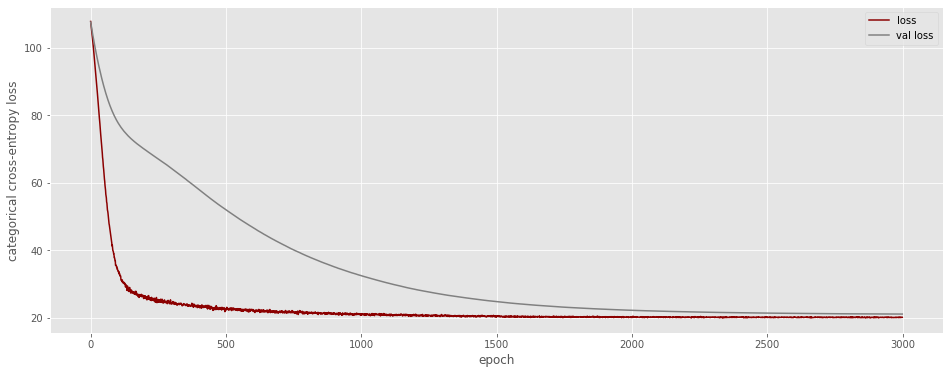

In [140]:
plt.figure(figsize=(16,6))
plt.plot(MODEL.model.history.history['loss'], color='darkred')
plt.plot(MODEL.model.history.history['val_loss'], color='gray')
plt.legend(['loss', 'val loss'])
plt.xlabel("epoch")
plt.ylabel("categorical cross-entropy loss")
plt.show()

In [56]:
print('r2:', max_r_2_embs, max_r_2)
print('mae:', min_mae_embs, min_mae)
print('rmse:', min_rmse_ems, min_rmse)

r2: 5 0.4595782547432954
mae: 5 3.033468637466407
rmse: 5 3.4199831570624704


In [57]:
print('r2:', min_r_2_embs, min_r_2)
print('mae:', max_mae_embs, max_mae)
print('rmse:', max_rmse_ems, max_rmse)

r2: 34 -0.21862243170137052
mae: 46 4.19649308803841
rmse: 34 5.135611272473761


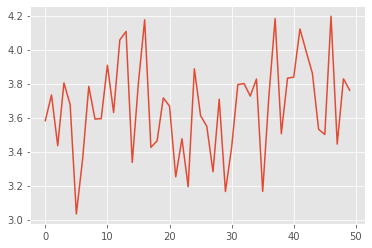

In [58]:
plt.plot(mae_plot)

In [59]:
embs = categories_emb[max_r_2_embs]

In [60]:
cat_names={}

for emb_var in emb:
    cats=list(df_input.groupby(emb_var))
    for cat in cats:
        if len(train_discretized.loc[train_discretized[emb_var]==cat[0]]) > 0:
            cat_names[cat[0]]=np.mean(cat[1][y_var].values)

sorted_colors=[]
for cat, prob in cat_names.items():
    #print(cat,prob)
    embd_idx= embs['ALL_CATS']['alfa2index_from'][cat]
    sorted_colors.append((prob,cat,embd_idx))
    
sorted_colors=sorted(sorted_colors, key= lambda x:x[-1])
#sorted_colors
colors=[i[0] for i in sorted_colors]
colors[:3]

[4.466062181499999, 11.74656342444186, 7.737802890363637]

In [61]:
categories=list(embs['ALL_CATS']['alfa2index_from'].keys())
features_emb=embs['ALL_CATS']['embeddings']

In [63]:
train_emb=get_mean_embs(emb_vars=emb, embeddings=embs['ALL_CATS'], emb_dims=5, input_df=df_input)
print(train_emb.shape)

#map the embeddings to the cities

train_cities=list(train['City'].values)
#cities_embs=dict(zip(cities,train_emb))

(231, 5)


In [64]:
test_emb=[]
test_cities=test.City.values
i=0
for row in test_discretized[emb].values:
    print(test_cities[i])
    #print(row)
    mean_vector=np.zeros(5)
    total=0
    for category in row:
        if category in embs['ALL_CATS']['alfa2index_from'].keys():
            emb_index=embs['ALL_CATS']['alfa2index_from'][category]
            # add up all the categorical vectors
            mean_vector+=embs['ALL_CATS']['embeddings'][emb_index]
            total+=1
        else:
            print('Missing category')
    test_emb.append(mean_vector/total) # divide by the number of categories to get the mean vector
    i+=1

Marseille
Antwerp
Cotonou
Bogota
Mumbai
Hyderabad
Ho Chi Minh City
Bangalore
Lubumbashi
Recife
Brazzaville
Kansas City(MO)
Caracas
Cairo
Aleppo
Qingdao
Guayaquil
Budapest
Raleigh(NC)
Columbus(OH)
Ulsan
Rotterdam-Hague
San Francisco Bay Area(CA)
Arequipa
Chicago(IL)
Baghdad
Montreal
Cordoba
Lima
Missing category
Lome
Melbourne
Shenzhen
Odessa
Dar es Salaam
Jinan
Mexico City
Taiyuan
Zurich
Managua
Kolkata
New Orleans(LA)
Mogadishu
San Juan
Brussels
Kharkiv
Cebu
Naples
Hong Kong
Rochester(NY)
Bandung
Buenos Aires
Freetown
Sapporo
Chongqing
New York(NY)
Osaka-Kobe-Kyoto
Seattle(WA)
San Jose
Kathmandu
Guadalajara
Yerevan
Douala
Port-au-Prince
Mandalay
Toulouse
Singapore
Rabat
Havana
Sacramento(CA)
Portland(OR)


In [65]:
embedding_columns_train=pd.DataFrame(data=train_emb)
embedding_columns_train['order'] = train.index
embedding_columns_test=pd.DataFrame(data=test_emb)
embedding_columns_test['order'] = test.index

In [66]:
train_prediction = train.merge(embedding_columns_train, left_index=True, right_on='order')
test_prediction = test.merge(embedding_columns_test, left_index=True, right_on='order')

In [93]:
train_=train_stand.drop(y_var,axis=1)
train_[y_var]=train[y_var]
test_=test_stand.drop(y_var, axis=1)
test_[y_var]=test[y_var]

train_prediction = train_.merge(embedding_columns_train, left_index=True, right_on='order')
test_prediction = test_.merge(embedding_columns_test, left_index=True, right_on='order')

In [91]:
generated_embs = [0,1,2,3,4]

# prediction

TRAIN Mean Absolute error (MAE): 3.23
TRAIN Root Mean squared error (RMSE): 0.42
TRAIN R-Squared: 0.53
TEST Mean Absolute error (MAE): 3.59
TEST Root Mean squared error (RMSE): 5.63
TEST R-Squared: 0.323


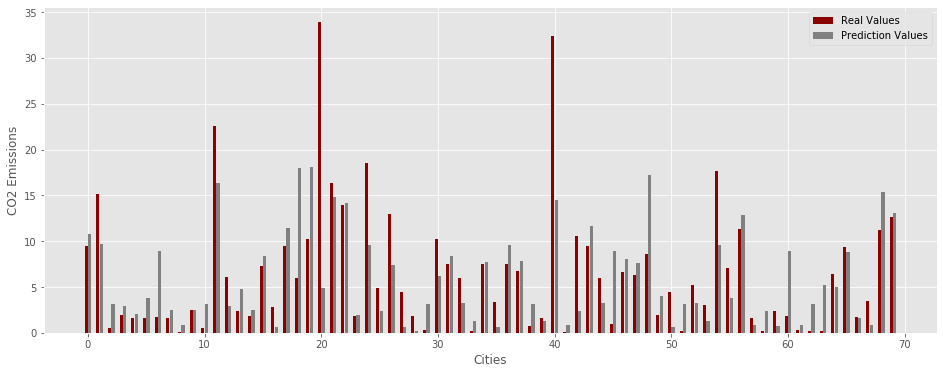

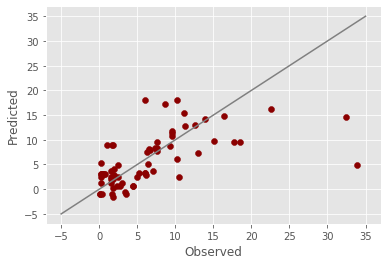

In [104]:
X_train=train_prediction[generated_embs]
y_train=np.array(train_prediction[y_var])

X_test=test_prediction[generated_embs]
y_test=np.array(test_prediction[y_var])

# estimate model on trainset
lr = LinearRegression(fit_intercept=False)
lr.fit(X_train, y_train)

# make predictions
y_train_pred = lr.predict(X_train)
y_test_pred = lr.predict(X_test)
y_test_pred_emb = lr.predict(X_test)

print("TRAIN Mean Absolute error (MAE): %.2f"% np.mean(abs(y_train_pred - y_train)))
# The mean squared error
print("TRAIN Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean(y_train_pred - y_train) ** 2))
print('TRAIN R-Squared:', round(sklearn.metrics.r2_score(y_train, y_train_pred,), 3))
print("TEST Mean Absolute error (MAE): %.2f"% np.mean(abs(y_test_pred - y_test)))
# The mean squared error
print("TEST Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean((y_test_pred - y_test) ** 2)))
print('TEST R-Squared:', round(sklearn.metrics.r2_score(y_test, y_test_pred,), 3))

data_plot = {
    'Real Values': y_test,
    'Prediction Values': np.abs(y_test_pred)
}
colors_bar_plot=['darkred', 'gray']
fig, ax = plt.subplots(figsize=(16,6))
bar_plot(ax, data_plot, total_width=.6, single_width=.9, colors=colors_bar_plot)
plt.xlabel('Cities')
plt.ylabel('CO2 Emissions')
plt.show()

plt.scatter(y_test, y_test_pred, color='darkred')
plt.xlabel("Observed")
plt.ylabel("Predicted")
plt.plot([-5, 35], [-5, 35], color="gray")
plt.show()

TRAIN Mean Absolute error (MAE): 3.16
TRAIN Root Mean squared error (RMSE): 0.00
TRAIN R-Squared: 0.551
TEST Mean Absolute error (MAE): 3.38
TEST Root Mean squared error (RMSE): 5.46
TEST R-Squared: 0.364


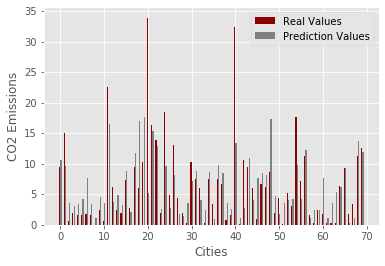

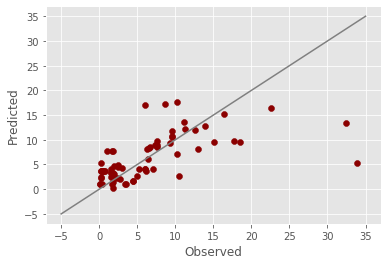

In [105]:
mlpr = MLPRegressor(activation='identity', solver='lbfgs',random_state=1, max_iter=1000)
mlpr.fit(X_train, y_train)

# make predictions
y_train_pred = mlpr.predict(X_train)
y_test_pred = mlpr.predict(X_test)

print("TRAIN Mean Absolute error (MAE): %.2f"% np.mean(abs(y_train_pred - y_train)))
# The mean squared error
print("TRAIN Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean(y_train_pred - y_train) ** 2))
print('TRAIN R-Squared:', round(sklearn.metrics.r2_score(y_train, y_train_pred,), 3))
print("TEST Mean Absolute error (MAE): %.2f"% np.mean(abs(y_test_pred - y_test)))
# The mean squared error
print("TEST Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean((y_test_pred - y_test) ** 2)))
print('TEST R-Squared:', round(sklearn.metrics.r2_score(y_test, y_test_pred,), 3))

data_plot = {
    'Real Values': y_test,
    'Prediction Values': np.abs(y_test_pred)
}
fig, ax = plt.subplots()
bar_plot(ax, data_plot, total_width=.6, single_width=.9, colors=colors_bar_plot)
plt.xlabel('Cities')
plt.ylabel('CO2 Emissions')
plt.show()

plt.scatter(y_test, y_test_pred, color='darkred')
plt.xlabel("Observed")
plt.ylabel("Predicted")
plt.plot([-5, 35], [-5, 35], color="gray")
plt.show()

## Original data

TRAIN Mean Absolute error (MAE): 4.29
TRAIN Root Mean squared error (RMSE): 1.95
TRAIN R-Squared: 0.156
TEST Mean Absolute error (MAE): 7.68
TEST Root Mean squared error (RMSE): 13.00
TEST R-Squared: -3.295


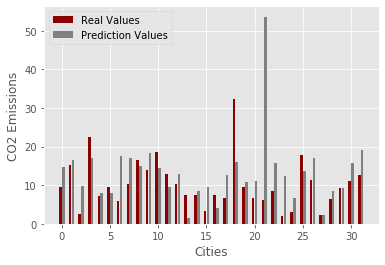

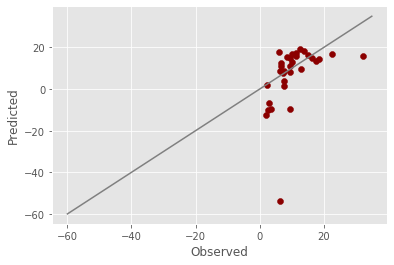

In [109]:
X_train=train_prediction[ext+emb[1:]+['BRT Age (years)']+[y_var]].dropna()
y_train=np.array(X_train[y_var])
X_train=X_train.drop(y_var, axis=1)

X_test=test_prediction[ext+emb[1:]+['BRT Age (years)']+[y_var]].dropna()
y_test=np.array(X_test[y_var])
X_test=X_test.drop(y_var, axis=1)

# estimate model on trainset
lr = LinearRegression(fit_intercept=False)
lr.fit(X_train, y_train)

# make predictions
y_train_pred = lr.predict(X_train)
y_test_pred = lr.predict(X_test)
y_test_pred_emb = lr.predict(X_test)

print("TRAIN Mean Absolute error (MAE): %.2f"% np.mean(abs(y_train_pred - y_train)))
# The mean squared error
print("TRAIN Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean(y_train_pred - y_train) ** 2))
print('TRAIN R-Squared:', round(sklearn.metrics.r2_score(y_train, y_train_pred,), 3))
print("TEST Mean Absolute error (MAE): %.2f"% np.mean(abs(y_test_pred - y_test)))
# The mean squared error
print("TEST Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean((y_test_pred - y_test) ** 2)))
print('TEST R-Squared:', round(sklearn.metrics.r2_score(y_test, y_test_pred,), 3))

data_plot = {
    'Real Values': y_test,
    'Prediction Values': np.abs(y_test_pred)
}
colors_bar_plot=['darkred', 'gray']
fig, ax = plt.subplots()
bar_plot(ax, data_plot, total_width=.6, single_width=.9, colors=colors_bar_plot)
plt.xlabel('Cities')
plt.ylabel('CO2 Emissions')
plt.show()

plt.scatter(y_test, y_test_pred, color='darkred')
plt.xlabel("Observed")
plt.ylabel("Predicted")
plt.plot([-60, 35], [-60, 35], color="gray")
plt.show()

TRAIN Mean Absolute error (MAE): 2.71
TRAIN Root Mean squared error (RMSE): 0.00
TRAIN R-Squared: 0.594
TEST Mean Absolute error (MAE): 4.07
TEST Root Mean squared error (RMSE): 5.82
TEST R-Squared: 0.138


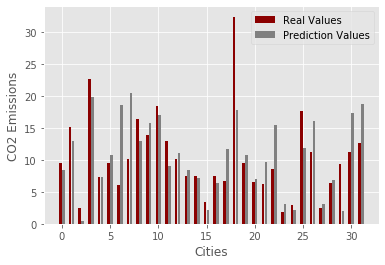

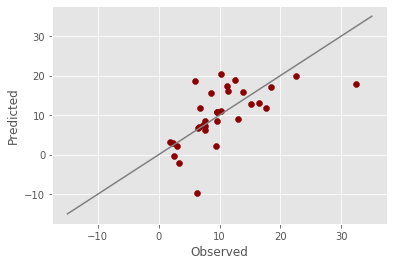

In [111]:
mlpr = MLPRegressor(activation='identity', solver='lbfgs',random_state=1, max_iter=1000)
mlpr.fit(X_train, y_train)

# make predictions
y_train_pred = mlpr.predict(X_train)
y_test_pred = mlpr.predict(X_test)

print("TRAIN Mean Absolute error (MAE): %.2f"% np.mean(abs(y_train_pred - y_train)))
# The mean squared error
print("TRAIN Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean(y_train_pred - y_train) ** 2))
print('TRAIN R-Squared:', round(sklearn.metrics.r2_score(y_train, y_train_pred,), 3))
print("TEST Mean Absolute error (MAE): %.2f"% np.mean(abs(y_test_pred - y_test)))
# The mean squared error
print("TEST Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean((y_test_pred - y_test) ** 2)))
print('TEST R-Squared:', round(sklearn.metrics.r2_score(y_test, y_test_pred,), 3))

data_plot = {
    'Real Values': y_test,
    'Prediction Values': np.abs(y_test_pred)
}
fig, ax = plt.subplots()
bar_plot(ax, data_plot, total_width=.6, single_width=.9, colors=colors_bar_plot)
plt.xlabel('Cities')
plt.ylabel('CO2 Emissions')
plt.show()

plt.scatter(y_test, y_test_pred, color='darkred')
plt.xlabel("Observed")
plt.ylabel("Predicted")
plt.plot([-15, 35], [-15, 35], color="gray")
plt.show()

## Origial data with embeddings

TRAIN Mean Absolute error (MAE): 2.76
TRAIN Root Mean squared error (RMSE): 0.16
TRAIN R-Squared: 0.59
TEST Mean Absolute error (MAE): 4.95
TEST Root Mean squared error (RMSE): 6.83
TEST R-Squared: -0.187


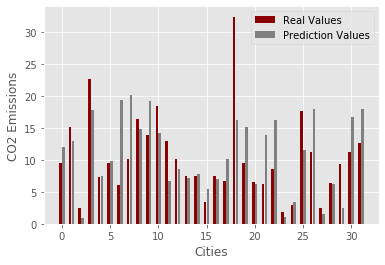

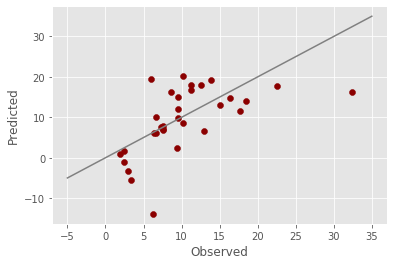

In [112]:
X_train=train_prediction[ext+emb[1:]+['BRT Age (years)']+[y_var]+generated_embs].dropna()
y_train=np.array(X_train[y_var])
X_train=X_train.drop(y_var, axis=1)

X_test=test_prediction[ext+emb[1:]+['BRT Age (years)']+[y_var]+generated_embs].dropna()
y_test=np.array(X_test[y_var])
X_test=X_test.drop(y_var, axis=1)

# estimate model on trainset
lr = LinearRegression(fit_intercept=False)
lr.fit(X_train, y_train)

# make predictions
y_train_pred = lr.predict(X_train)
y_test_pred = lr.predict(X_test)
y_test_pred_emb = lr.predict(X_test)

print("TRAIN Mean Absolute error (MAE): %.2f"% np.mean(abs(y_train_pred - y_train)))
# The mean squared error
print("TRAIN Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean(y_train_pred - y_train) ** 2))
print('TRAIN R-Squared:', round(sklearn.metrics.r2_score(y_train, y_train_pred,), 3))
print("TEST Mean Absolute error (MAE): %.2f"% np.mean(abs(y_test_pred - y_test)))
# The mean squared error
print("TEST Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean((y_test_pred - y_test) ** 2)))
print('TEST R-Squared:', round(sklearn.metrics.r2_score(y_test, y_test_pred,), 3))

data_plot = {
    'Real Values': y_test,
    'Prediction Values': np.abs(y_test_pred)
}
colors_bar_plot=['darkred', 'gray']
fig, ax = plt.subplots()
bar_plot(ax, data_plot, total_width=.6, single_width=.9, colors=colors_bar_plot)
plt.xlabel('Cities')
plt.ylabel('CO2 Emissions')
plt.show()

plt.scatter(y_test, y_test_pred, color='darkred')
plt.xlabel("Observed")
plt.ylabel("Predicted")
plt.plot([-5, 35], [-5, 35], color="gray")
plt.show()

TRAIN Mean Absolute error (MAE): 2.59
TRAIN Root Mean squared error (RMSE): 0.00
TRAIN R-Squared: 0.61
TEST Mean Absolute error (MAE): 4.32
TEST Root Mean squared error (RMSE): 6.15
TEST R-Squared: 0.037


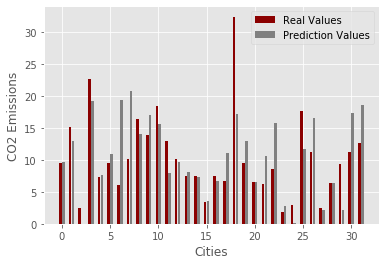

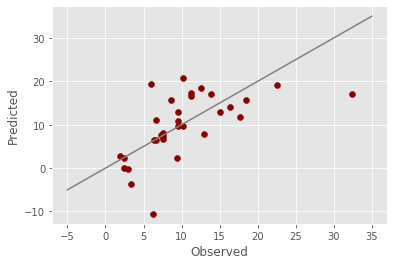

In [113]:
mlpr = MLPRegressor(activation='identity', solver='lbfgs',random_state=1, max_iter=1000)
mlpr.fit(X_train, y_train)

# make predictions
y_train_pred = mlpr.predict(X_train)
y_test_pred = mlpr.predict(X_test)

print("TRAIN Mean Absolute error (MAE): %.2f"% np.mean(abs(y_train_pred - y_train)))
# The mean squared error
print("TRAIN Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean(y_train_pred - y_train) ** 2))
print('TRAIN R-Squared:', round(sklearn.metrics.r2_score(y_train, y_train_pred,), 3))
print("TEST Mean Absolute error (MAE): %.2f"% np.mean(abs(y_test_pred - y_test)))
# The mean squared error
print("TEST Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean((y_test_pred - y_test) ** 2)))
print('TEST R-Squared:', round(sklearn.metrics.r2_score(y_test, y_test_pred,), 3))

data_plot = {
    'Real Values': y_test,
    'Prediction Values': np.abs(y_test_pred)
}
fig, ax = plt.subplots()
bar_plot(ax, data_plot, total_width=.6, single_width=.9, colors=colors_bar_plot)
plt.xlabel('Cities')
plt.ylabel('CO2 Emissions')
plt.show()

plt.scatter(y_test, y_test_pred, color='darkred')
plt.xlabel("Observed")
plt.ylabel("Predicted")
plt.plot([-5, 35], [-5, 35], color="gray")
plt.show()

## embeddings (with drop nan)

TRAIN Mean Absolute error (MAE): 3.33
TRAIN Root Mean squared error (RMSE): 0.37
TRAIN R-Squared: 0.436
TEST Mean Absolute error (MAE): 3.82
TEST Root Mean squared error (RMSE): 5.35
TEST R-Squared: 0.271


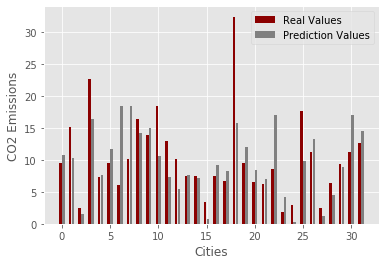

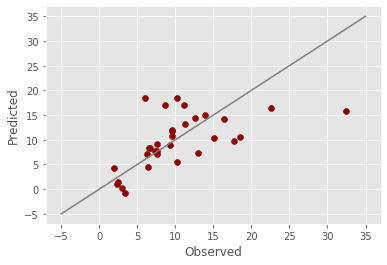

In [141]:
X_train=train_prediction[ext+emb[1:]+['BRT Age (years)']+[y_var]+generated_embs].dropna()
y_train=np.array(X_train[y_var])
X_train=X_train[generated_embs]

X_test=test_prediction[ext+emb[1:]+['BRT Age (years)']+[y_var]+generated_embs].dropna()
y_test=np.array(X_test[y_var])
X_test=X_test[generated_embs]

# estimate model on trainset
lr = LinearRegression(fit_intercept=False)
lr.fit(X_train, y_train)

# make predictions
y_train_pred = lr.predict(X_train)
y_test_pred = lr.predict(X_test)
y_test_pred_emb = lr.predict(X_test)

print("TRAIN Mean Absolute error (MAE): %.2f"% np.mean(abs(y_train_pred - y_train)))
# The mean squared error
print("TRAIN Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean(y_train_pred - y_train) ** 2))
print('TRAIN R-Squared:', round(sklearn.metrics.r2_score(y_train, y_train_pred,), 3))
print("TEST Mean Absolute error (MAE): %.2f"% np.mean(abs(y_test_pred - y_test)))
# The mean squared error
print("TEST Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean((y_test_pred - y_test) ** 2)))
print('TEST R-Squared:', round(sklearn.metrics.r2_score(y_test, y_test_pred,), 3))

data_plot = {
    'Real Values': y_test,
    'Prediction Values': np.abs(y_test_pred)
}
colors_bar_plot=['darkred', 'gray']
fig, ax = plt.subplots()
bar_plot(ax, data_plot, total_width=.6, single_width=.9, colors=colors_bar_plot)
plt.xlabel('Cities')
plt.ylabel('CO2 Emissions')
plt.show()

plt.scatter(y_test, y_test_pred, color='darkred')
plt.xlabel("Observed")
plt.ylabel("Predicted")
plt.plot([-5, 35], [-5, 35], color="gray")
plt.show()

In [142]:
len(X_test)

32

TRAIN Mean Absolute error (MAE): 3.17
TRAIN Root Mean squared error (RMSE): 0.00
TRAIN R-Squared: 0.475
TEST Mean Absolute error (MAE): 3.58
TEST Root Mean squared error (RMSE): 5.15
TEST R-Squared: 0.325


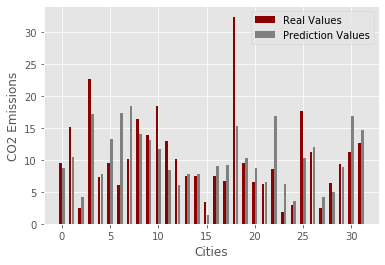

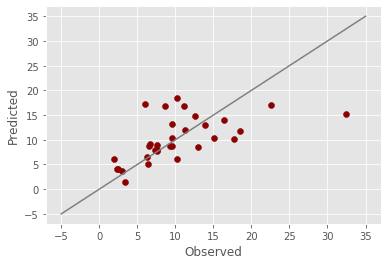

In [115]:
mlpr = MLPRegressor(activation='identity', solver='lbfgs',random_state=1, max_iter=1000)
mlpr.fit(X_train, y_train)

# make predictions
y_train_pred = mlpr.predict(X_train)
y_test_pred = mlpr.predict(X_test)

print("TRAIN Mean Absolute error (MAE): %.2f"% np.mean(abs(y_train_pred - y_train)))
# The mean squared error
print("TRAIN Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean(y_train_pred - y_train) ** 2))
print('TRAIN R-Squared:', round(sklearn.metrics.r2_score(y_train, y_train_pred,), 3))
print("TEST Mean Absolute error (MAE): %.2f"% np.mean(abs(y_test_pred - y_test)))
# The mean squared error
print("TEST Root Mean squared error (RMSE): %.2f"
      % np.sqrt(np.mean((y_test_pred - y_test) ** 2)))
print('TEST R-Squared:', round(sklearn.metrics.r2_score(y_test, y_test_pred,), 3))

data_plot = {
    'Real Values': y_test,
    'Prediction Values': np.abs(y_test_pred)
}
fig, ax = plt.subplots()
bar_plot(ax, data_plot, total_width=.6, single_width=.9, colors=colors_bar_plot)
plt.xlabel('Cities')
plt.ylabel('CO2 Emissions')
plt.show()

plt.scatter(y_test, y_test_pred, color='darkred')
plt.xlabel("Observed")
plt.ylabel("Predicted")
plt.plot([-5, 35], [-5, 35], color="gray")
plt.show()

In [ ]:
#plot con real values de todas las ciudades + prediction values embeddings + prediction values real data con 0 en las ciudades drop